In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("immulu/bigearthnetv2-s2-7")

print("Path to dataset files:", path)



Path to dataset files: /kaggle/input/bigearthnetv2-s2-7


In [ ]:

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
import cv2
import numpy as np
import os
from glob import glob
from matplotlib import pyplot as plt
from termcolor import cprint
from tabulate import tabulate
import time

In [ ]:
BASE_TILE_FOLDER = "/root/.cache/kagglehub/datasets/immulu/bigearthnetv2-s2-7/versions/1"   # parent folder containing subfolders of tiles
BANDS = ("B04", "B03", "B02")         # bands to stack into RGB
MIN_AREA = 10                         # min contour area
MAX_AREA = 1000                       # max contour area
DISPLAY_SCALE = 0.5                   # scale for display (0<scale<=1)

In [ ]:
def find_band_file(tile_folder, band):
    """Find the .tif file for a given band in a tile folder."""
    pattern = os.path.join(tile_folder, f"*_{band}.tif")
    files = glob(pattern)
    if not files:
        raise FileNotFoundError(f"No file for band {band} in {tile_folder}")
    return files[0]


In [ ]:
def load_tile_rgb(tile_folder, bands):
    """Load three bands and stack into an 8‑bit RGB image."""
    imgs = []
    for b in bands:
        path = find_band_file(tile_folder, b)
        arr = cv2.imread(path, cv2.IMREAD_UNCHANGED)
        if arr is None:
            raise IOError(f"Cannot read {path}")
        # normalize each band to 0–255
        norm = cv2.normalize(arr, None, 0, 255, cv2.NORM_MINMAX)
        imgs.append(norm.astype(np.uint8))
    # stack in BGR order for OpenCV
    bgr = cv2.merge([imgs[0], imgs[1], imgs[2]])
    return bgr

In [ ]:
def preprocess_gray(gray):
    """Normalize, blur, threshold, and morph-open the grayscale image."""
    # blur
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    # Otsu threshold
    _, th = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    # open
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
    opened = cv2.morphologyEx(th, cv2.MORPH_OPEN, kernel, iterations=2)
    return opened

In [ ]:
def detect_contours(mask, min_area, max_area):
    """Find external contours and filter by area."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return [c for c in contours if min_area < cv2.contourArea(c) < max_area]

In [ ]:
def print_header(msg):
    cprint("=" * 60, "cyan")
    cprint(f"{msg.center(60)}", "cyan", attrs=["bold"])
    cprint("=" * 60, "cyan")

def print_tile_summary(tile_name, count, duration):
    table = [
        ["Tile", tile_name],
        ["Object Count", count],
        ["Processing Time", f"{duration:.2f} sec"]
    ]
    print(tabulate(table, headers=["Metric", "Value"], tablefmt="fancy_grid"))

In [ ]:
def draw_and_show(orig_bgr, contours, count, scale):
    """Draw contours and count text, then display via matplotlib."""
    out = orig_bgr.copy()
    cv2.drawContours(out, contours, -1, (0,255,0), 1)
    cv2.putText(out, f"Count: {count}", (10,30),
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0,0,255), 2)
    if scale != 1.0:
        h,w = out.shape[:2]
        out = cv2.resize(out, (int(w*scale), int(h*scale)), interpolation=cv2.INTER_AREA)
    # show
    plt.figure(figsize=(8,6))
    plt.imshow(cv2.cvtColor(out, cv2.COLOR_BGR2RGB))
    plt.title(f"Detected: {count}")
    plt.axis("off")
    plt.show()

                Wildlife Population Counter                 
Found 41058 tile folders.
[1/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


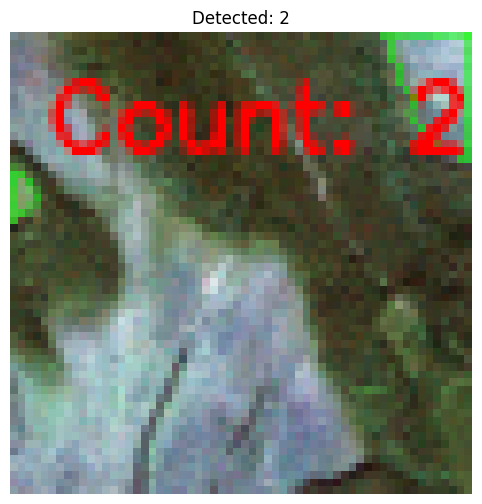

[2/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


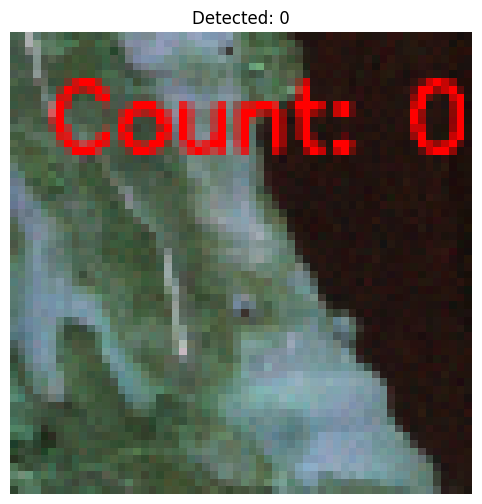

[3/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


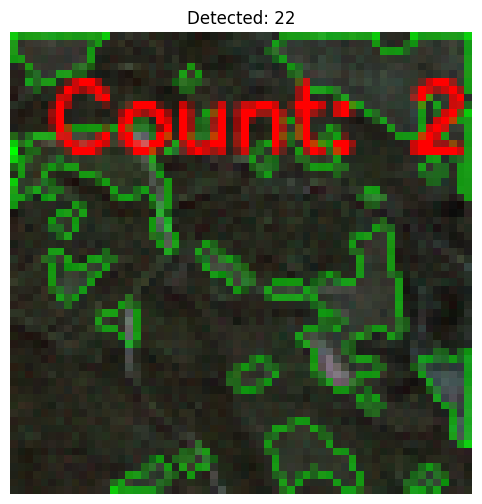

[4/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


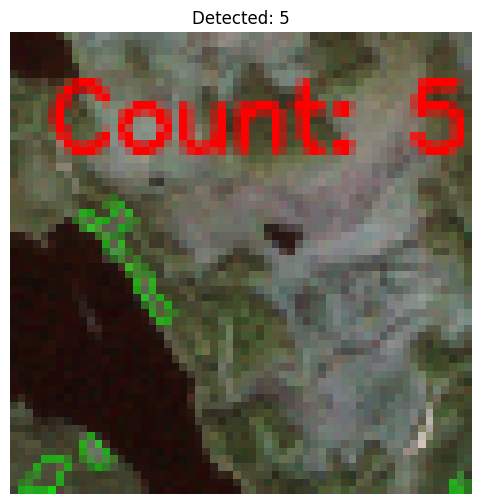

[5/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


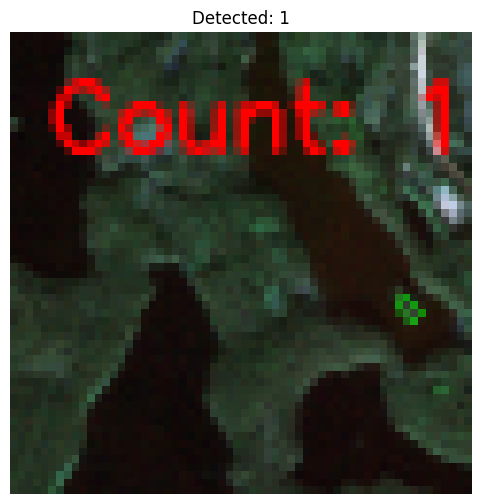

[6/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


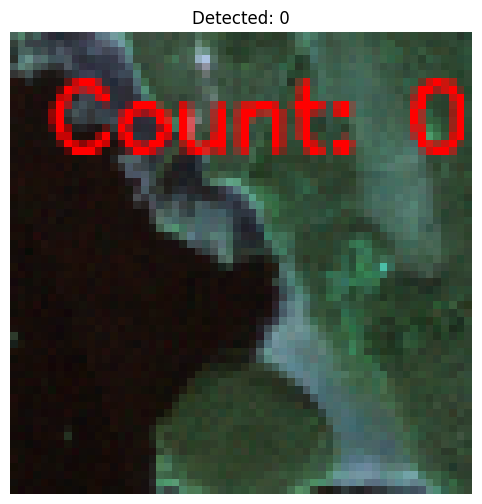

[7/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


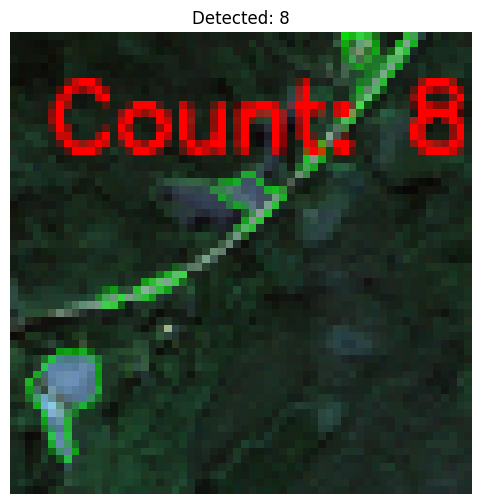

[8/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


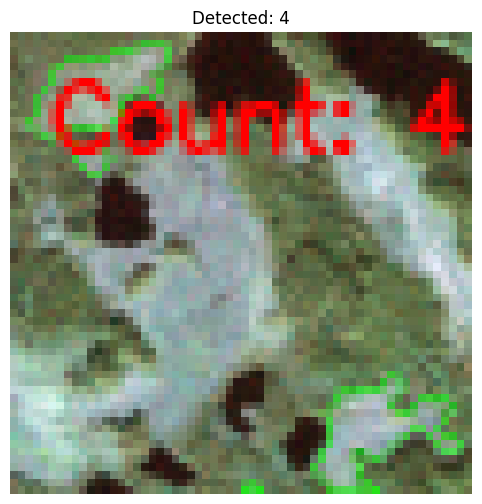

[9/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


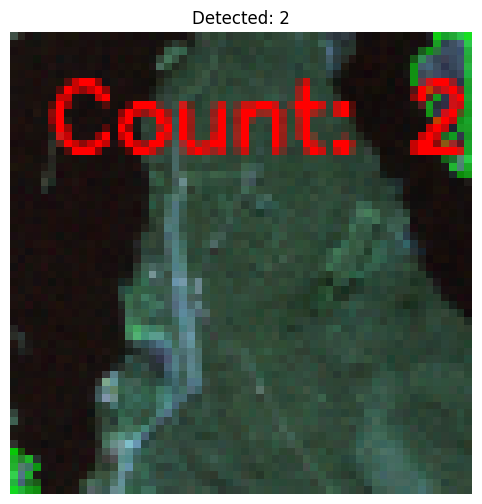

[10/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


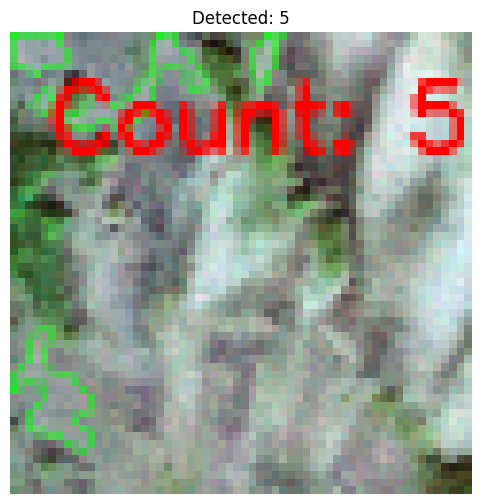

[11/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


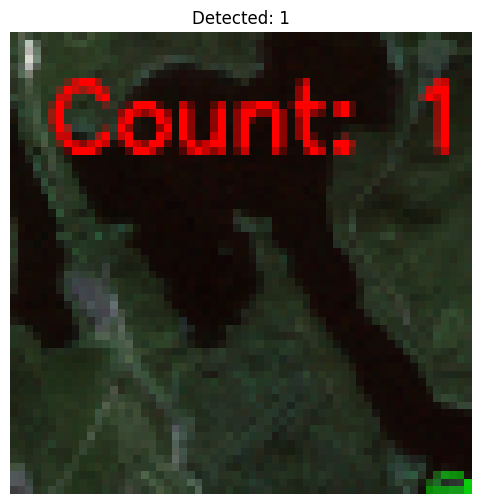

[12/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


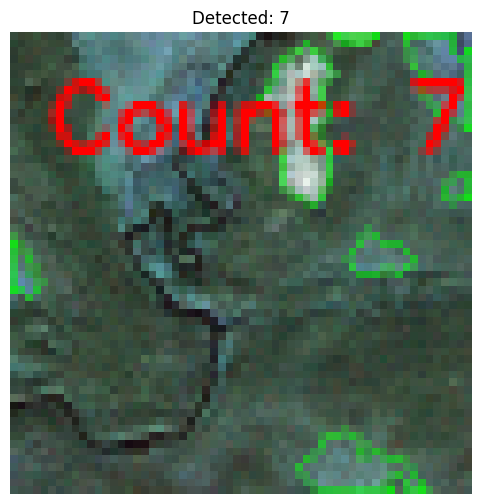

[13/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


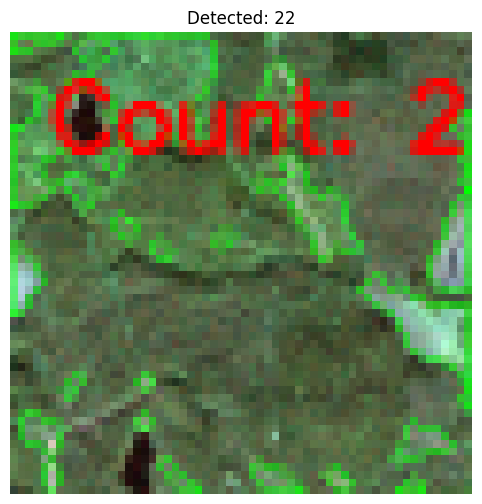

[14/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


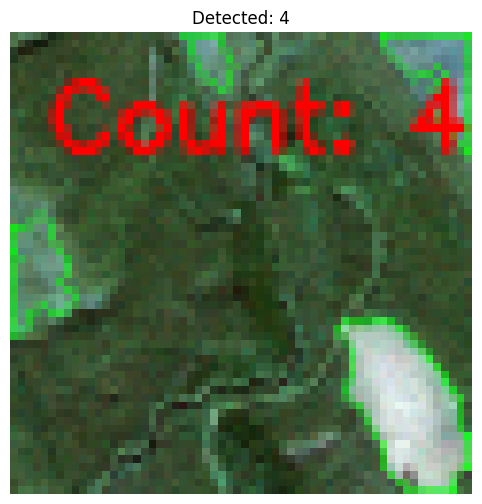

[15/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


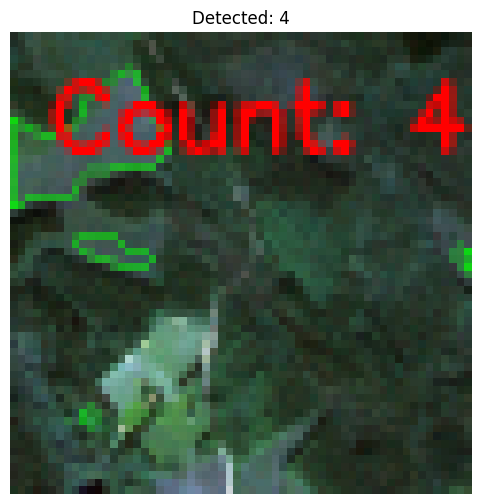

[16/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


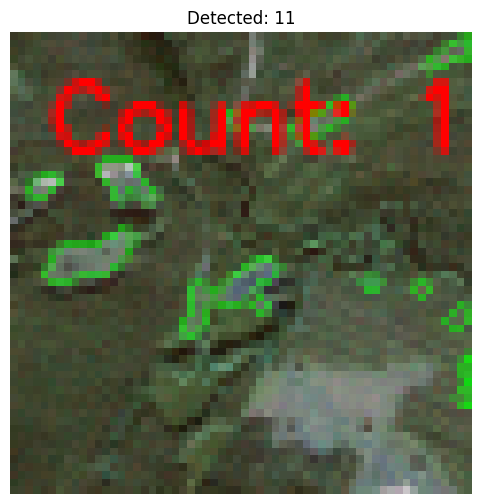

[17/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


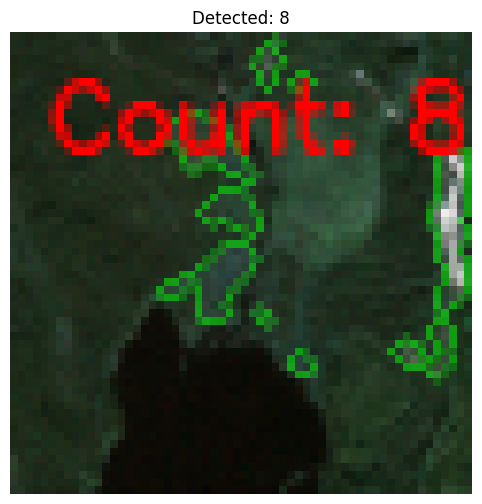

[18/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


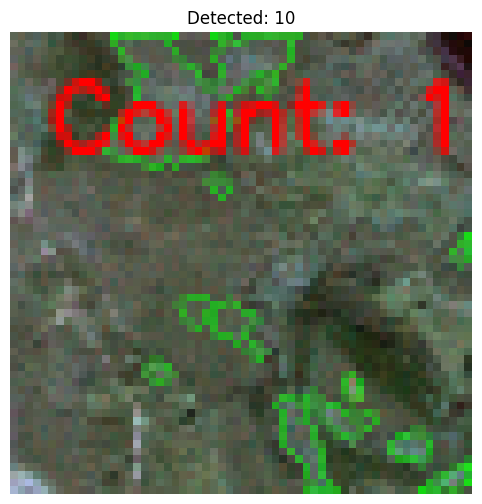

[19/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


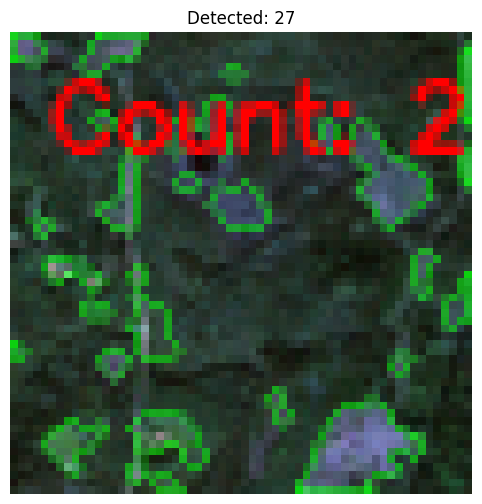

[20/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


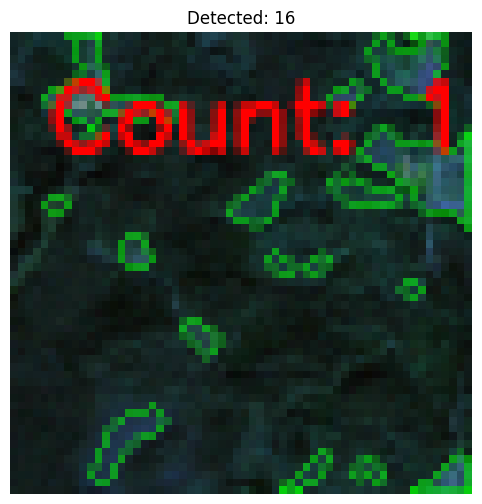

[21/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


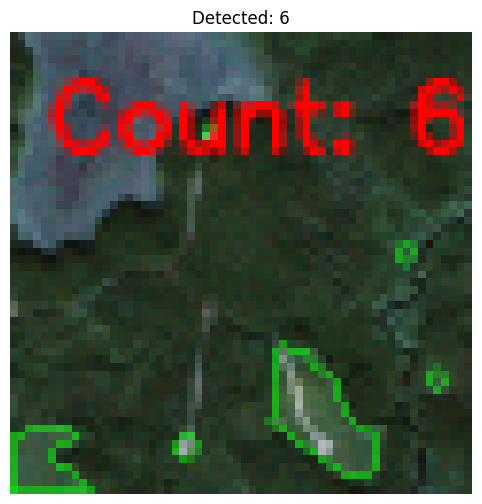

[22/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


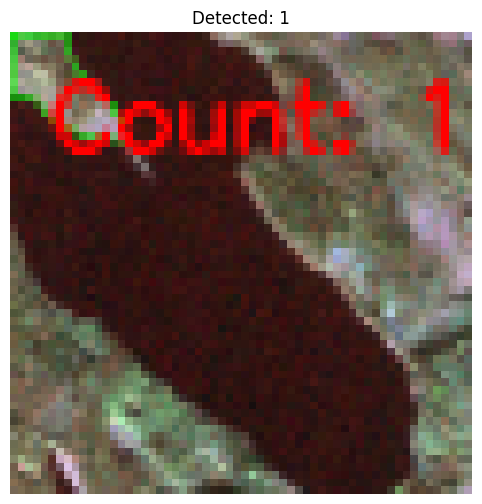

[23/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


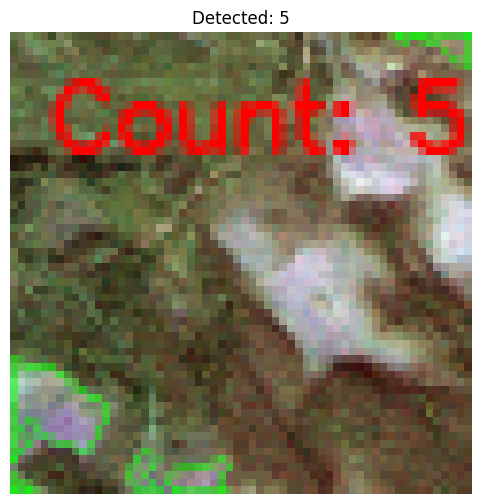

[24/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


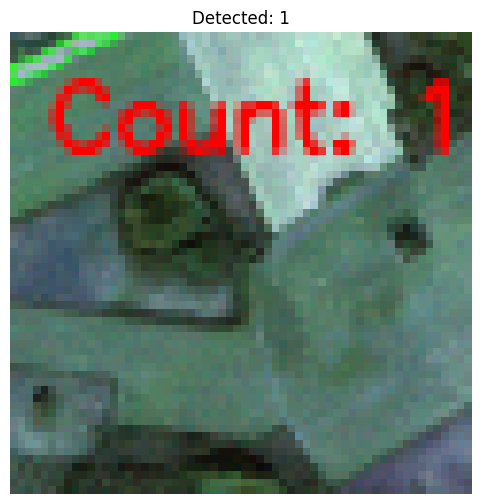

[25/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


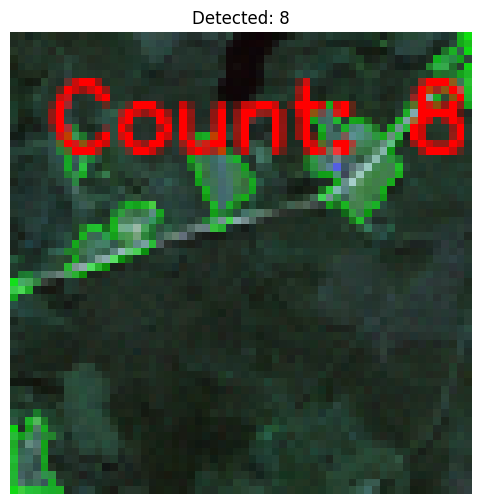

[26/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


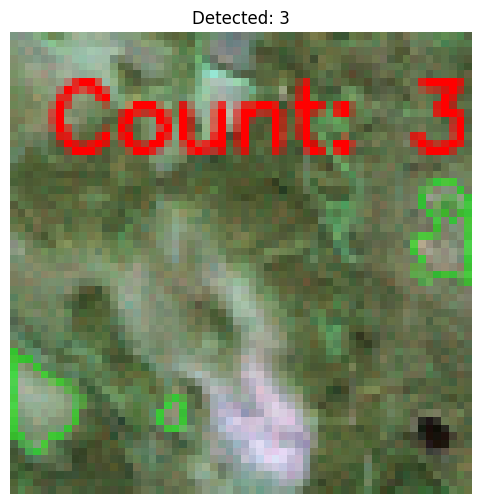

[27/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


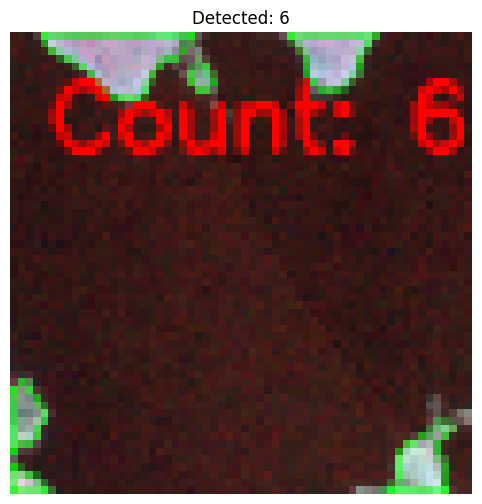

[28/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


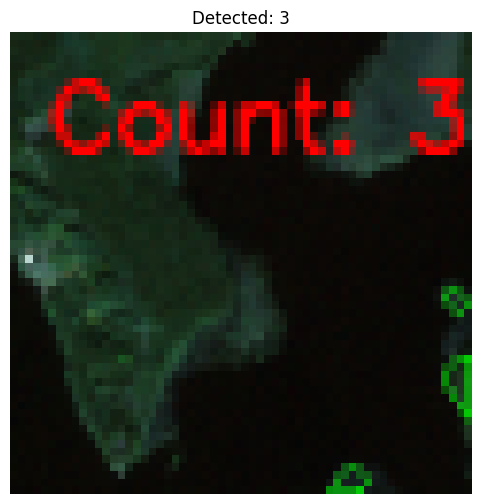

[29/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


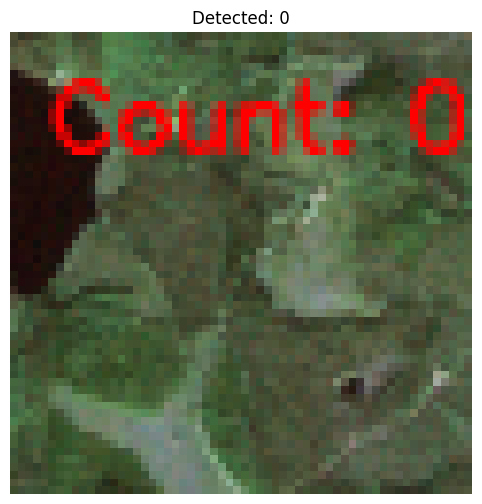

[30/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


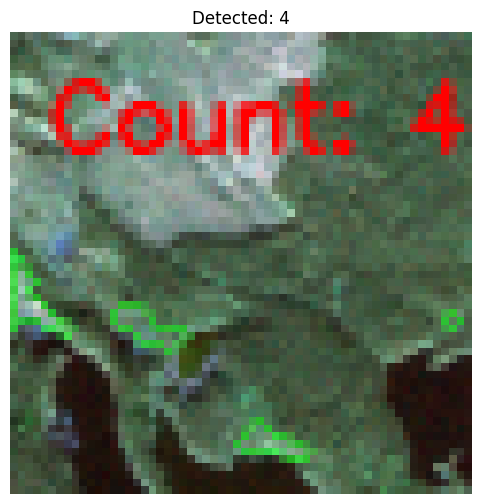

[31/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


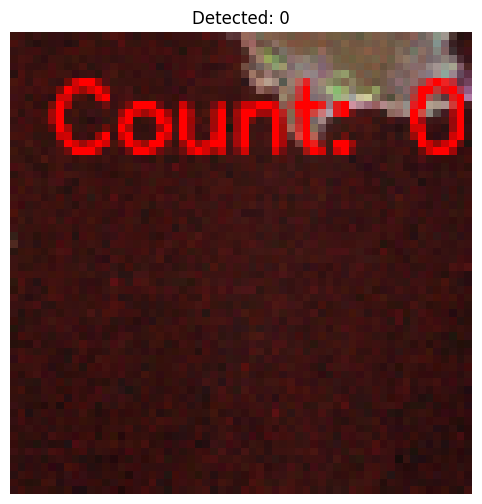

[32/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


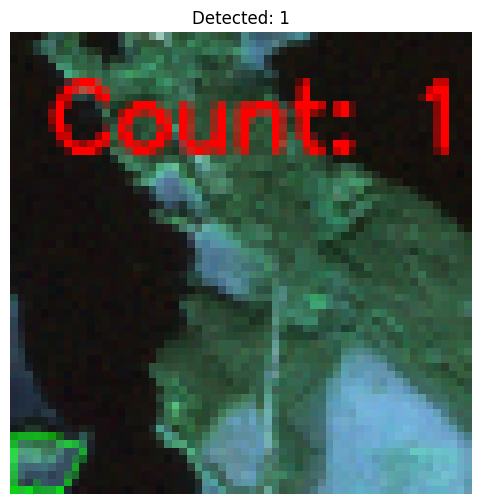

[33/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


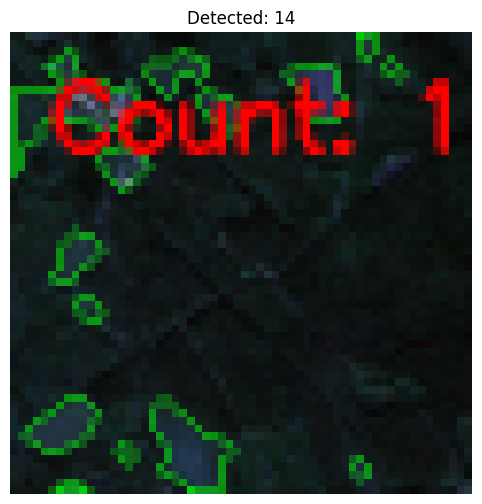

[34/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


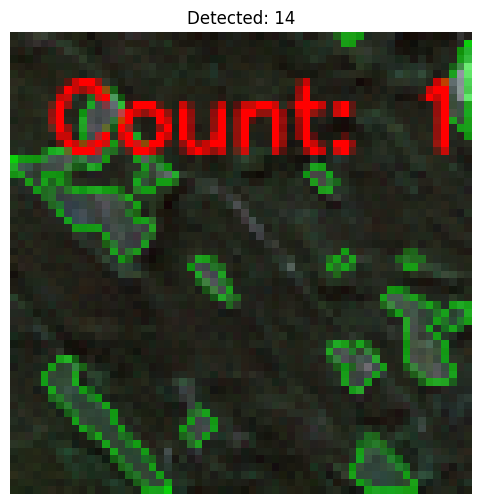

[35/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


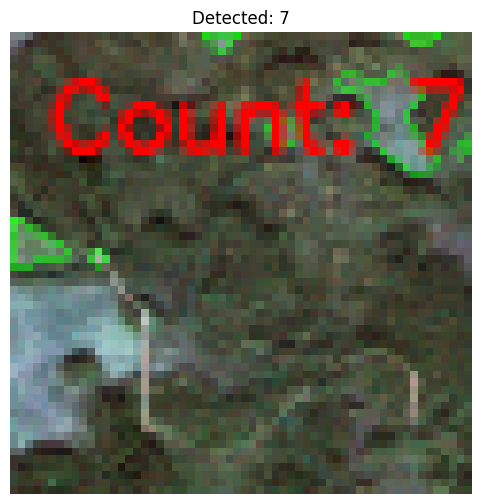

[36/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


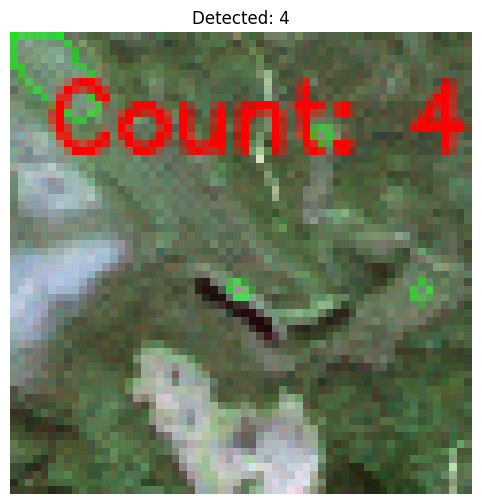

[37/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


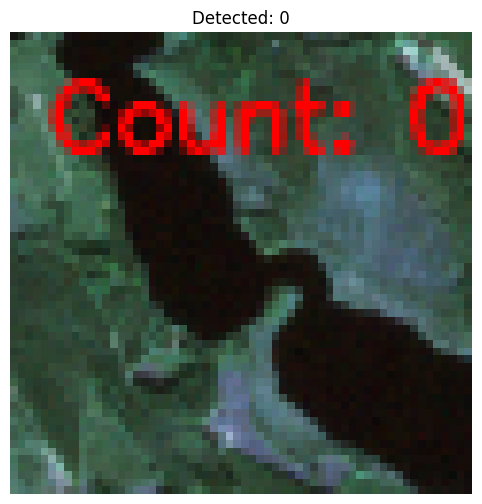

[38/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


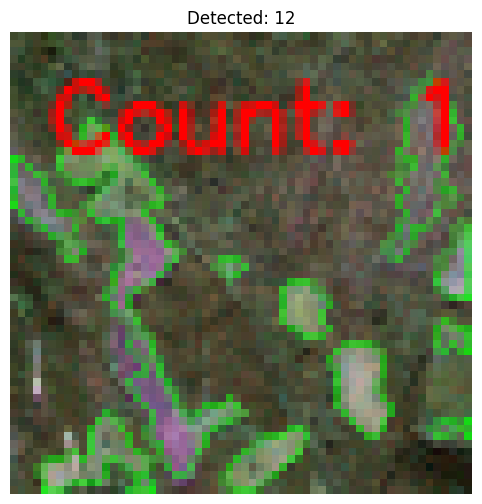

[39/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


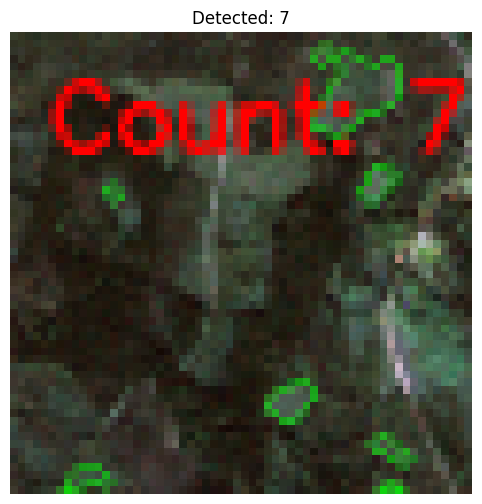

[40/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


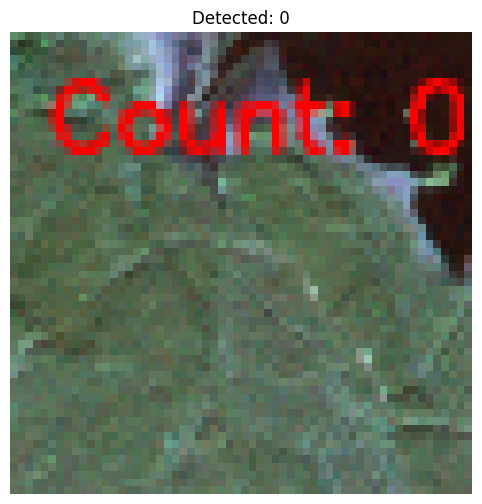

[41/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


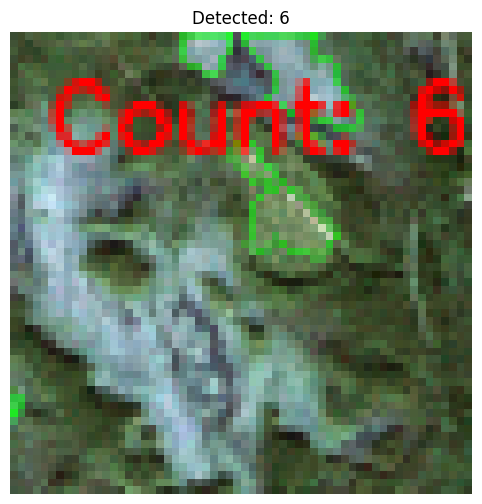

[42/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


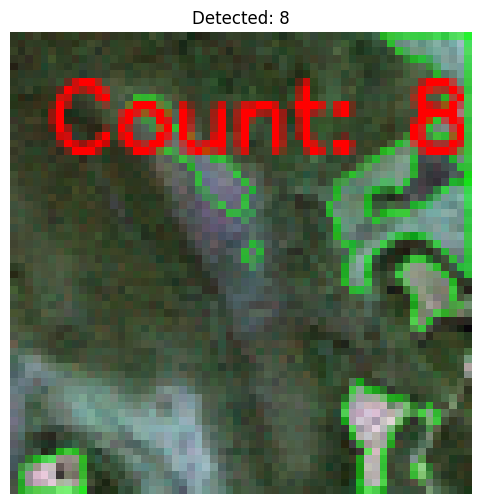

[43/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


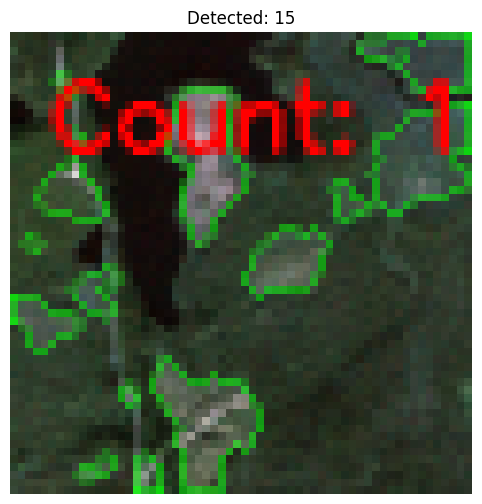

[44/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


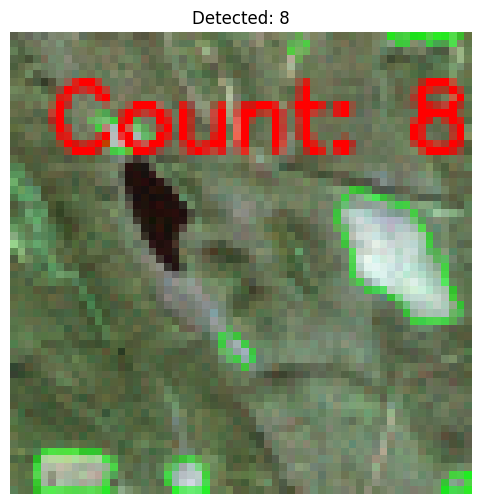

[45/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


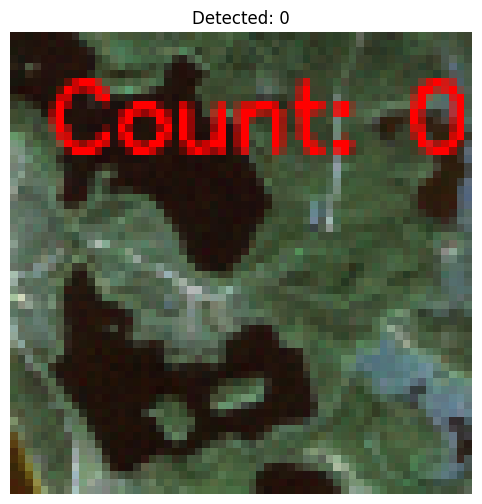

[46/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


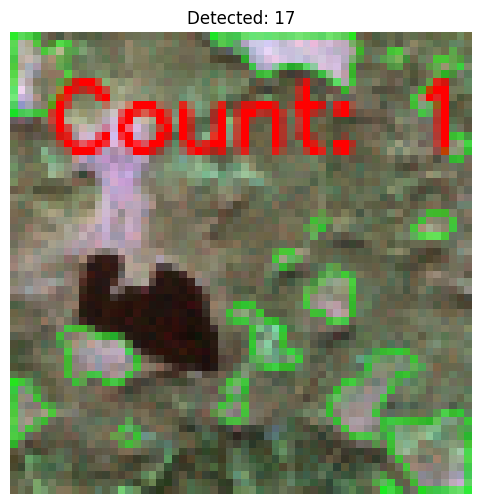

[47/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


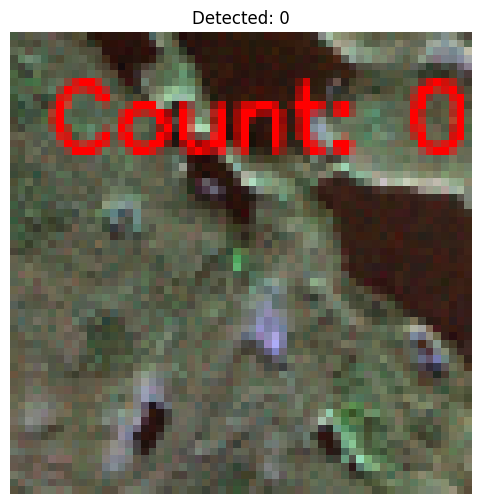

[48/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


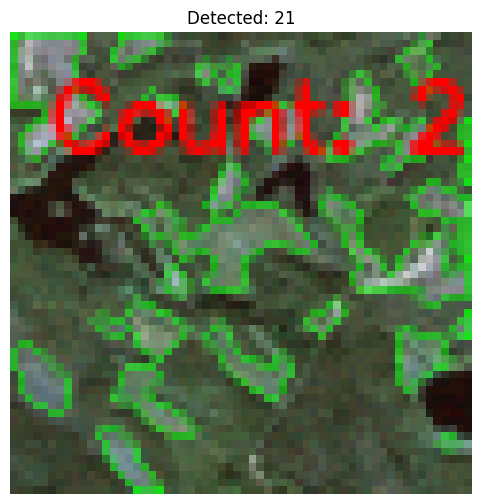

[49/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


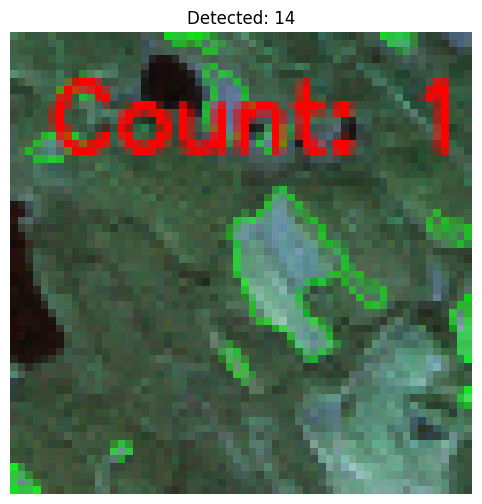

[50/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


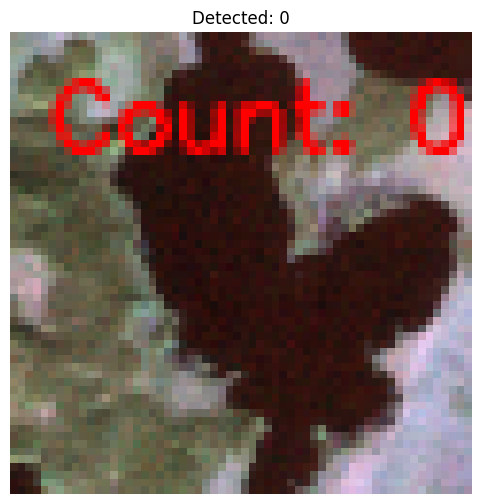

[51/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


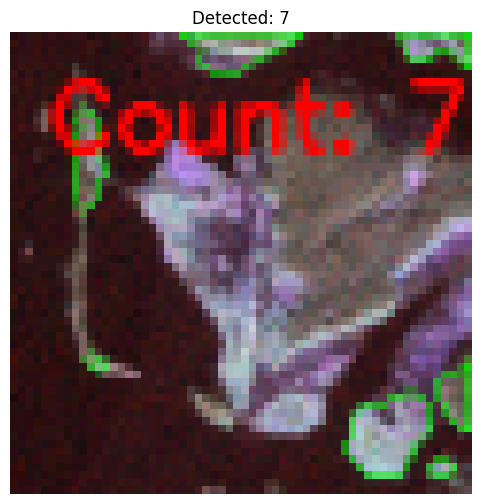

[52/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


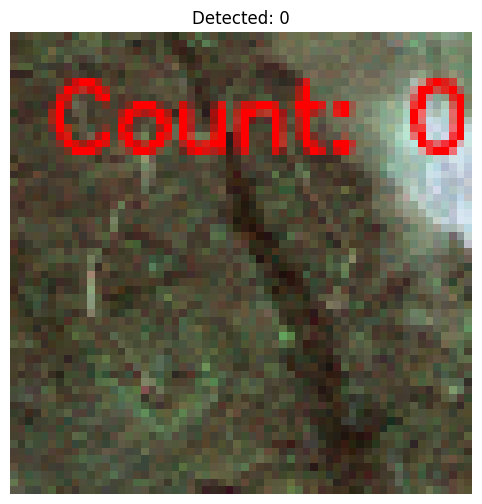

[53/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


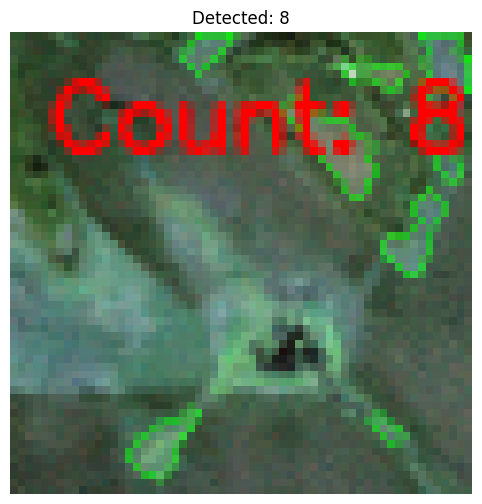

[54/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


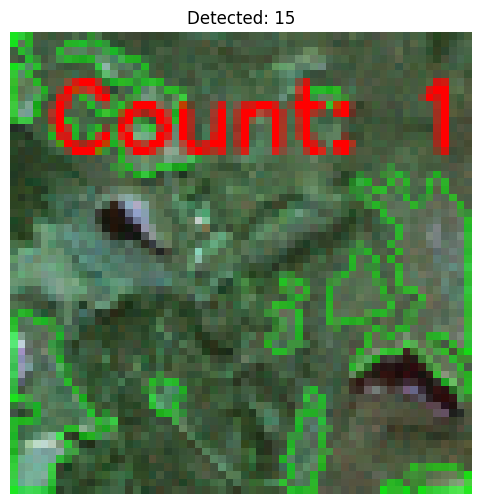

[55/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


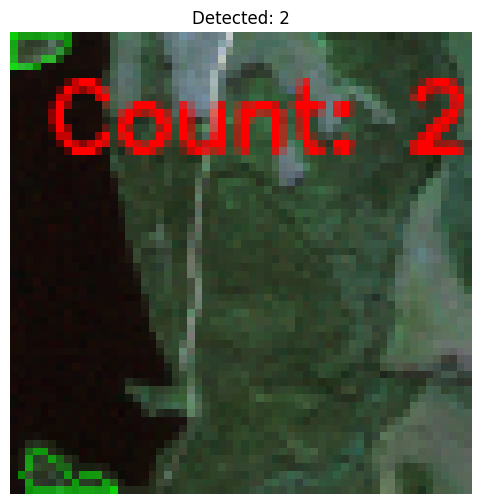

[56/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


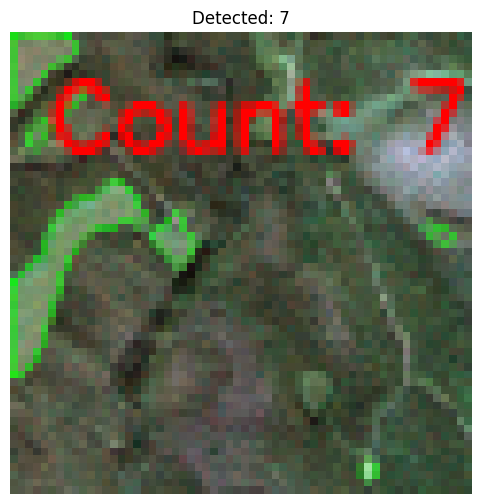

[57/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


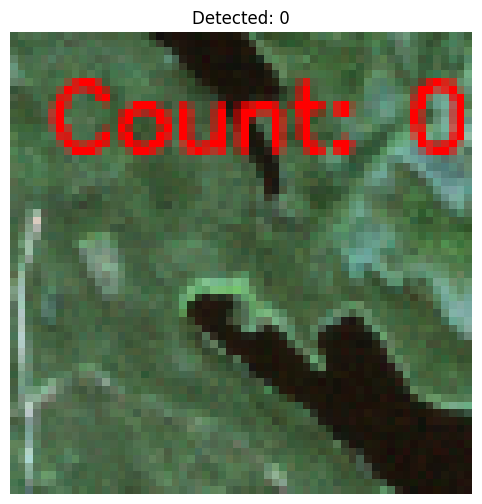

[58/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


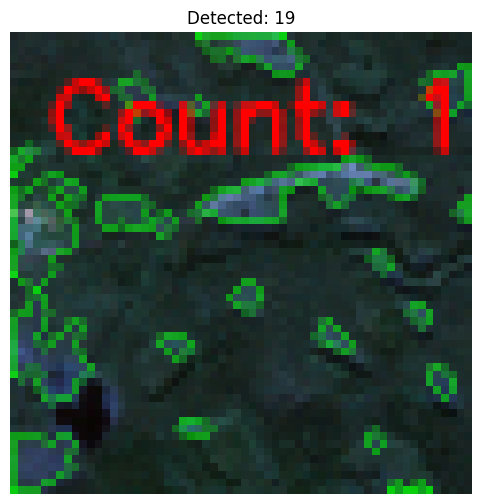

[59/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 24                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


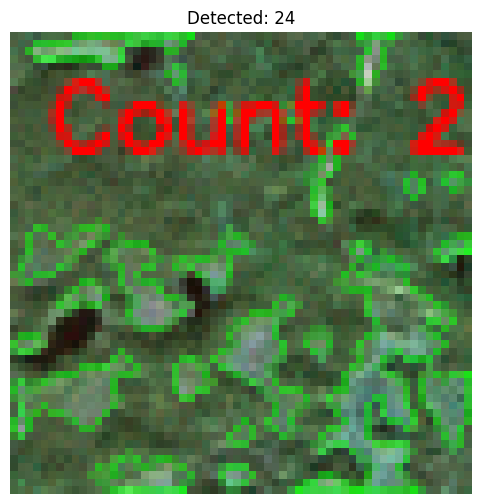

[60/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


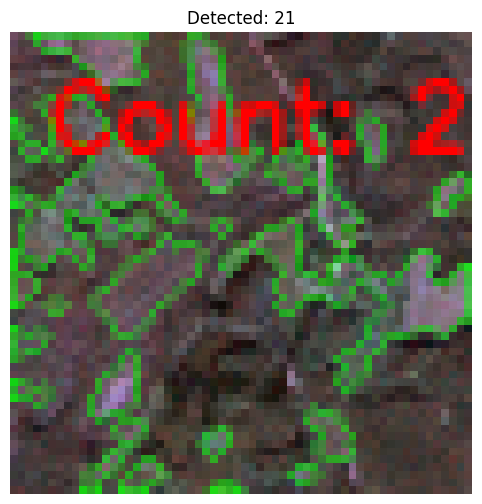

[61/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


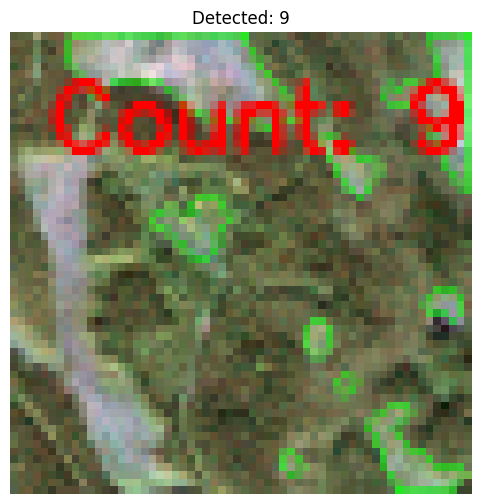

[62/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


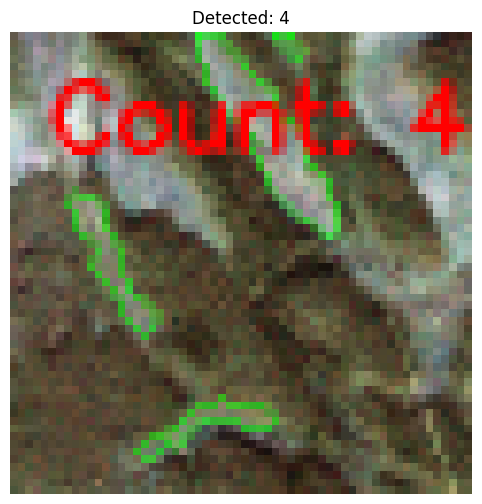

[63/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


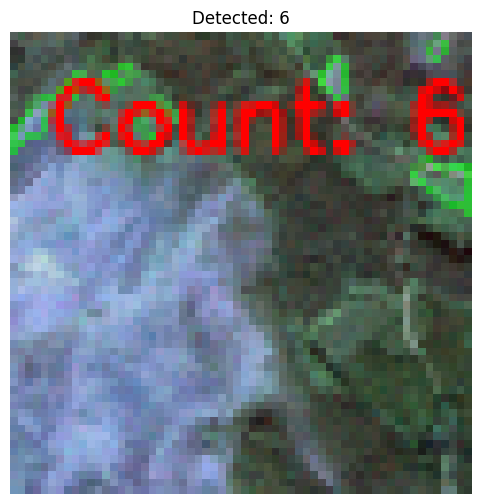

[64/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


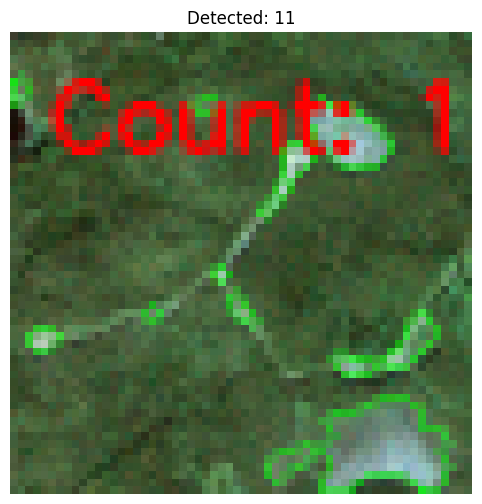

[65/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


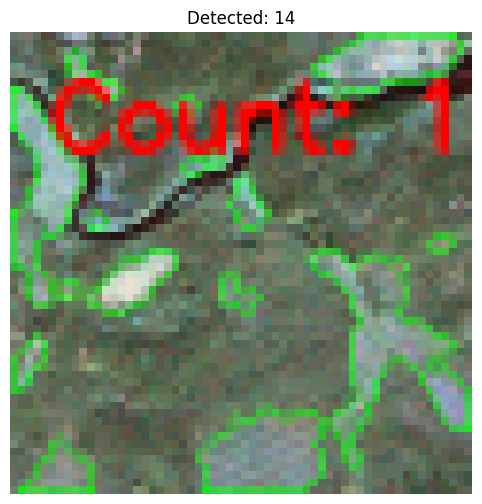

[66/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


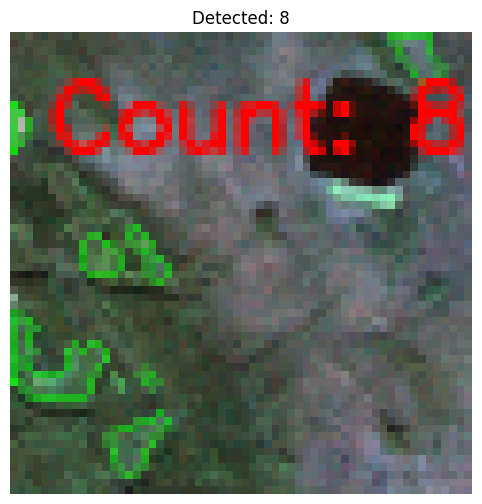

[67/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


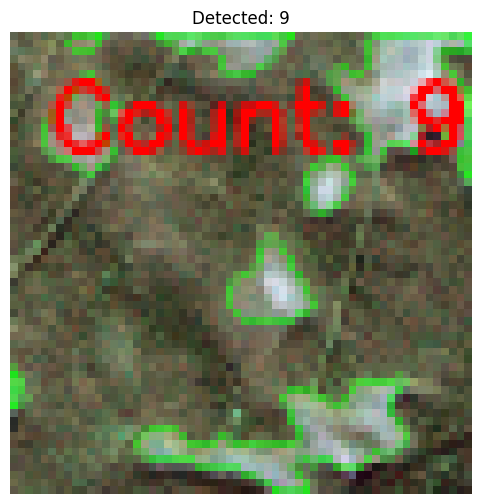

[68/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


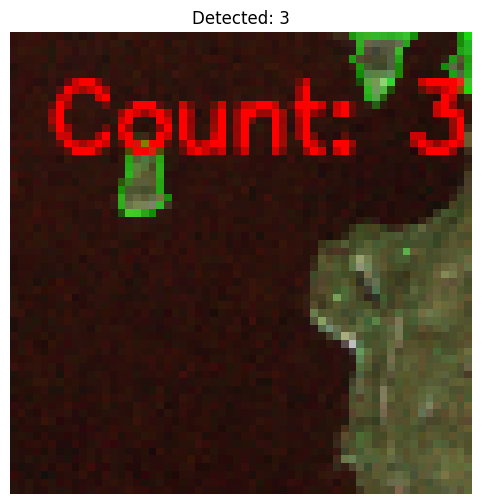

[69/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


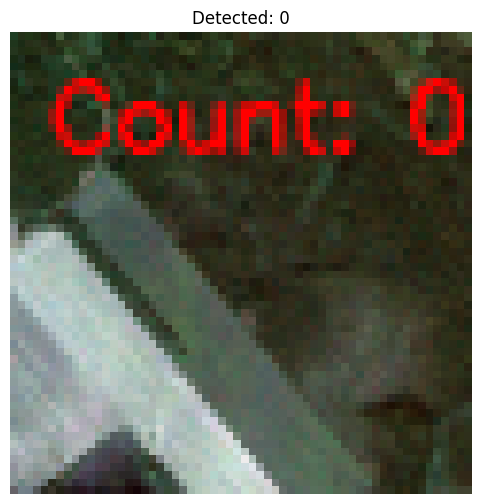

[70/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


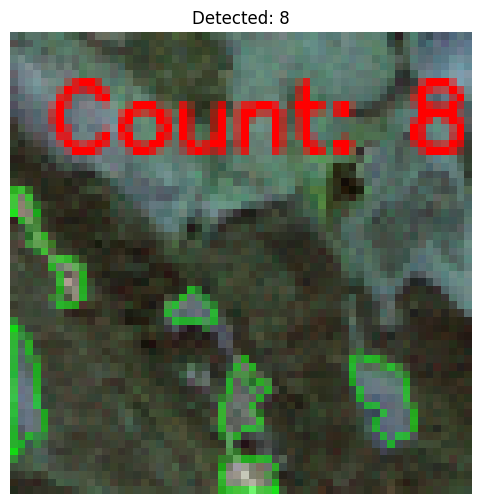

[71/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


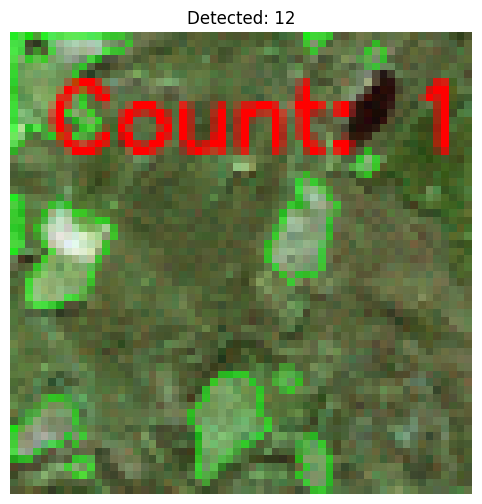

[72/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


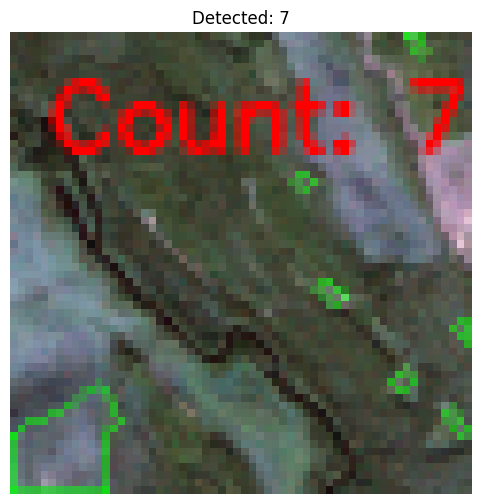

[73/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


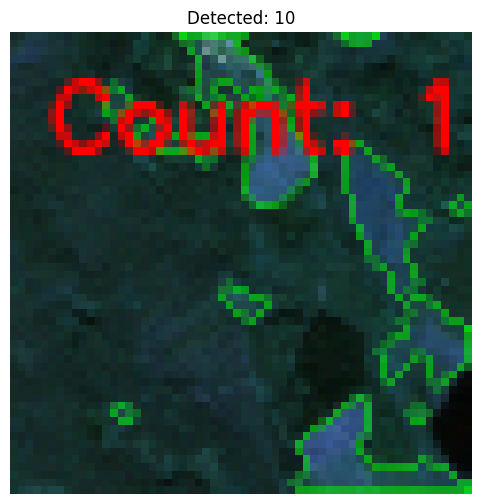

[74/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


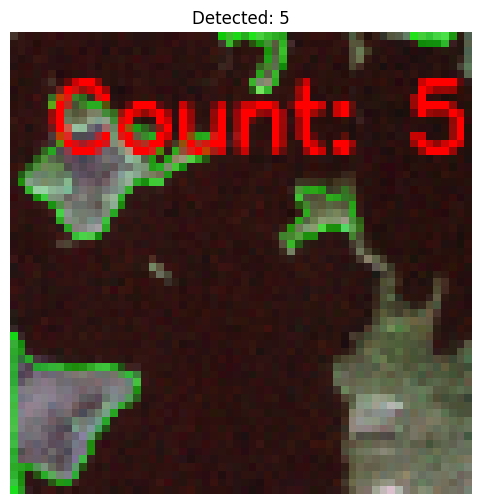

[75/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


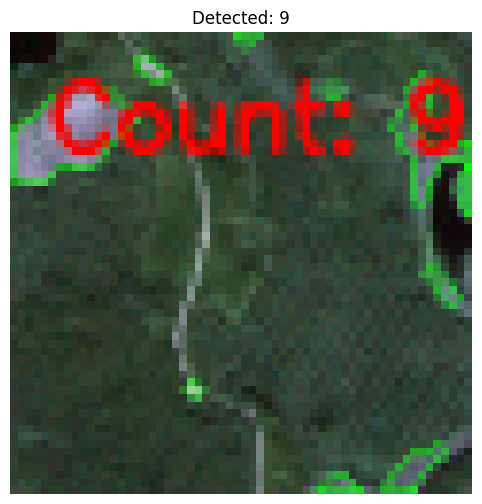

[76/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


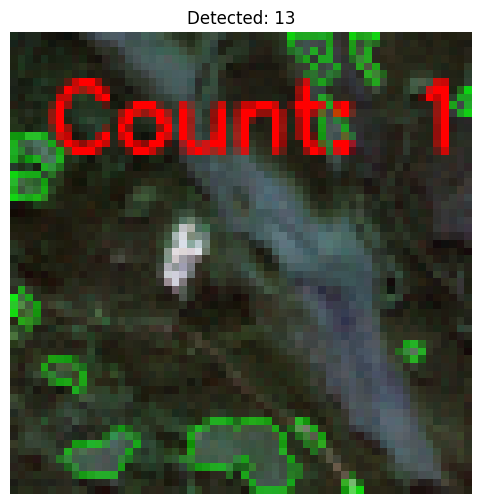

[77/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


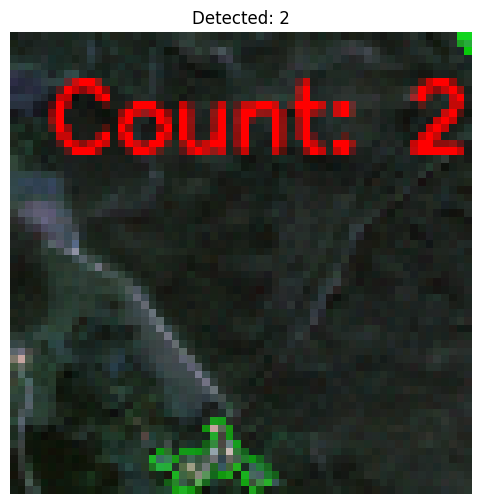

[78/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


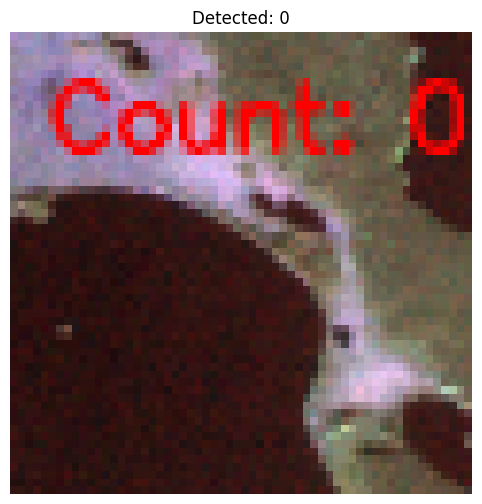

[79/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


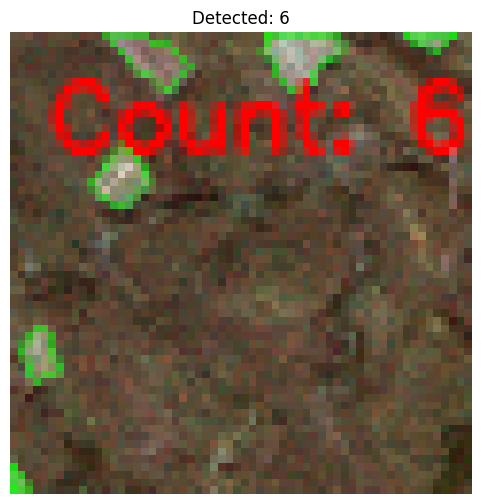

[80/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


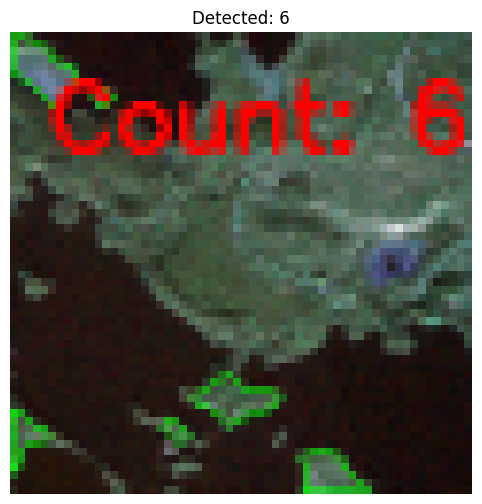

[81/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


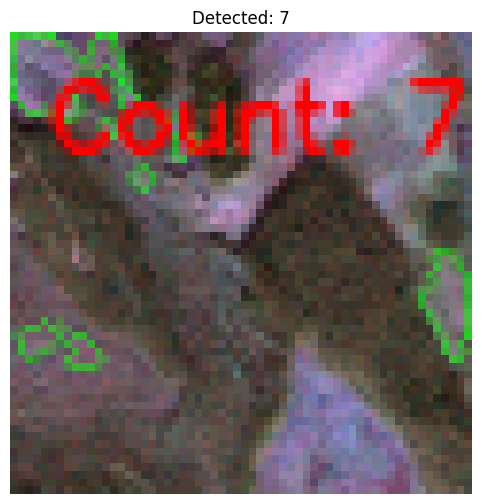

[82/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


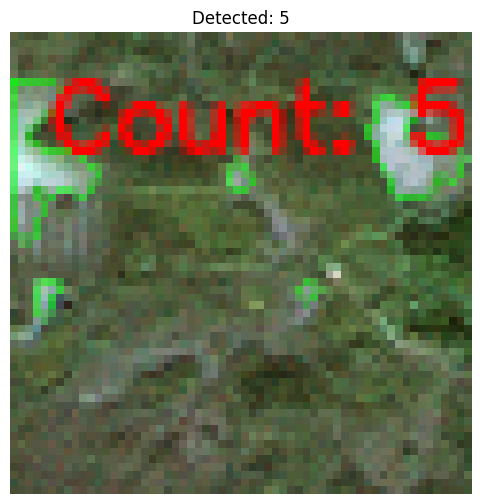

[83/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_23_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_23_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


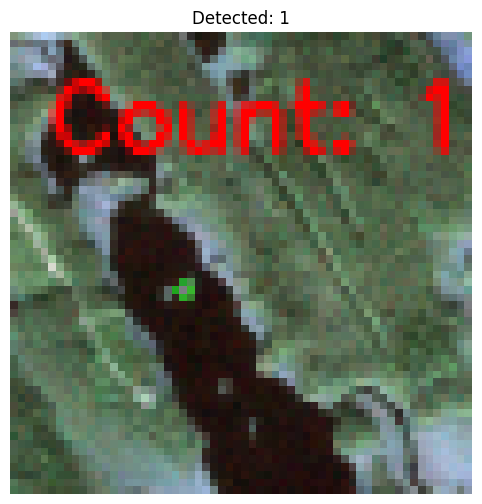

[84/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


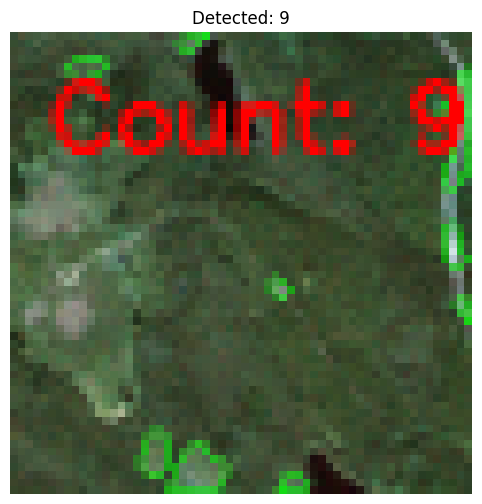

[85/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


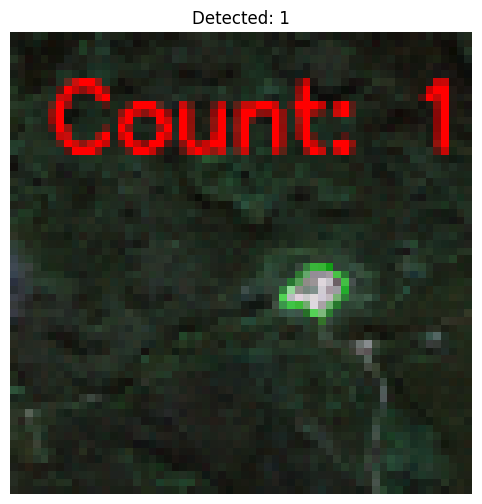

[86/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


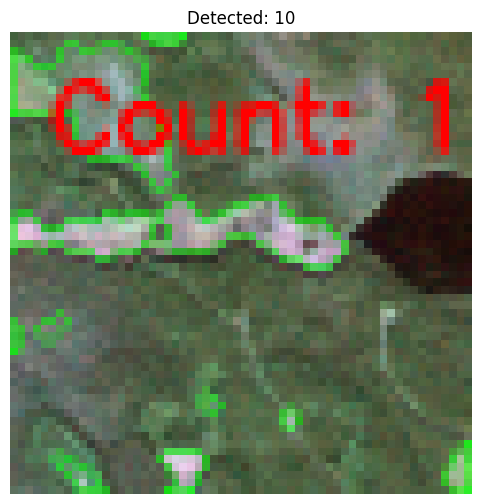

[87/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


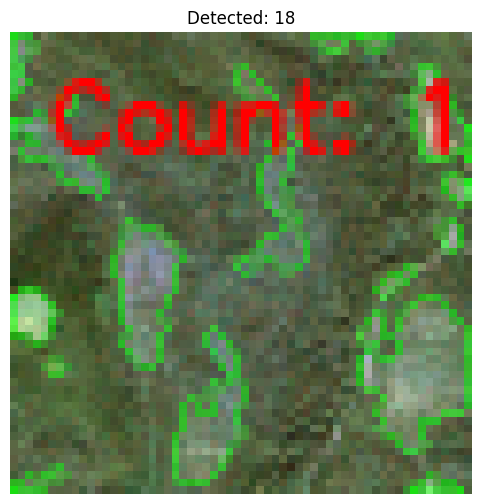

[88/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


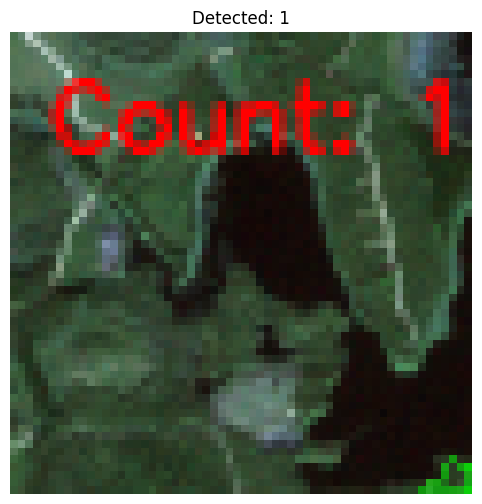

[89/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


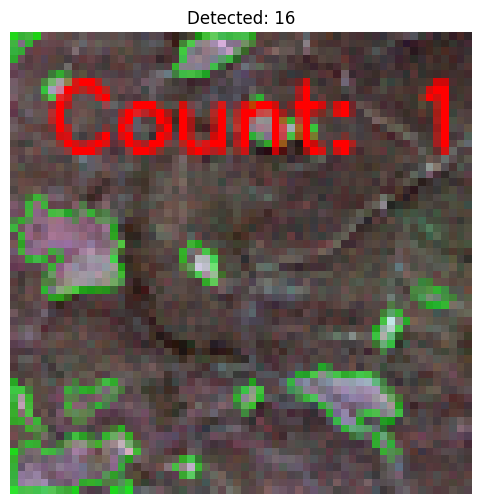

[90/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


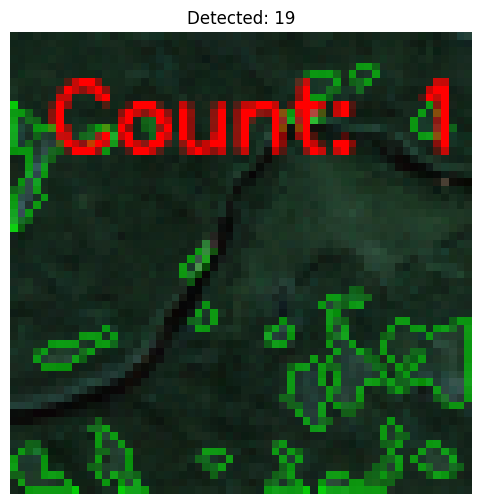

[91/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


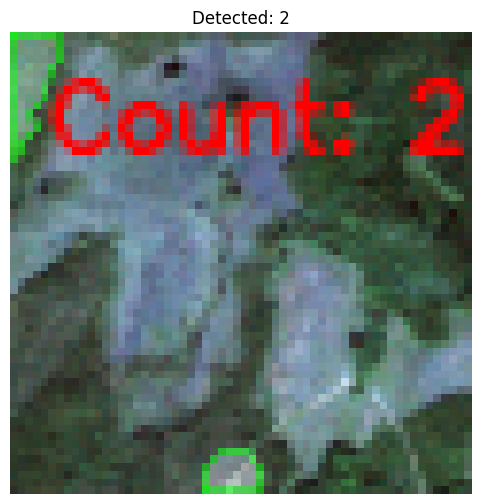

[92/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


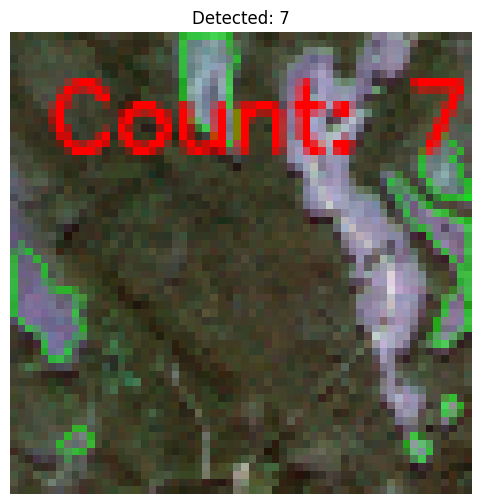

[93/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


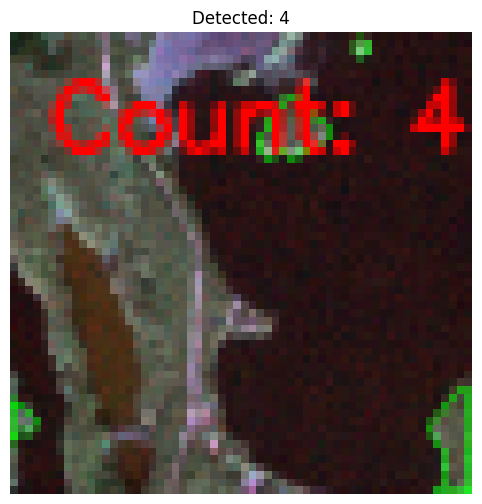

[94/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


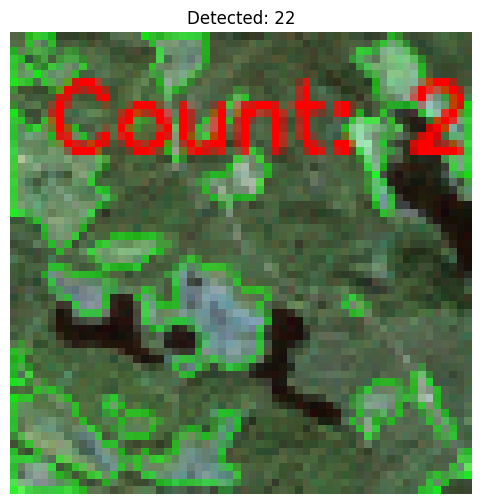

[95/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


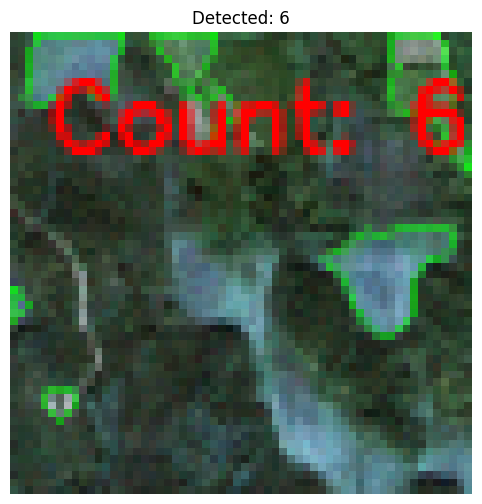

[96/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


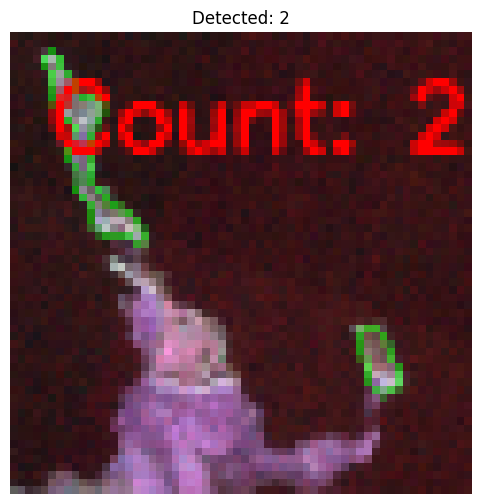

[97/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


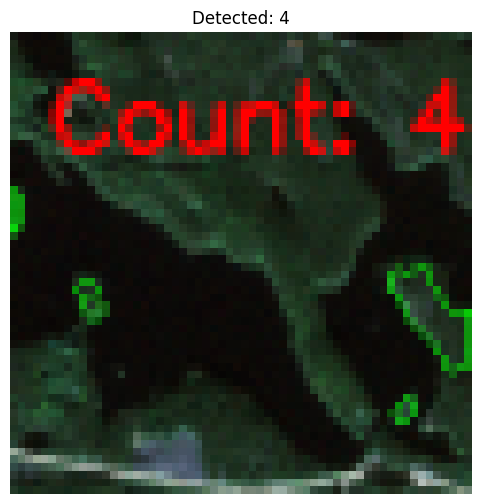

[98/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


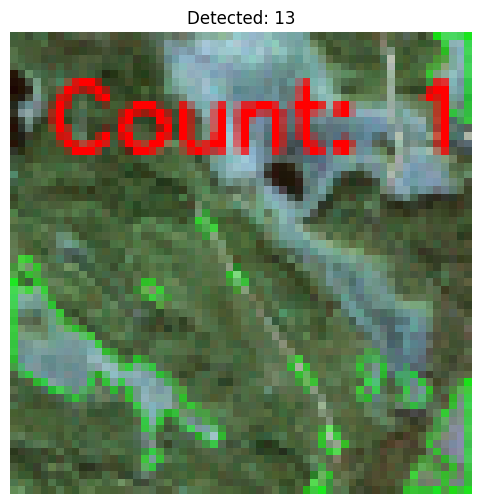

[99/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


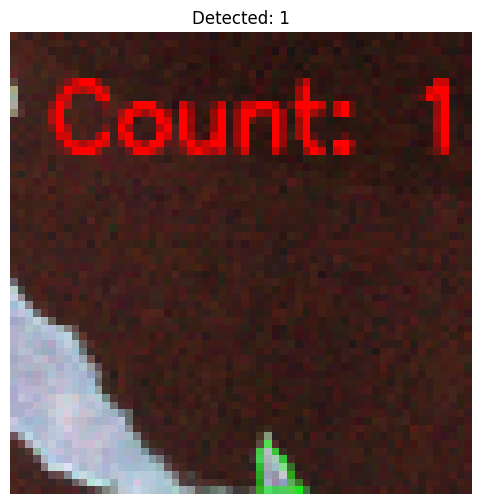

[100/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


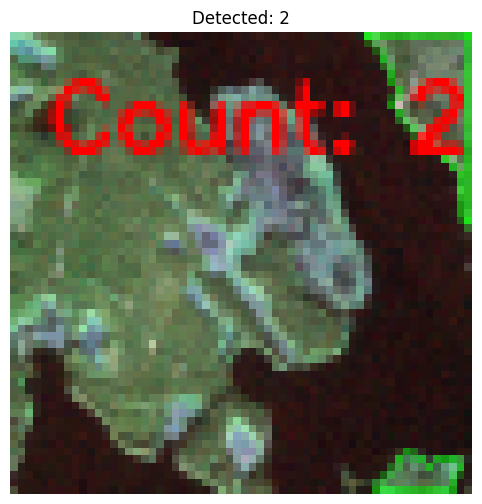

[101/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


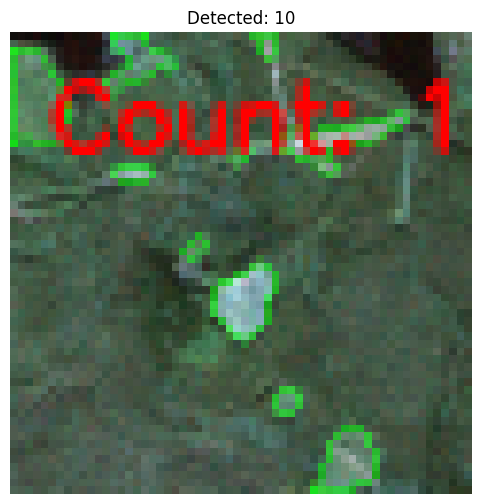

[102/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


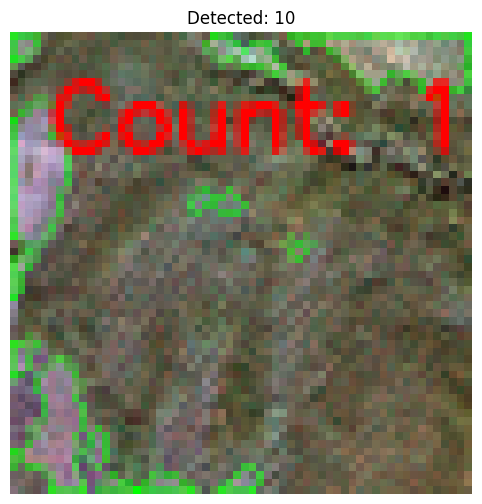

[103/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


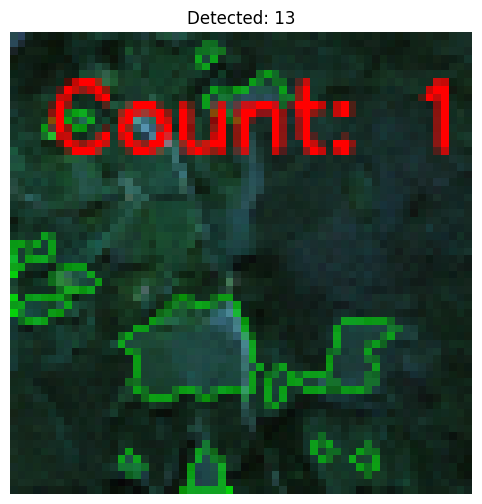

[104/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


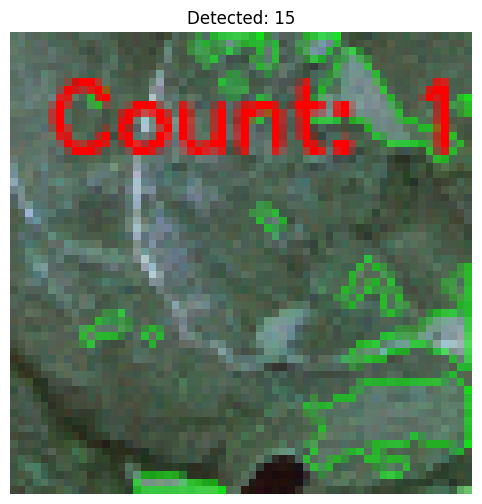

[105/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


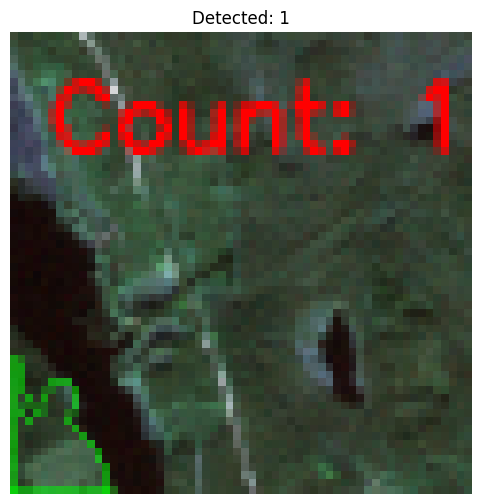

[106/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


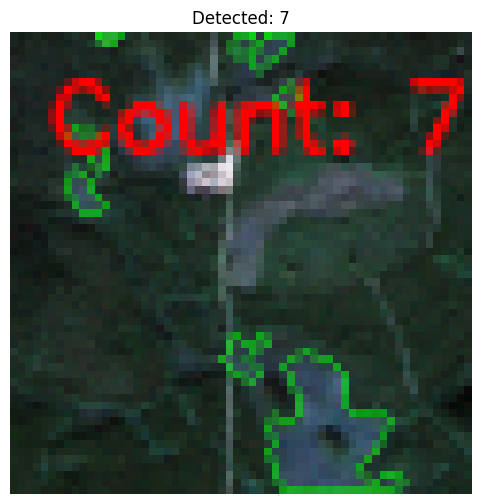

[107/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


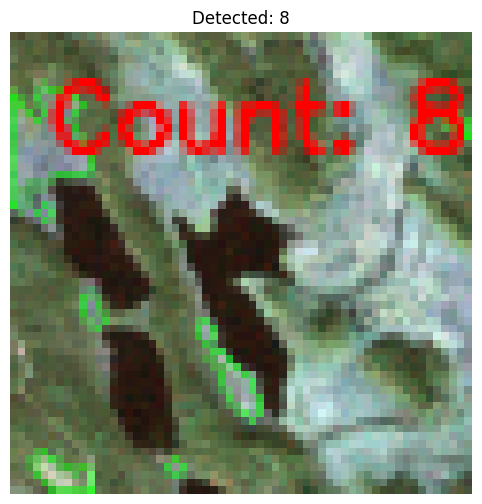

[108/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


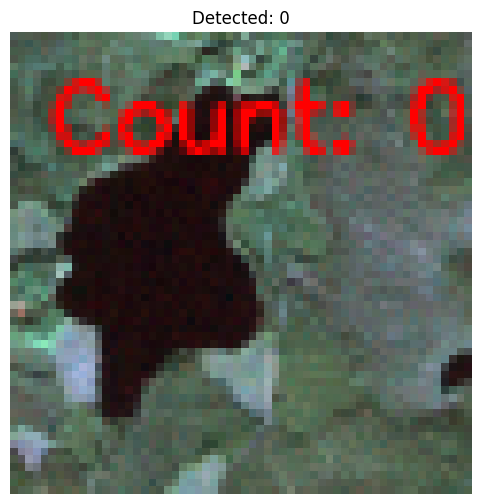

[109/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


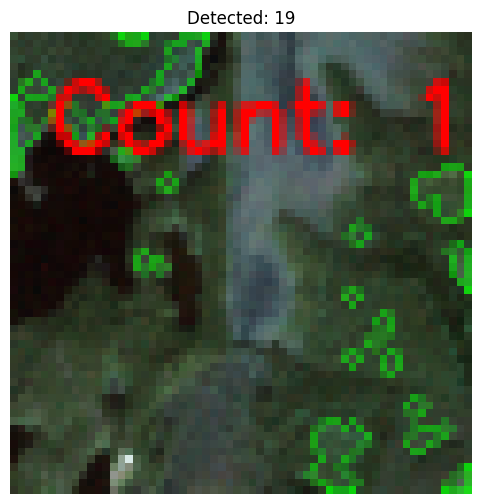

[110/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


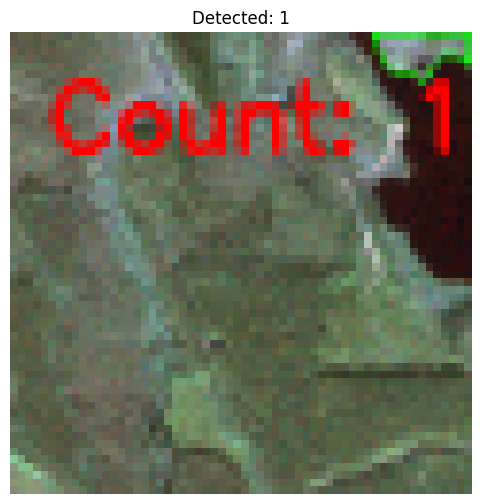

[111/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


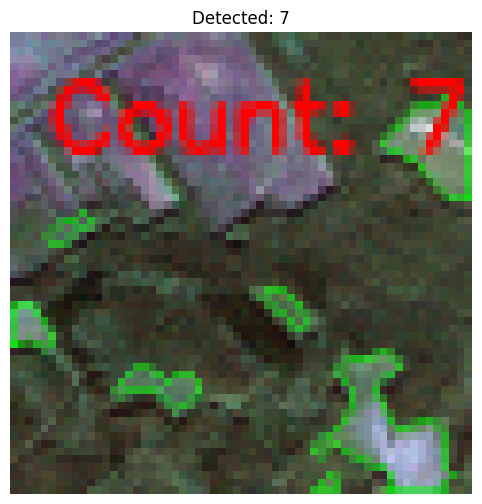

[112/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


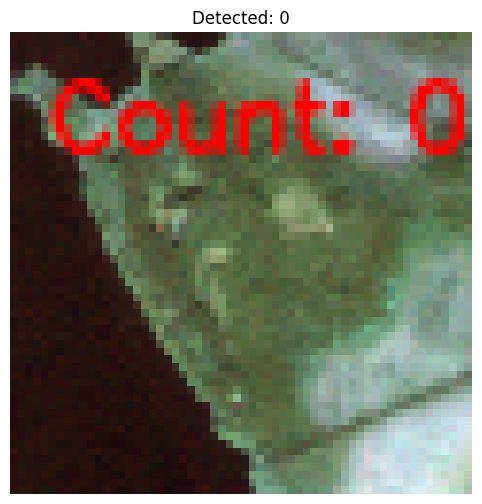

[113/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


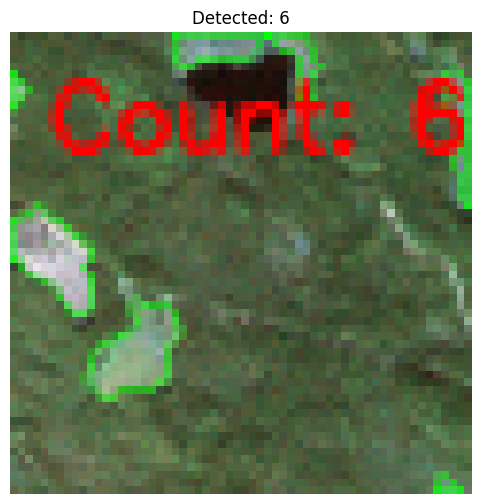

[114/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


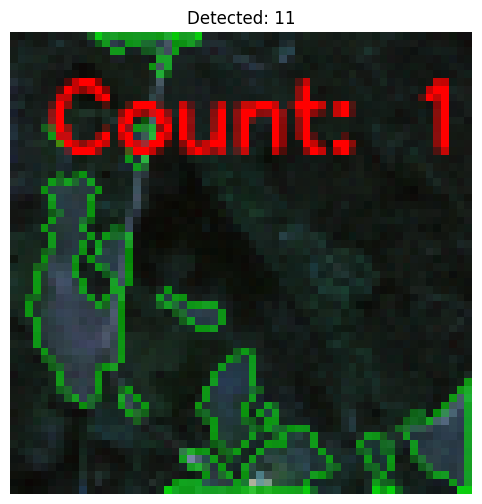

[115/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


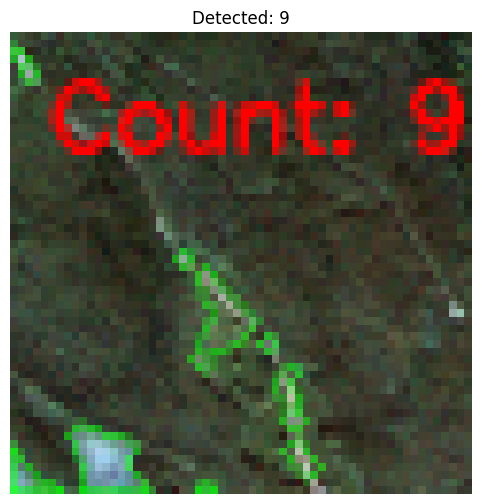

[116/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


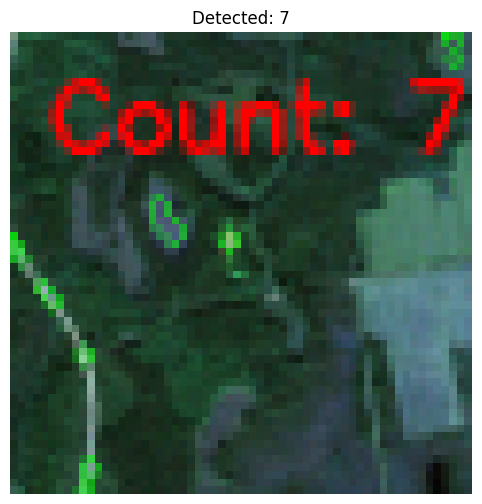

[117/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


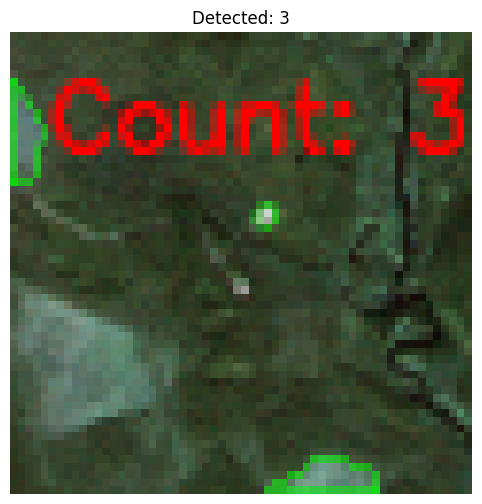

[118/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


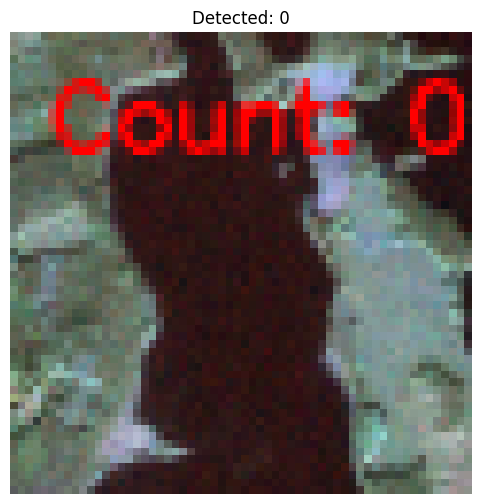

[119/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


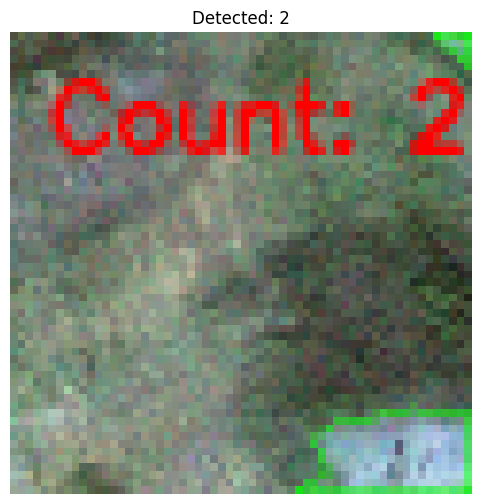

[120/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


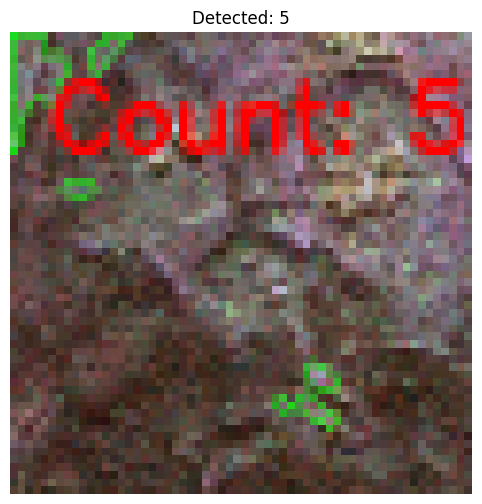

[121/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


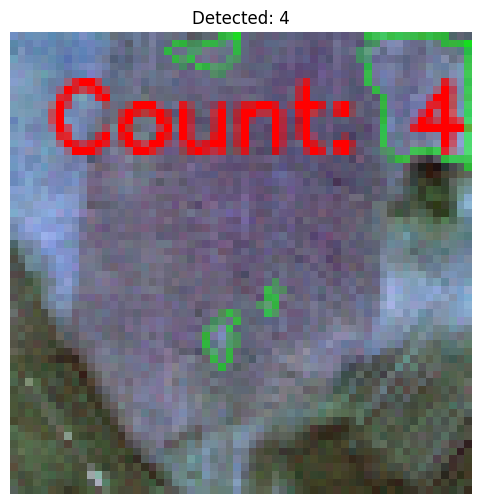

[122/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


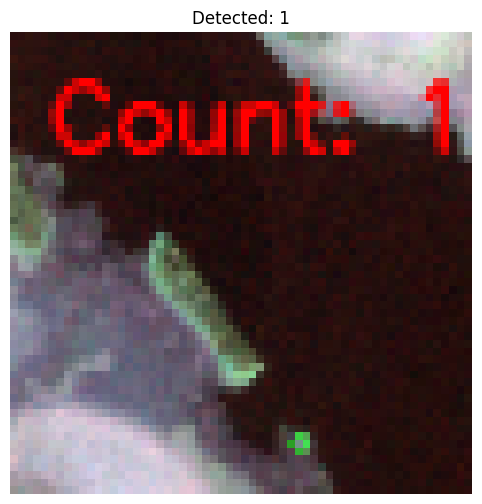

[123/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


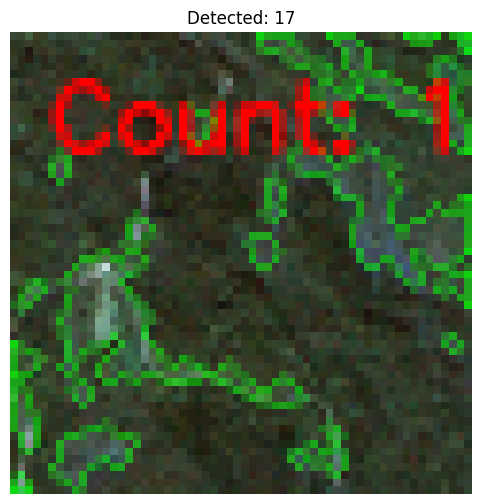

[124/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


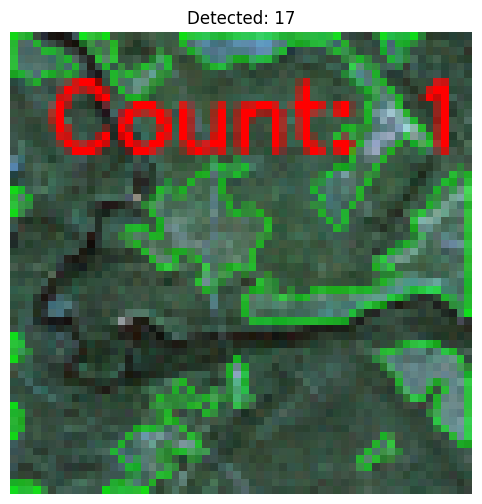

[125/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


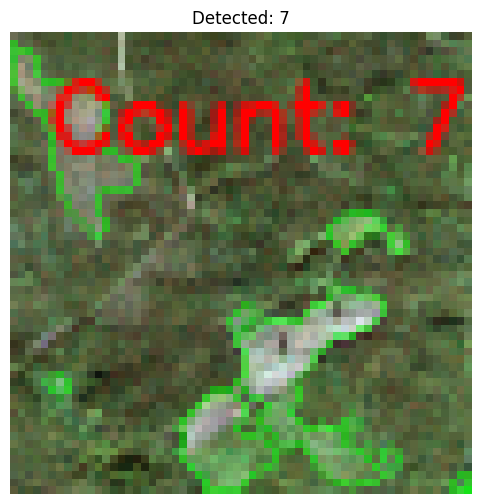

[126/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


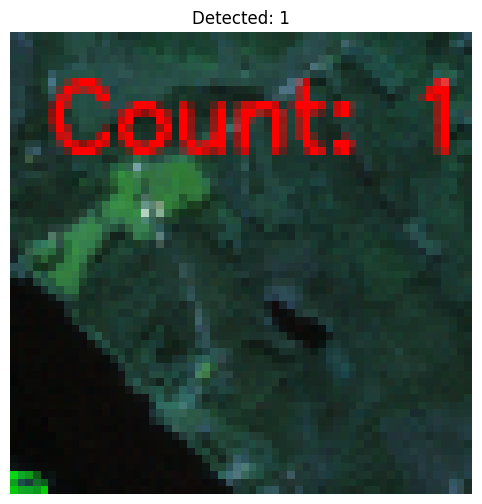

[127/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


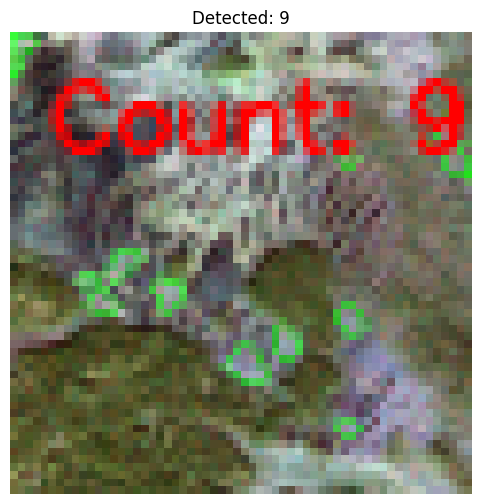

[128/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


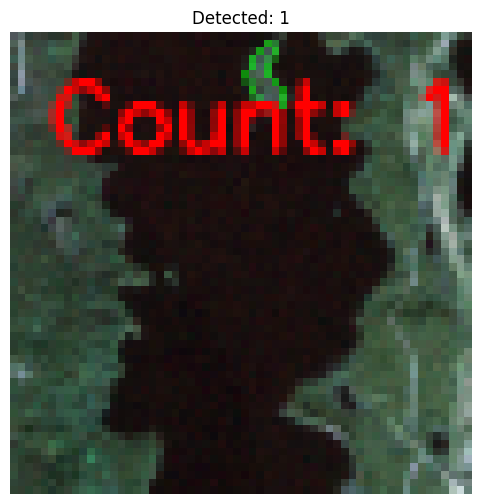

[129/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


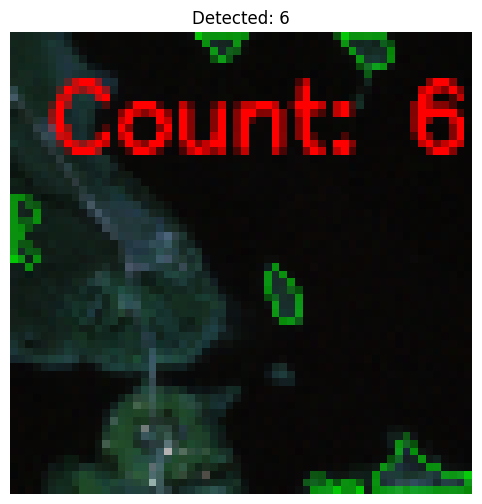

[130/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


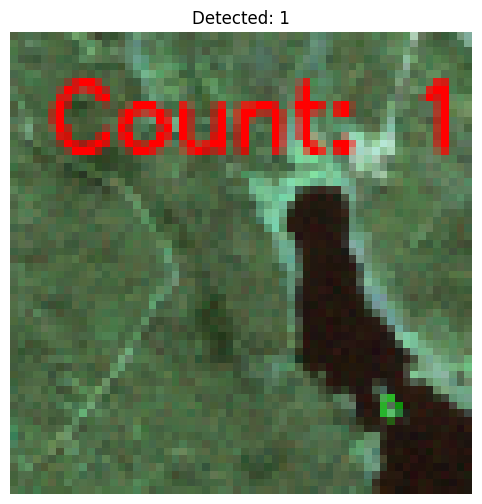

[131/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


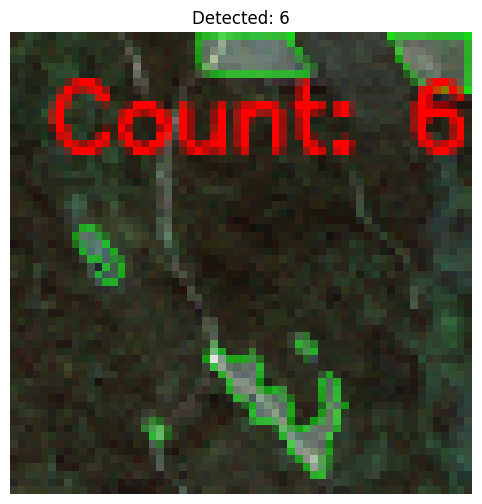

[132/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


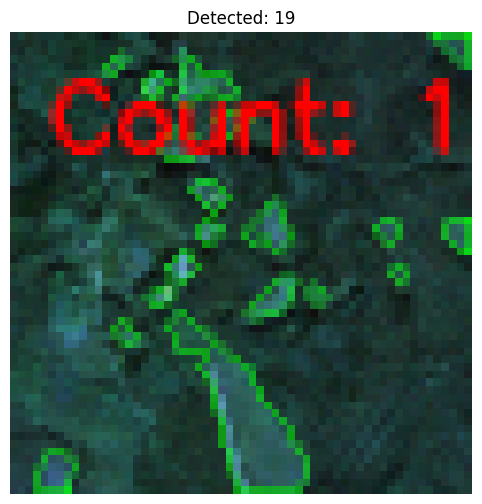

[133/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


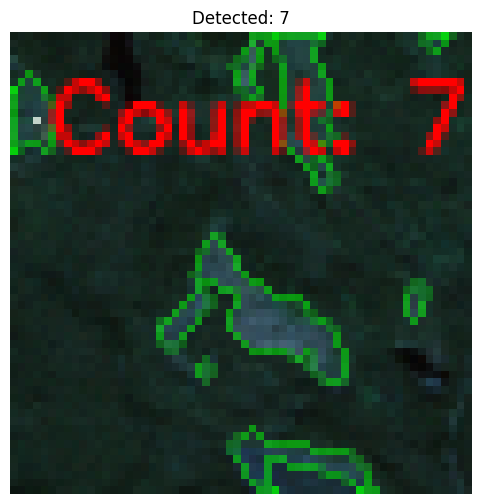

[134/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


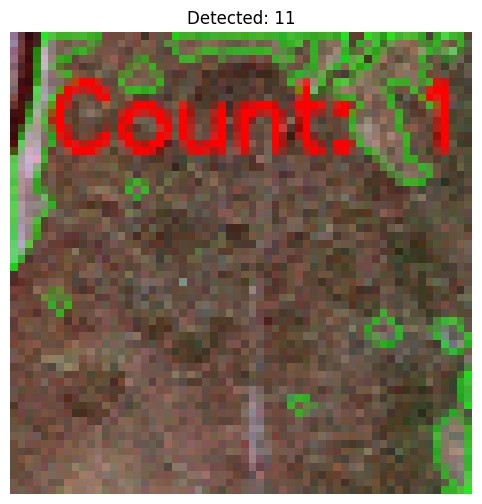

[135/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


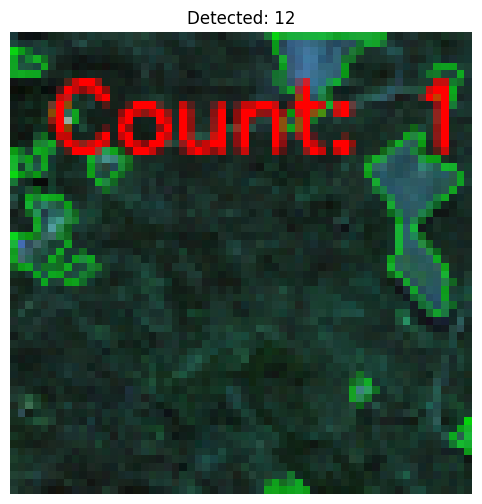

[136/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


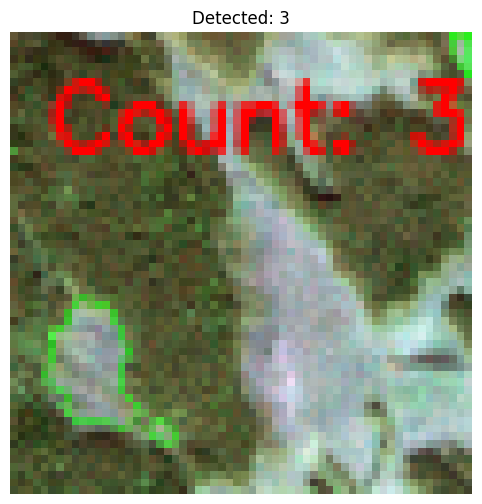

[137/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


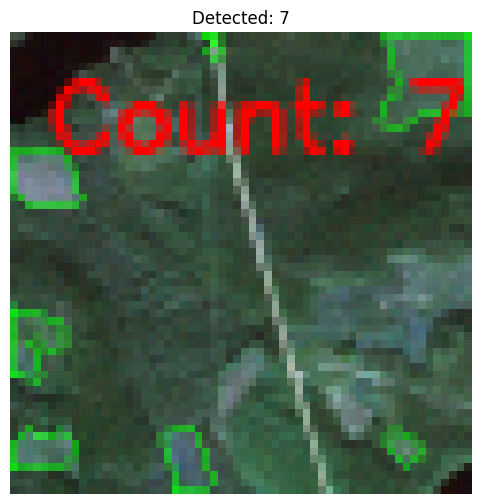

[138/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


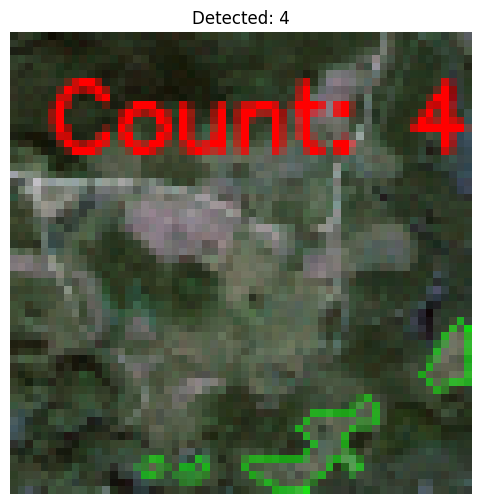

[139/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


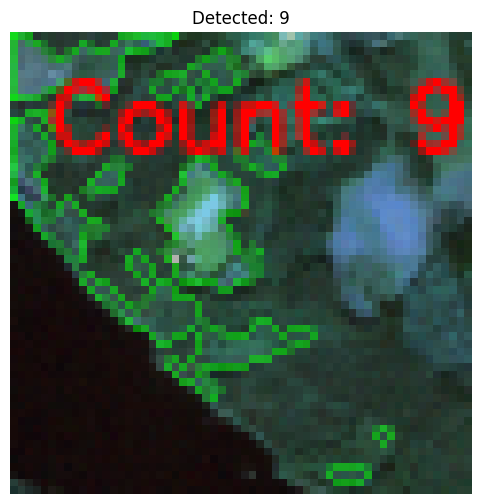

[140/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


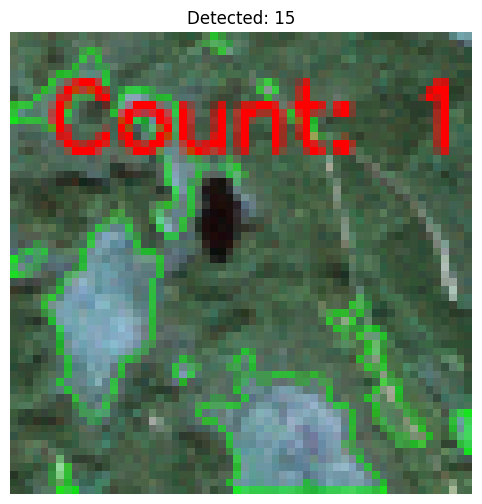

[141/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


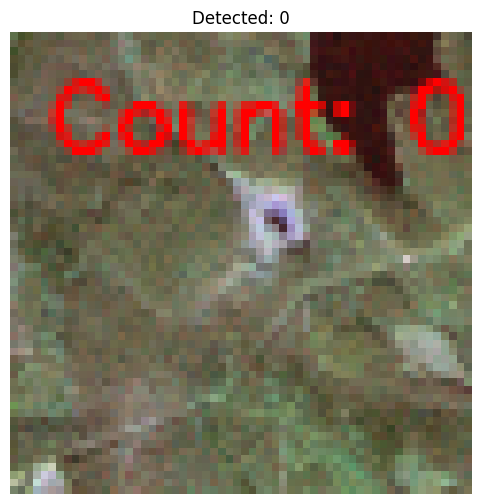

[142/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


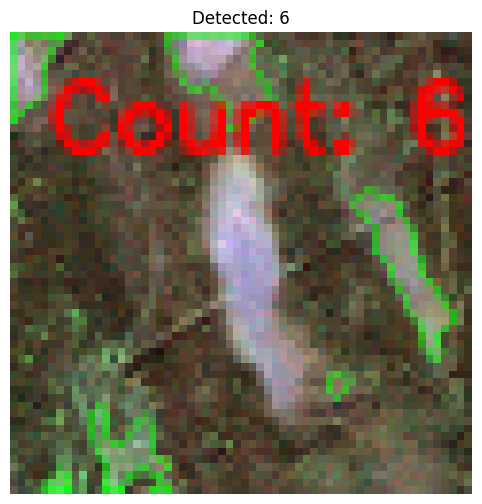

[143/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


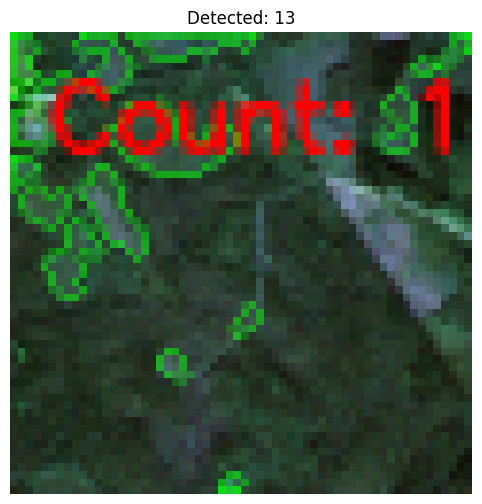

[144/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


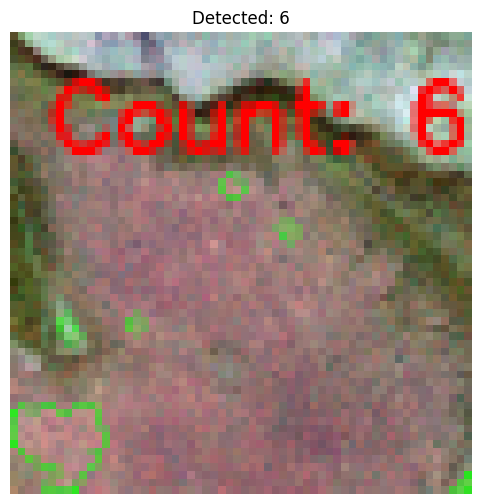

[145/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


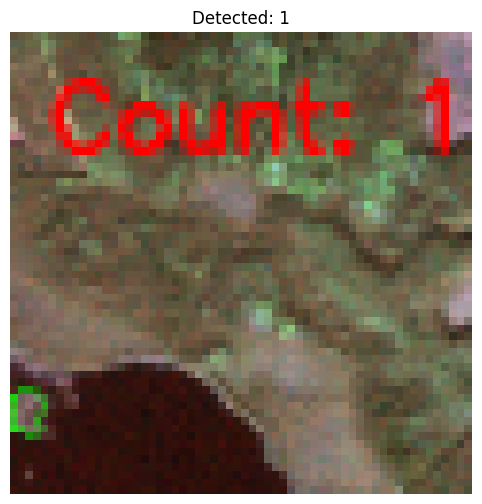

[146/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


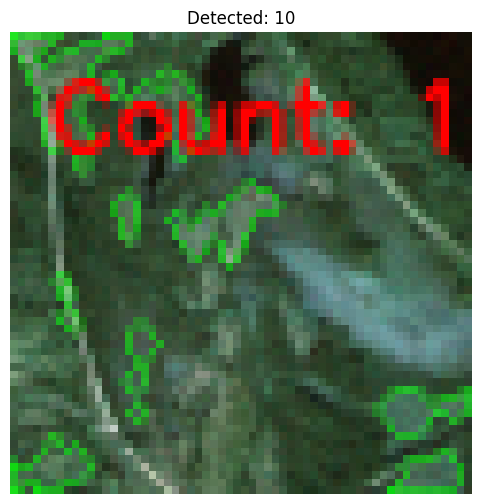

[147/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


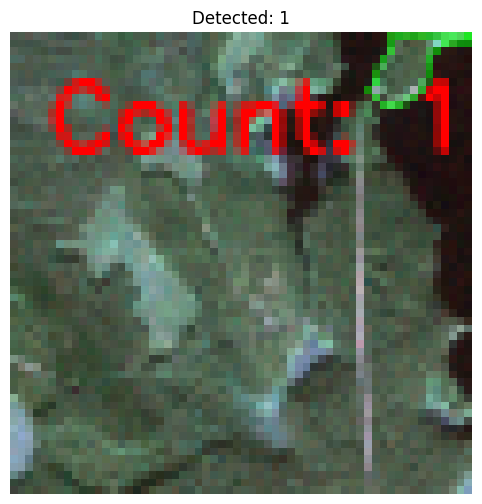

[148/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


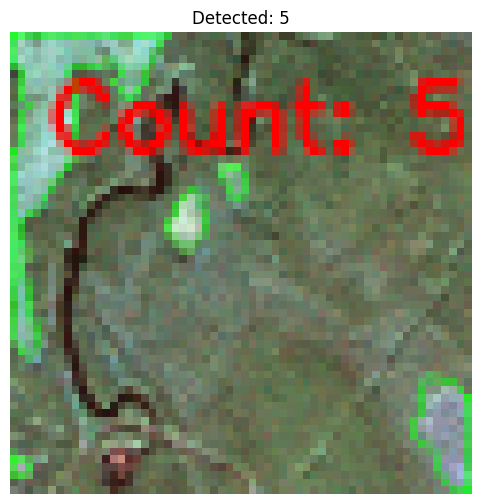

[149/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


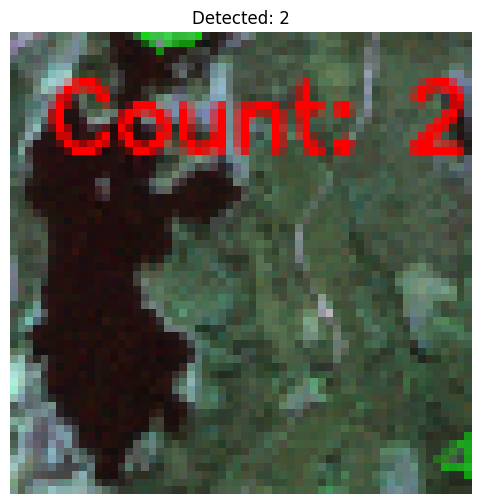

[150/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


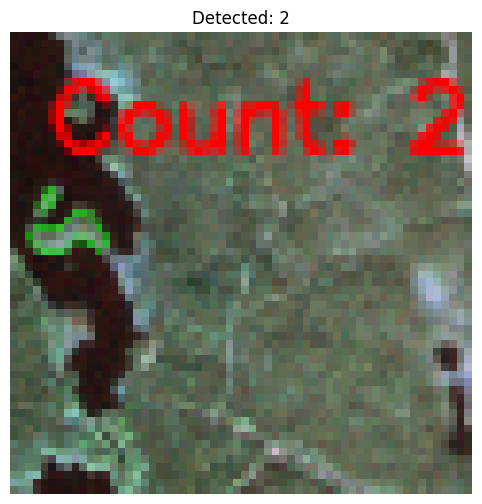

[151/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


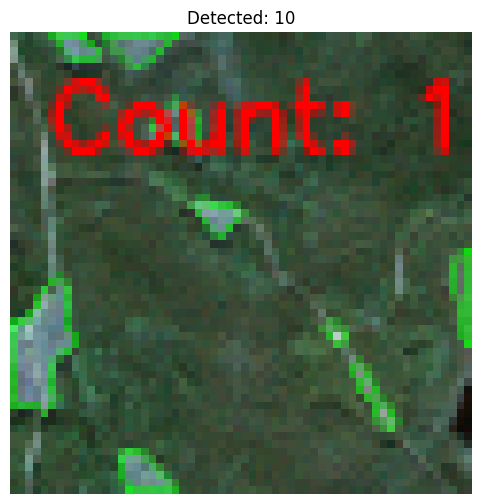

[152/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


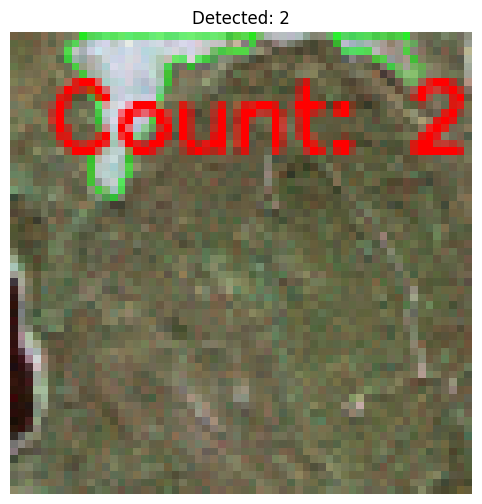

[153/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


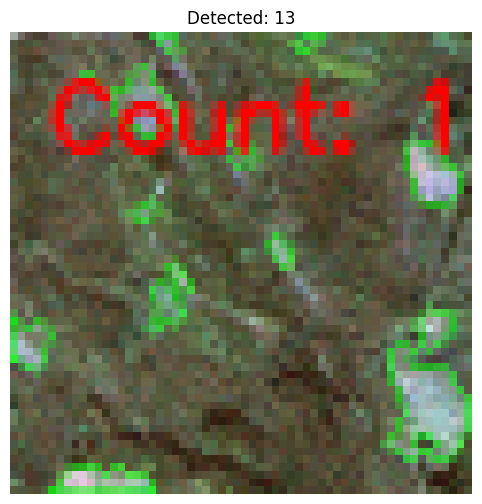

[154/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


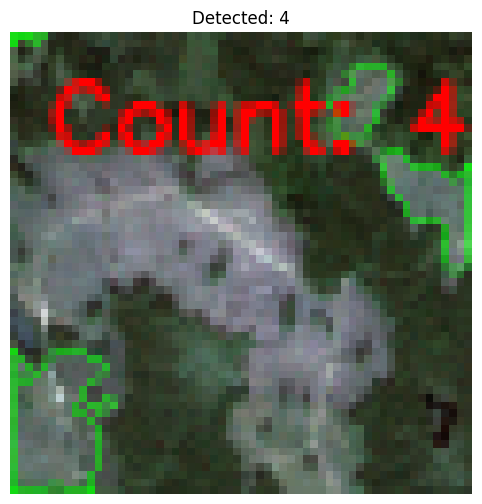

[155/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


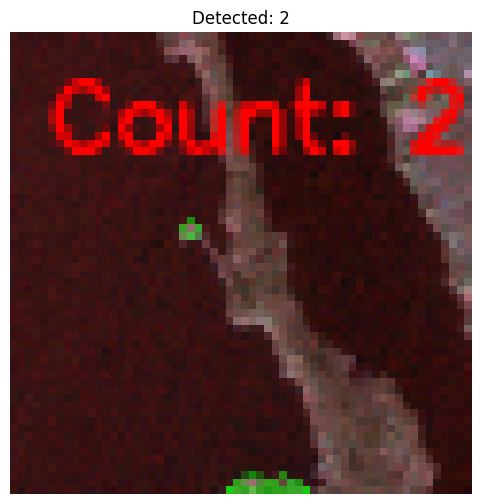

[156/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


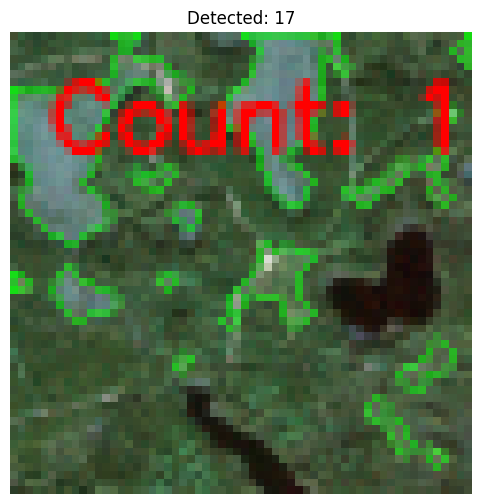

[157/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


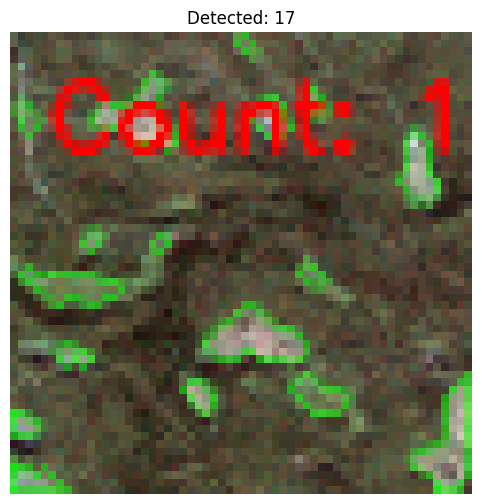

[158/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


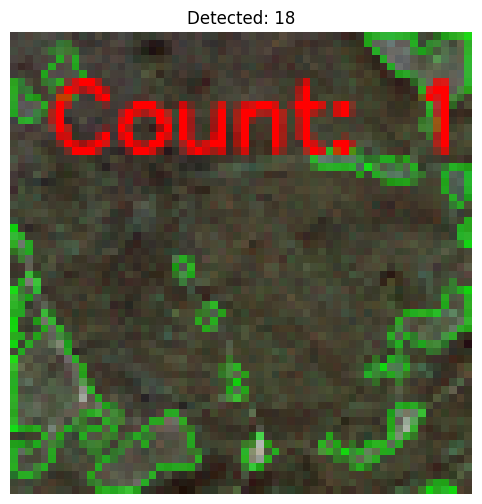

[159/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


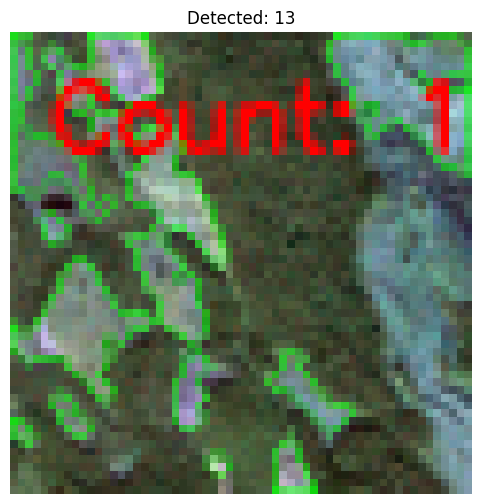

[160/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


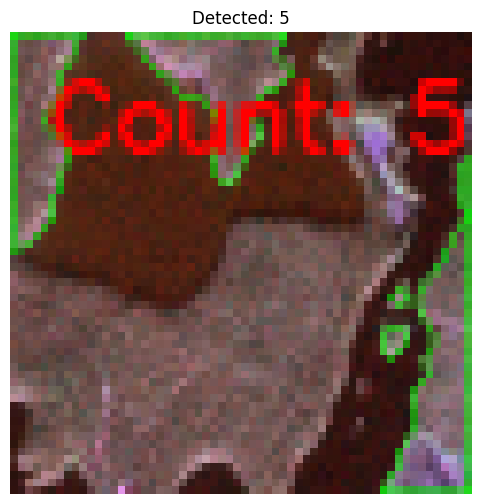

[161/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


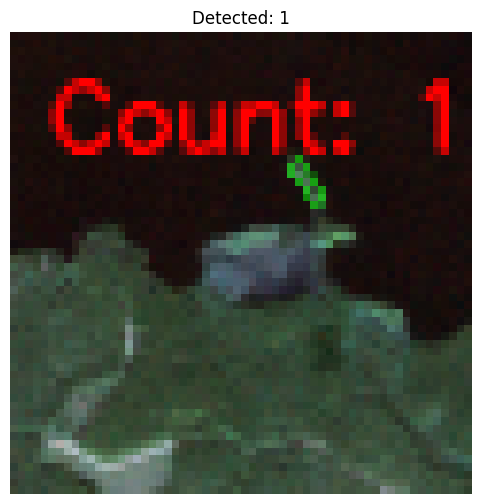

[162/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


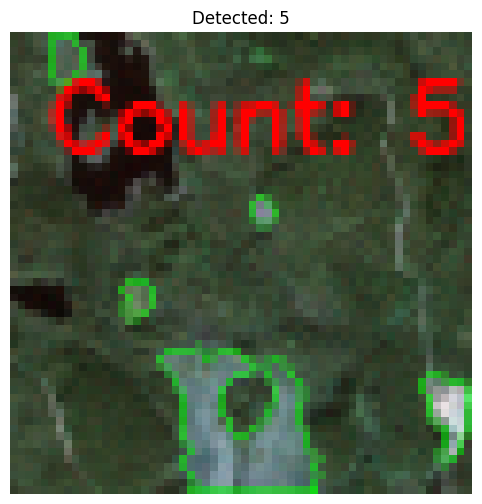

[163/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


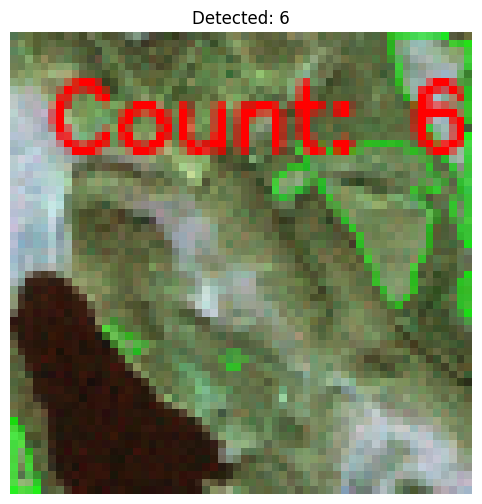

[164/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


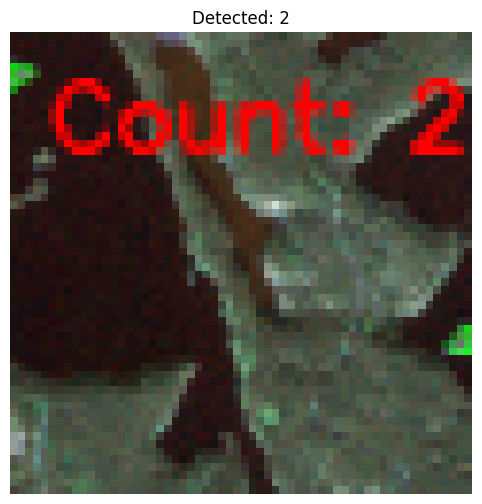

[165/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


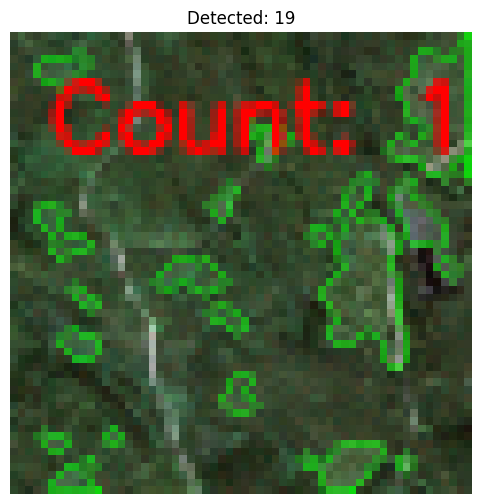

[166/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


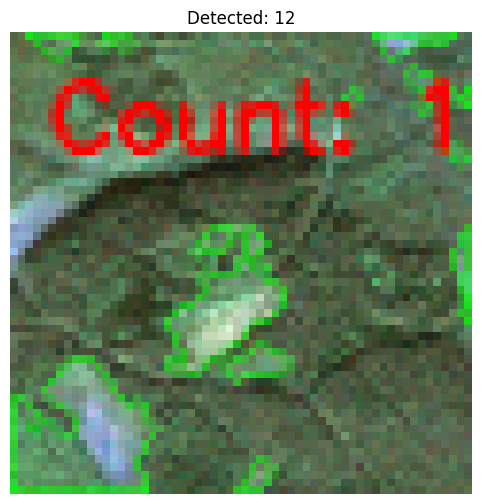

[167/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


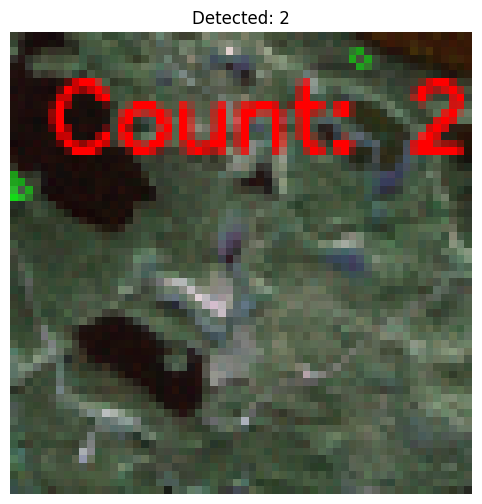

[168/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


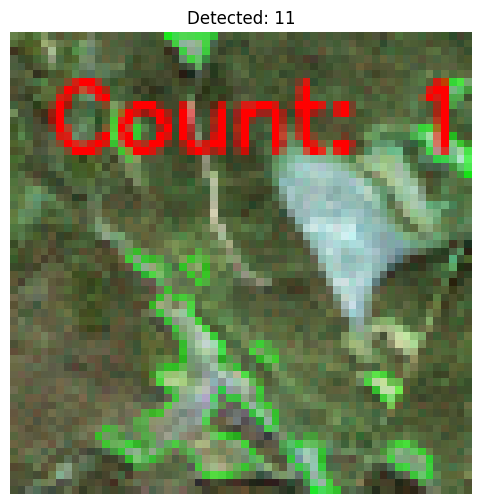

[169/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


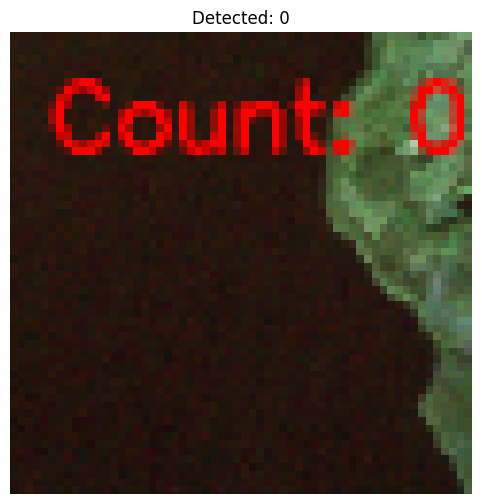

[170/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


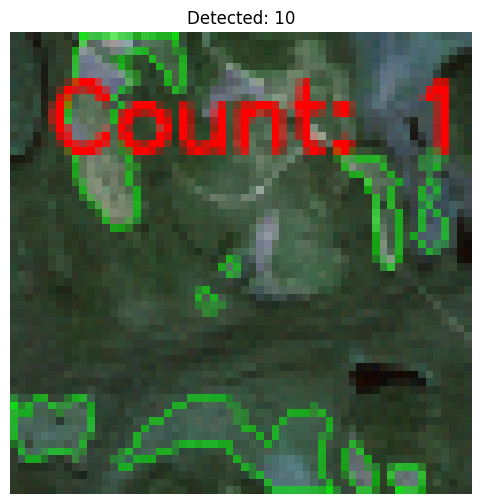

[171/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


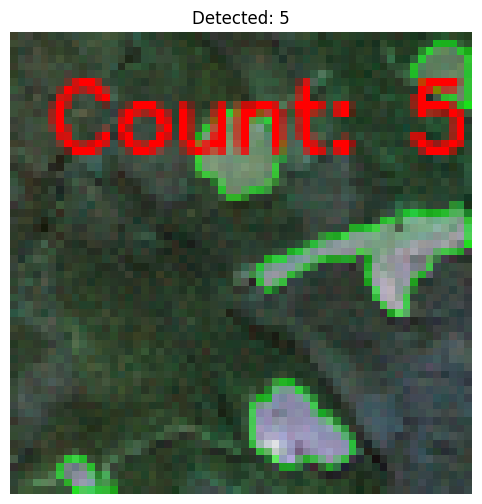

[172/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


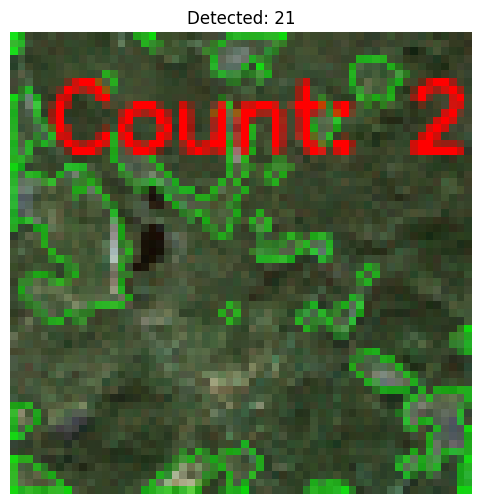

[173/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


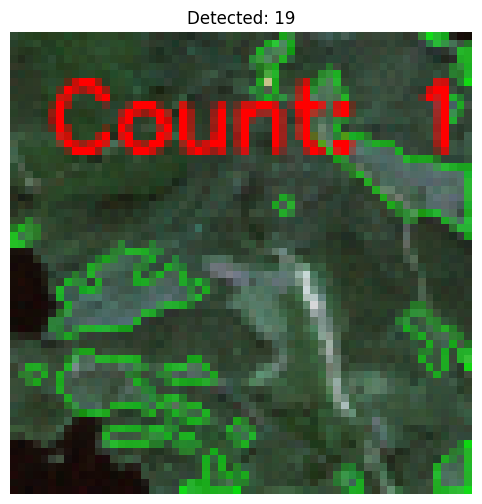

[174/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


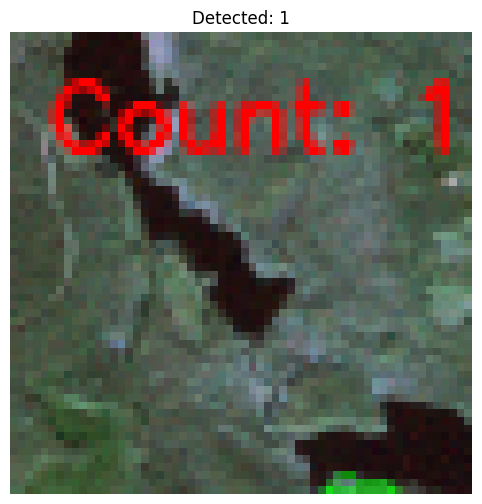

[175/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


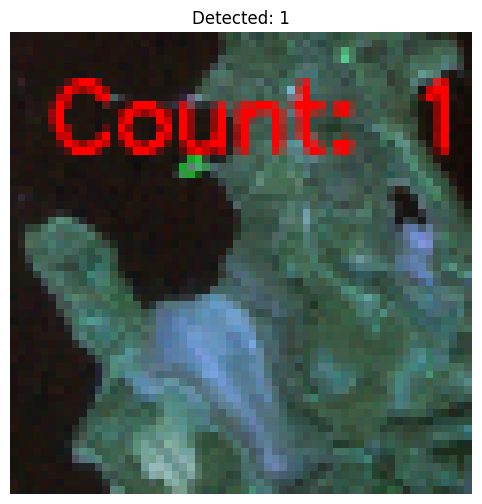

[176/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


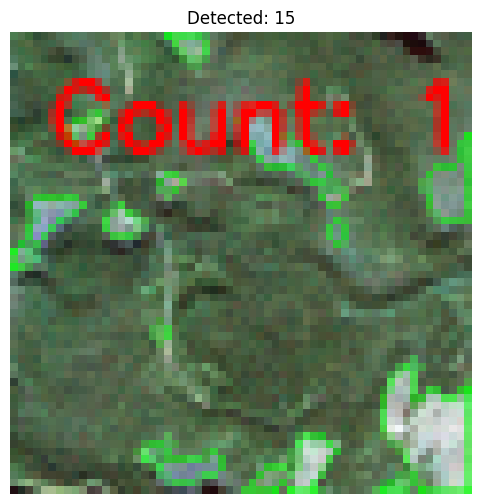

[177/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


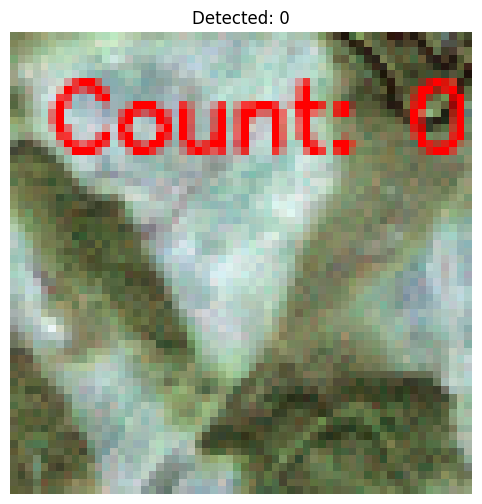

[178/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


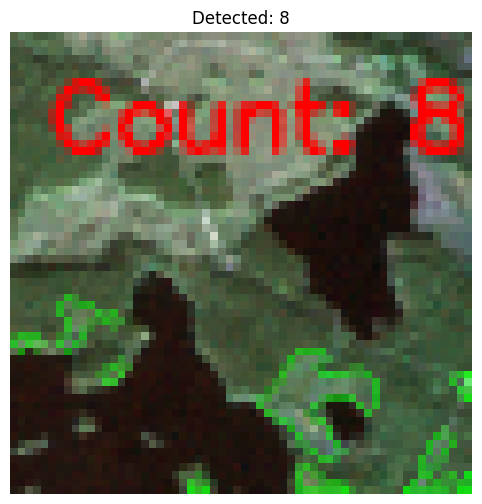

[179/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


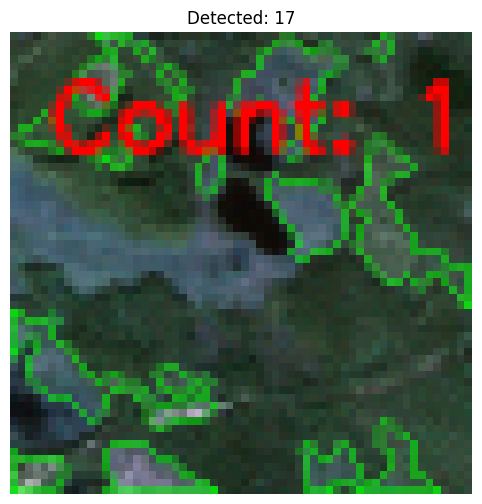

[180/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


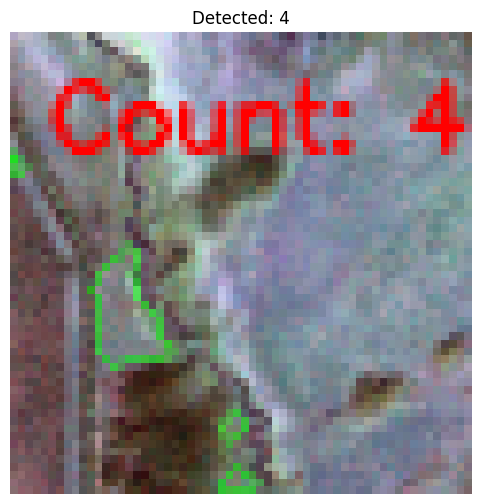

[181/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


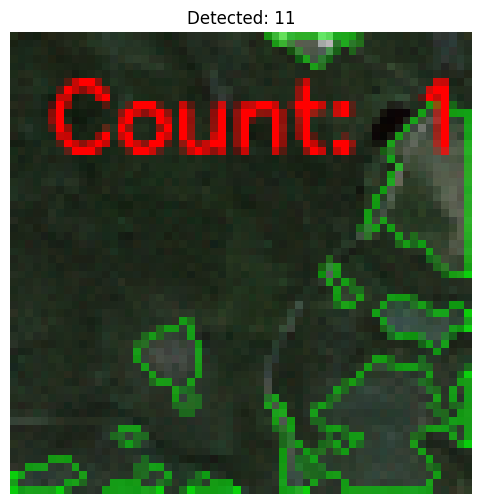

[182/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


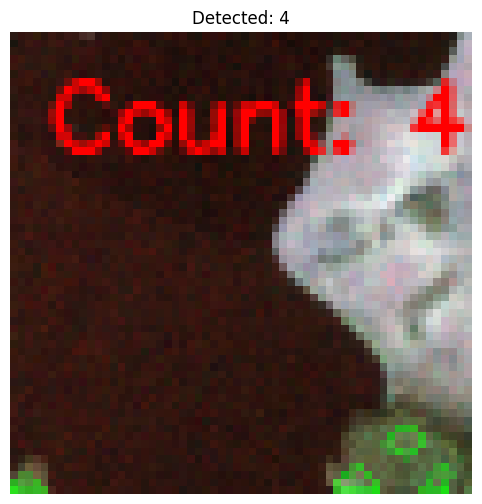

[183/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


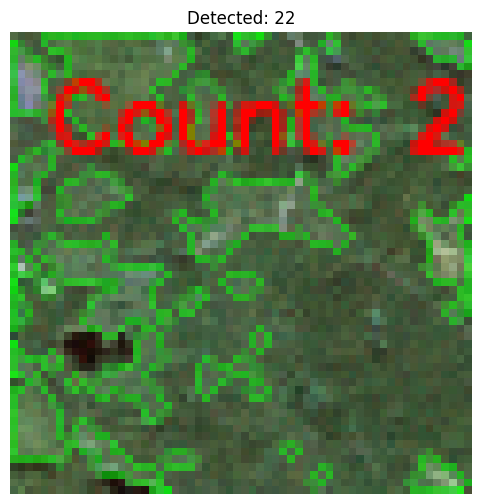

[184/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


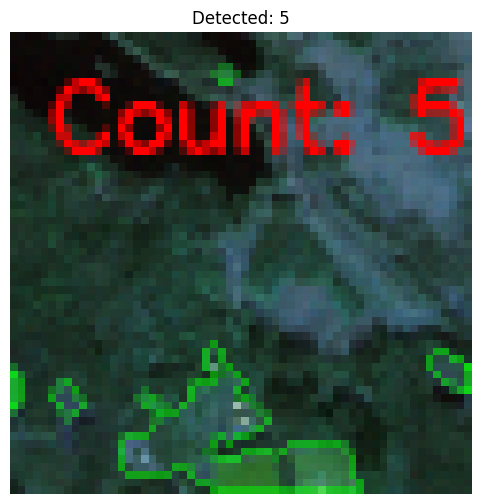

[185/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


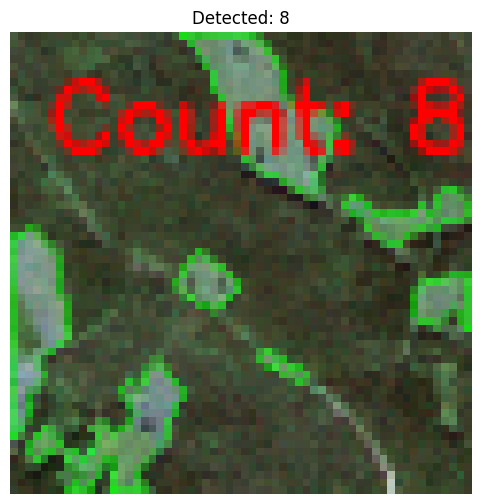

[186/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


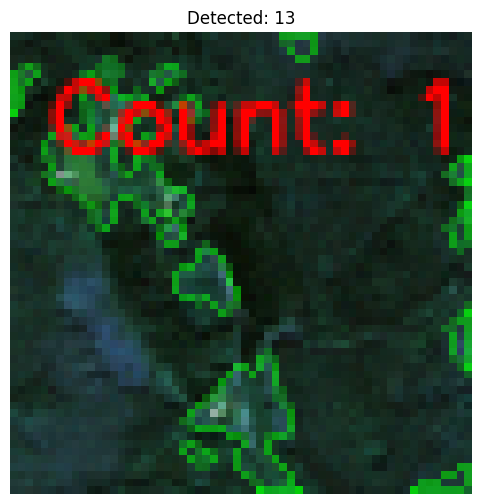

[187/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


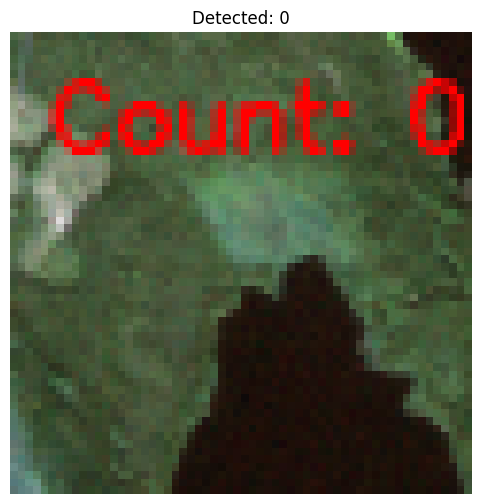

[188/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


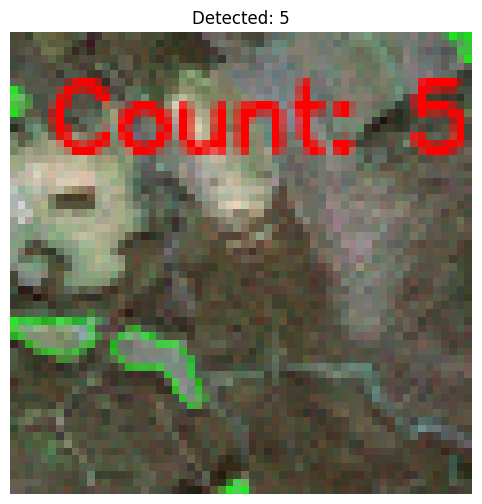

[189/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


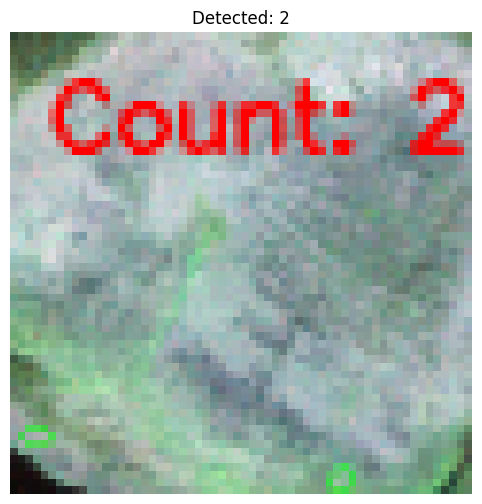

[190/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


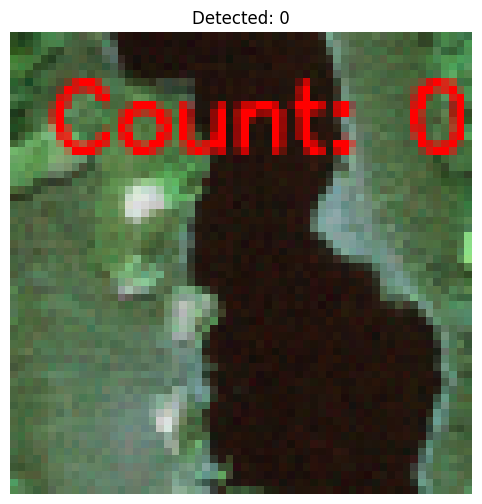

[191/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


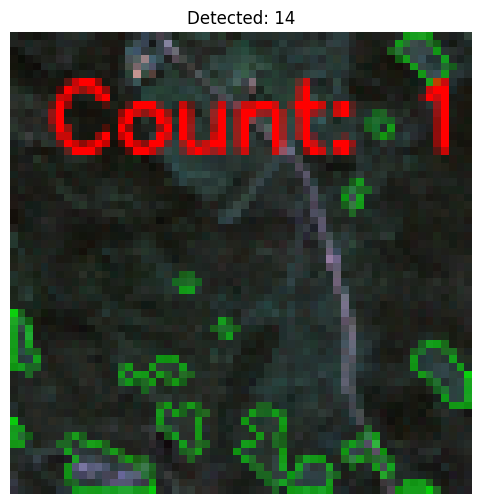

[192/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


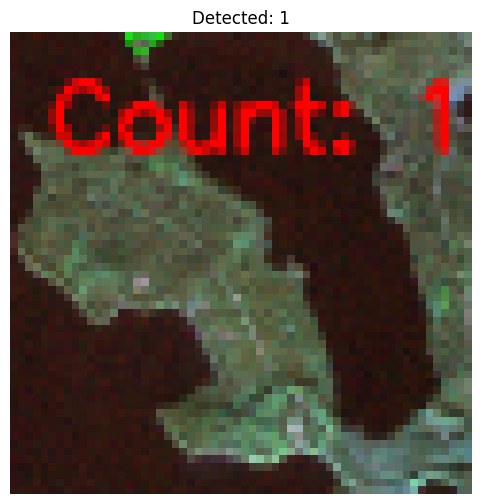

[193/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


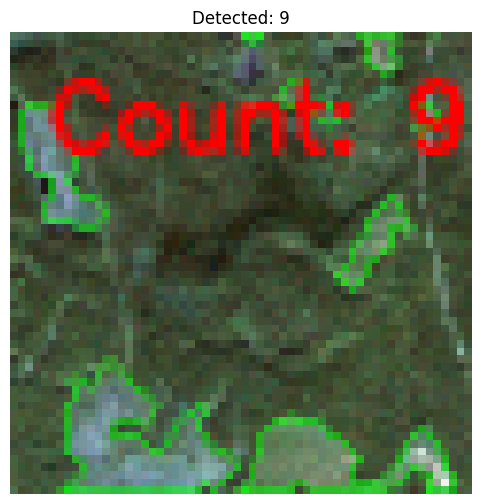

[194/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


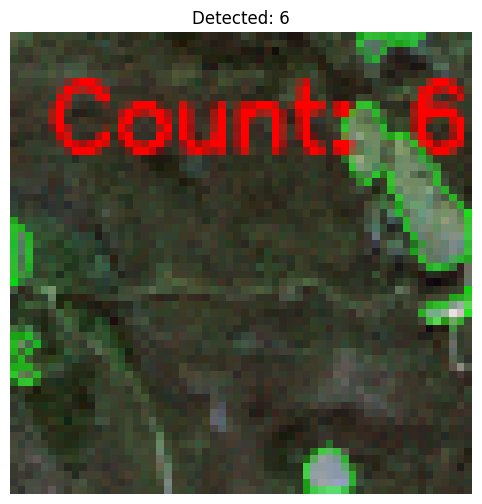

[195/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


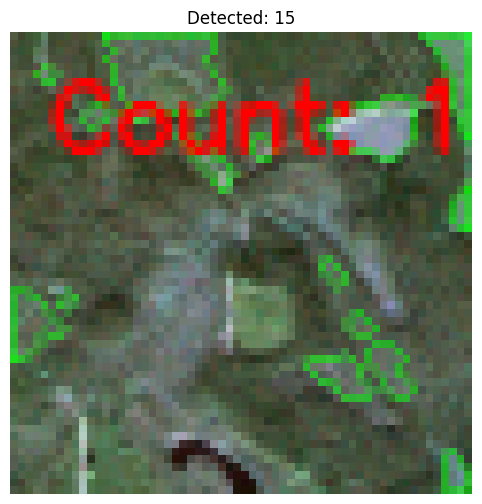

[196/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


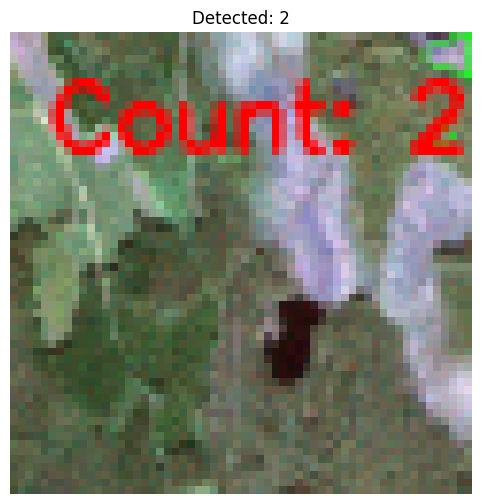

[197/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


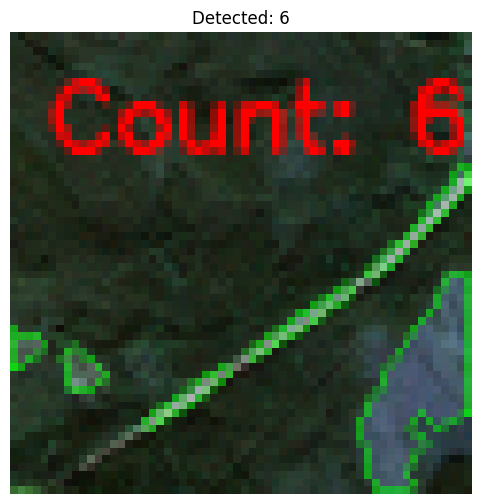

[198/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


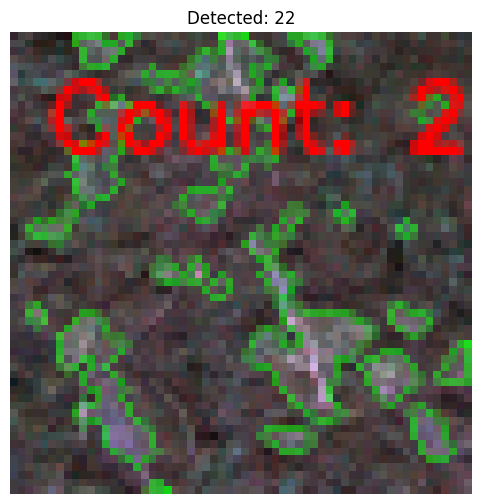

[199/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


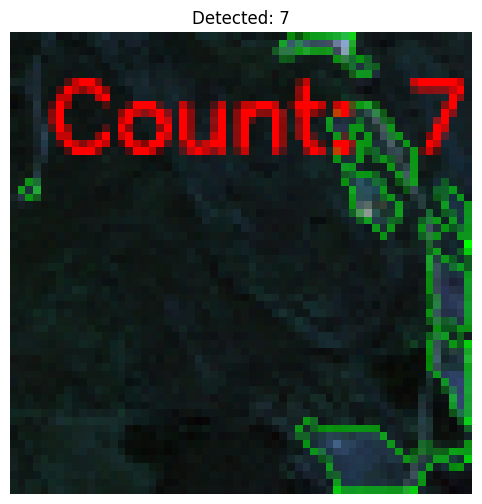

[200/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


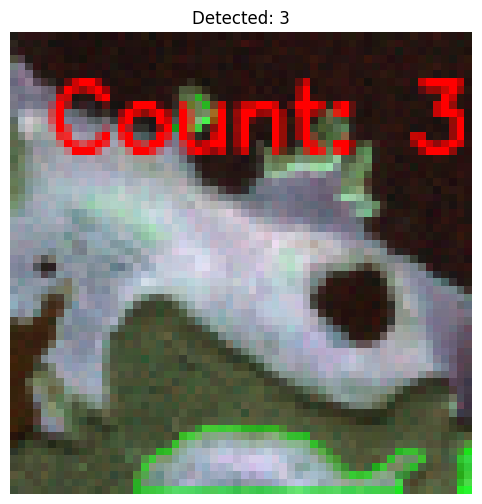

[201/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


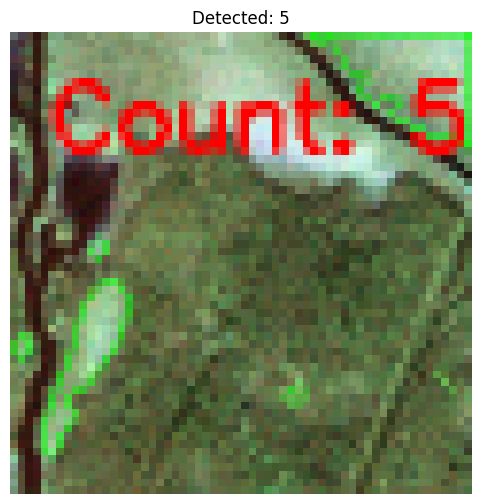

[202/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


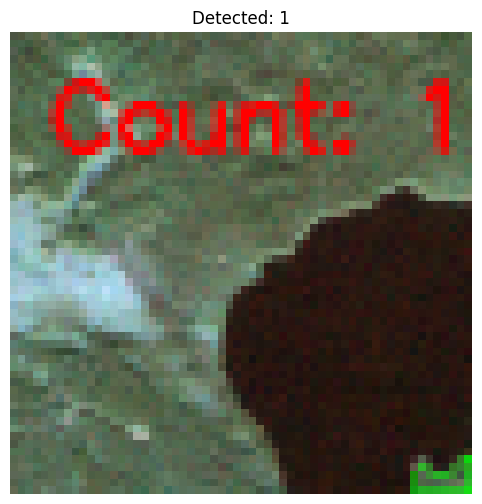

[203/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


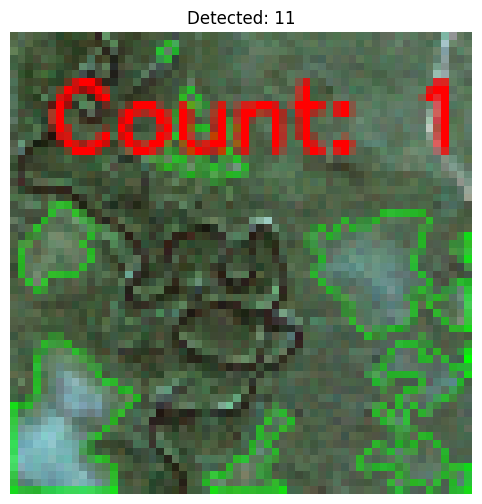

[204/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


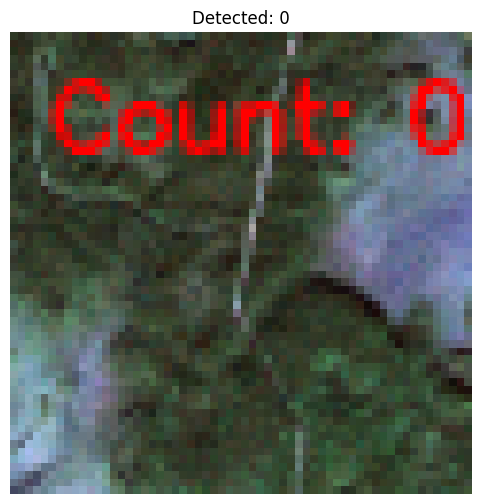

[205/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


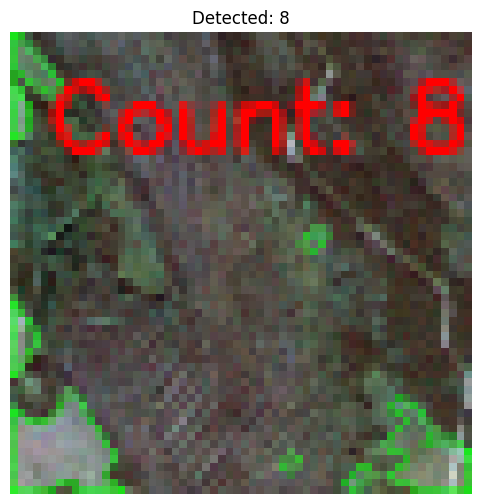

[206/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


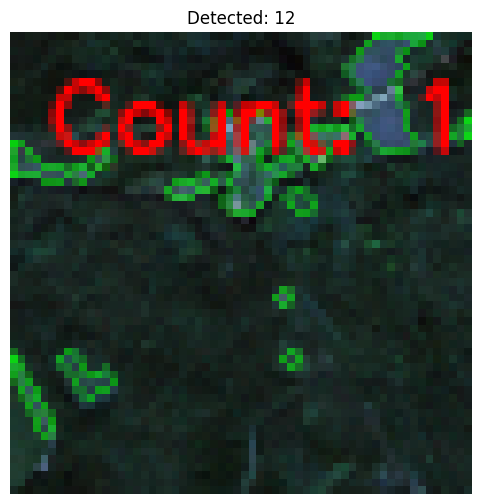

[207/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


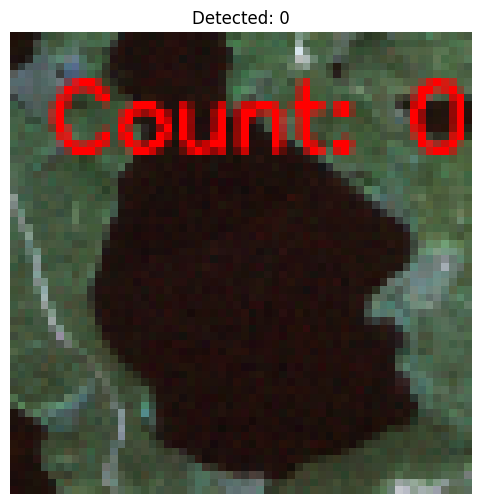

[208/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


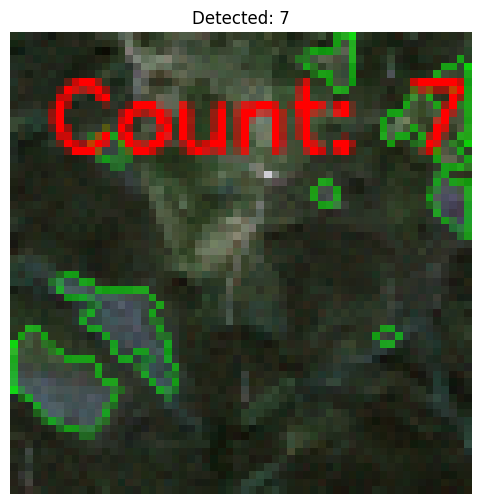

[209/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


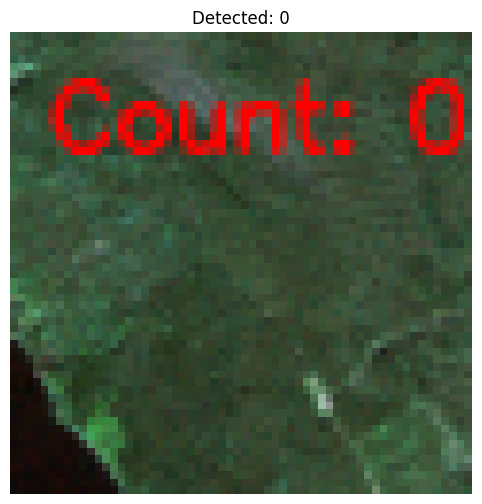

[210/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


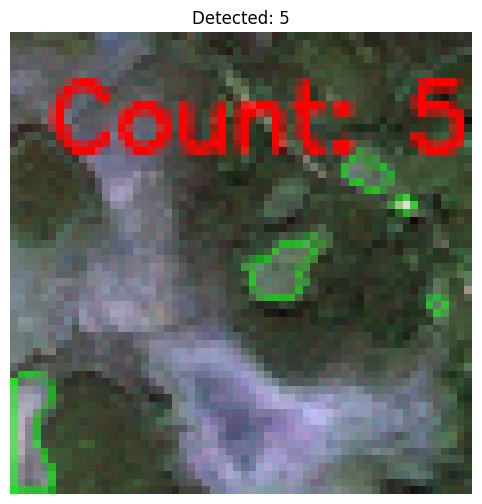

[211/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


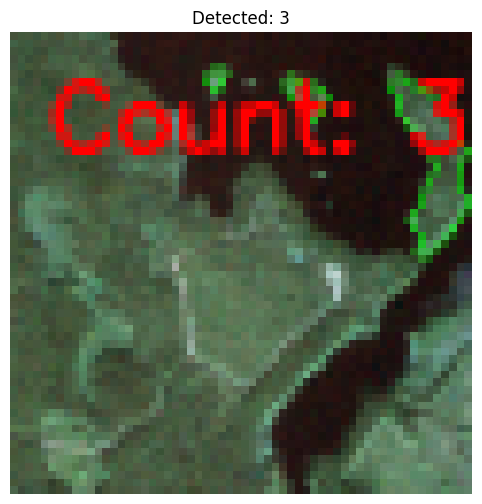

[212/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


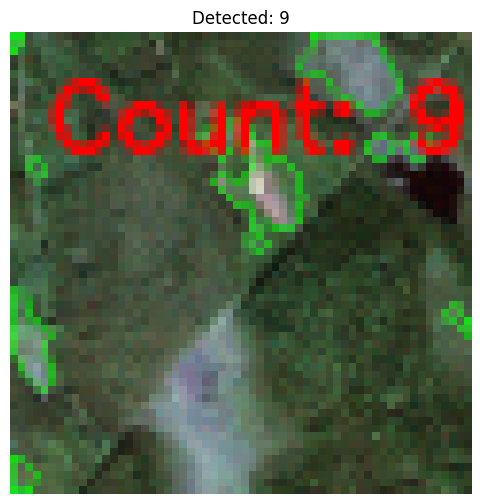

[213/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


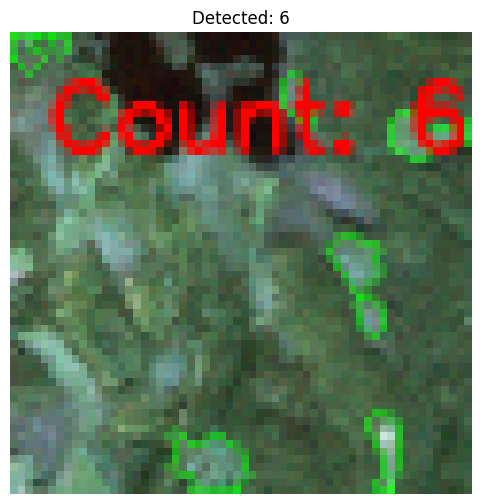

[214/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


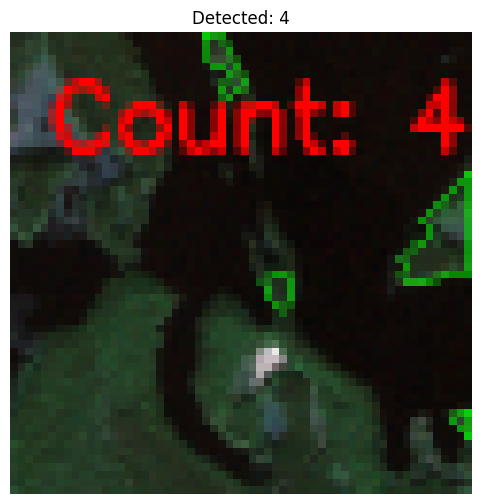

[215/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


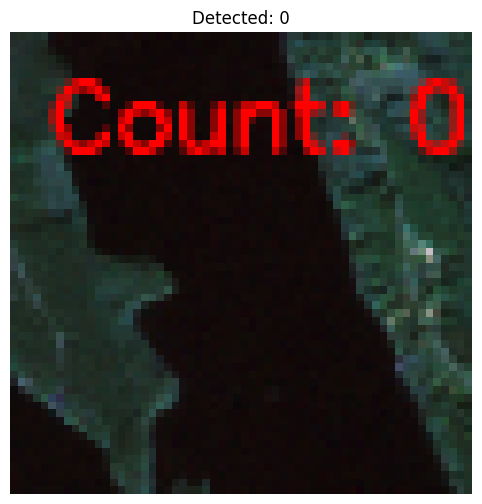

[216/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


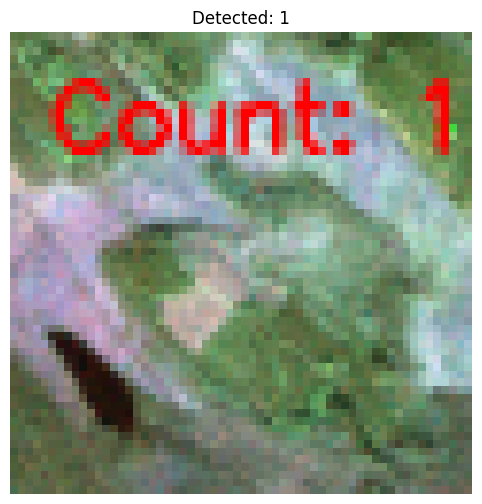

[217/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


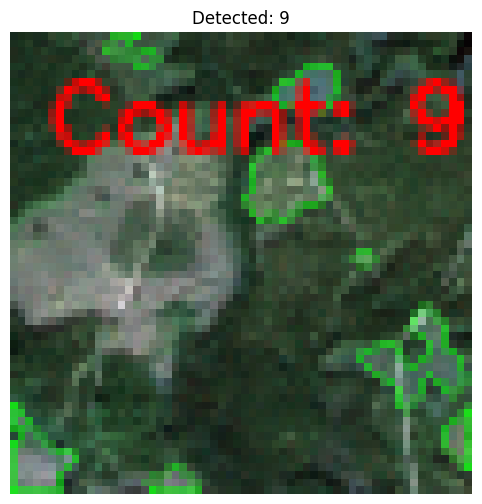

[218/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


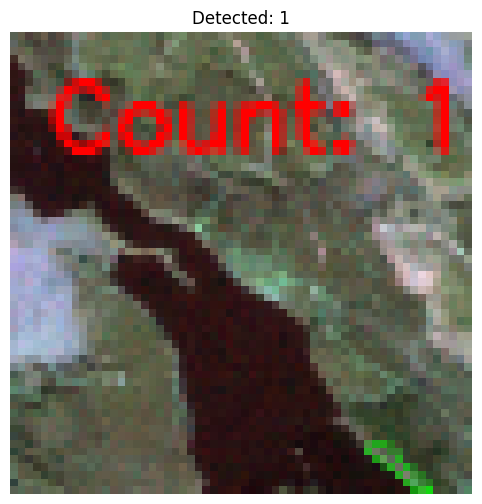

[219/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


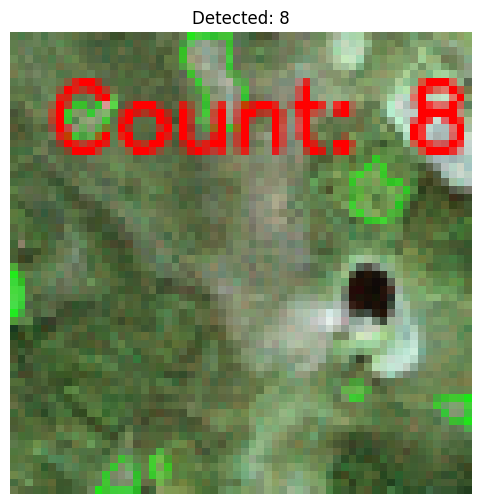

[220/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


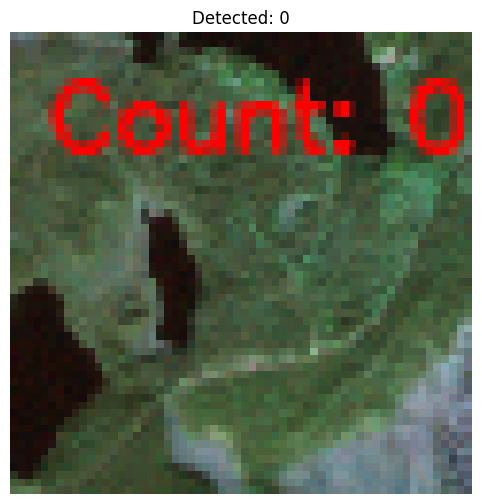

[221/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


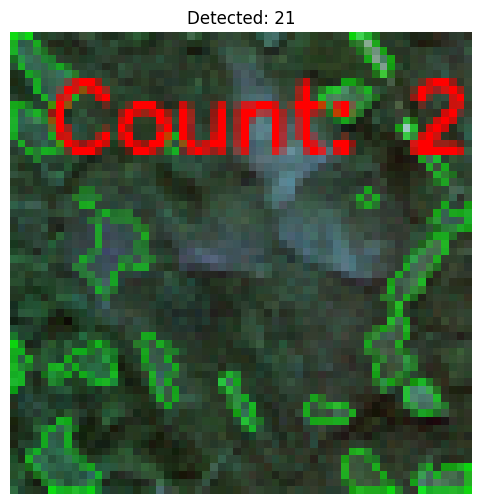

[222/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


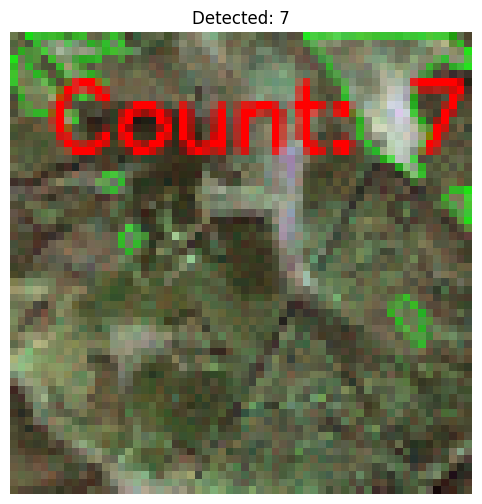

[223/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


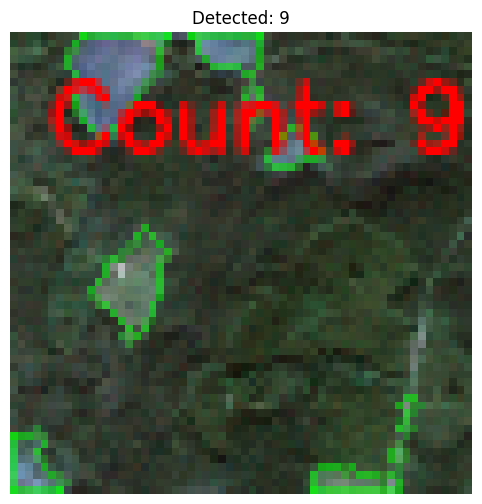

[224/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


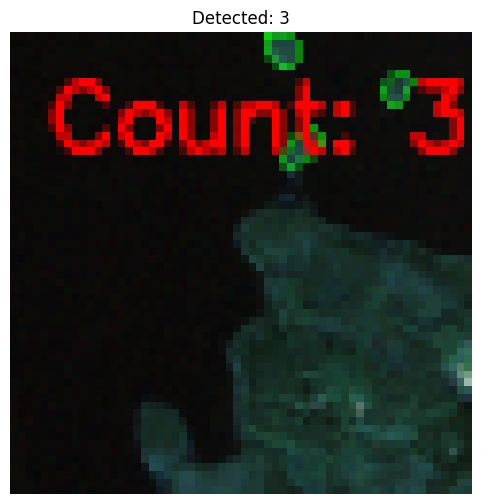

[225/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


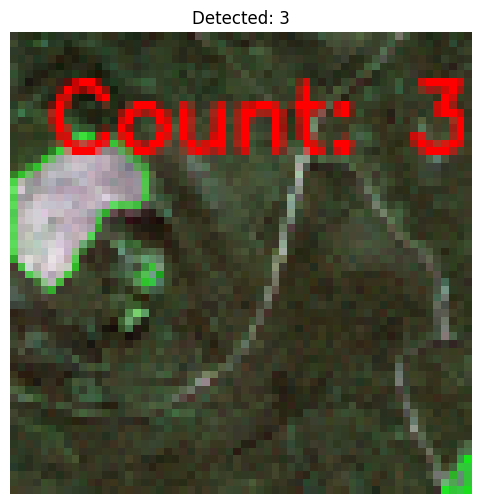

[226/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


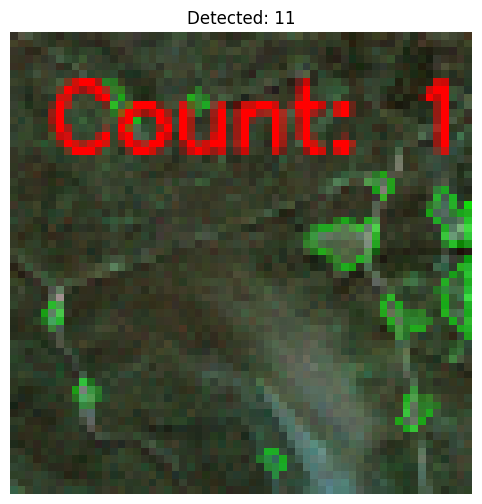

[227/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


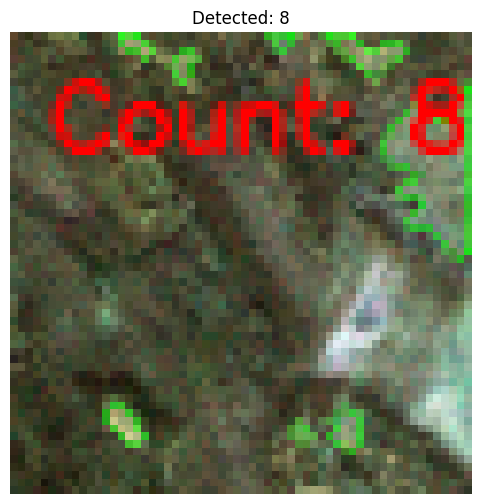

[228/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


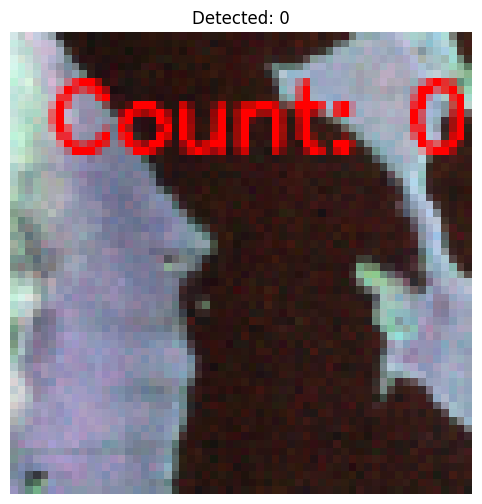

[229/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


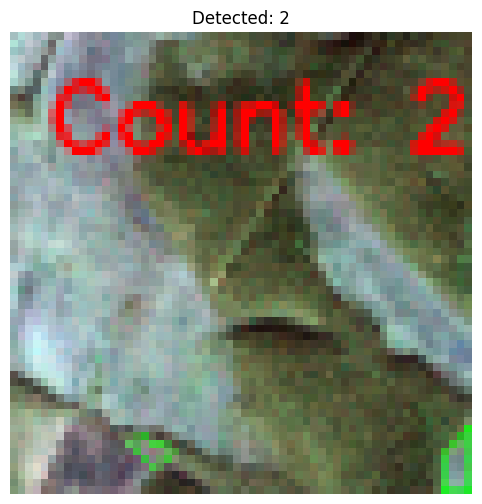

[230/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


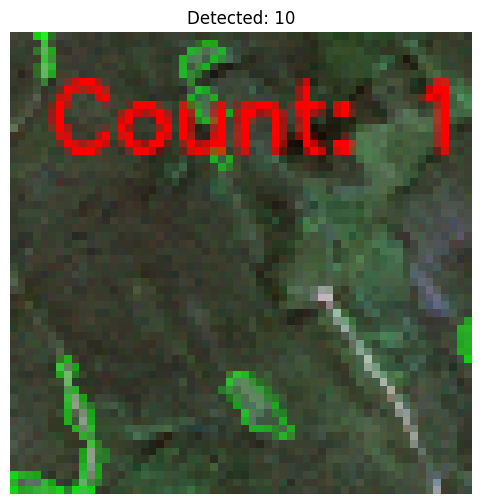

[231/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


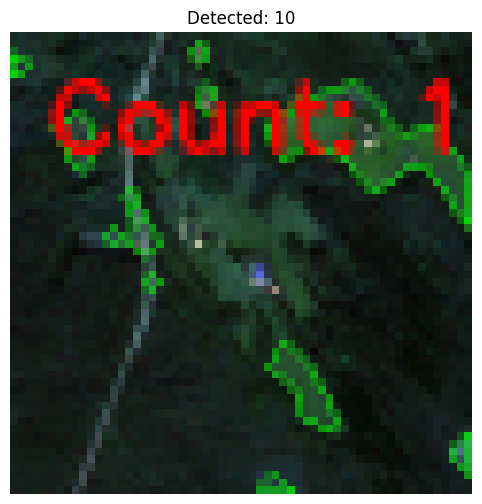

[232/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


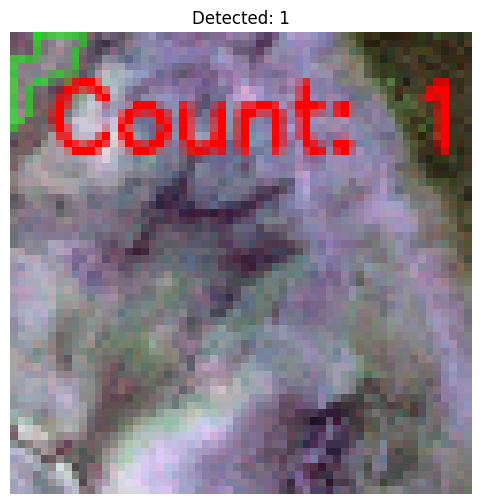

[233/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


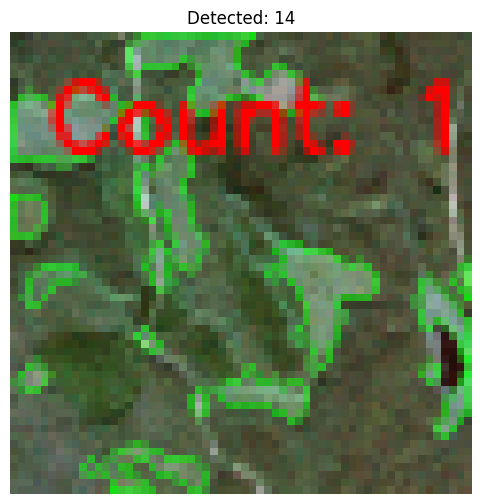

[234/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


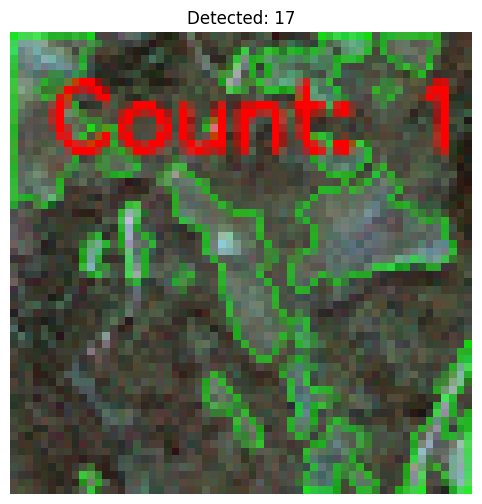

[235/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


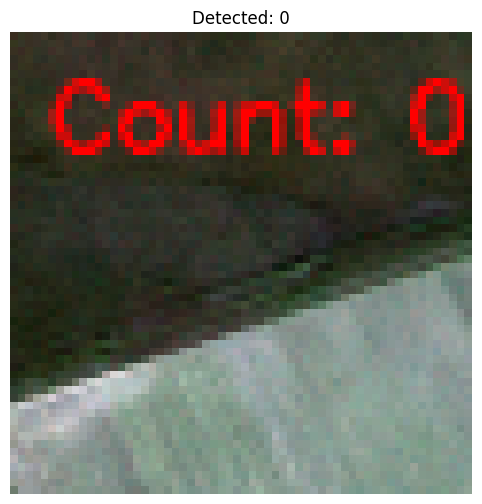

[236/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


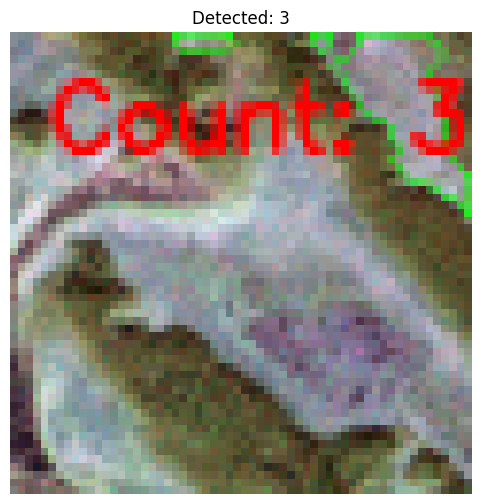

[237/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


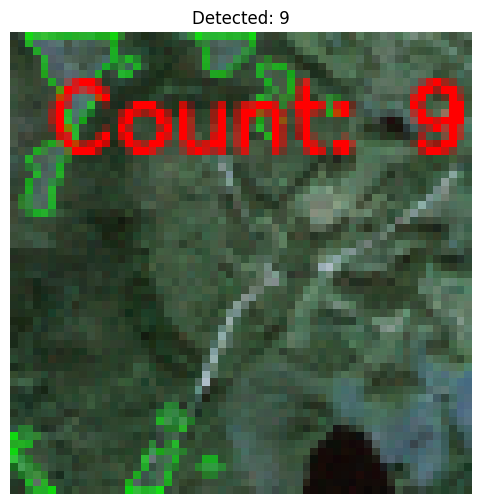

[238/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


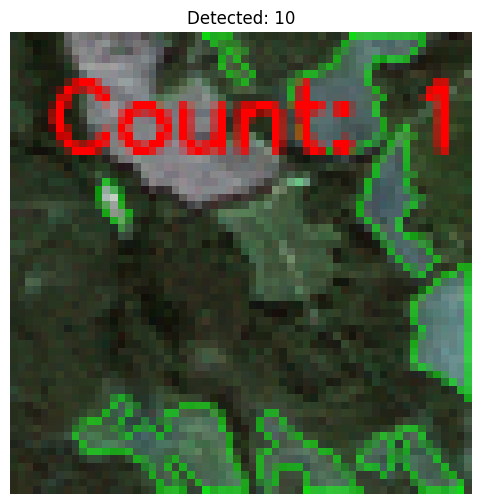

[239/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


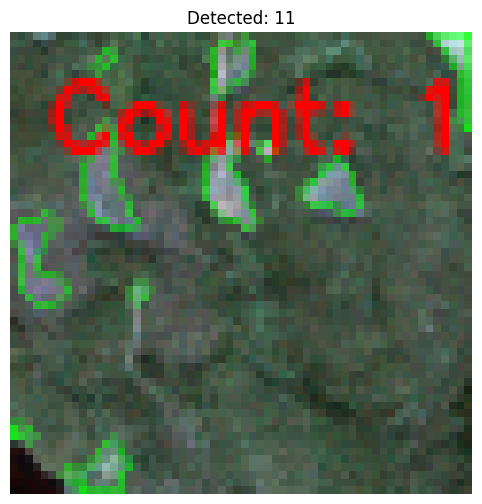

[240/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


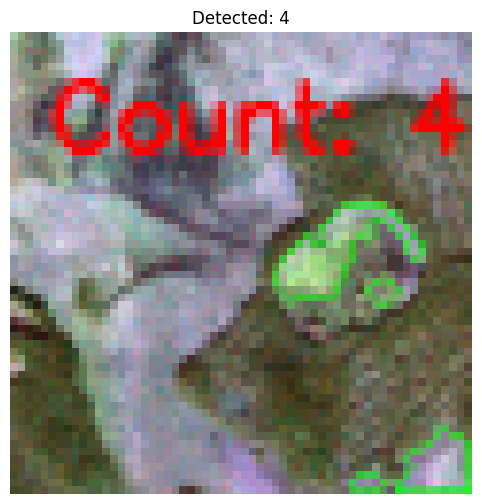

[241/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


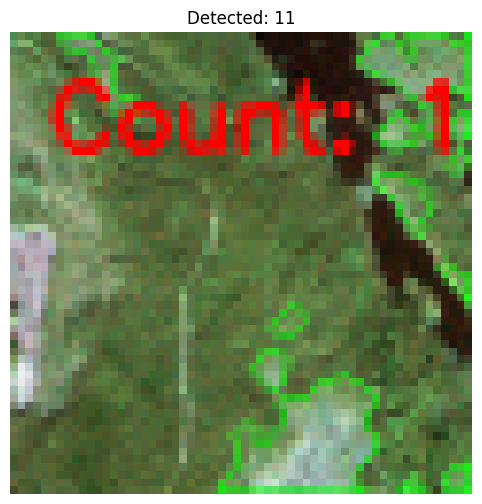

[242/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


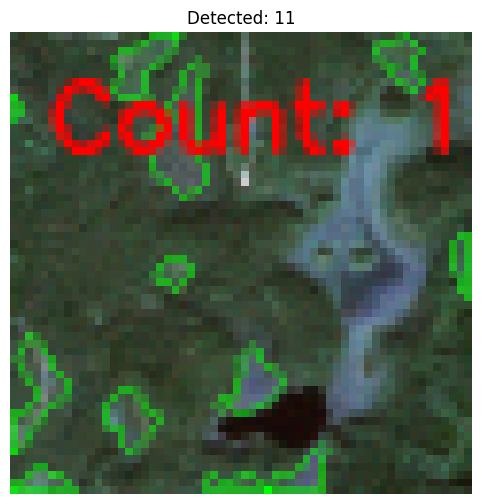

[243/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


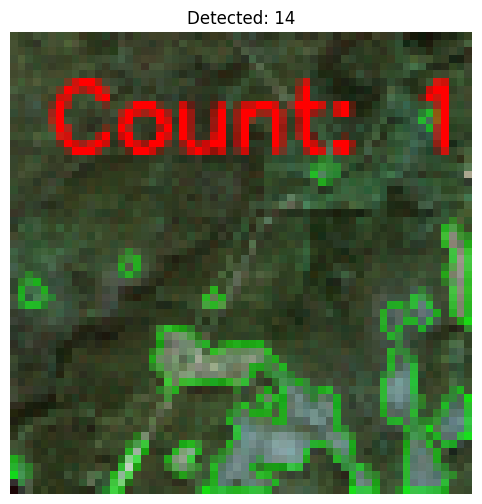

[244/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


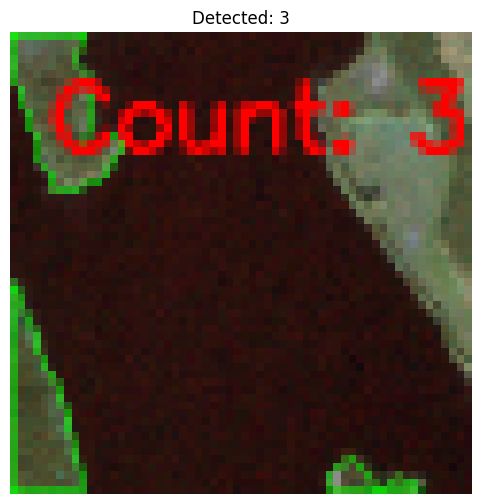

[245/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


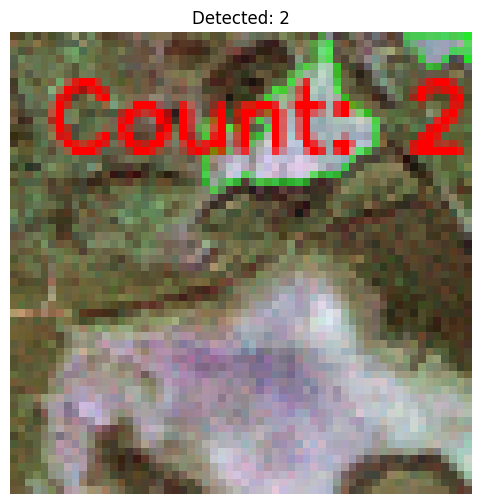

[246/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


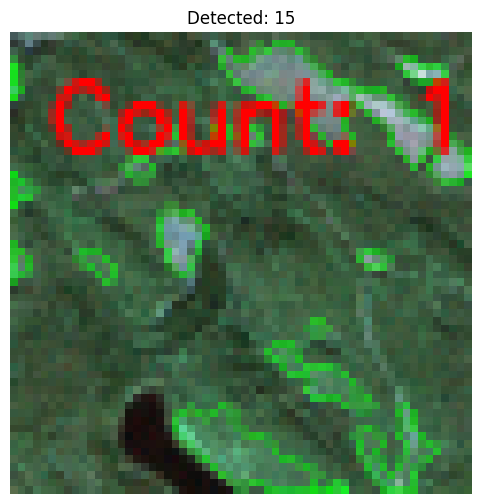

[247/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


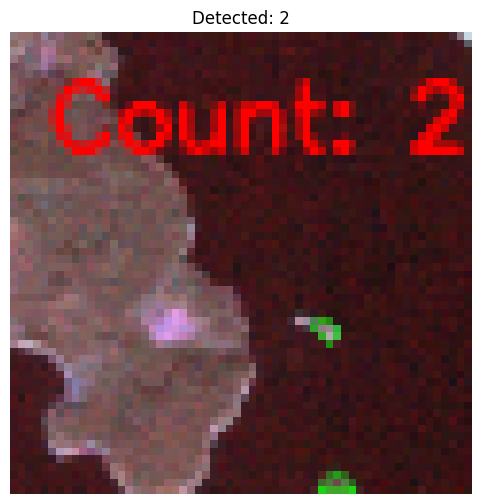

[248/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


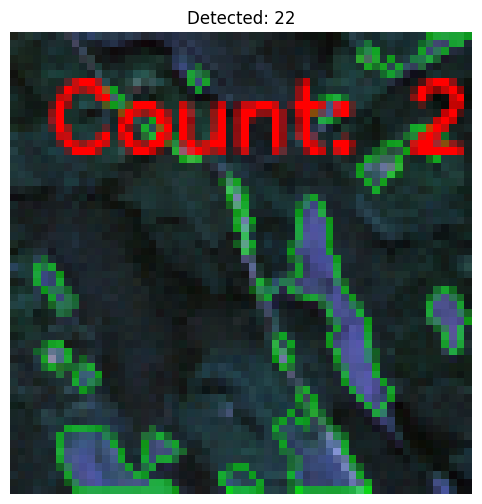

[249/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


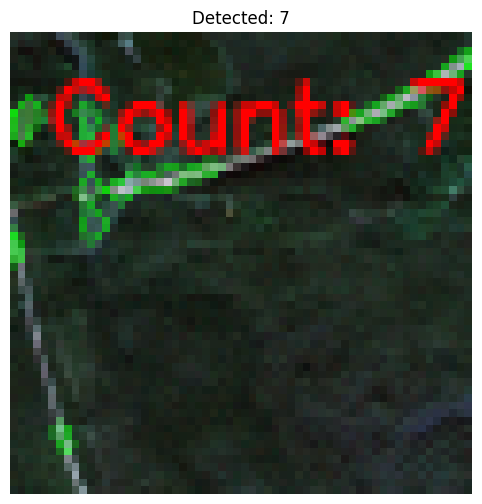

[250/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


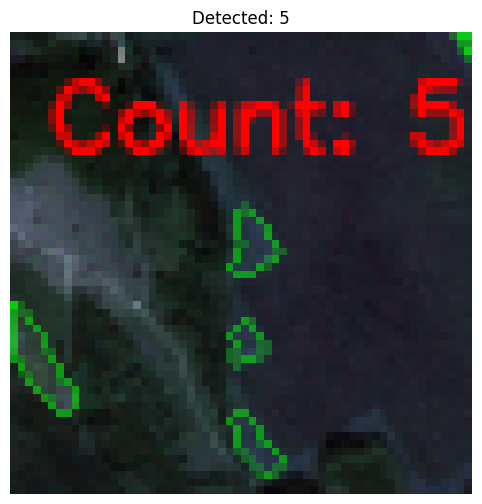

[251/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


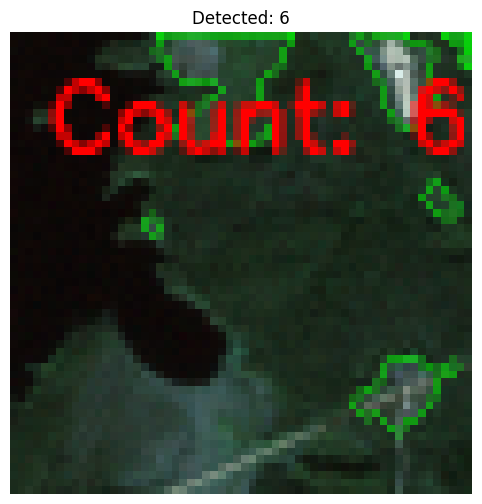

[252/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


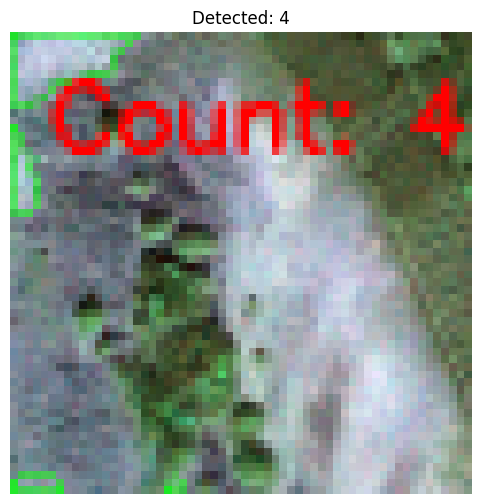

[253/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


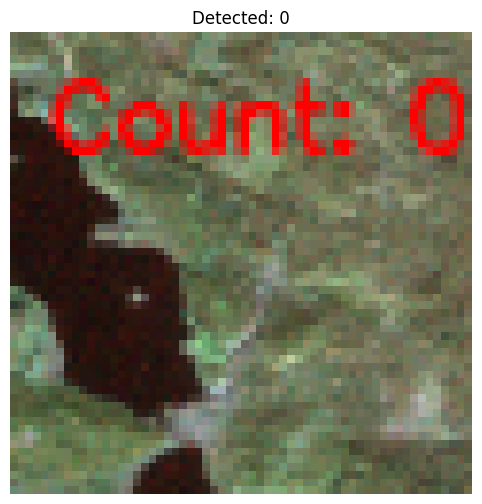

[254/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


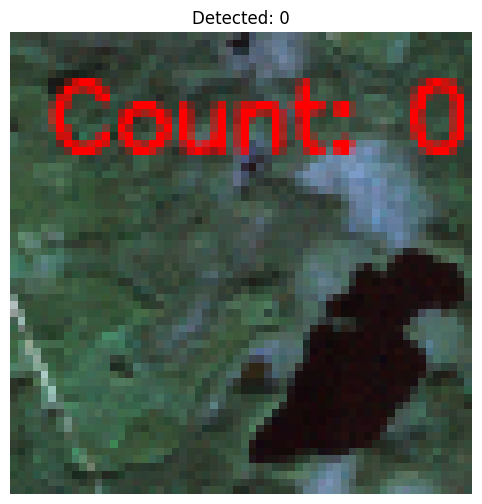

[255/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


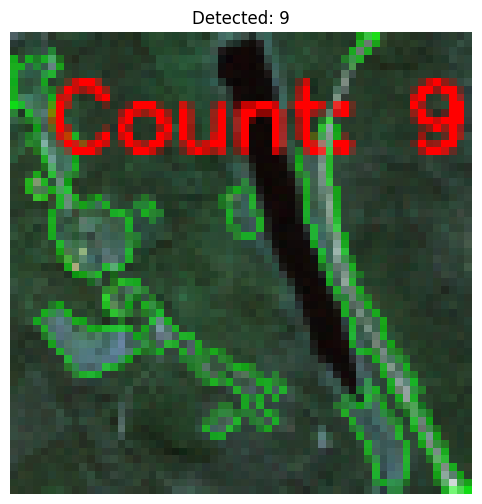

[256/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


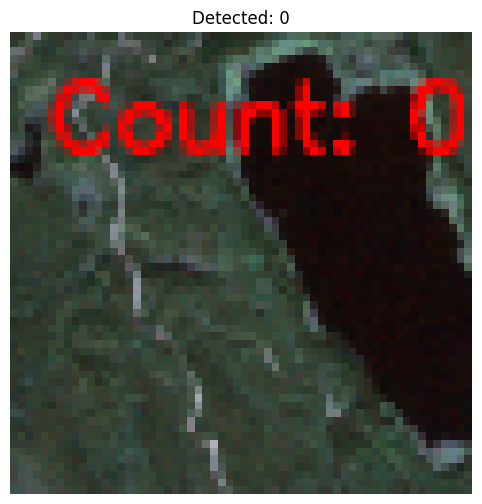

[257/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


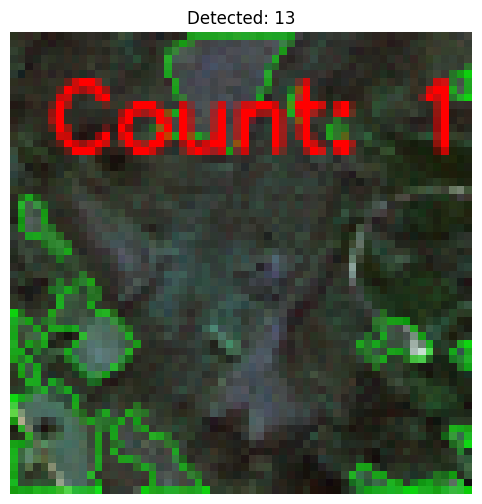

[258/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


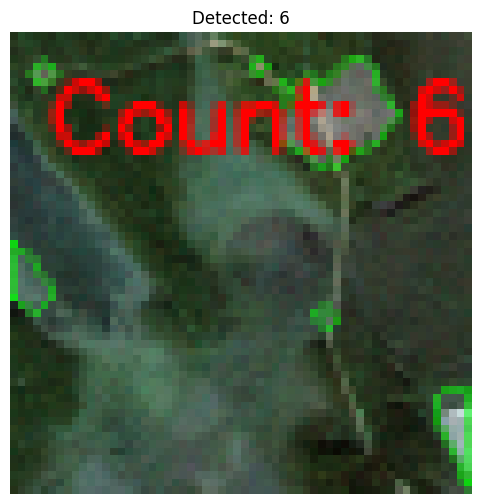

[259/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


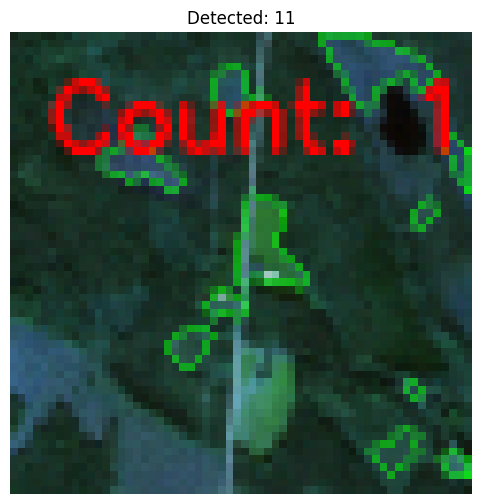

[260/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


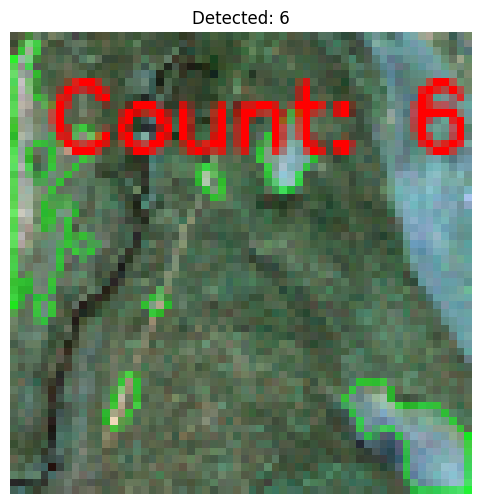

[261/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


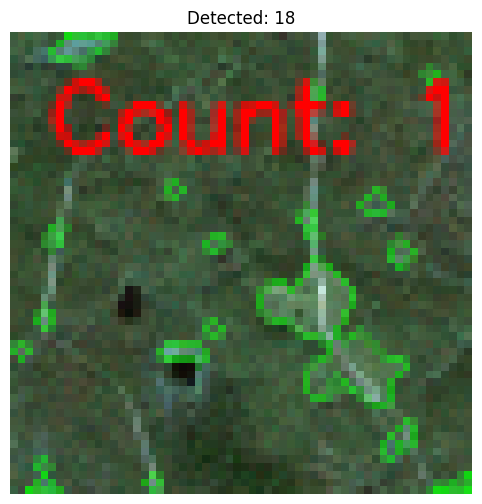

[262/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


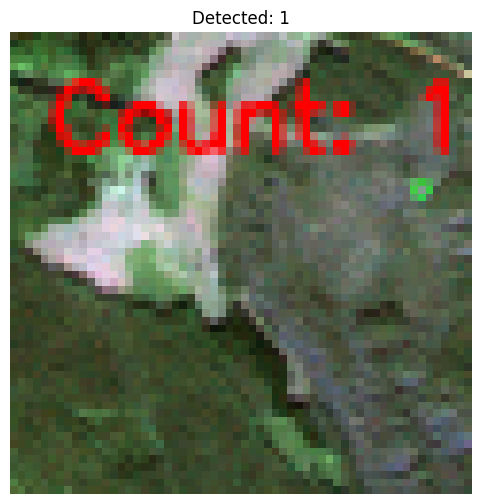

[263/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


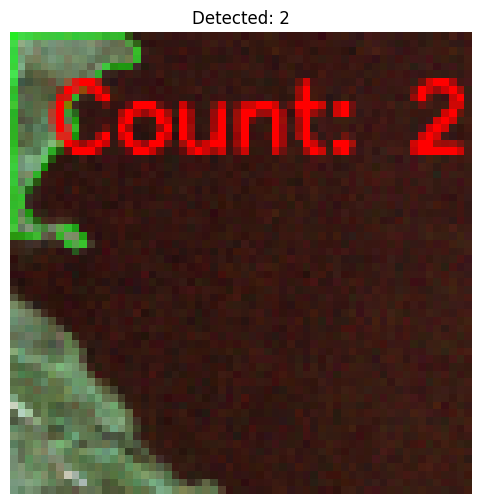

[264/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 23                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


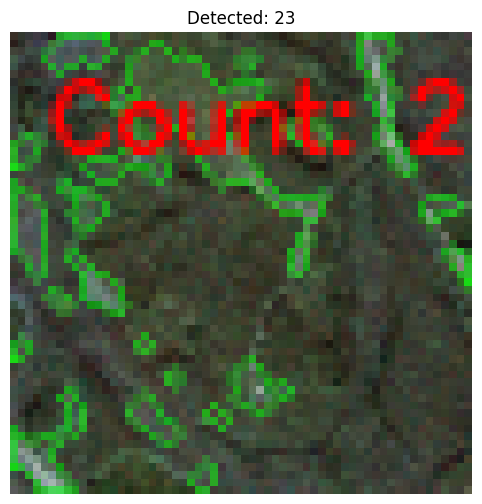

[265/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


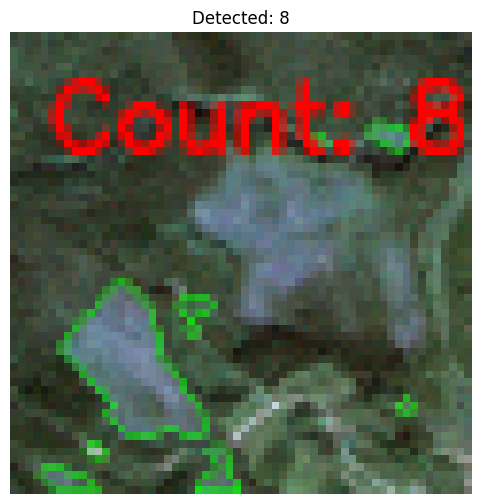

[266/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


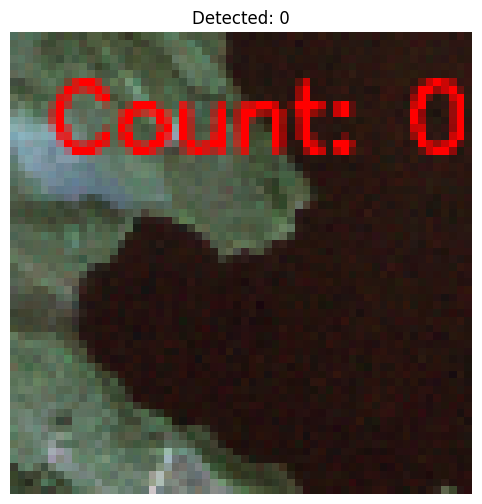

[267/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


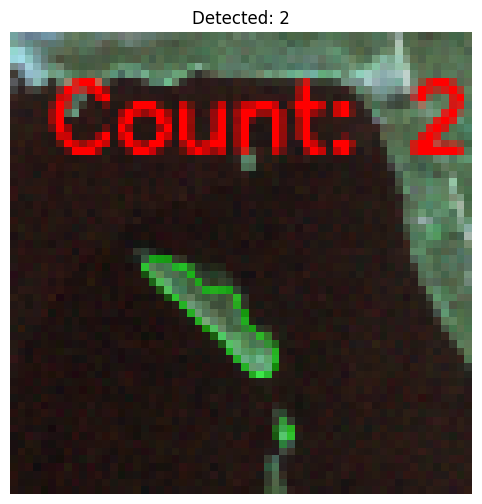

[268/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


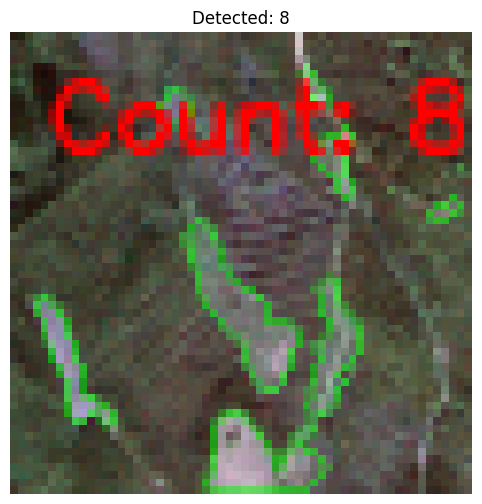

[269/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


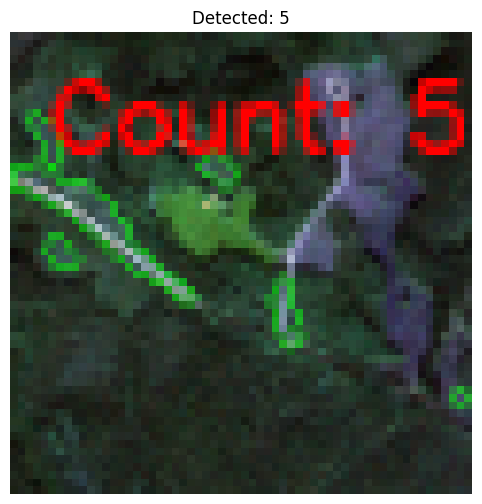

[270/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


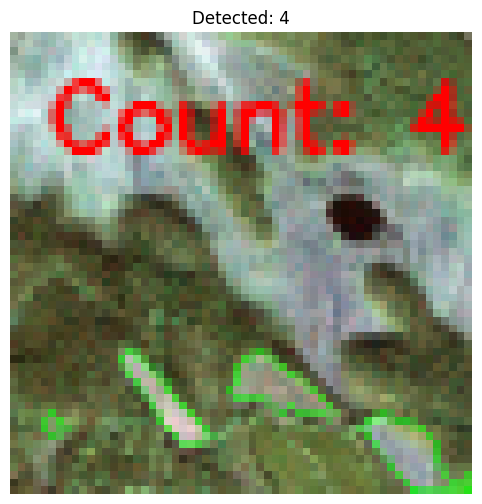

[271/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


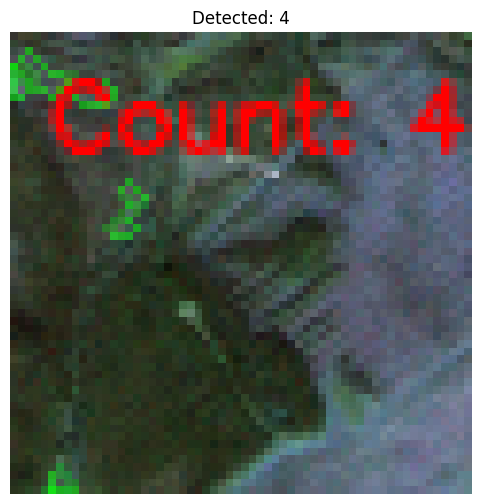

[272/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


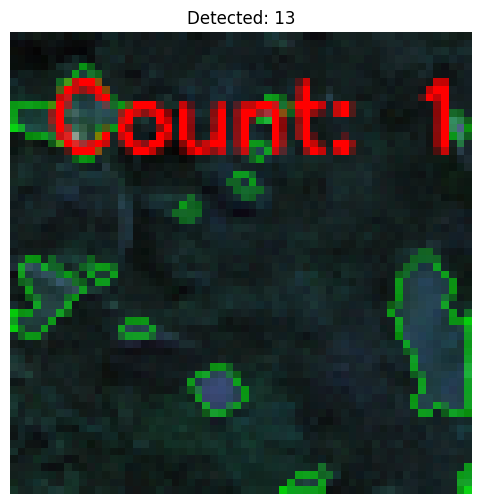

[273/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


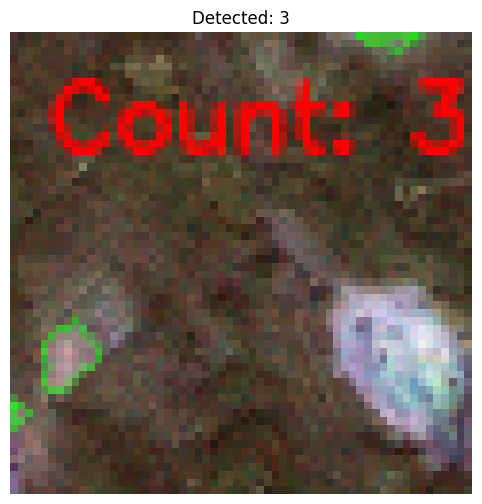

[274/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


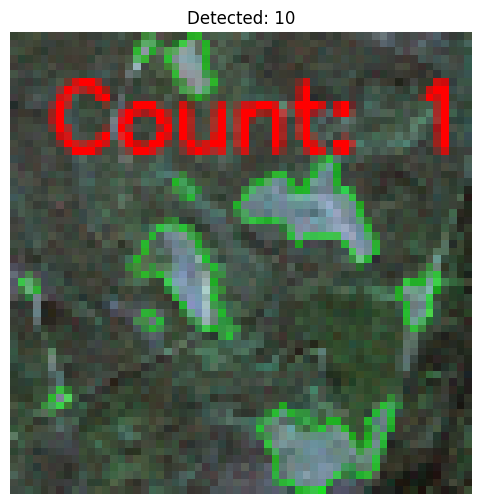

[275/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


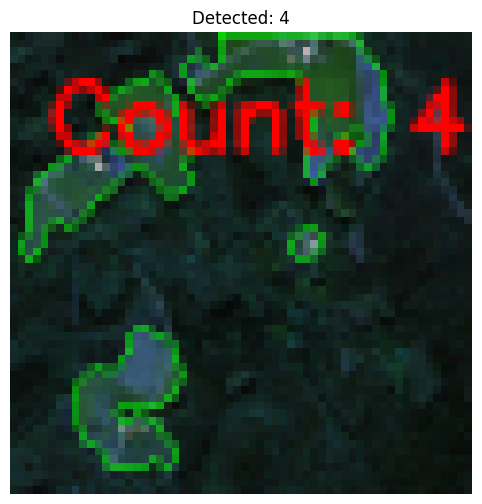

[276/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


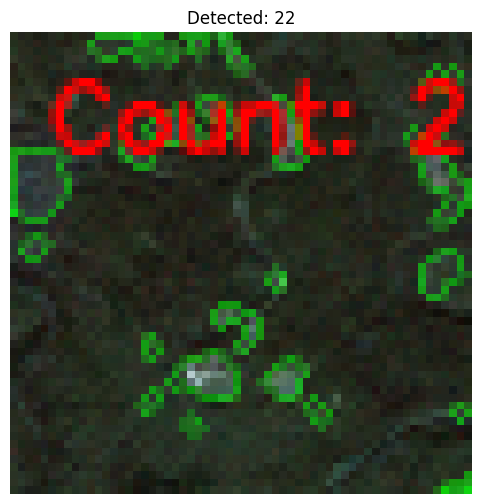

[277/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


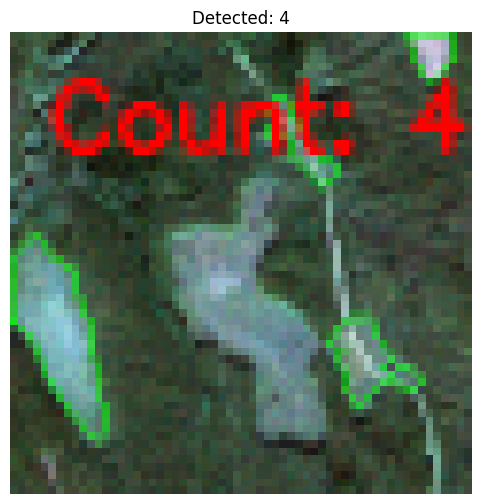

[278/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


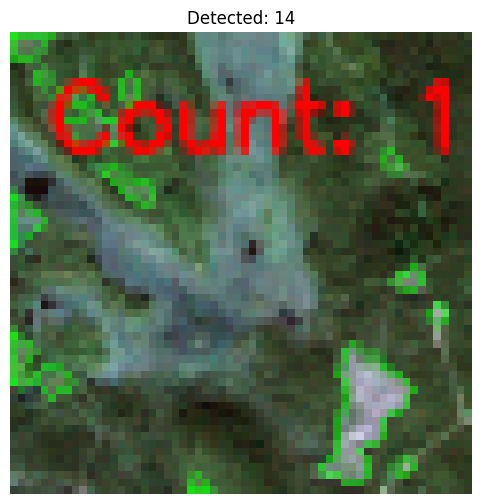

[279/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


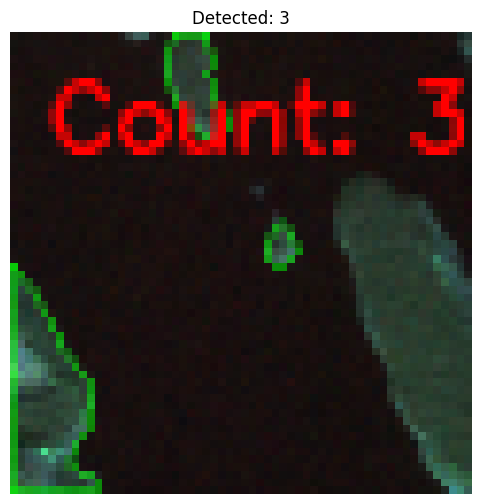

[280/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


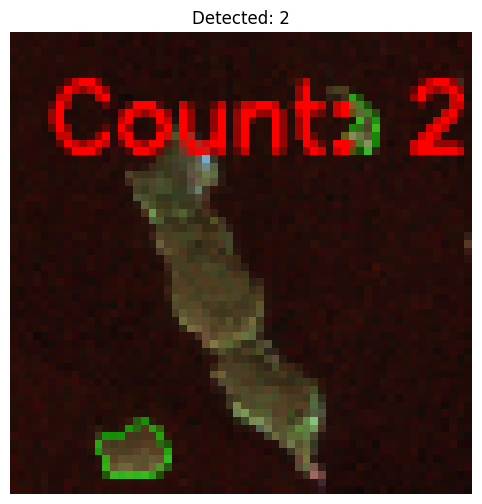

[281/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


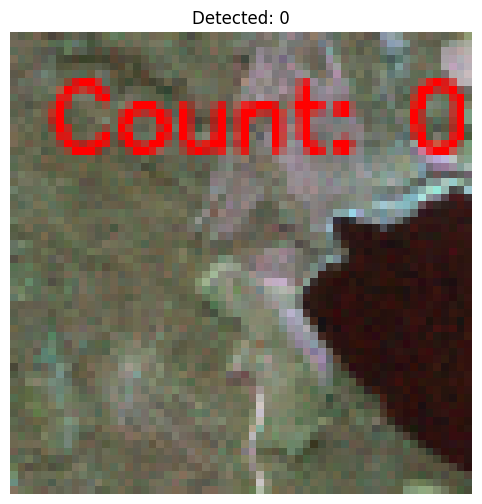

[282/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


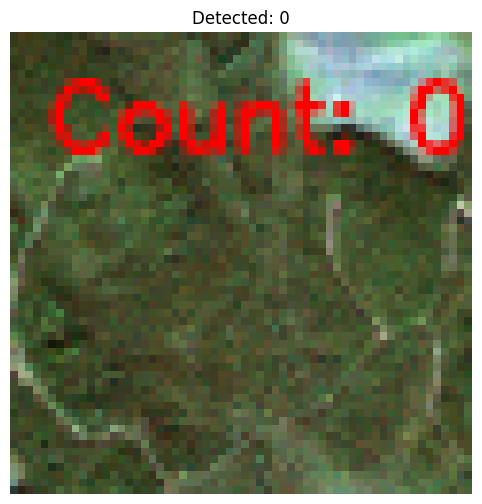

[283/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


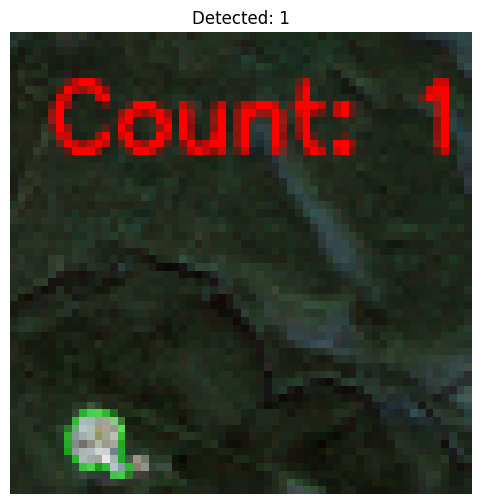

[284/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


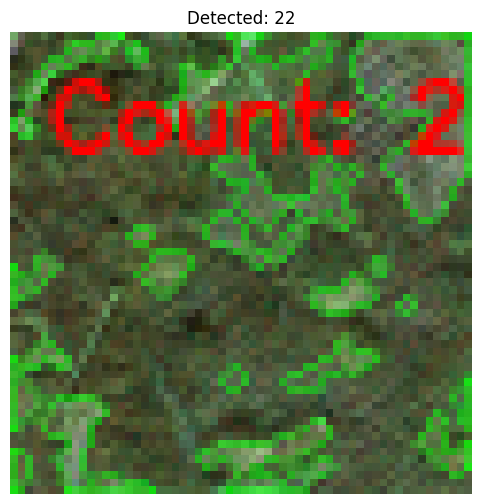

[285/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


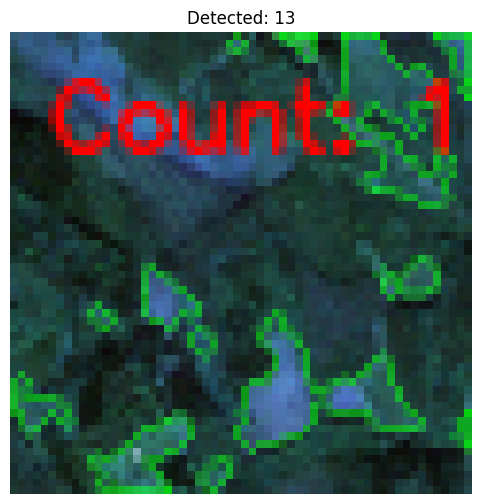

[286/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


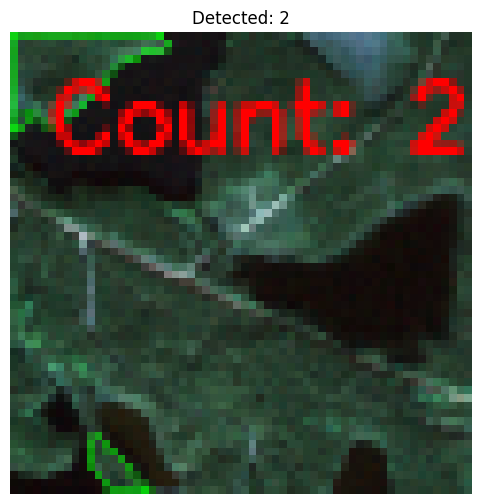

[287/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


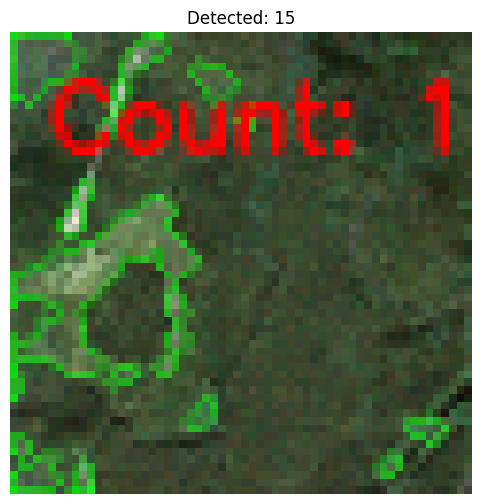

[288/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


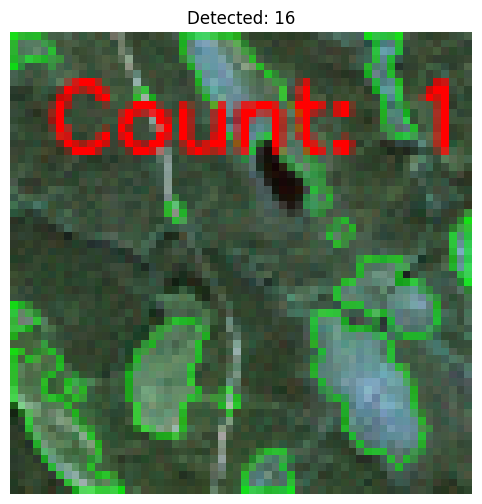

[289/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


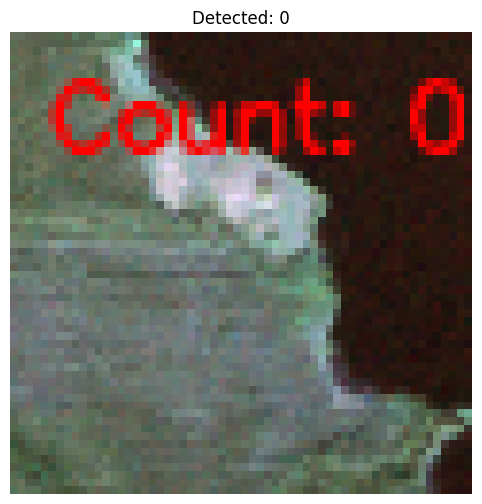

[290/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


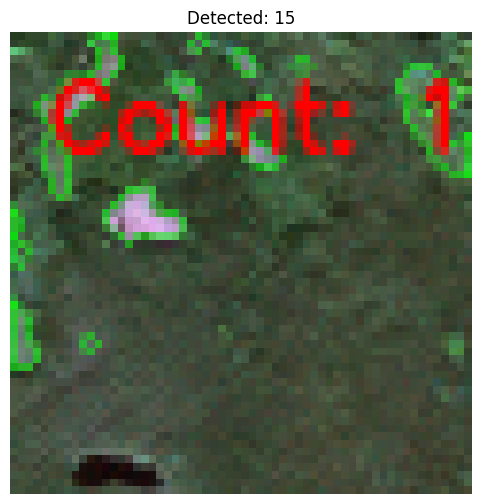

[291/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


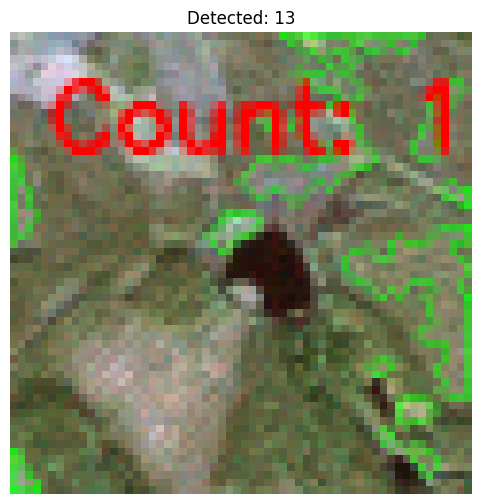

[292/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


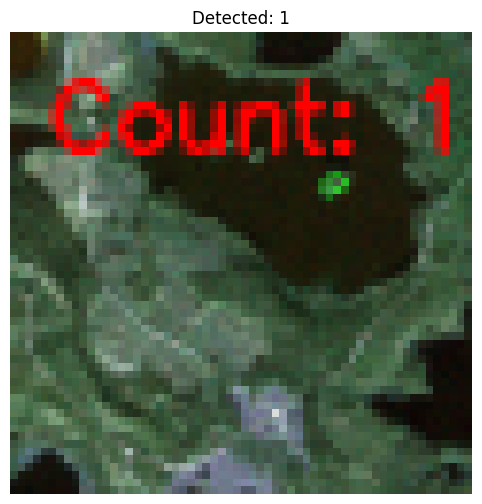

[293/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


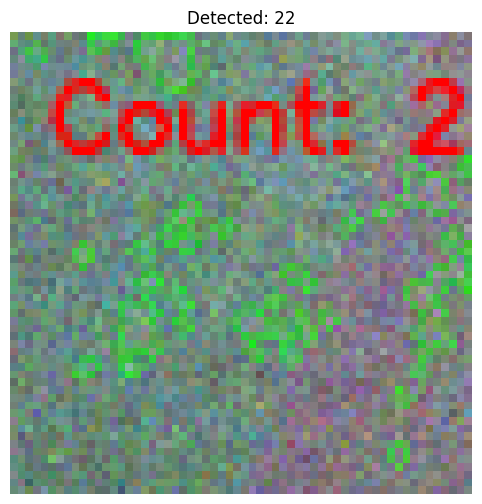

[294/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


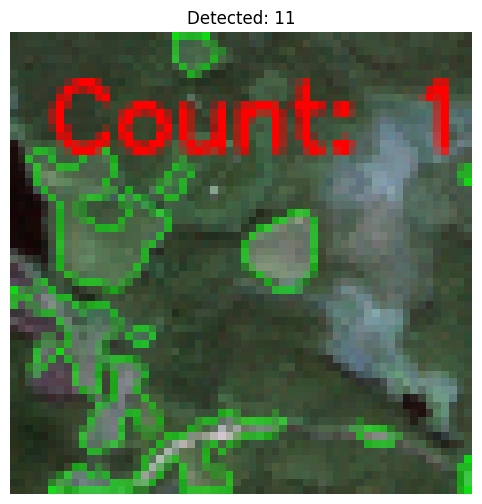

[295/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


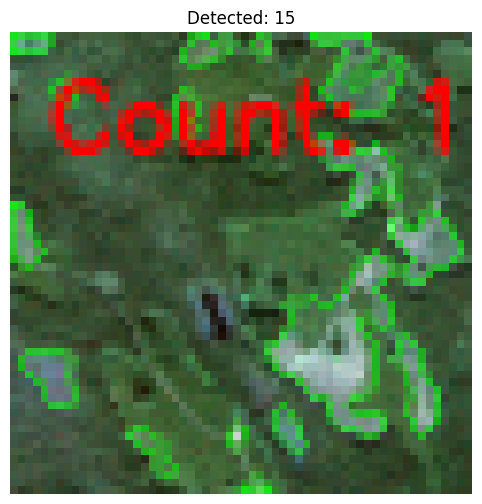

[296/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


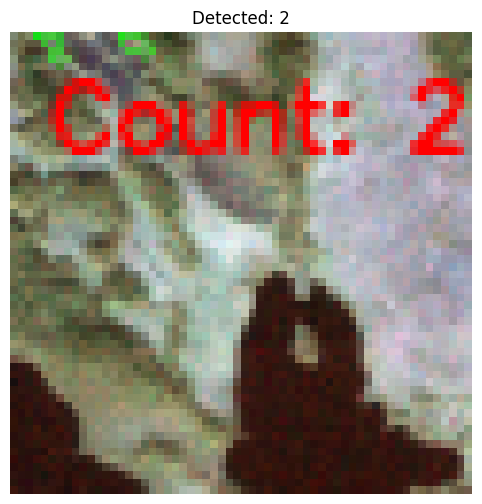

[297/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


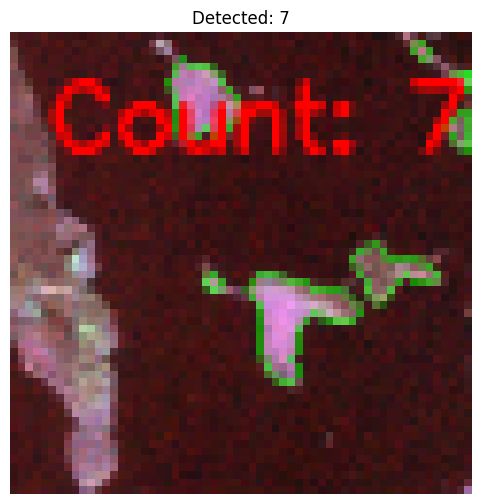

[298/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


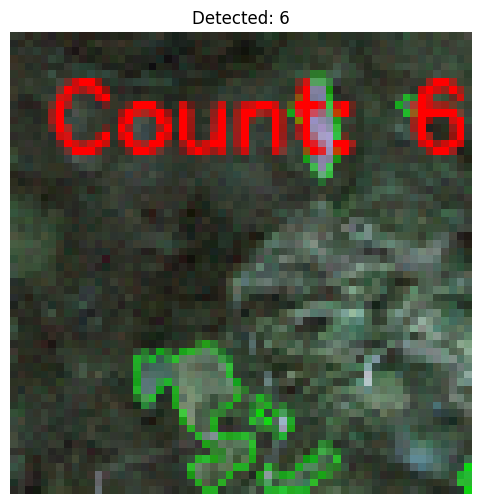

[299/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


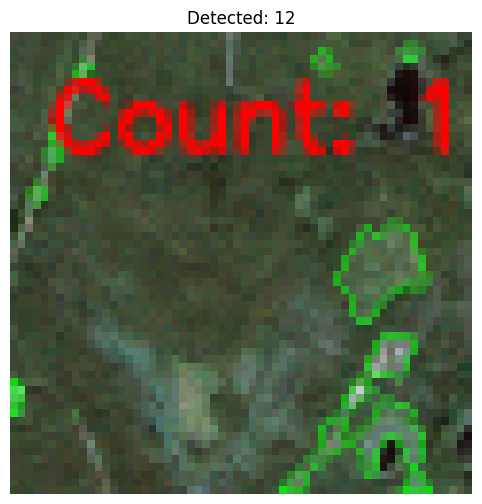

[300/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


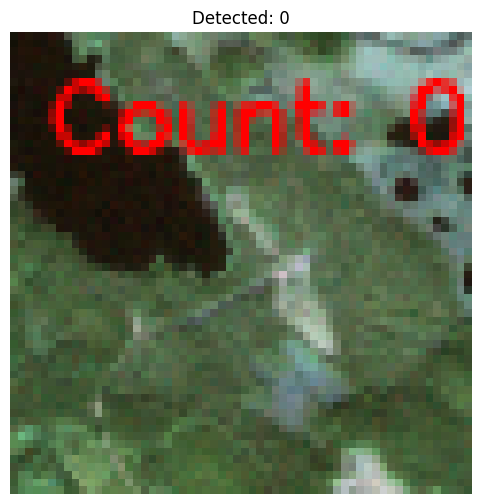

[301/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


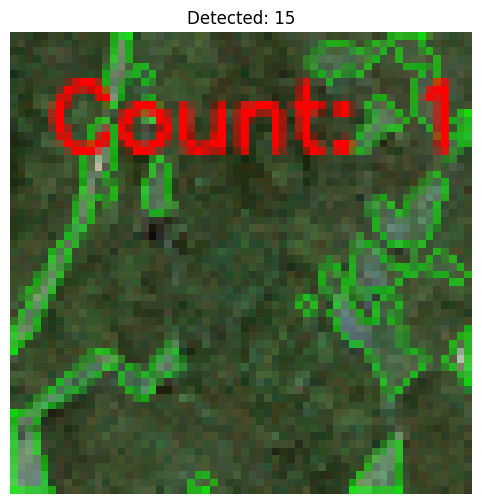

[302/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


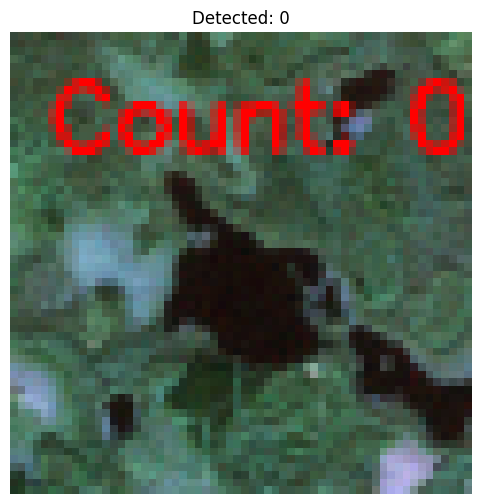

[303/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


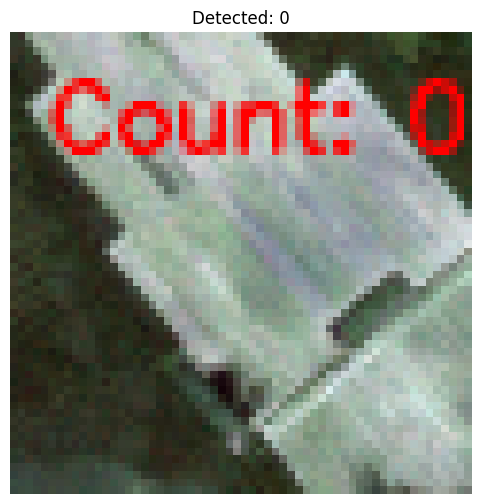

[304/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


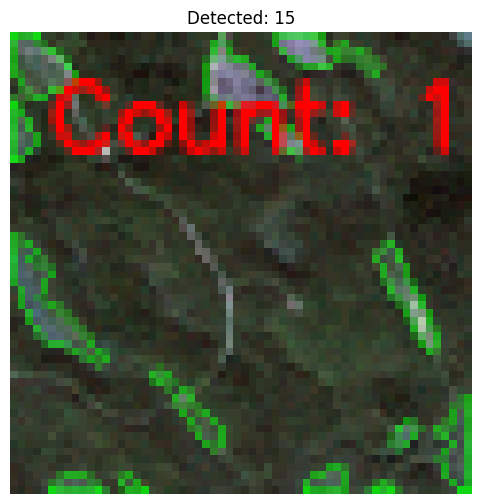

[305/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


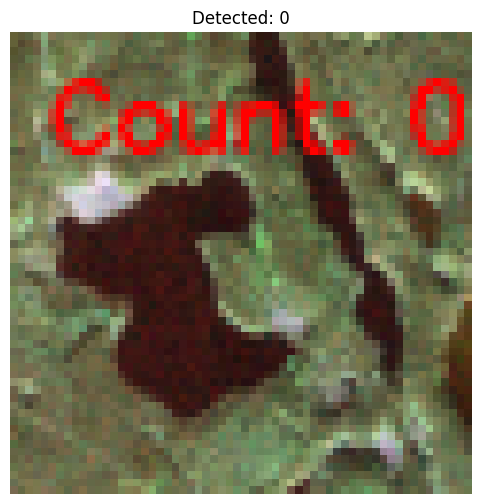

[306/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


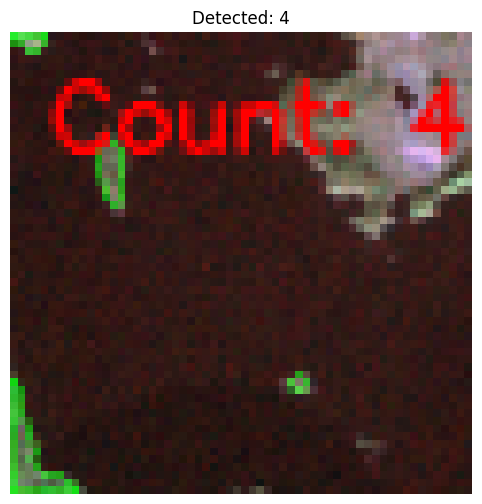

[307/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


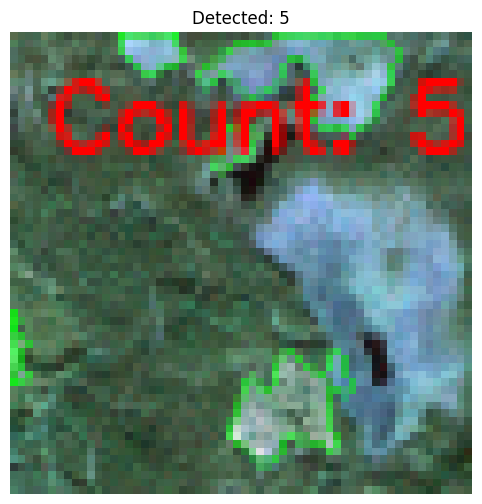

[308/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


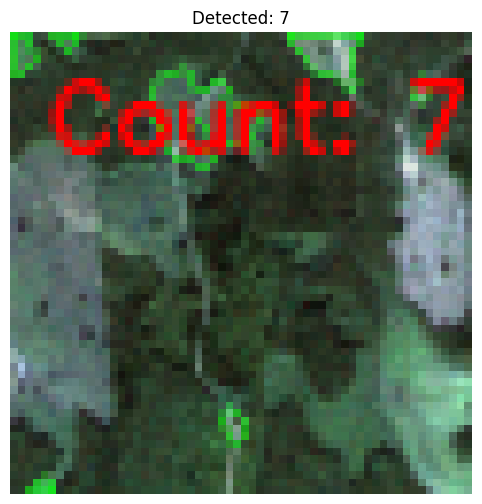

[309/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


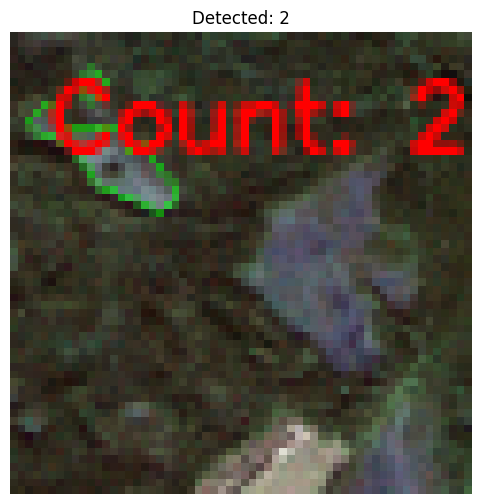

[310/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


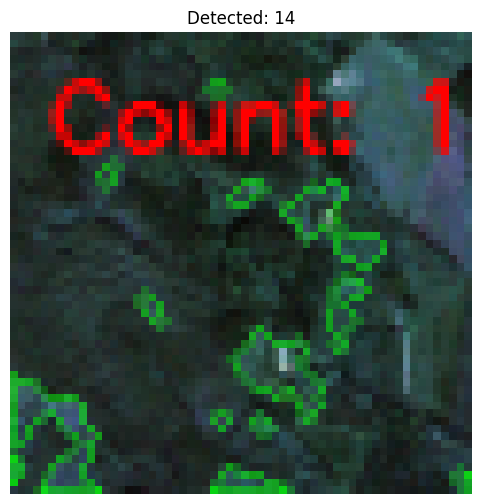

[311/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


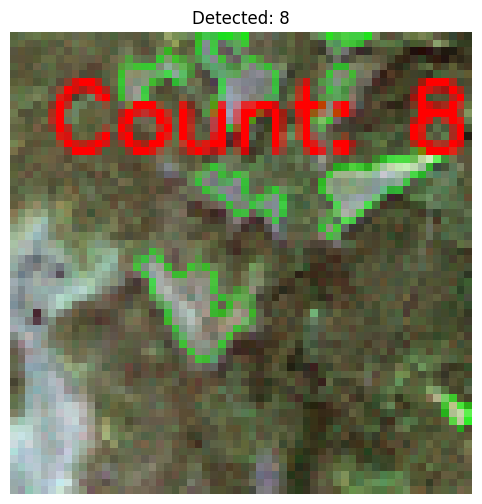

[312/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


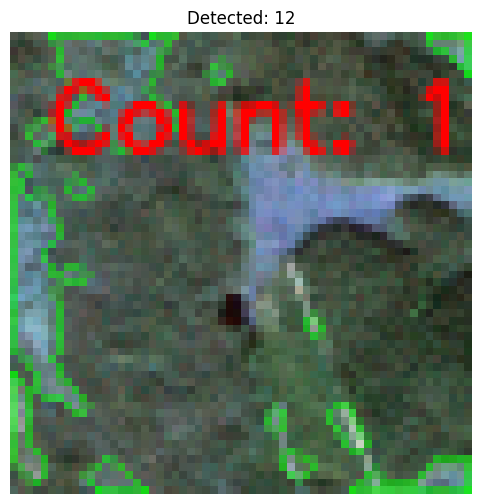

[313/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


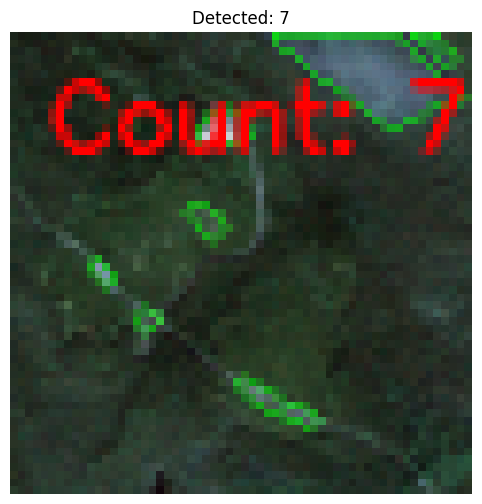

[314/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


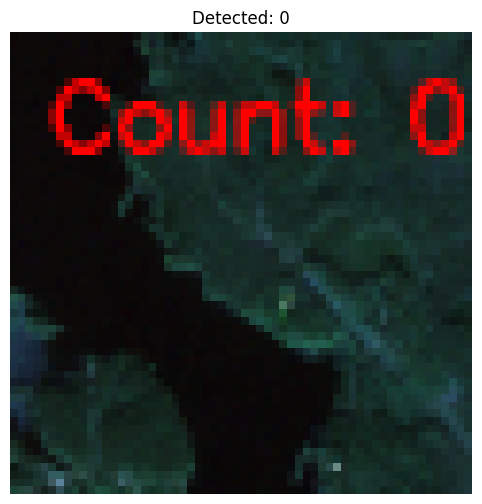

[315/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


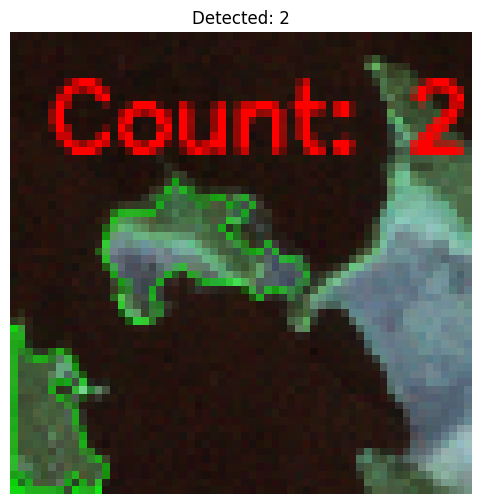

[316/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


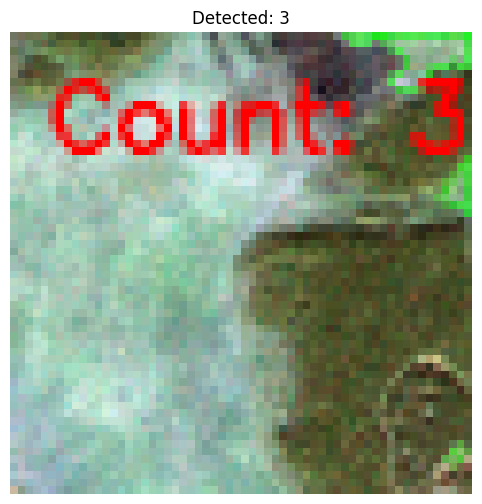

[317/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


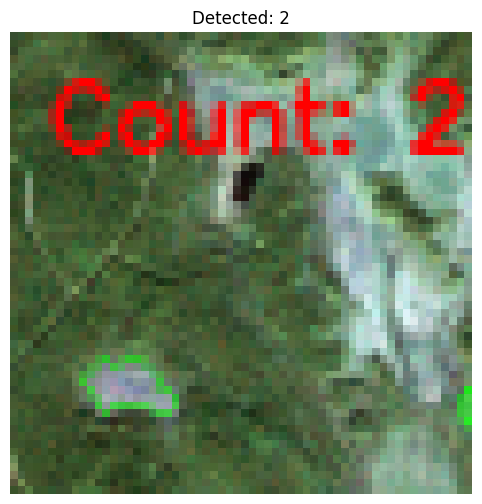

[318/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


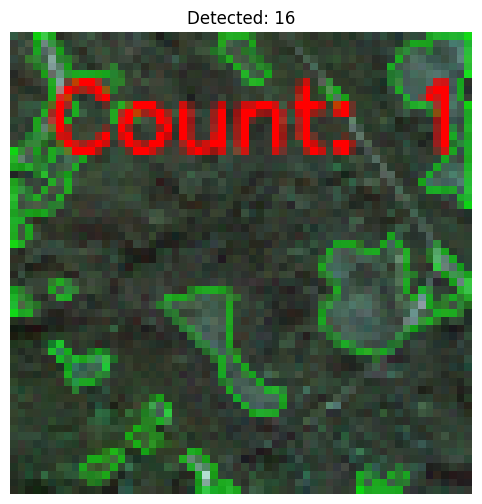

[319/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


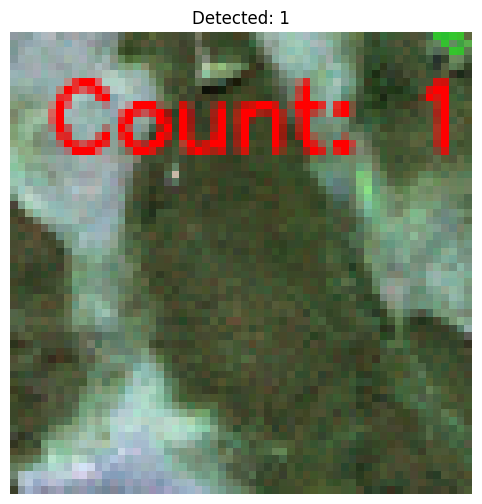

[320/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


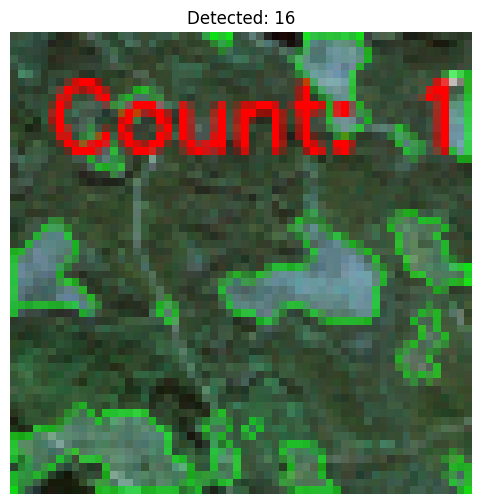

[321/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


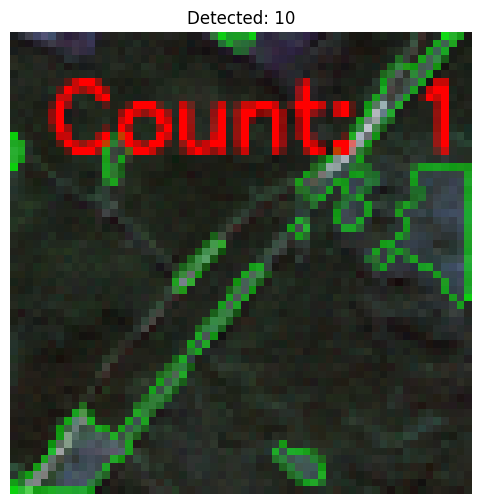

[322/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


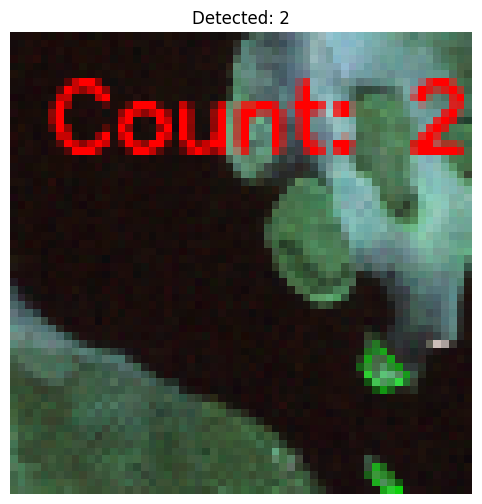

[323/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


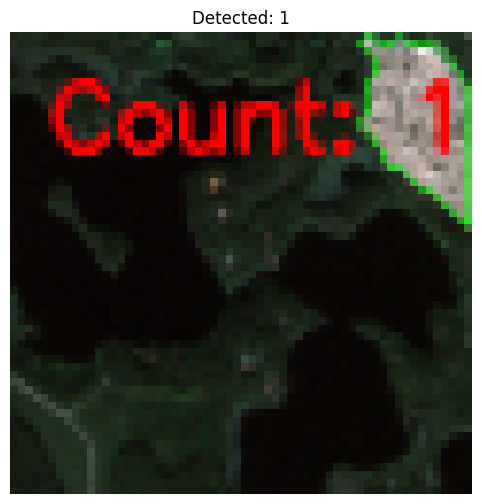

[324/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


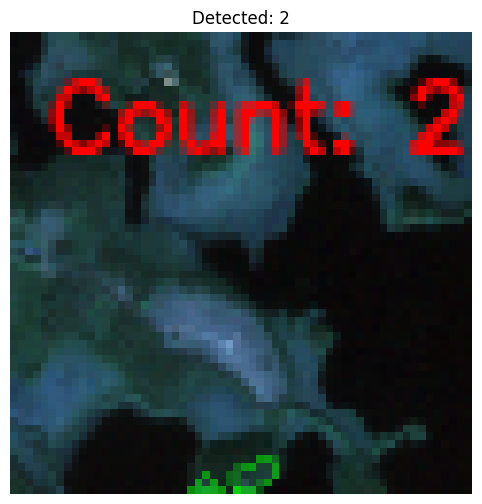

[325/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


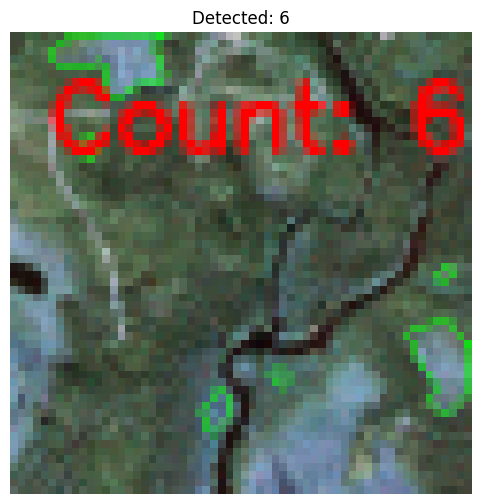

[326/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


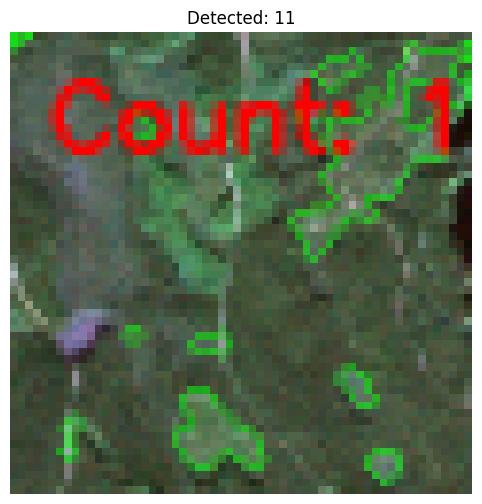

[327/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


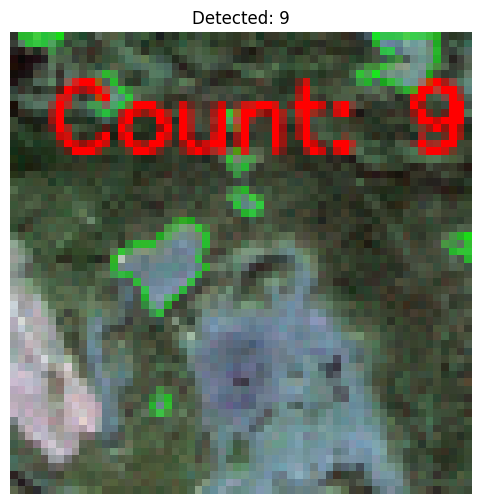

[328/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


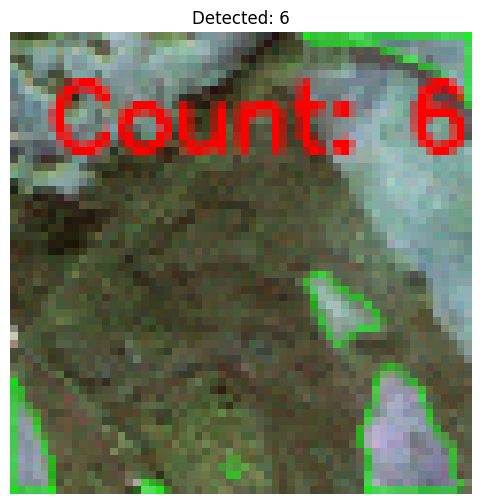

[329/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


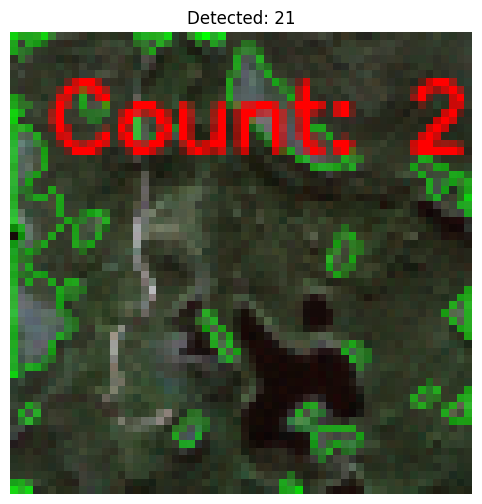

[330/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


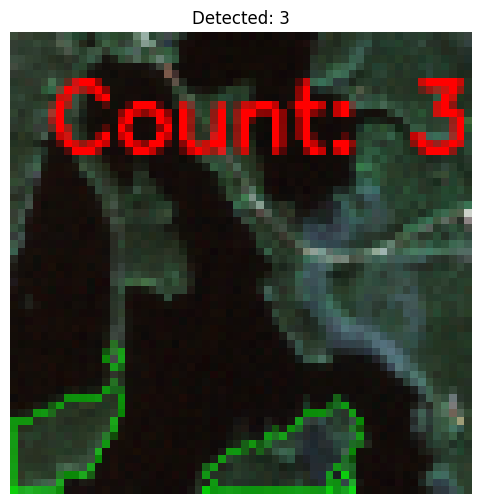

[331/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


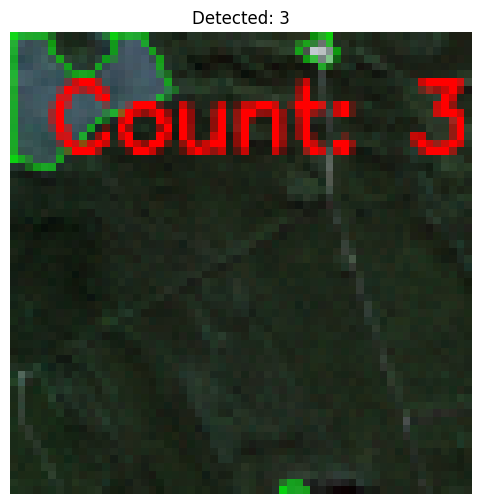

[332/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


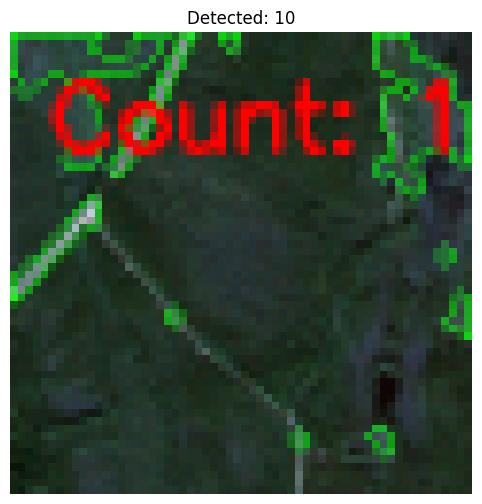

[333/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


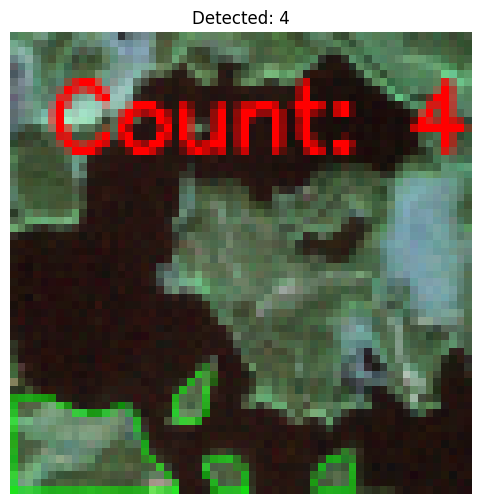

[334/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


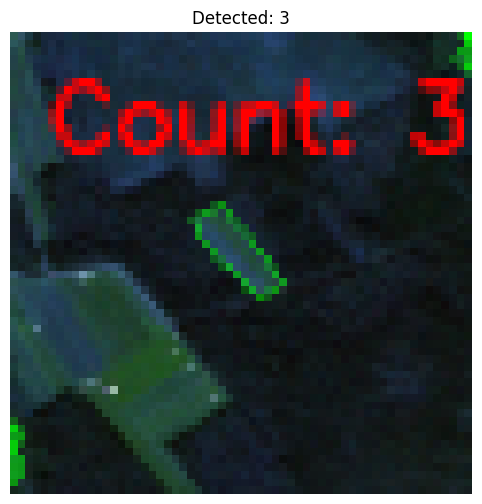

[335/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


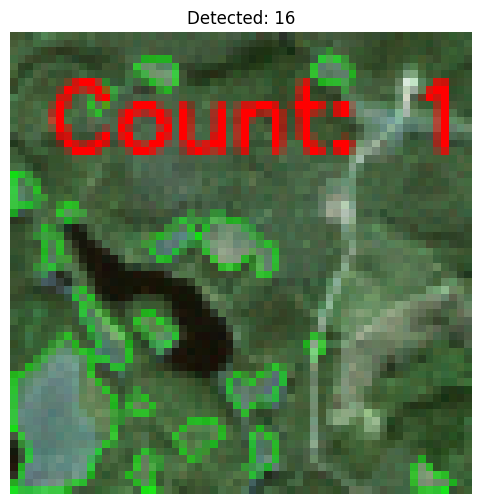

[336/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


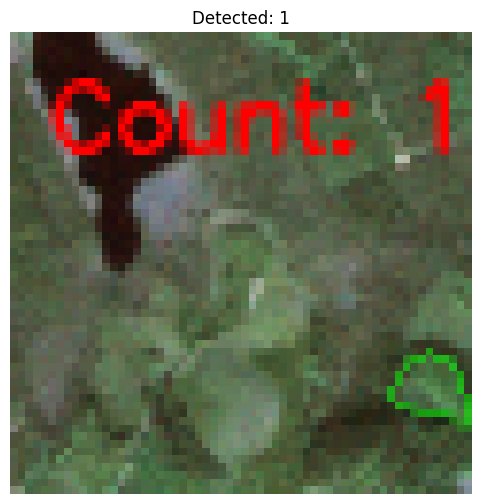

[337/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


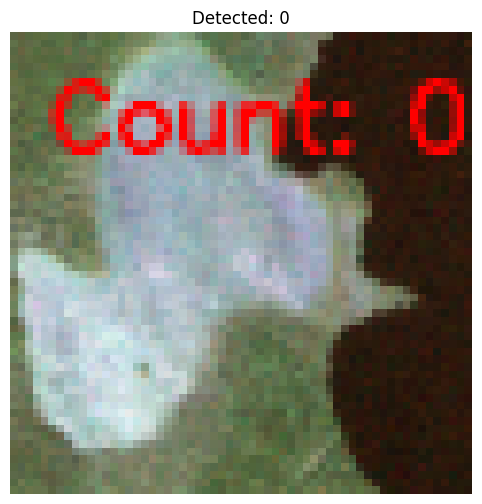

[338/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


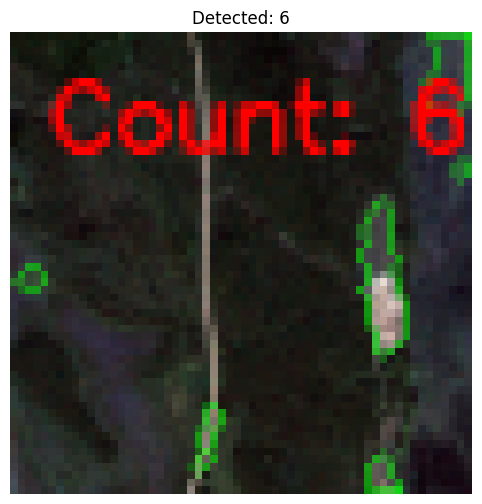

[339/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


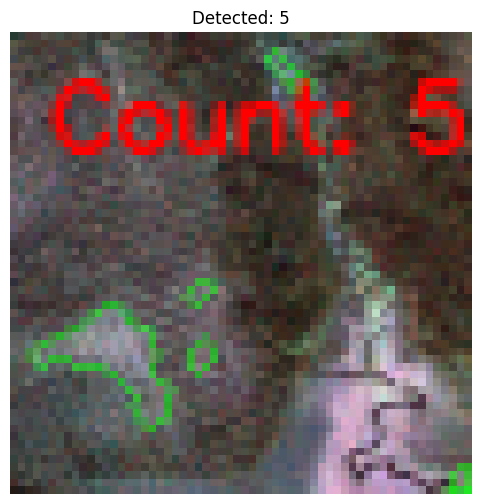

[340/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


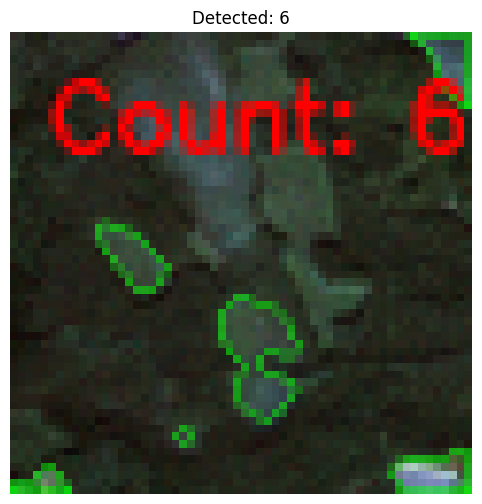

[341/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


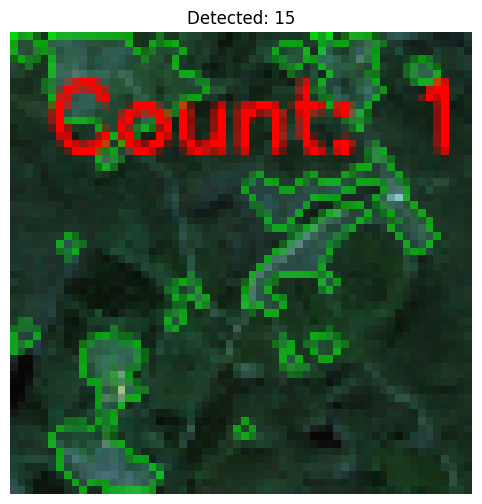

[342/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


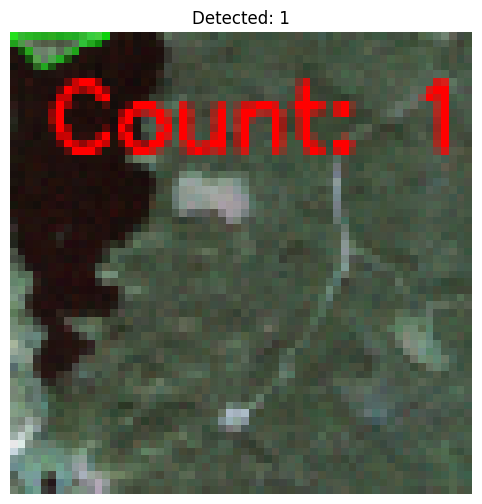

[343/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


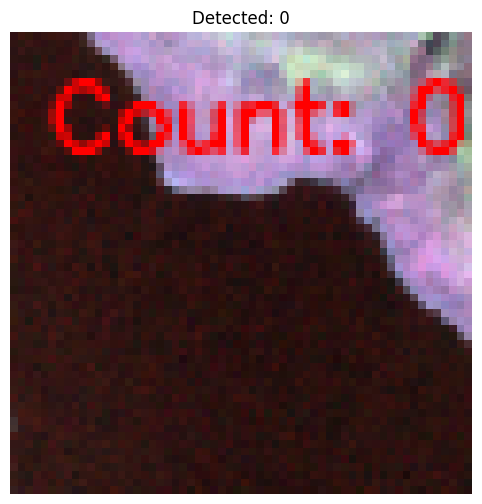

[344/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


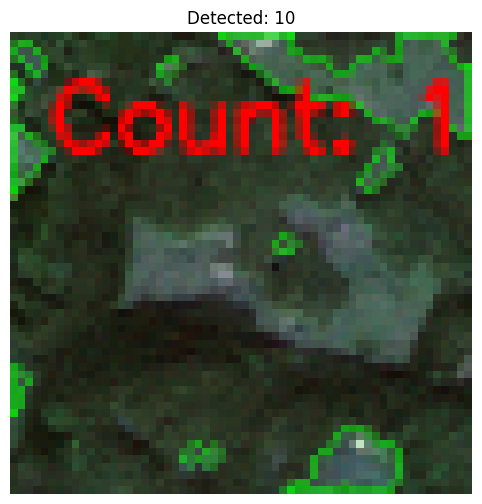

[345/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


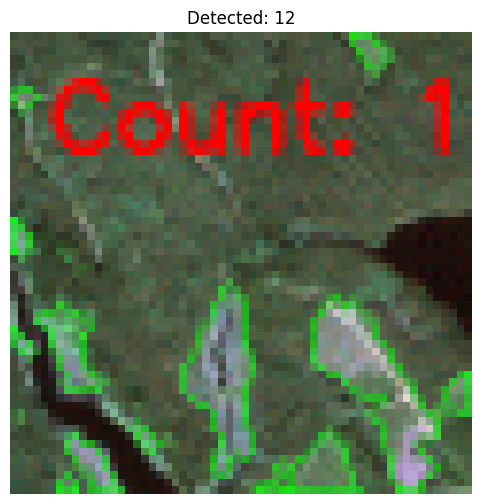

[346/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


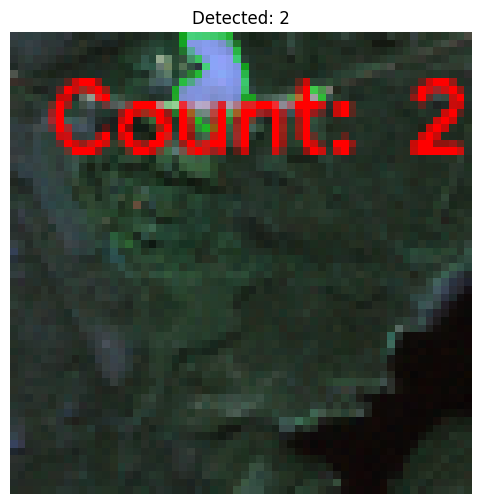

[347/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


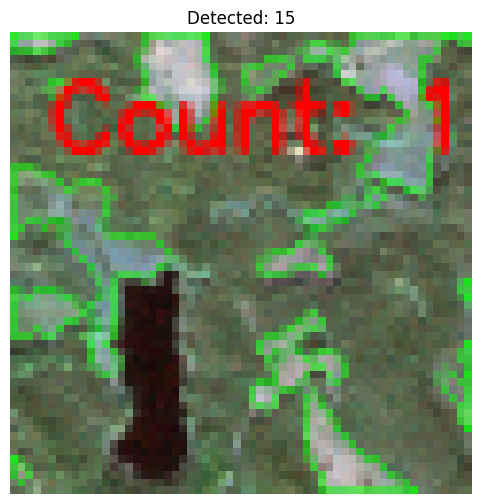

[348/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


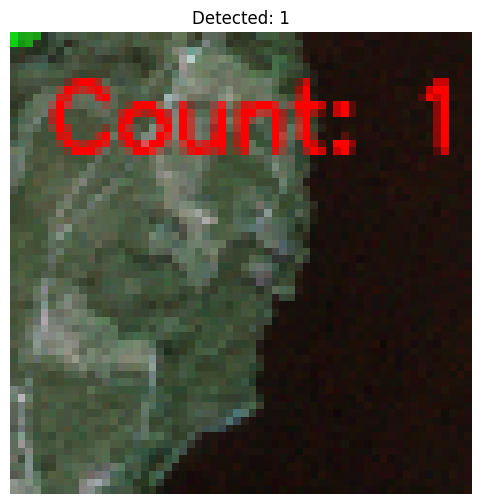

[349/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


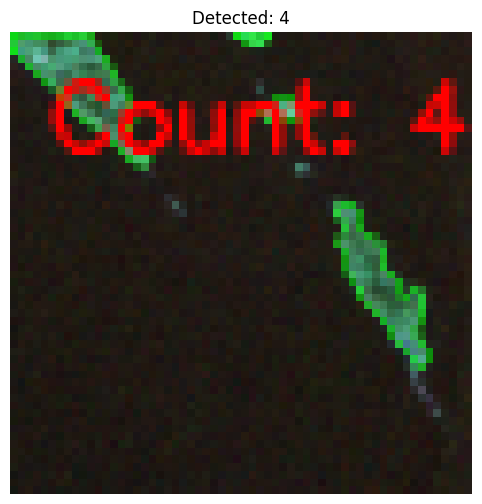

[350/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


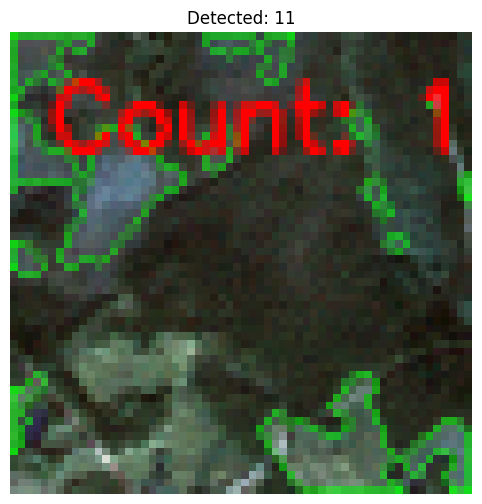

[351/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


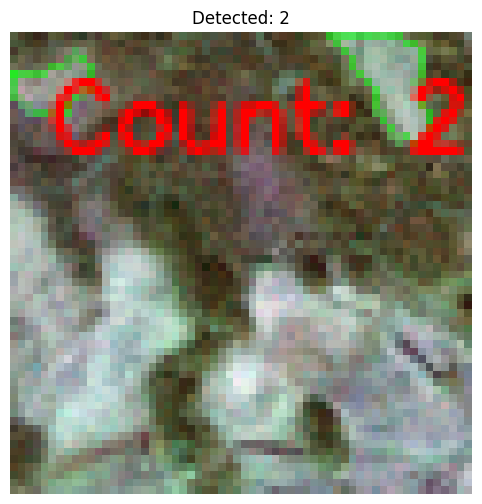

[352/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


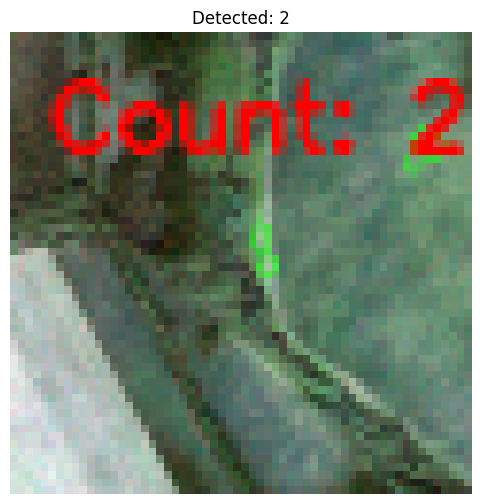

[353/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


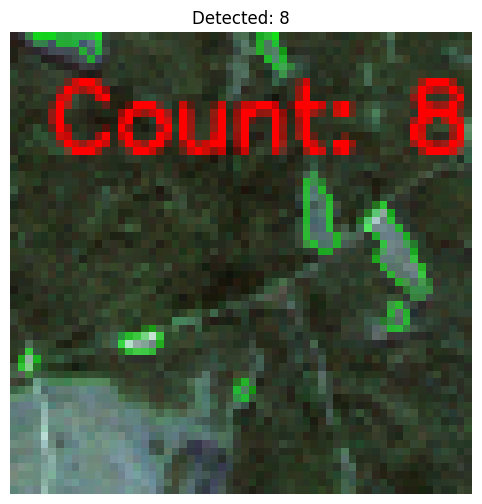

[354/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


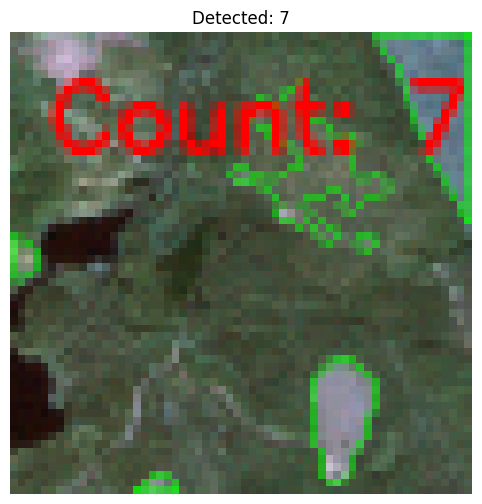

[355/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


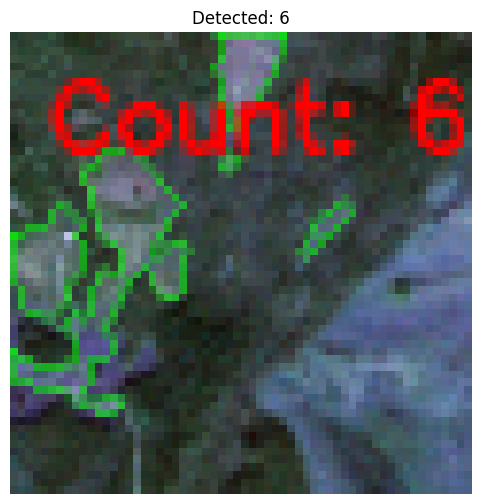

[356/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


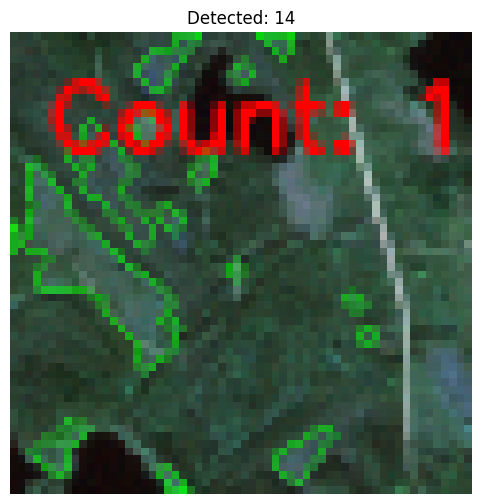

[357/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


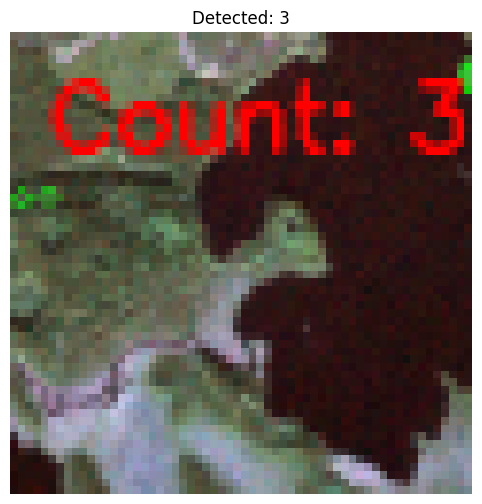

[358/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


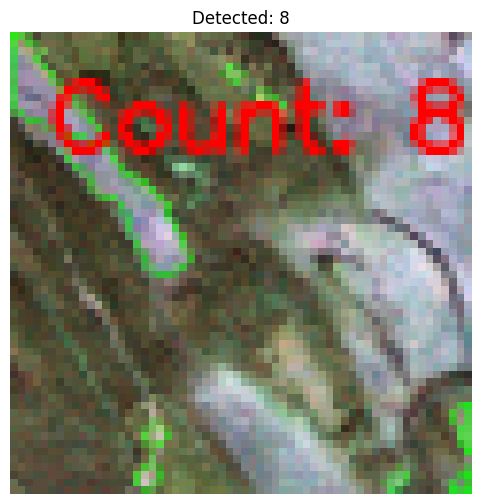

[359/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


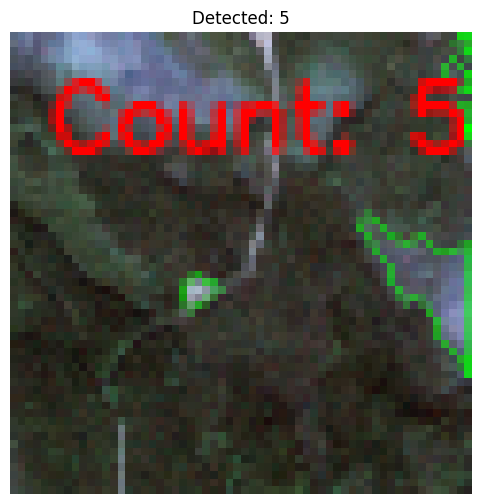

[360/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


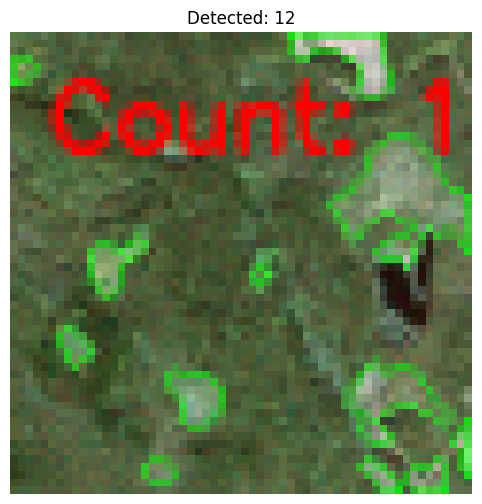

[361/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


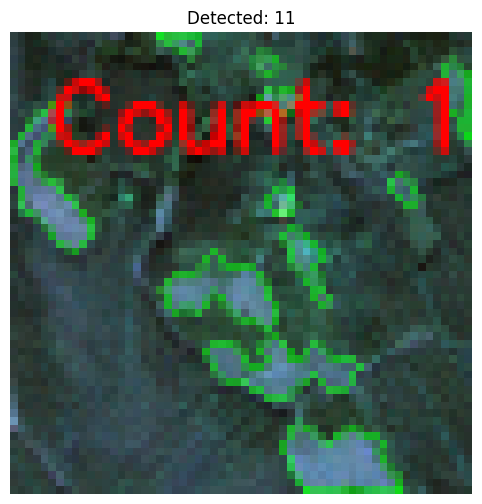

[362/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


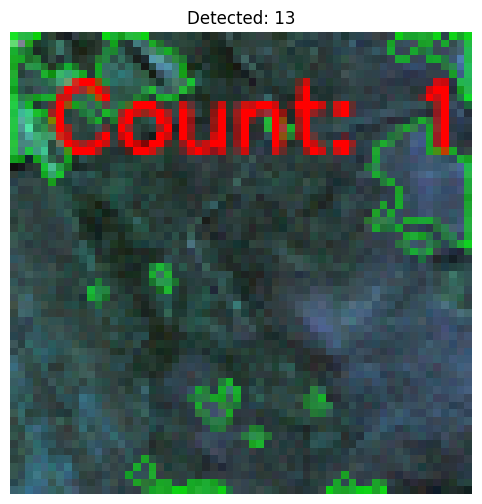

[363/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


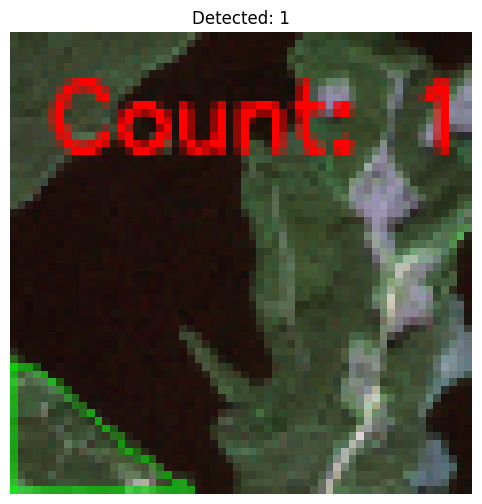

[364/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


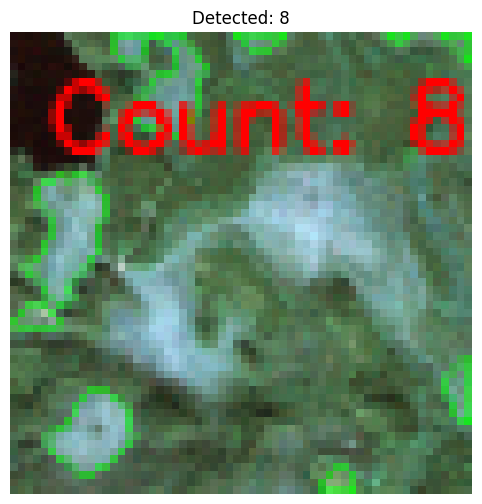

[365/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


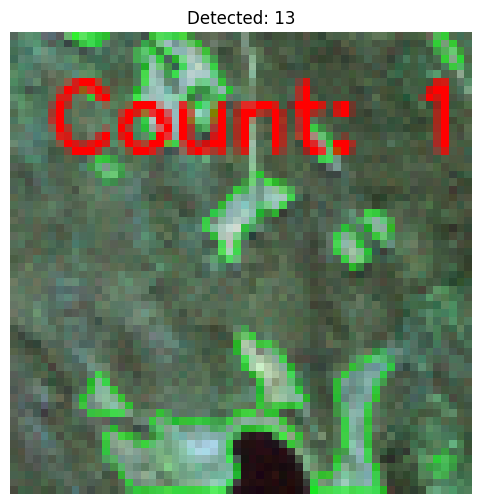

[366/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


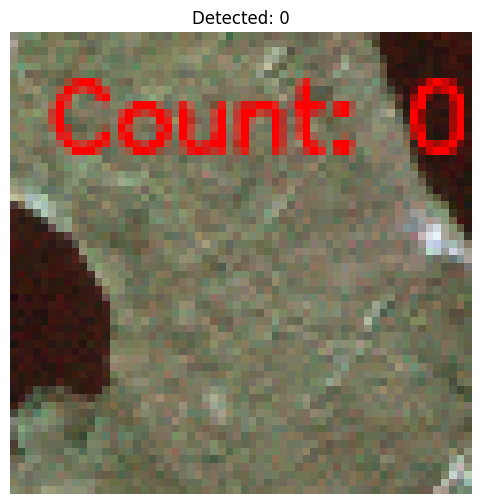

[367/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


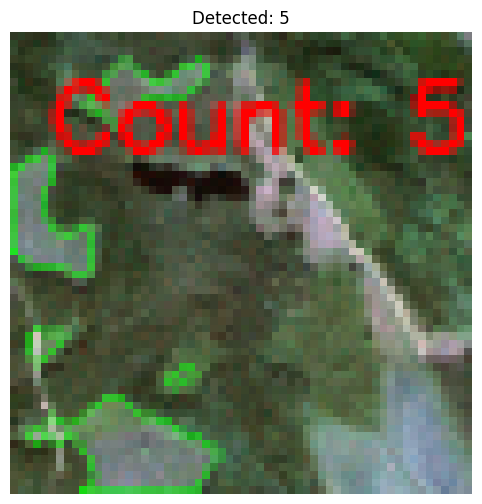

[368/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


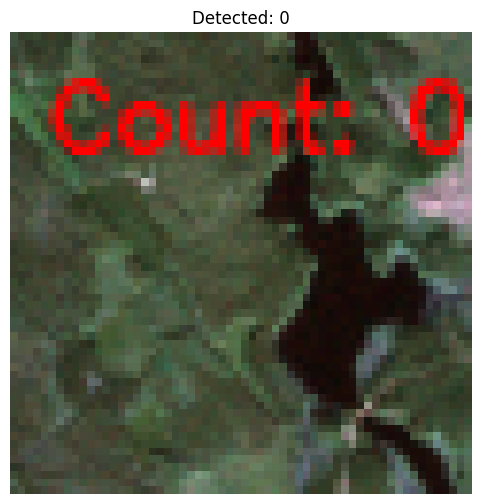

[369/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


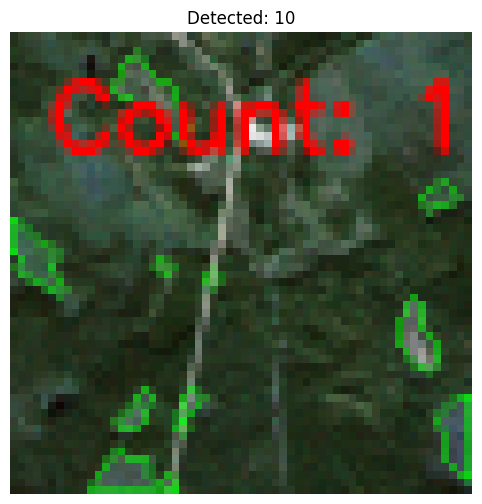

[370/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


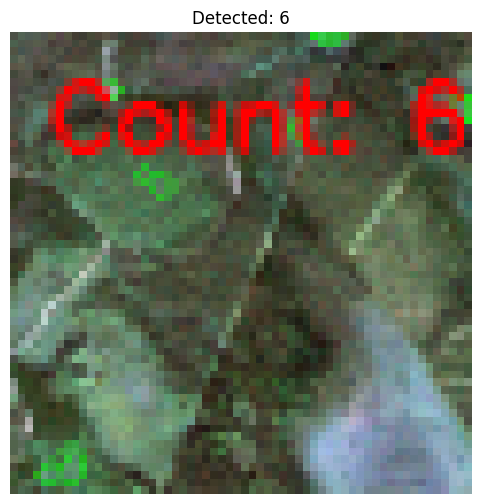

[371/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


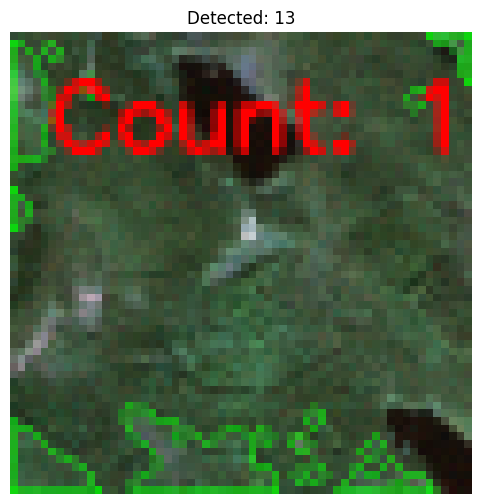

[372/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


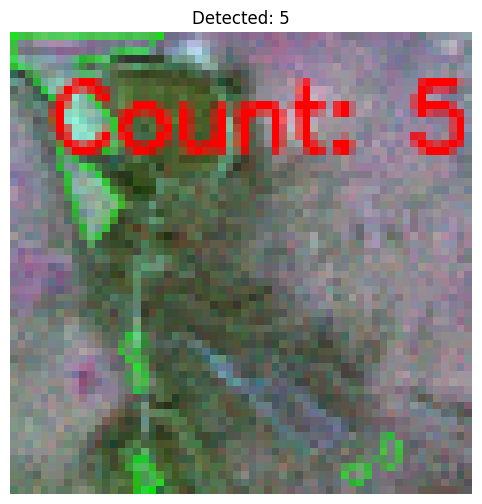

[373/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


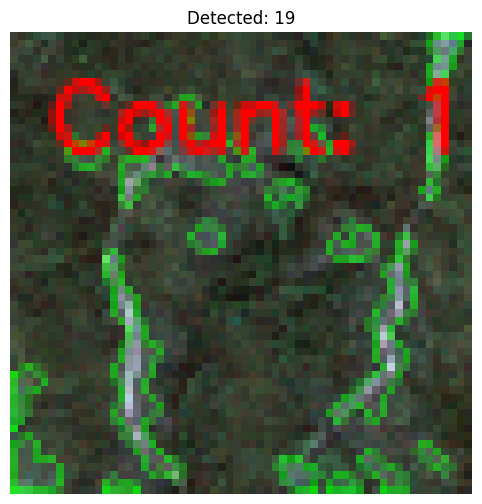

[374/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


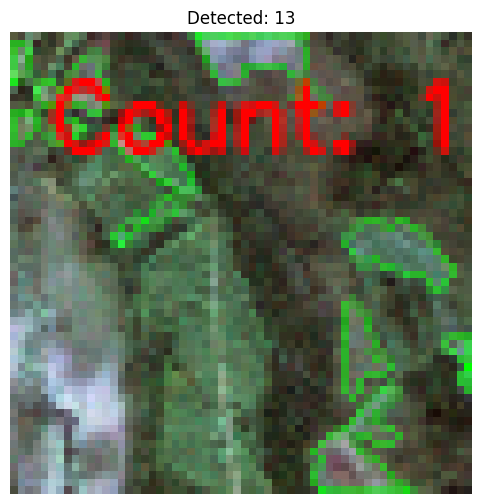

[375/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


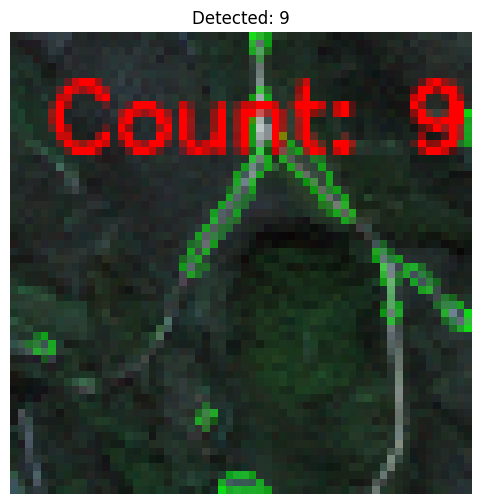

[376/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


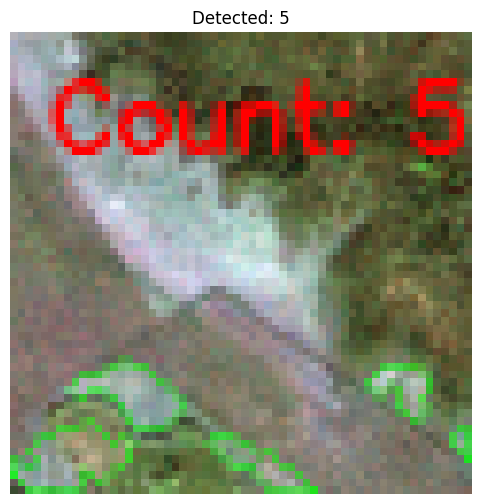

[377/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


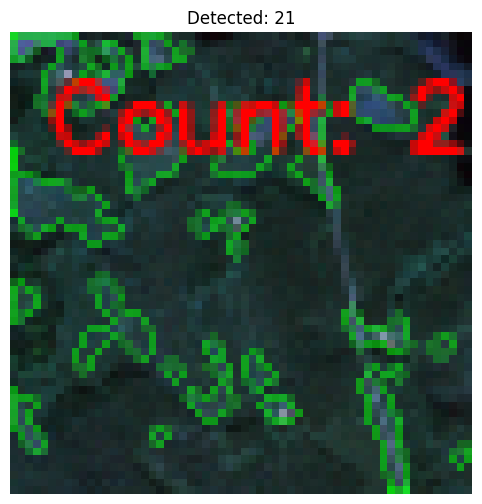

[378/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


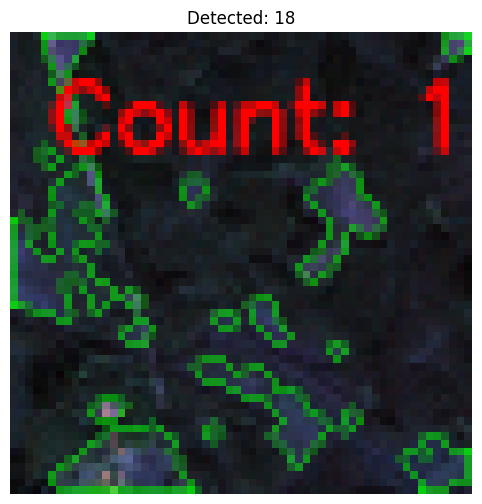

[379/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


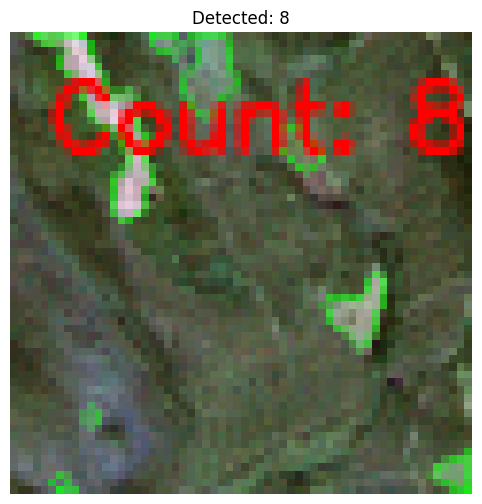

[380/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


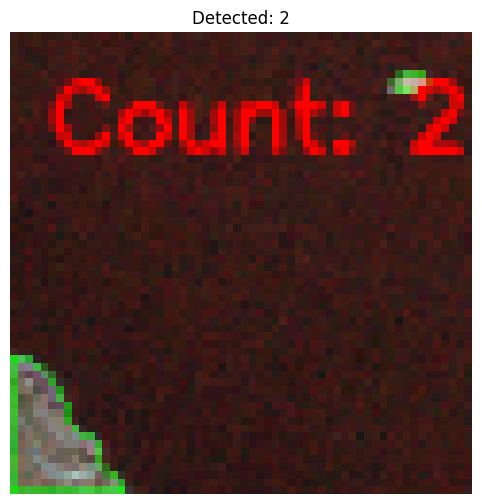

[381/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


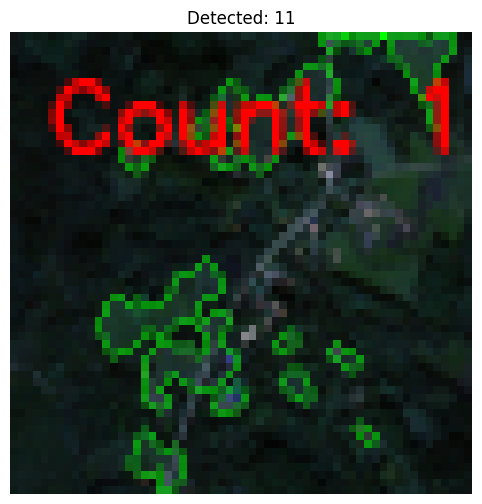

[382/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


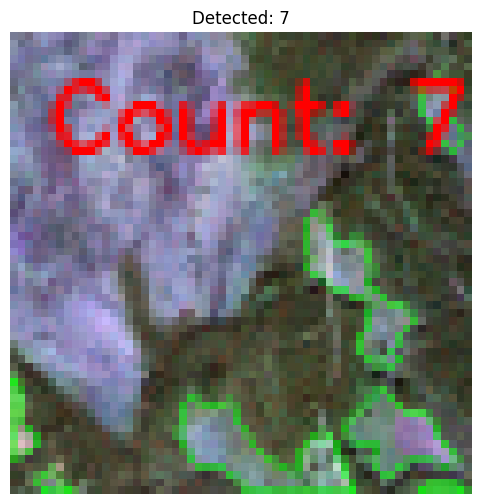

[383/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


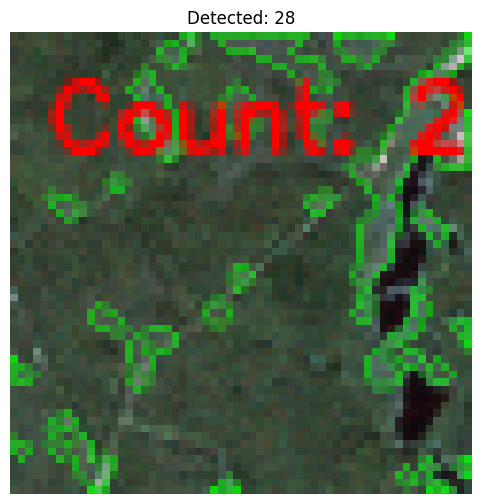

[384/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


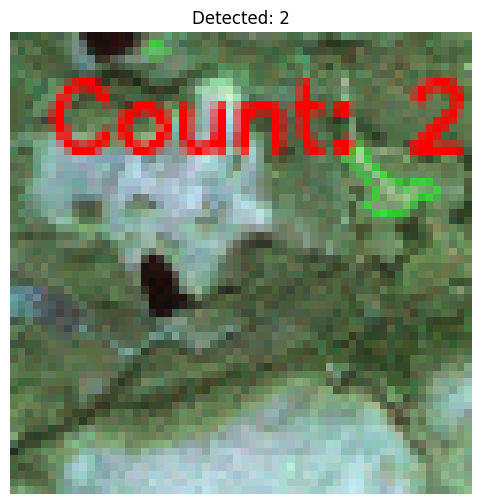

[385/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


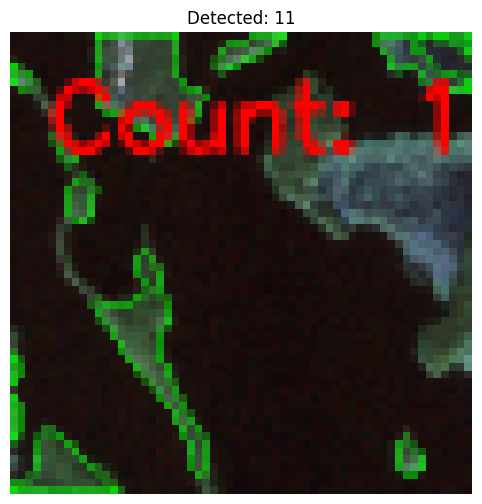

[386/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


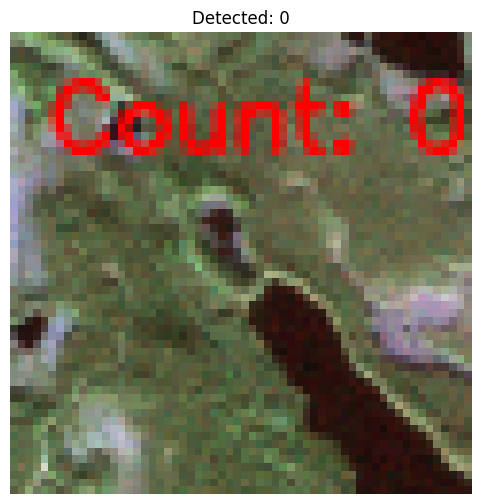

[387/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


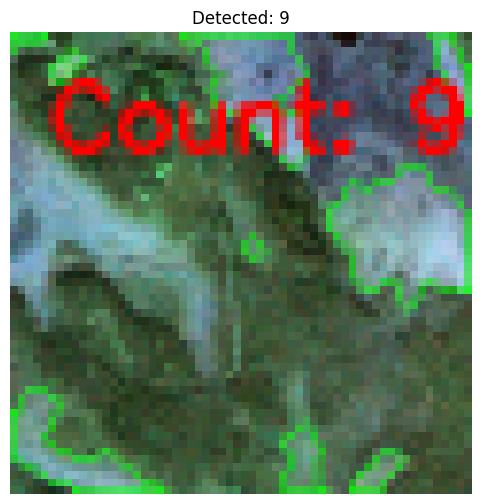

[388/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


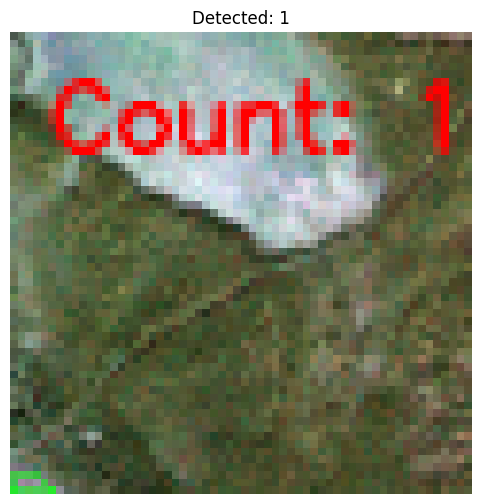

[389/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


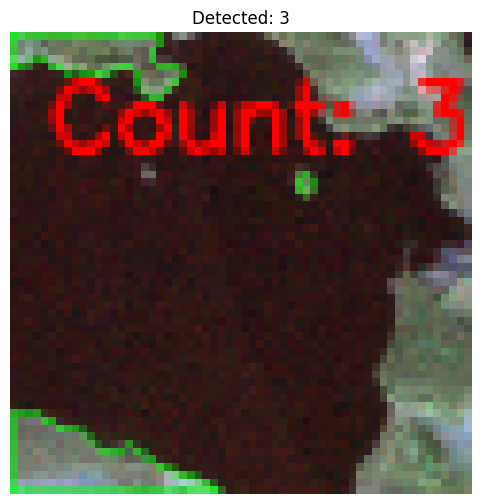

[390/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


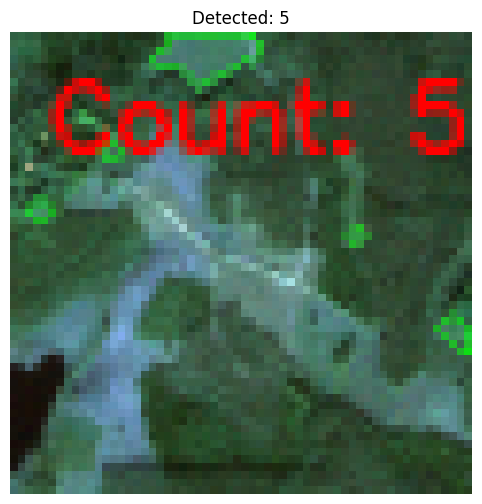

[391/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


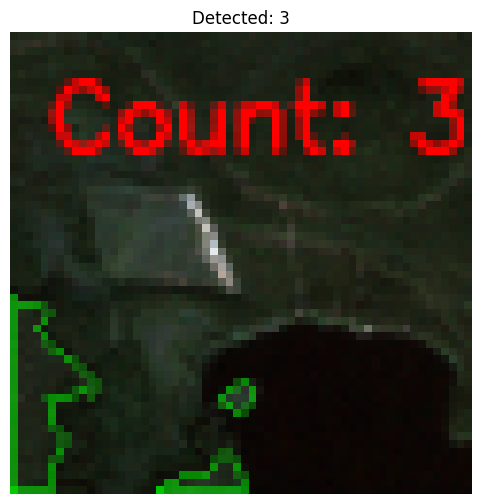

[392/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


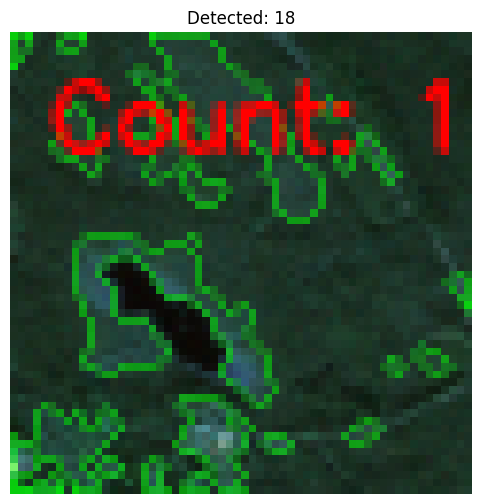

[393/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


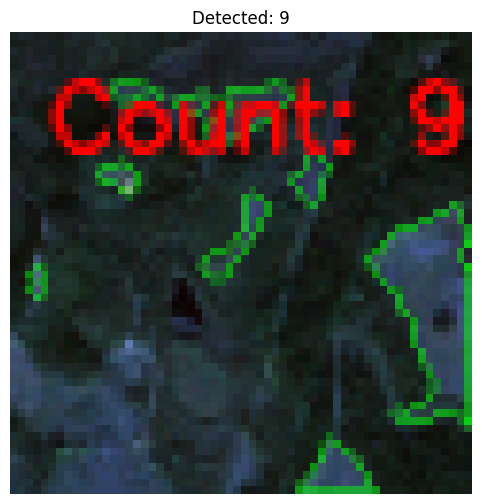

[394/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


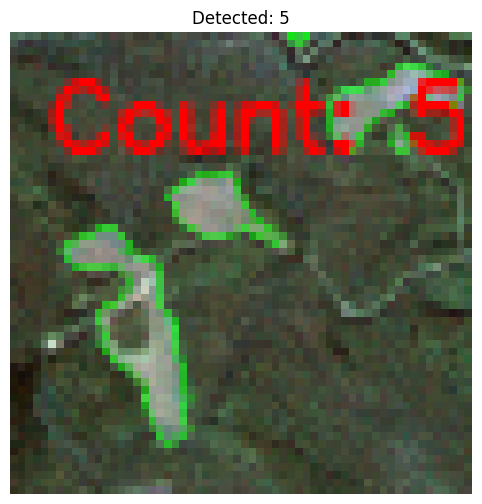

[395/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


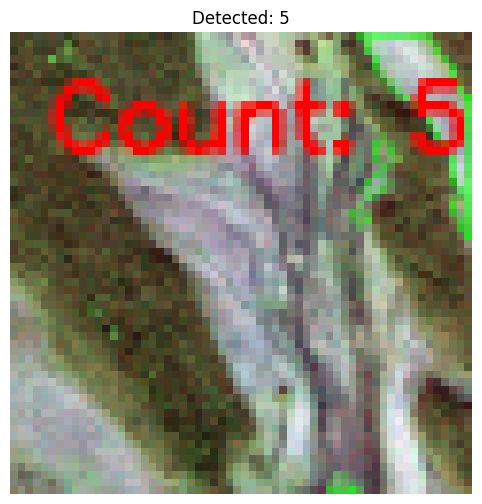

[396/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


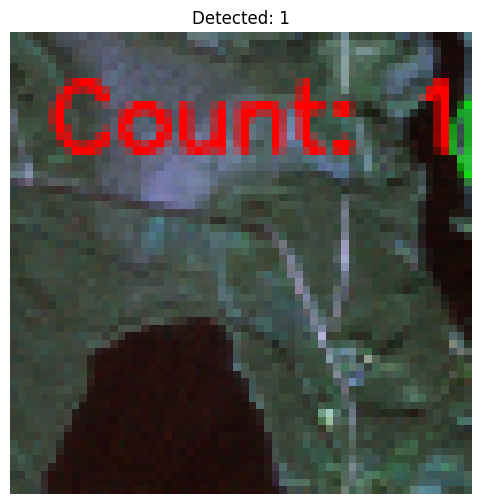

[397/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


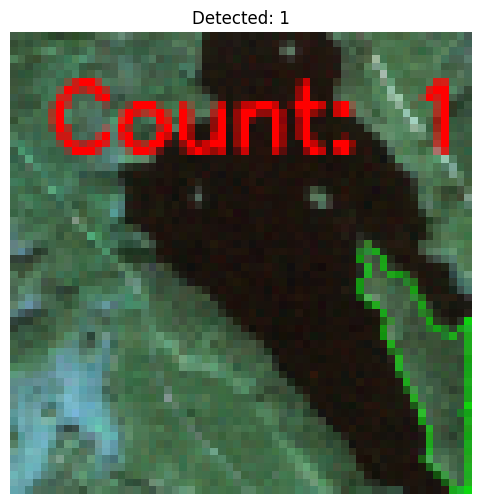

[398/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


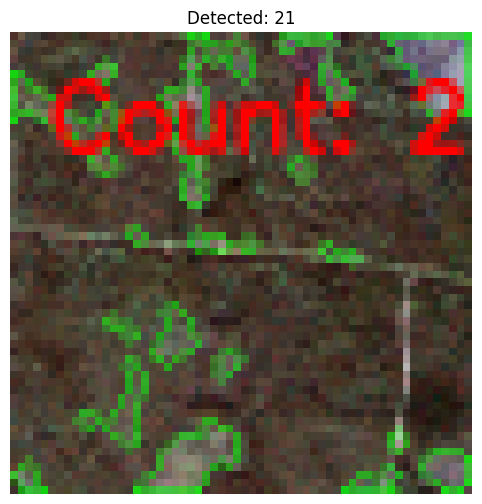

[399/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


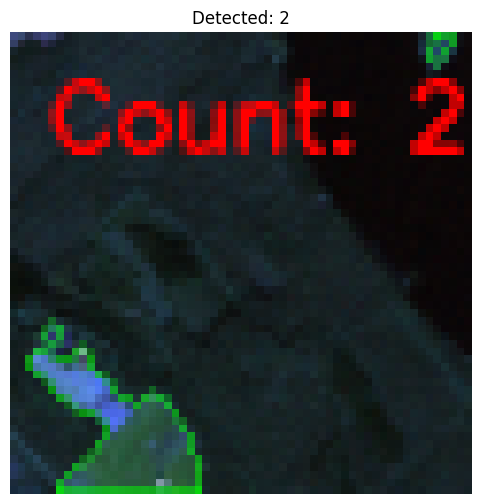

[400/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


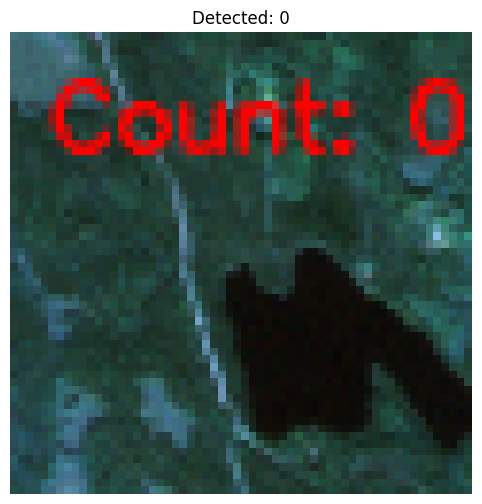

[401/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


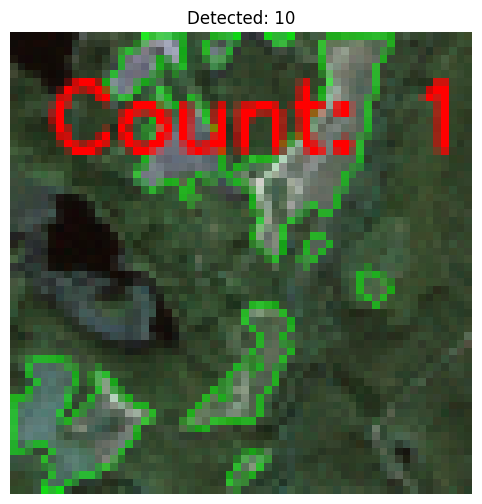

[402/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


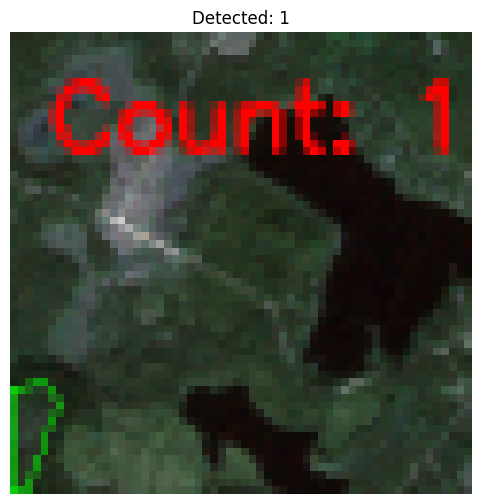

[403/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


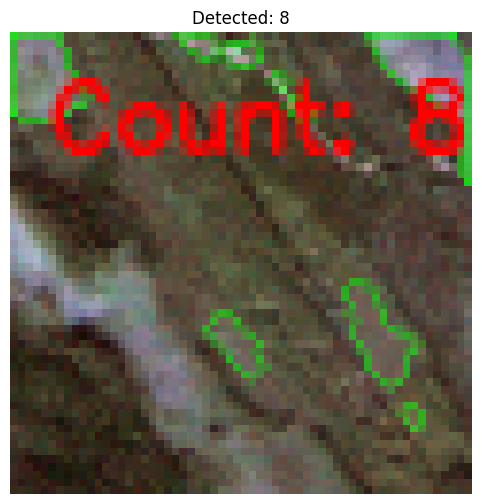

[404/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


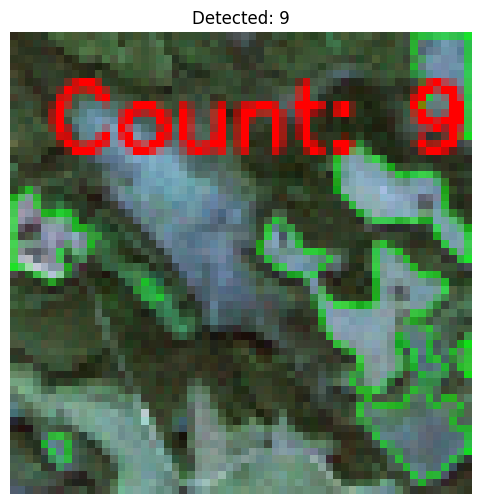

[405/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


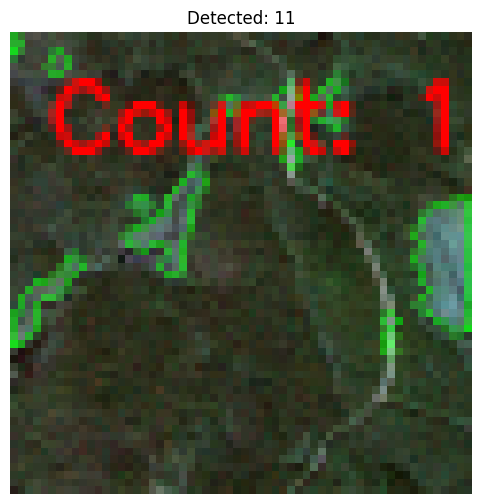

[406/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


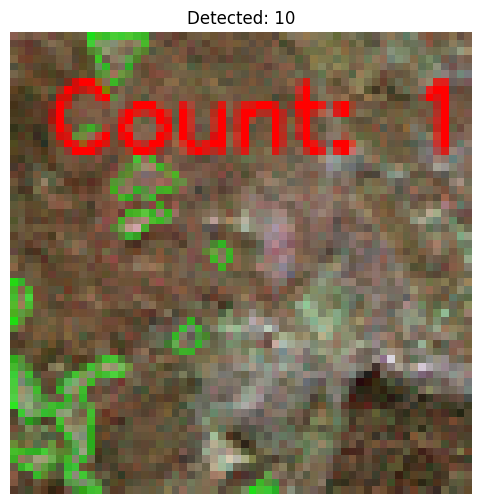

[407/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


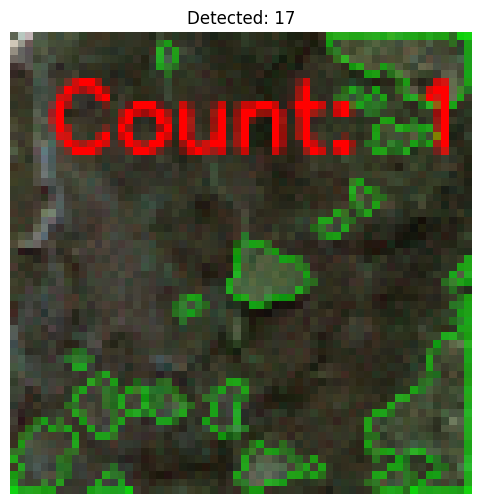

[408/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


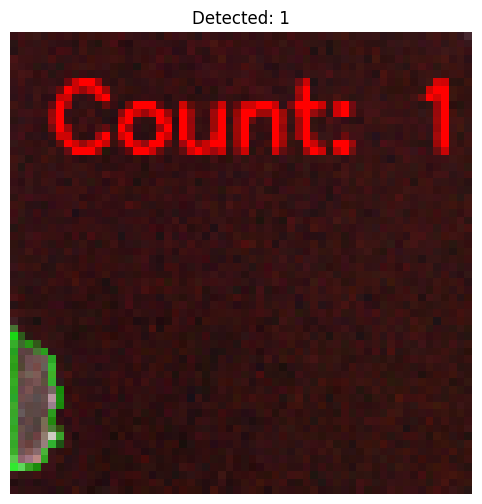

[409/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


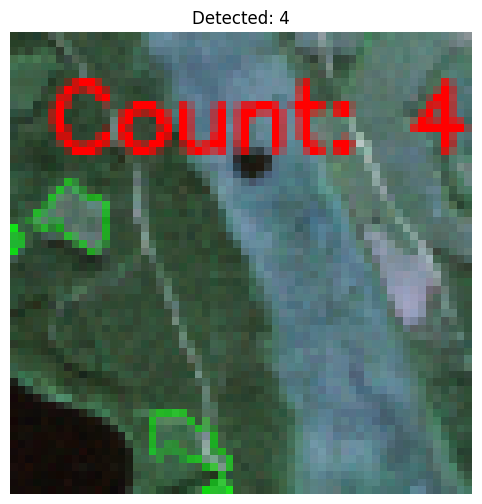

[410/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


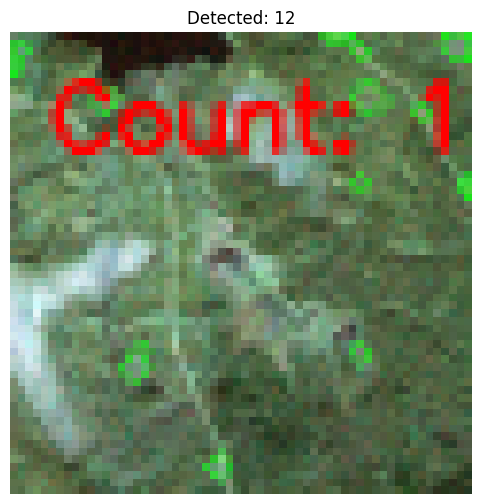

[411/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


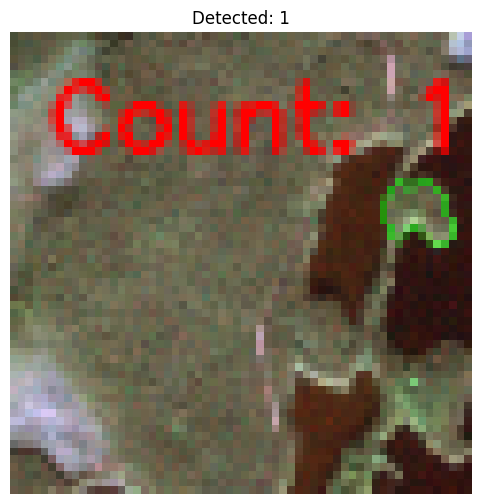

[412/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


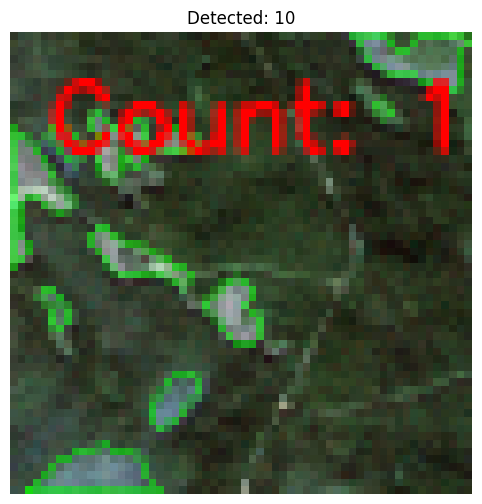

[413/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


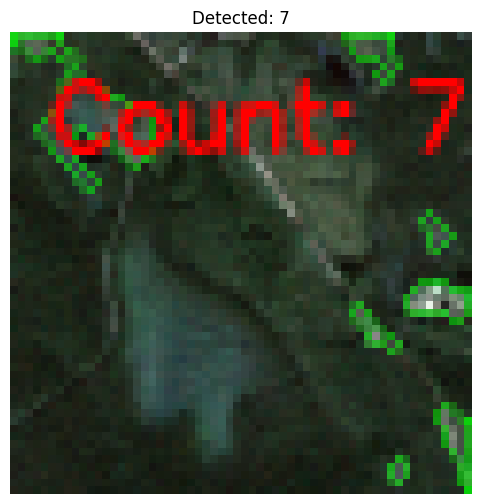

[414/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


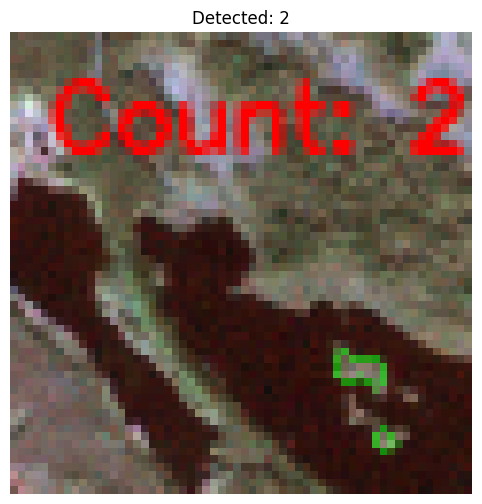

[415/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


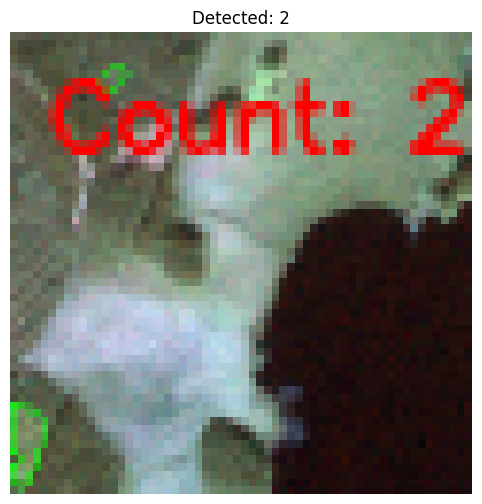

[416/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


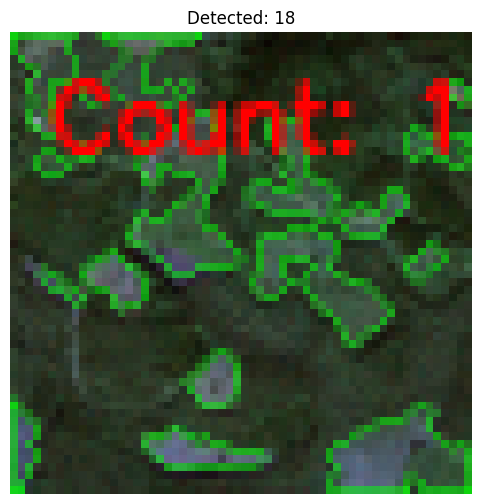

[417/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


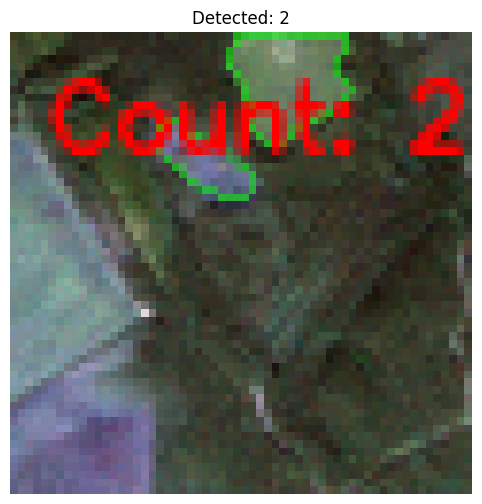

[418/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


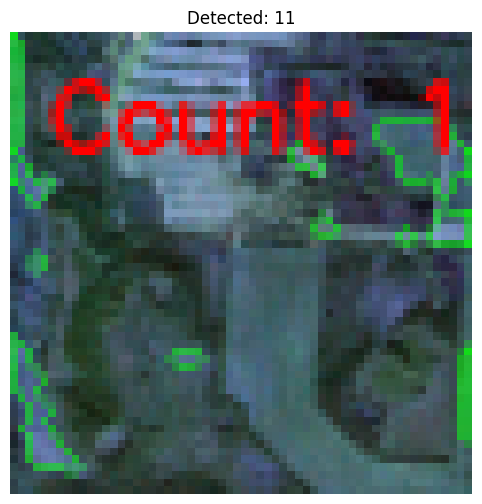

[419/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


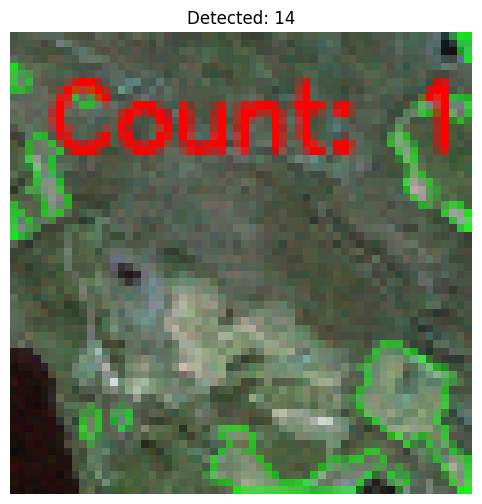

[420/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


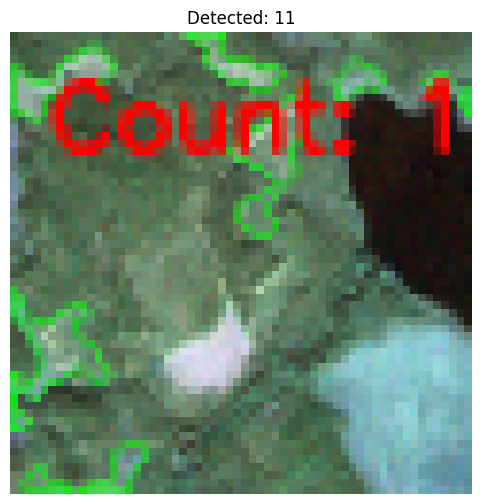

[421/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


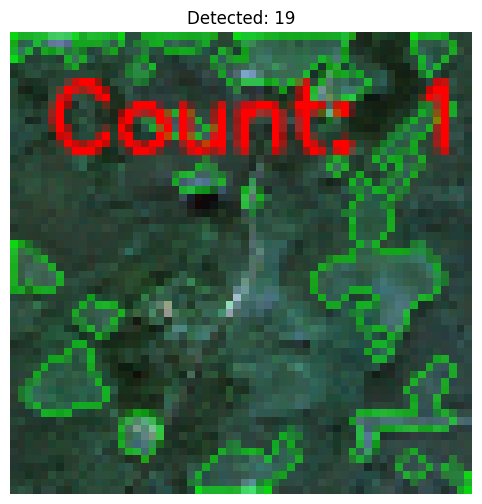

[422/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


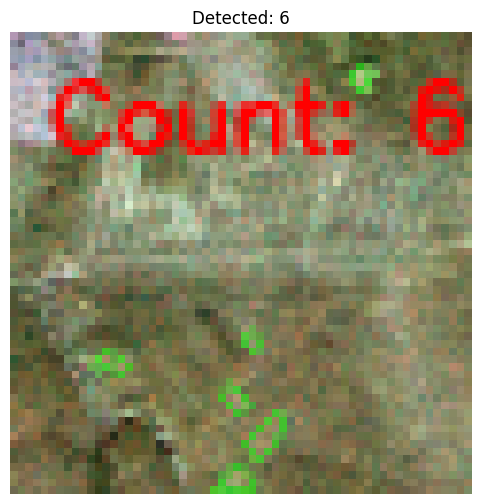

[423/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


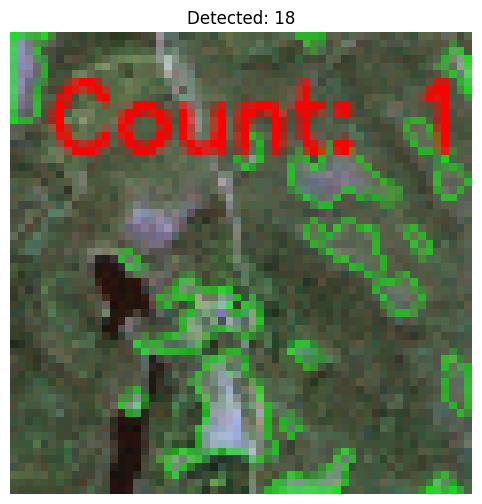

[424/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


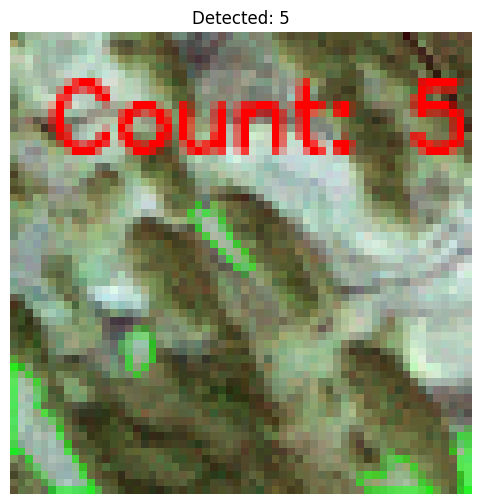

[425/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


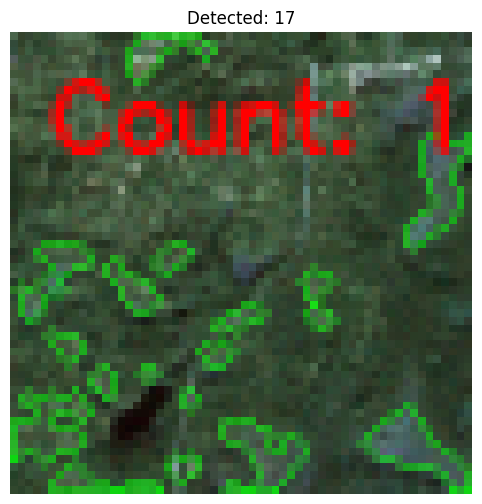

[426/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


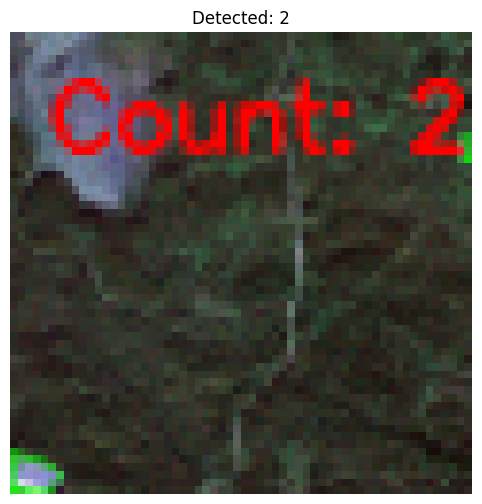

[427/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


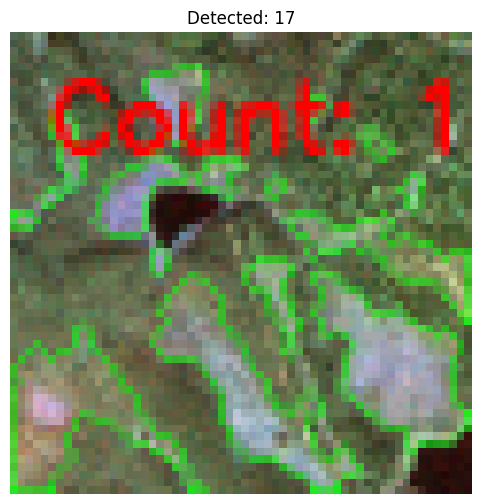

[428/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


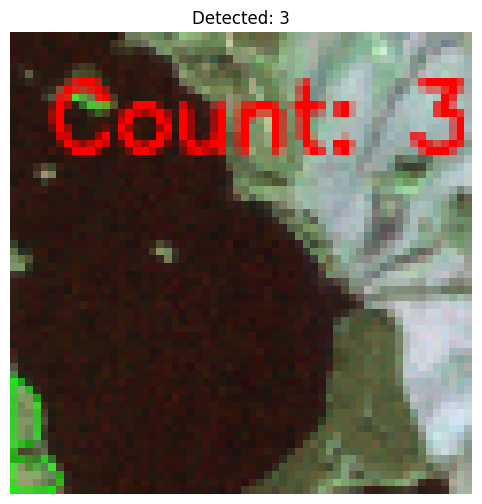

[429/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 23                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


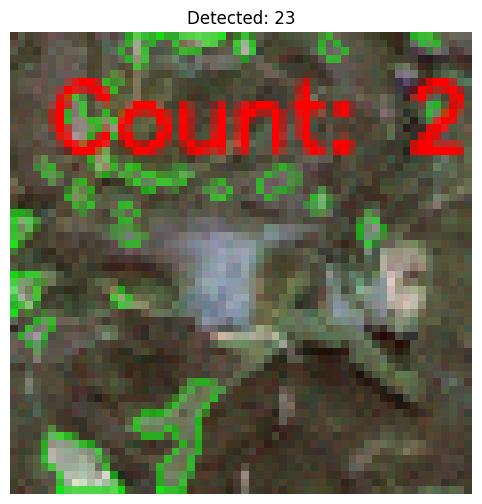

[430/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


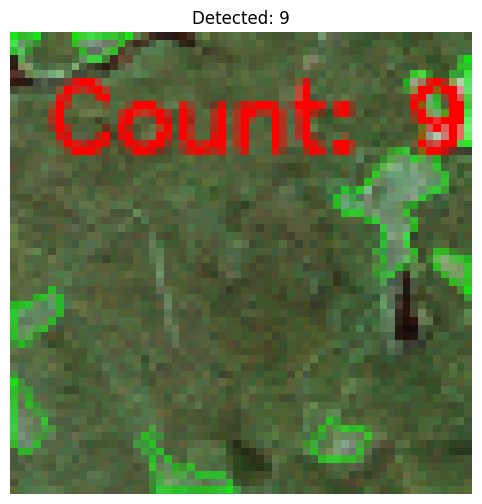

[431/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


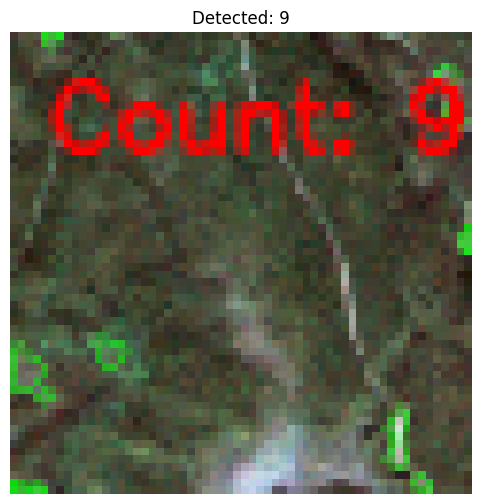

[432/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


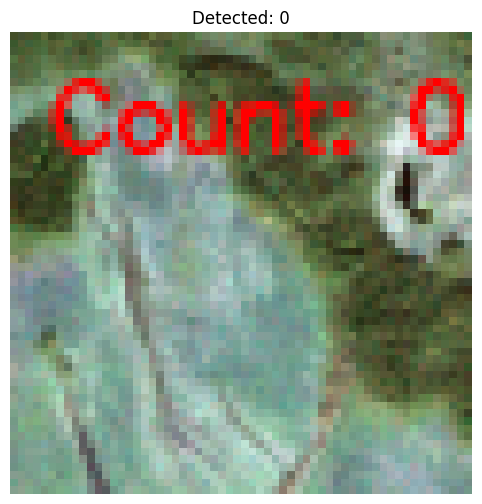

[433/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


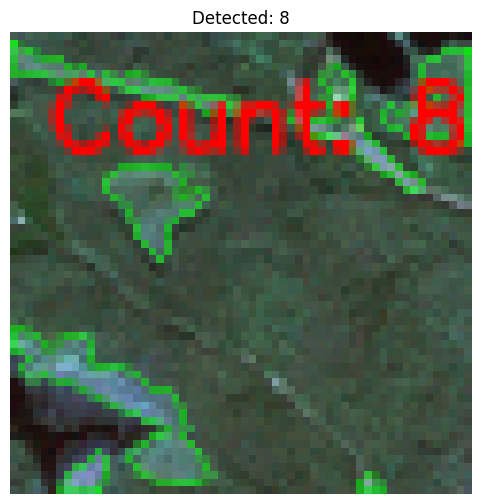

[434/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


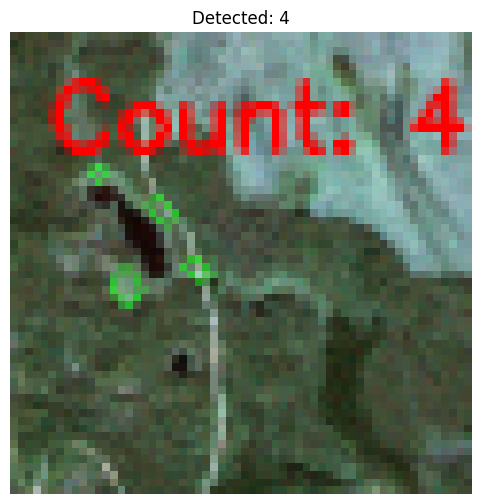

[435/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


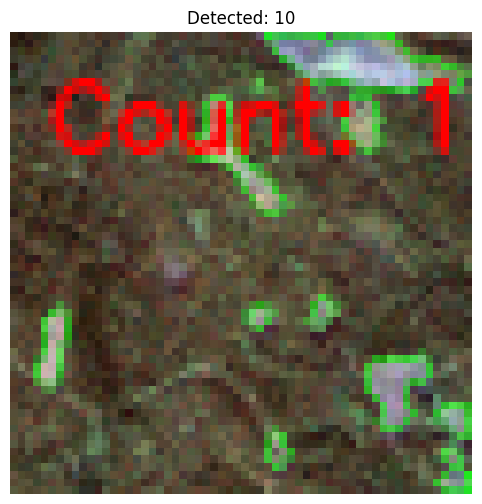

[436/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


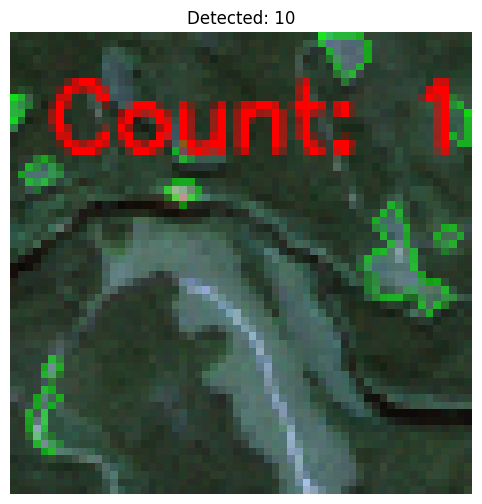

[437/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


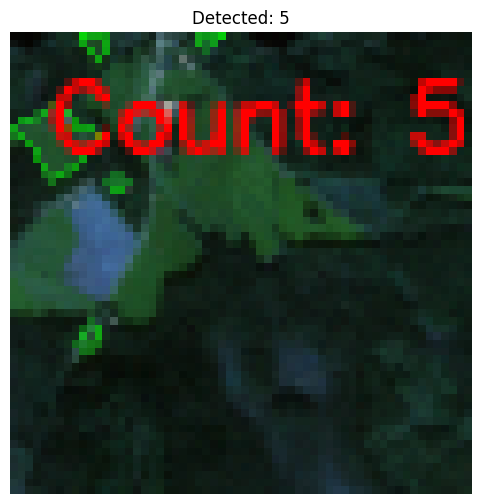

[438/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


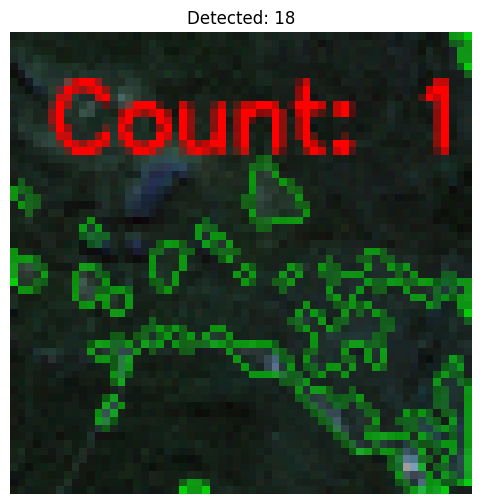

[439/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


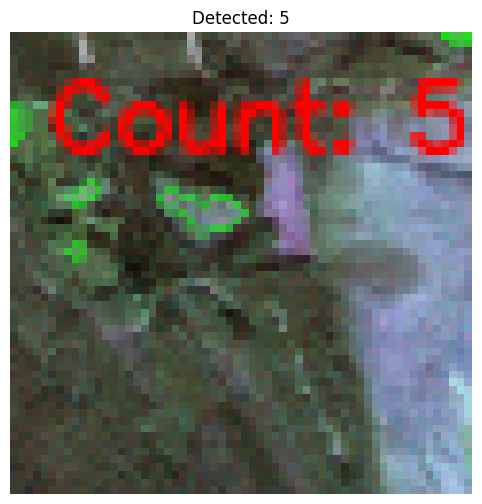

[440/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


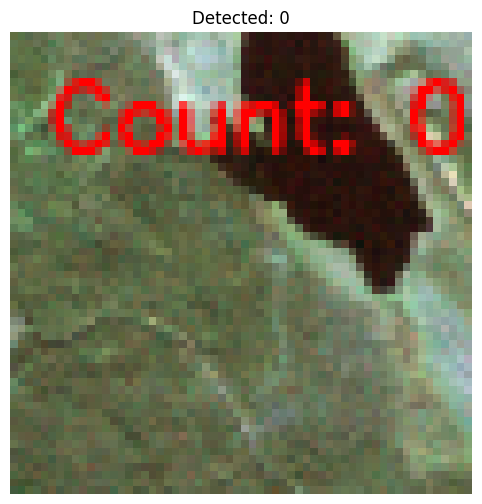

[441/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


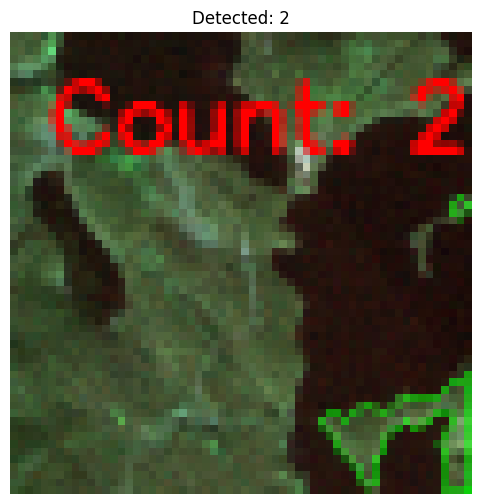

[442/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


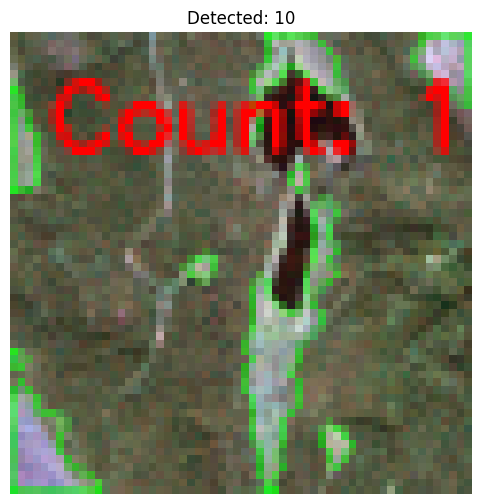

[443/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


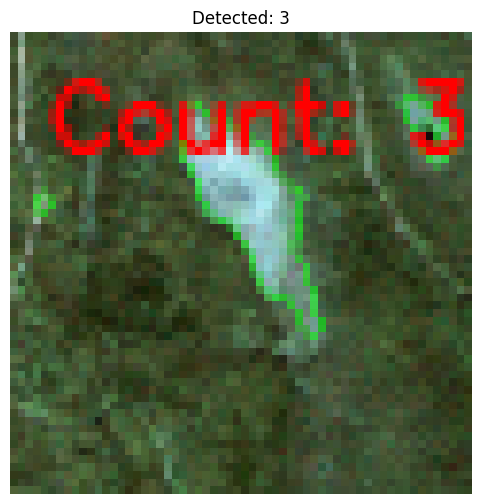

[444/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


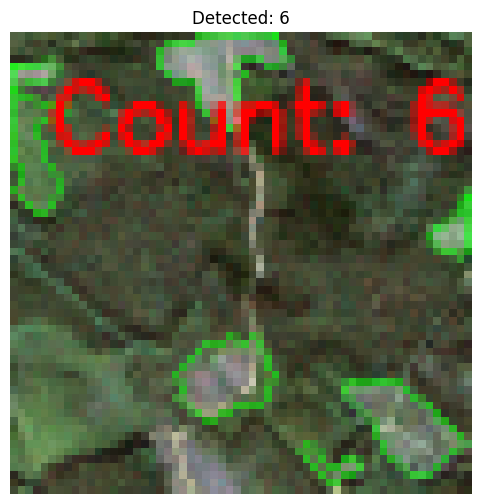

[445/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


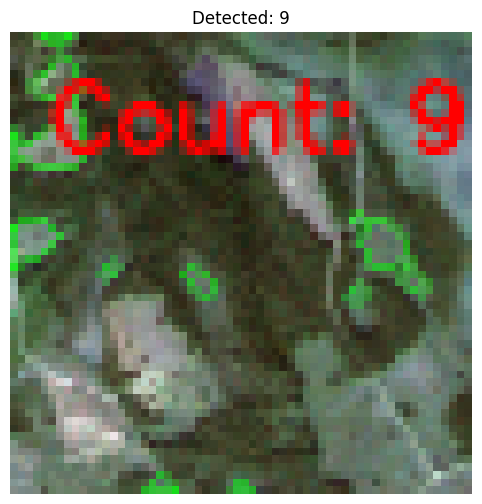

[446/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


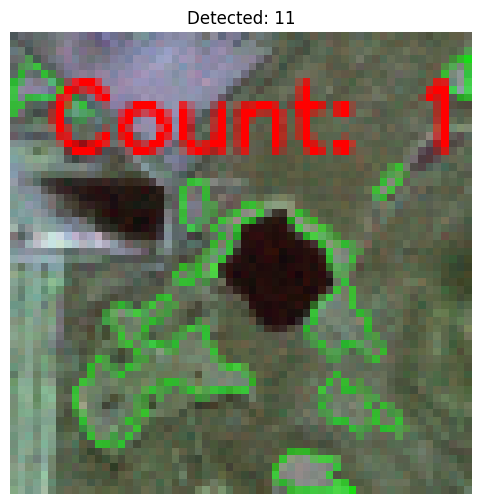

[447/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


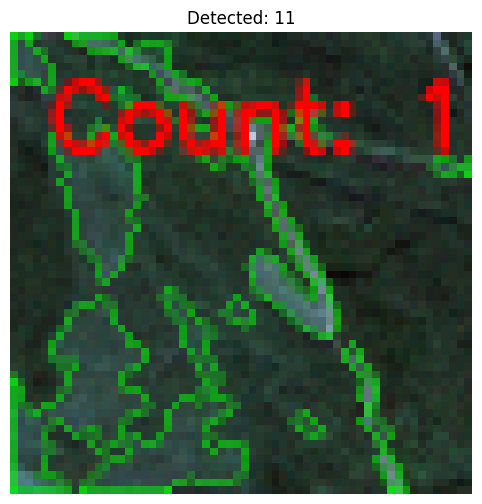

[448/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


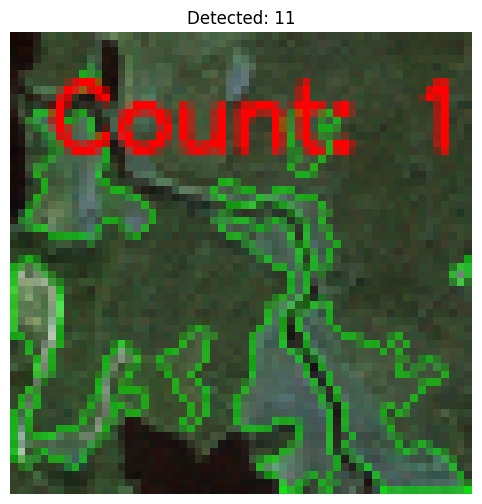

[449/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


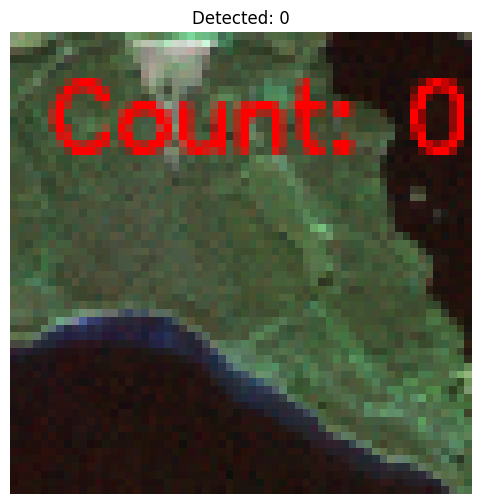

[450/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


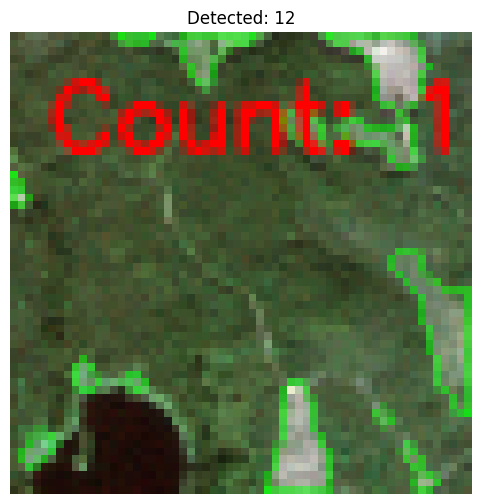

[451/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


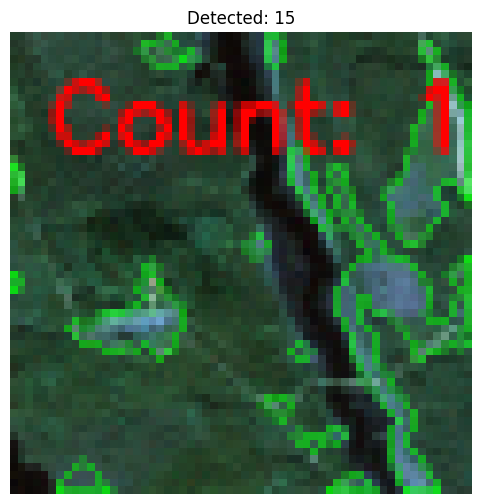

[452/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


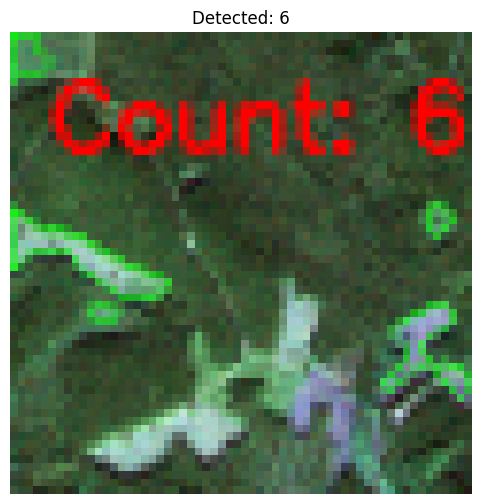

[453/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


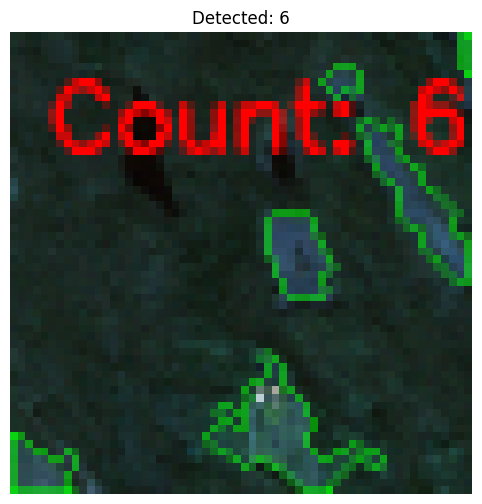

[454/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


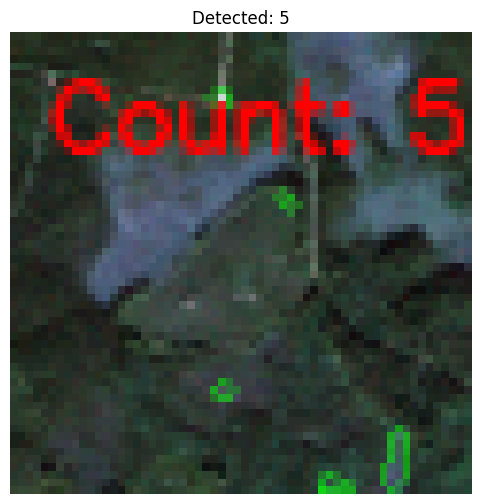

[455/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


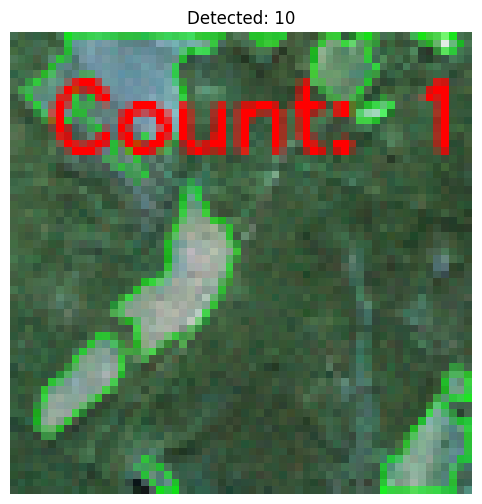

[456/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


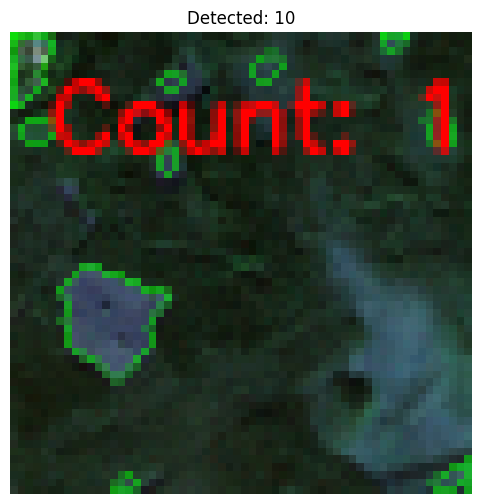

[457/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


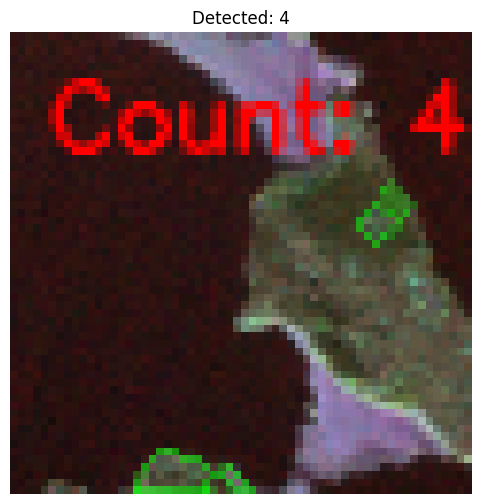

[458/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


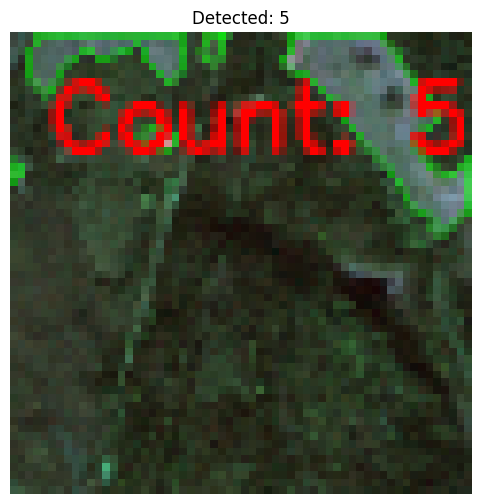

[459/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


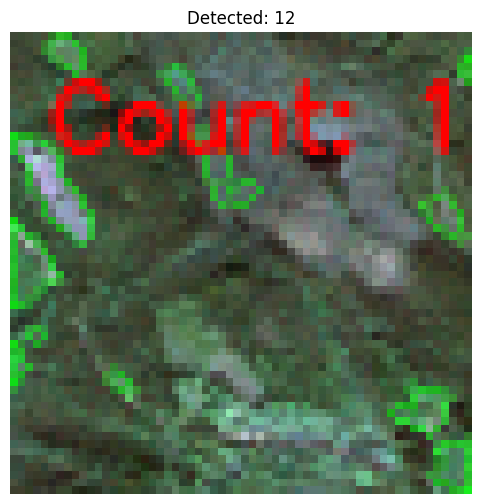

[460/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


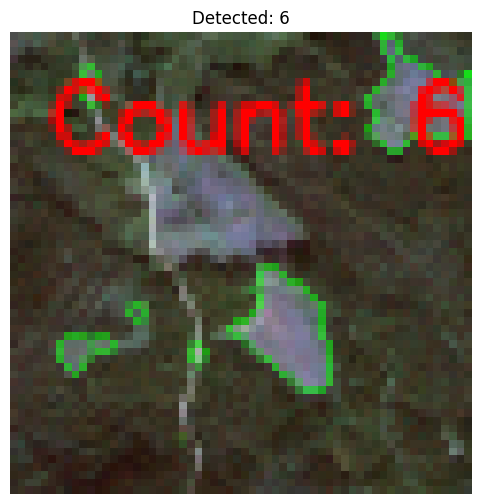

[461/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


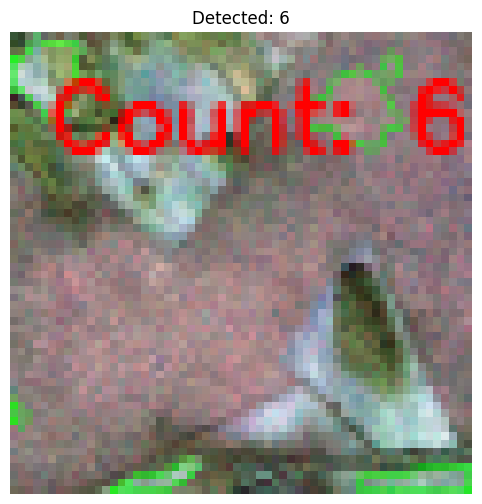

[462/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


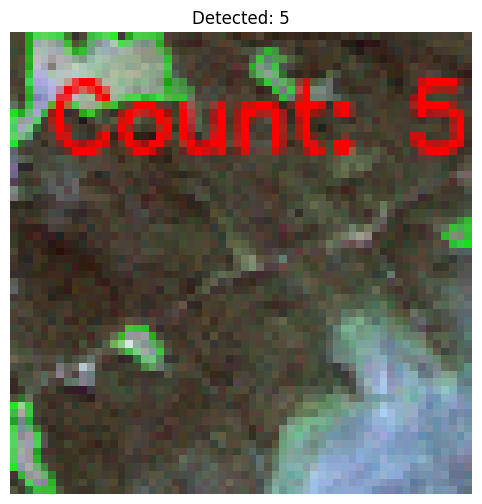

[463/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


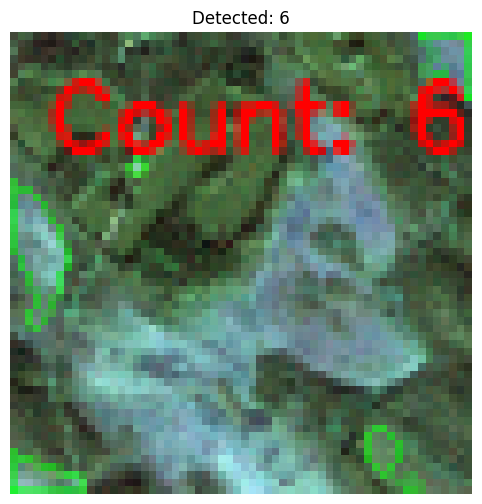

[464/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


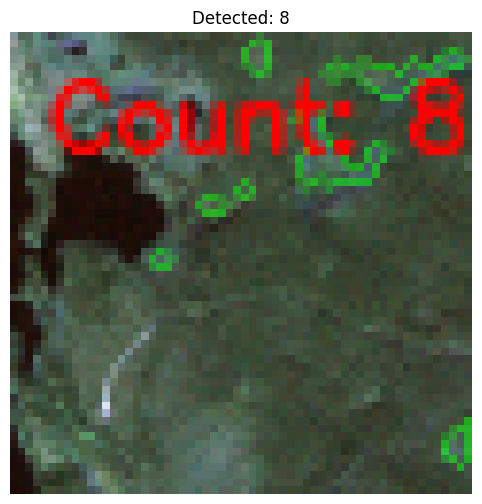

[465/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


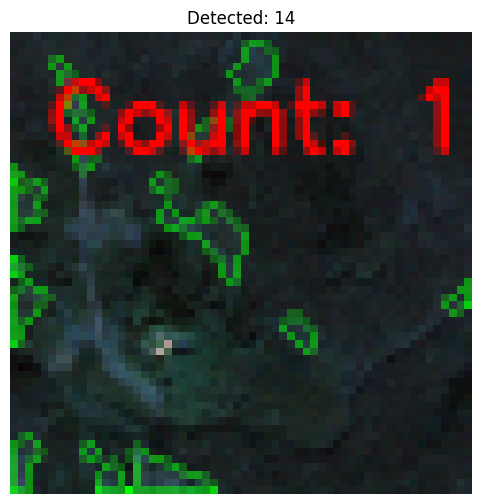

[466/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


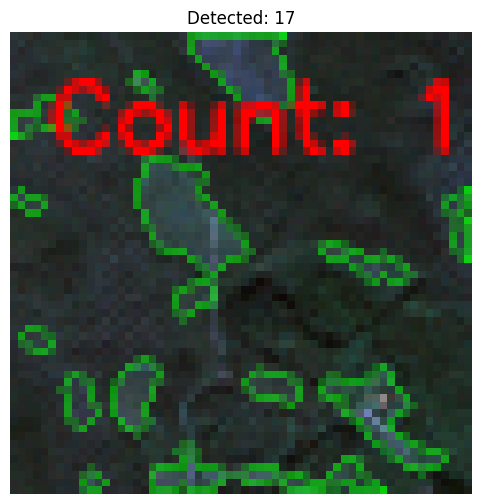

[467/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


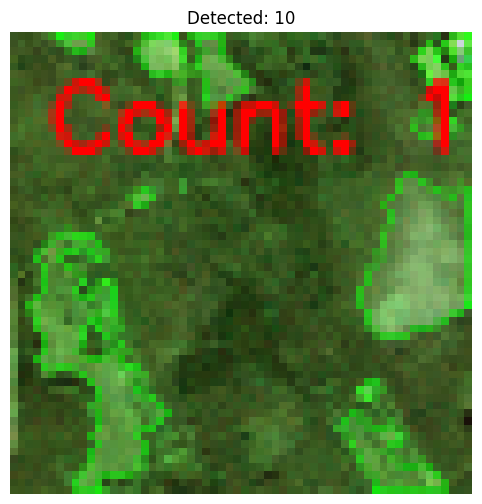

[468/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


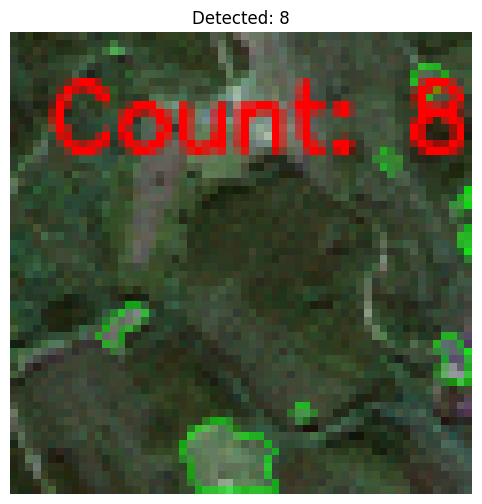

[469/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


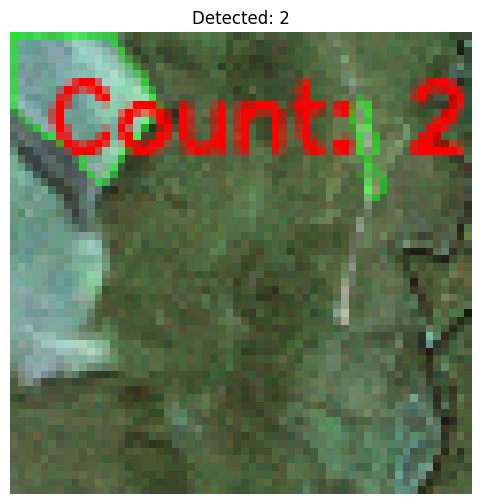

[470/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


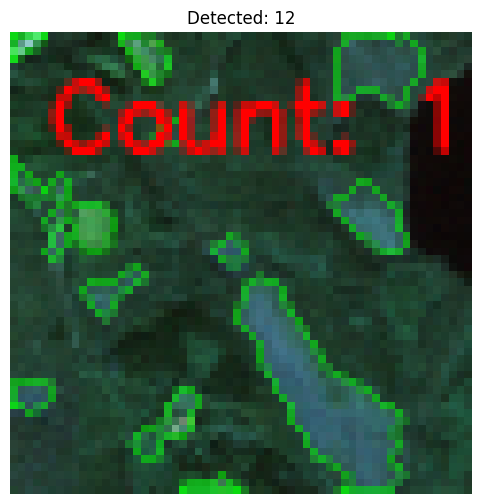

[471/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


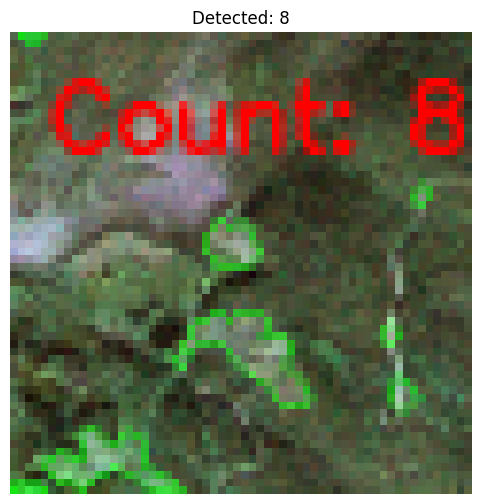

[472/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


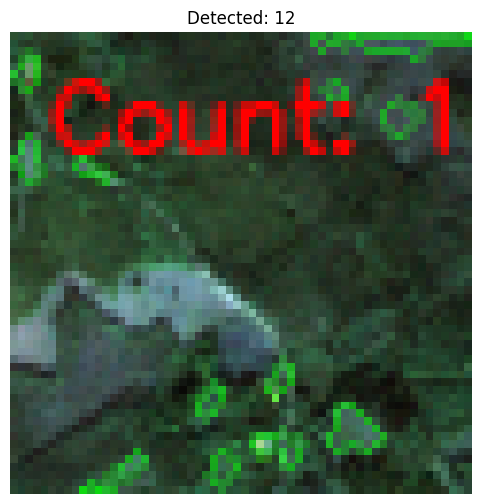

[473/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


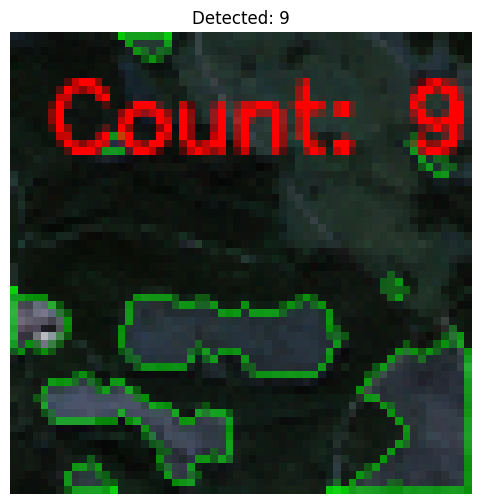

[474/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


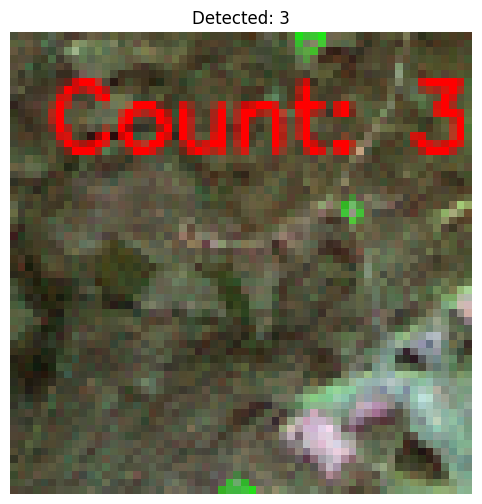

[475/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


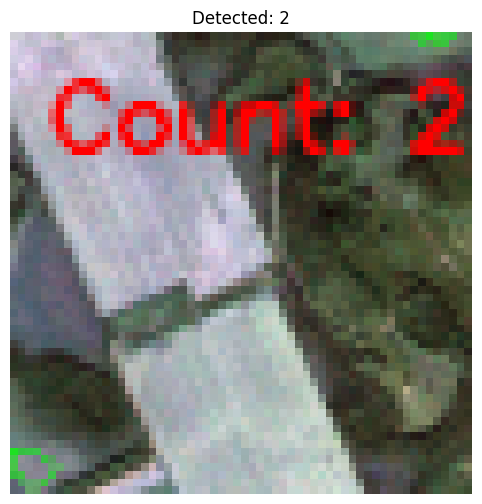

[476/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


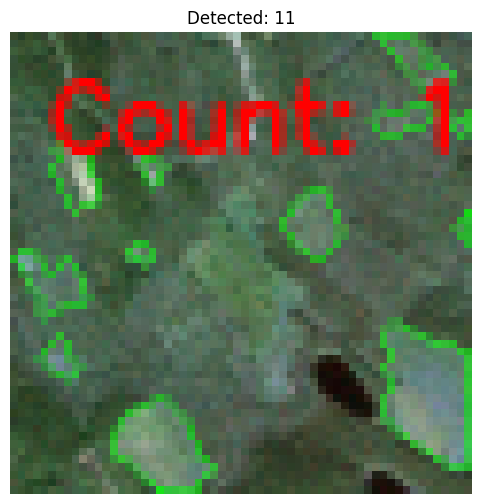

[477/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


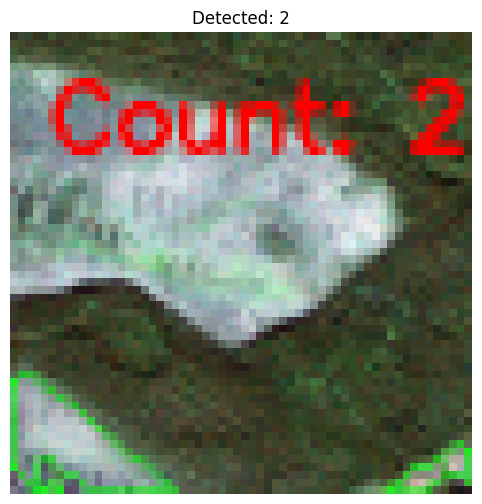

[478/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


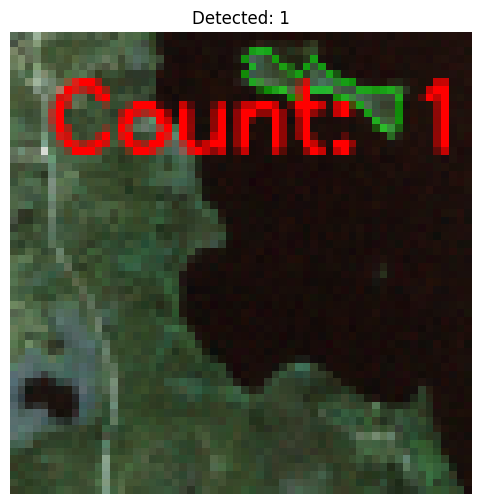

[479/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


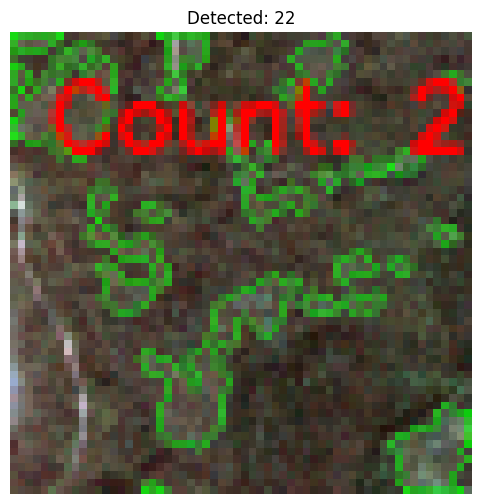

[480/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


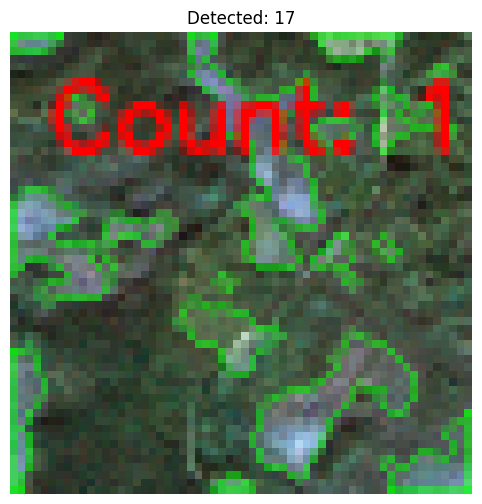

[481/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


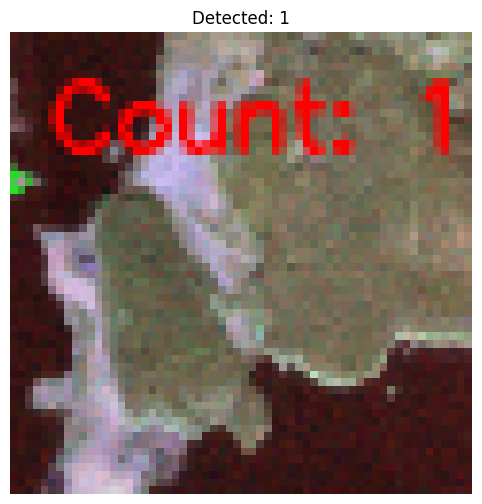

[482/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


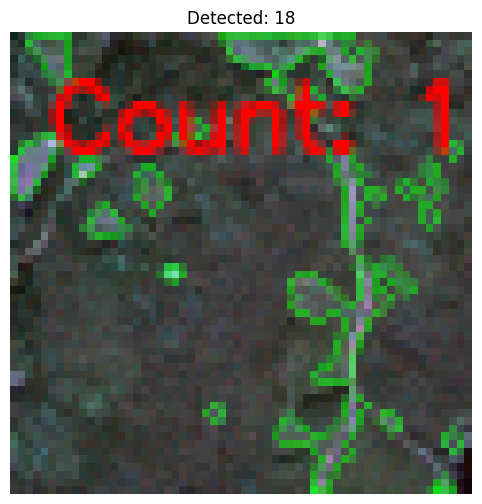

[483/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


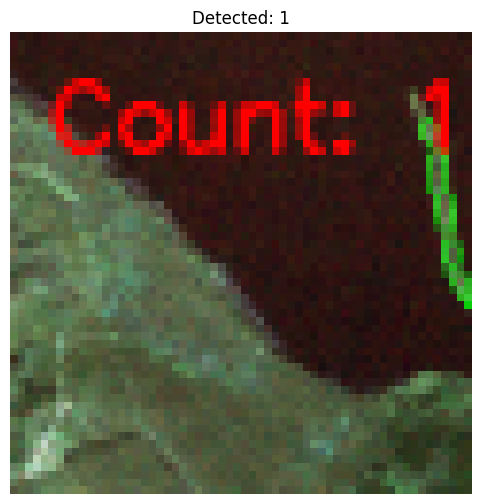

[484/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


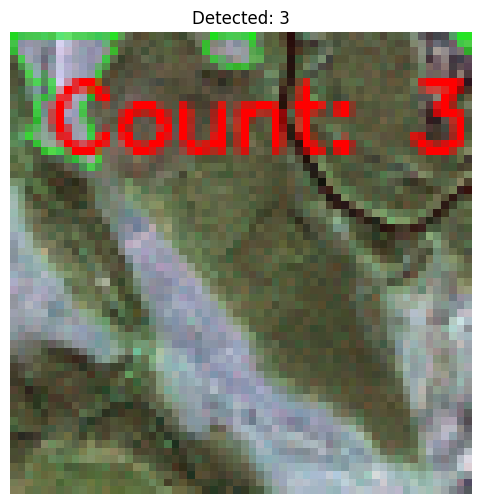

[485/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


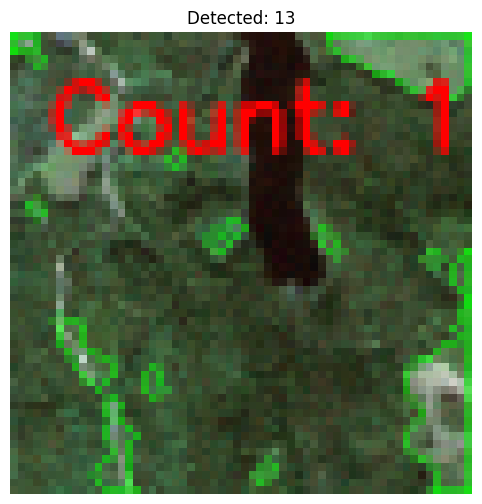

[486/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


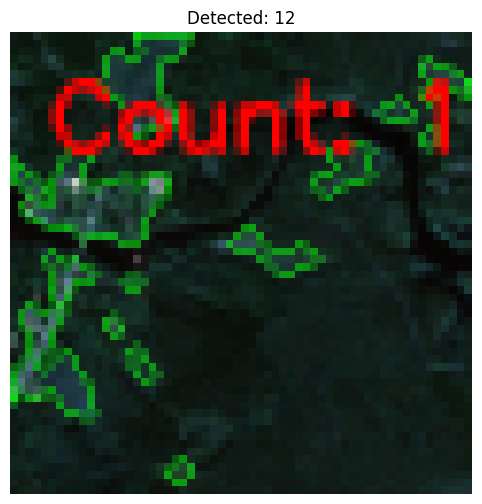

[487/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


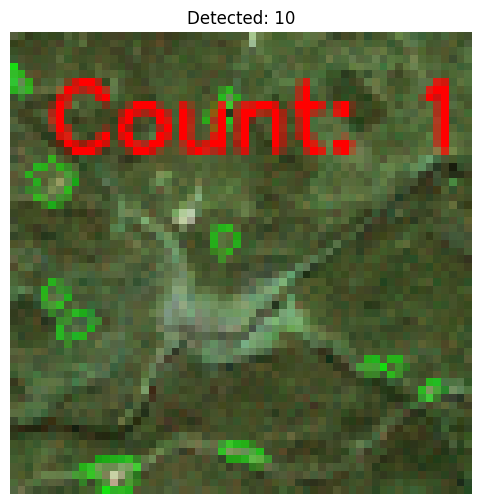

[488/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


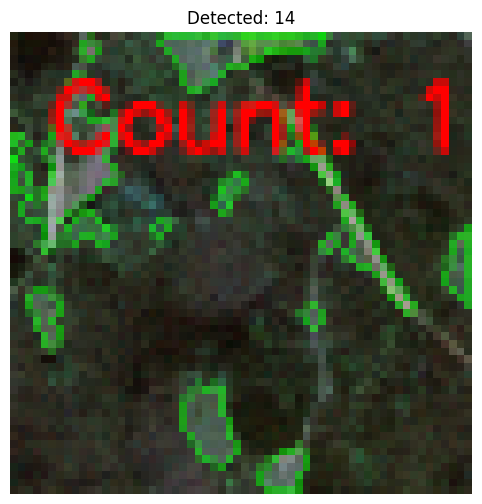

[489/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


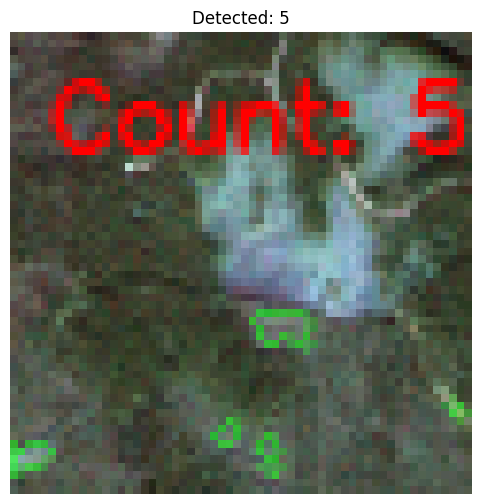

[490/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


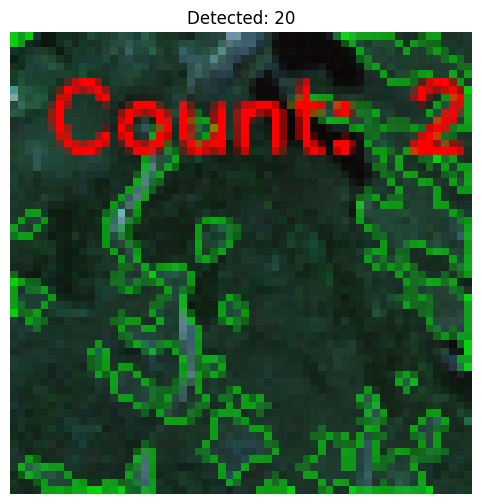

[491/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


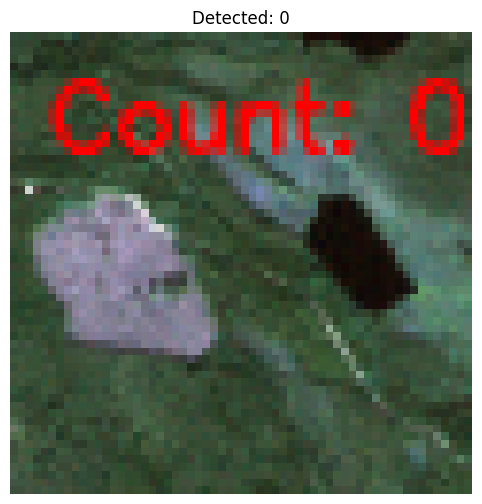

[492/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


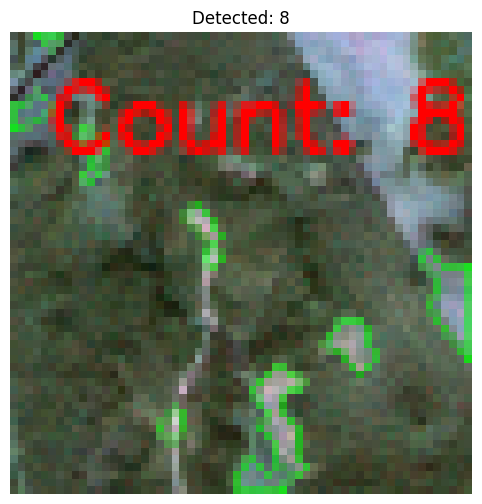

[493/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


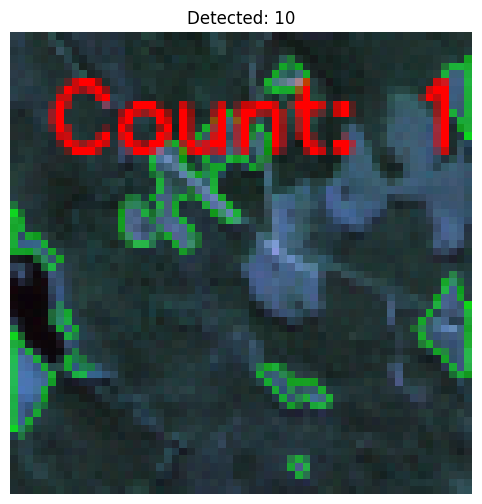

[494/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


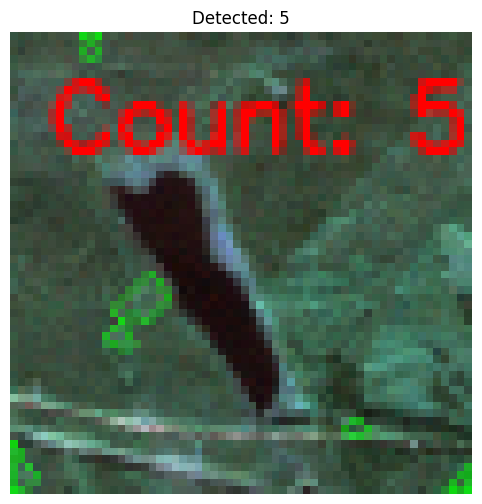

[495/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


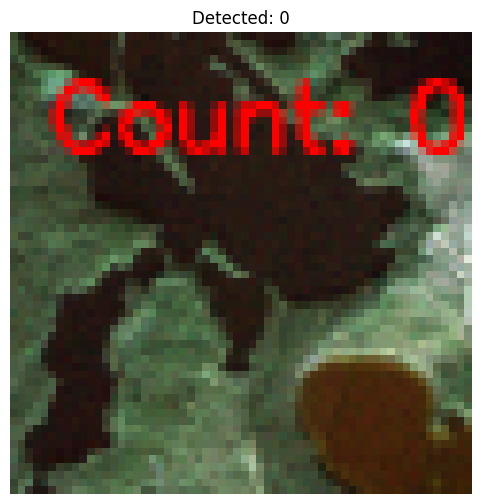

[496/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


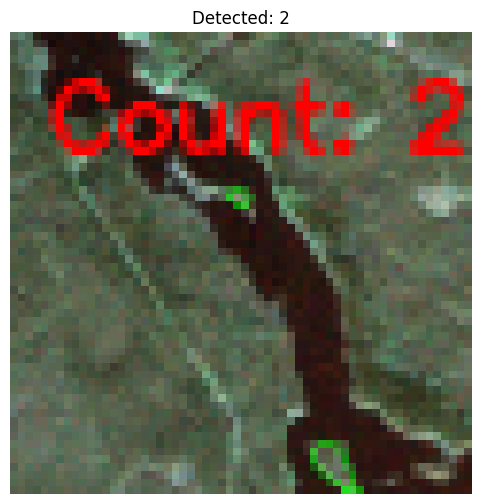

[497/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


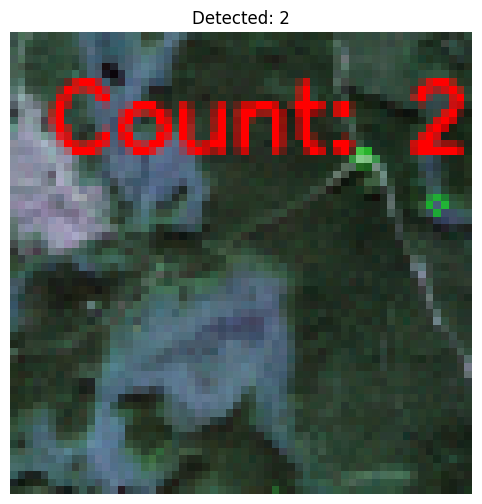

[498/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


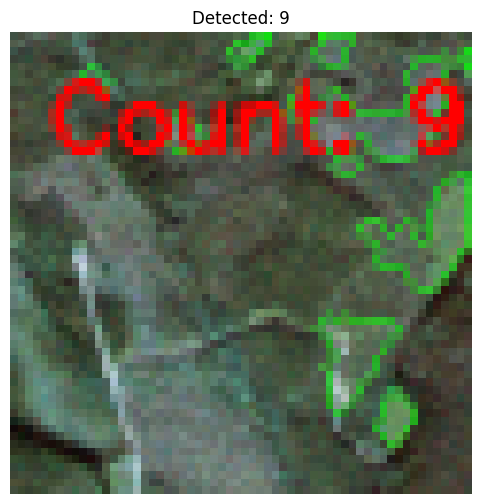

[499/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


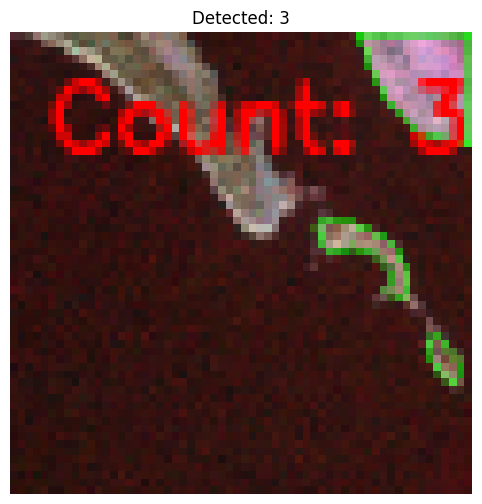

[500/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


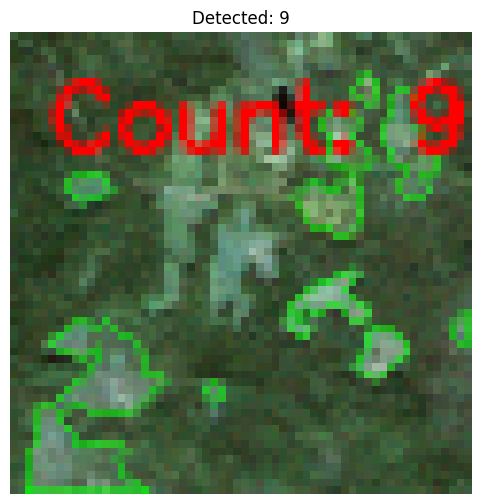

[501/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


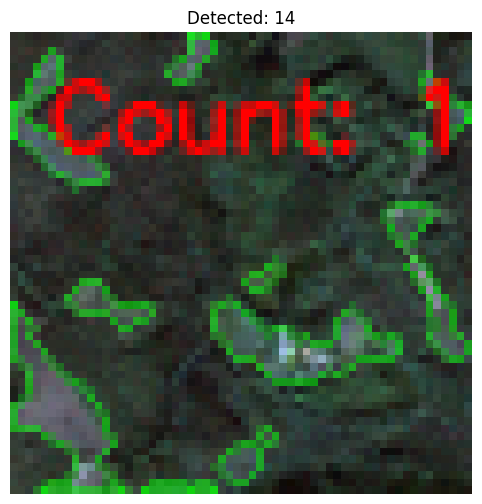

[502/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


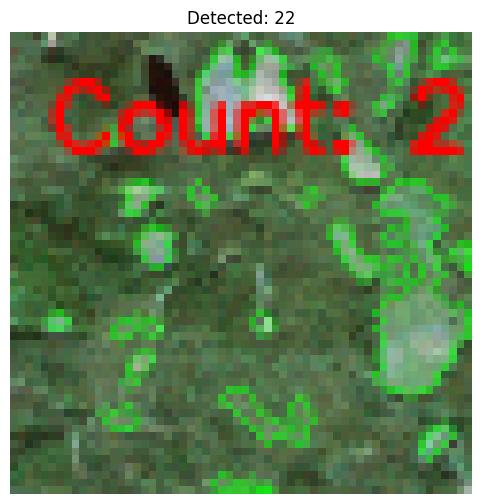

[503/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


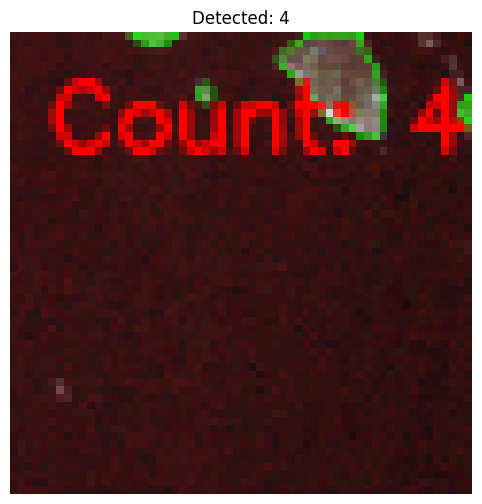

[504/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


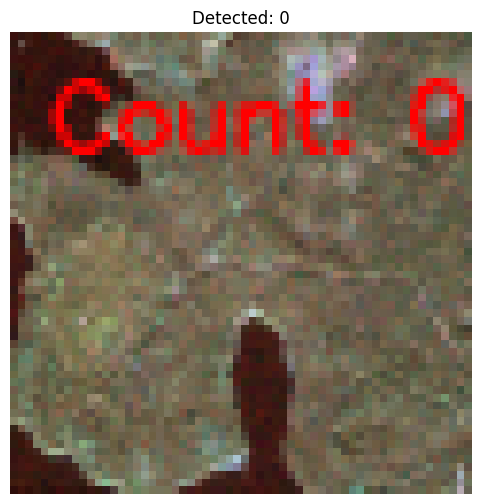

[505/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


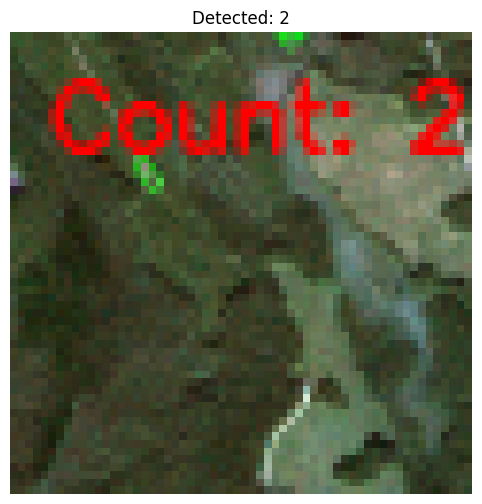

[506/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


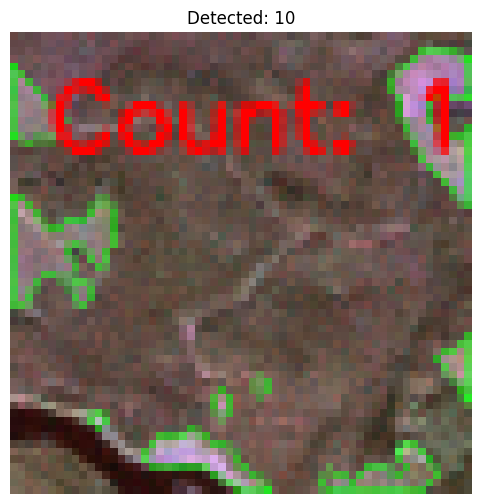

[507/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


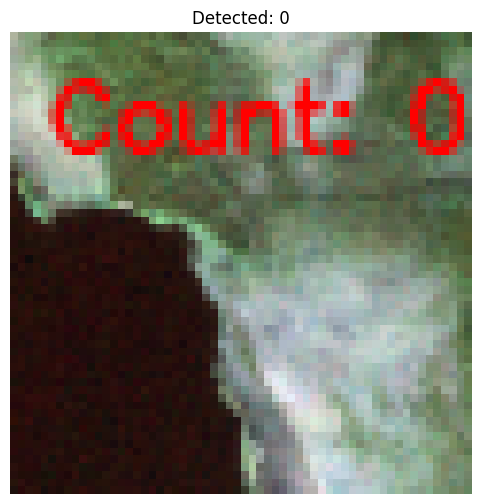

[508/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


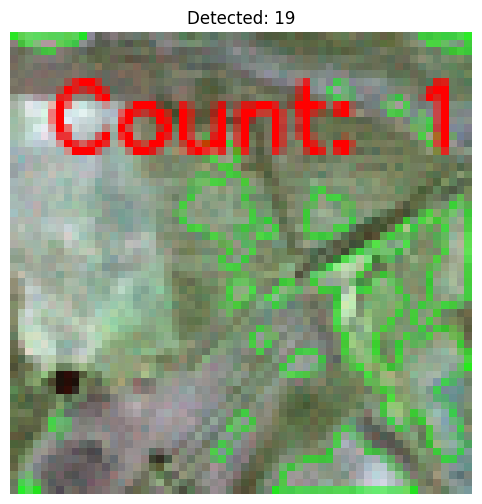

[509/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


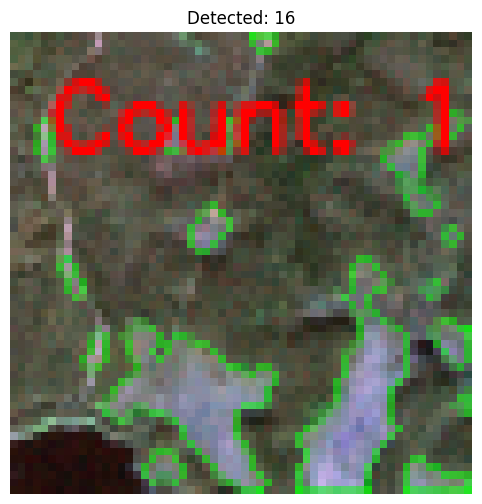

[510/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


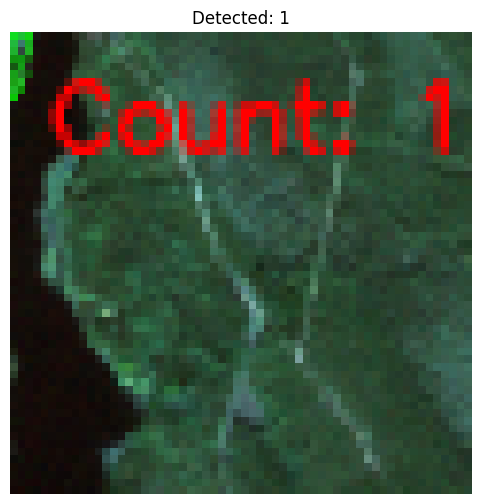

[511/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


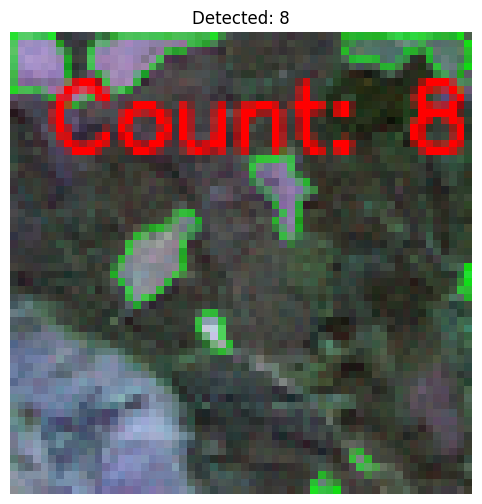

[512/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


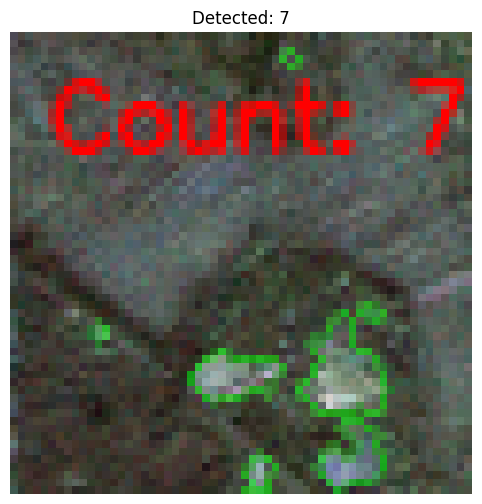

[513/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


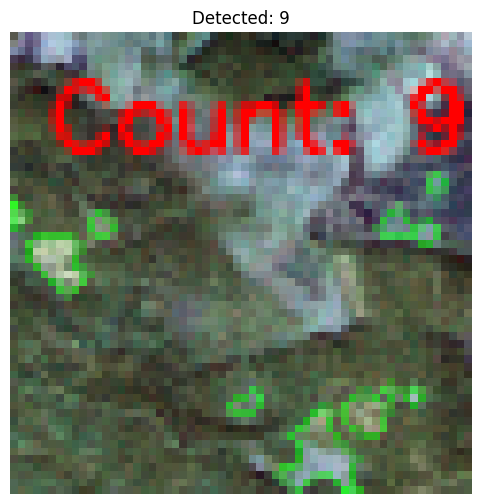

[514/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


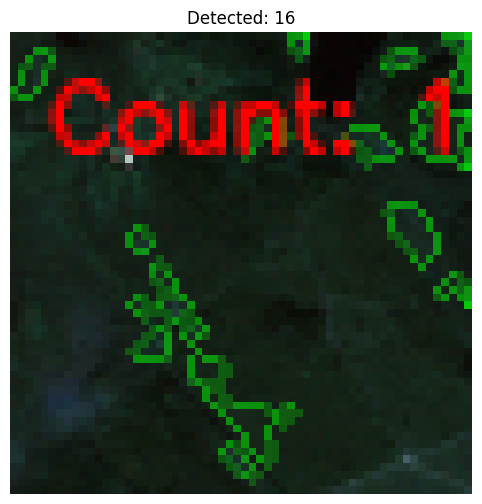

[515/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


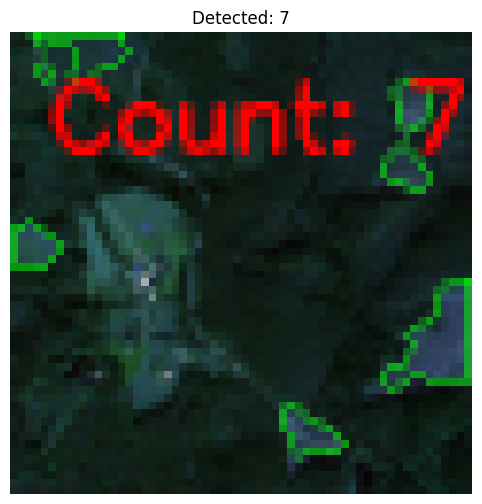

[516/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


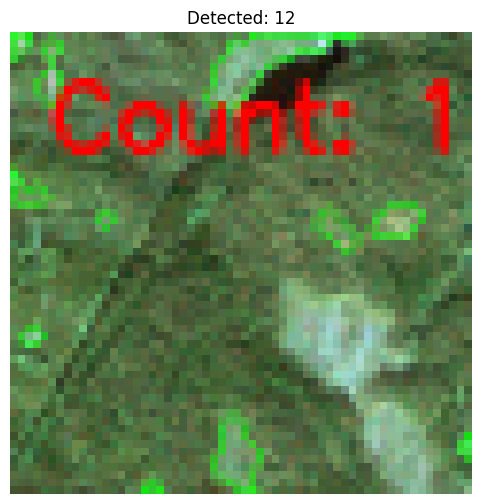

[517/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


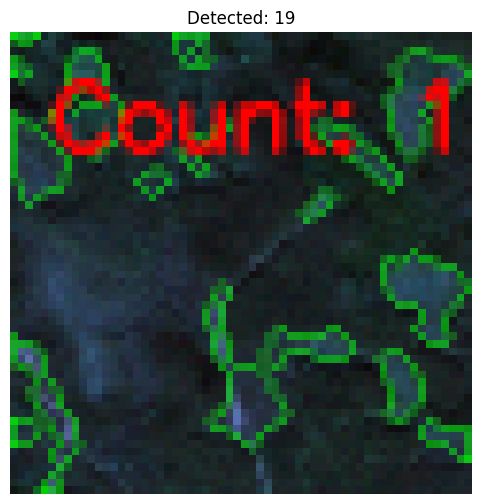

[518/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


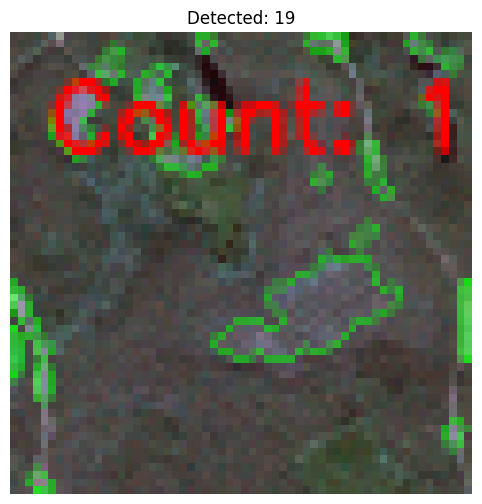

[519/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


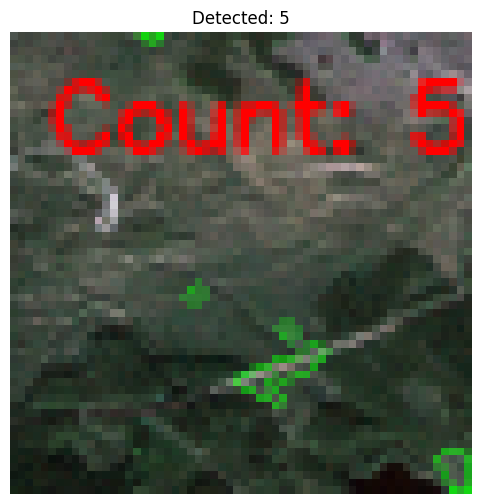

[520/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


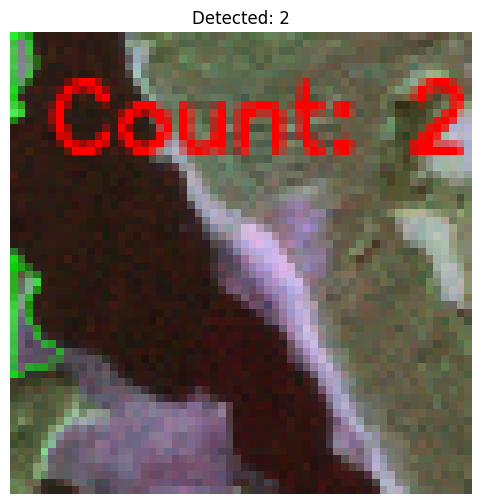

[521/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


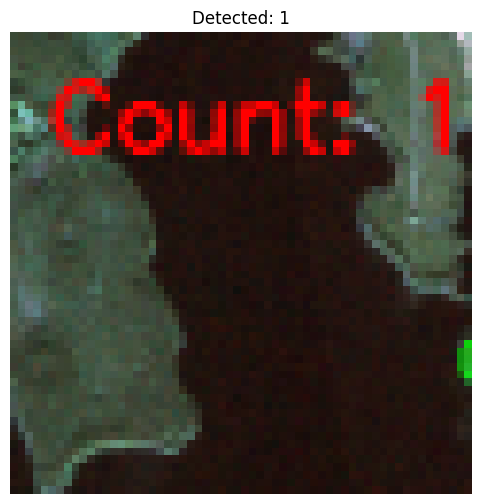

[522/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


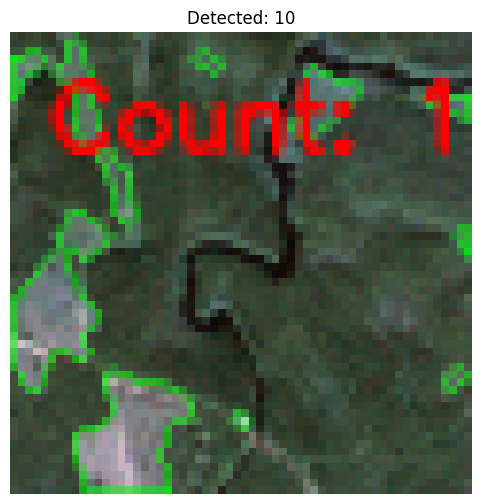

[523/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


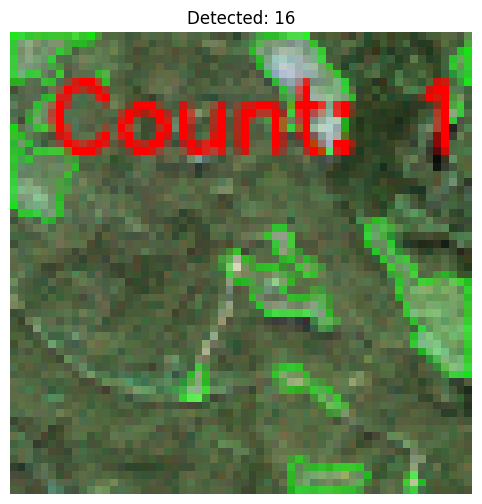

[524/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


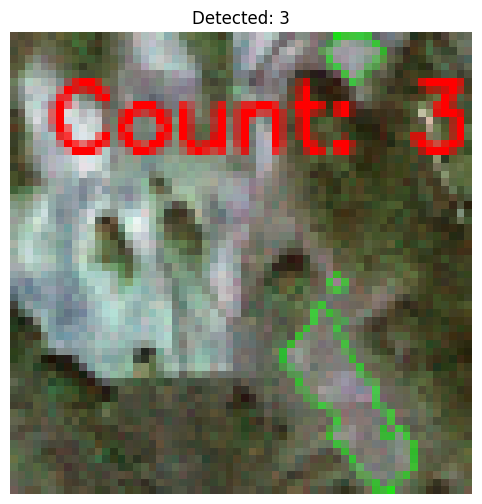

[525/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


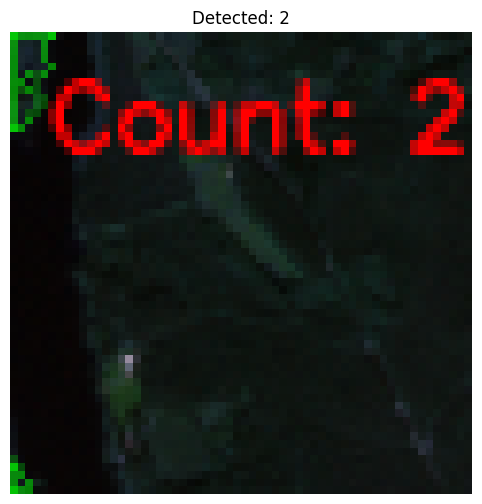

[526/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


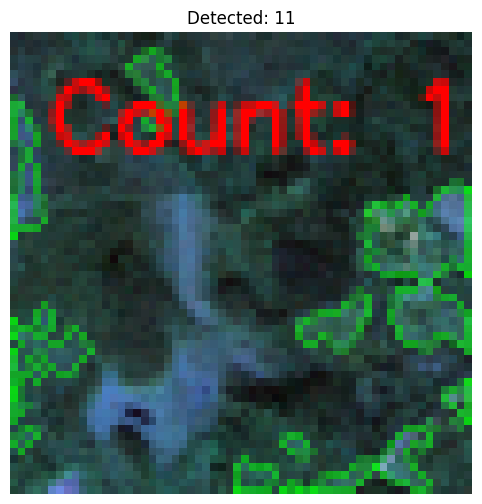

[527/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


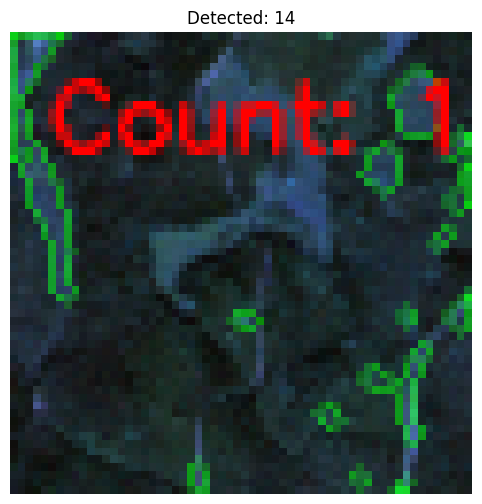

[528/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


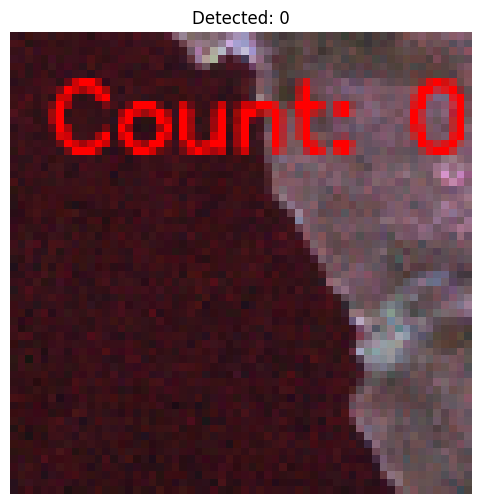

[529/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


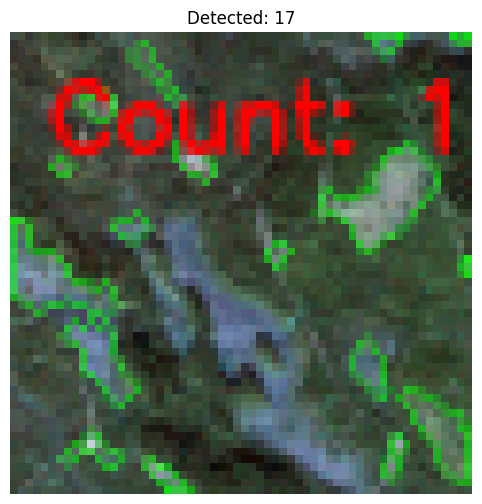

[530/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


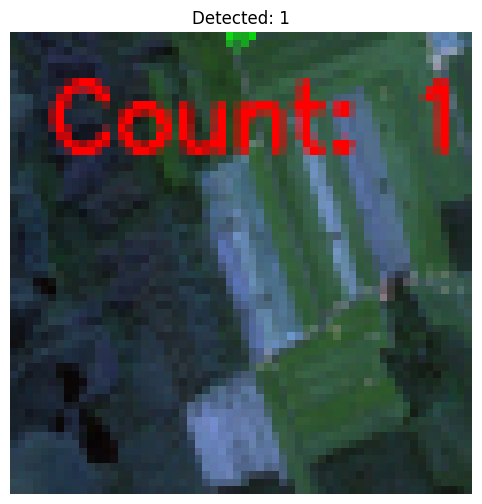

[531/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


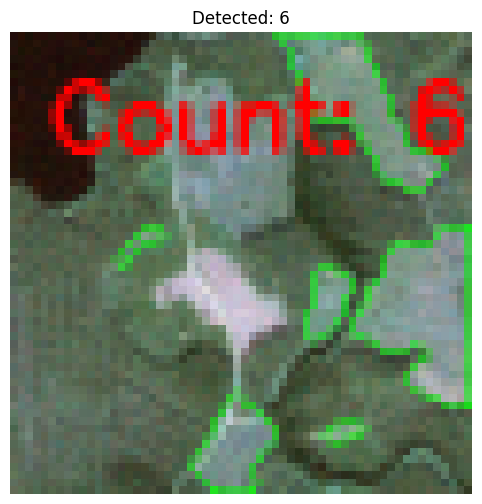

[532/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


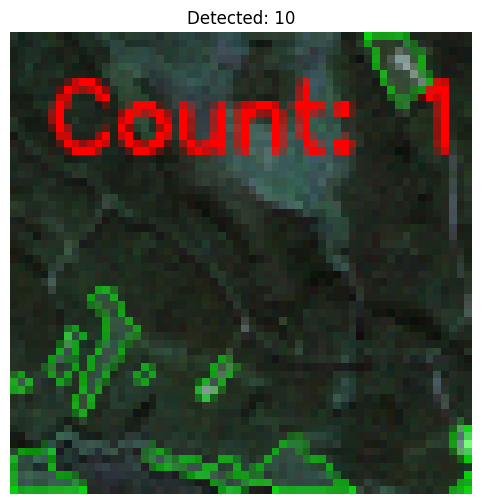

[533/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


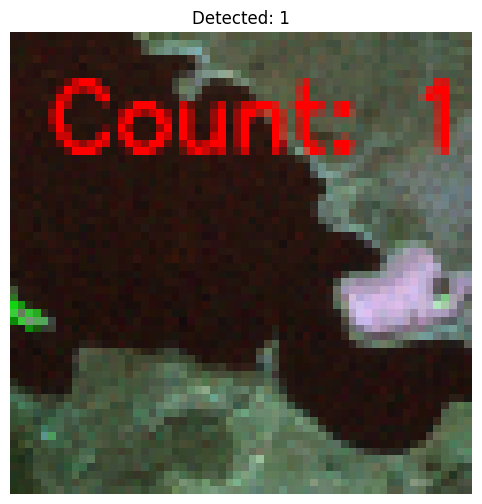

[534/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


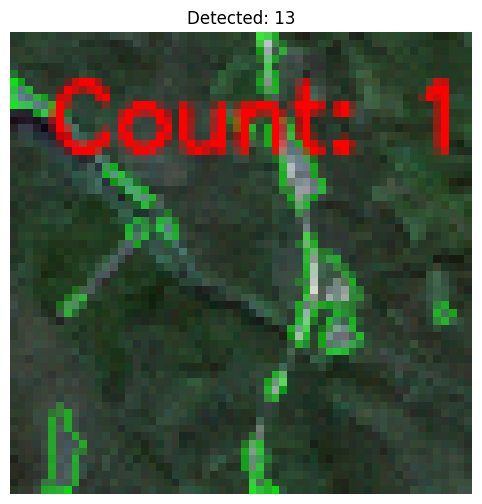

[535/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


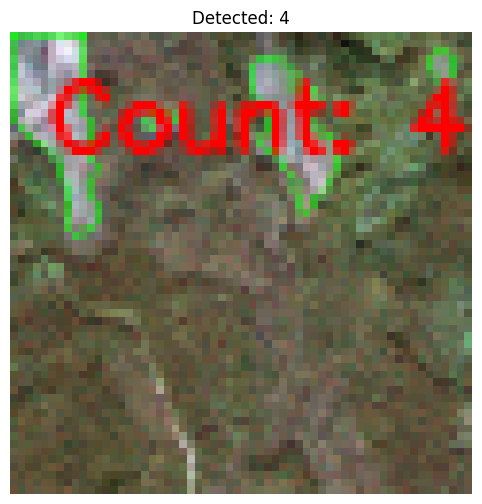

[536/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


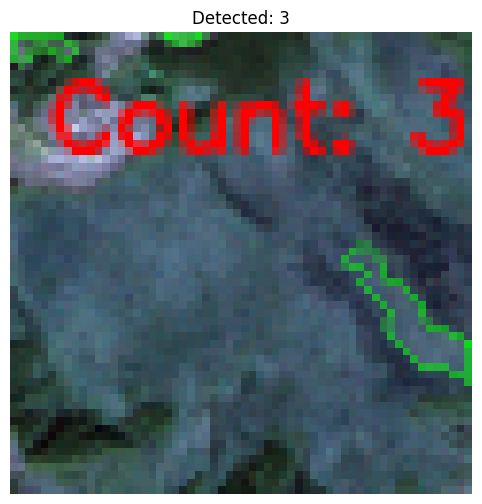

[537/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


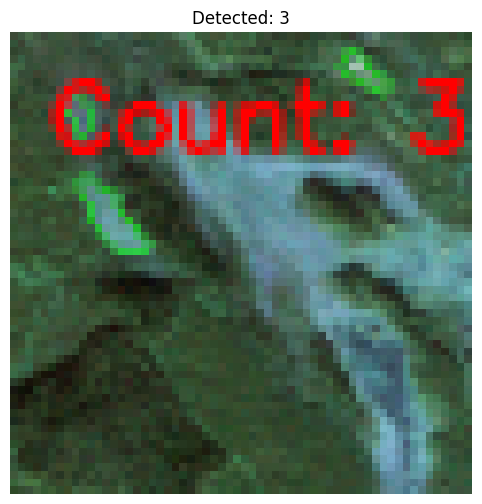

[538/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


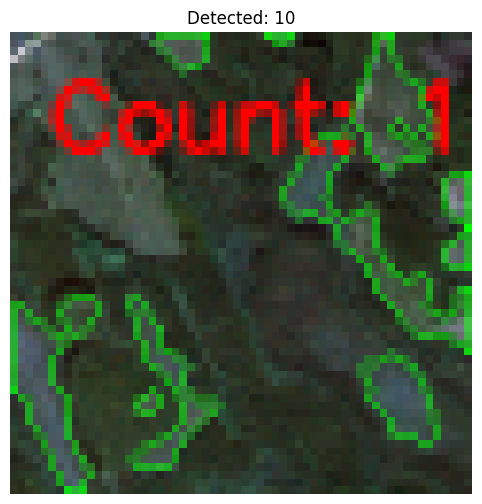

[539/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


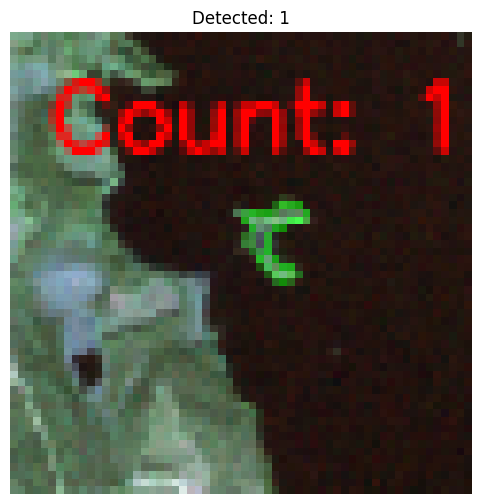

[540/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


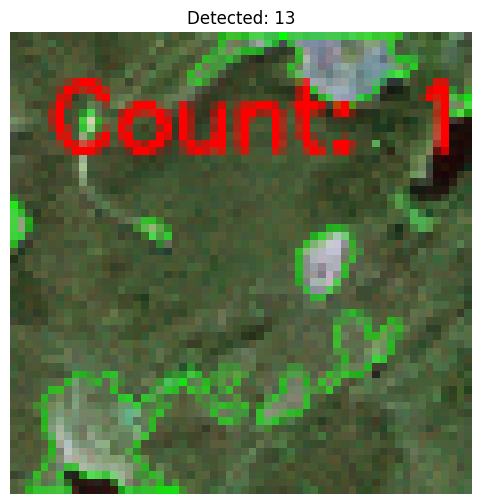

[541/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


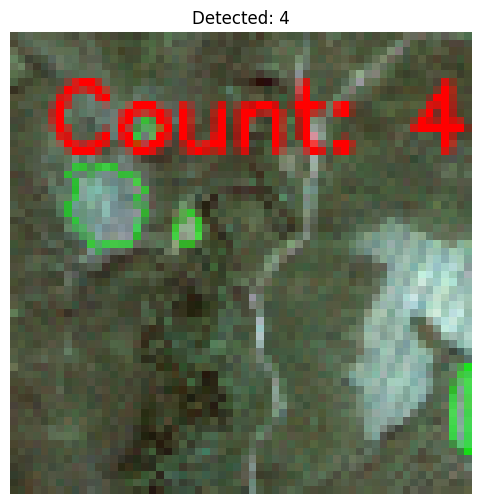

[542/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


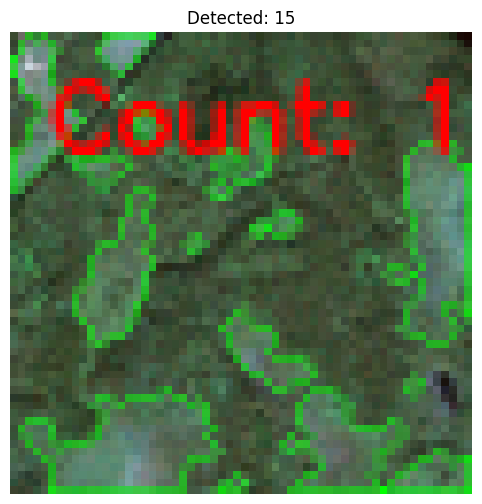

[543/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


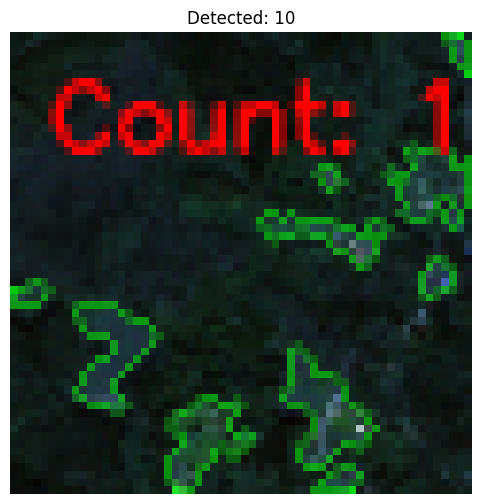

[544/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


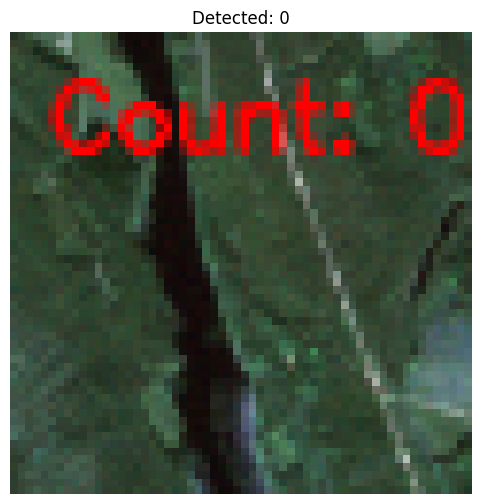

[545/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


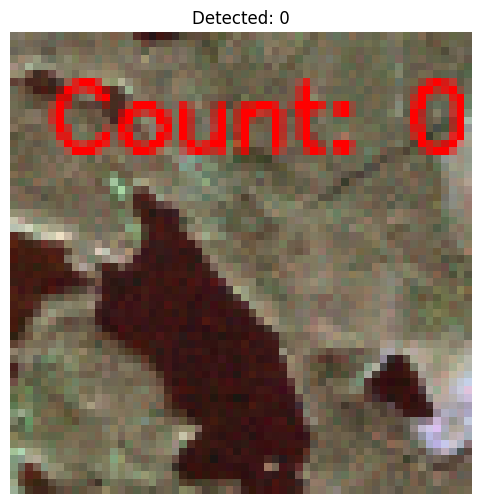

[546/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


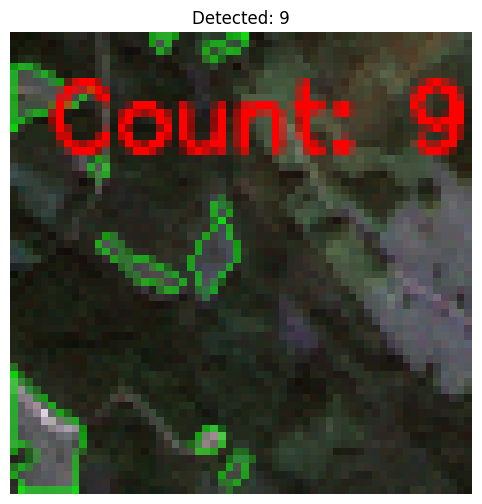

[547/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


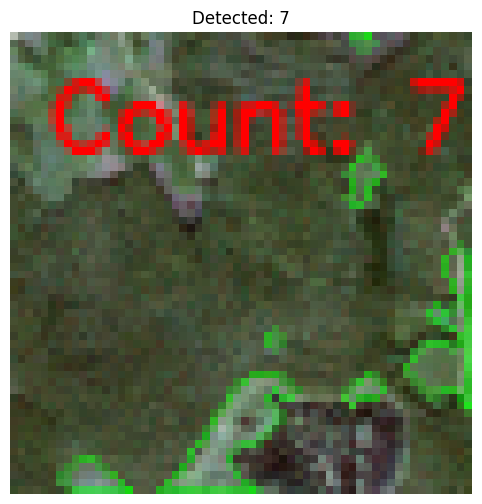

[548/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


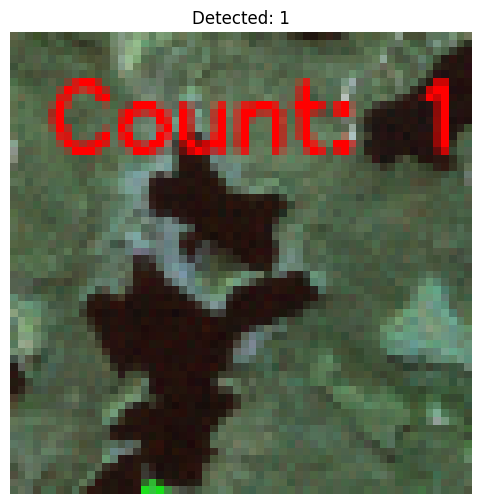

[549/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


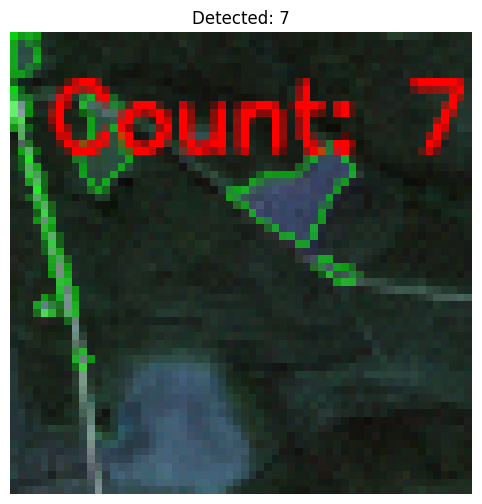

[550/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


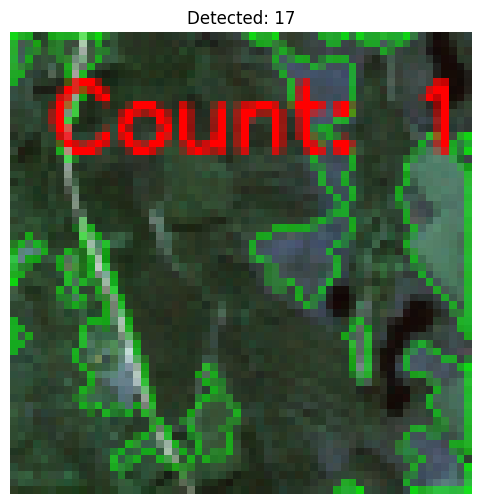

[551/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


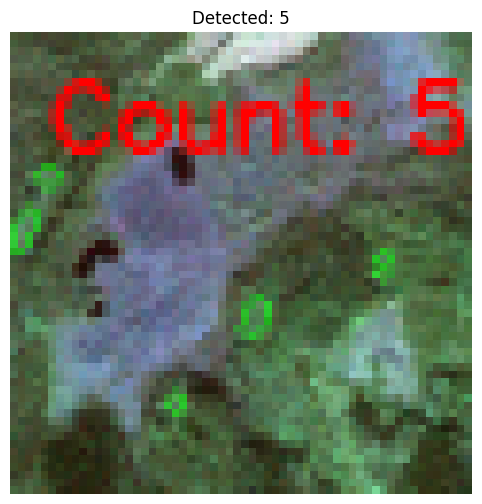

[552/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


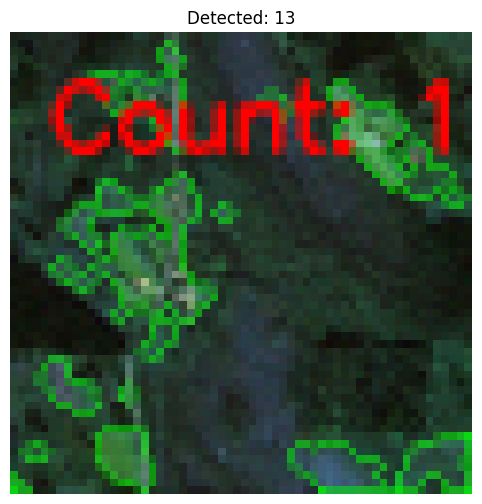

[553/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


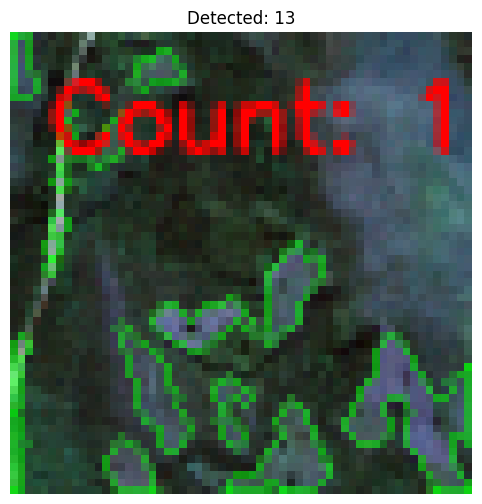

[554/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


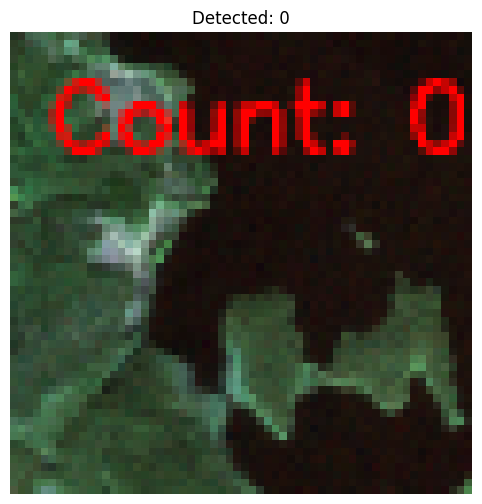

[555/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


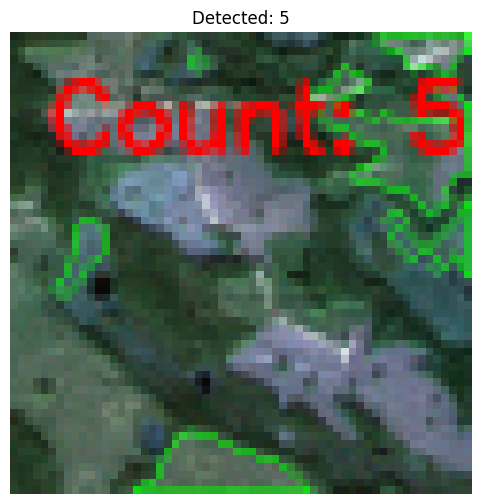

[556/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


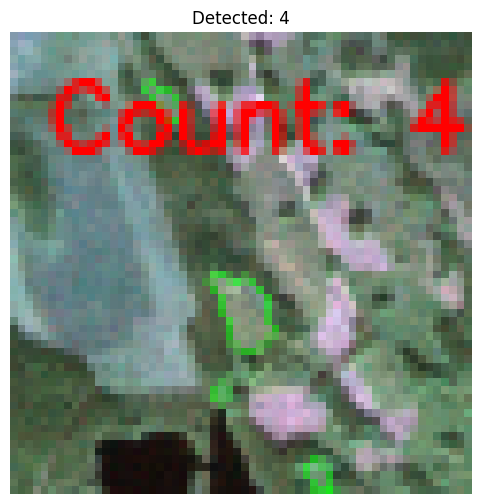

[557/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


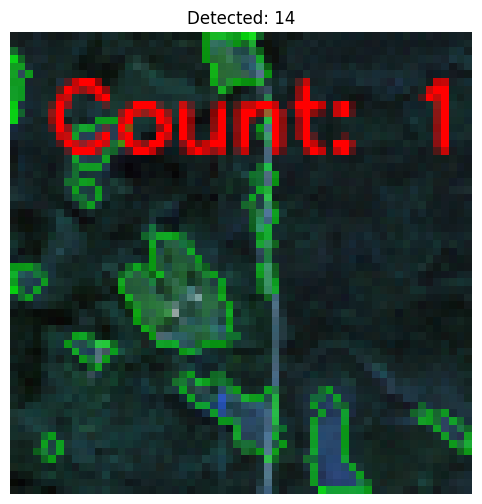

[558/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


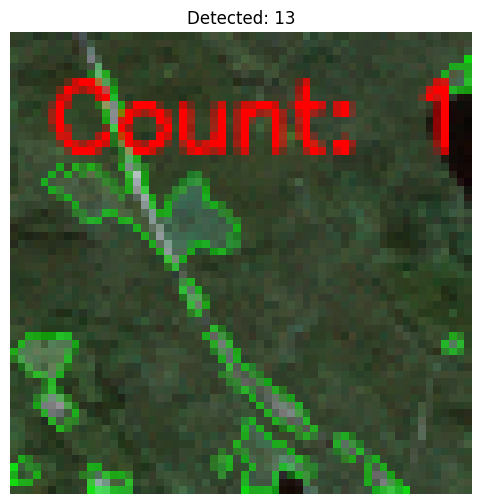

[559/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


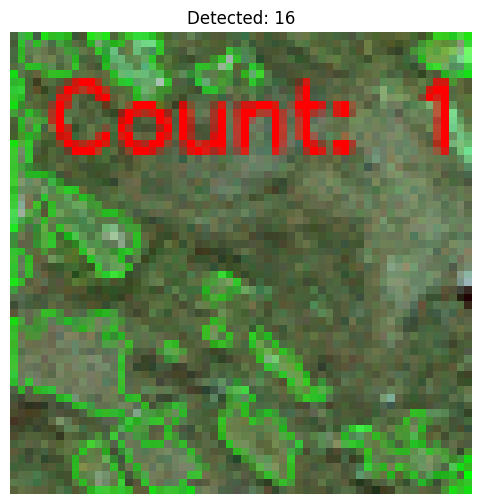

[560/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


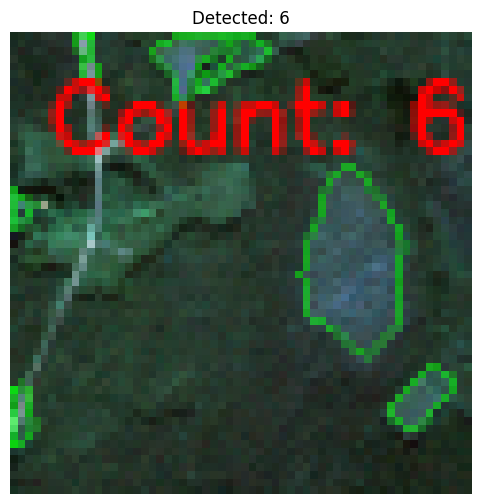

[561/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


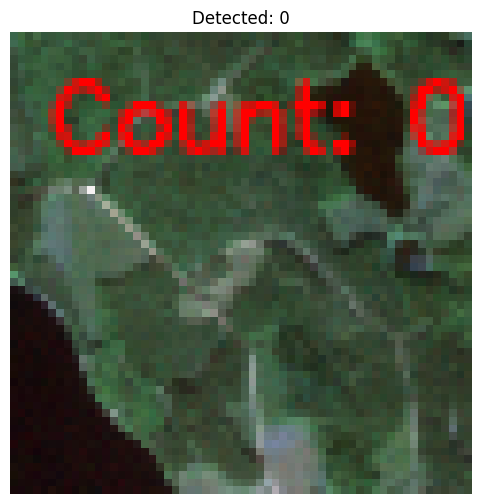

[562/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


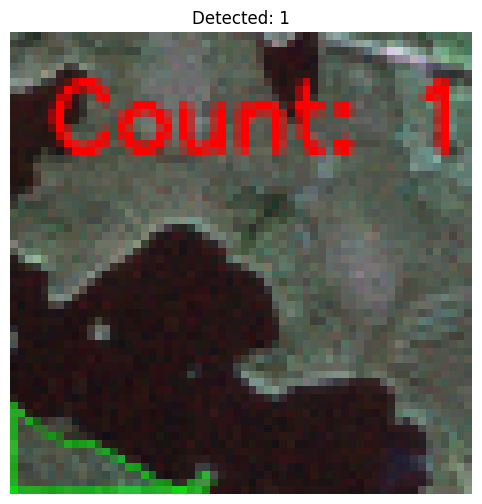

[563/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


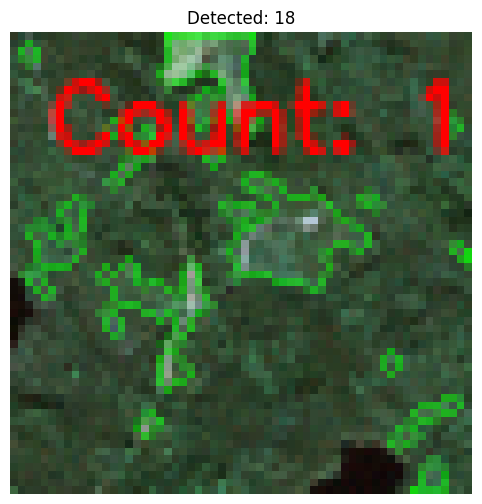

[564/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


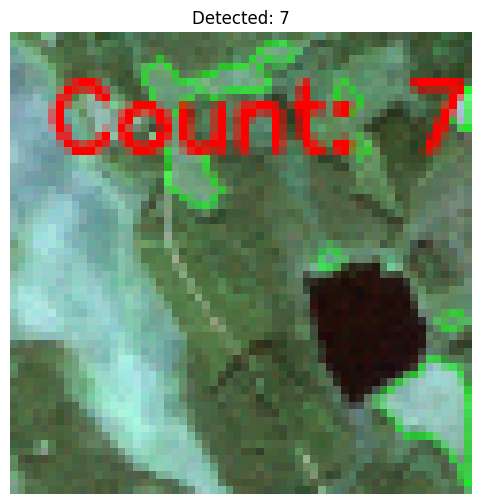

[565/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


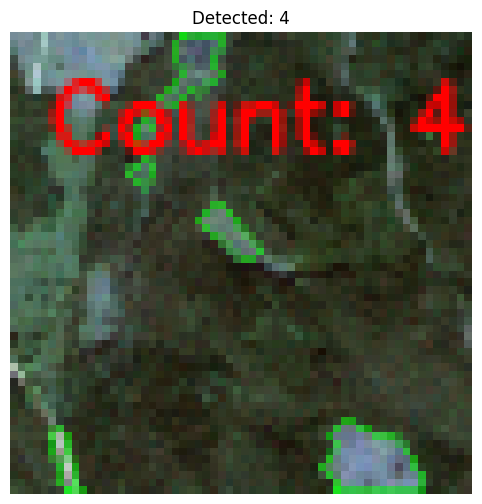

[566/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


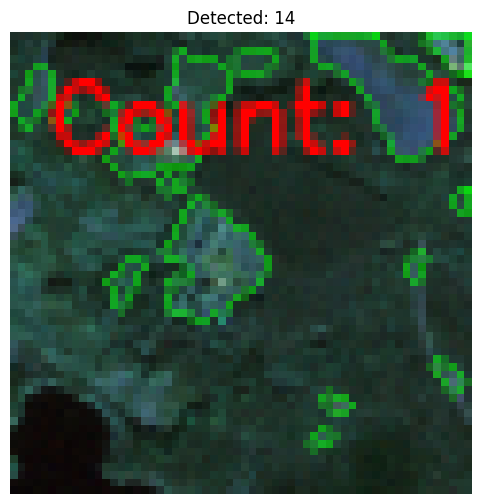

[567/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


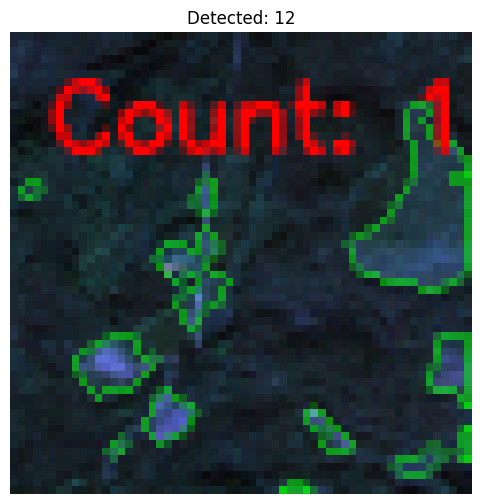

[568/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


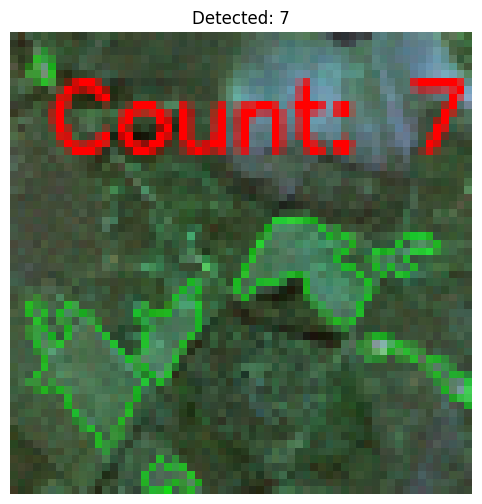

[569/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


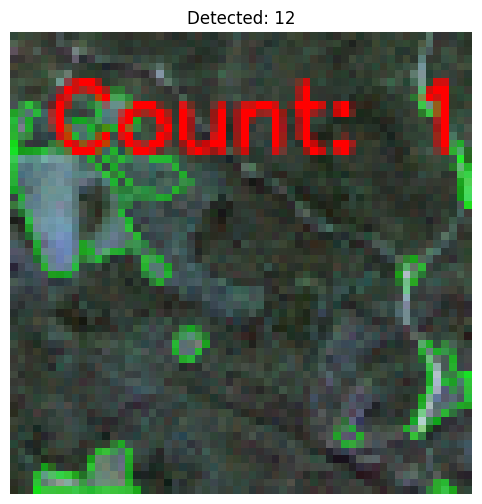

[570/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


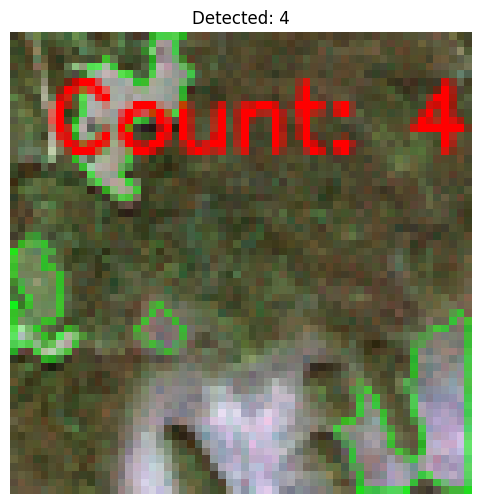

[571/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


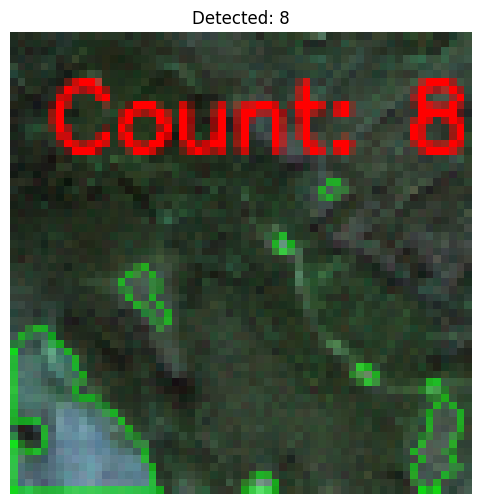

[572/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


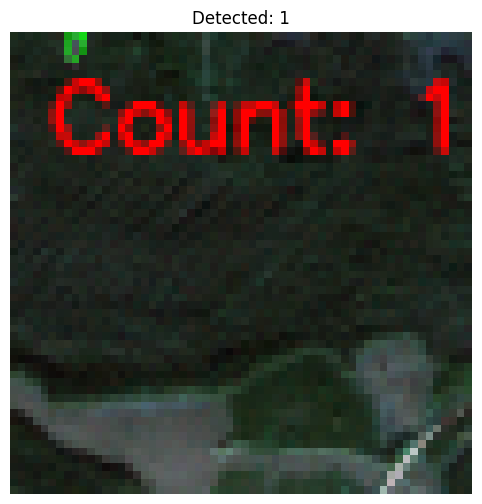

[573/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


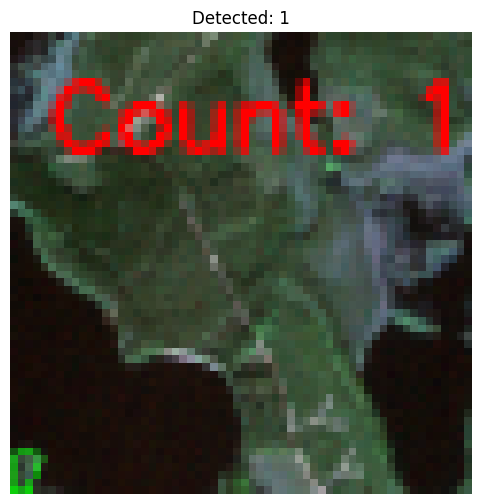

[574/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


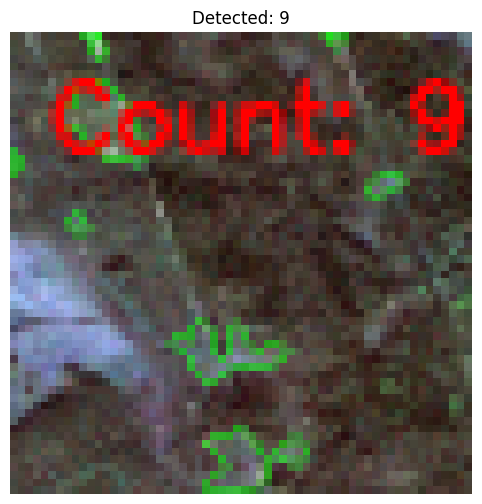

[575/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


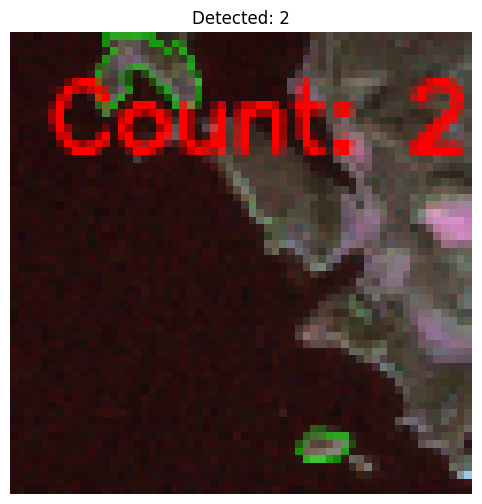

[576/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


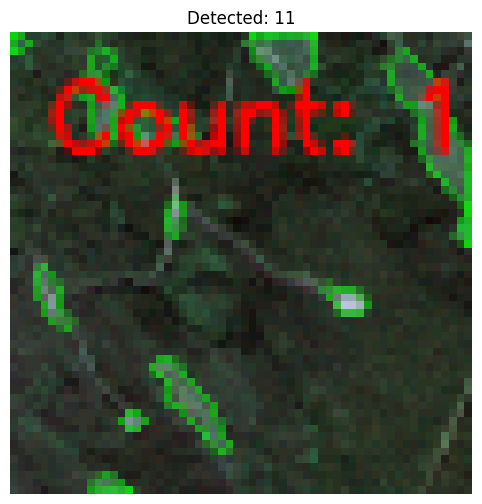

[577/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


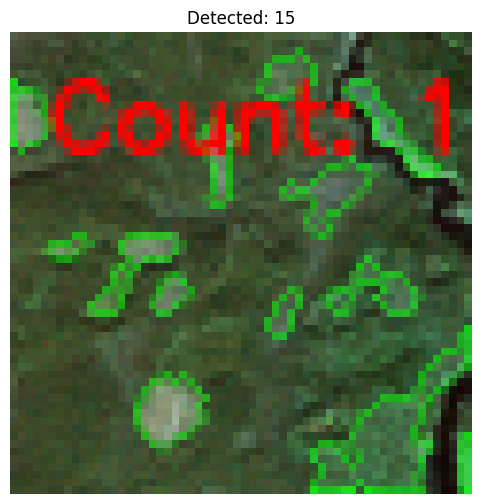

[578/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


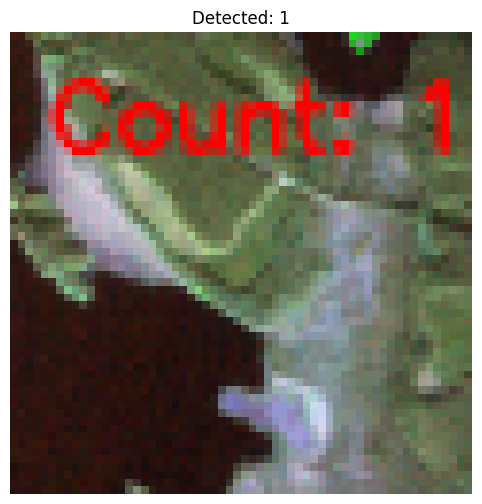

[579/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


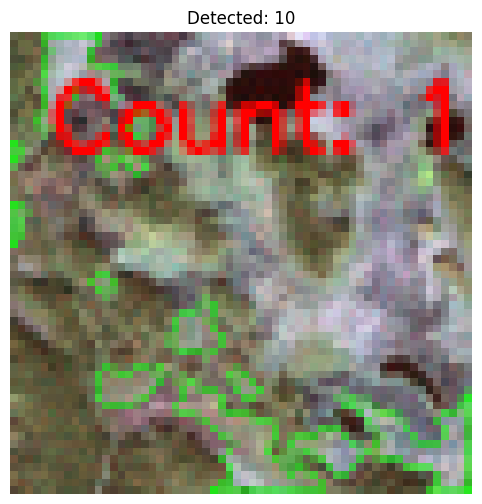

[580/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


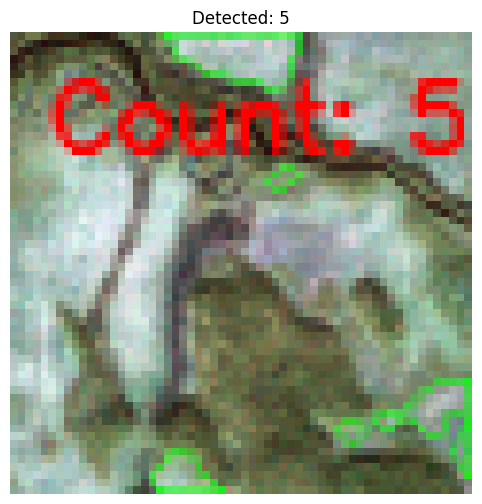

[581/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


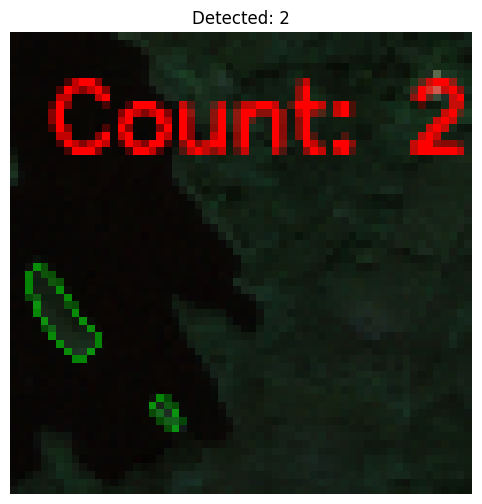

[582/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


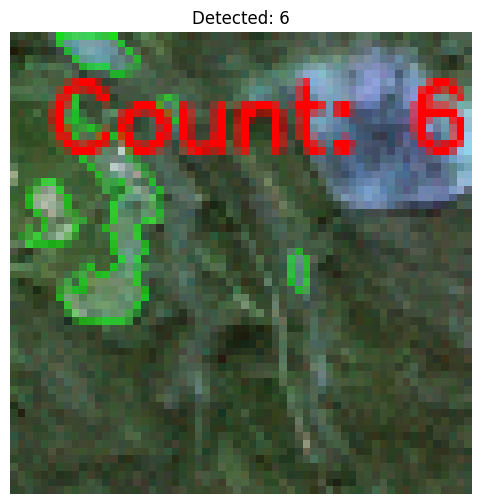

[583/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


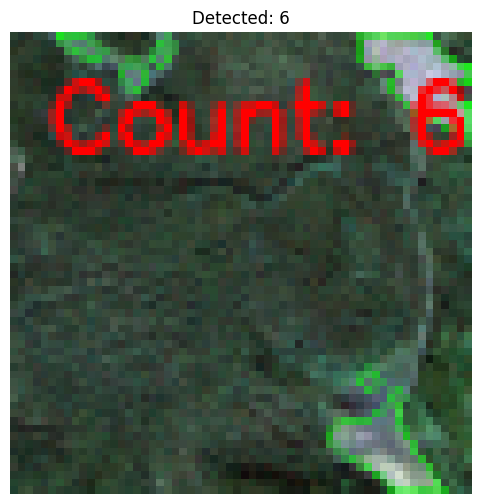

[584/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


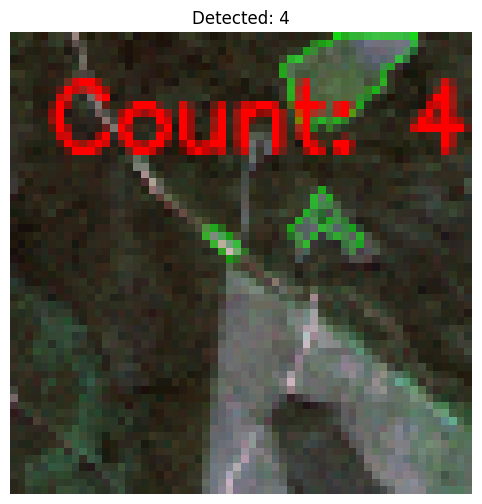

[585/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


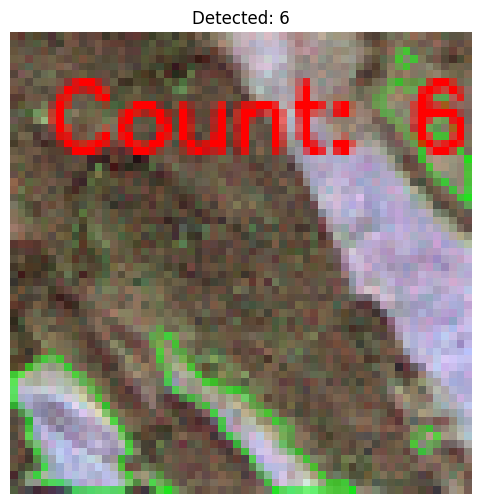

[586/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


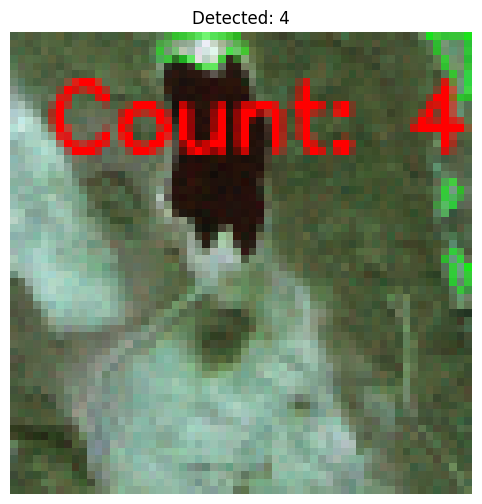

[587/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


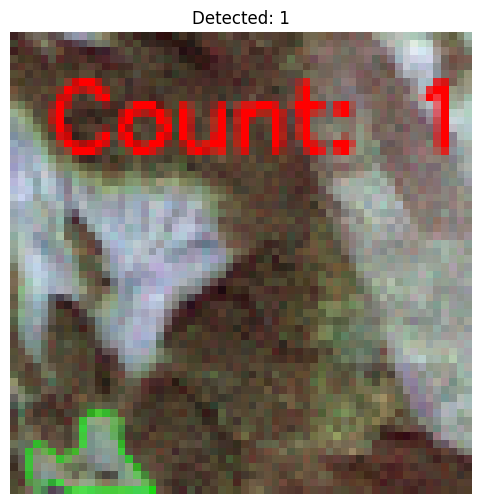

[588/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


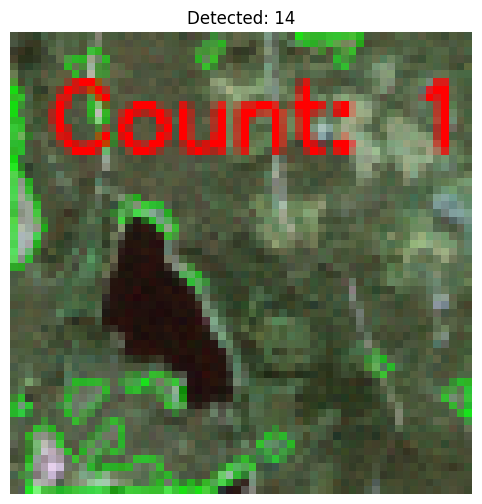

[589/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


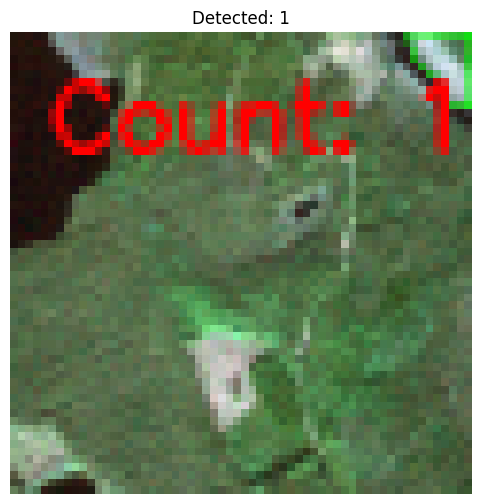

[590/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


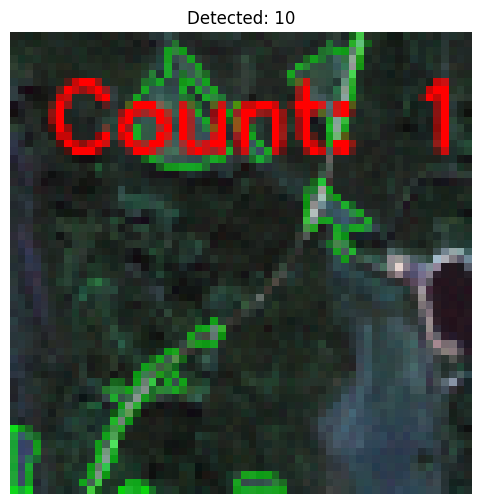

[591/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


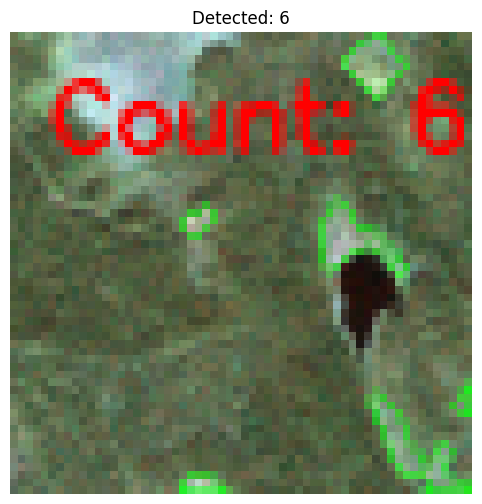

[592/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


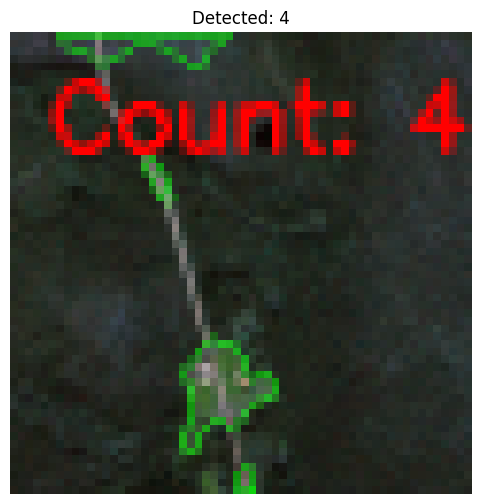

[593/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


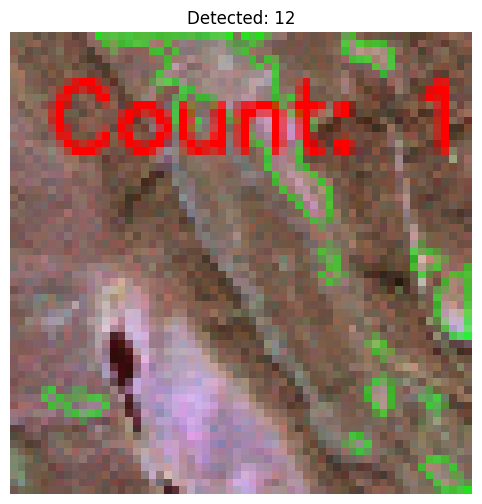

[594/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


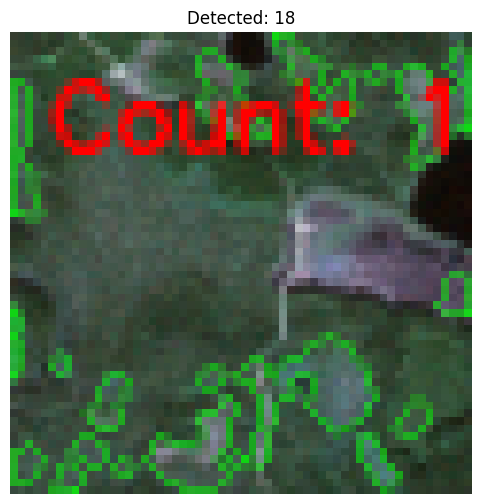

[595/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


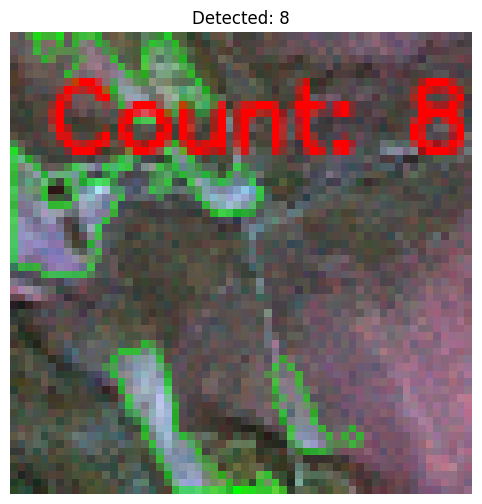

[596/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


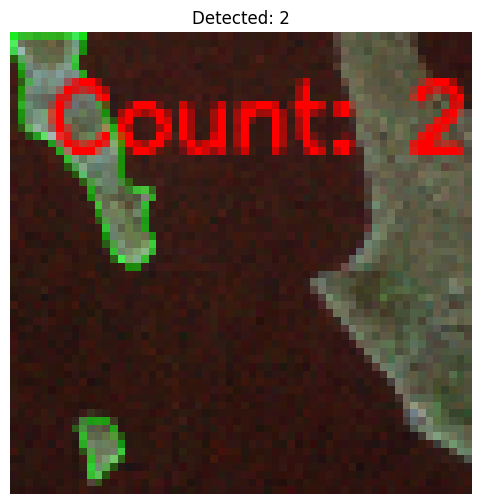

[597/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


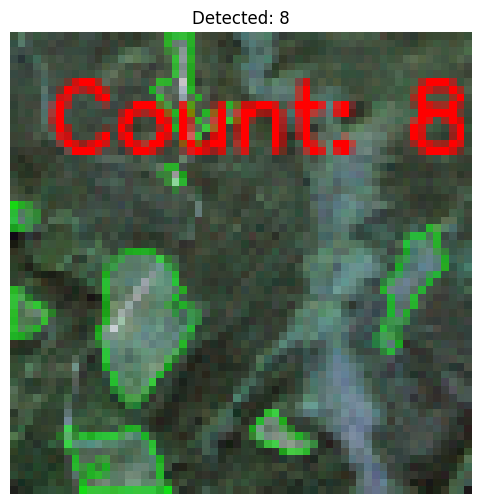

[598/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


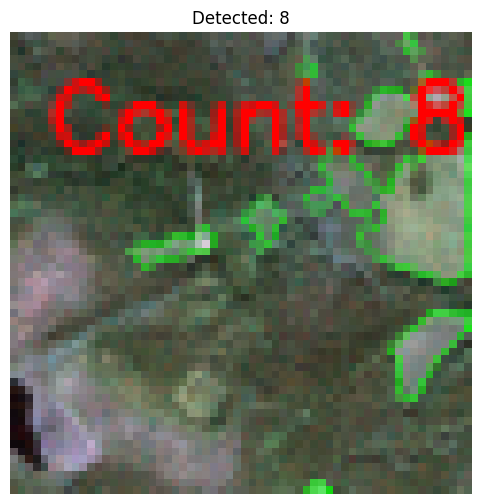

[599/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


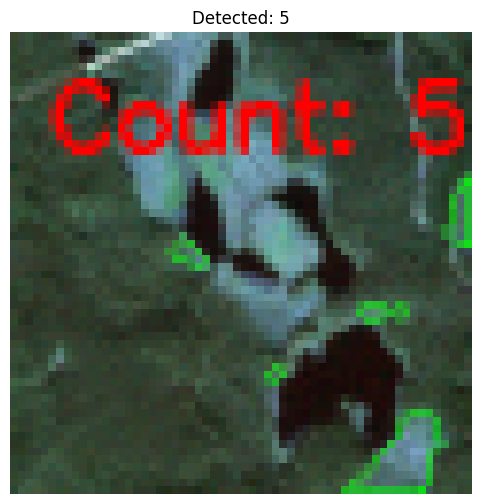

[600/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


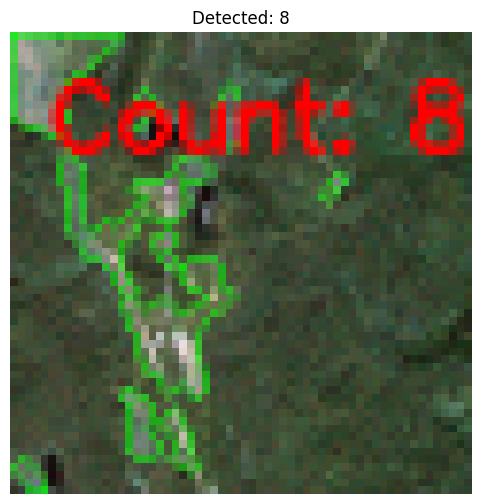

[601/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


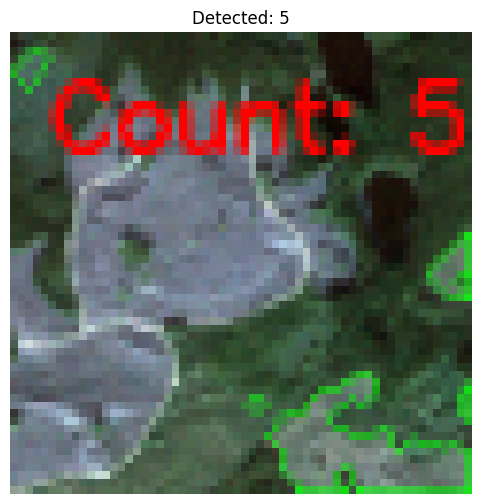

[602/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


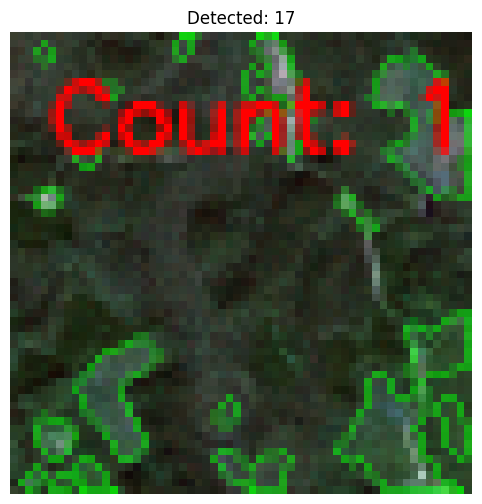

[603/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


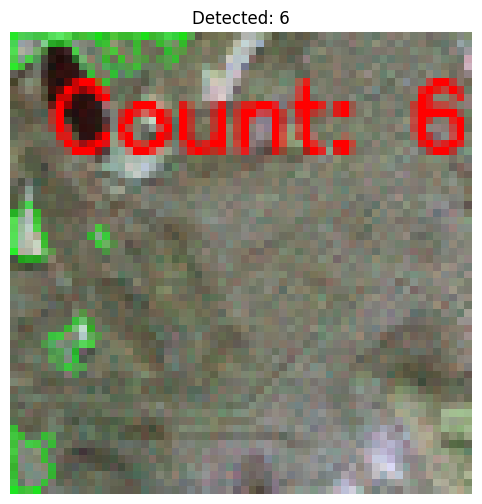

[604/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


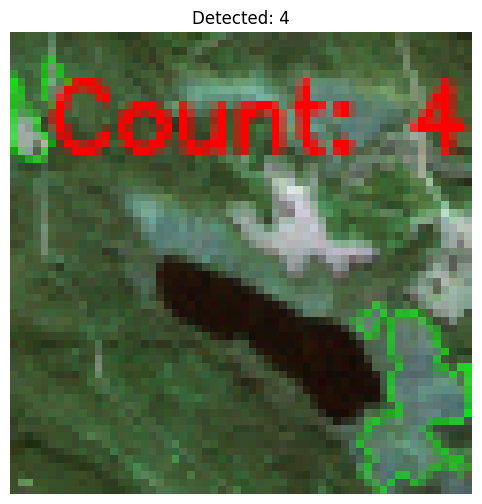

[605/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


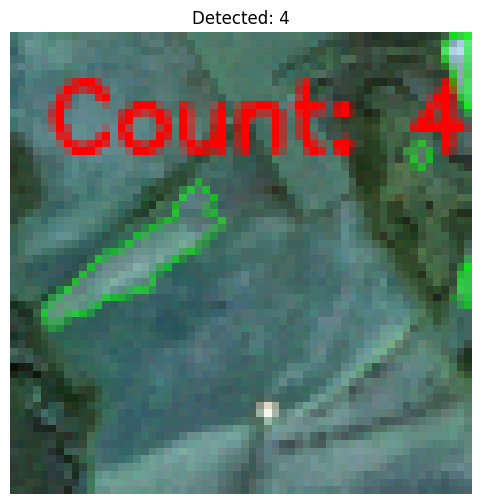

[606/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


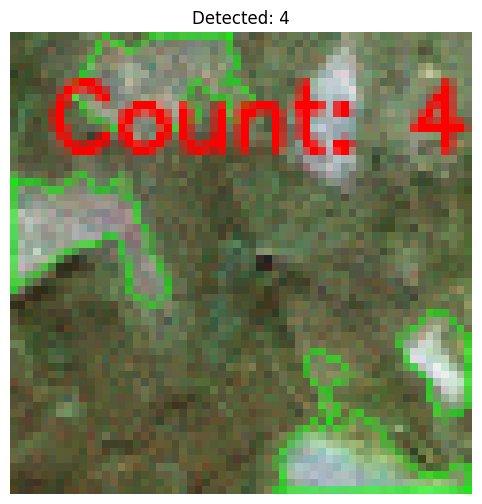

[607/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


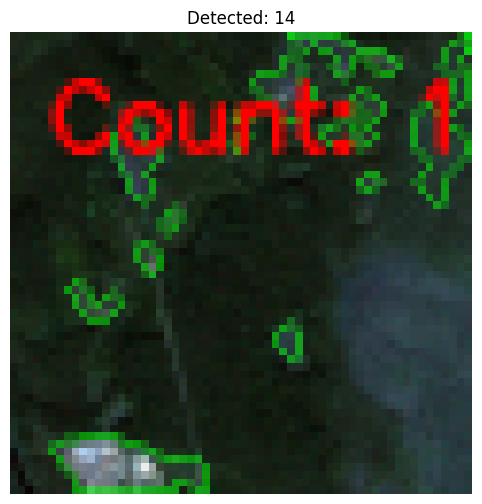

[608/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


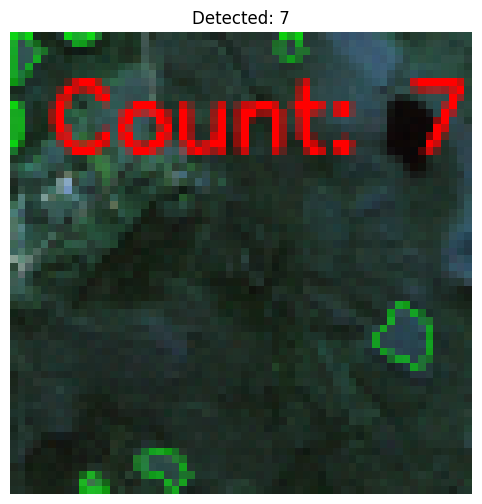

[609/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


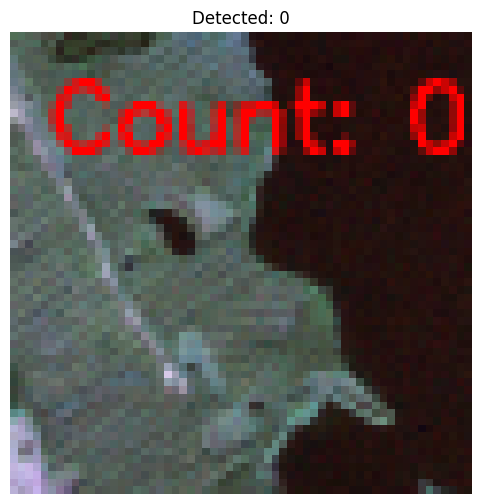

[610/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


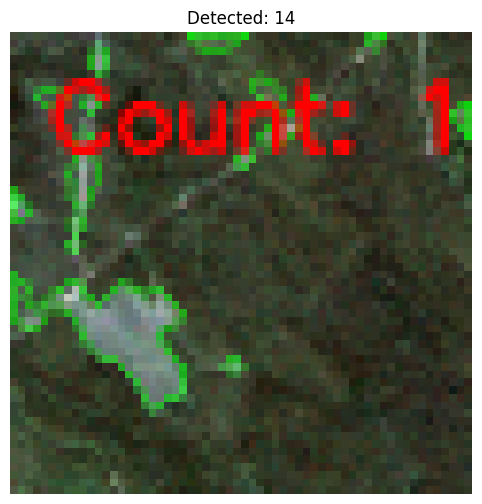

[611/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


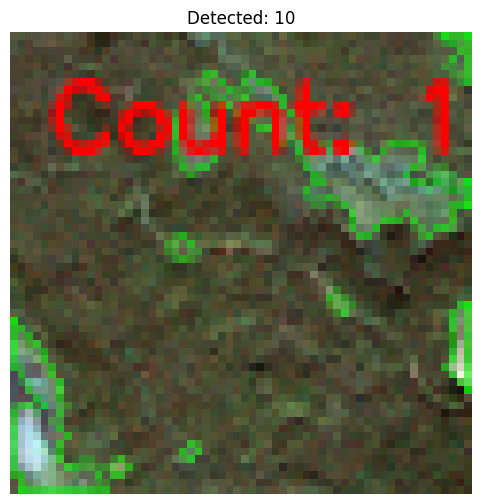

[612/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


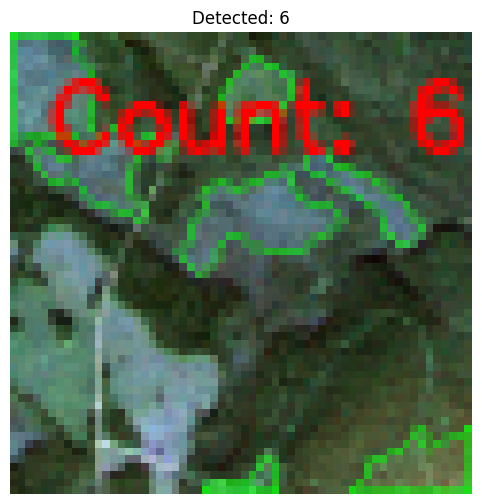

[613/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


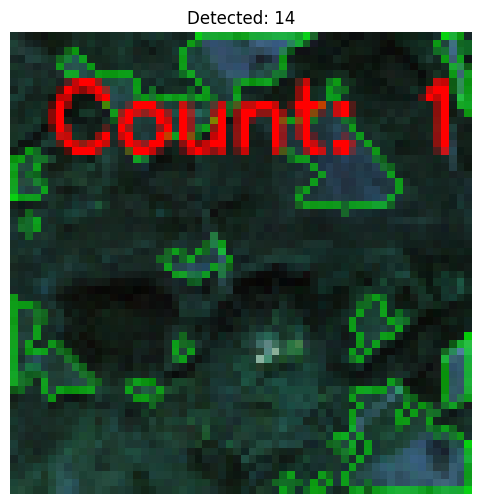

[614/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


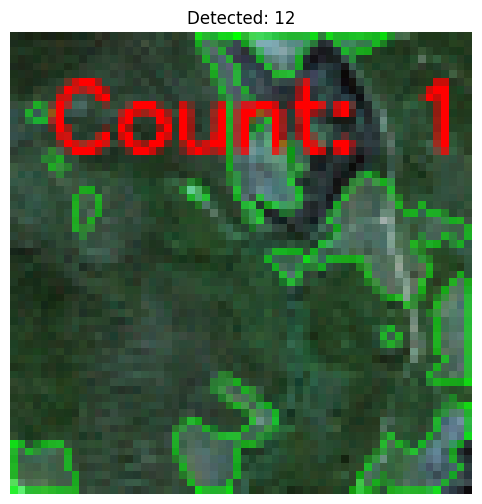

[615/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


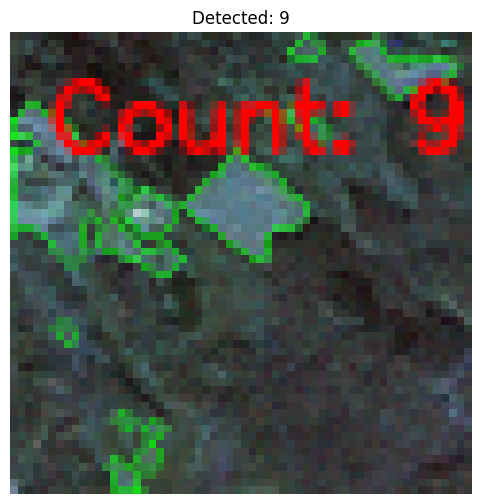

[616/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


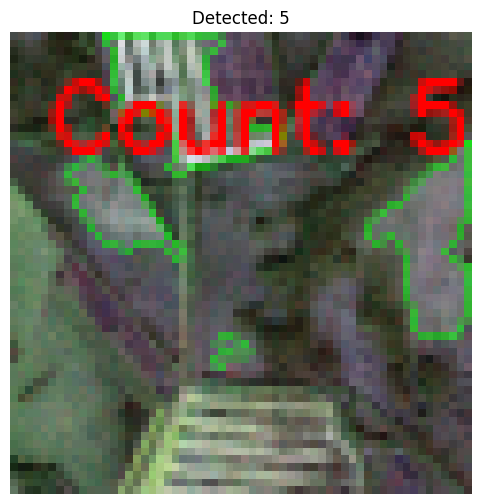

[617/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


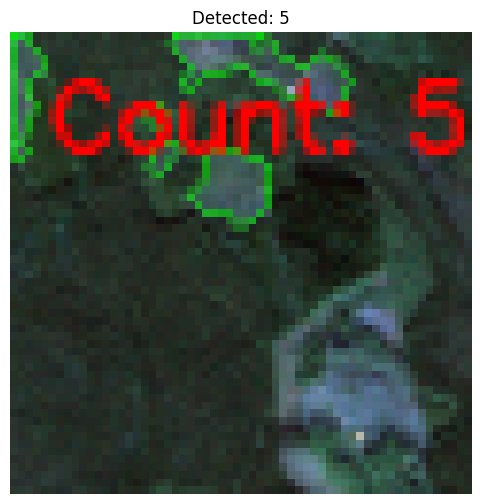

[618/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


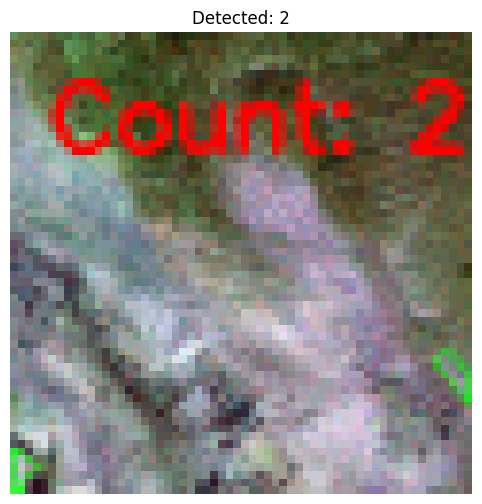

[619/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


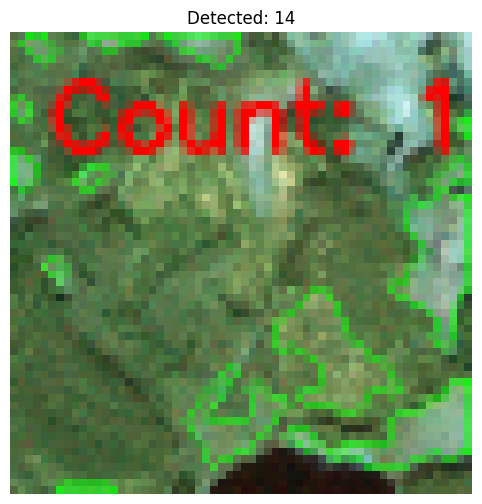

[620/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


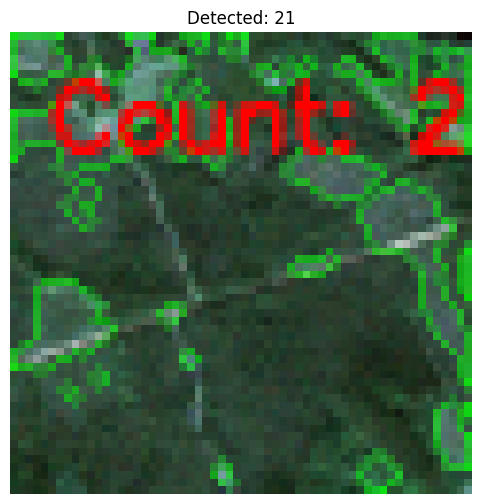

[621/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


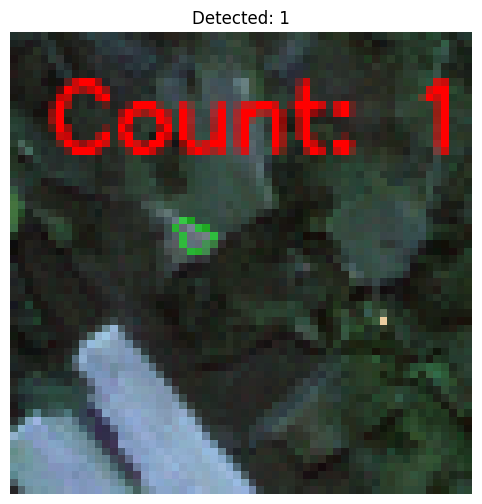

[622/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


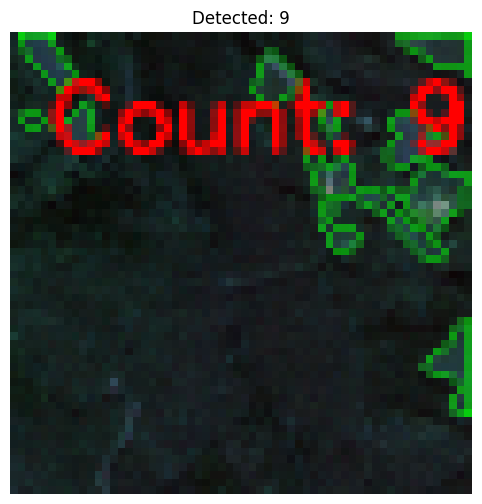

[623/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


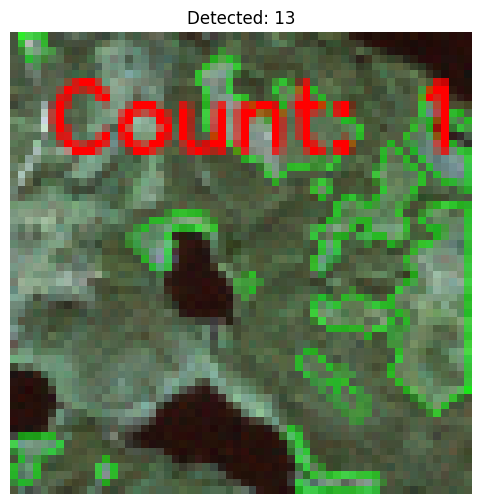

[624/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


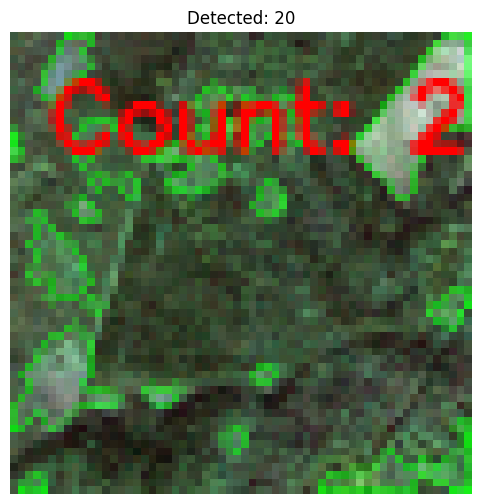

[625/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


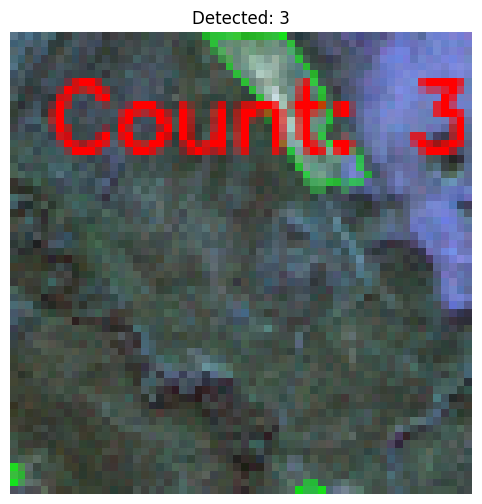

[626/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


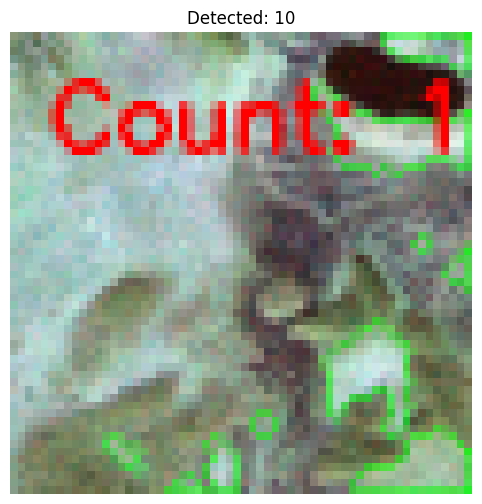

[627/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


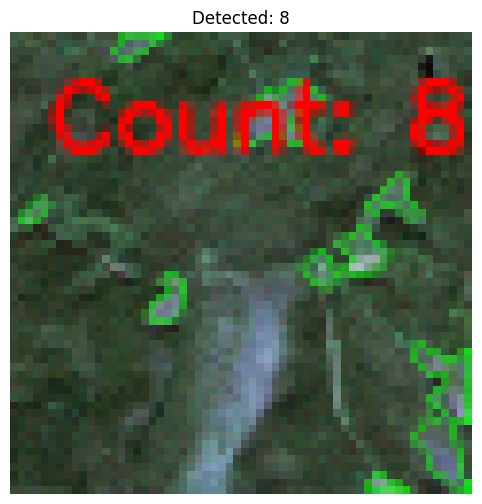

[628/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


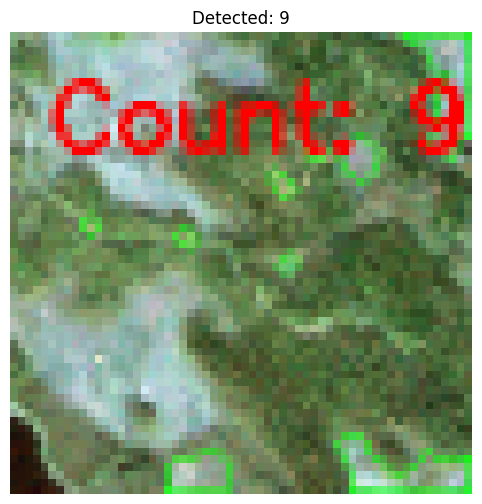

[629/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


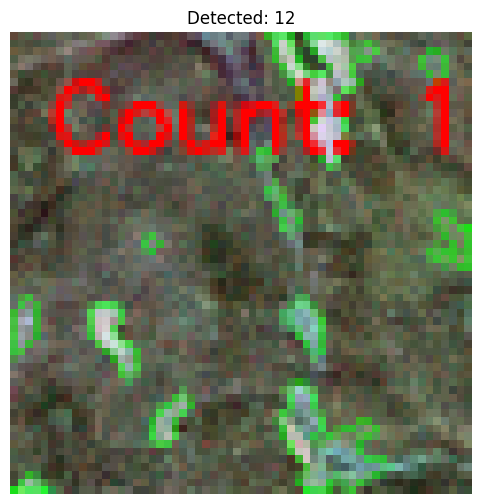

[630/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


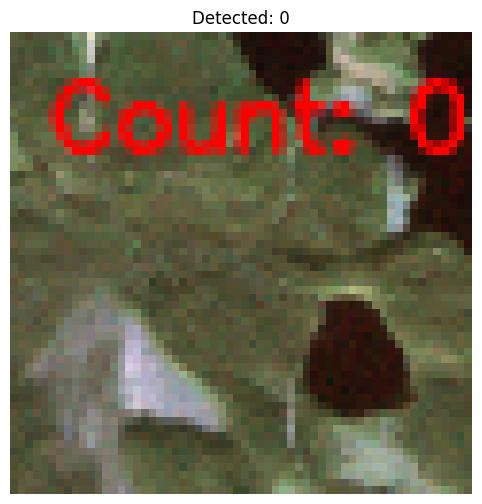

[631/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


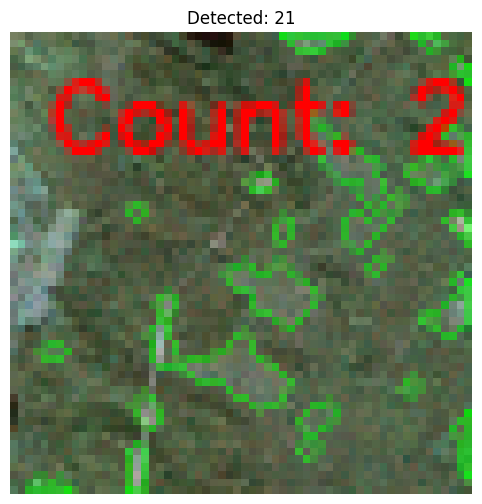

[632/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


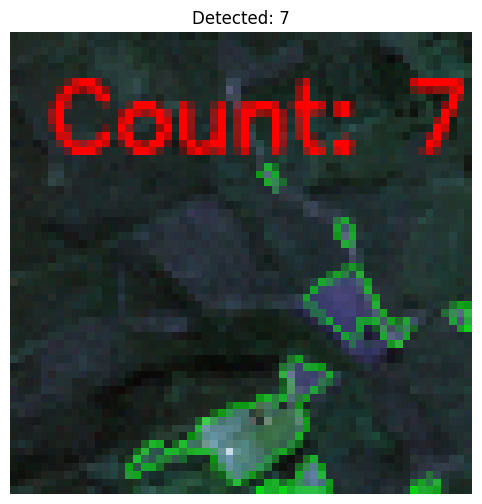

[633/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


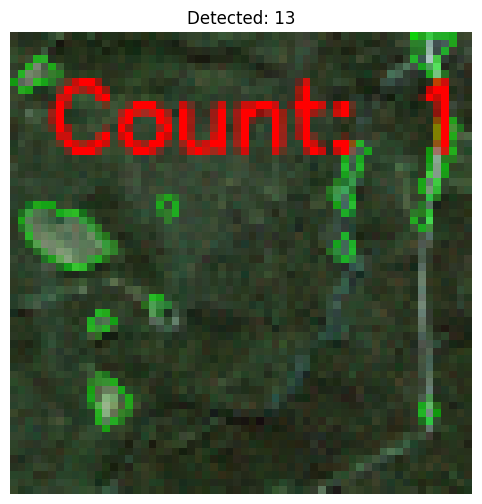

[634/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


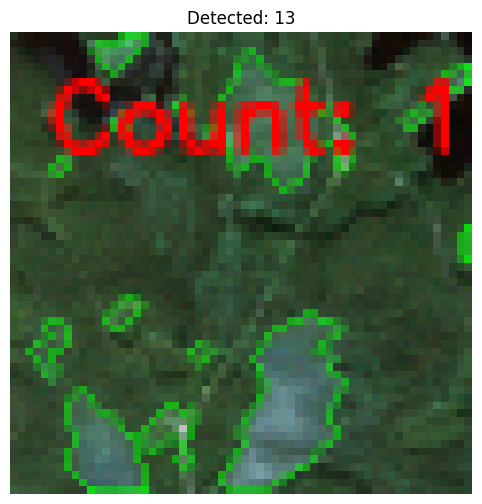

[635/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


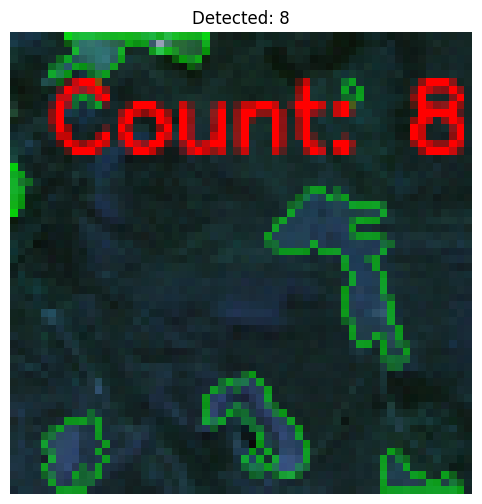

[636/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


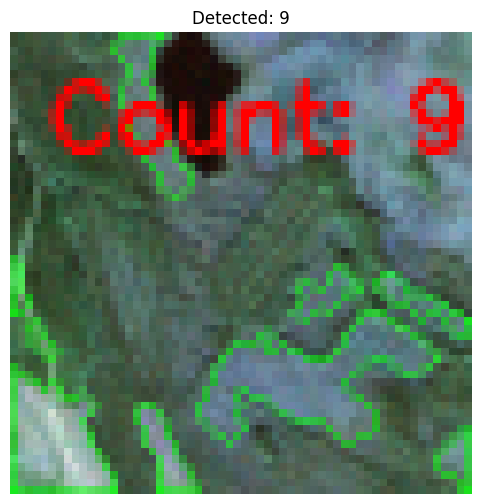

[637/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


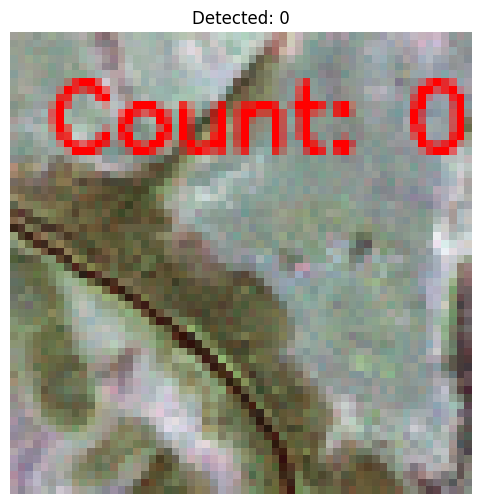

[638/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


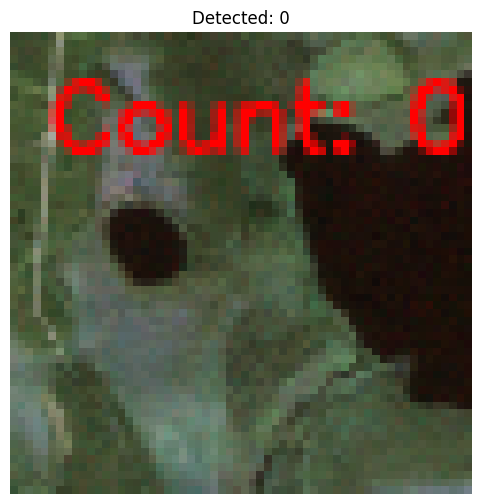

[639/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


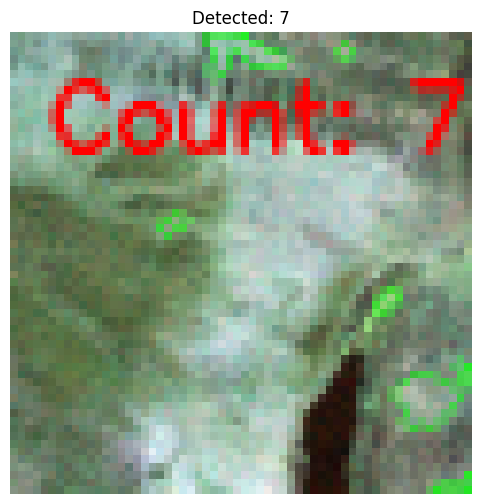

[640/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


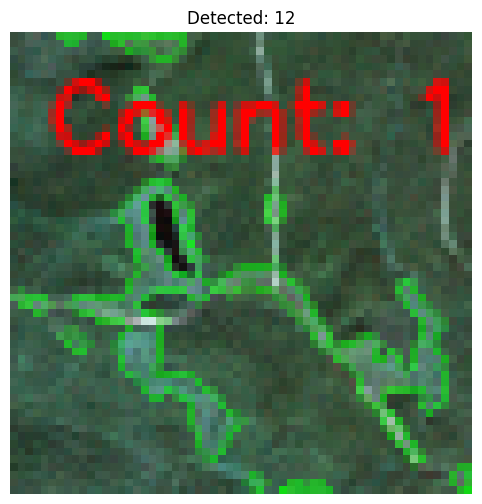

[641/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


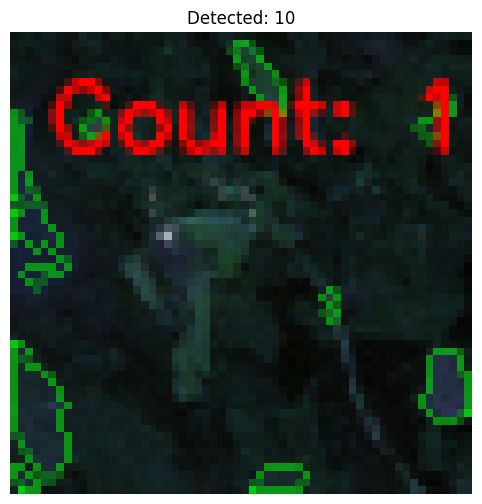

[642/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


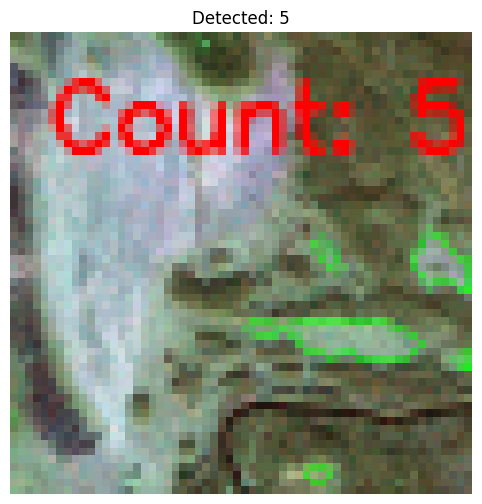

[643/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


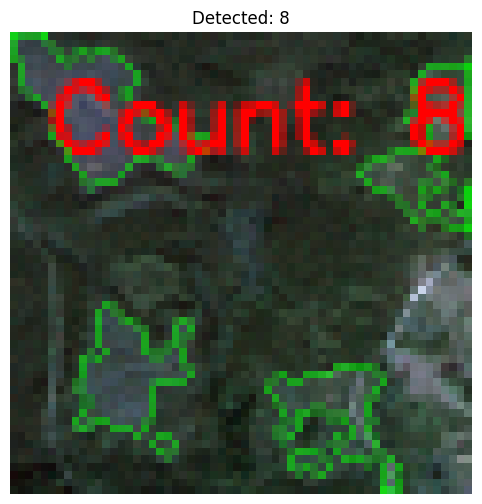

[644/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


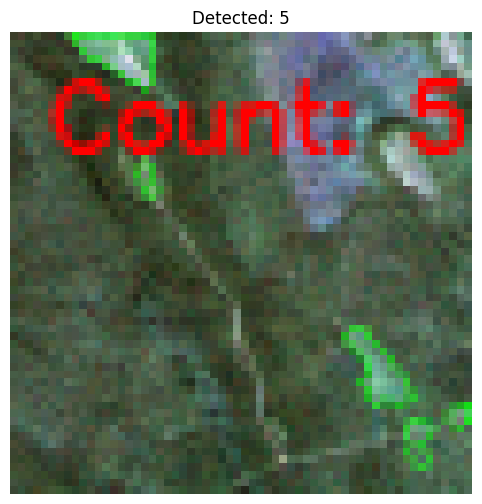

[645/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


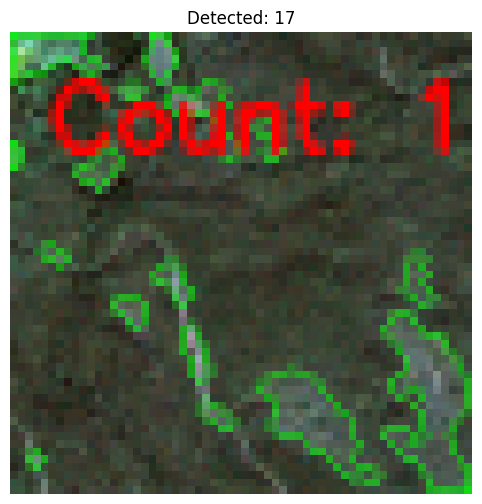

[646/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


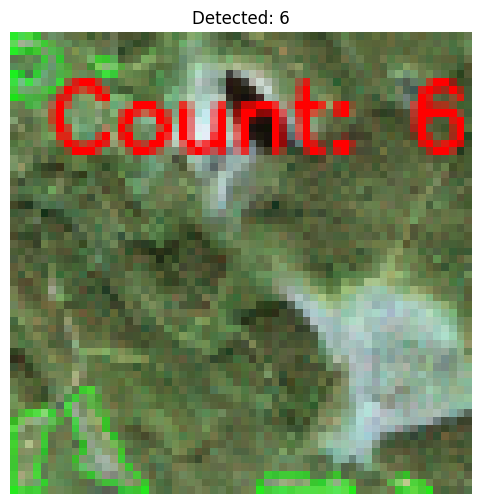

[647/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


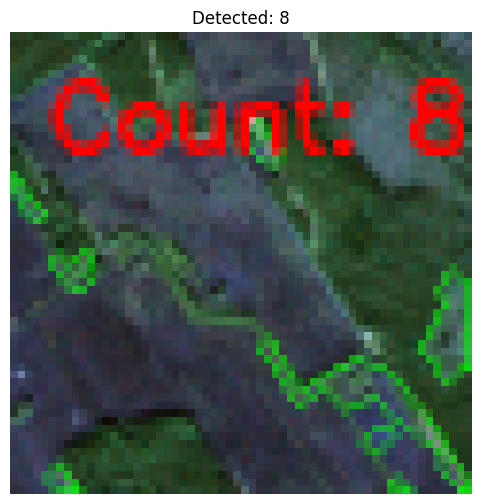

[648/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


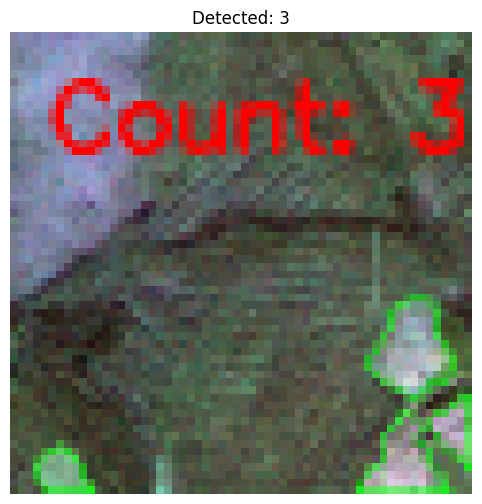

[649/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


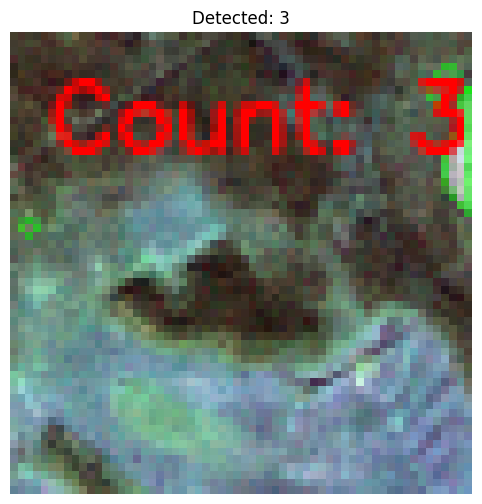

[650/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


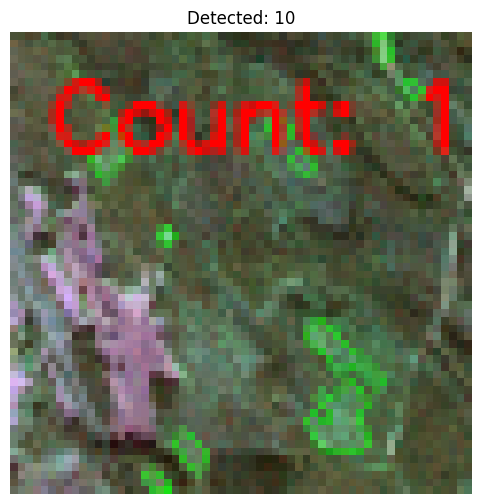

[651/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


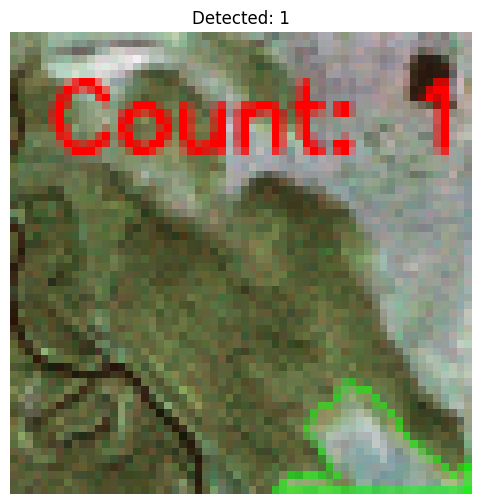

[652/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


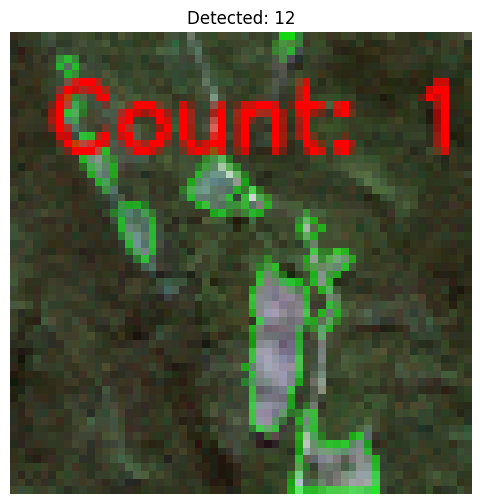

[653/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


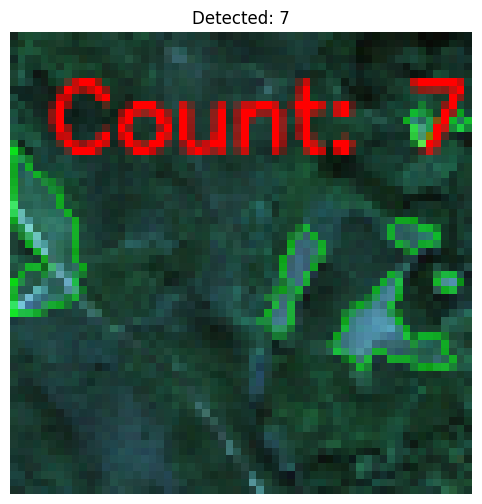

[654/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


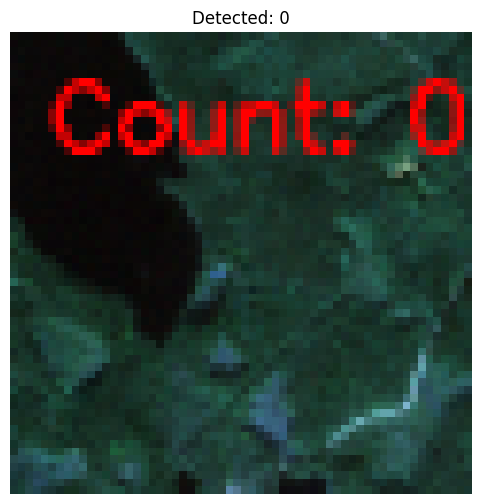

[655/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


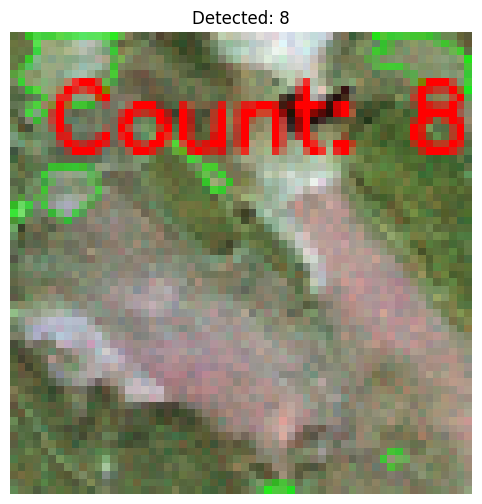

[656/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


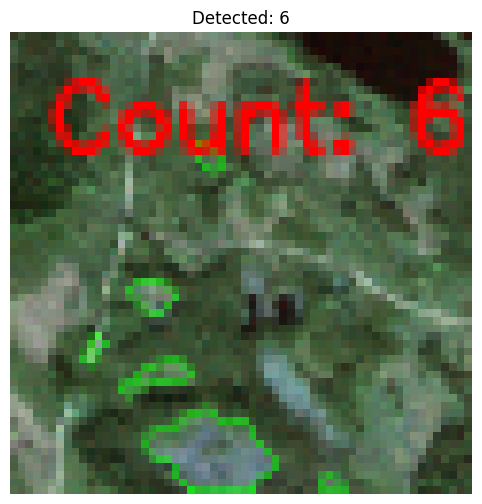

[657/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


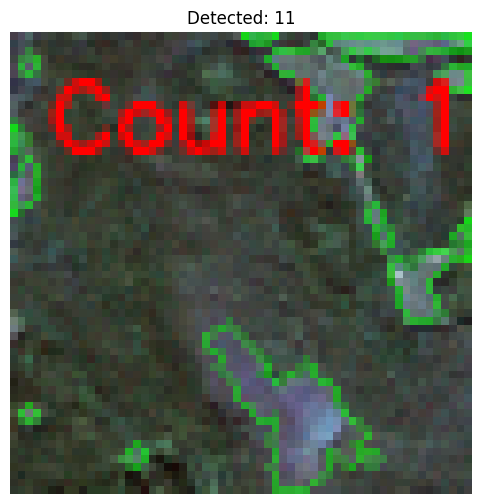

[658/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


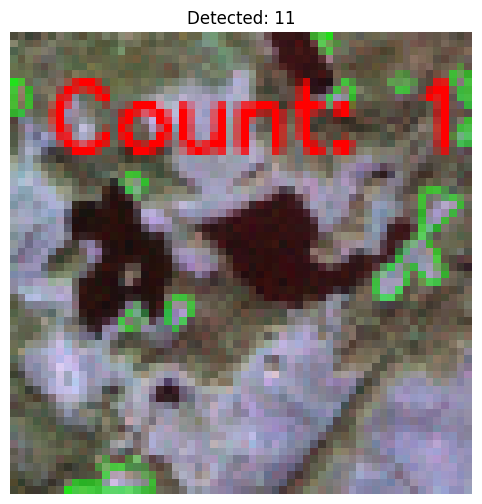

[659/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


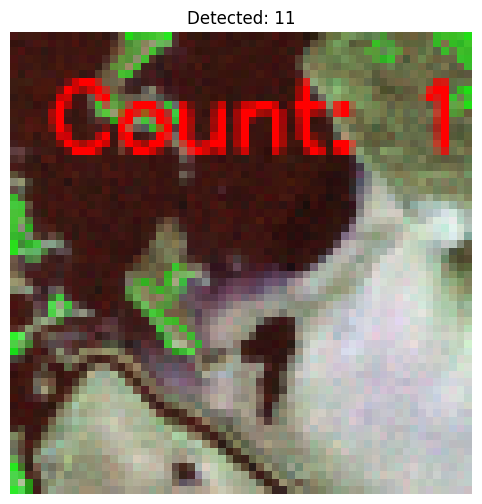

[660/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


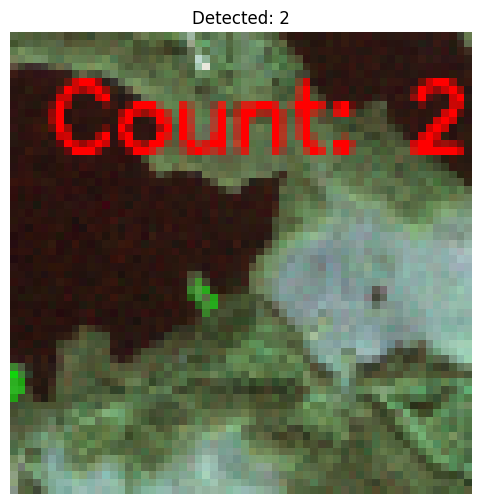

[661/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


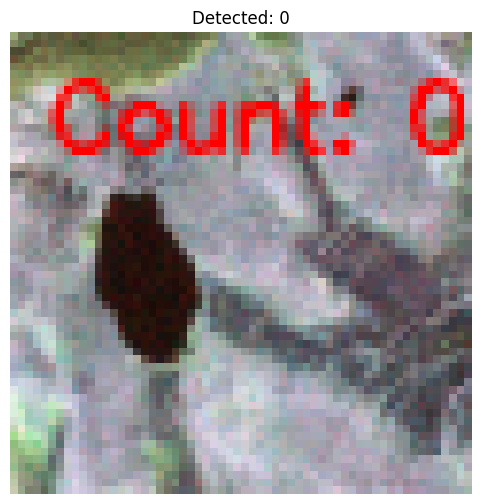

[662/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


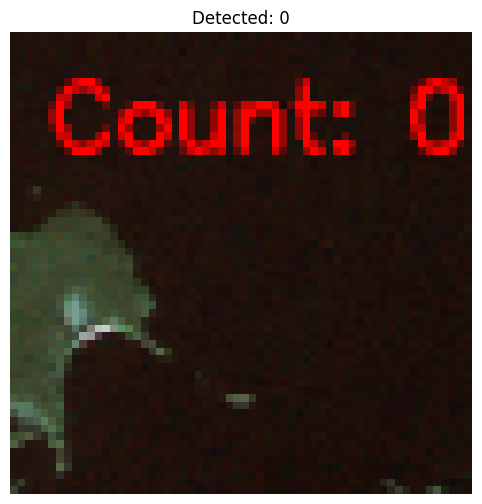

[663/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


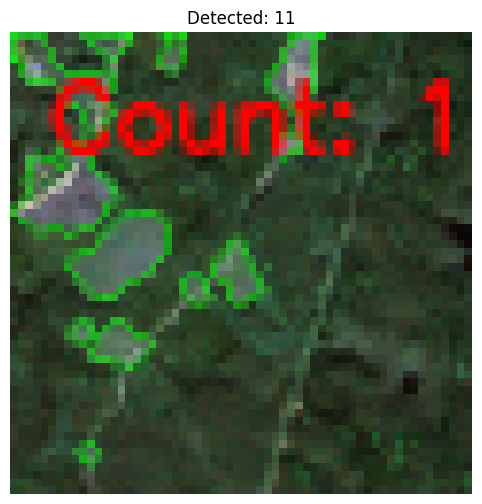

[664/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


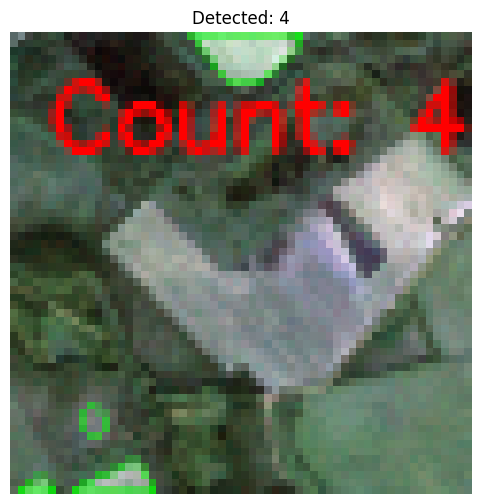

[665/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


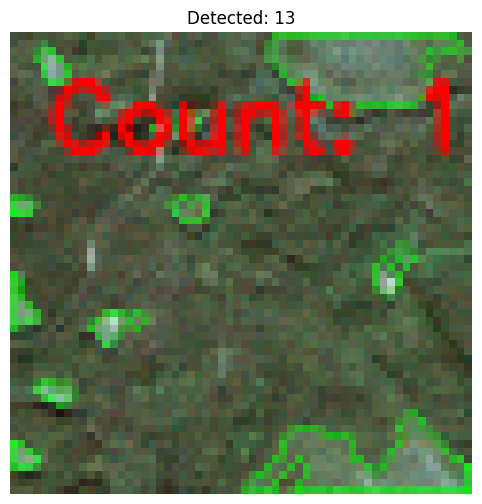

[666/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


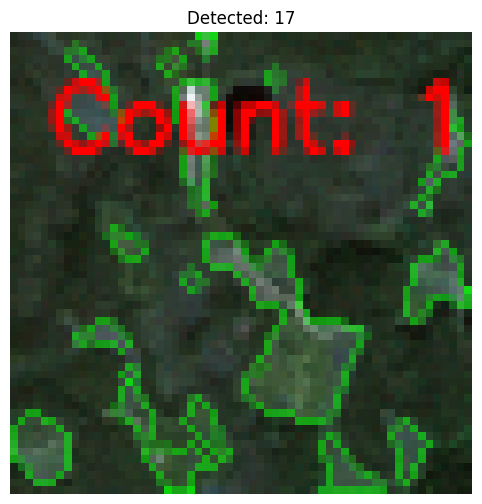

[667/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


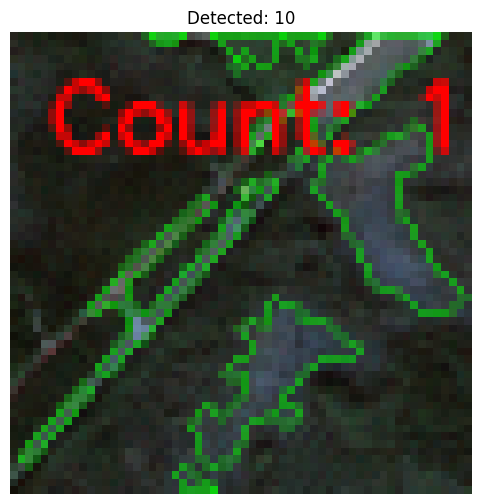

[668/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


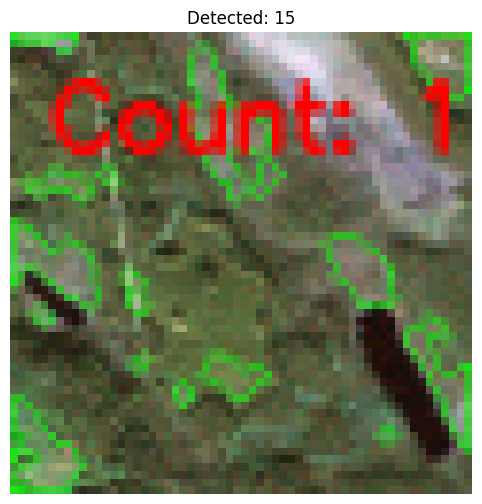

[669/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


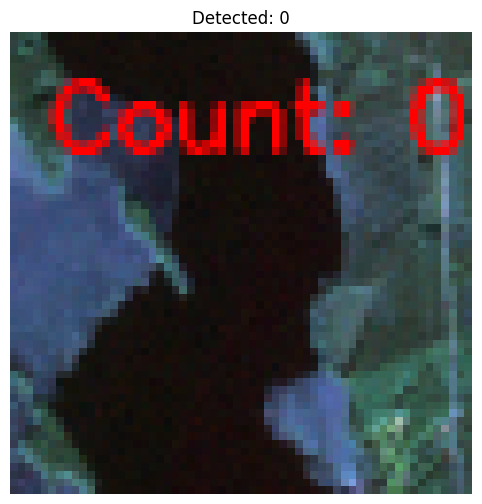

[670/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


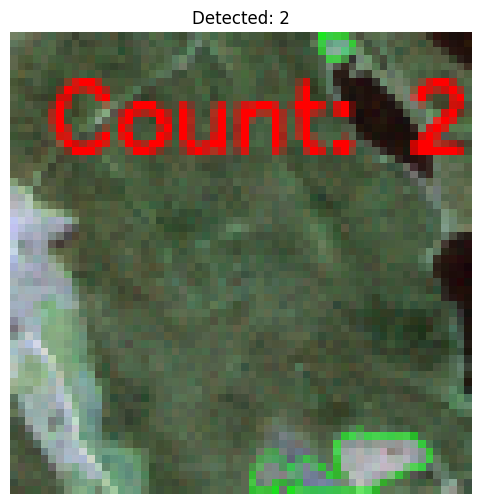

[671/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


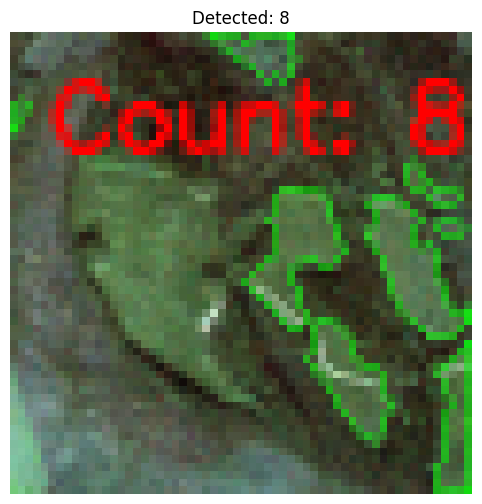

[672/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


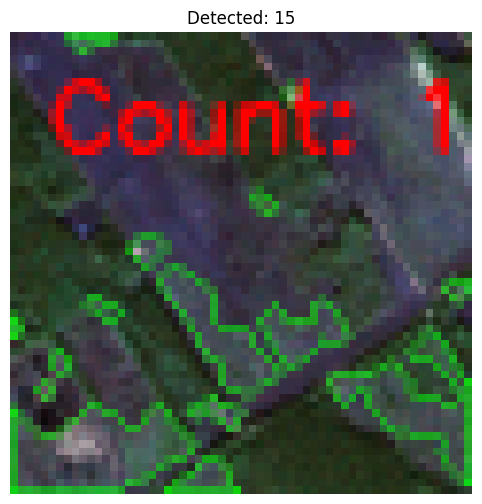

[673/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


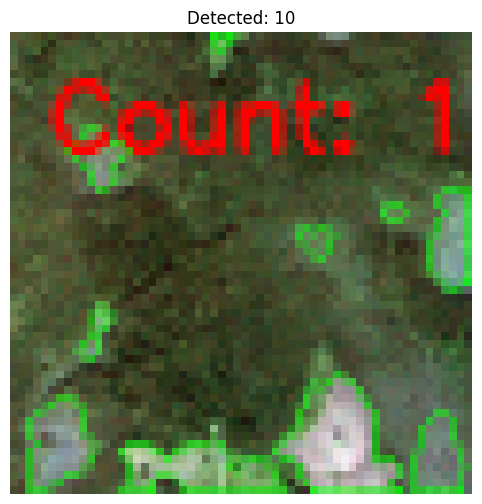

[674/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


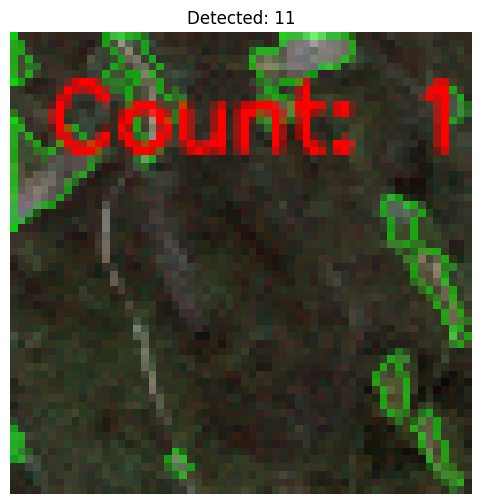

[675/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


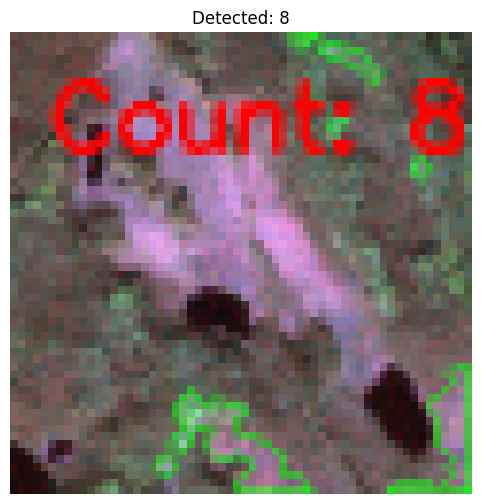

[676/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


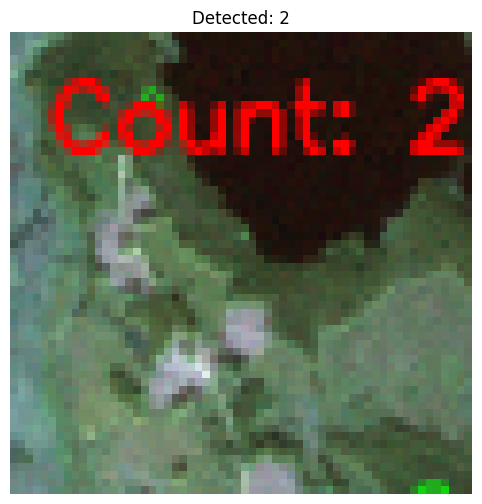

[677/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


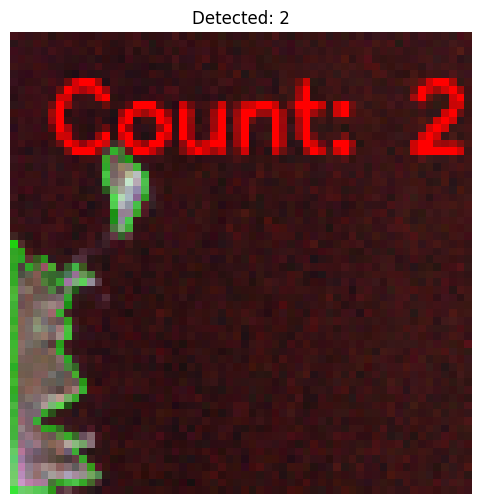

[678/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


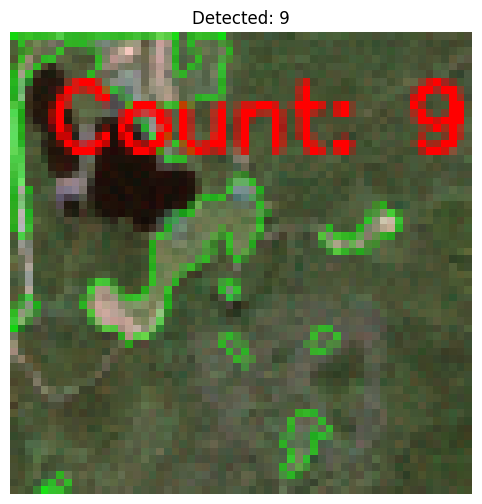

[679/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


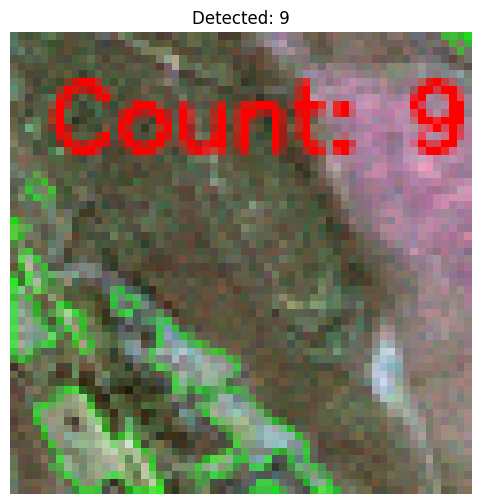

[680/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


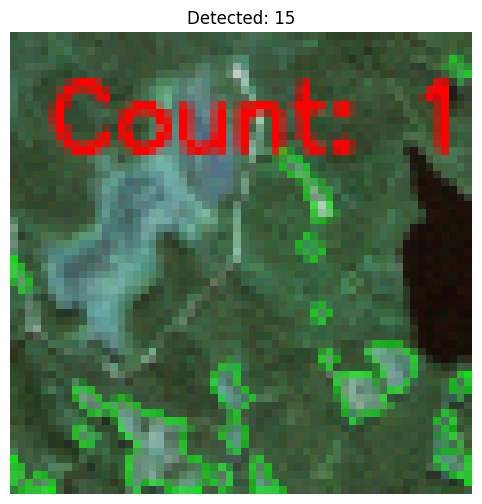

[681/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


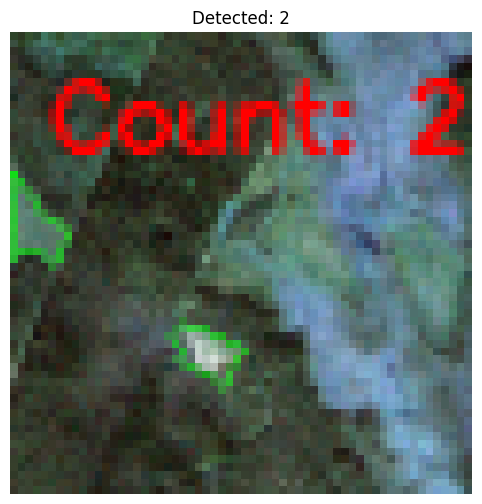

[682/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


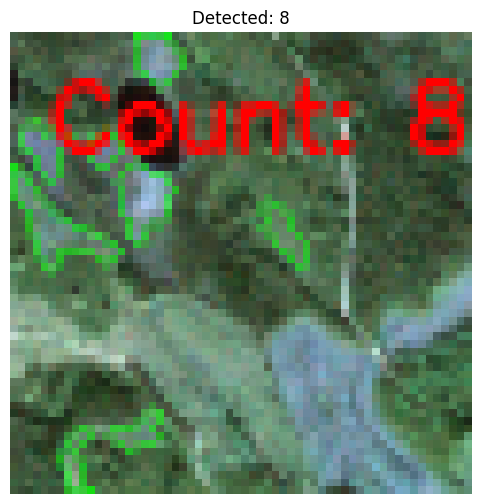

[683/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


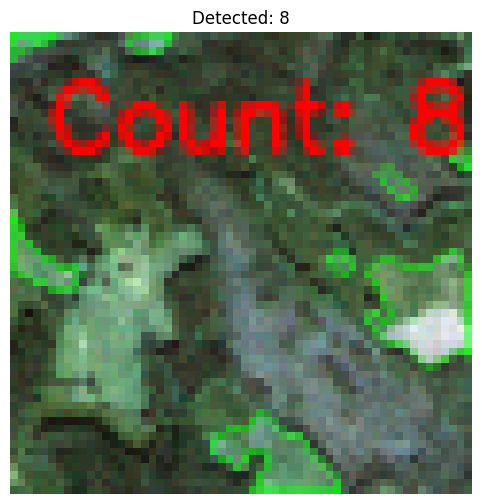

[684/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


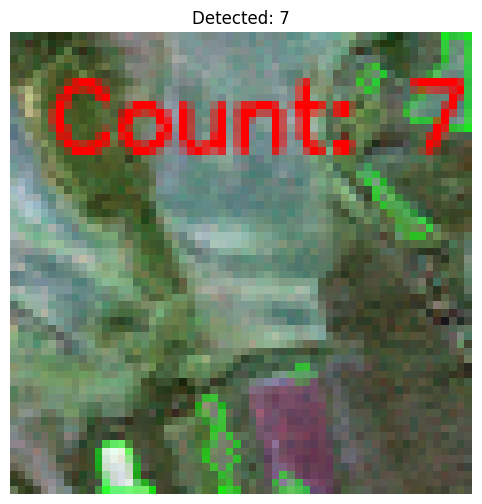

[685/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


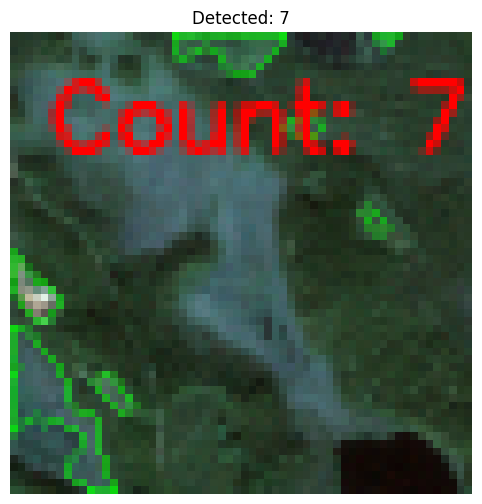

[686/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


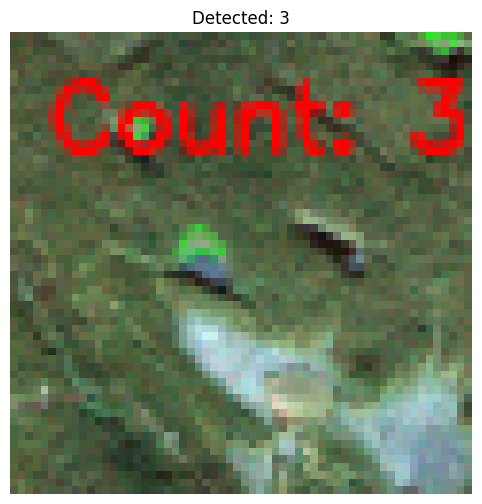

[687/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


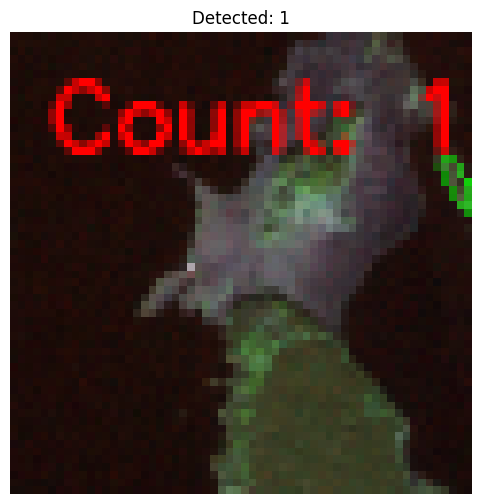

[688/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


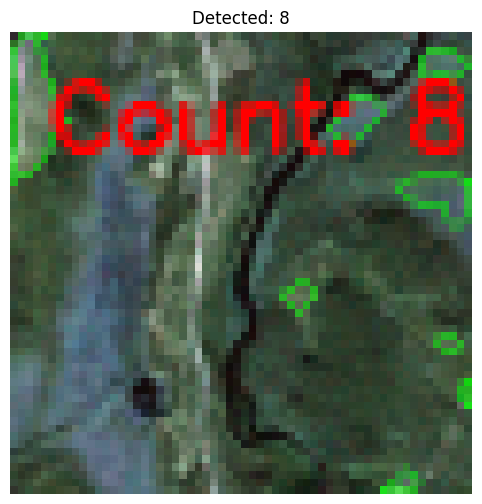

[689/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_23_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_23_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


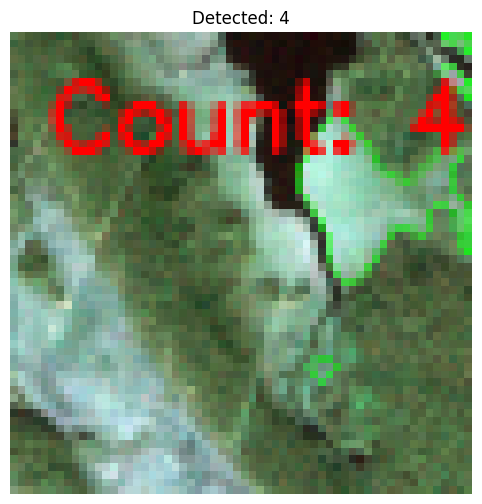

[690/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


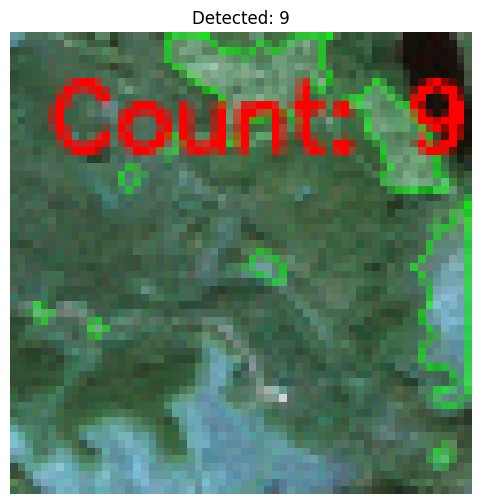

[691/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


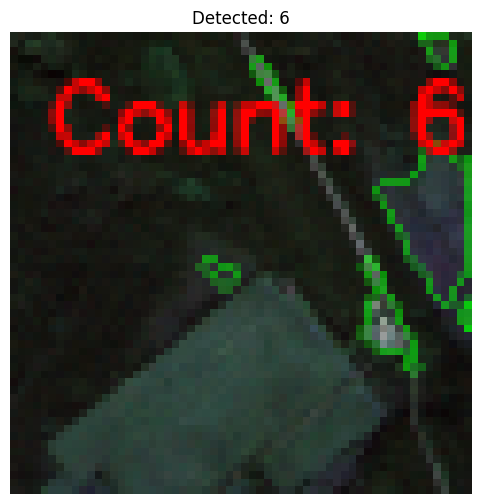

[692/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


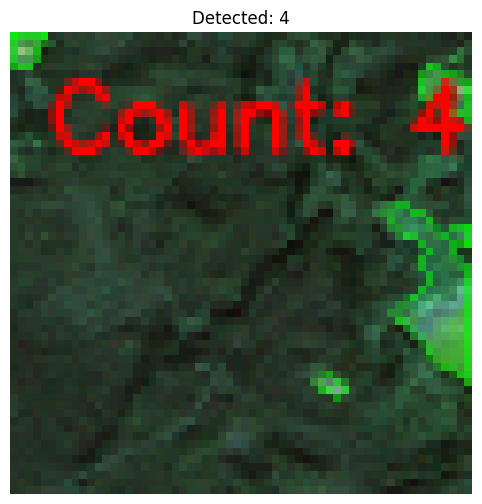

[693/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


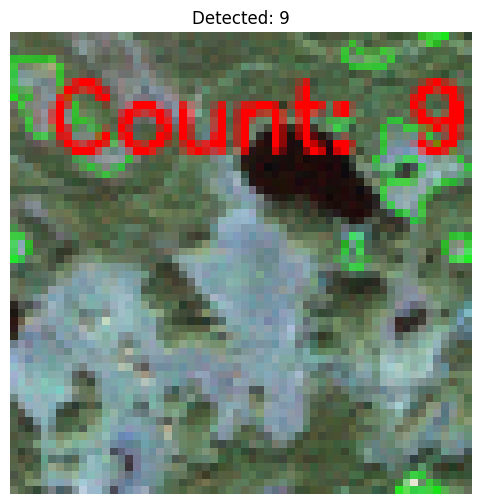

[694/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


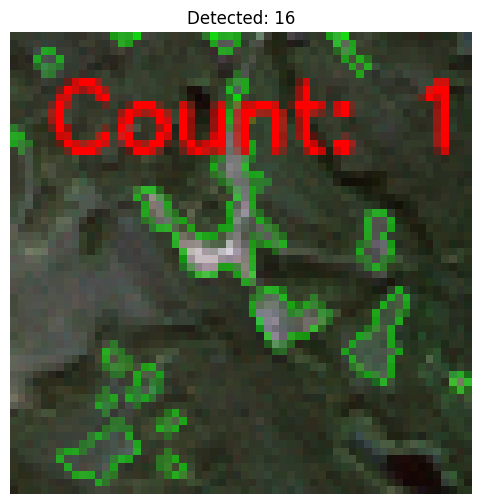

[695/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


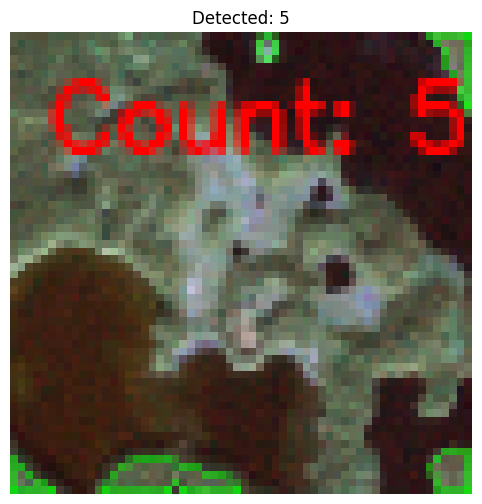

[696/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


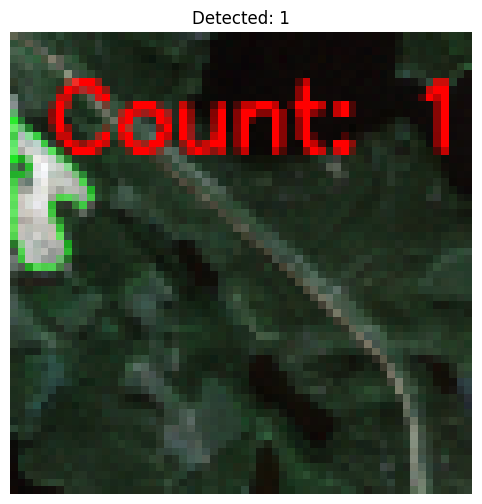

[697/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


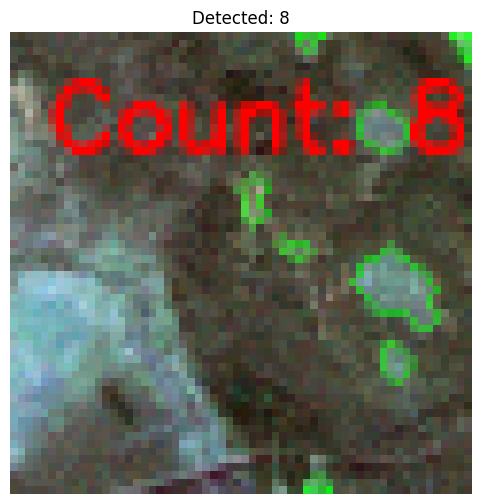

[698/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


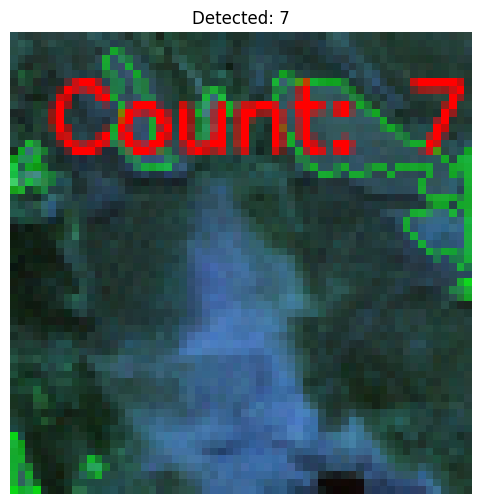

[699/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


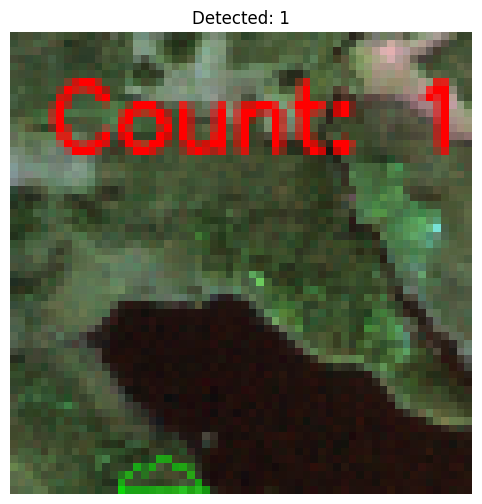

[700/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


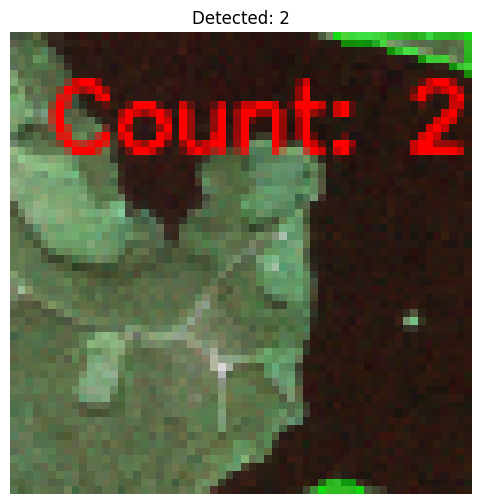

[701/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


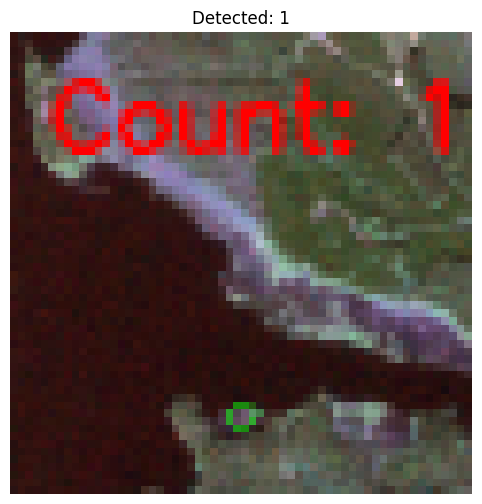

[702/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


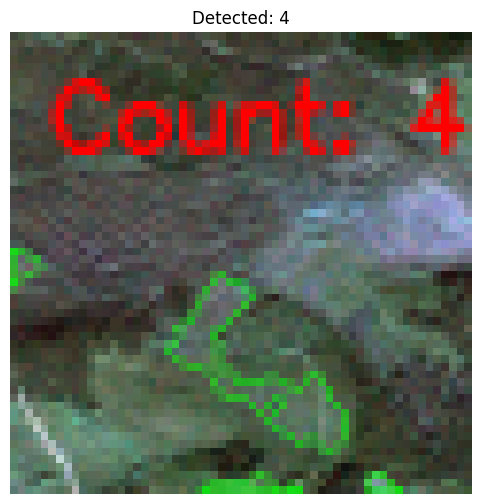

[703/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


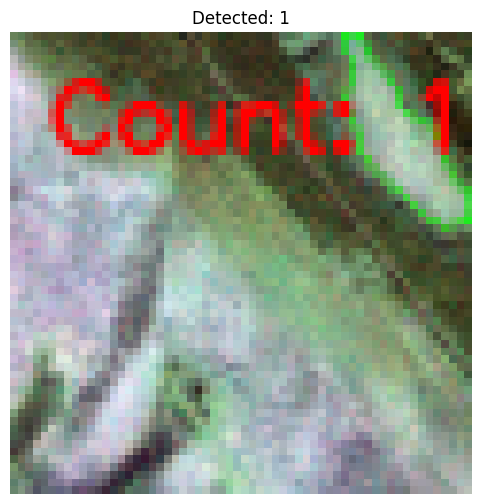

[704/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


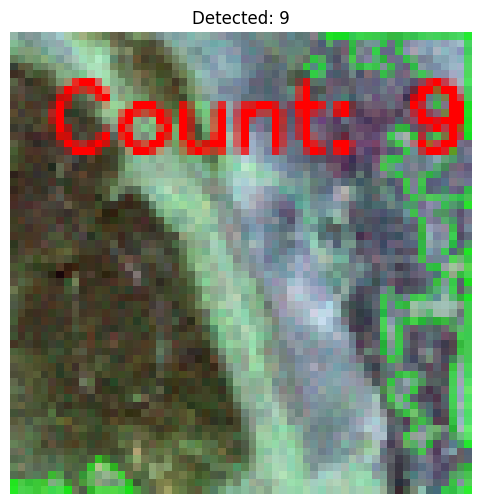

[705/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


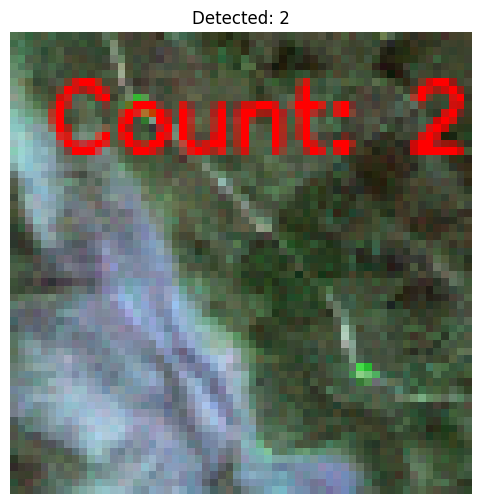

[706/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


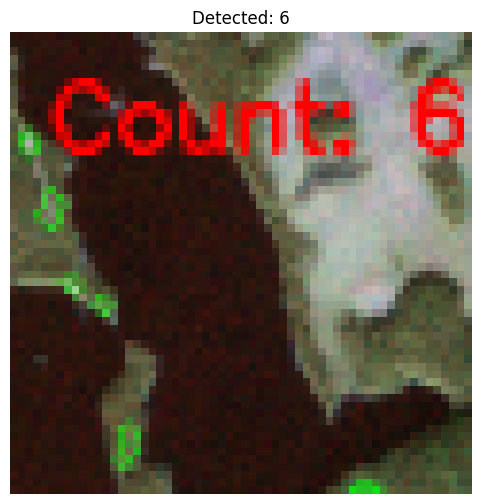

[707/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


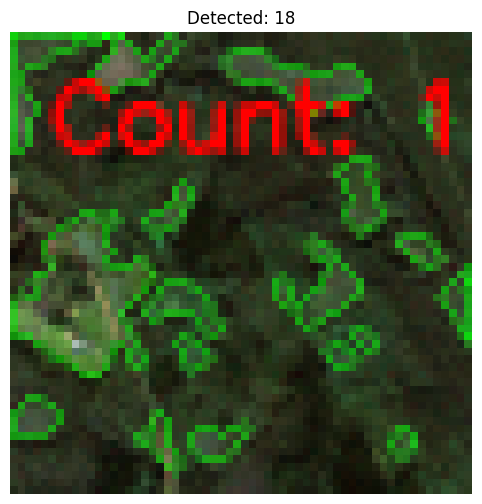

[708/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


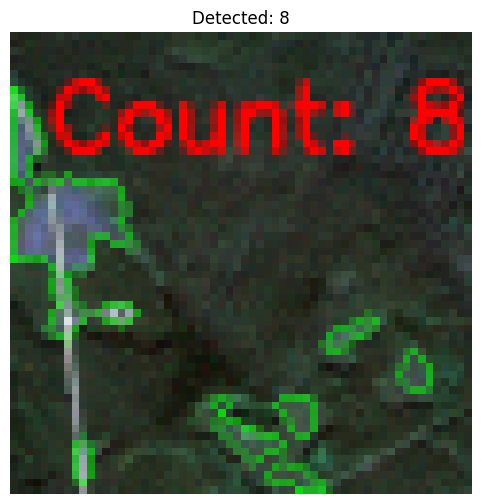

[709/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


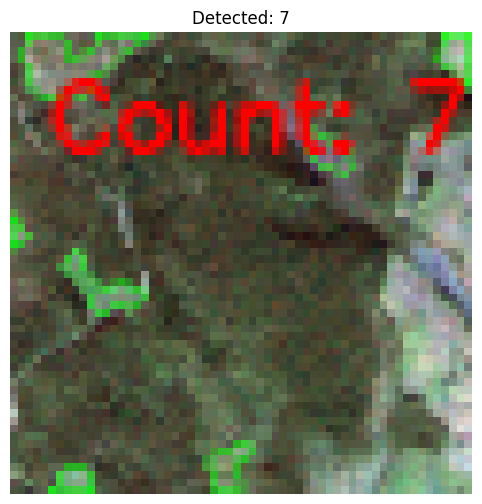

[710/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


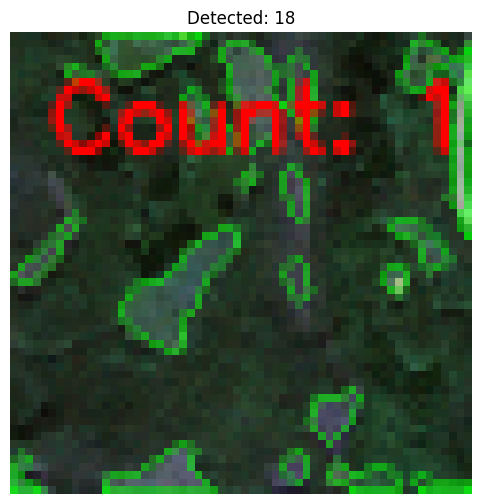

[711/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


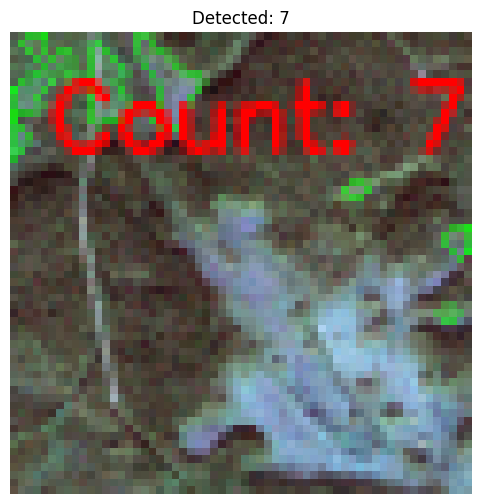

[712/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


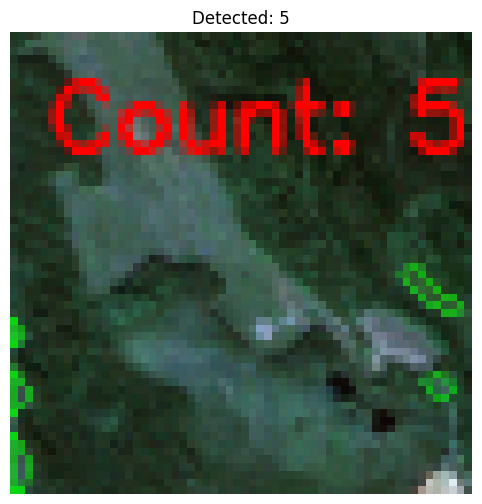

[713/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


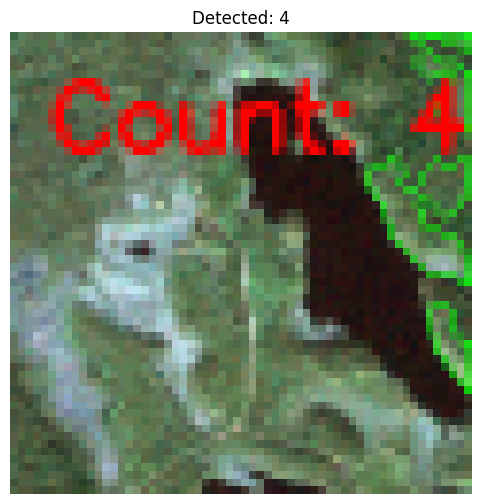

[714/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


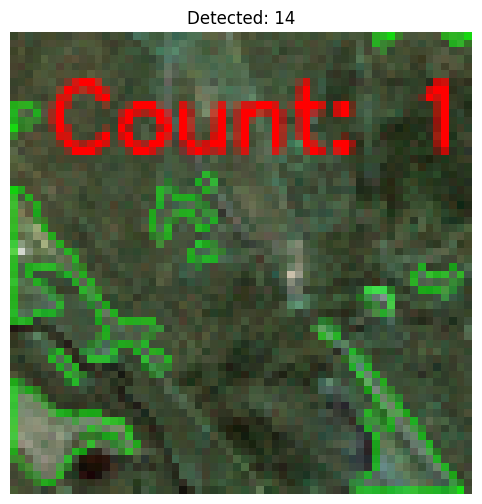

[715/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


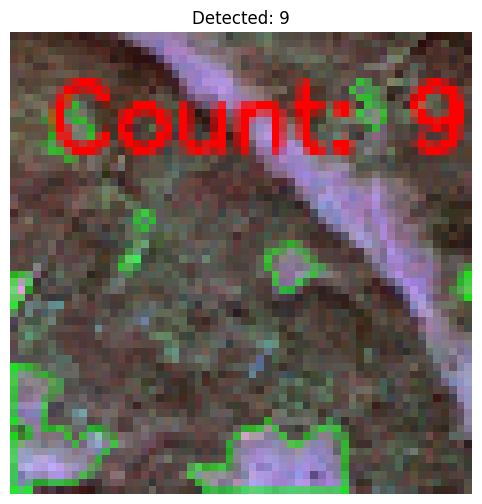

[716/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


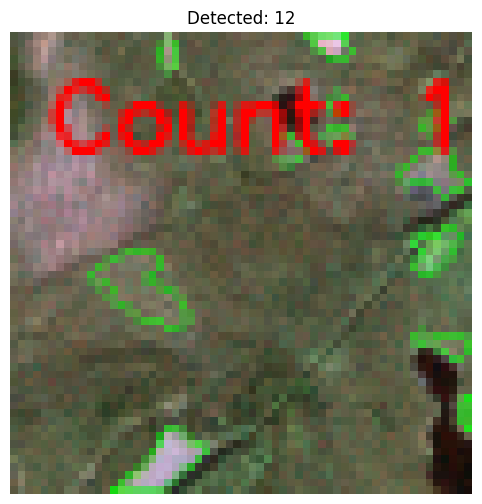

[717/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


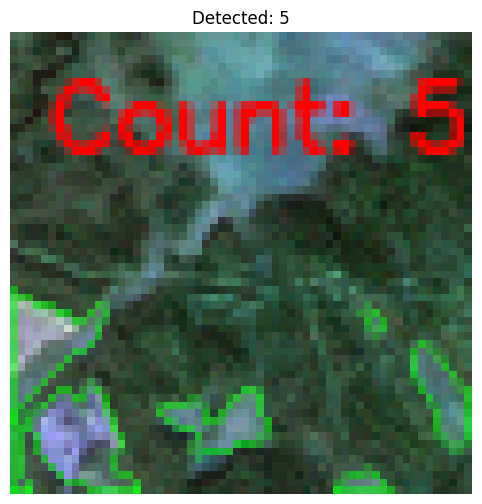

[718/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


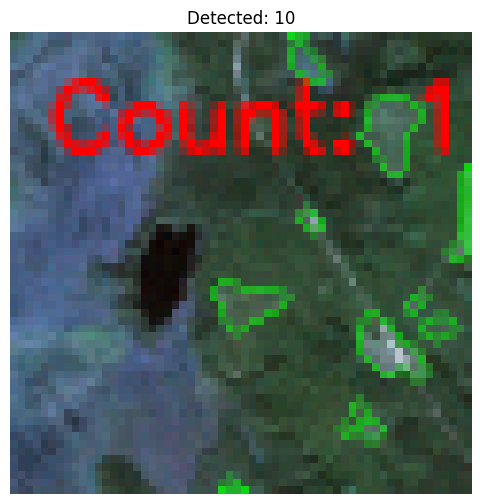

[719/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


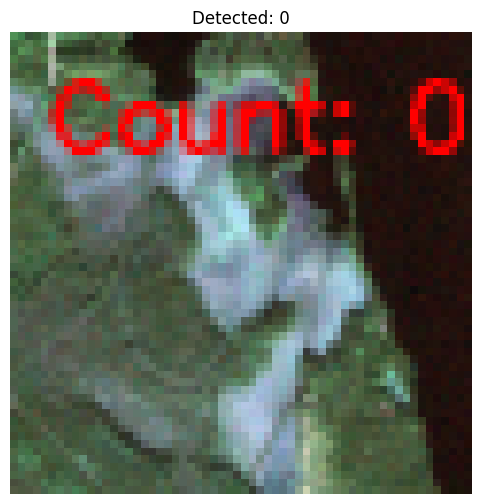

[720/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


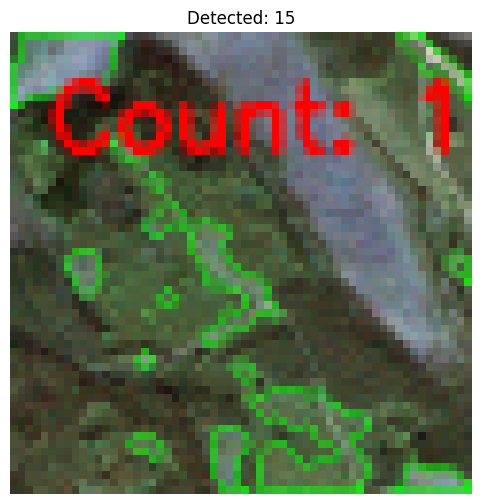

[721/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


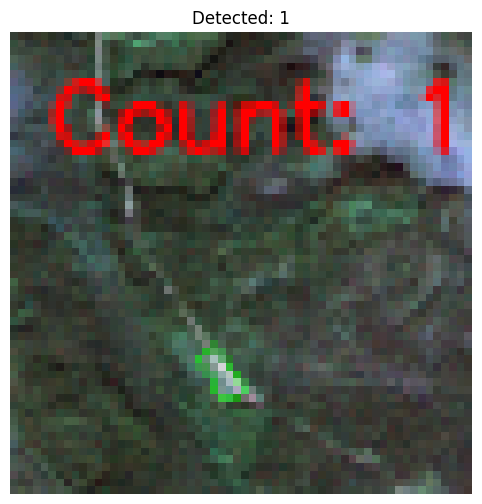

[722/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


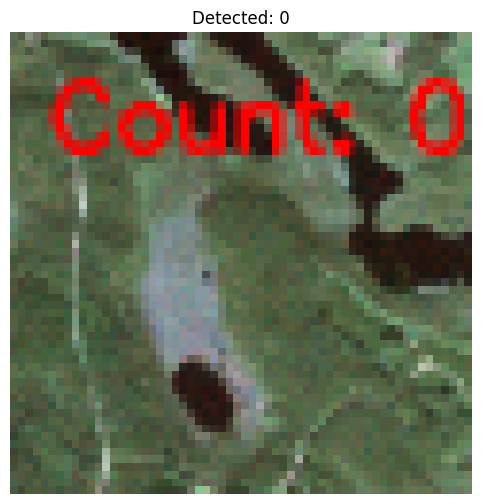

[723/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


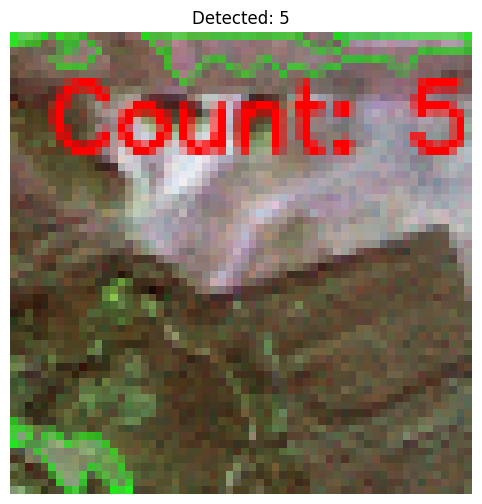

[724/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


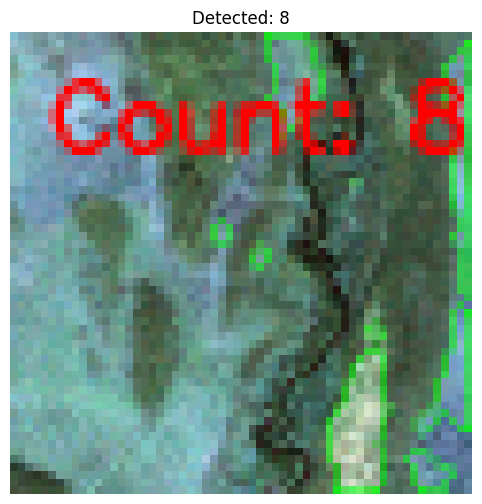

[725/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


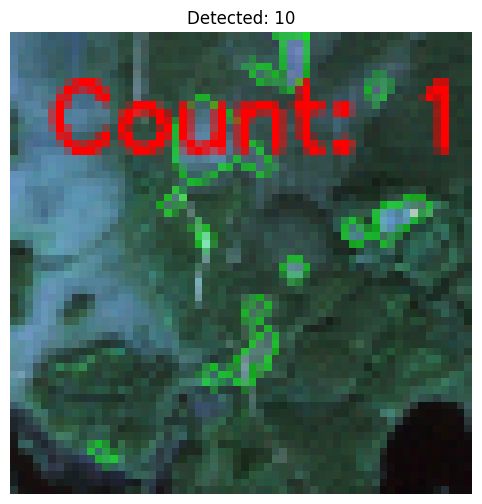

[726/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


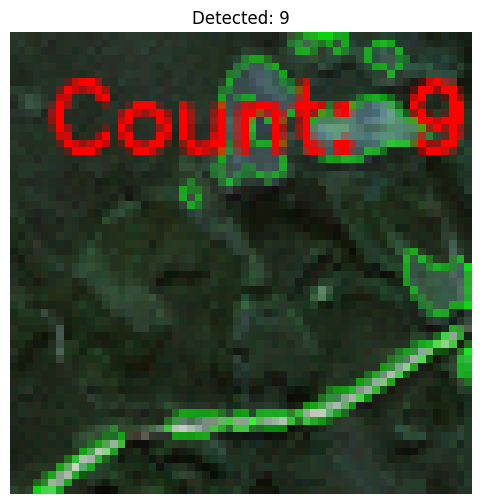

[727/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


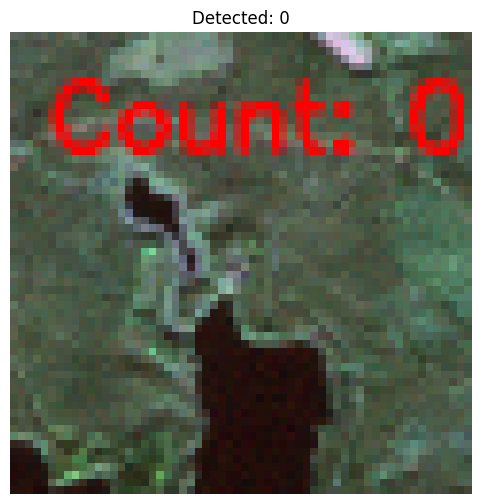

[728/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


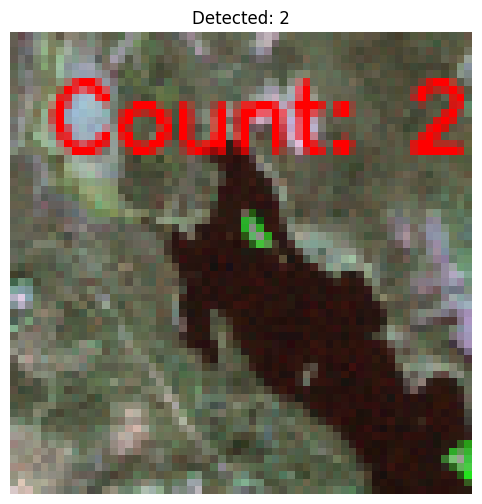

[729/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


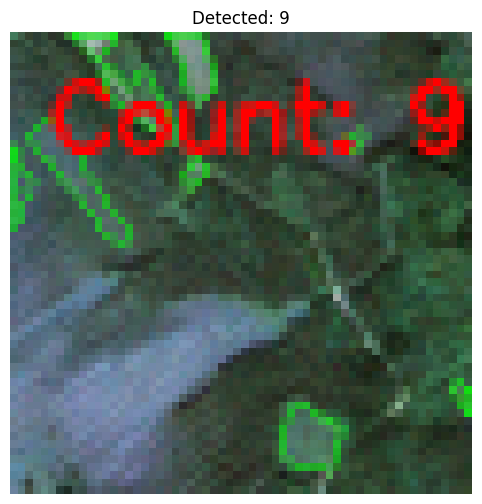

[730/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


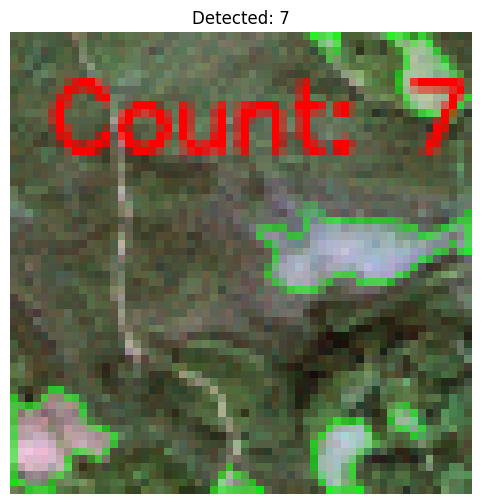

[731/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


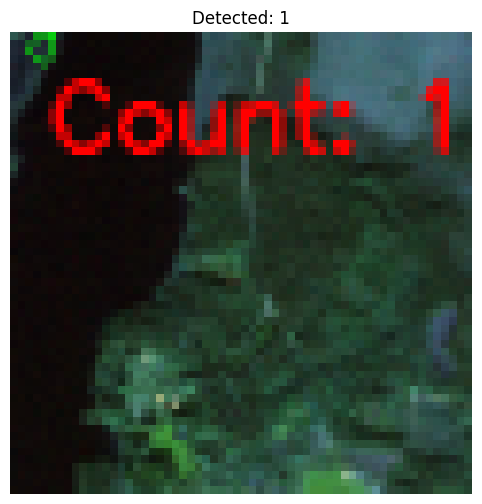

[732/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


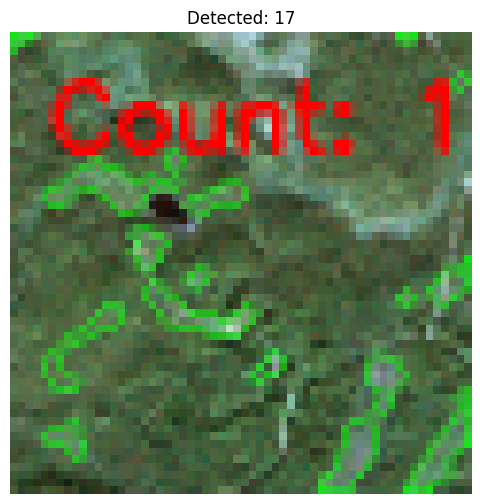

[733/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


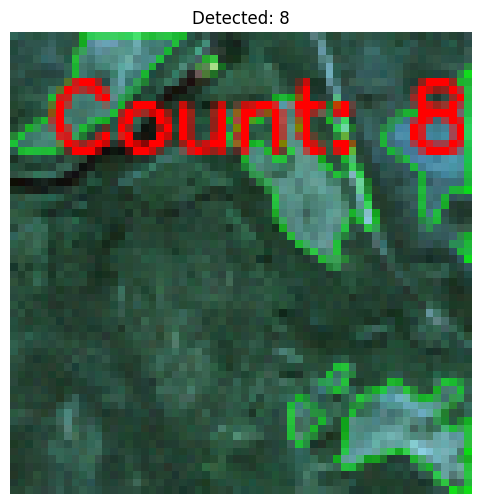

[734/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


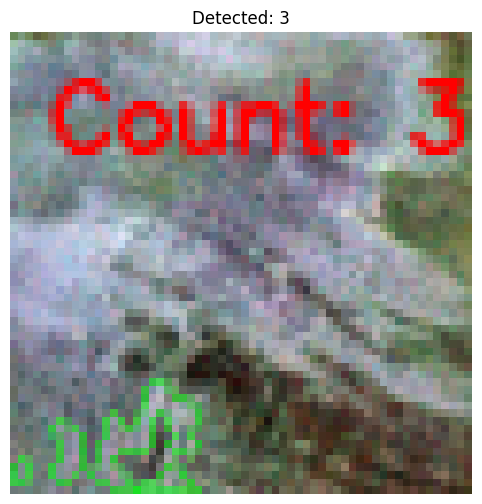

[735/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


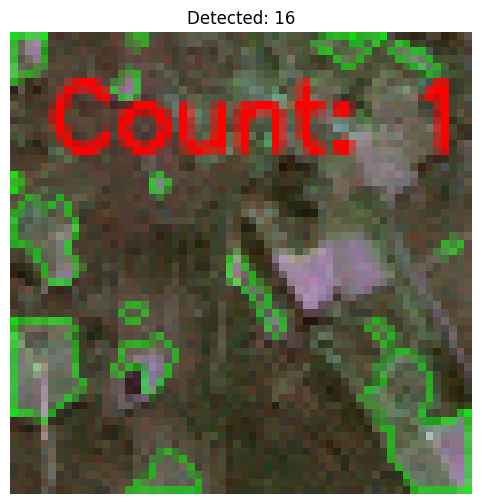

[736/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


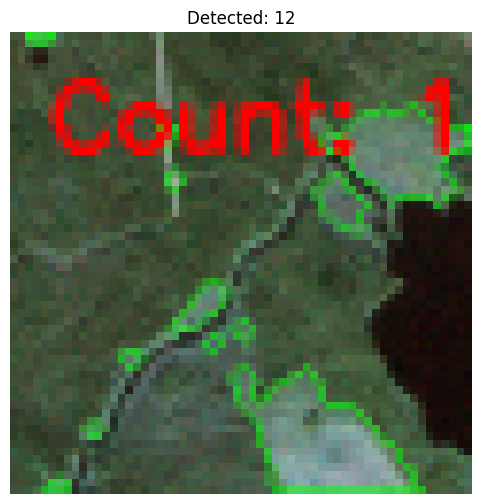

[737/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


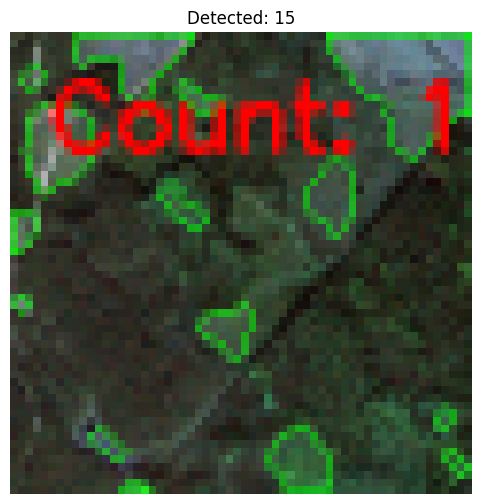

[738/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


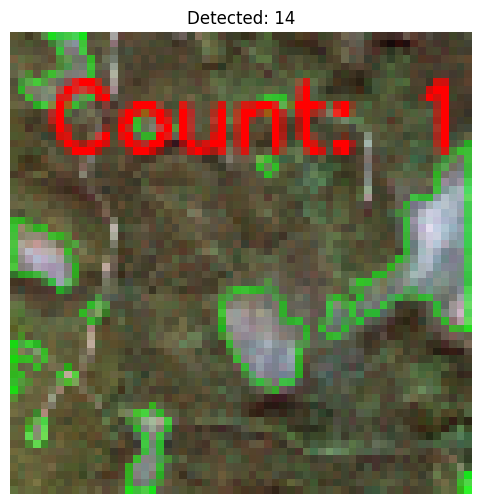

[739/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


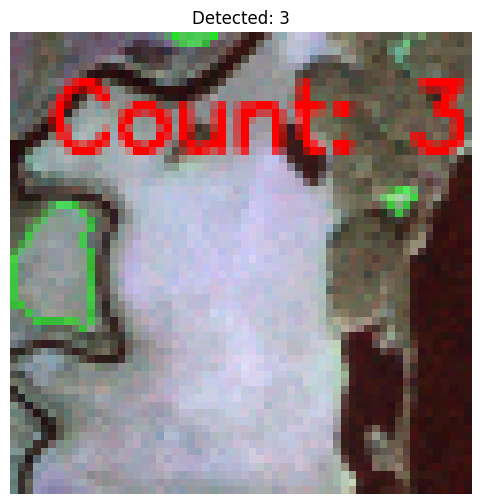

[740/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


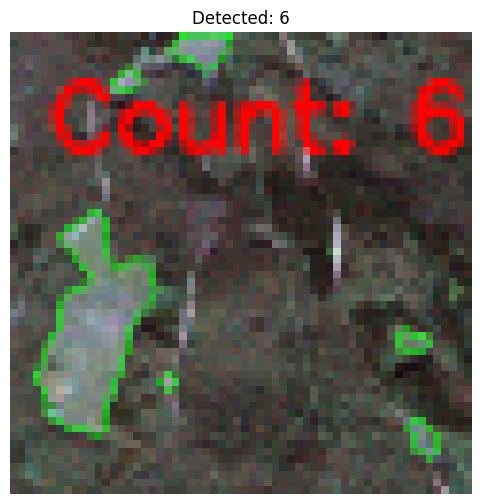

[741/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


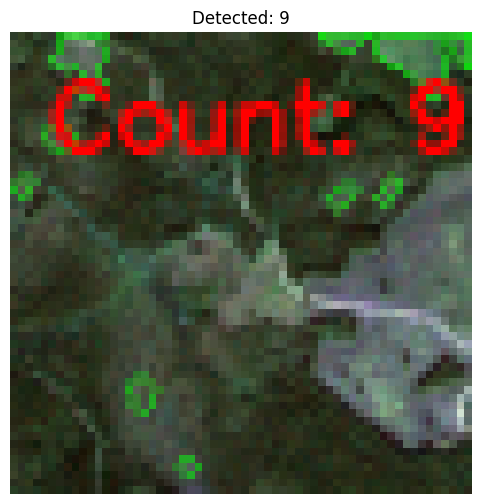

[742/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


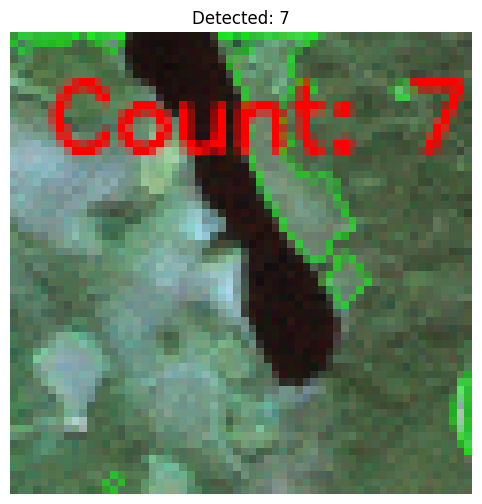

[743/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


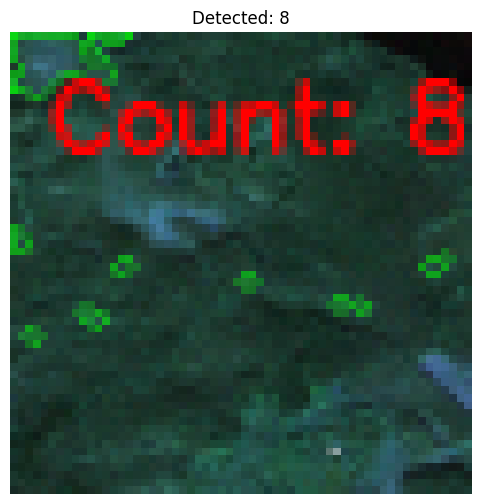

[744/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


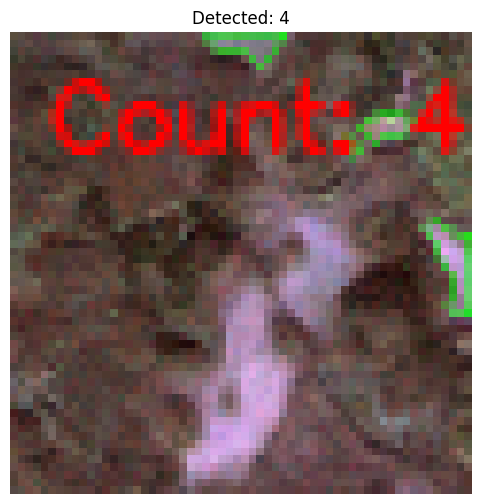

[745/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


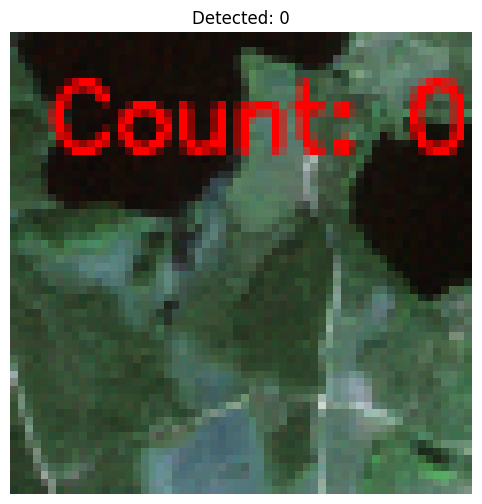

[746/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


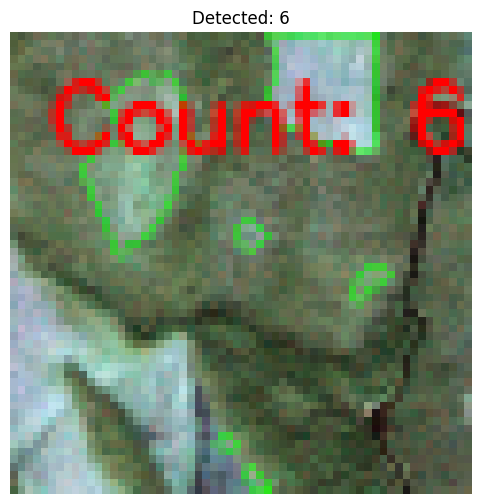

[747/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


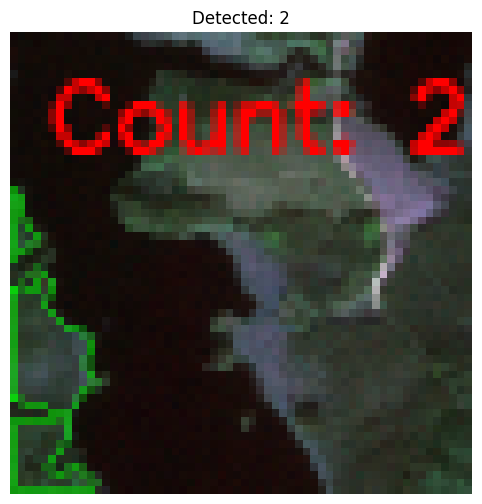

[748/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


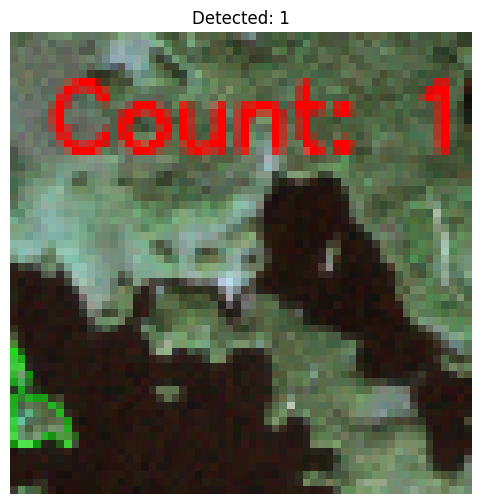

[749/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


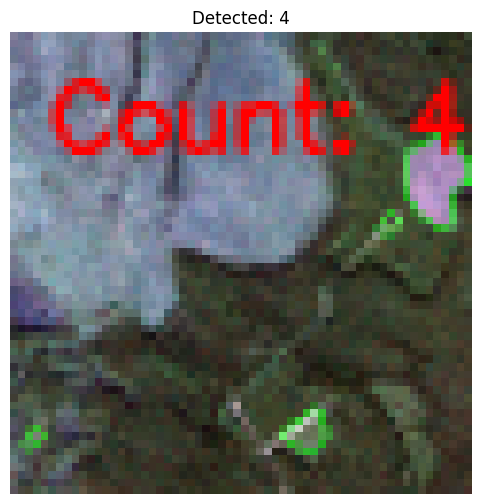

[750/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


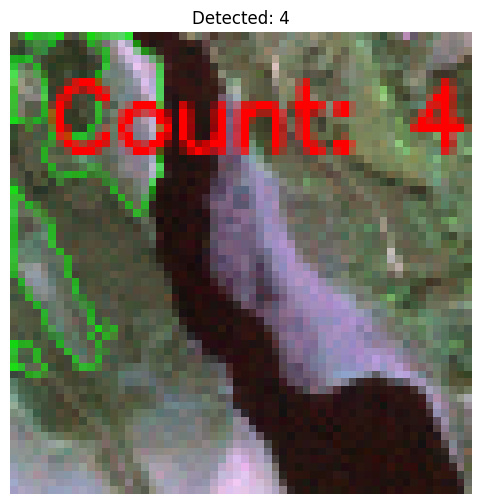

[751/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


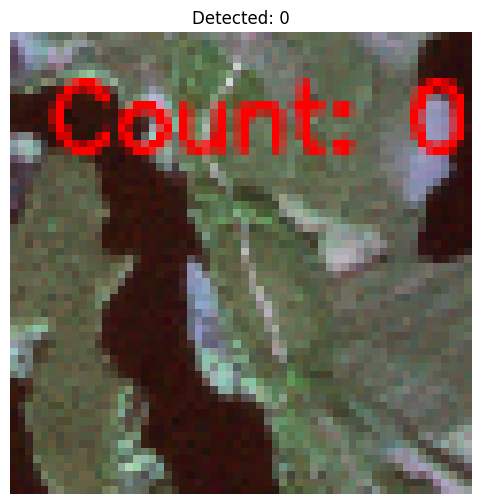

[752/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


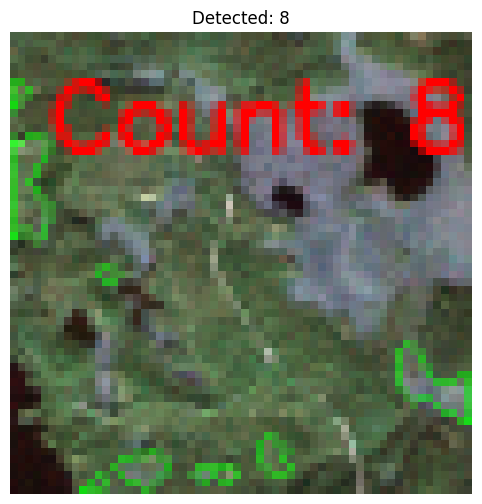

[753/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


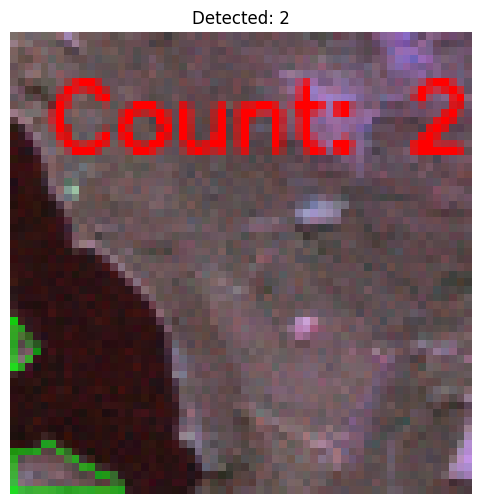

[754/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


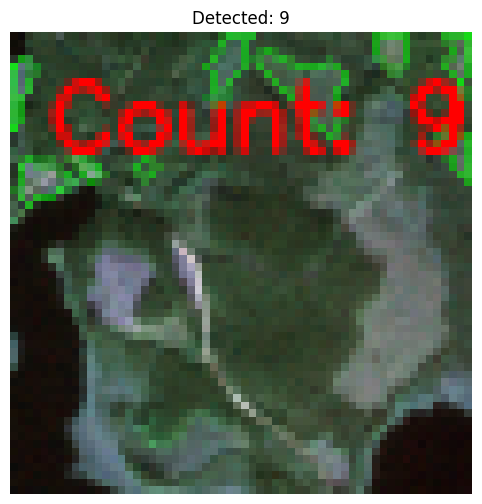

[755/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


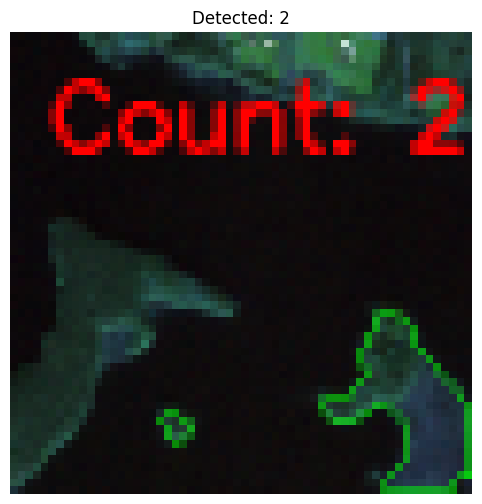

[756/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


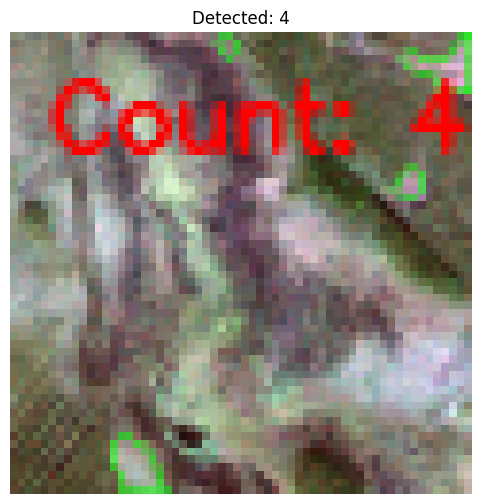

[757/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


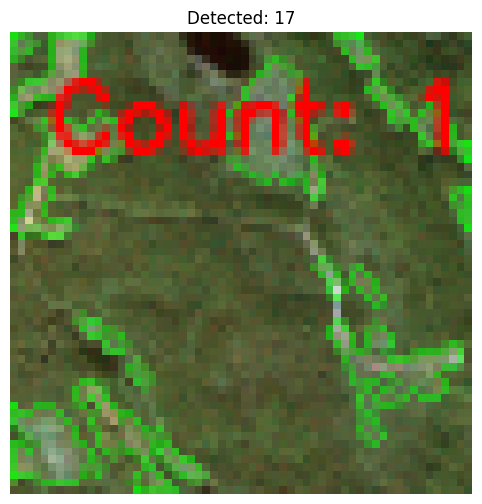

[758/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


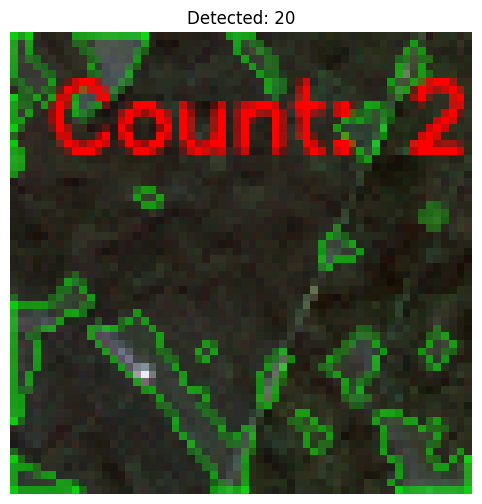

[759/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


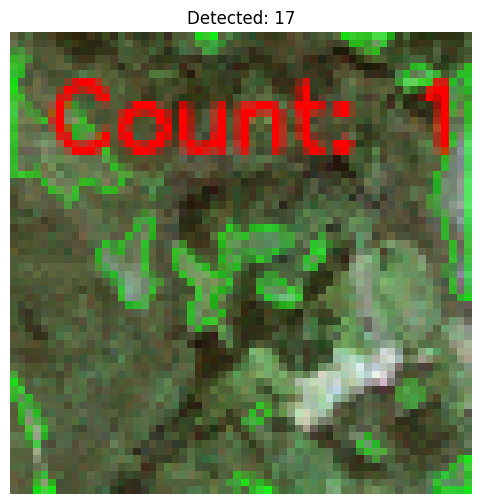

[760/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


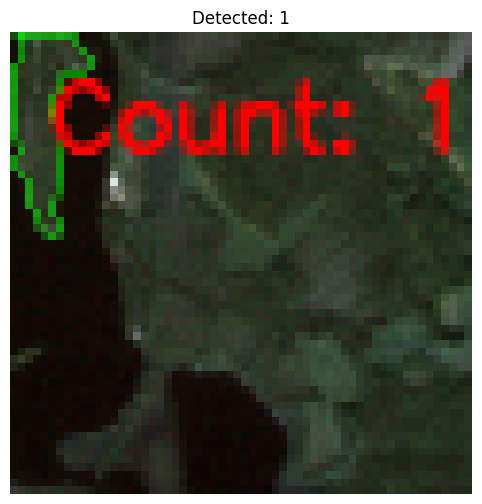

[761/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


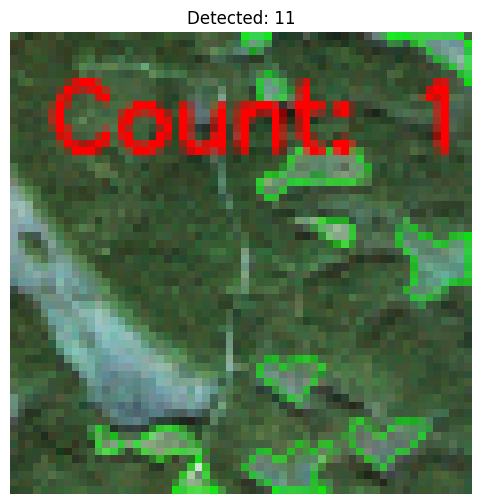

[762/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


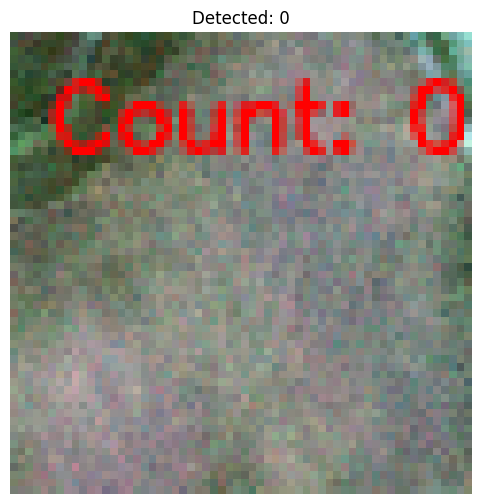

[763/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 24                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


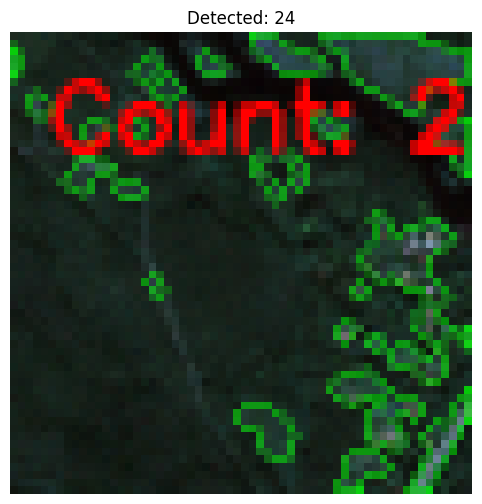

[764/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


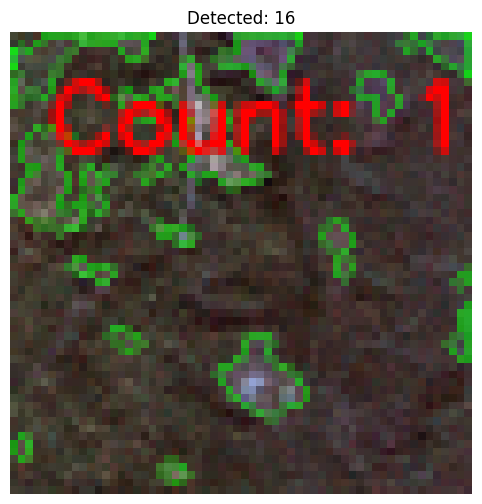

[765/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


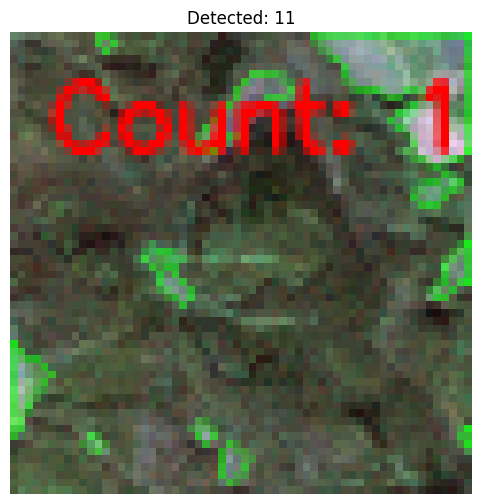

[766/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


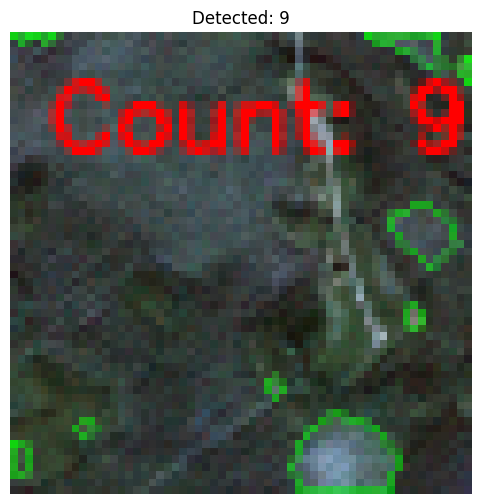

[767/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


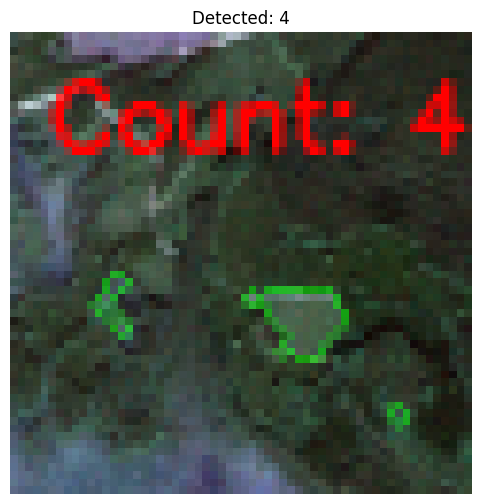

[768/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


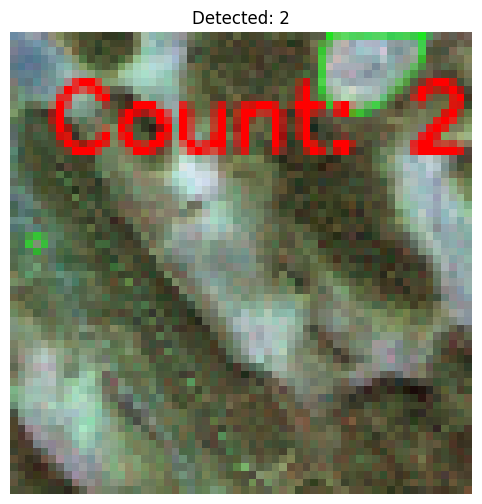

[769/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


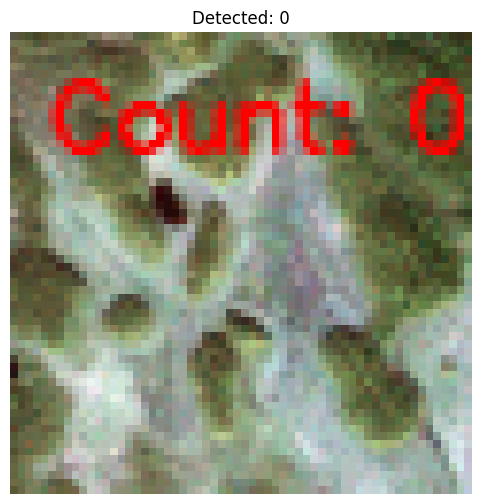

[770/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


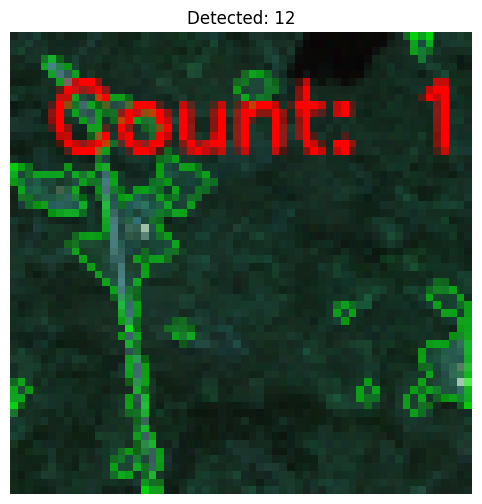

[771/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


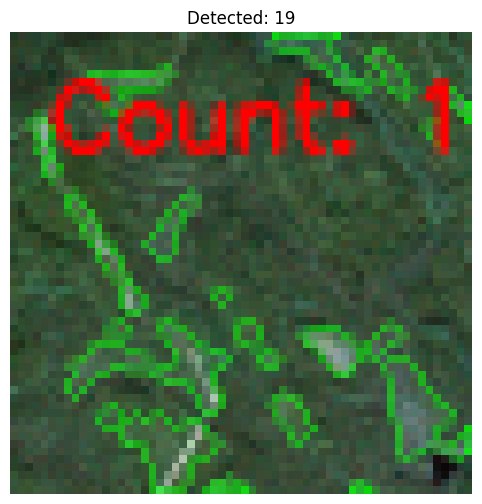

[772/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


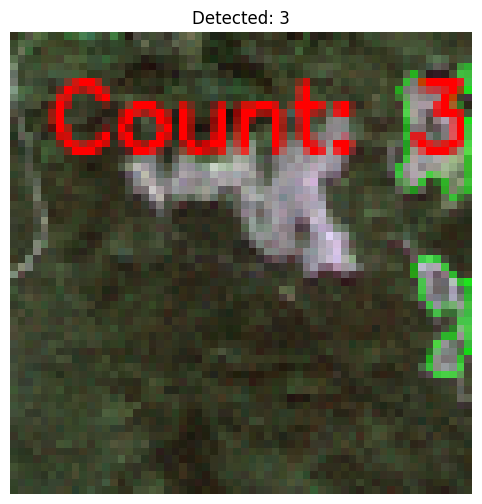

[773/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


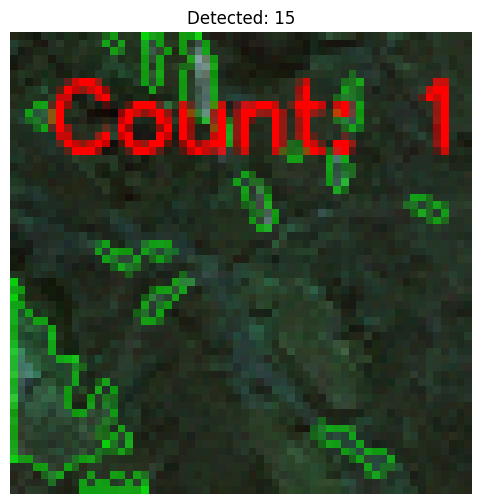

[774/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


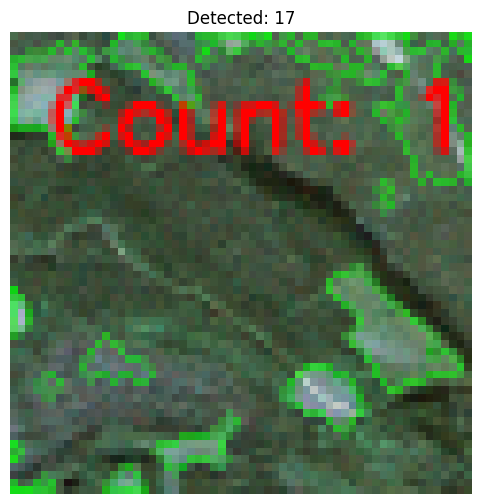

[775/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


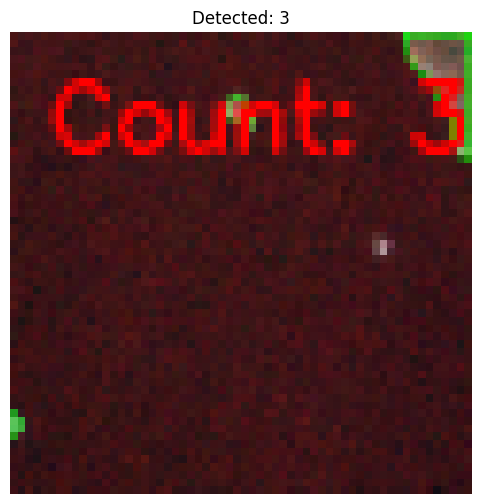

[776/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


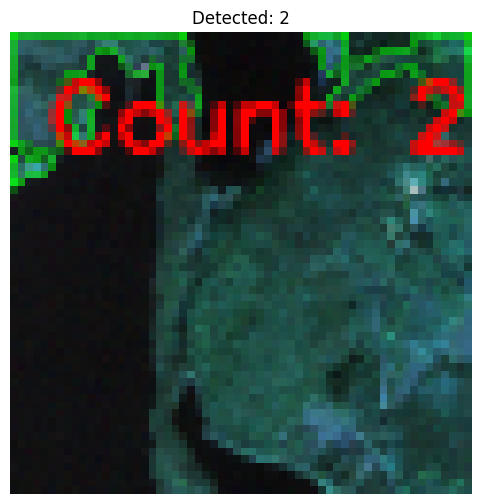

[777/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


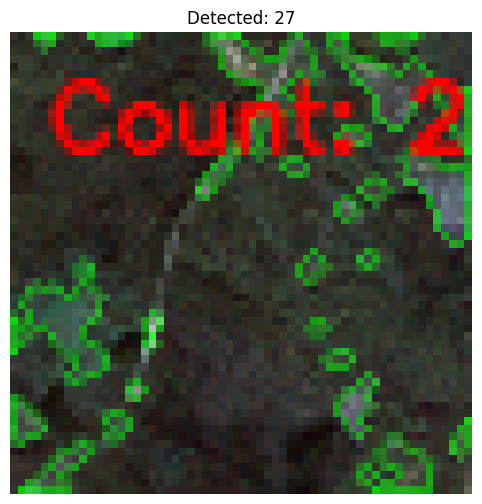

[778/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


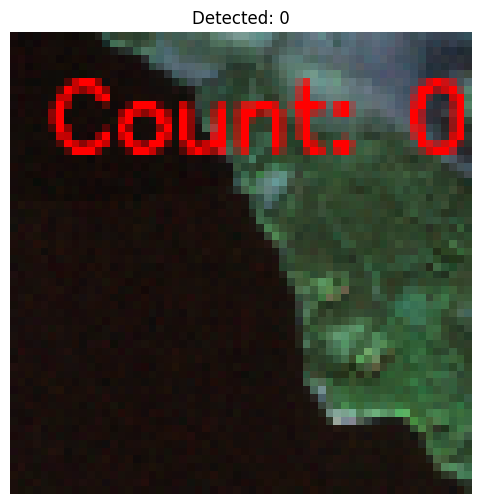

[779/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


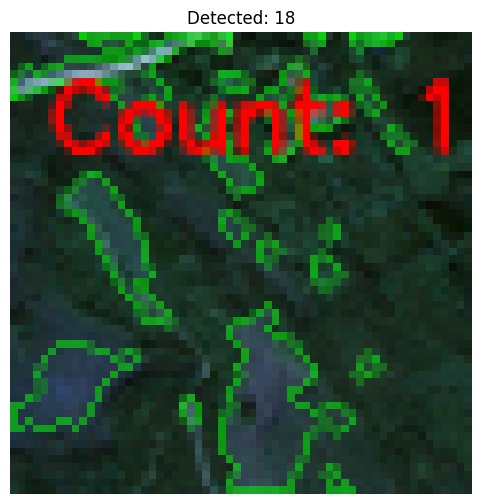

[780/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


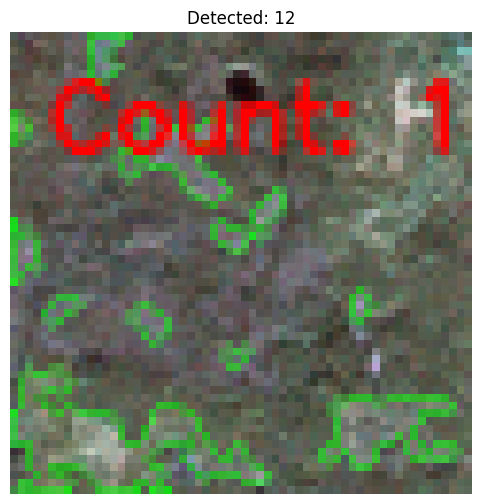

[781/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


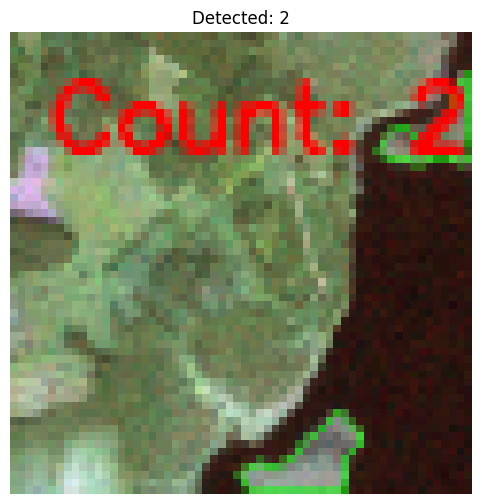

[782/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


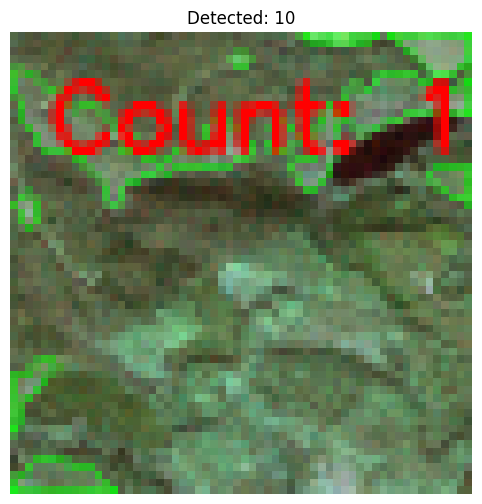

[783/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


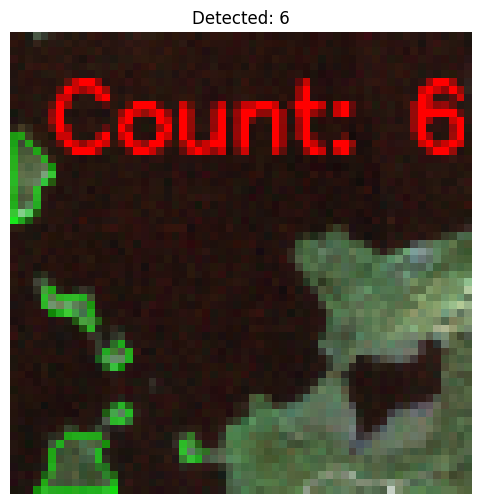

[784/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


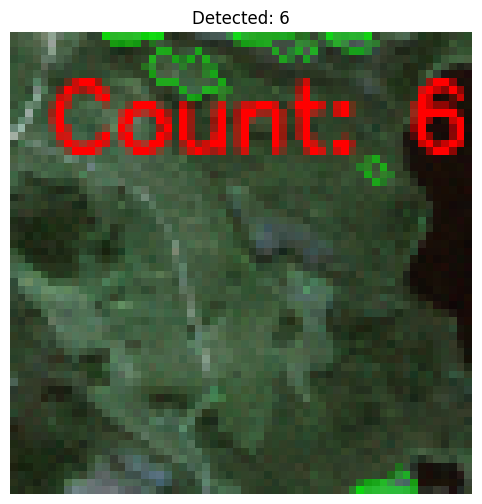

[785/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


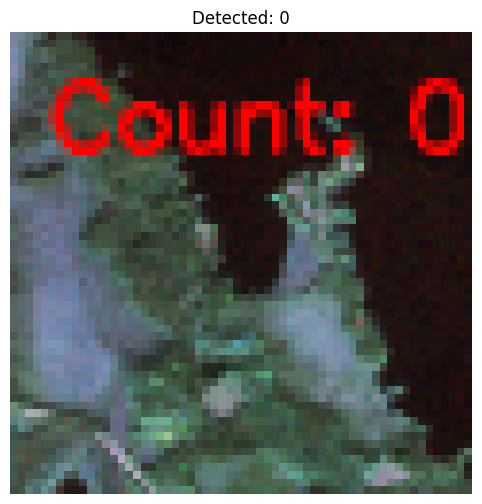

[786/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


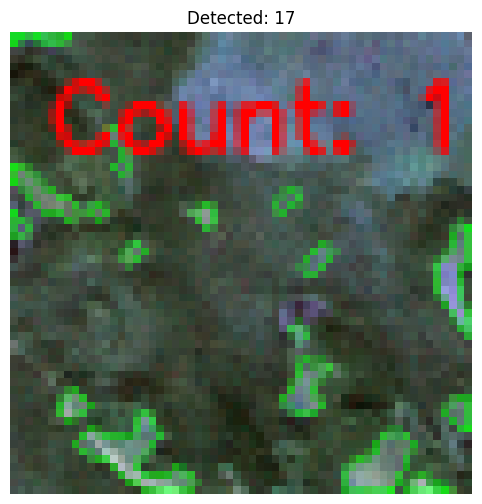

[787/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


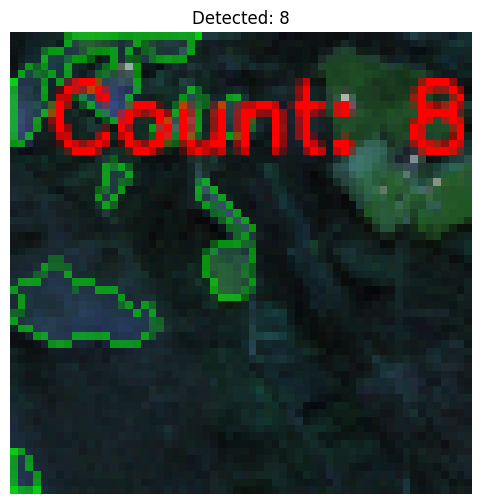

[788/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


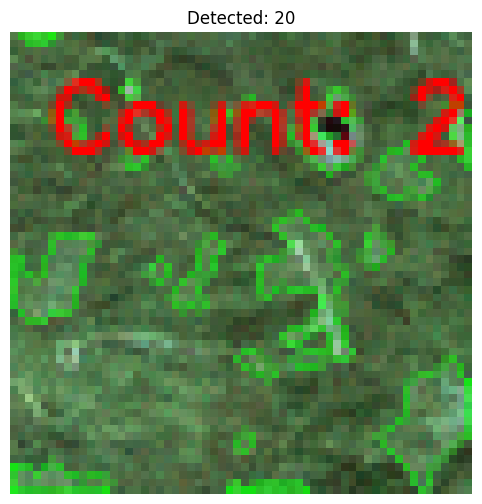

[789/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


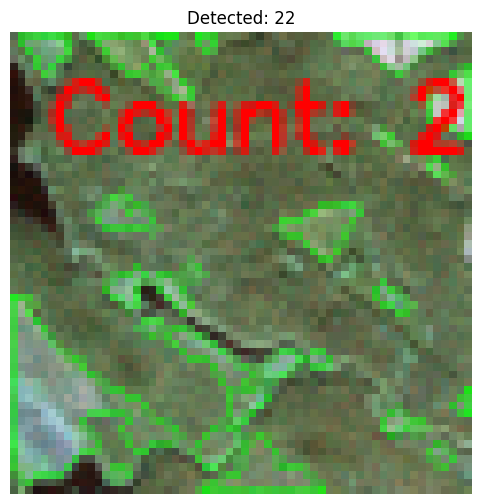

[790/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


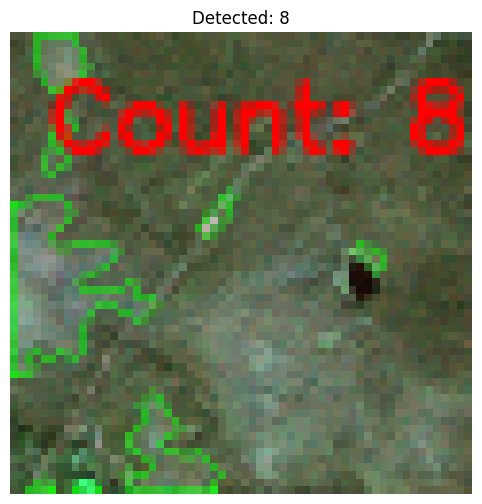

[791/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


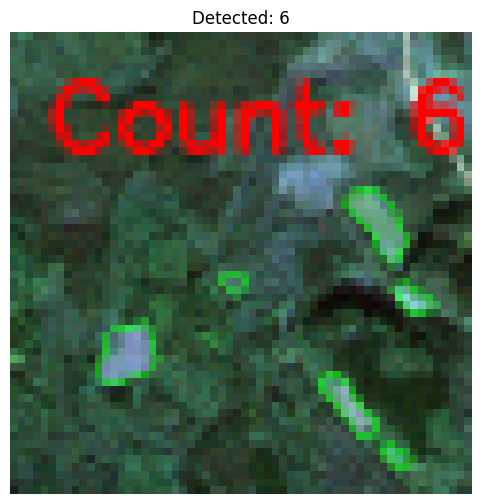

[792/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


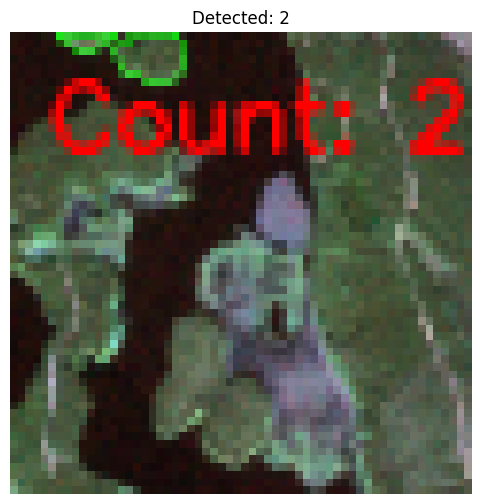

[793/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


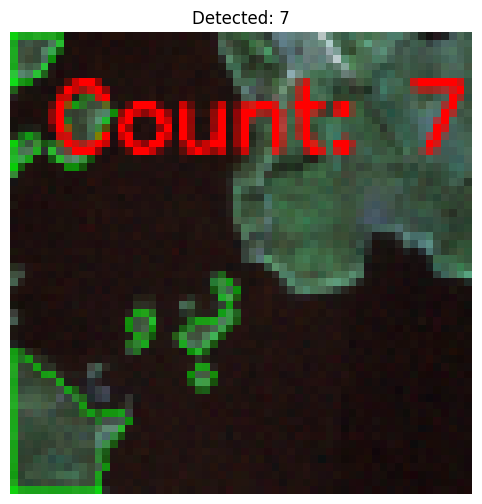

[794/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


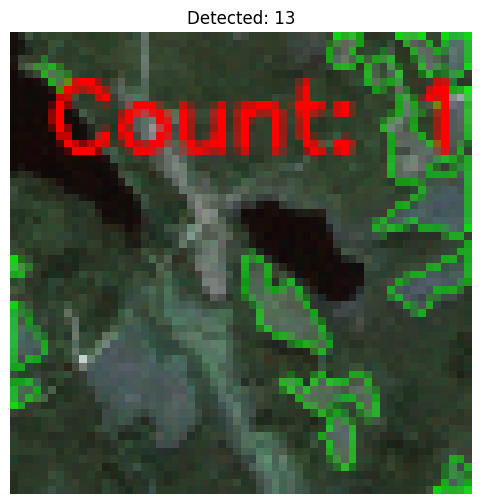

[795/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


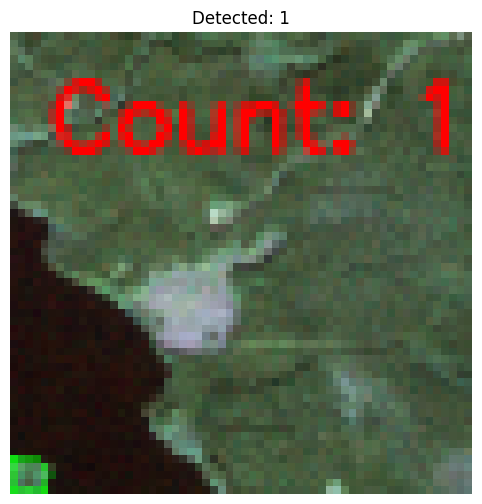

[796/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


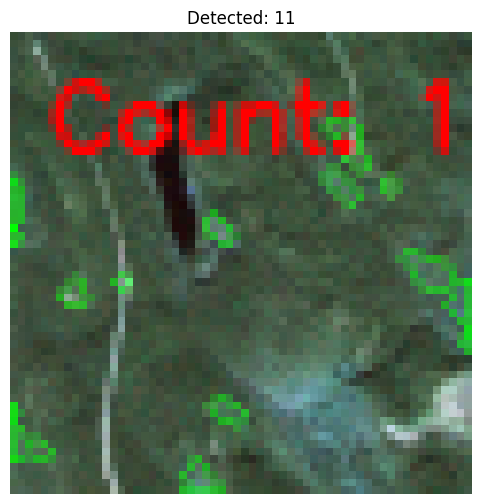

[797/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


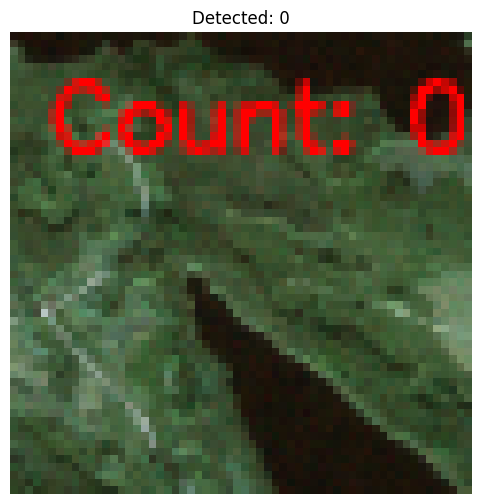

[798/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


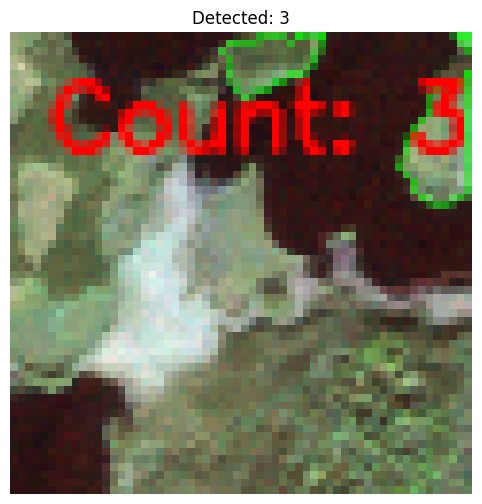

[799/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


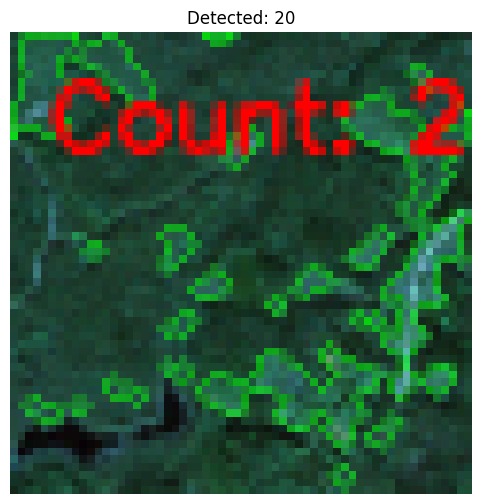

[800/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


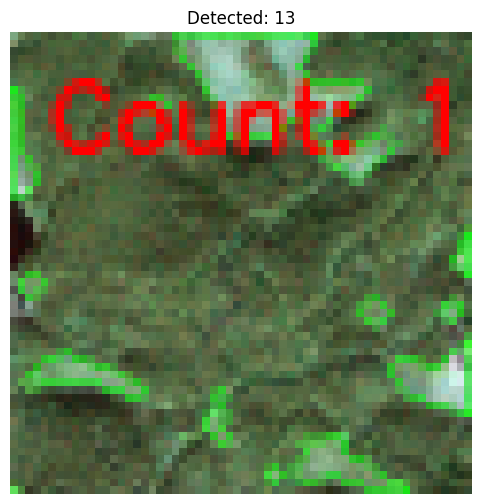

[801/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


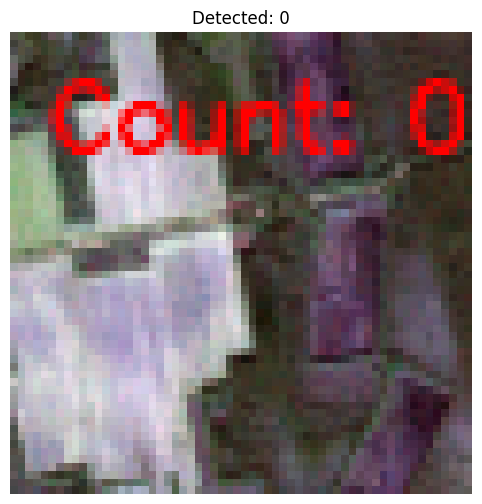

[802/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


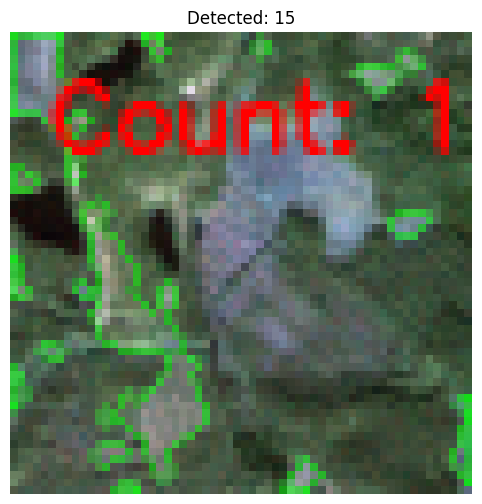

[803/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


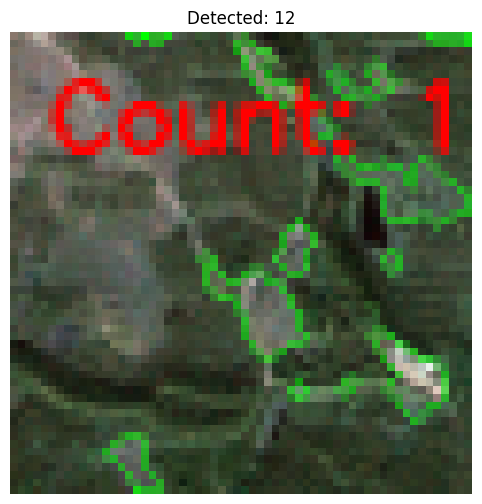

[804/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


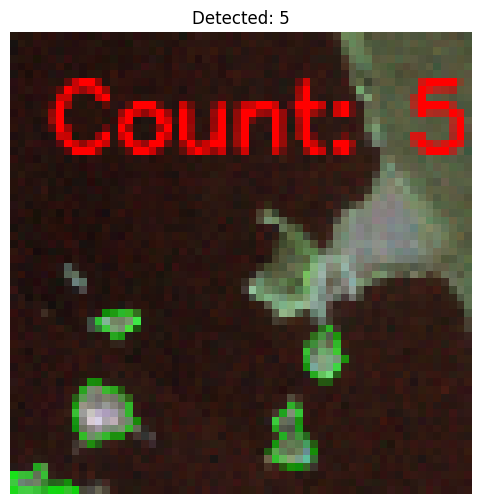

[805/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


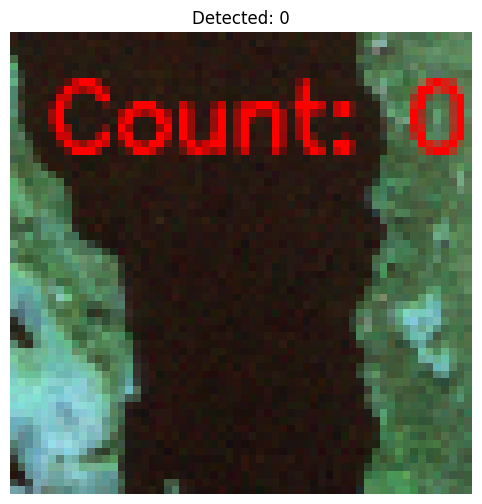

[806/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


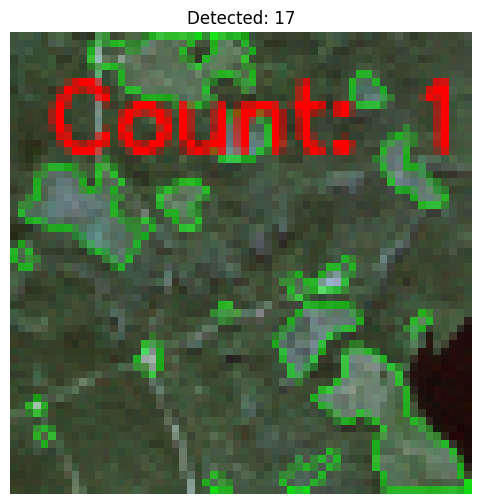

[807/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


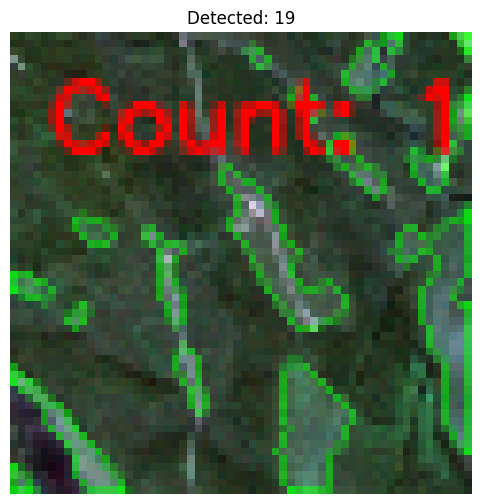

[808/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


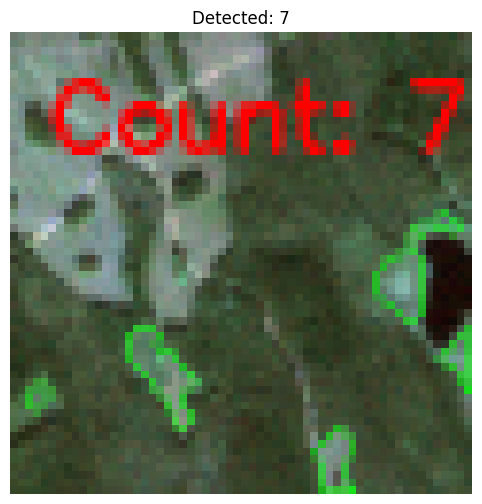

[809/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


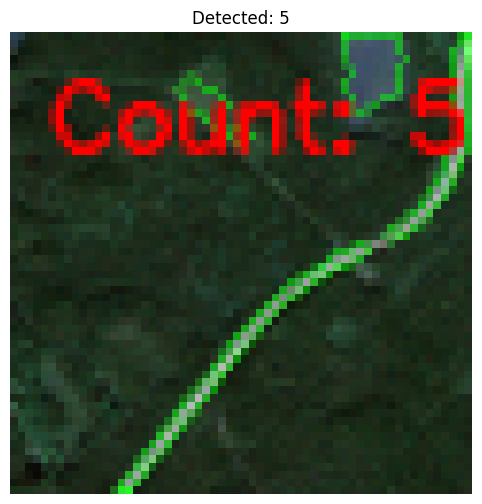

[810/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


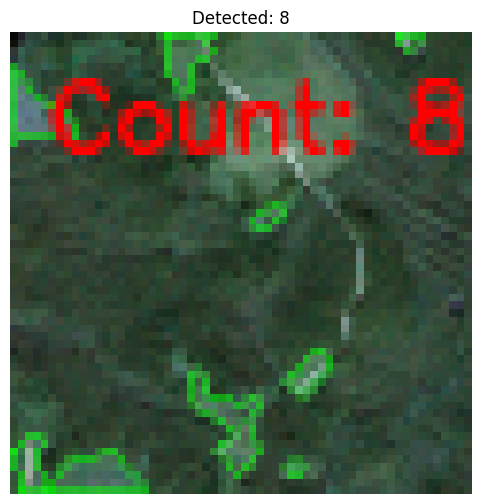

[811/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


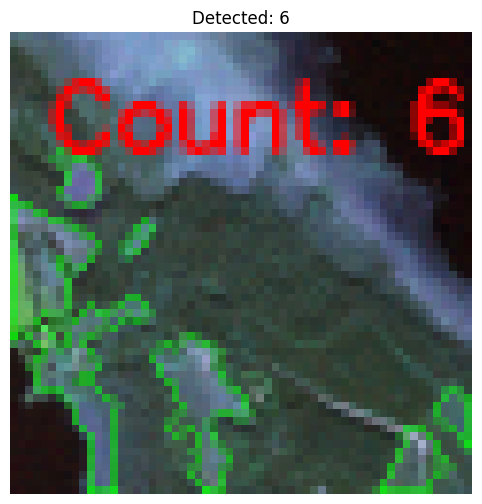

[812/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


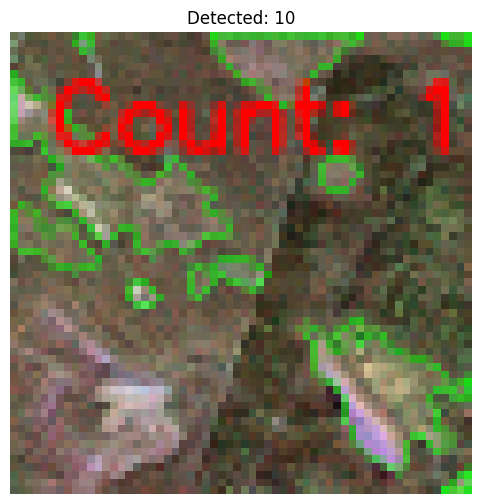

[813/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


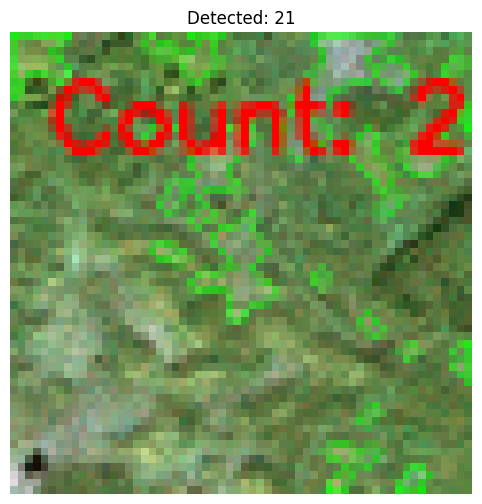

[814/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


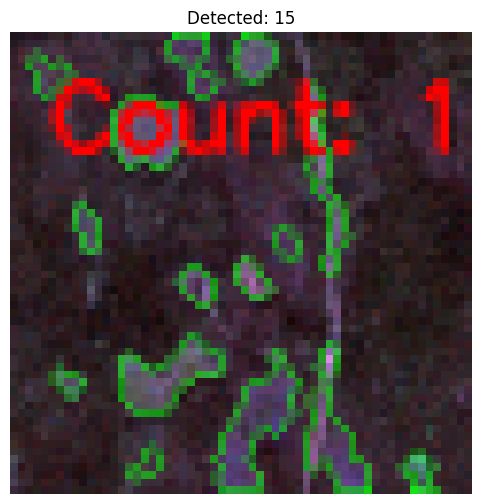

[815/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


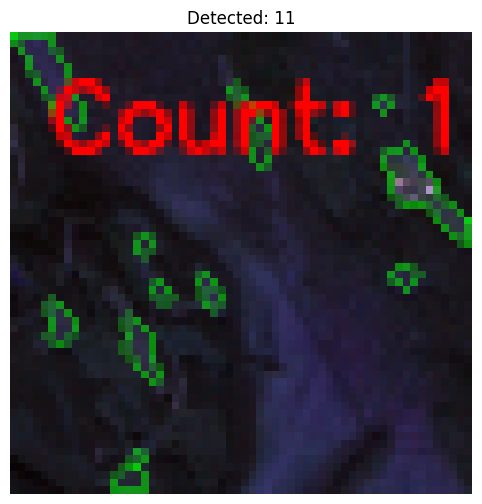

[816/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_14
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_14 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


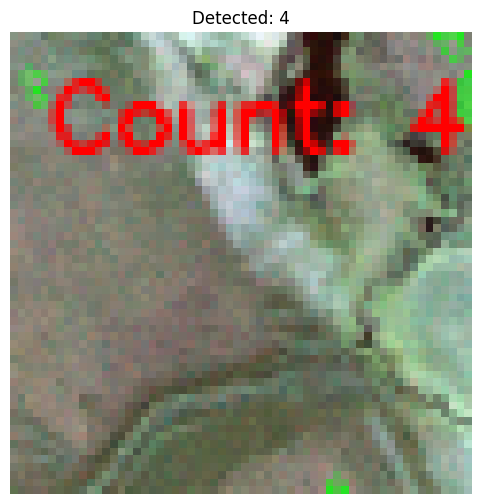

[817/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


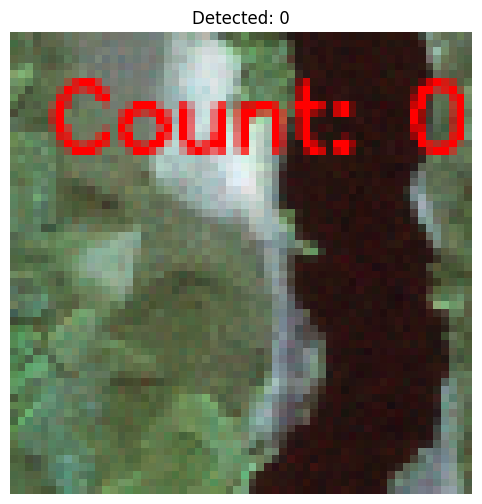

[818/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


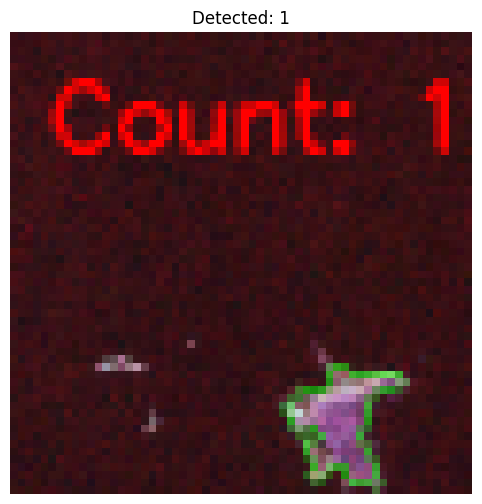

[819/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


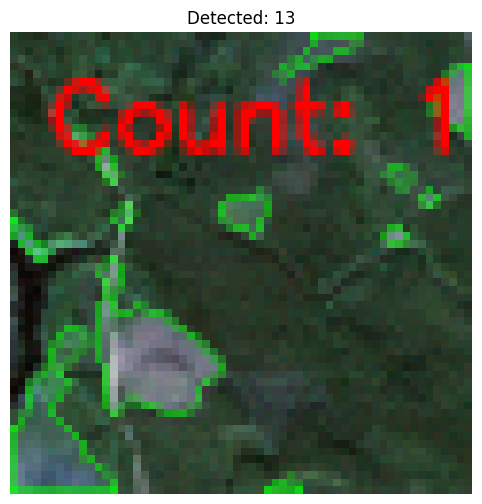

[820/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


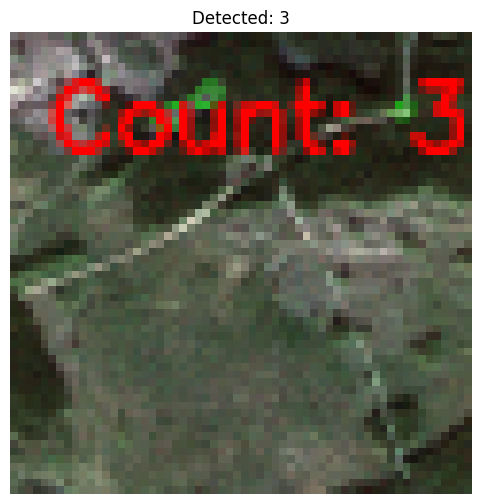

[821/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


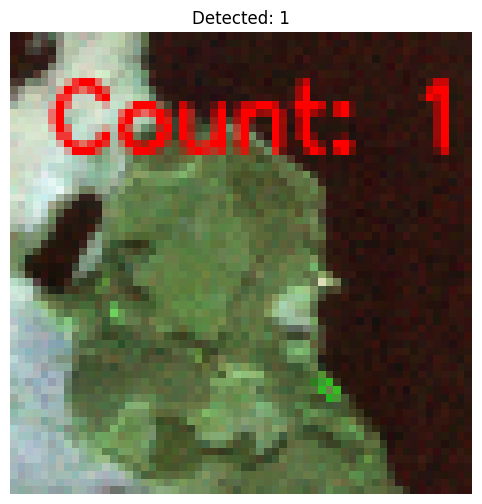

[822/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


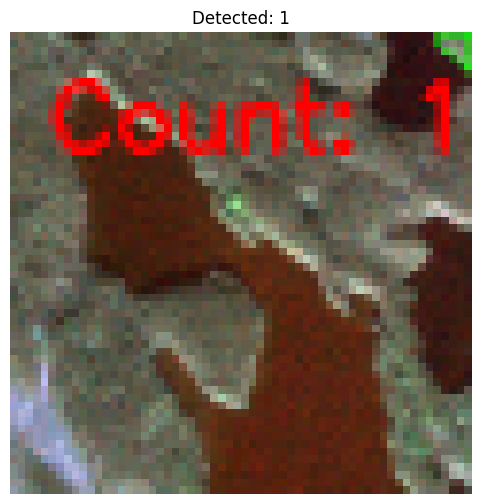

[823/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


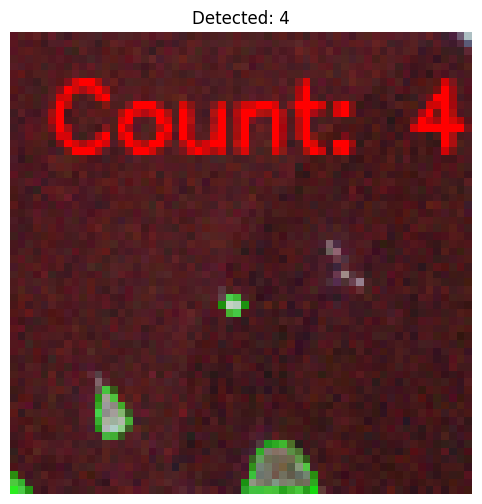

[824/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


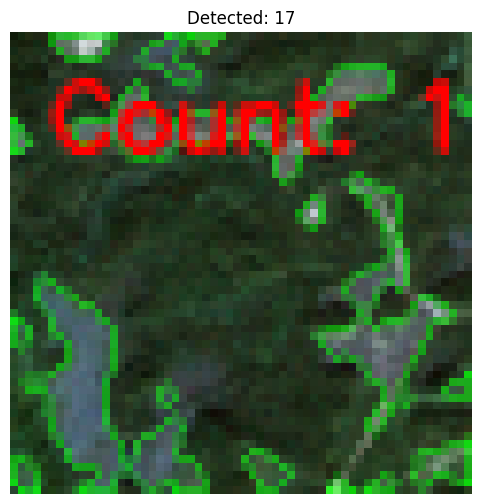

[825/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


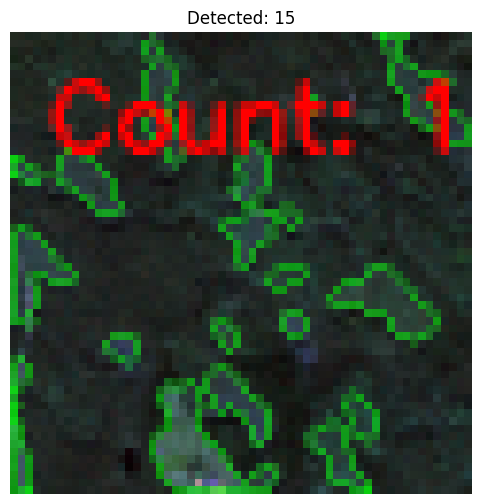

[826/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


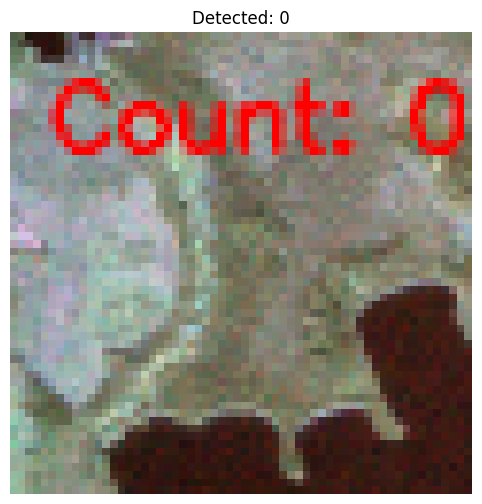

[827/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


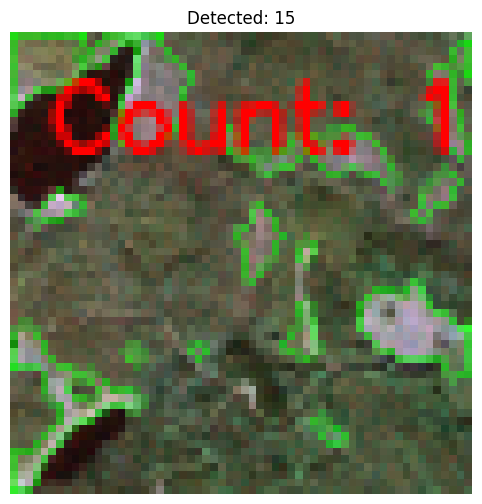

[828/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


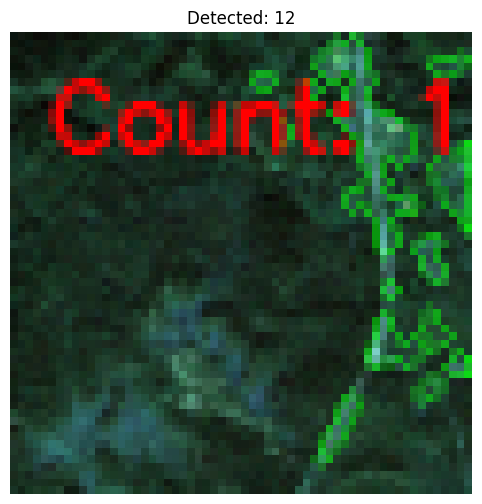

[829/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 23                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


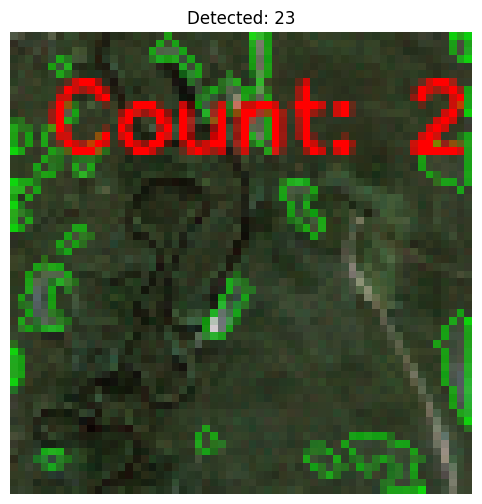

[830/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


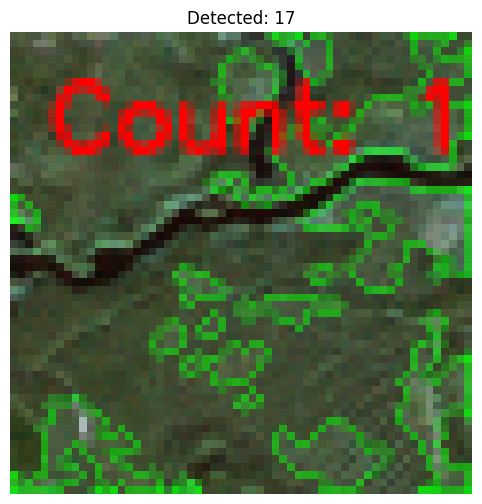

[831/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


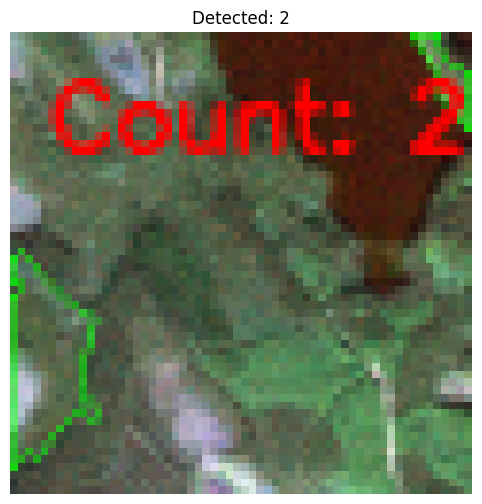

[832/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


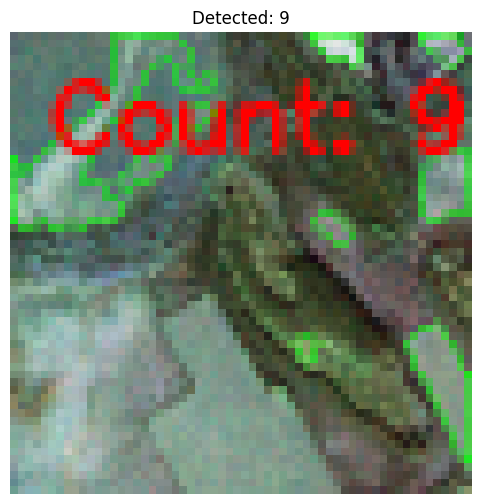

[833/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


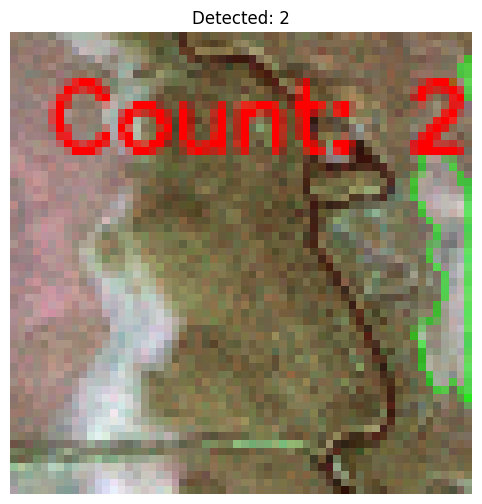

[834/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


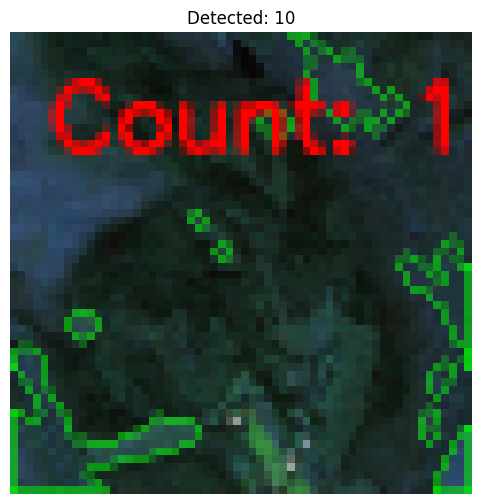

[835/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


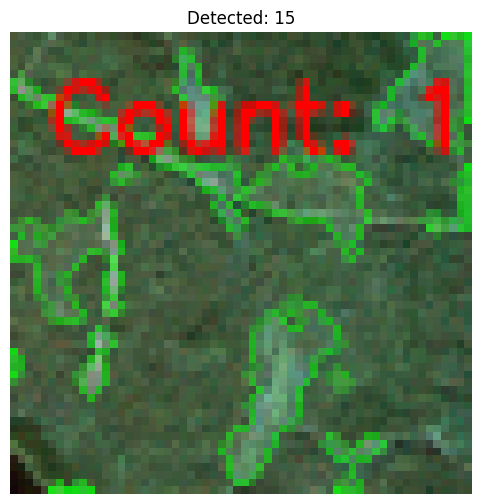

[836/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


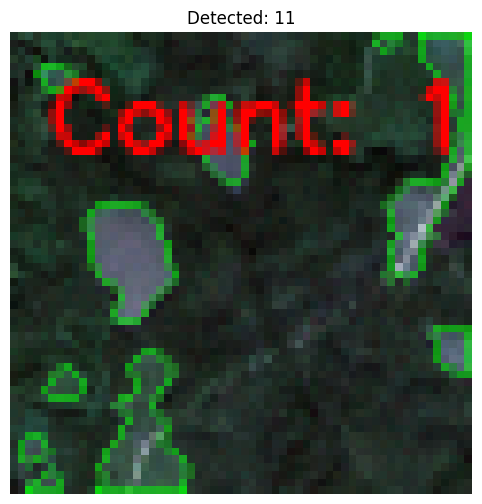

[837/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


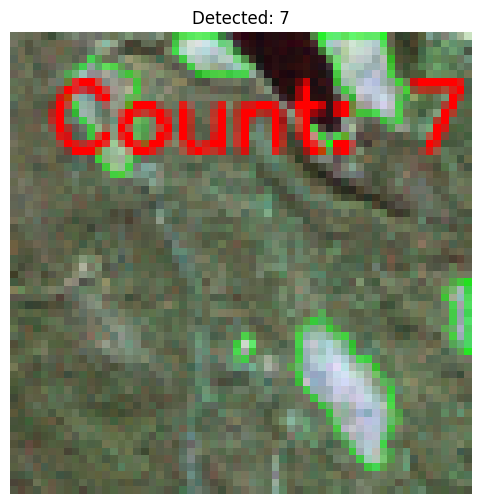

[838/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


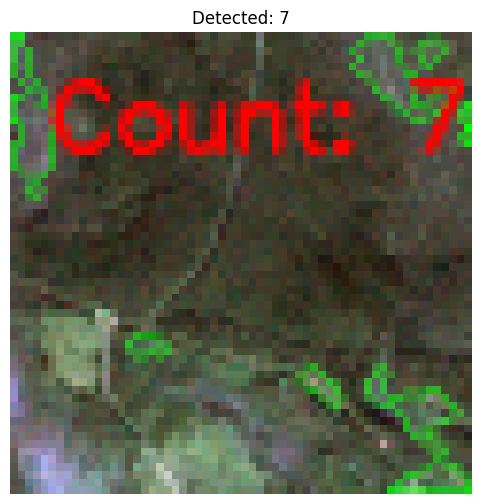

[839/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


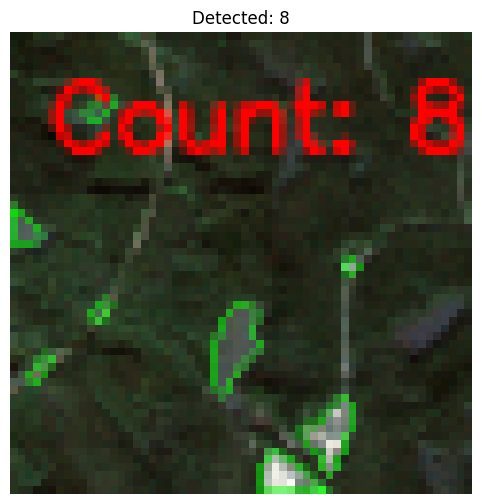

[840/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


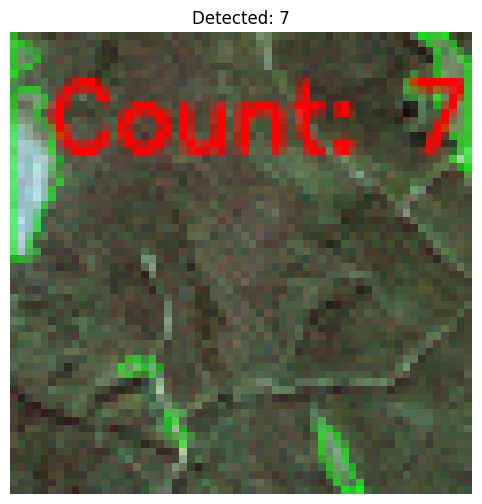

[841/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


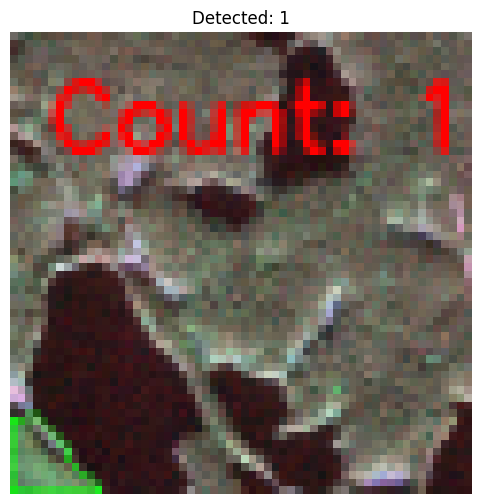

[842/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


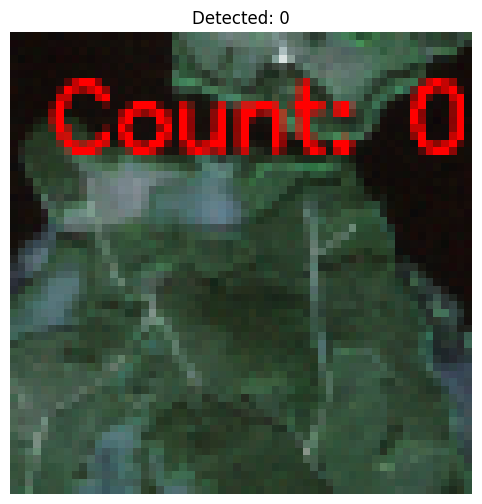

[843/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


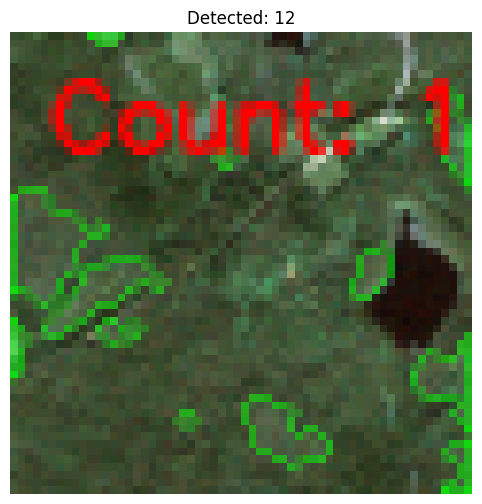

[844/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


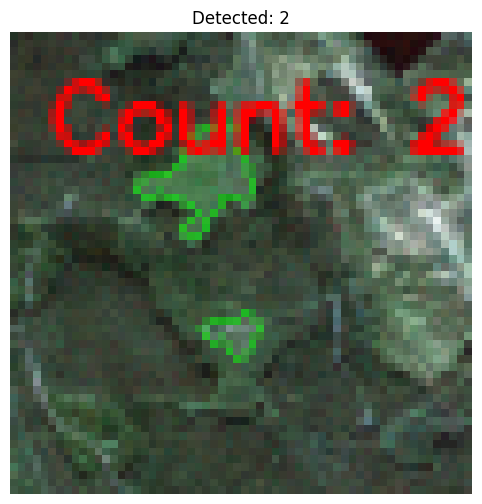

[845/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


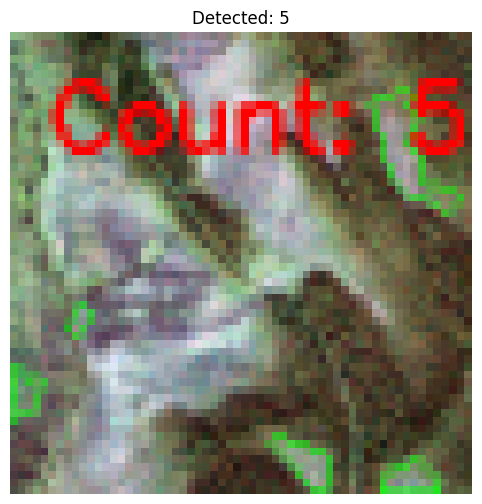

[846/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


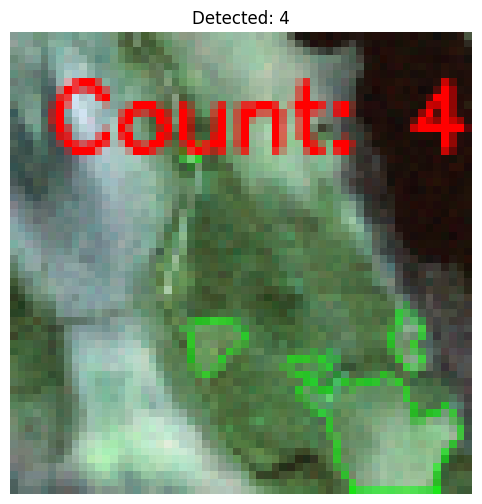

[847/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


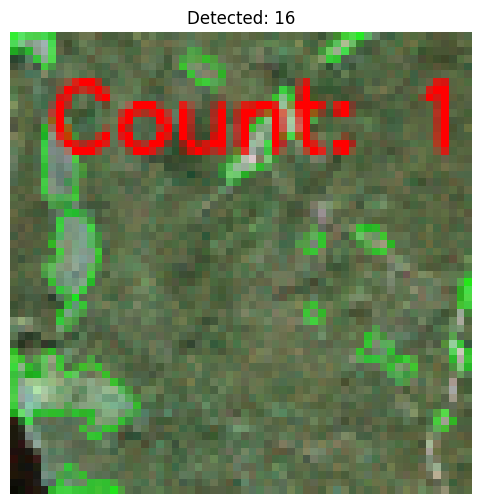

[848/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


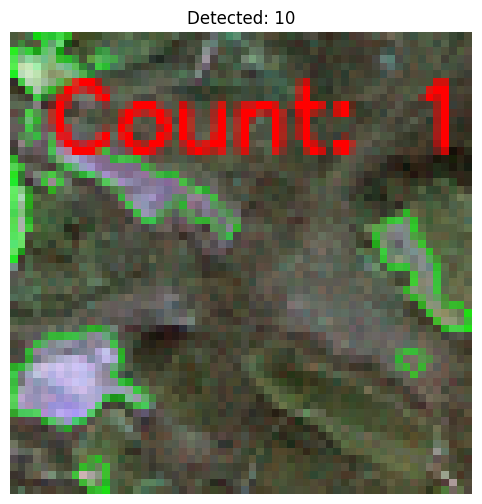

[849/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


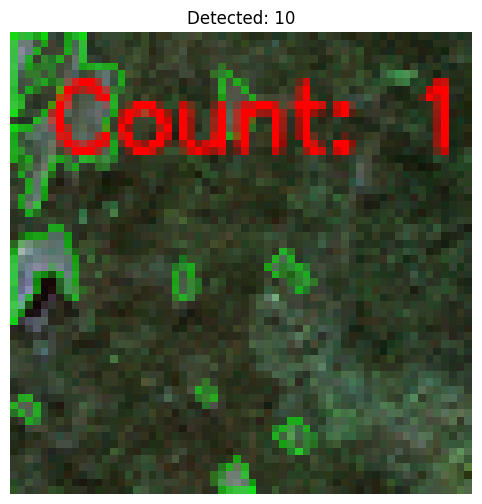

[850/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


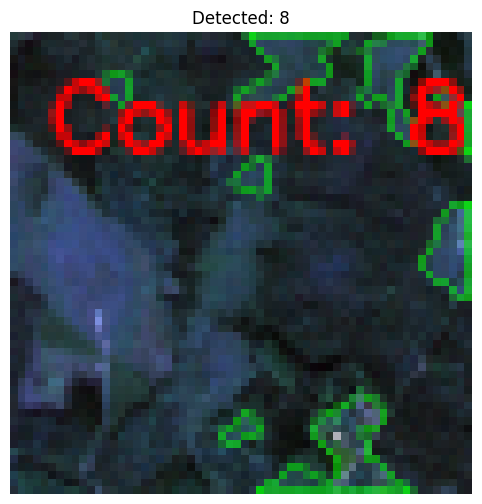

[851/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


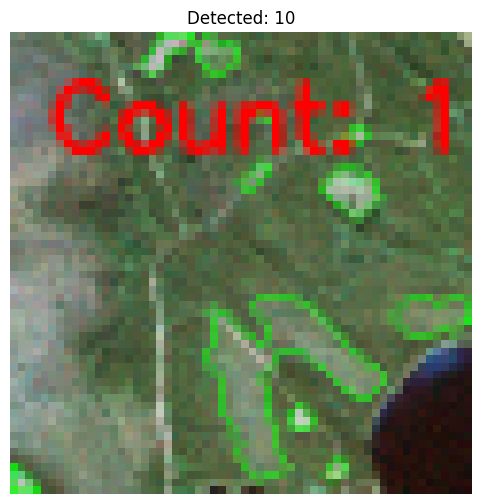

[852/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


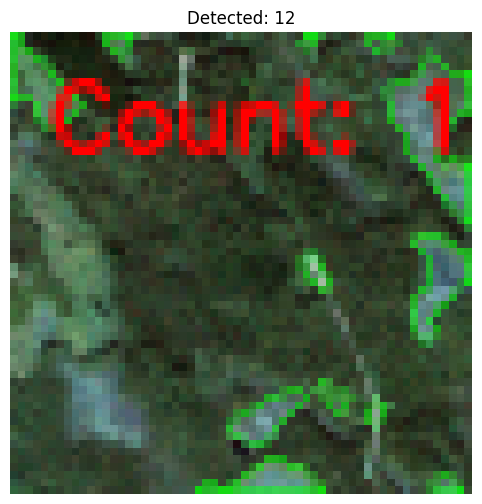

[853/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


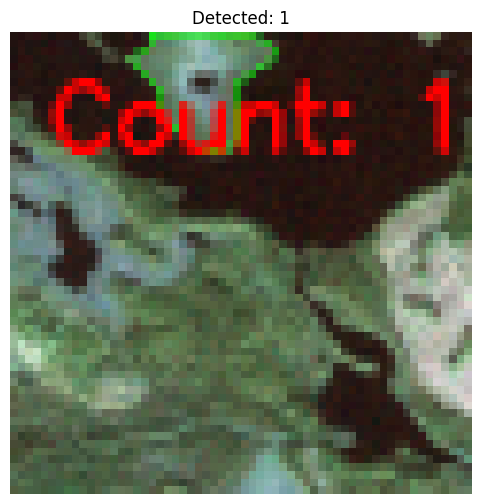

[854/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


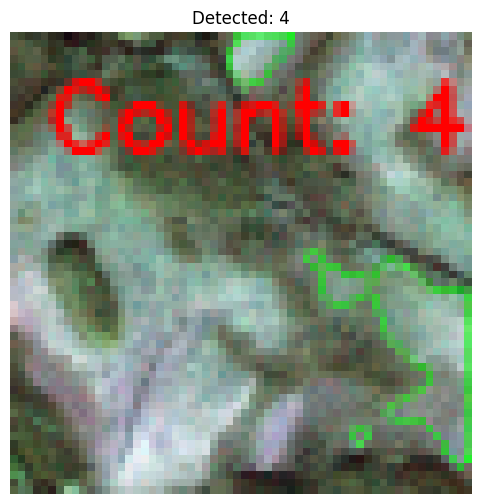

[855/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


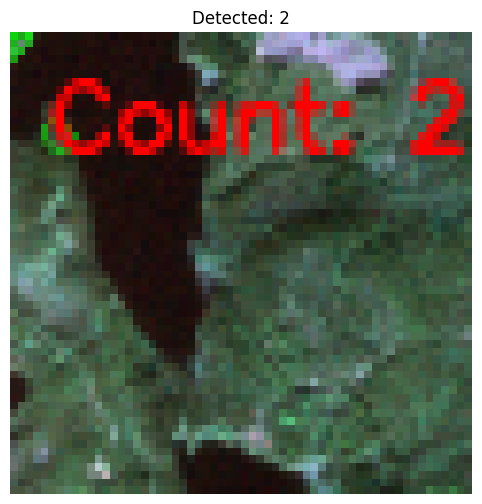

[856/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


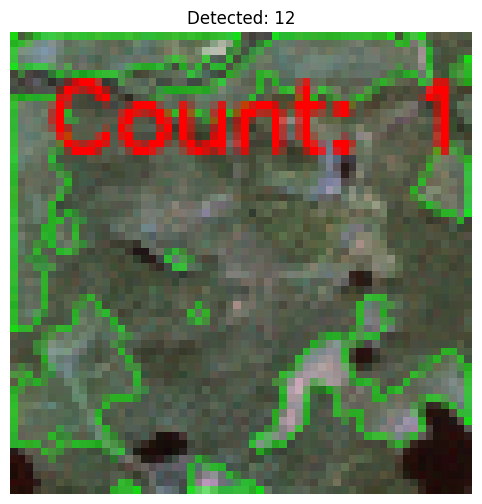

[857/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


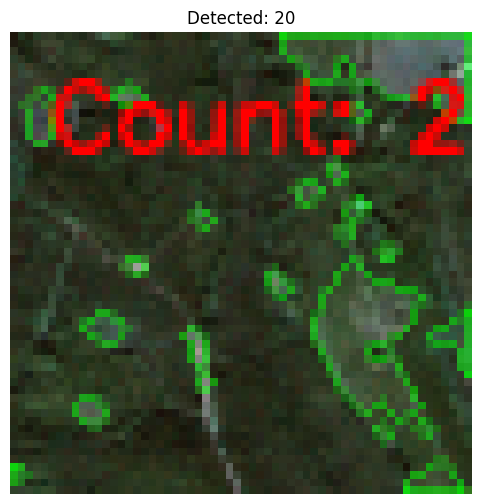

[858/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


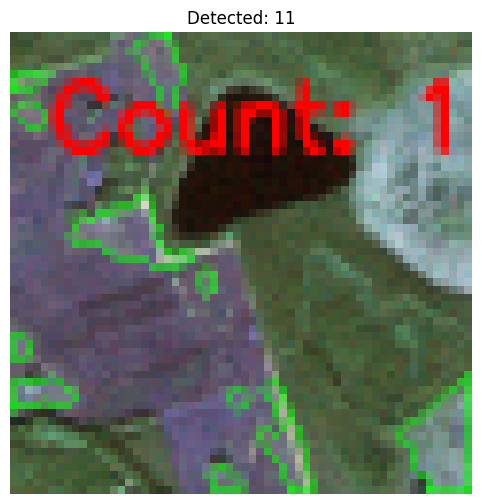

[859/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


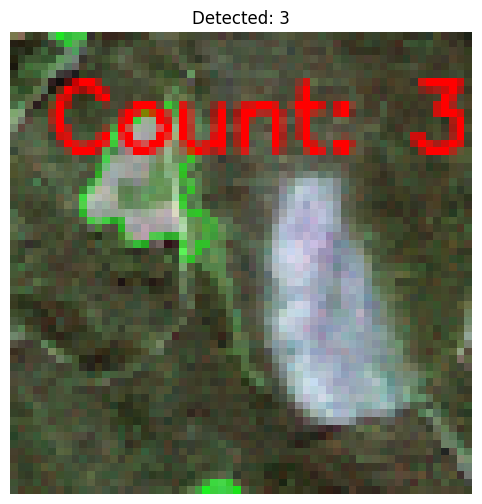

[860/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


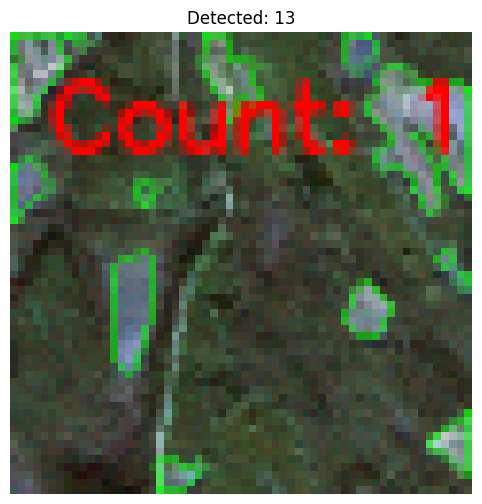

[861/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


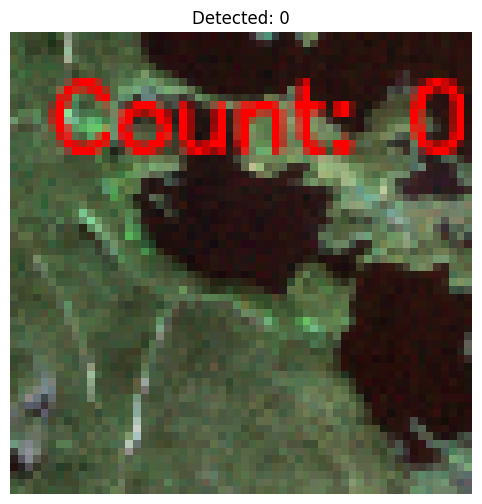

[862/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


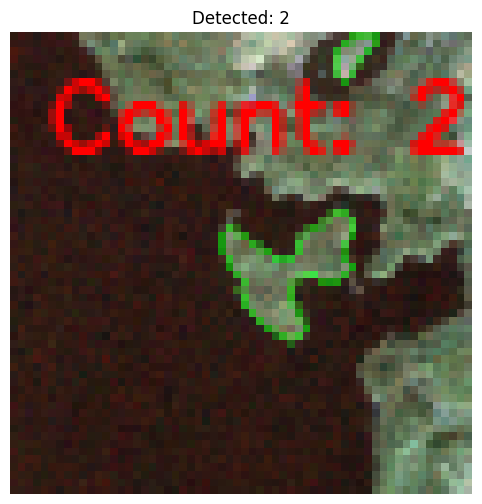

[863/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


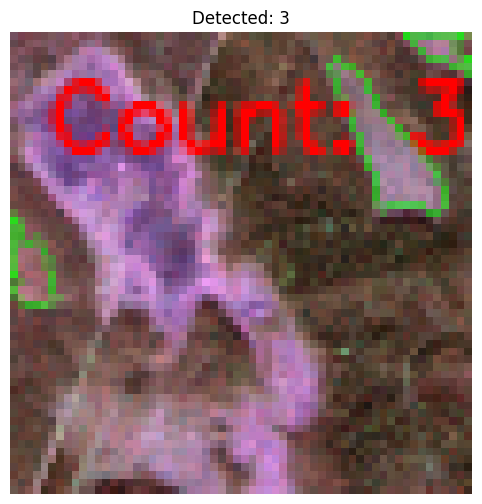

[864/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


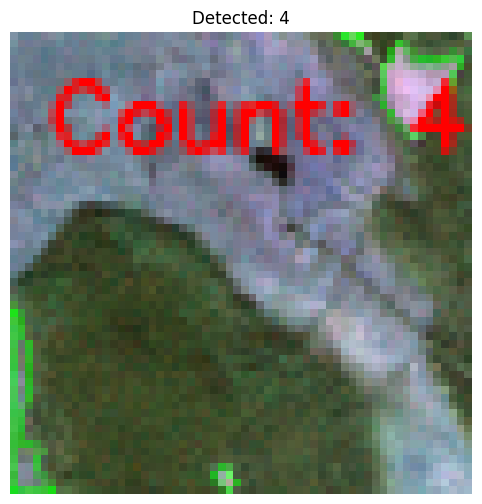

[865/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


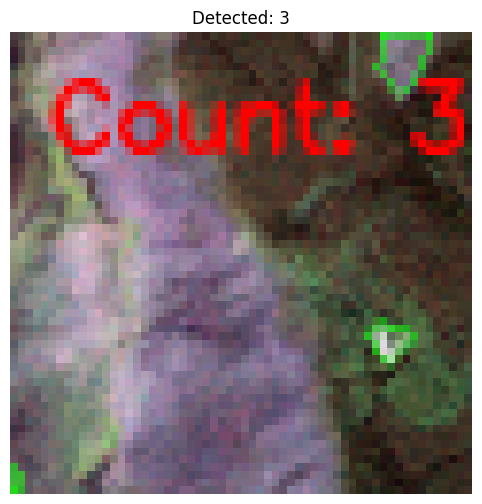

[866/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_18_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


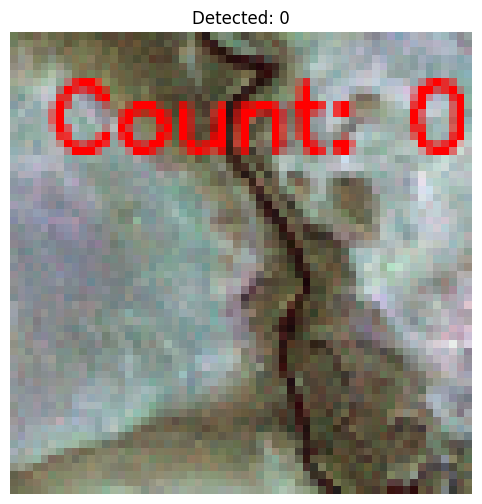

[867/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


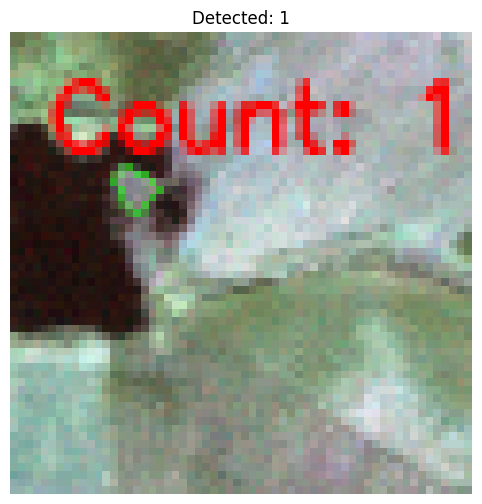

[868/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


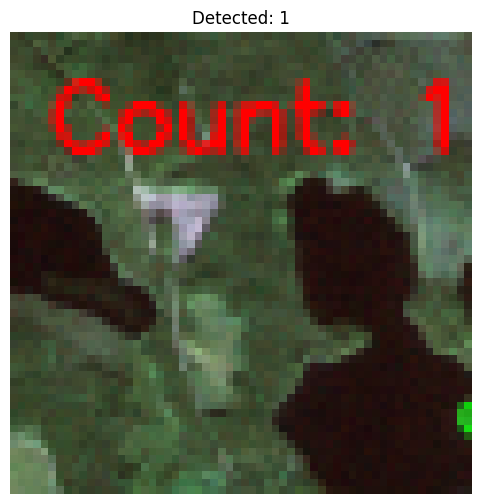

[869/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


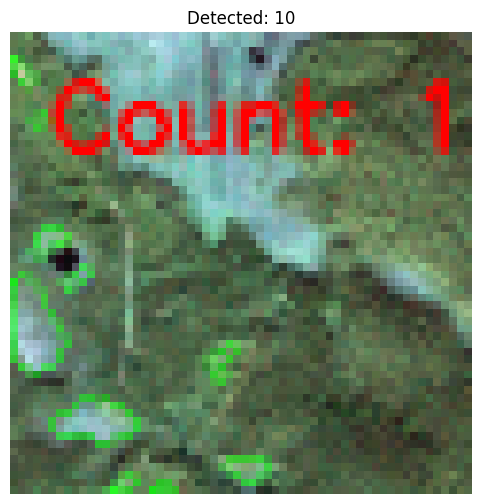

[870/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


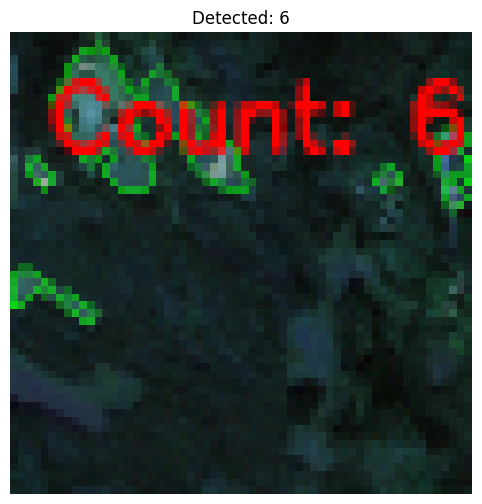

[871/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


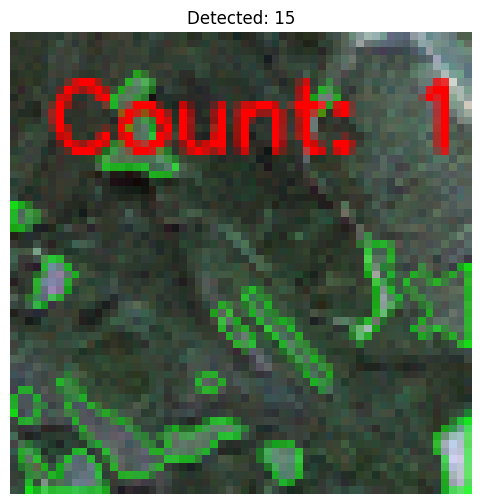

[872/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_36
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_36 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


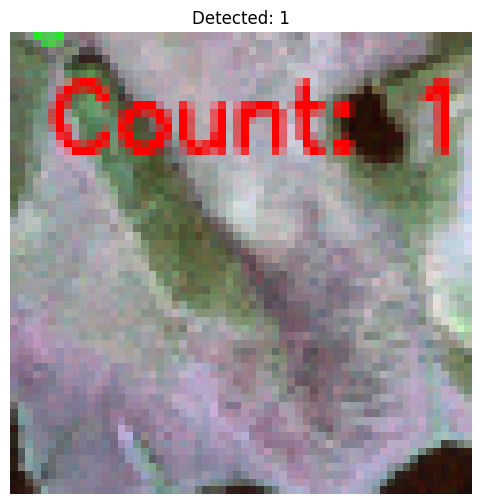

[873/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


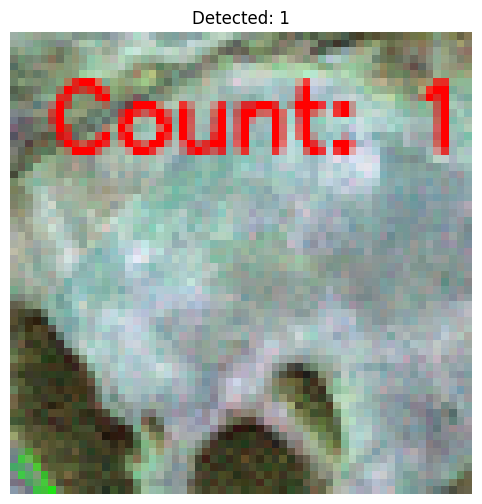

[874/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


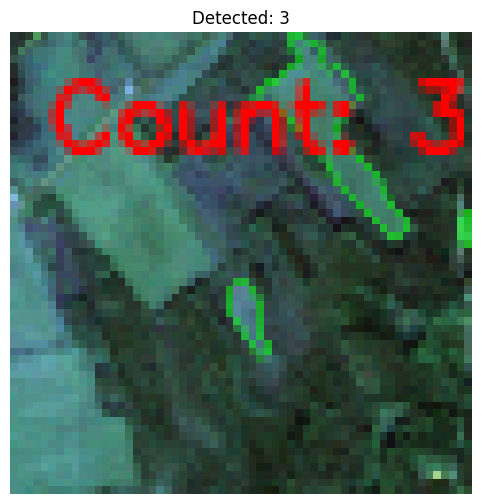

[875/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


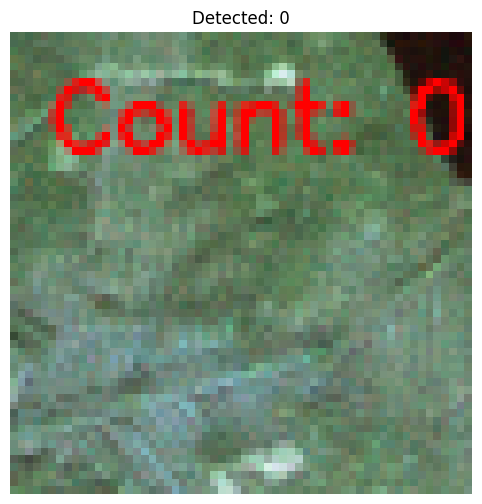

[876/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


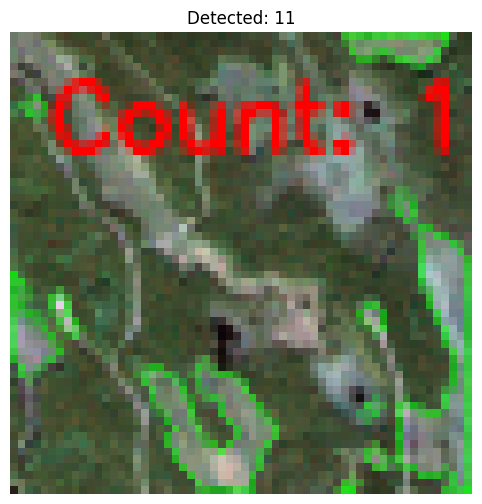

[877/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


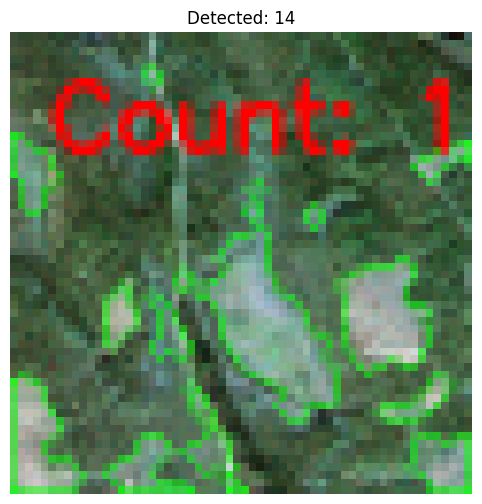

[878/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


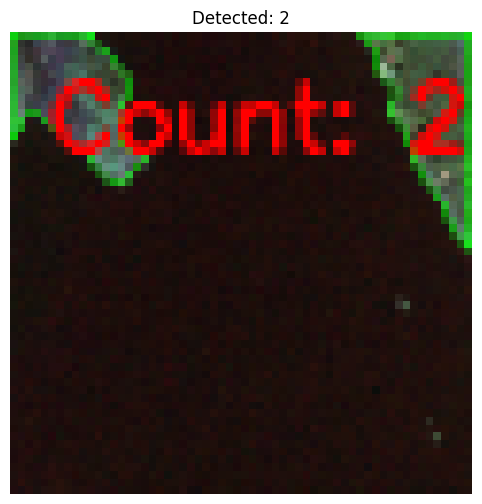

[879/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


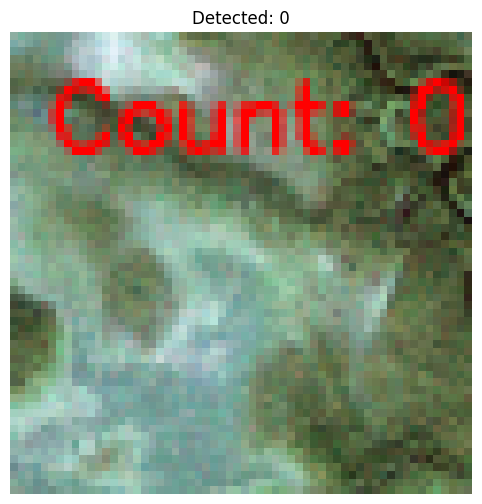

[880/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


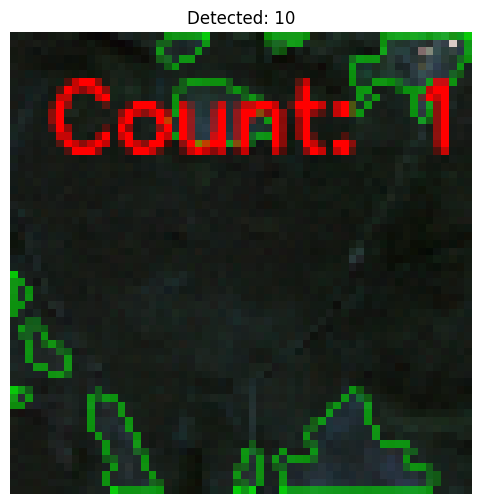

[881/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


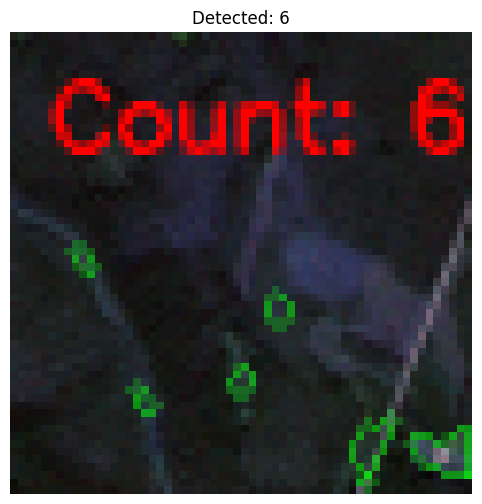

[882/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_10
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_10 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


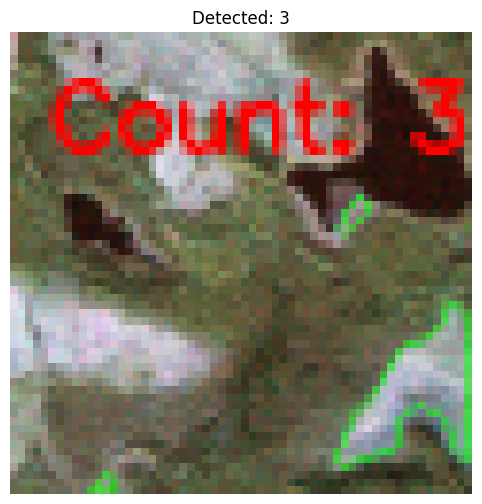

[883/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


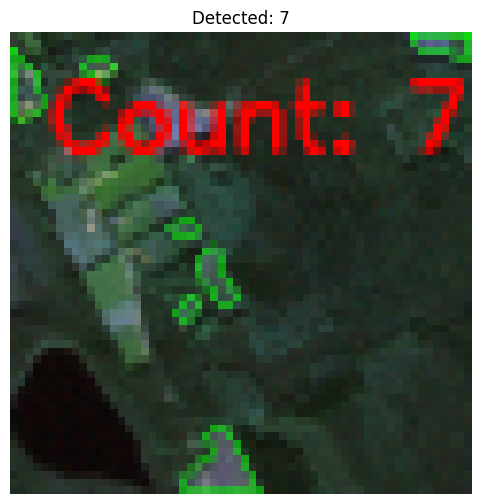

[884/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


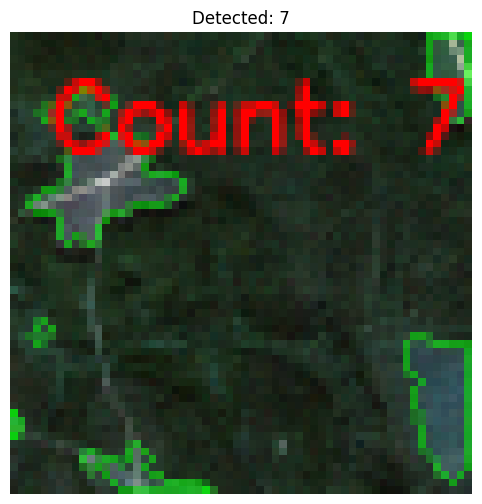

[885/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


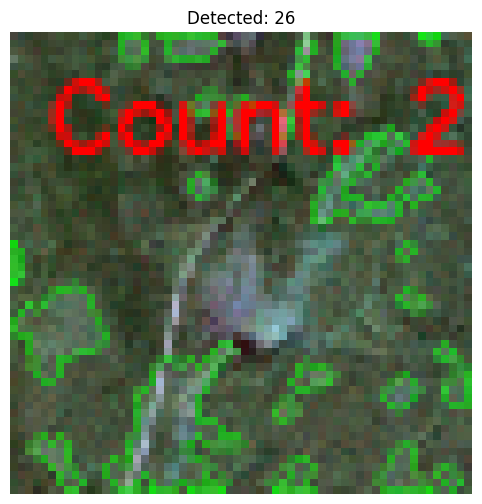

[886/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


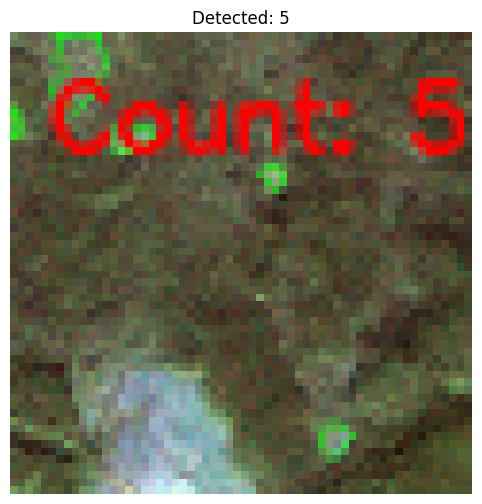

[887/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


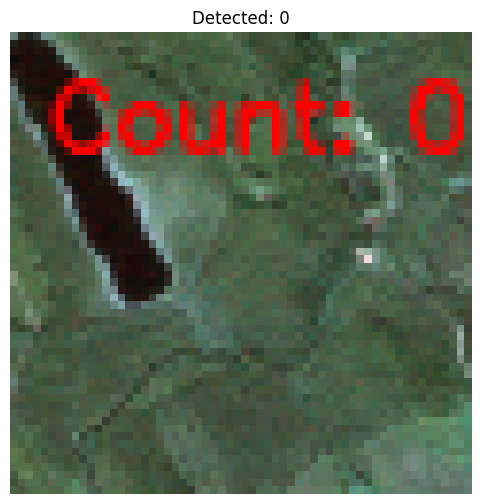

[888/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


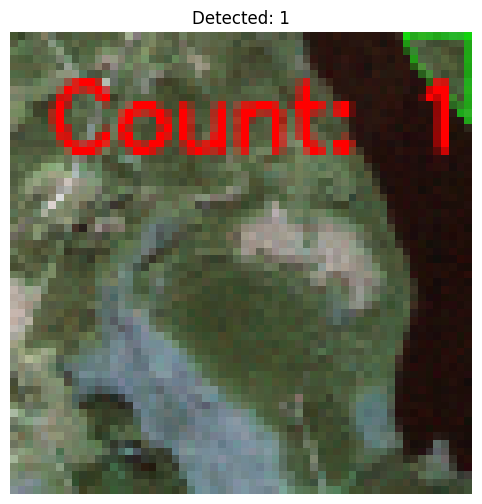

[889/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


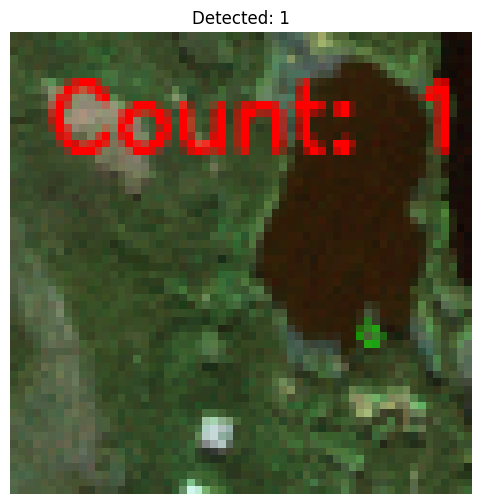

[890/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


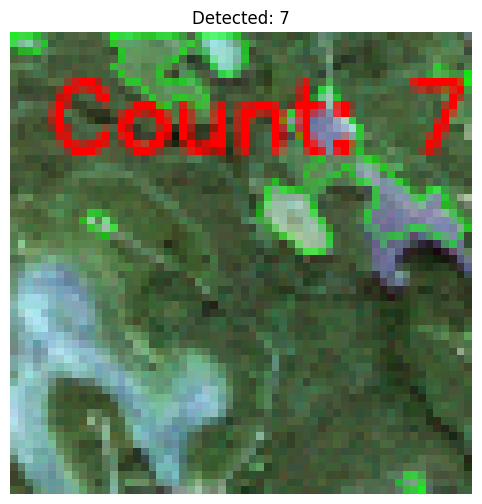

[891/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


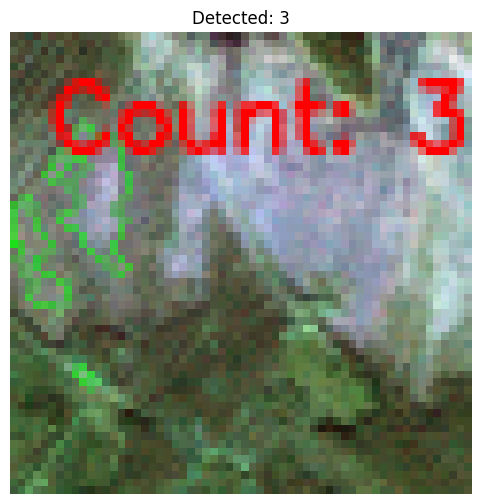

[892/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


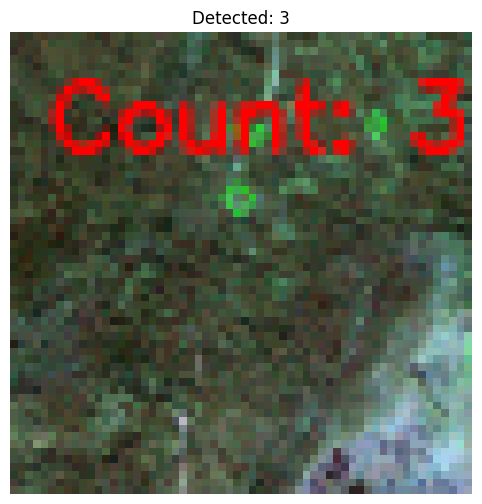

[893/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


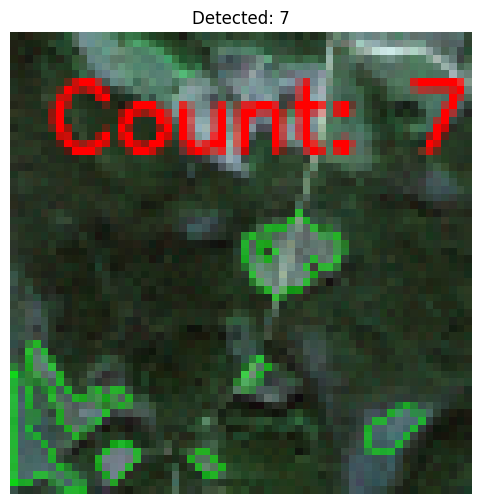

[894/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


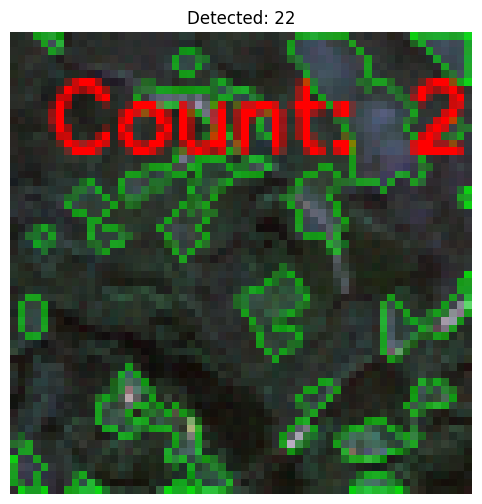

[895/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


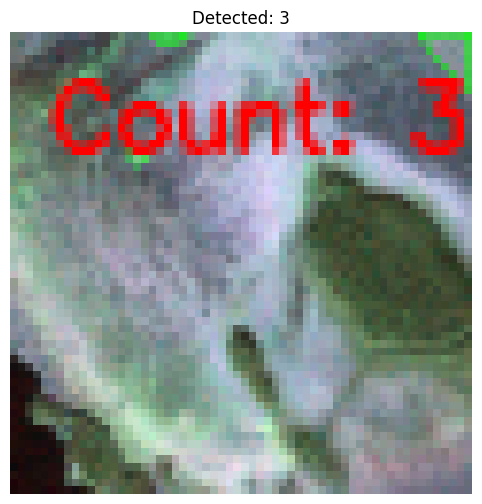

[896/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


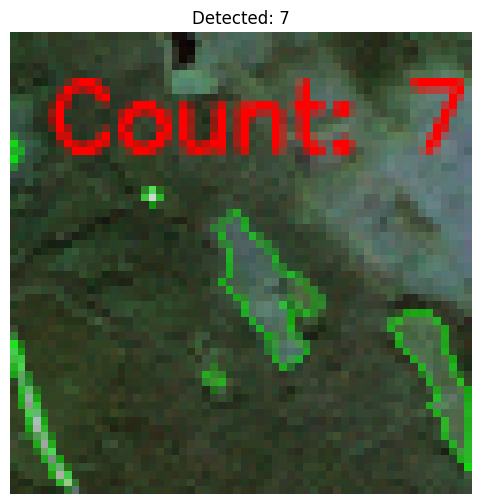

[897/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


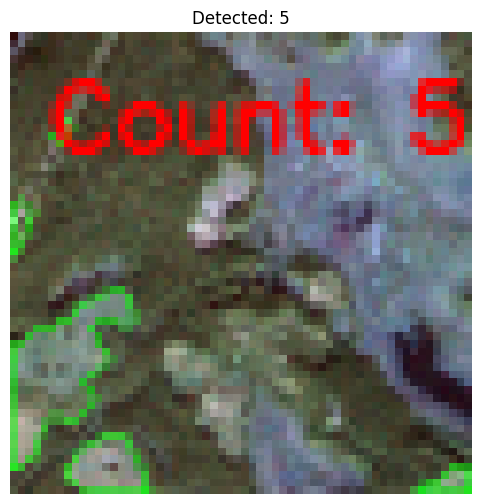

[898/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


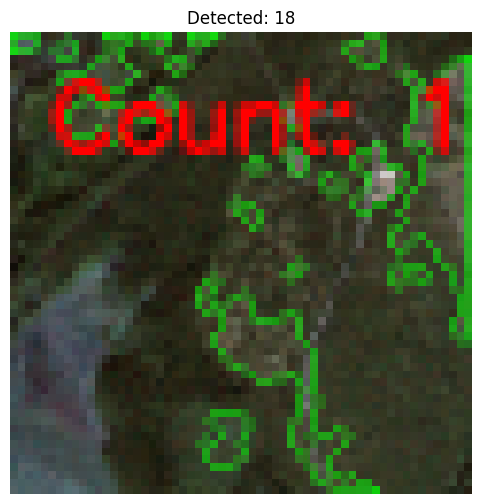

[899/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


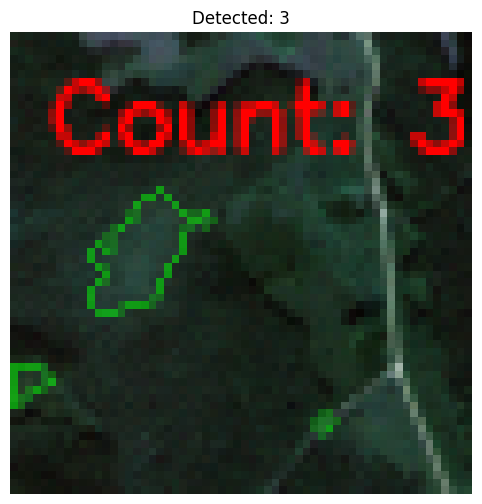

[900/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


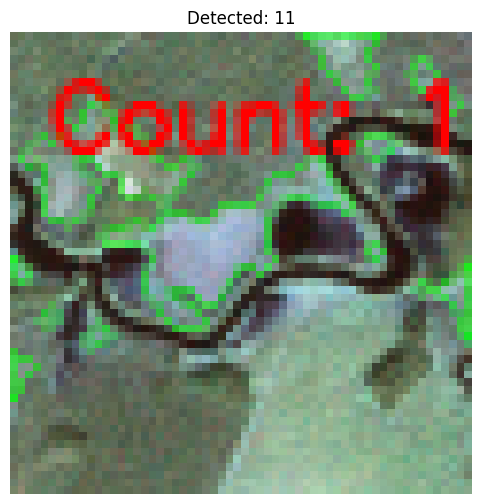

[901/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


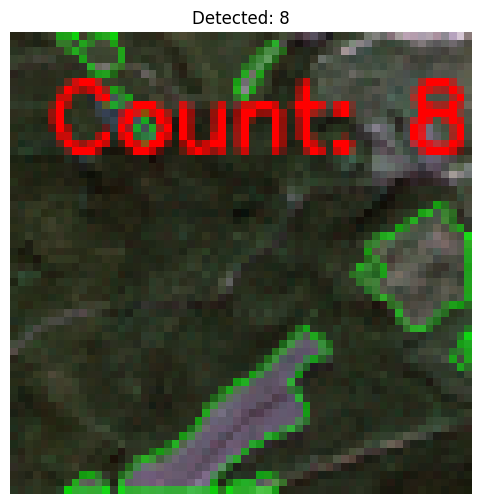

[902/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


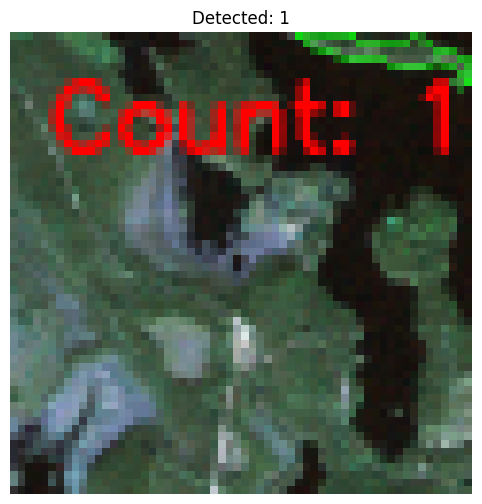

[903/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


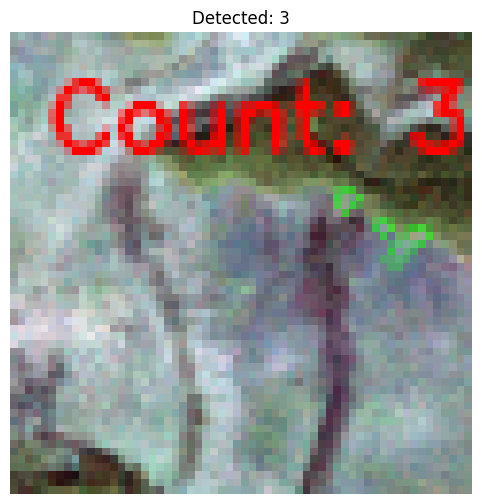

[904/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


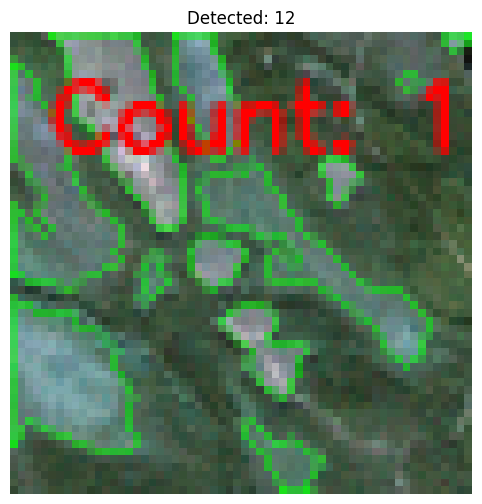

[905/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


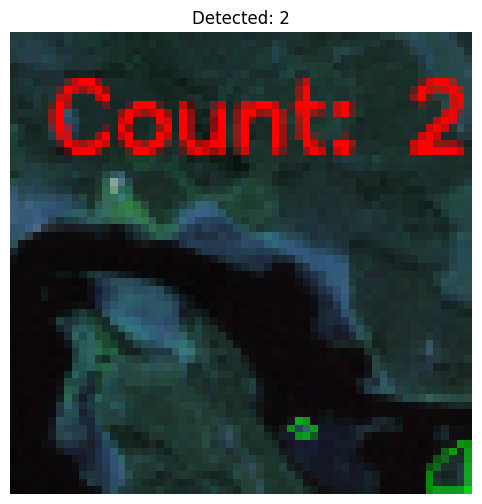

[906/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


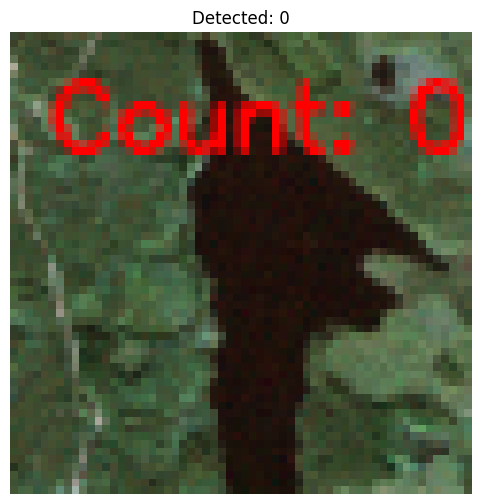

[907/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_27
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_27 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


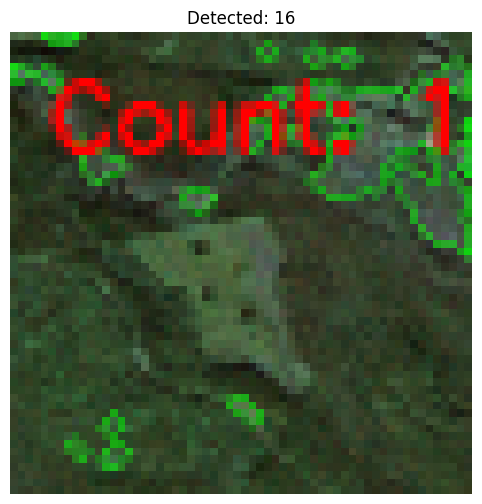

[908/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


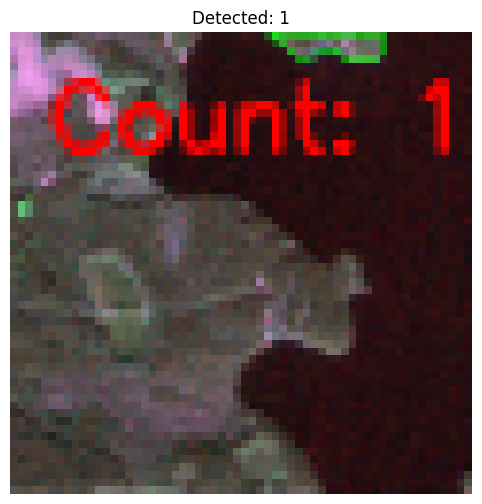

[909/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_06
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_06 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


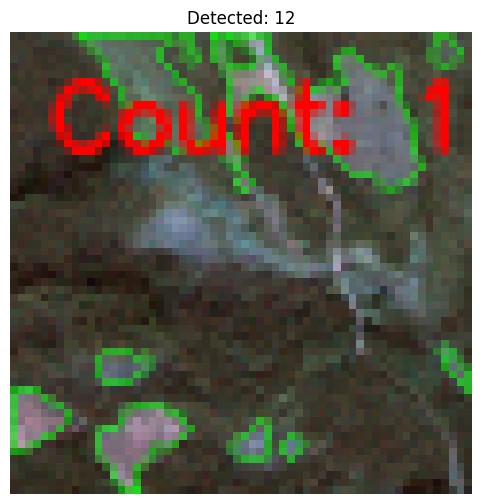

[910/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


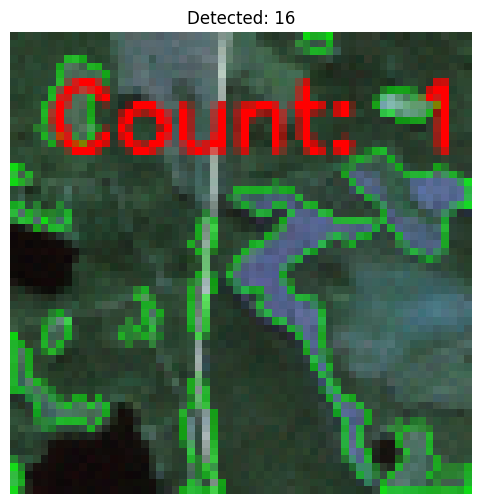

[911/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_20_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


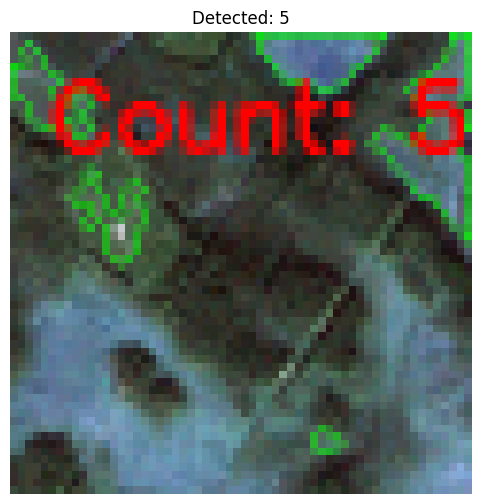

[912/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_00
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_00 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


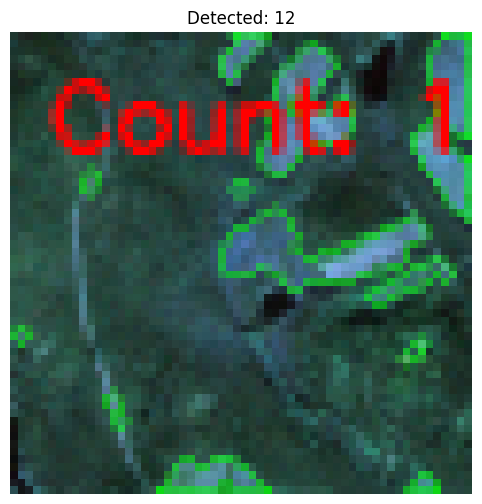

[913/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_14_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


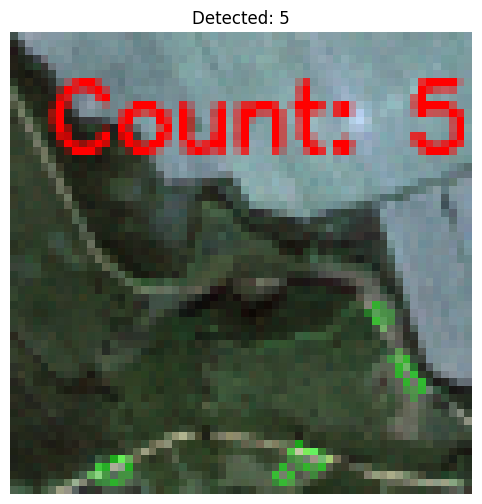

[914/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


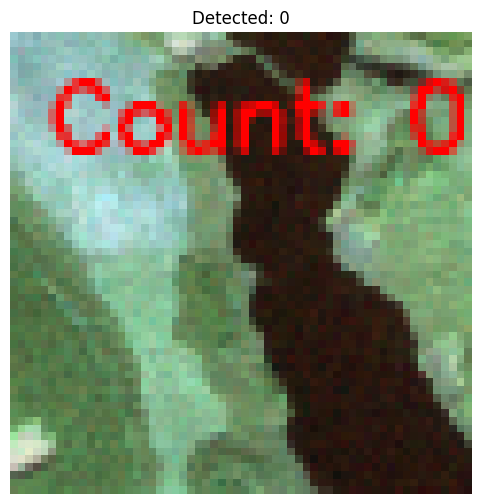

[915/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


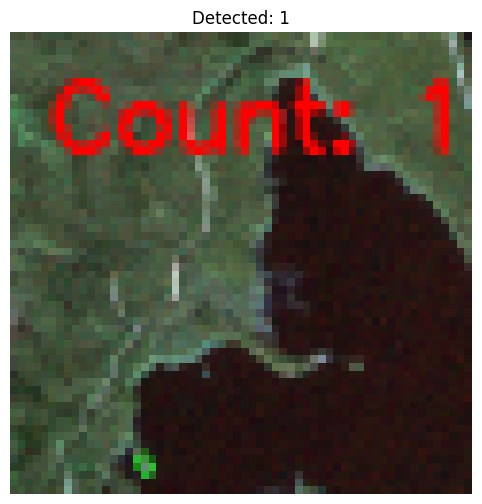

[916/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


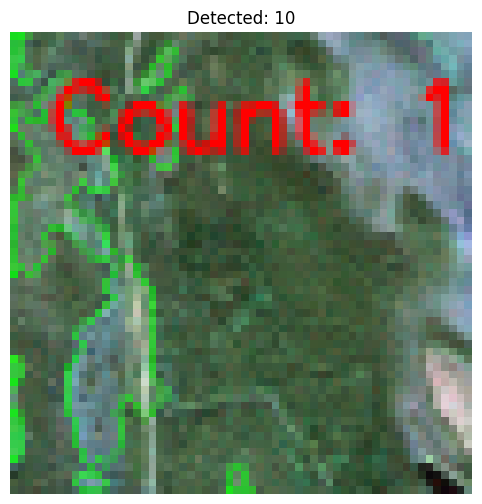

[917/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


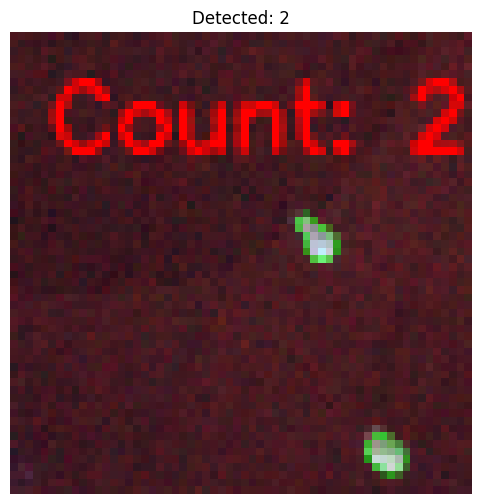

[918/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_01
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_01 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


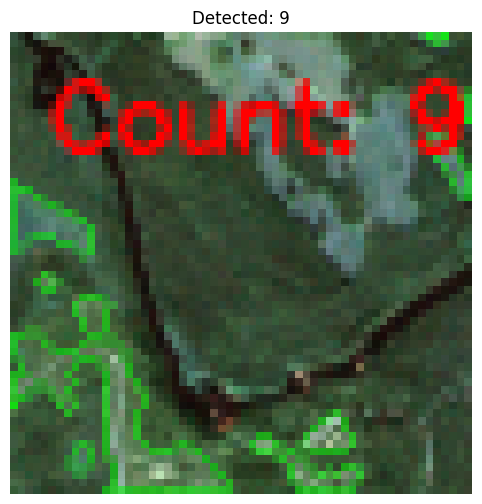

[919/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


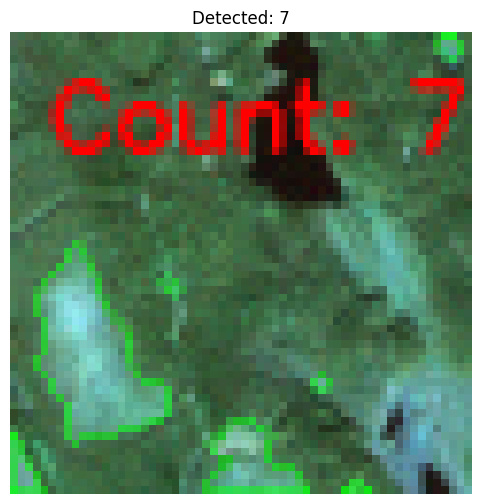

[920/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


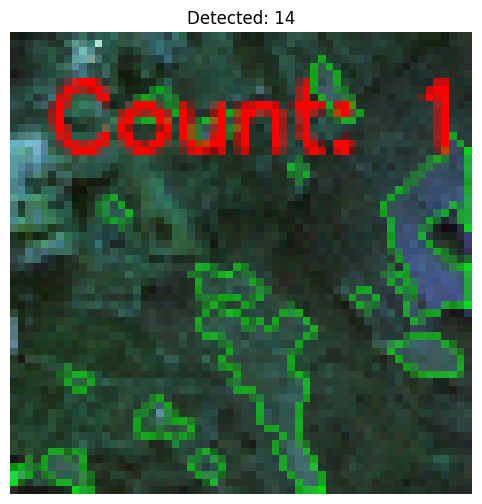

[921/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


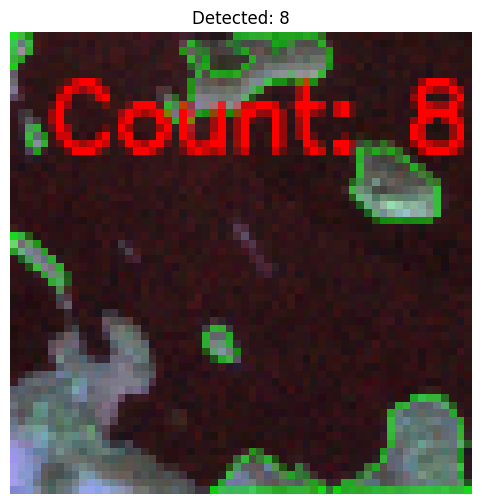

[922/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


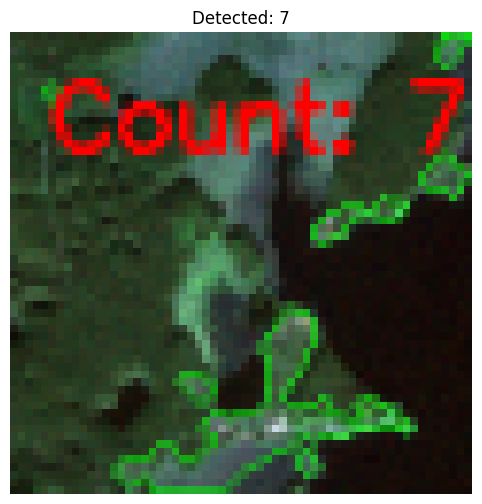

[923/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


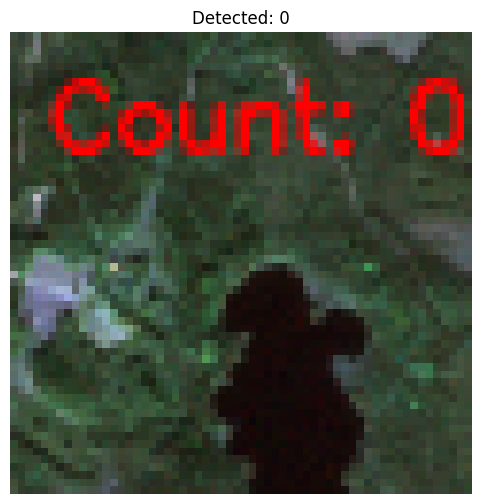

[924/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_38
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_38 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


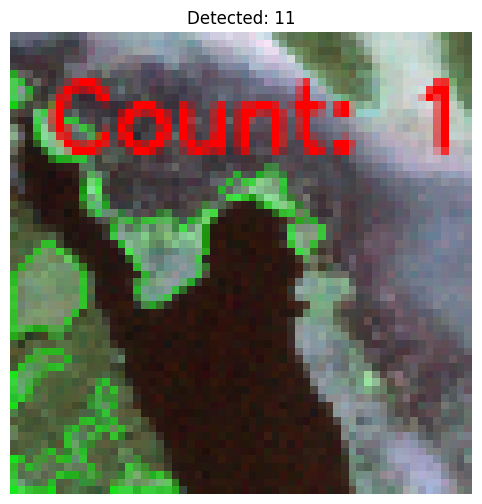

[925/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


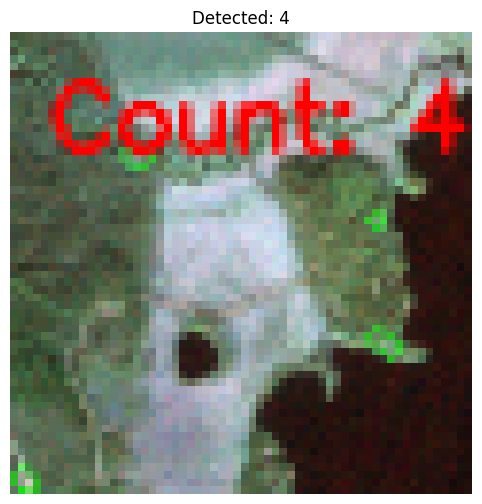

[926/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


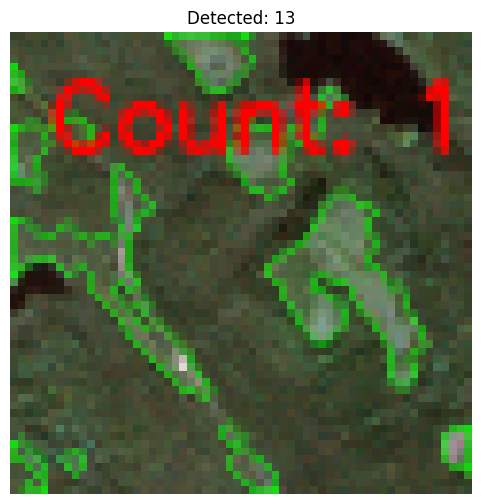

[927/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


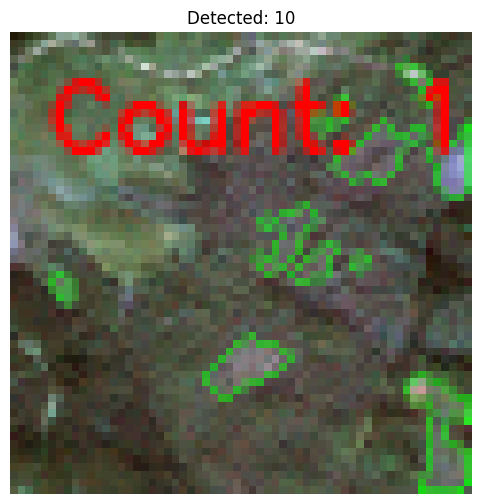

[928/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


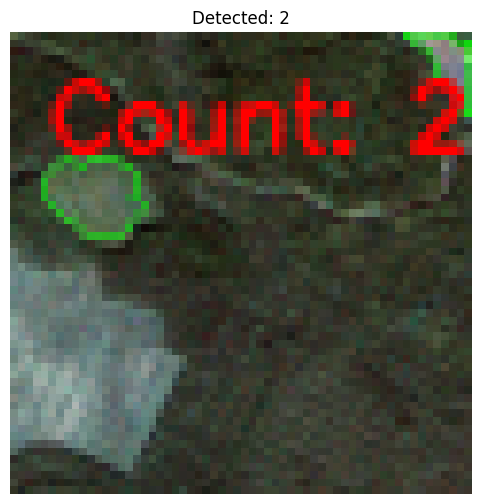

[929/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


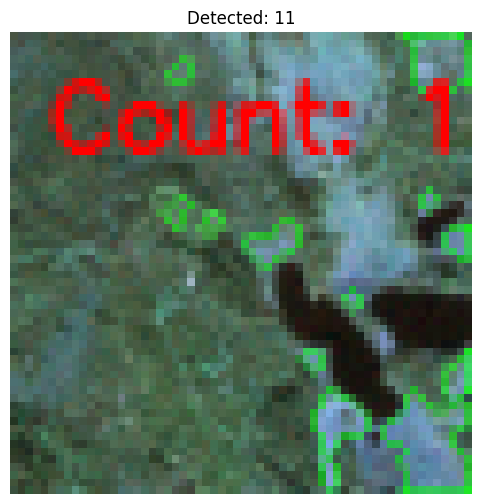

[930/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


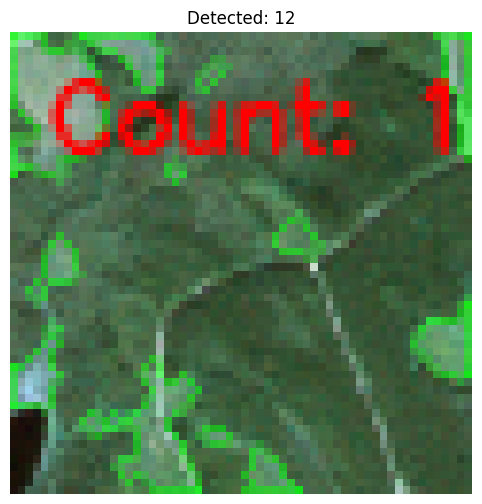

[931/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


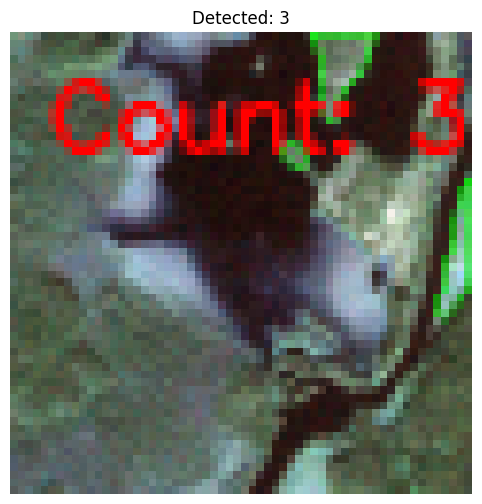

[932/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


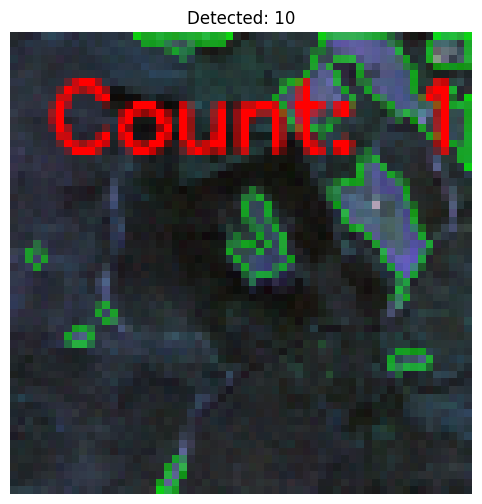

[933/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


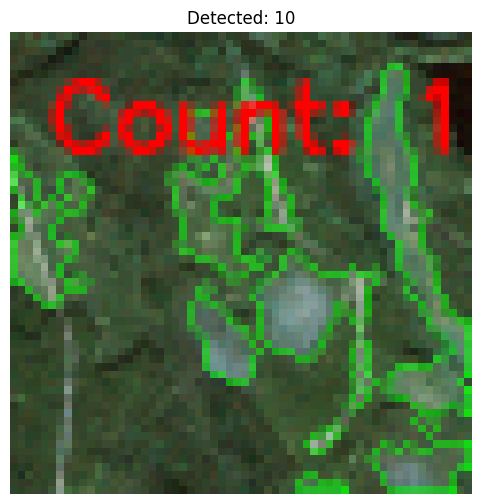

[934/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_18
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_18 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


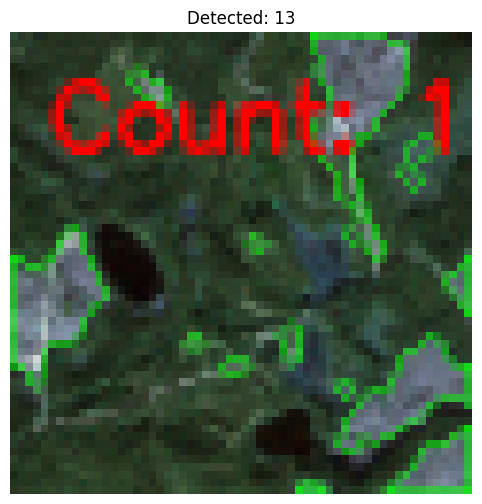

[935/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


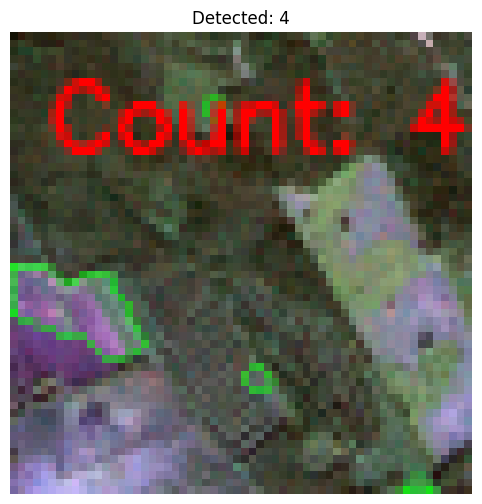

[936/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


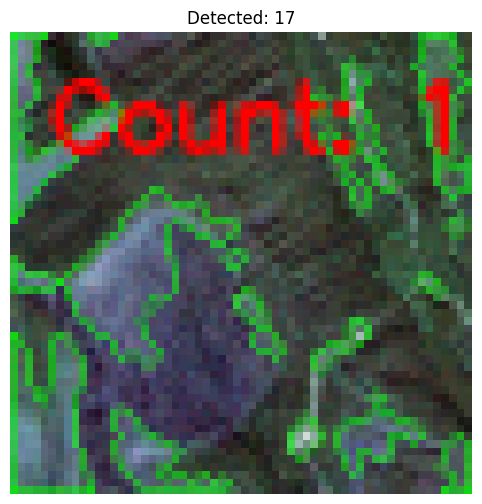

[937/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


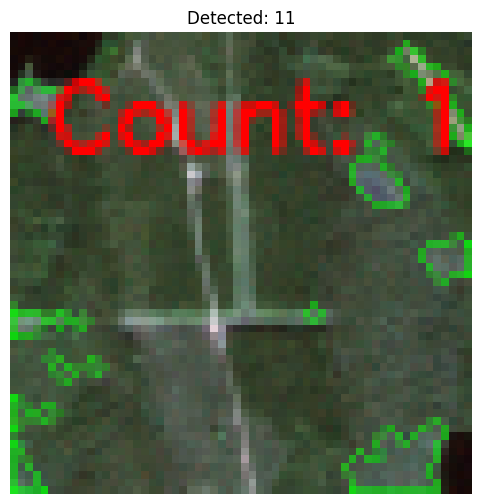

[938/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_04
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_04 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


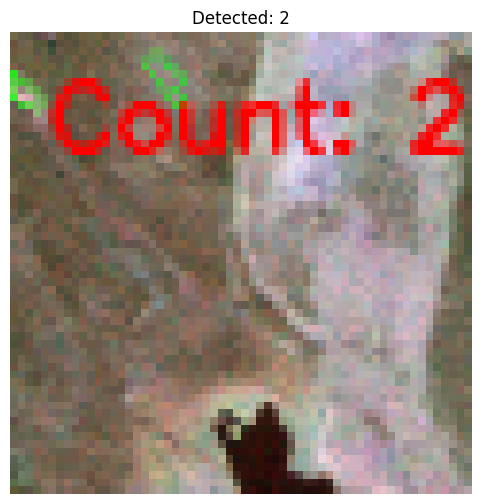

[939/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


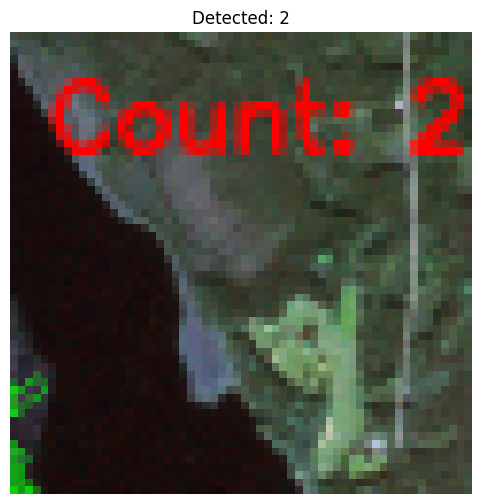

[940/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


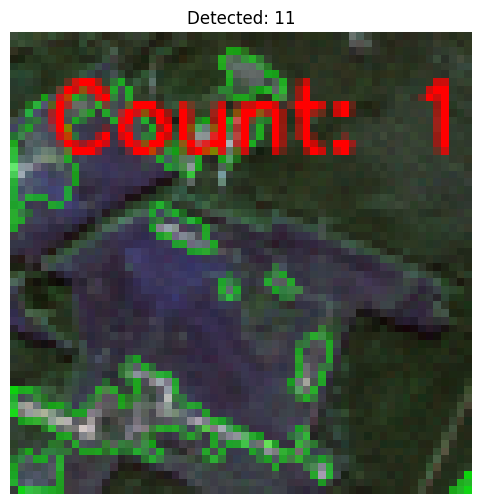

[941/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_32
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_32 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


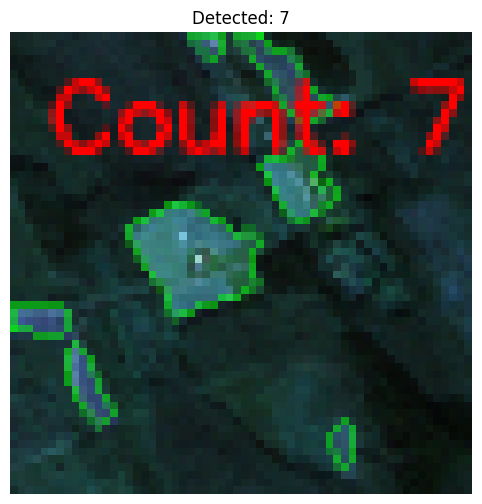

[942/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


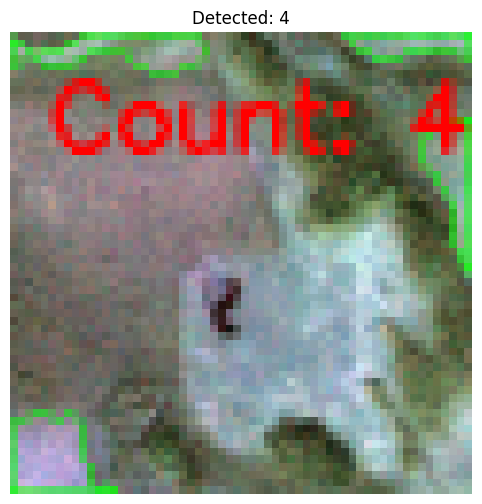

[943/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


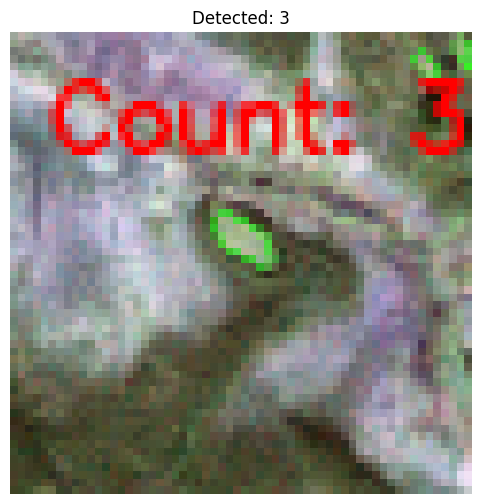

[944/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_33
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_33 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


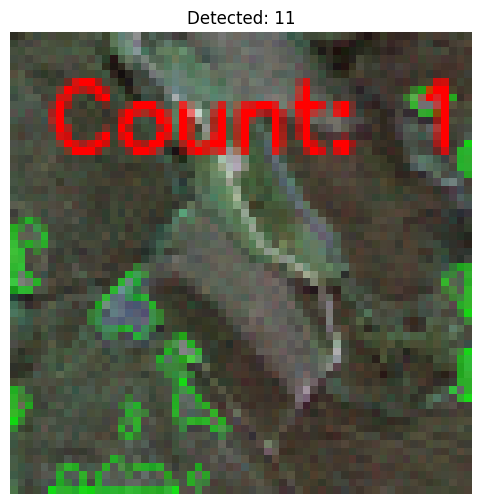

[945/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


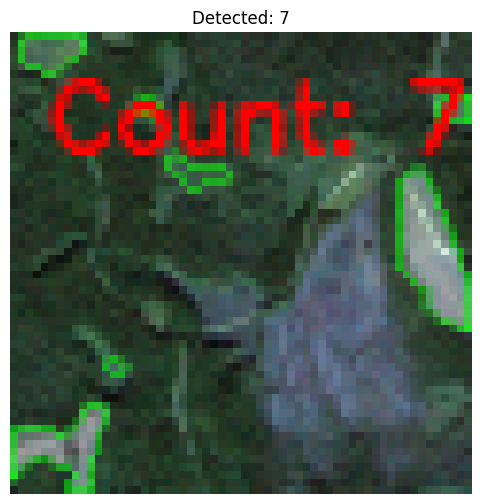

[946/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_31
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_31 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


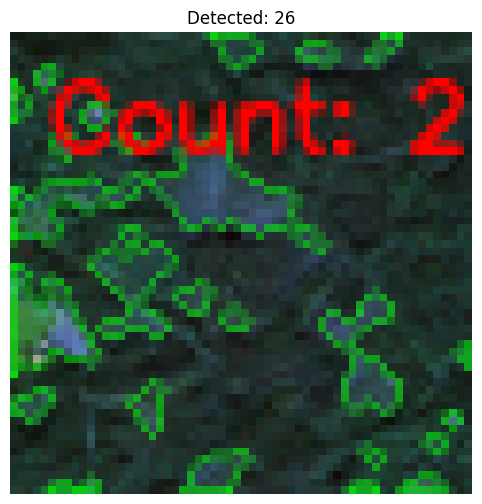

[947/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_08_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


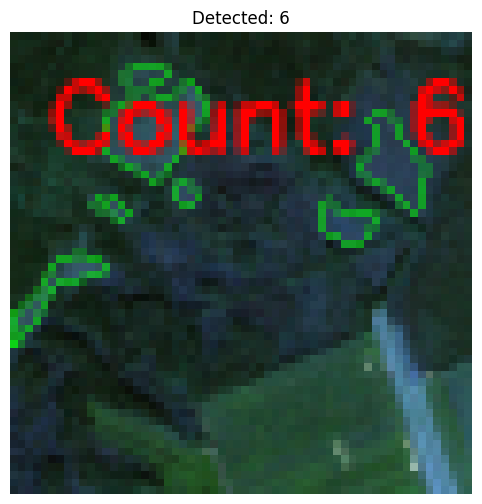

[948/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


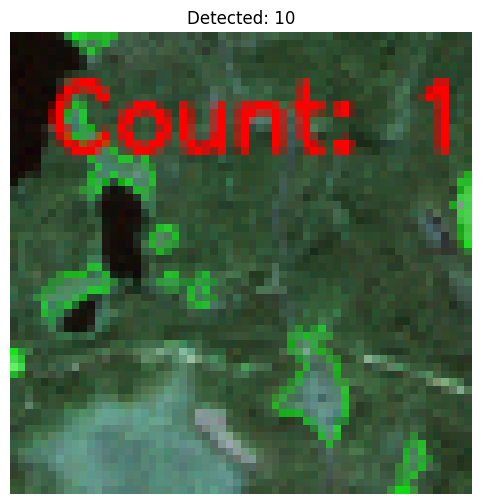

[949/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


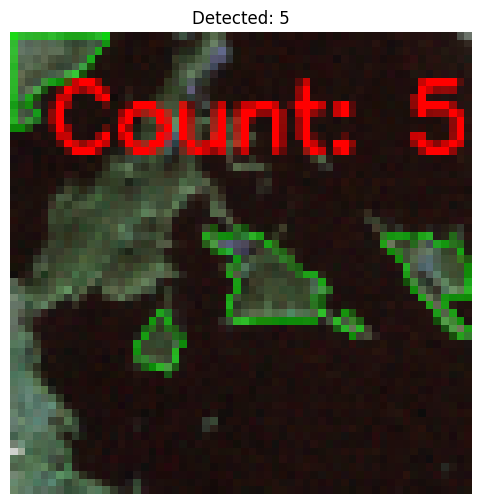

[950/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_37
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_37 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


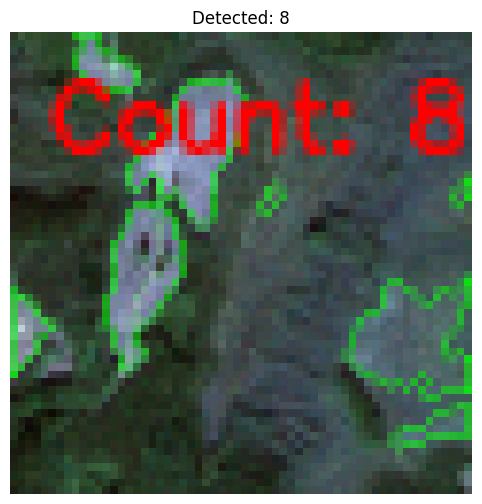

[951/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_11
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_11 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


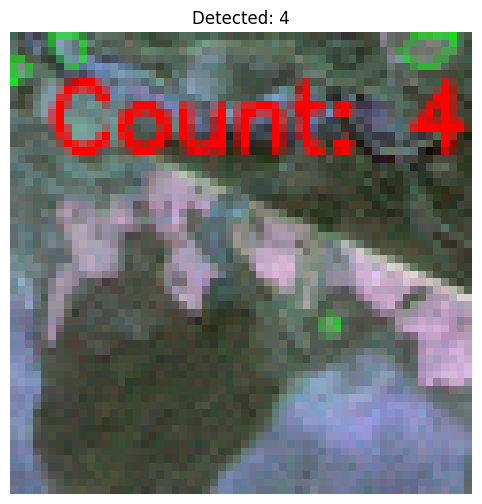

[952/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


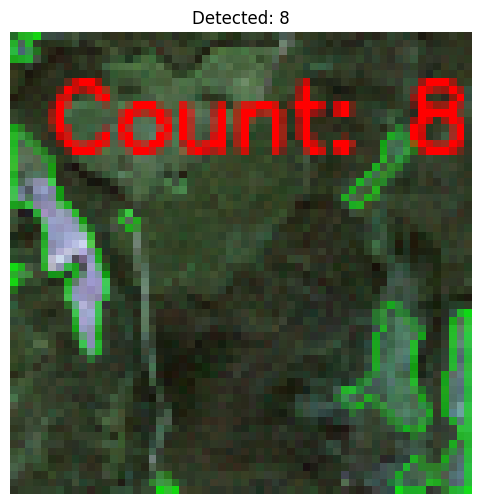

[953/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


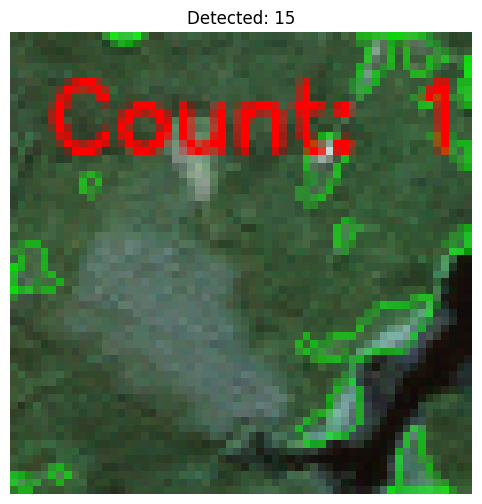

[954/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


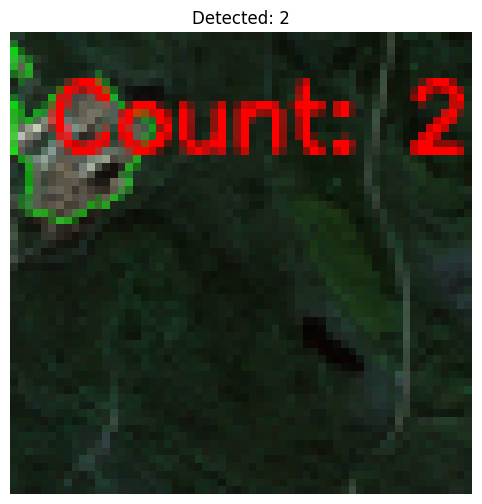

[955/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


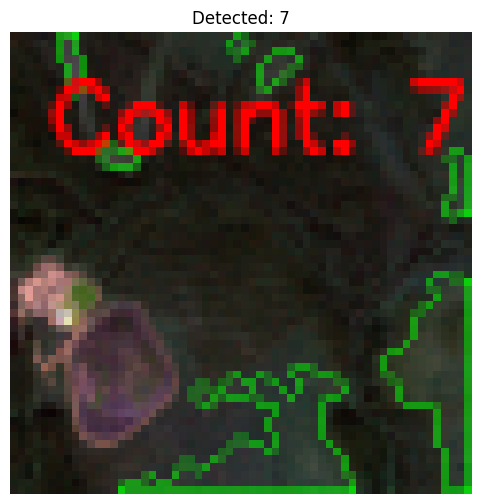

[956/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_12_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


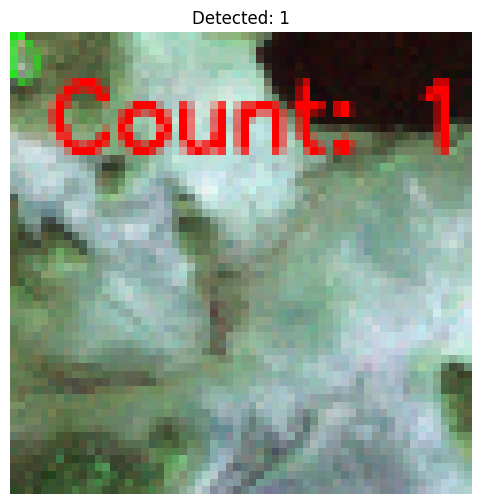

[957/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


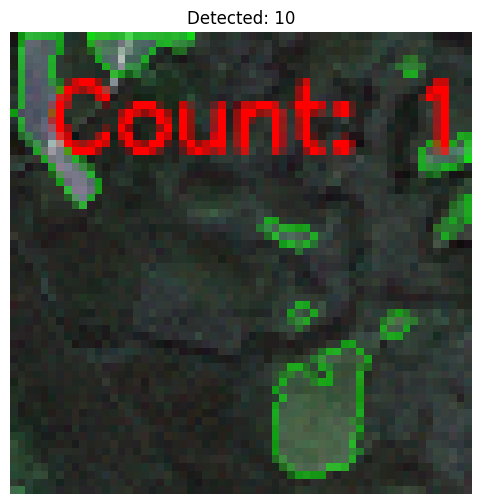

[958/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_13
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_13 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


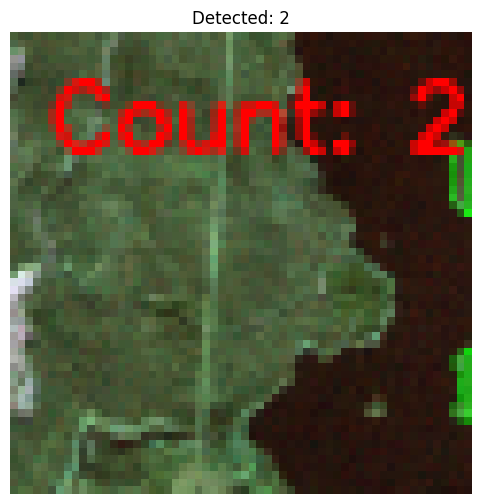

[959/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_35
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_35 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


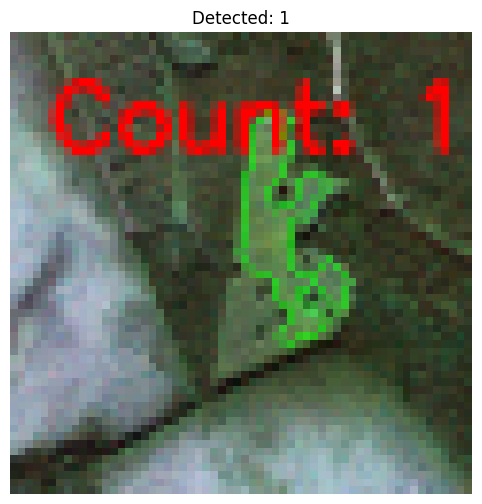

[960/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_19
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_19 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


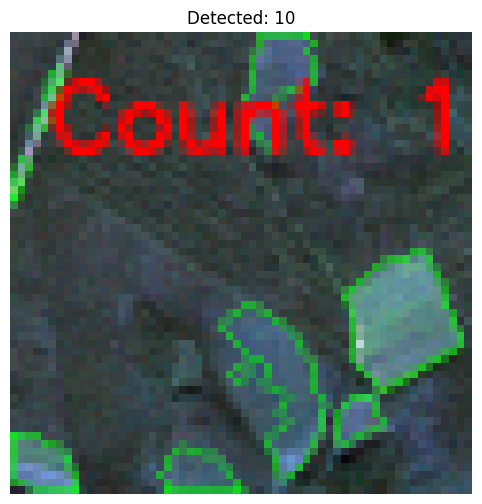

[961/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


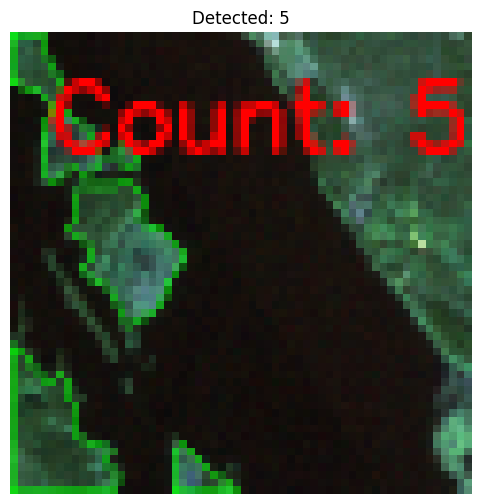

[962/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


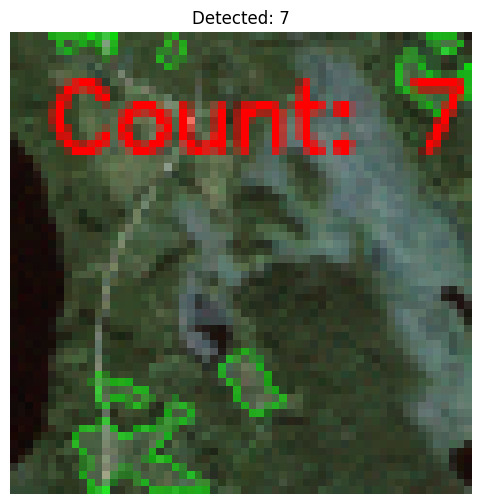

[963/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_16_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


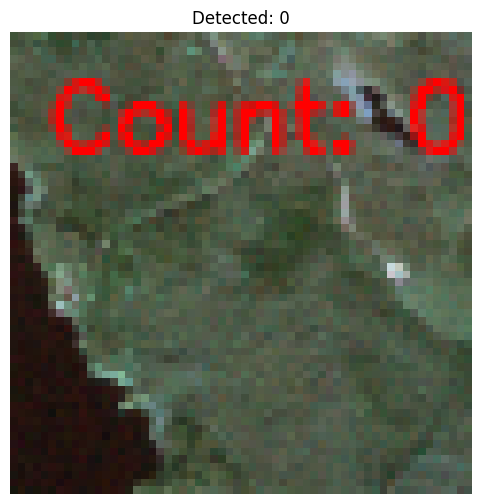

[964/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_17
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_15_17 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


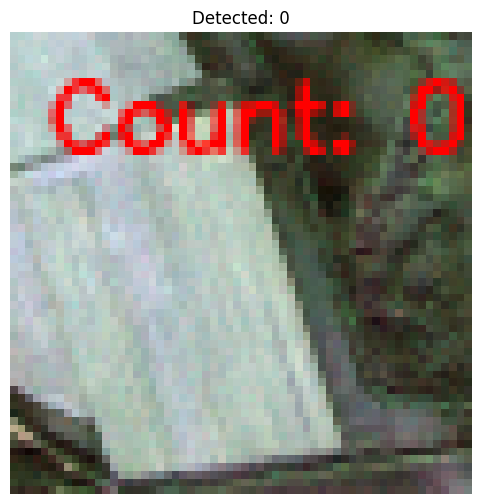

[965/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_42
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_42 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 12                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


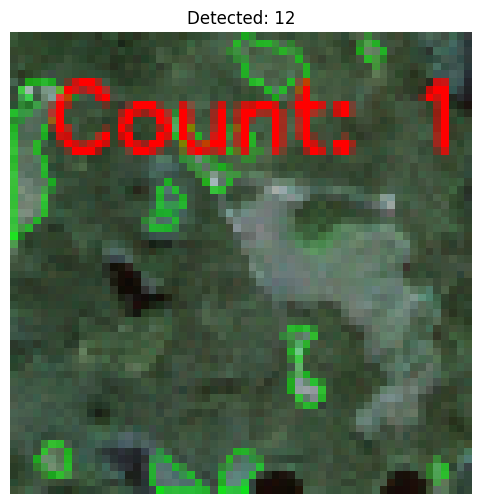

[966/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_16
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_16 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


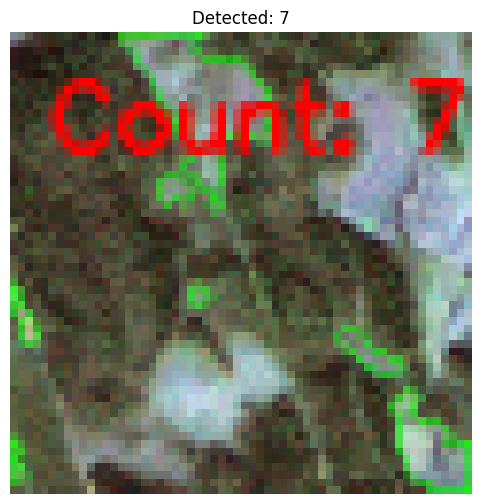

[967/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_20
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_19_20 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


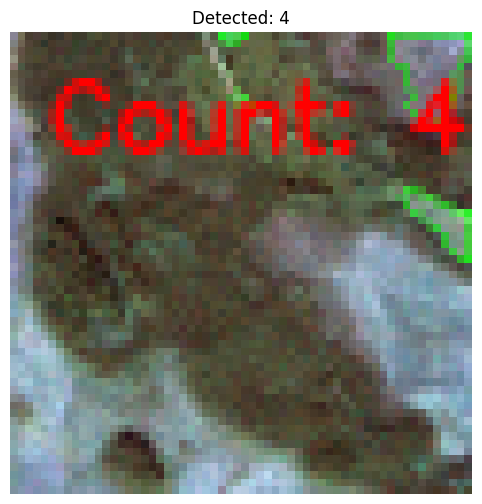

[968/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


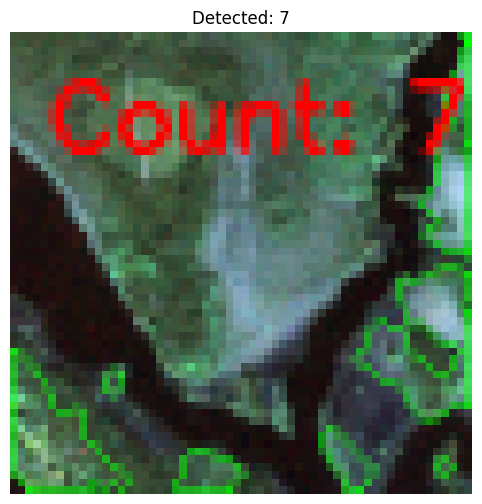

[969/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


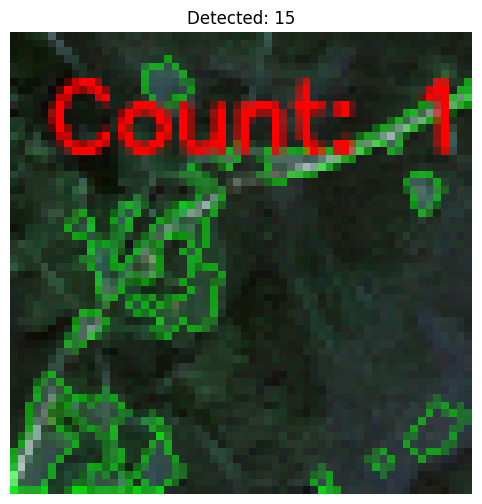

[970/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_11_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


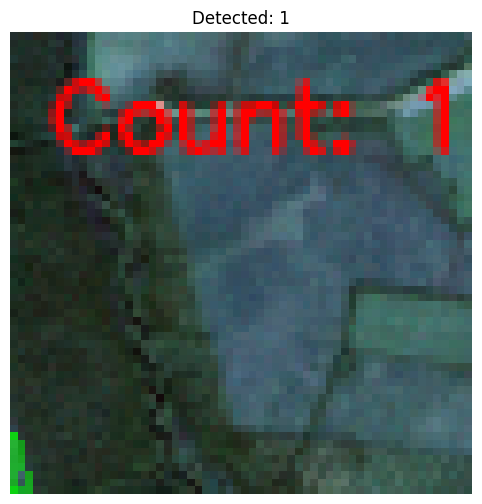

[971/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


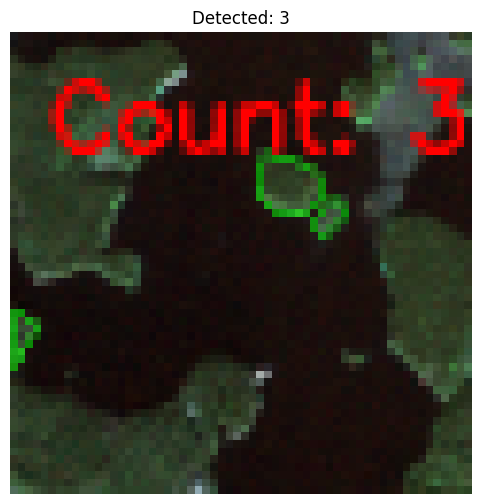

[972/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_25
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_25 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


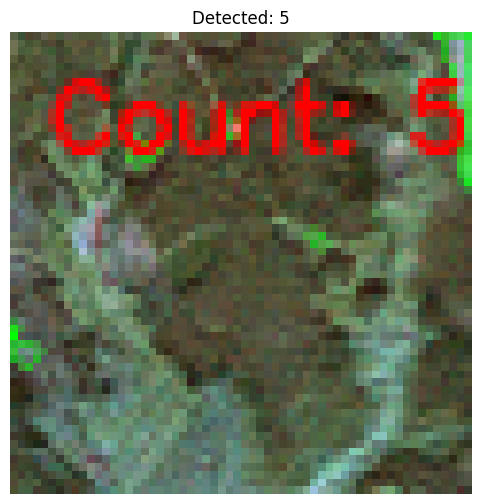

[973/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


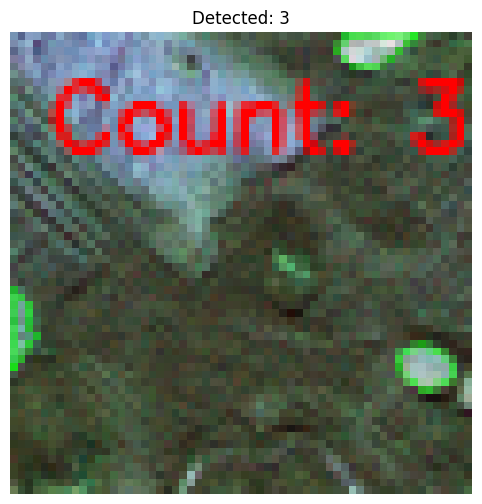

[974/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_26
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_26 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


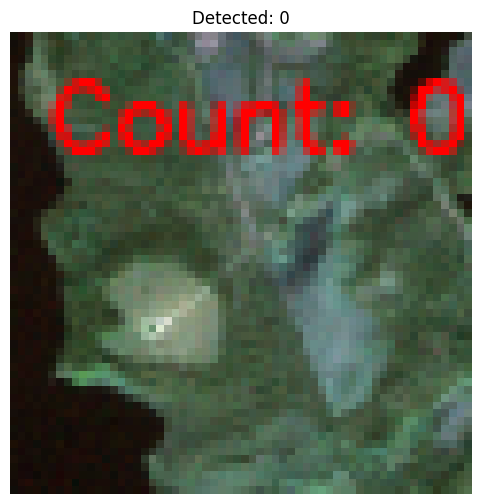

[975/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


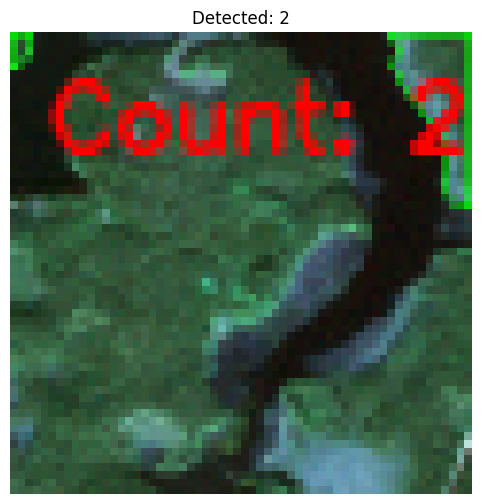

[976/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_39
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_39 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


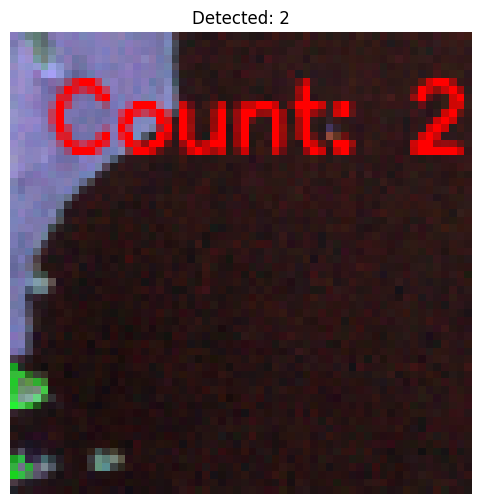

[977/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_05
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_05 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


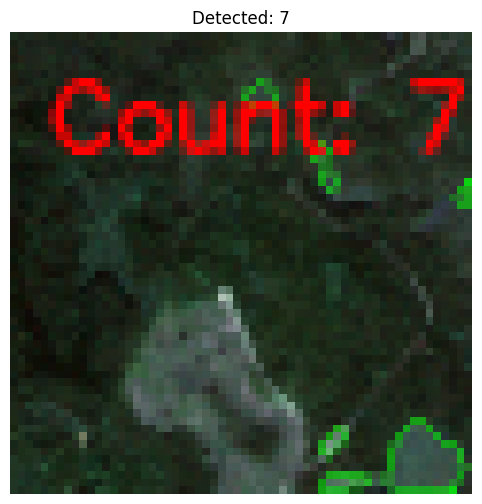

[978/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_07_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


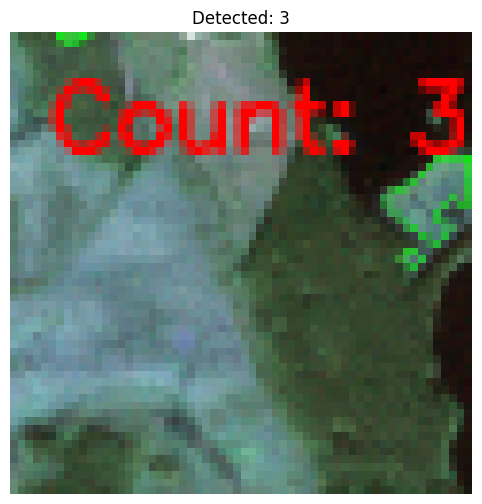

[979/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_34
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_34 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


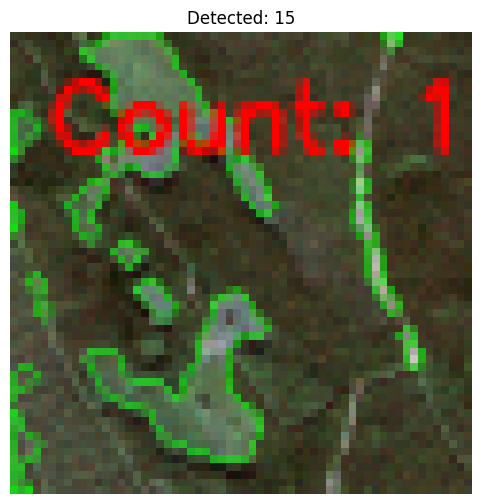

[980/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


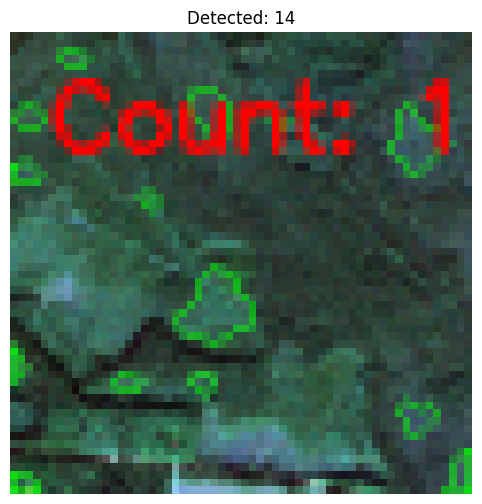

[981/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


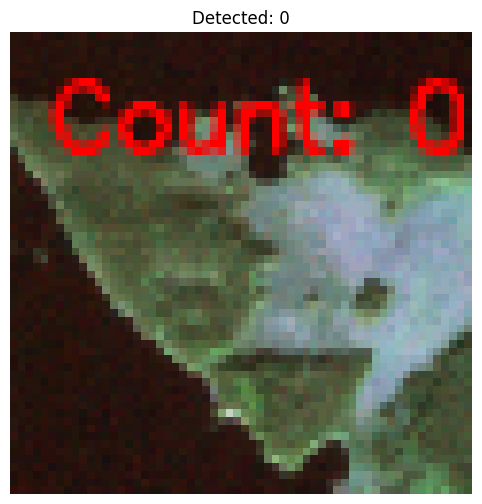

[982/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_12
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_12 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


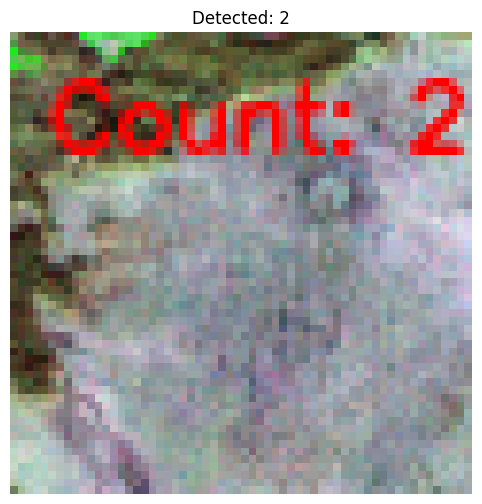

[983/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_02
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_02 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


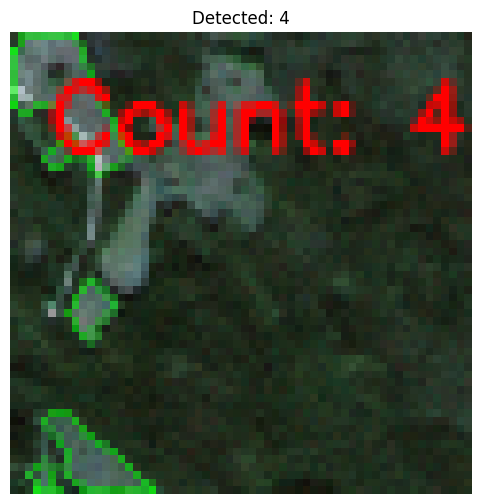

[984/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_07
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_07 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


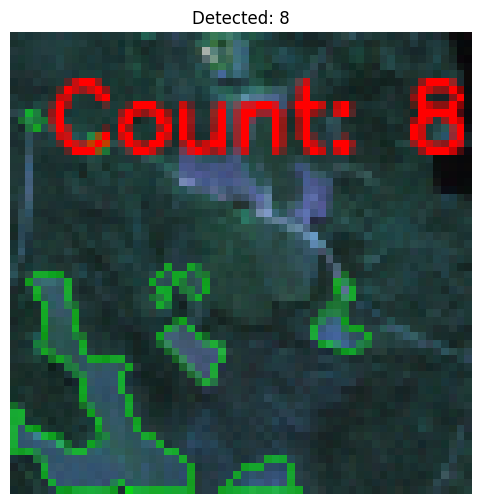

[985/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_15
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_04_15 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


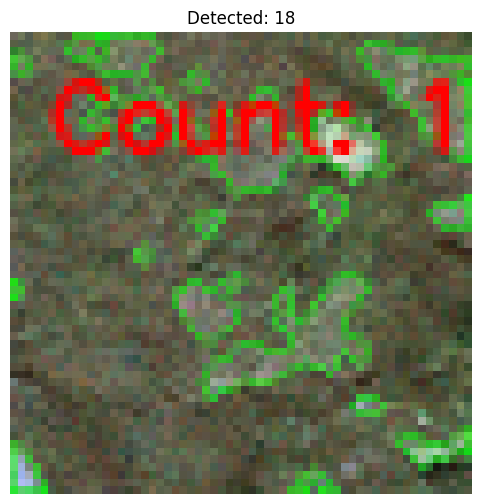

[986/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_30
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_17_30 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


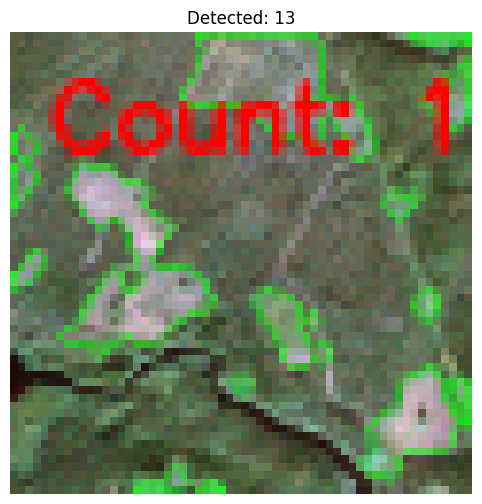

[987/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_05_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


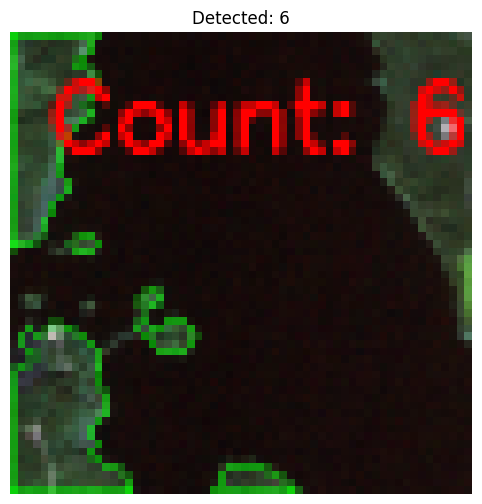

[988/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_24
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_01_24 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


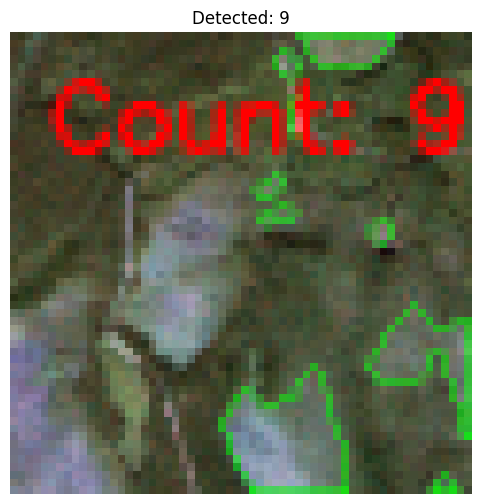

[989/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_22
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_22_22 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


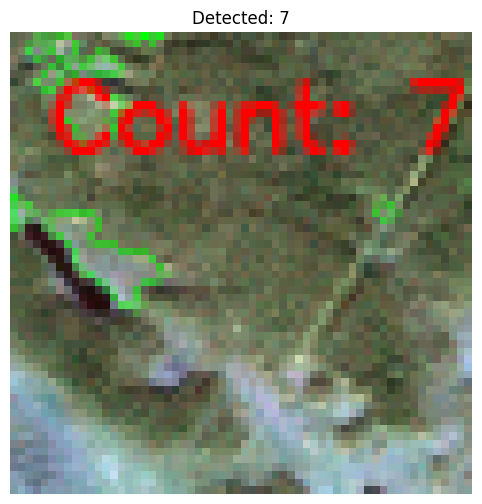

[990/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_21
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_21 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


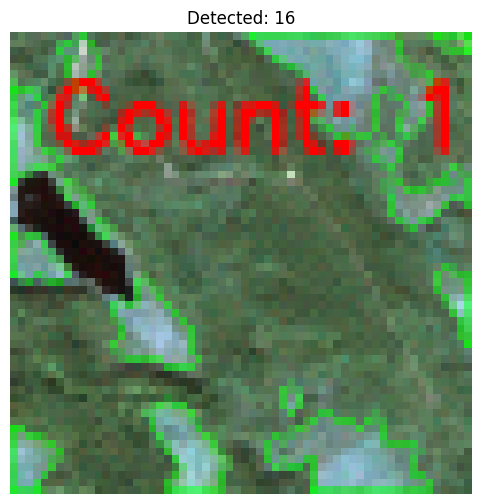

[991/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_09
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_09_09 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


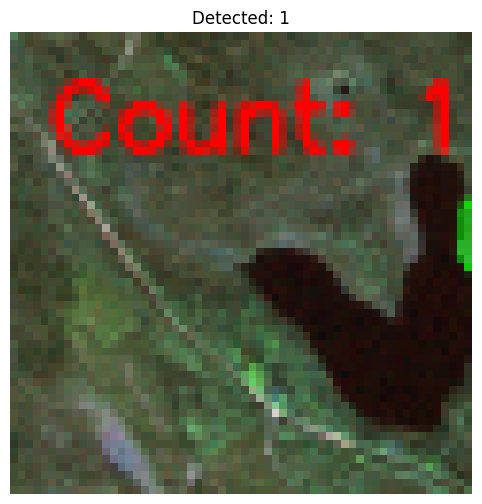

[992/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_08
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_08 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


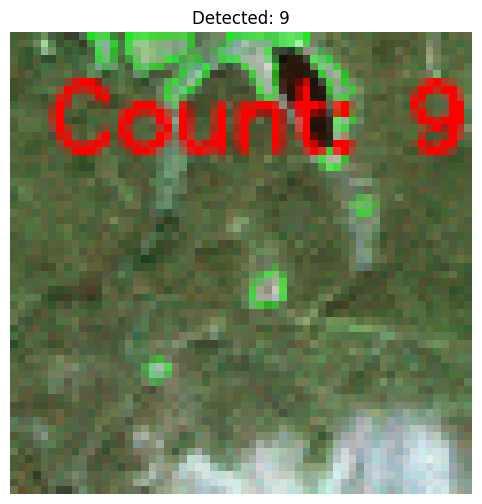

[993/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_40
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_10_40 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


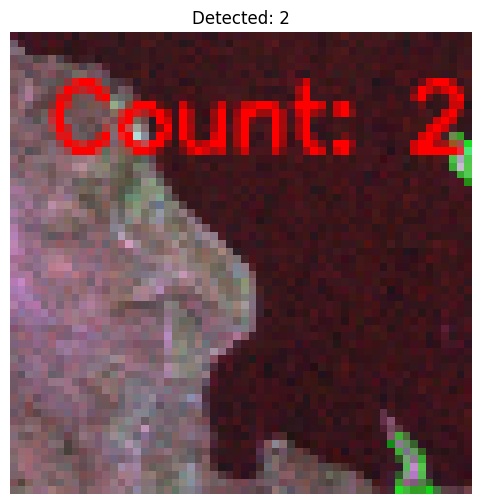

[994/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_02_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


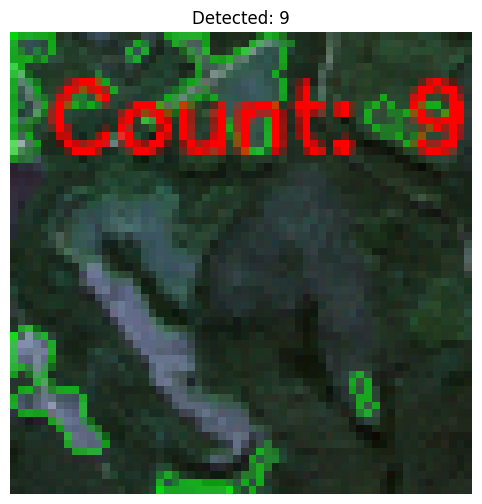

[995/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_28
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_06_28 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


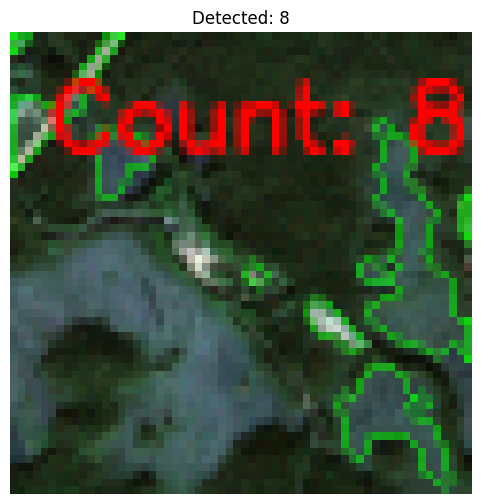

[996/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_23
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_21_23 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


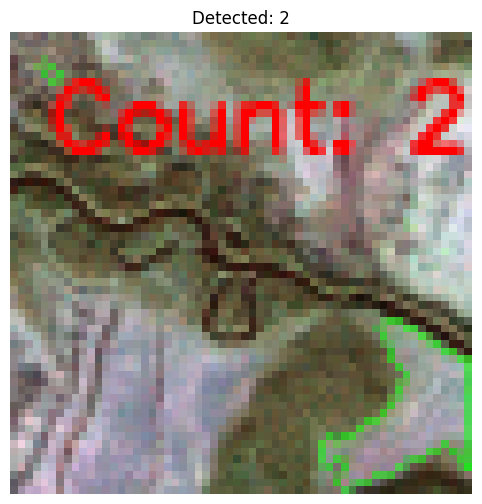

[997/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_29
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_03_29 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


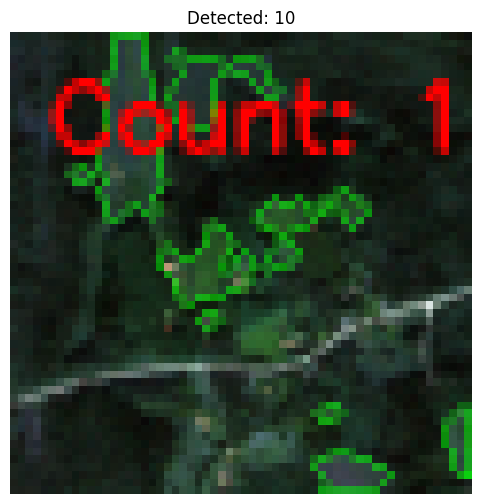

[998/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_03
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_13_03 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


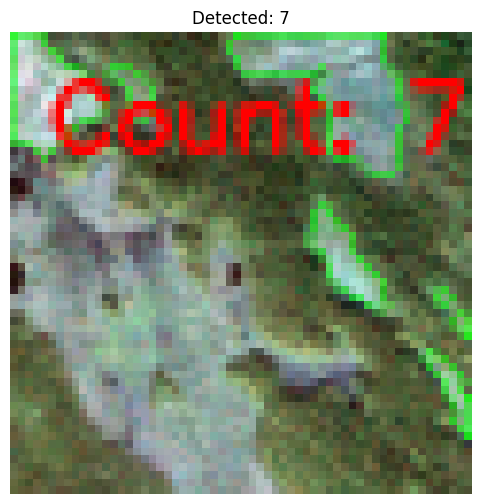

[999/41058] Processing: S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20170924T093019_N9999_R136_T36VVQ_00_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


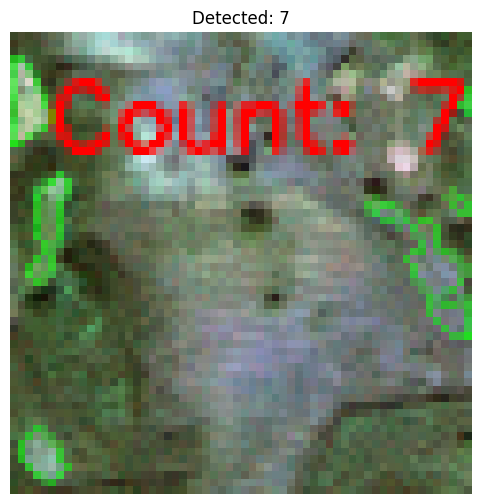

[1000/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


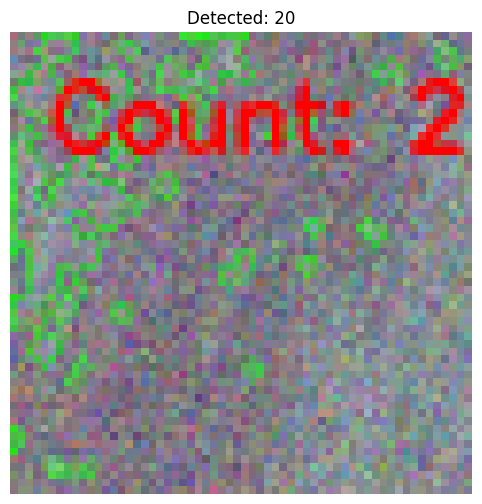

[1001/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


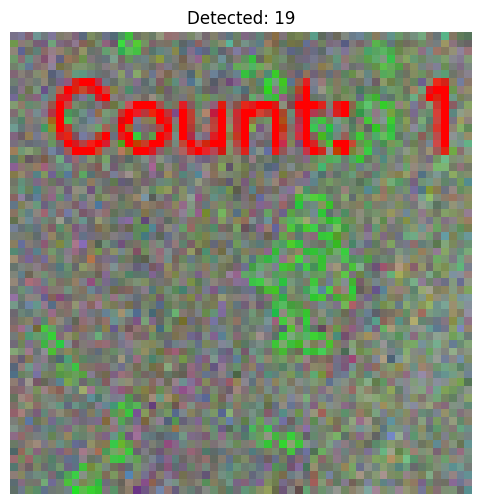

[1002/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


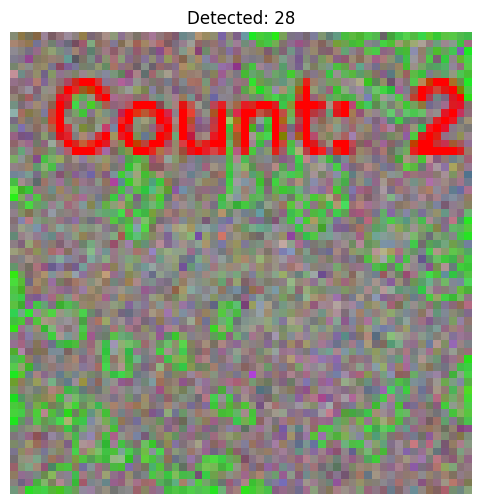

[1003/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


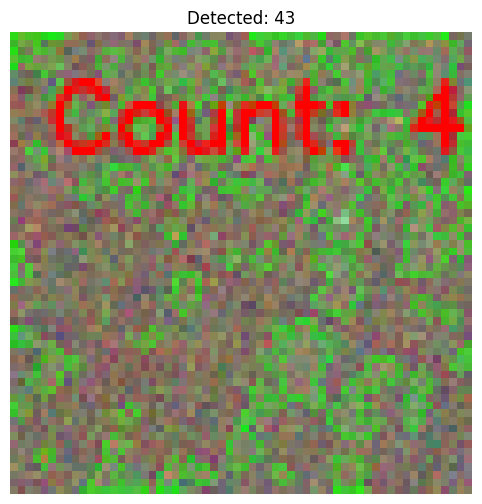

[1004/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_68
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_68 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


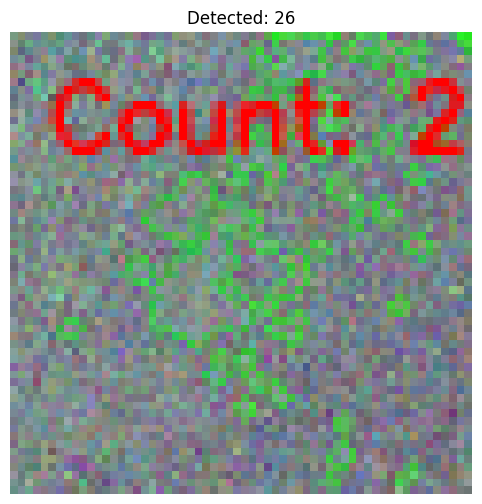

[1005/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


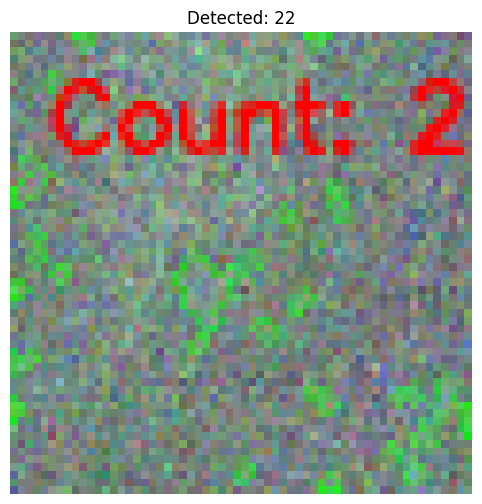

[1006/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


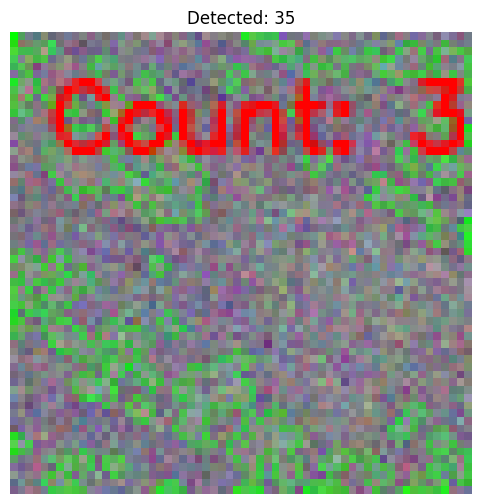

[1007/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


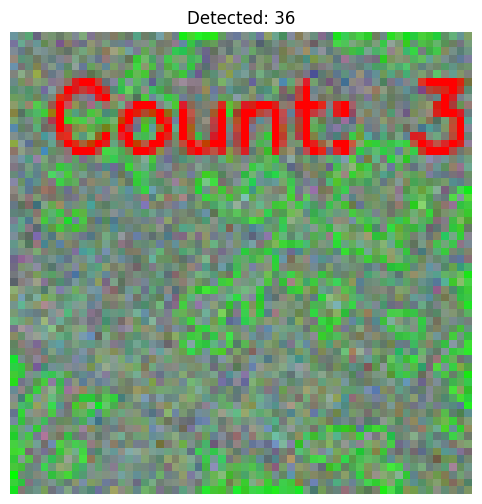

[1008/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


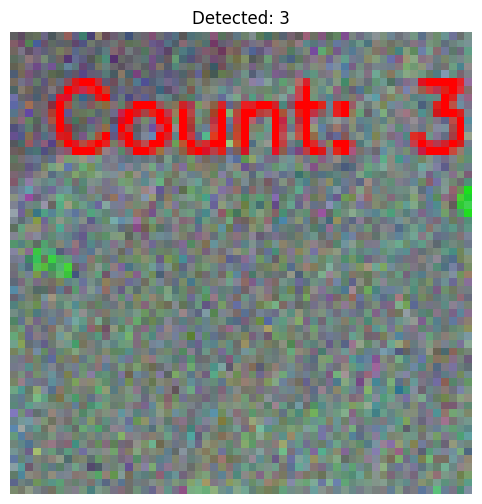

[1009/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


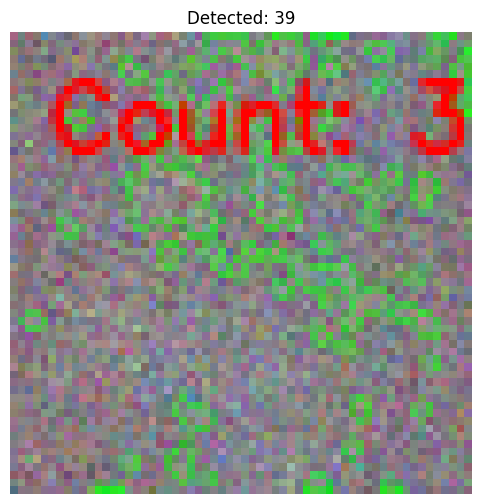

[1010/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


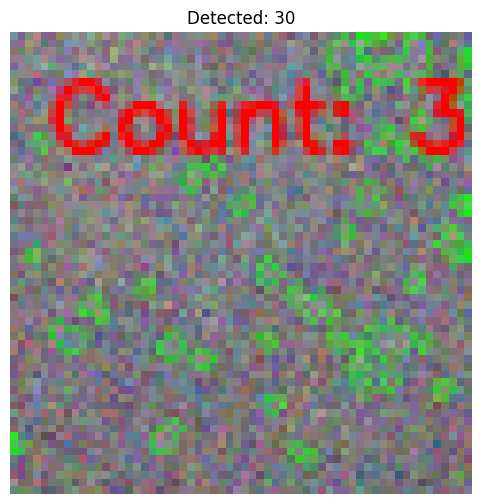

[1011/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


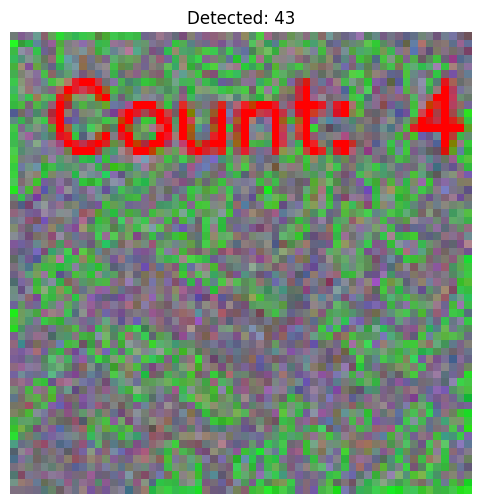

[1012/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


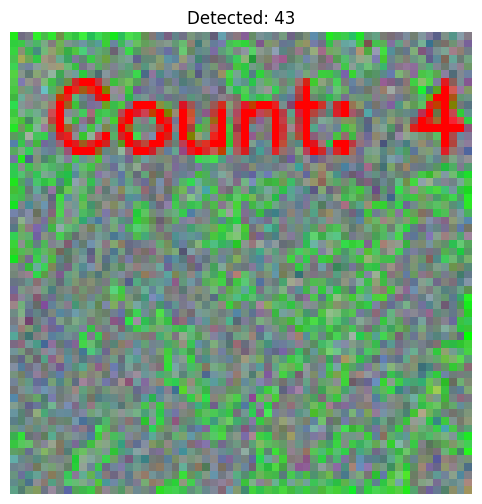

[1013/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


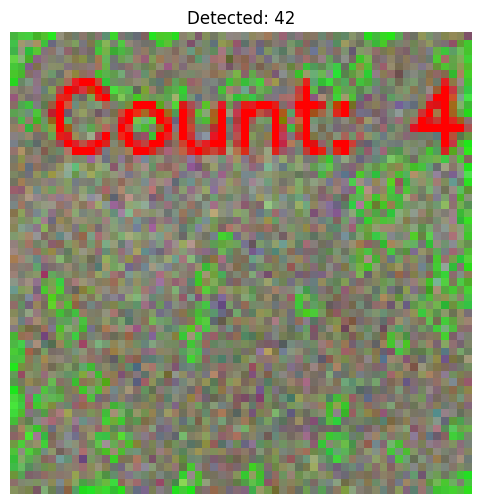

[1014/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


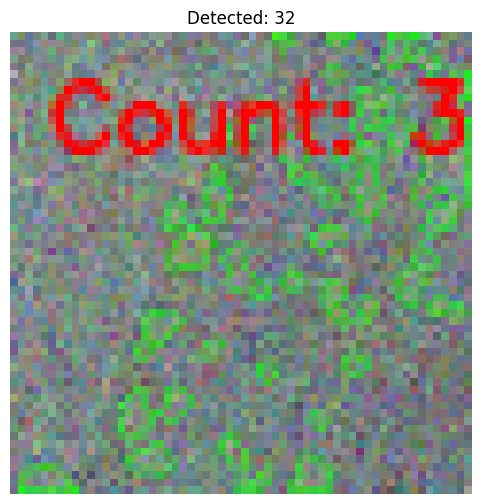

[1015/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 45                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


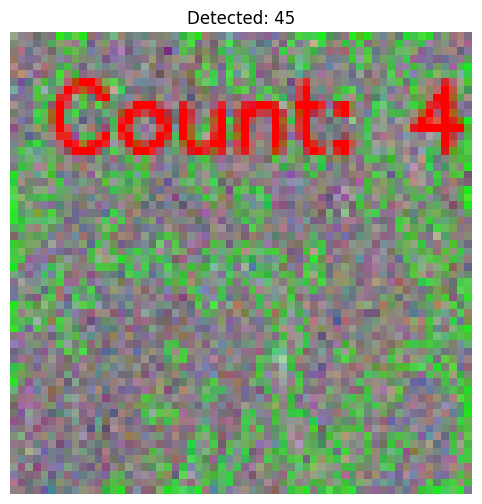

[1016/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_80
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_80 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 55                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


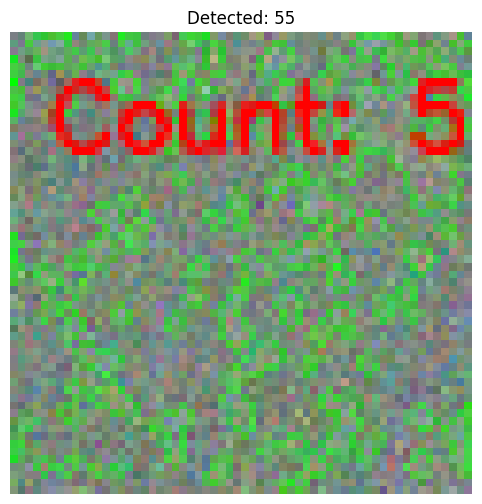

[1017/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


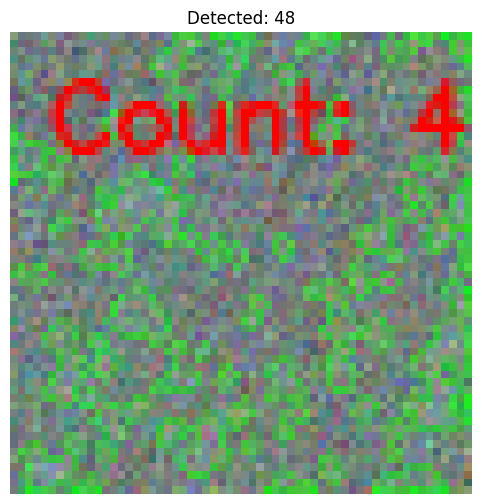

[1018/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 23                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


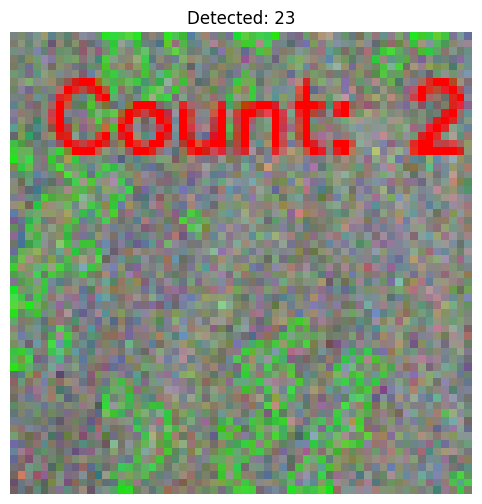

[1019/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


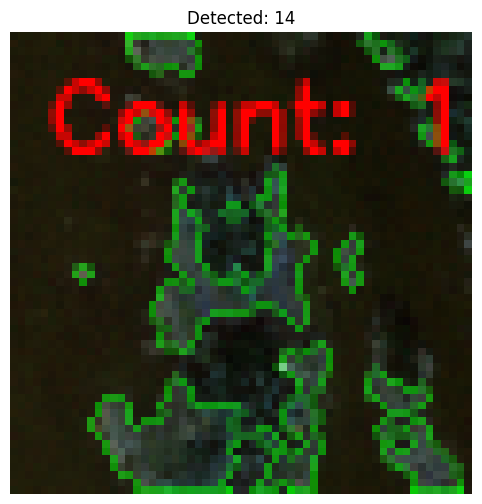

[1020/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


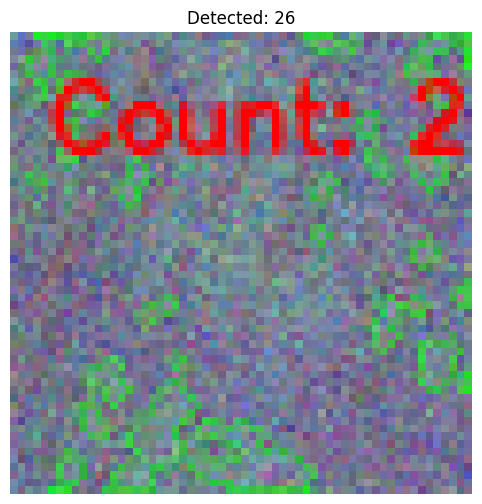

[1021/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_85
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_85 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


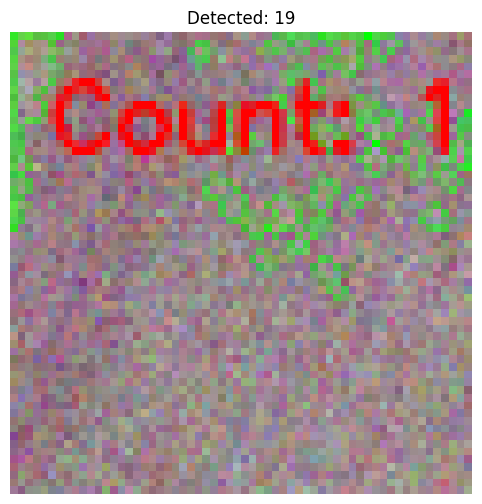

[1022/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 17                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


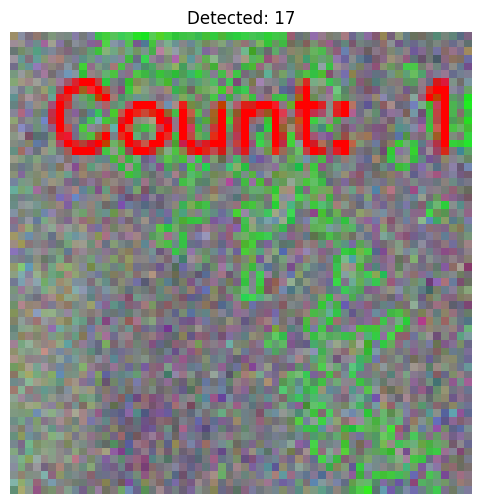

[1023/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


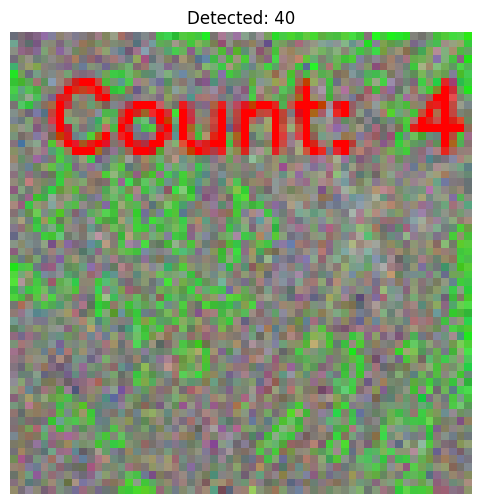

[1024/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 46                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


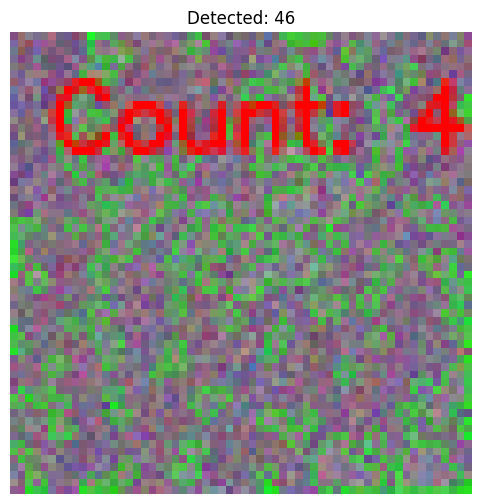

[1025/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_80
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_80 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 37                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


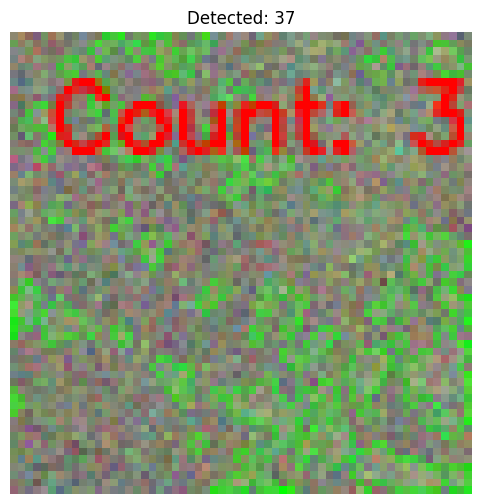

[1026/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


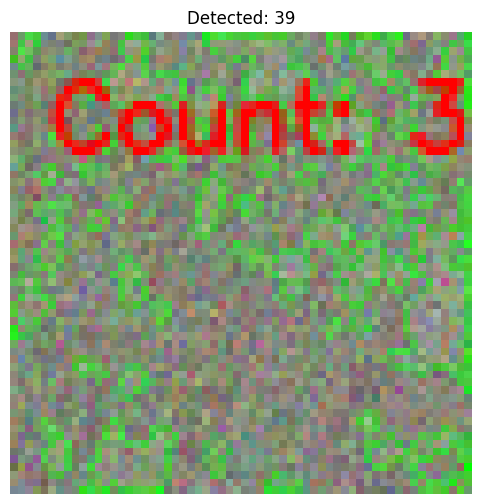

[1027/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_54_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_54_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


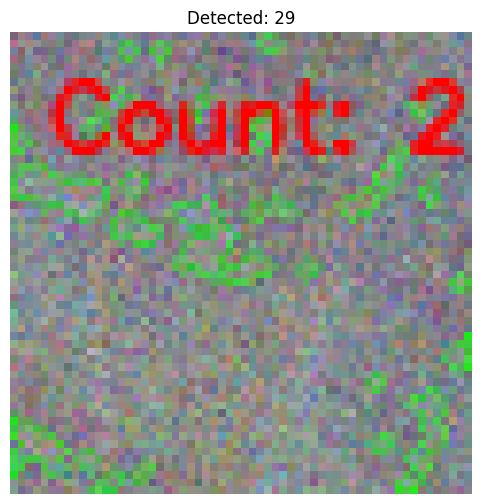

[1028/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


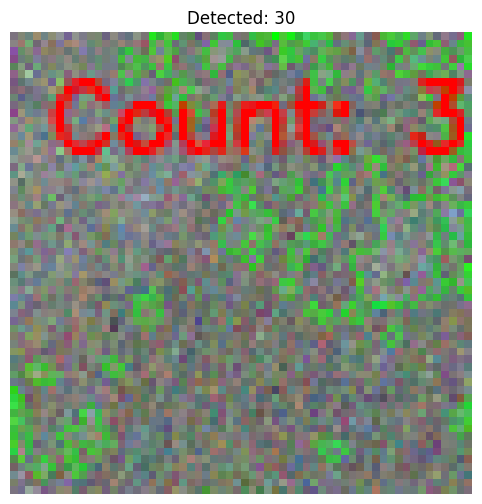

[1029/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


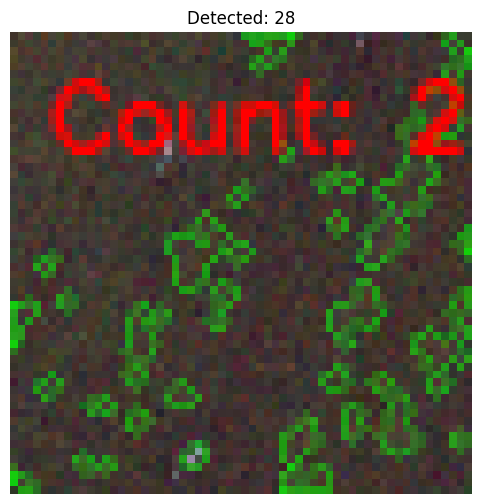

[1030/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


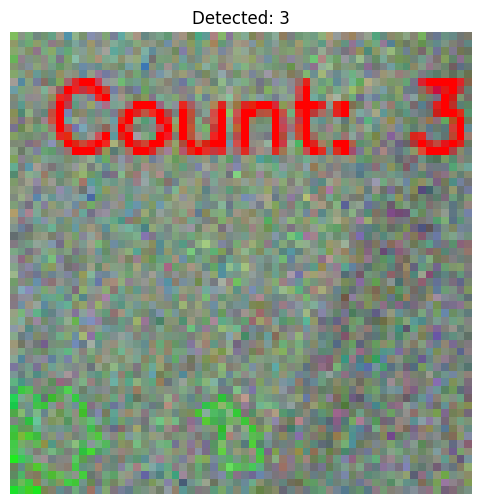

[1031/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 55                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


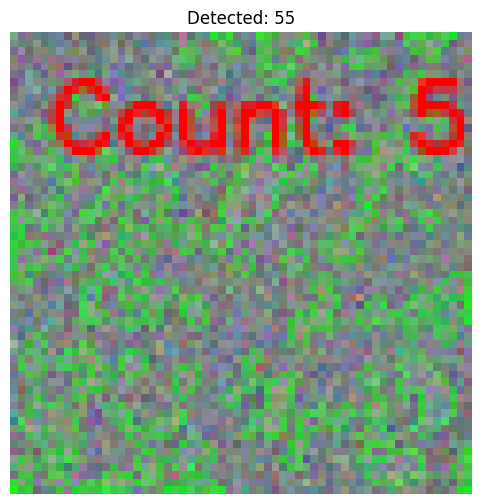

[1032/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


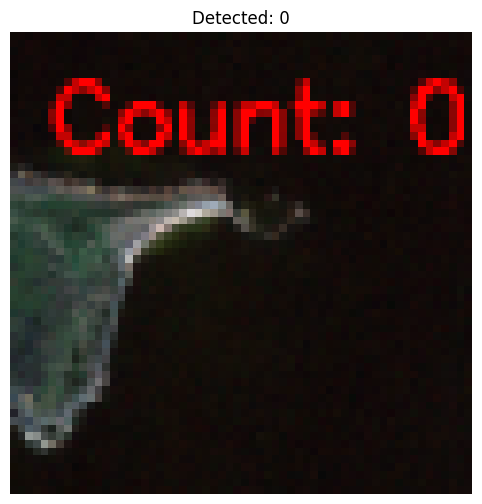

[1033/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


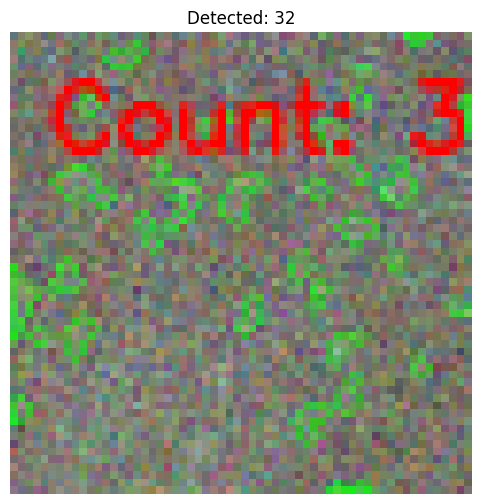

[1034/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


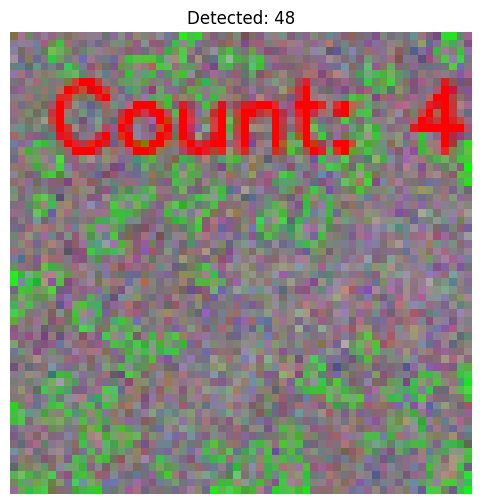

[1035/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 53                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


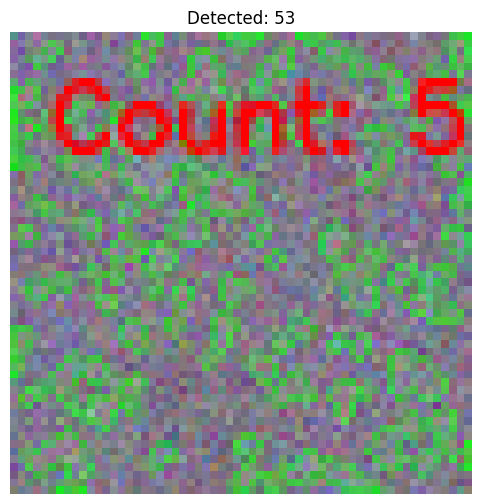

[1036/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_82
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_82 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


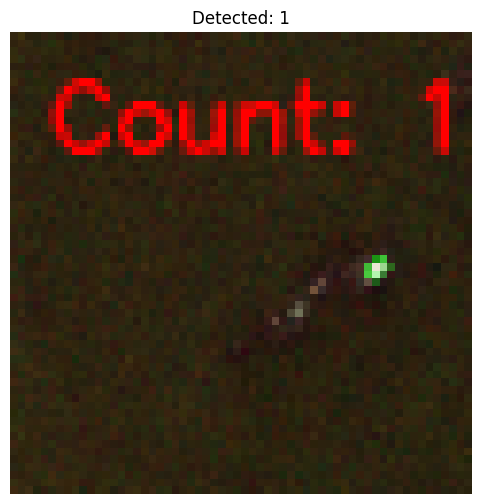

[1037/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


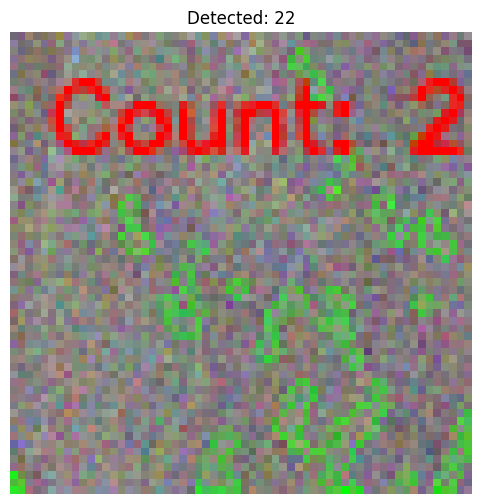

[1038/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


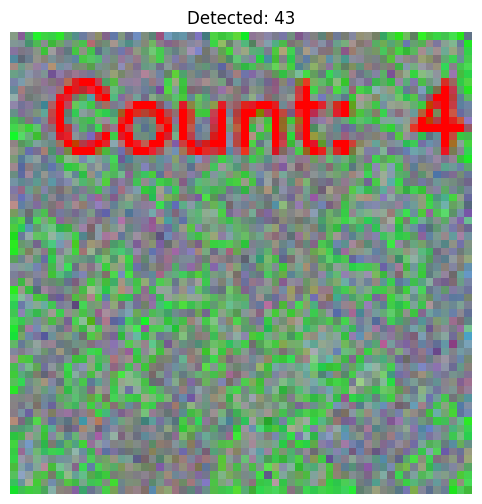

[1039/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


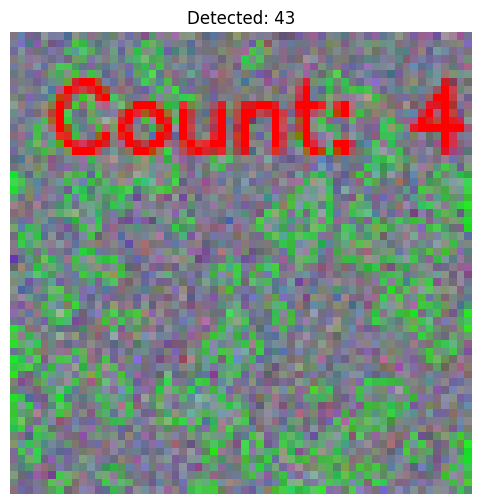

[1040/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 52                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


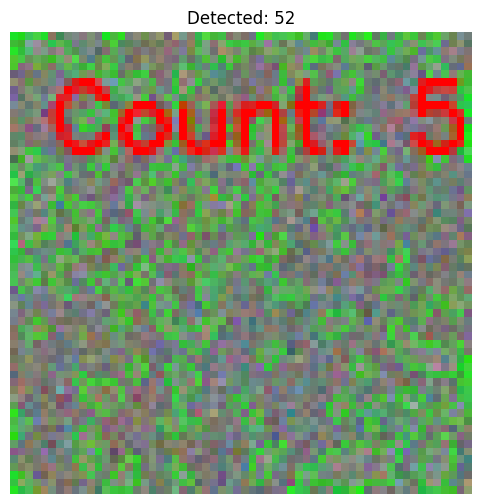

[1041/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


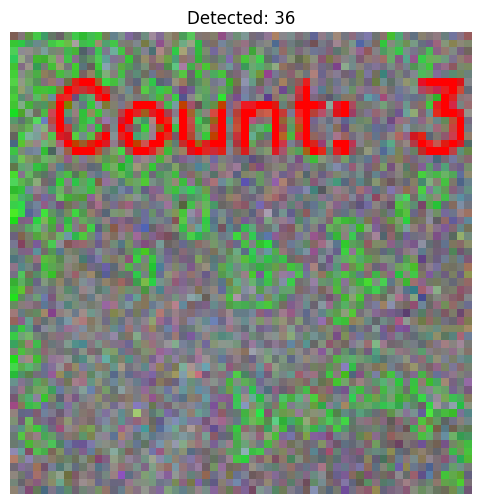

[1042/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


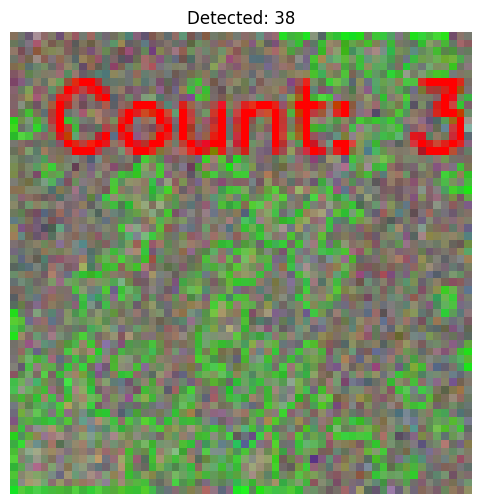

[1043/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


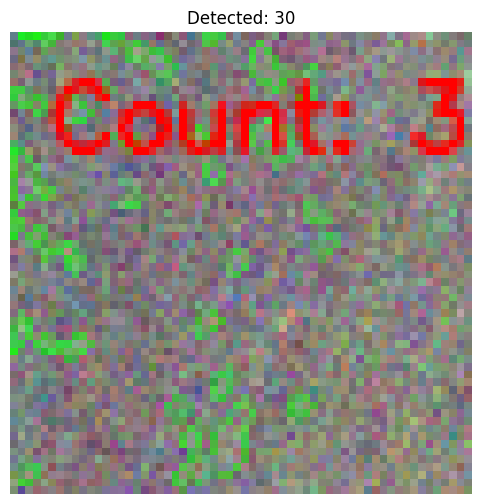

[1044/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


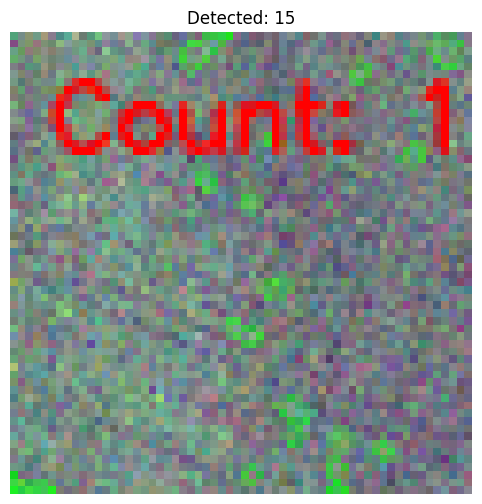

[1045/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


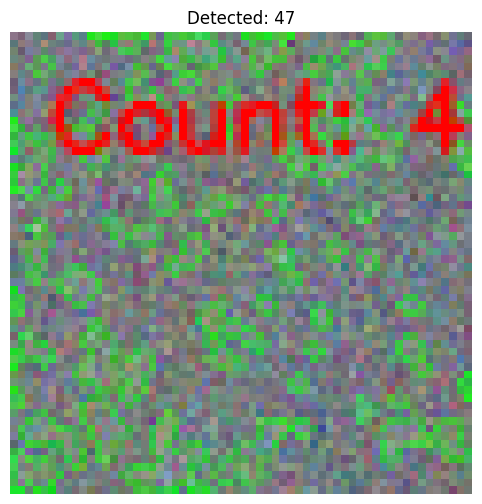

[1046/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


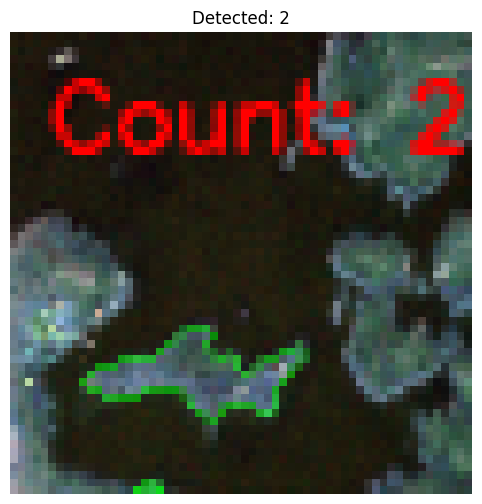

[1047/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


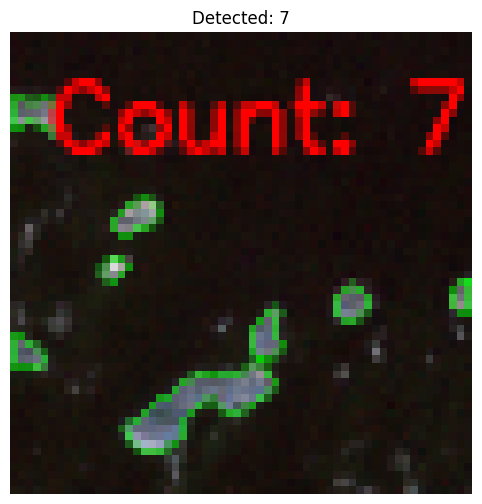

[1048/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


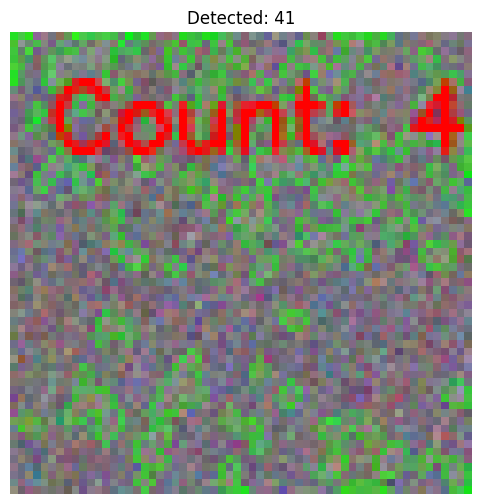

[1049/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


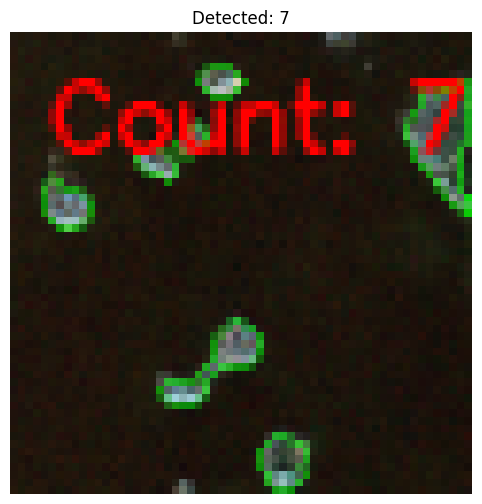

[1050/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


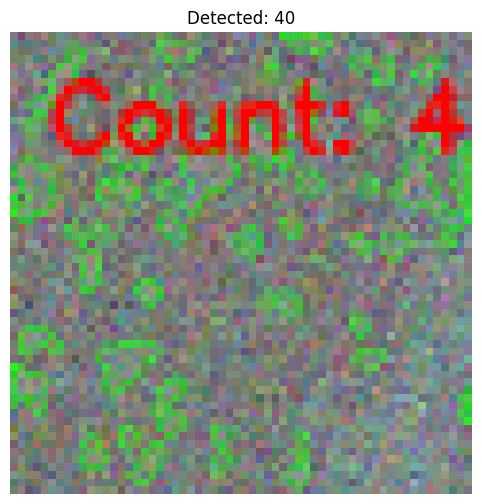

[1051/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


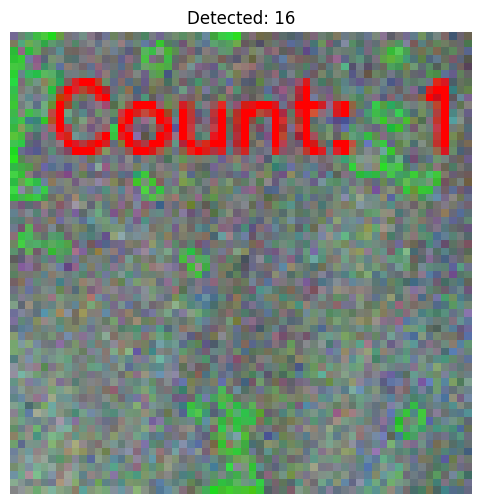

[1052/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


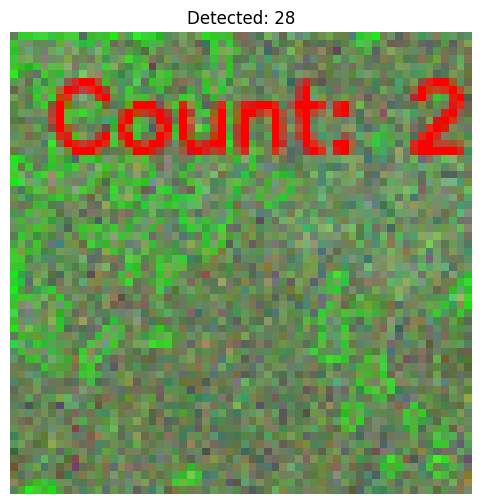

[1053/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_87
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_87 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


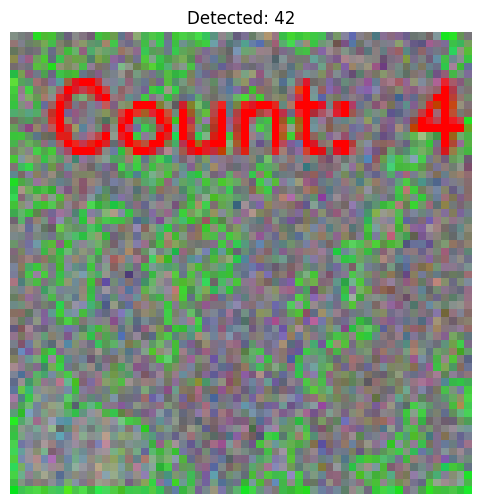

[1054/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_73
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_73 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


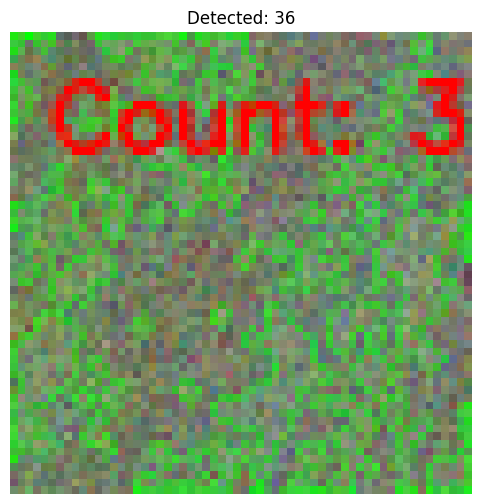

[1055/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_49_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_49_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


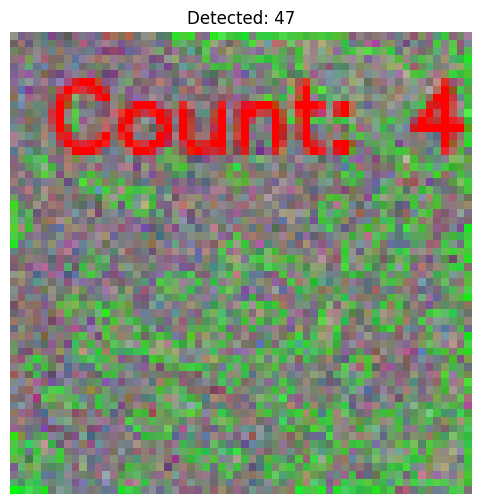

[1056/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


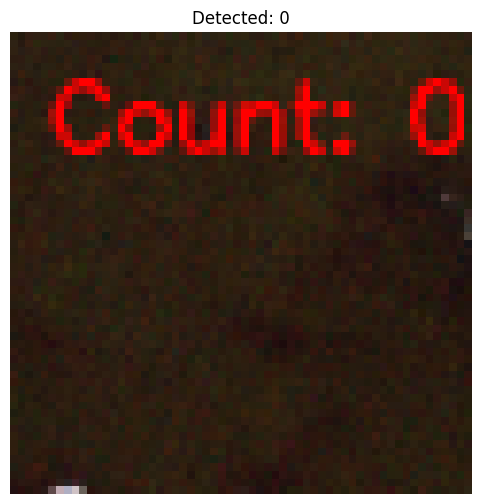

[1057/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_76
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_76 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


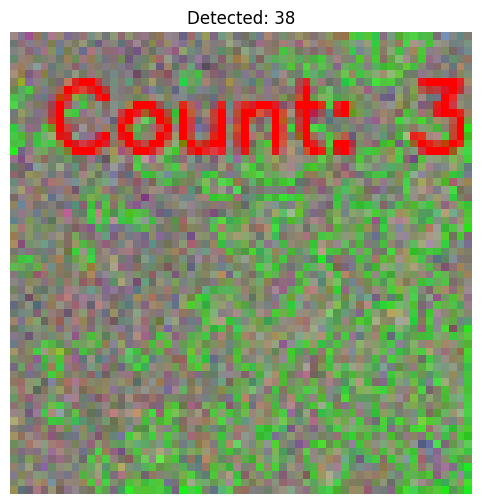

[1058/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


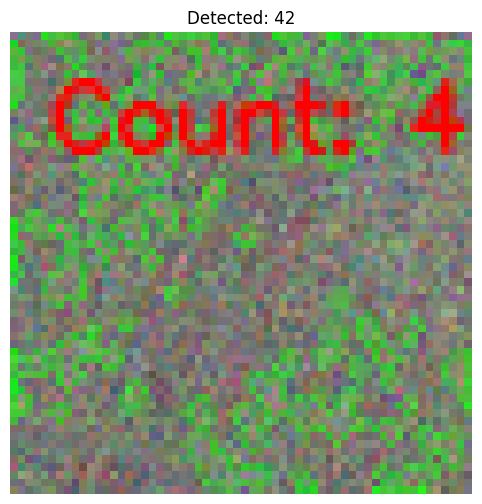

[1059/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


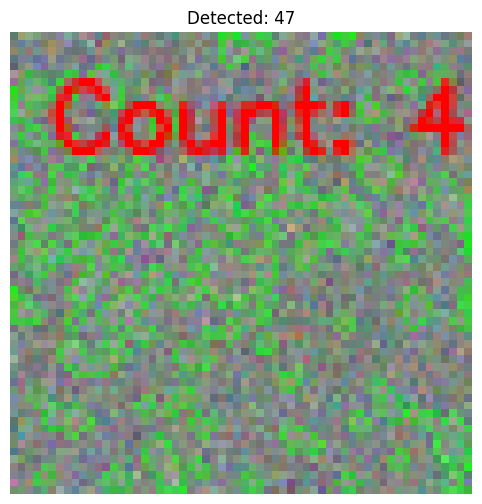

[1060/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 24                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


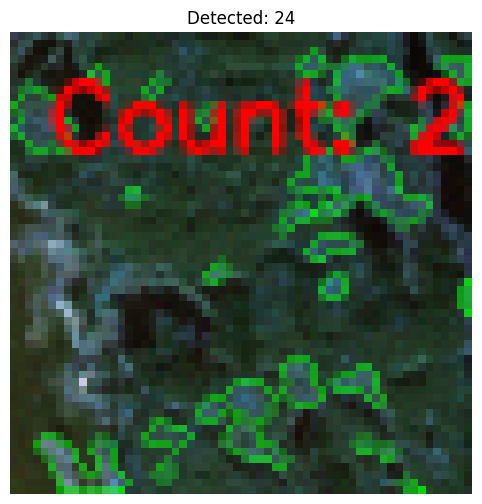

[1061/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_61_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_61_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 53                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


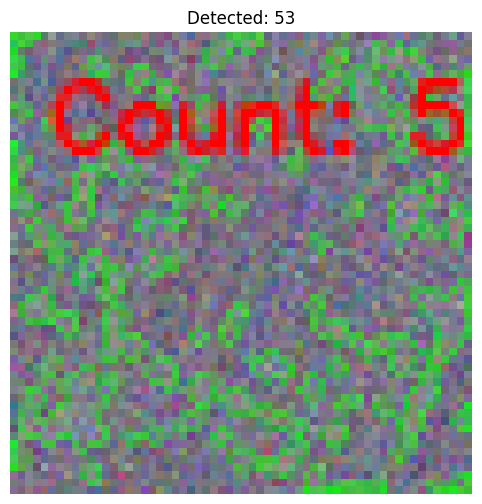

[1062/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


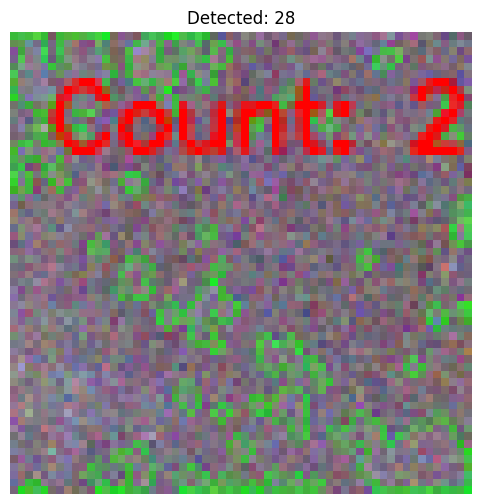

[1063/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


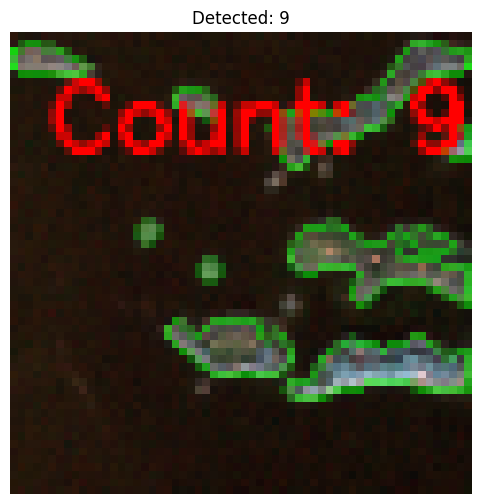

[1064/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 58                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


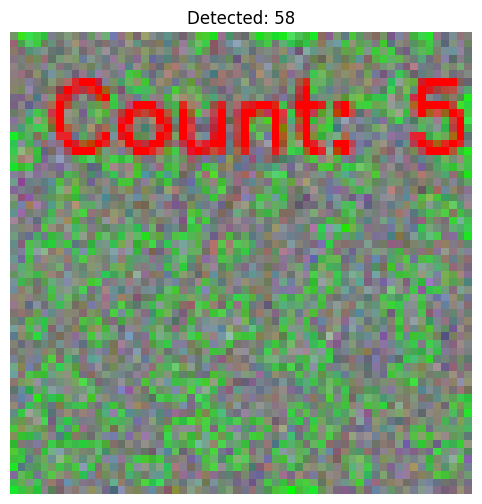

[1065/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


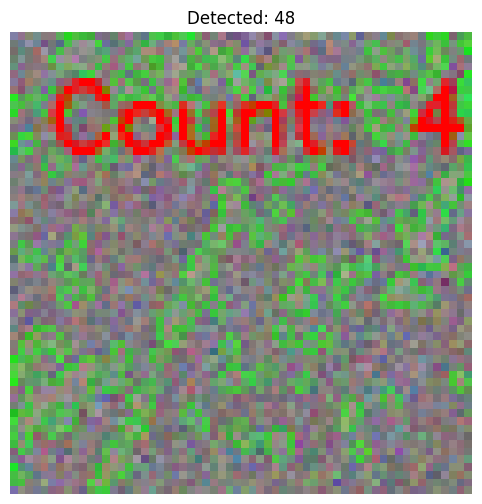

[1066/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


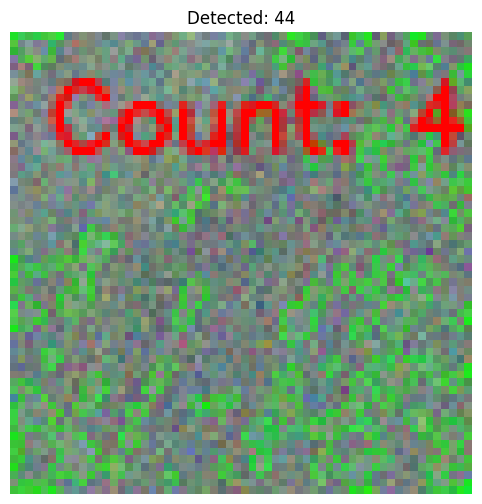

[1067/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


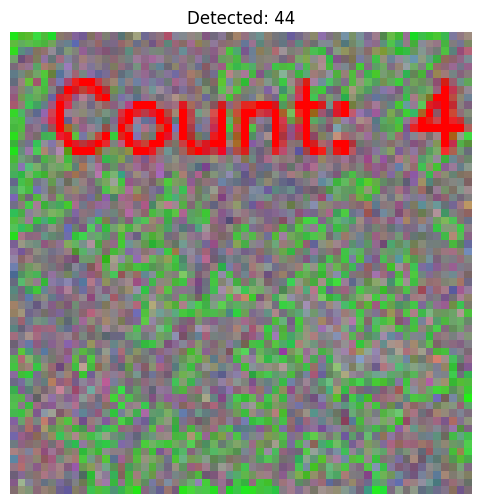

[1068/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_73
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_73 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


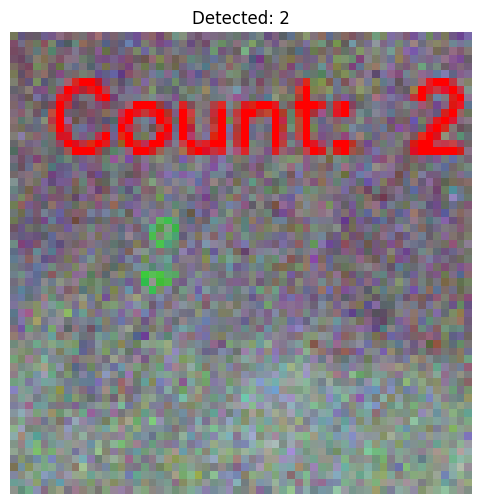

[1069/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


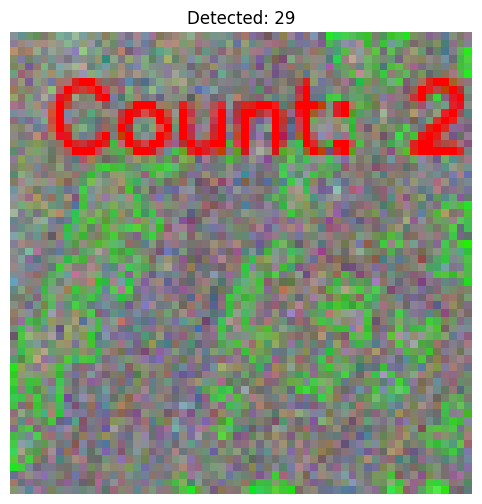

[1070/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


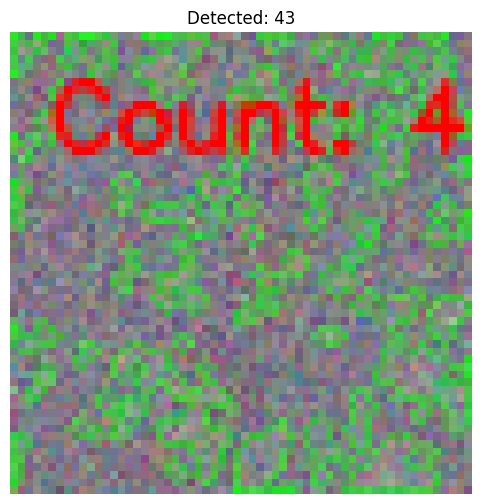

[1071/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_76
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_76 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


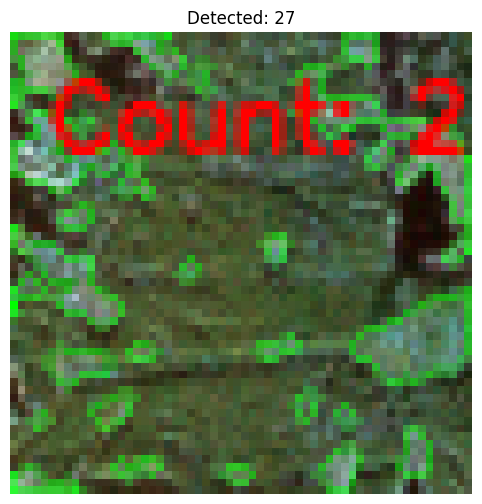

[1072/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


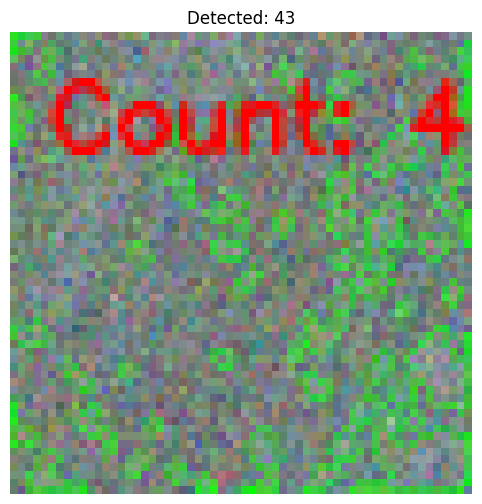

[1073/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_57_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_57_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 33                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


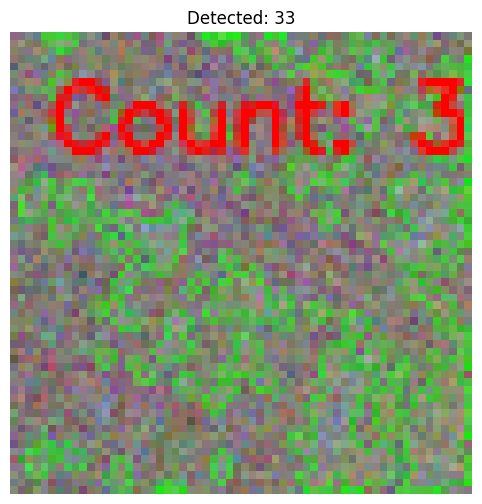

[1074/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


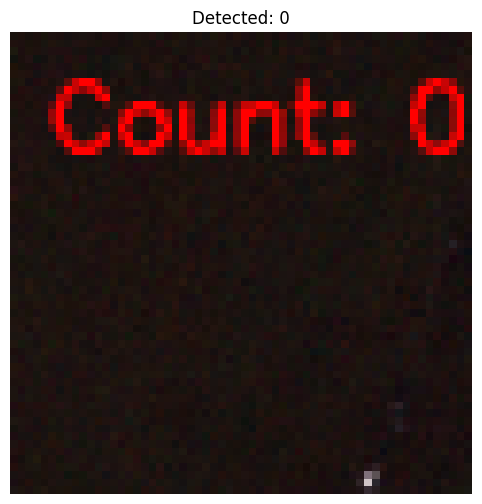

[1075/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


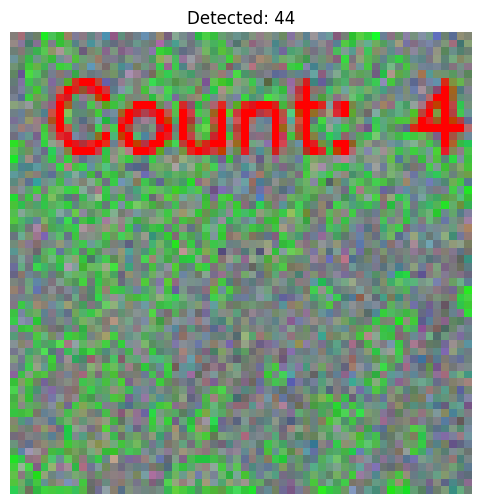

[1076/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


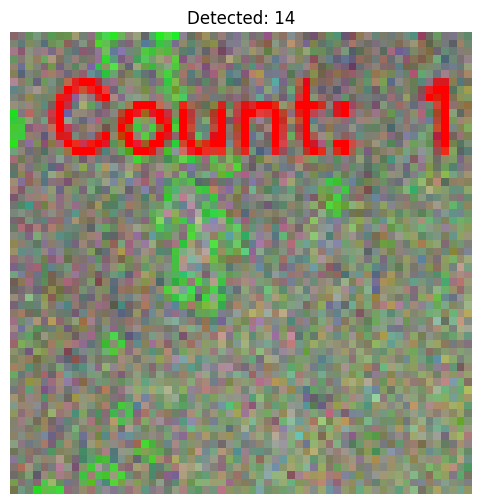

[1077/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_57_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_57_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


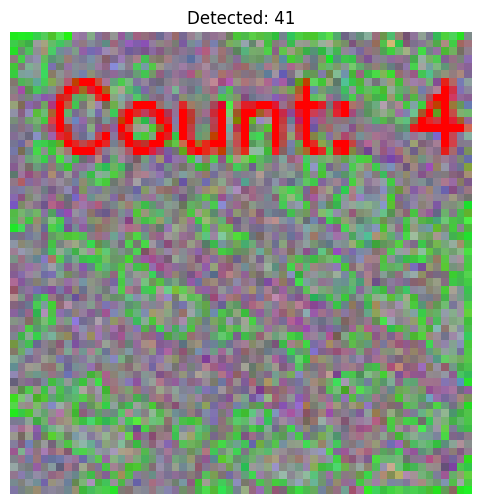

[1078/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


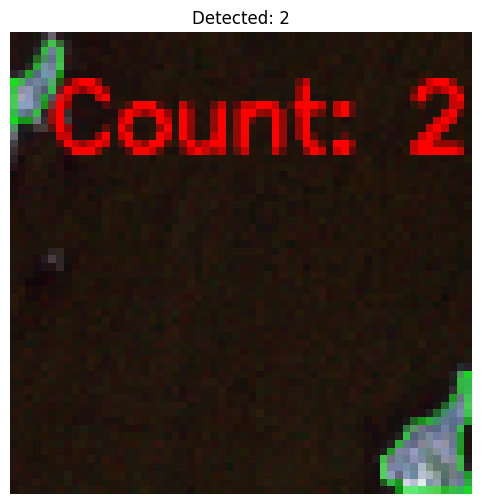

[1079/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


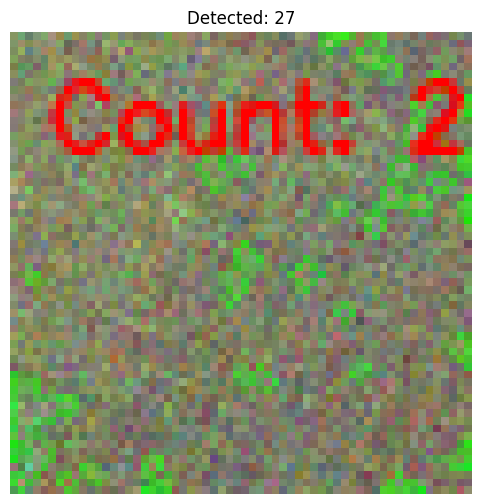

[1080/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


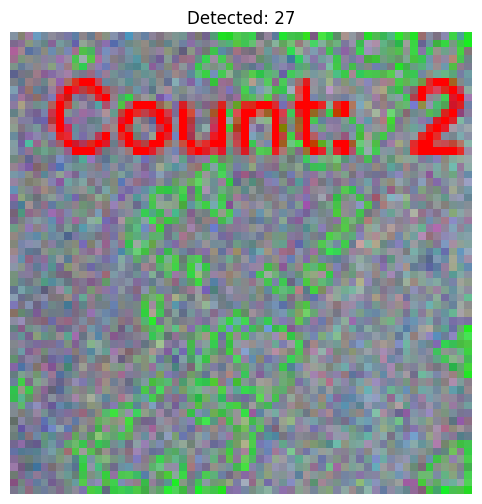

[1081/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


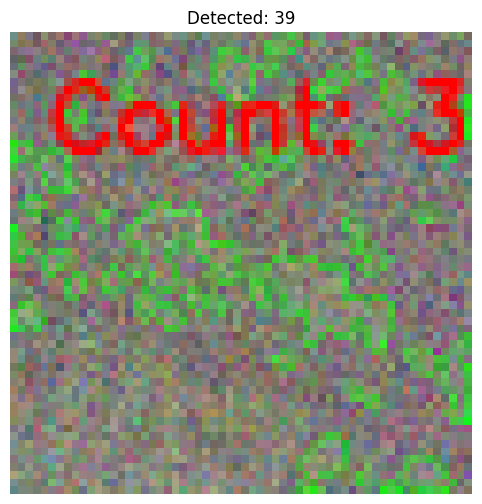

[1082/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


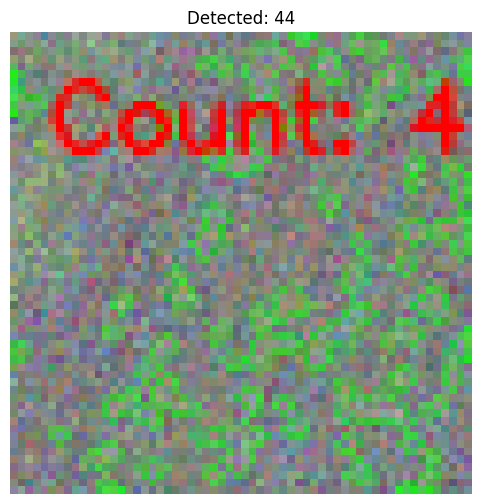

[1083/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


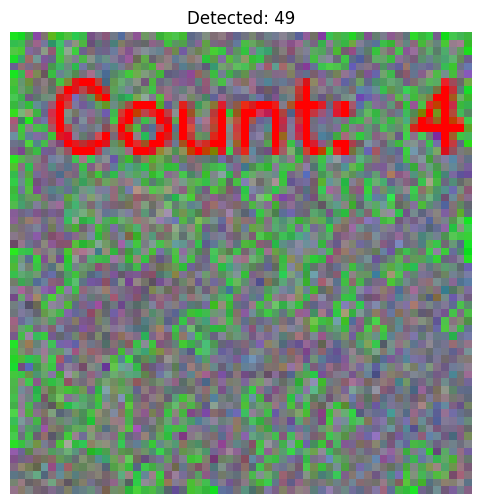

[1084/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 24                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


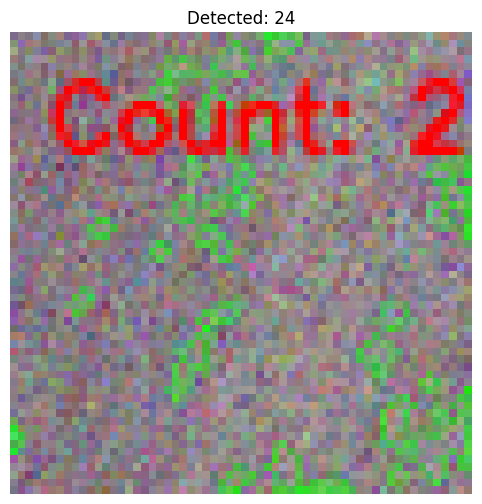

[1085/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


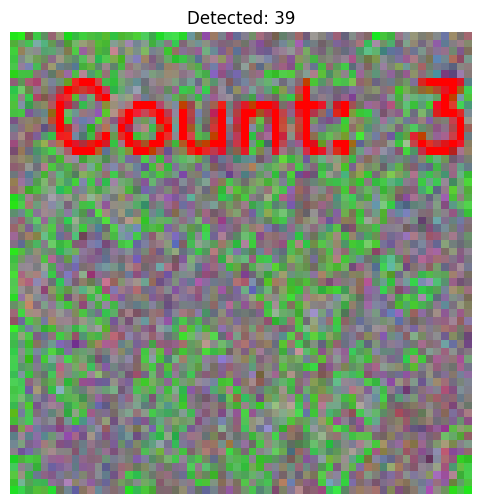

[1086/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_76
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_76 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


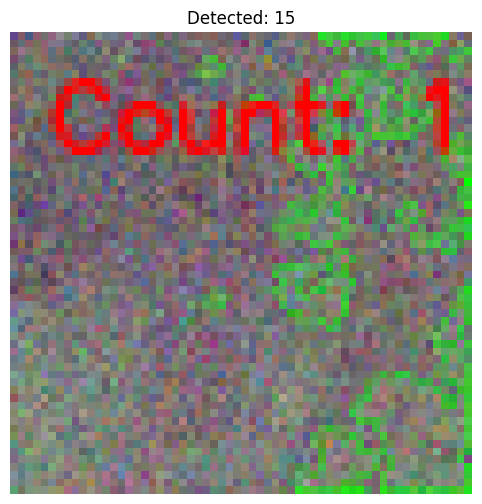

[1087/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 60                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


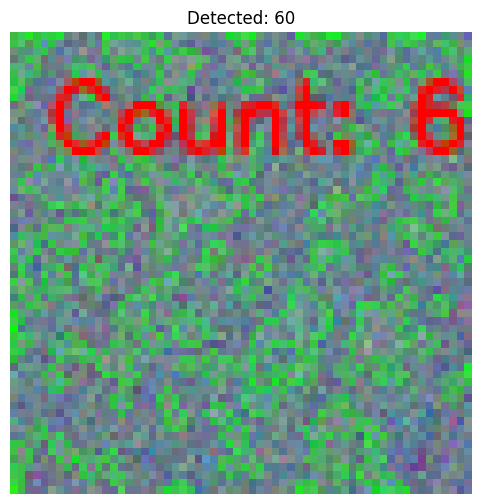

[1088/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 25                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


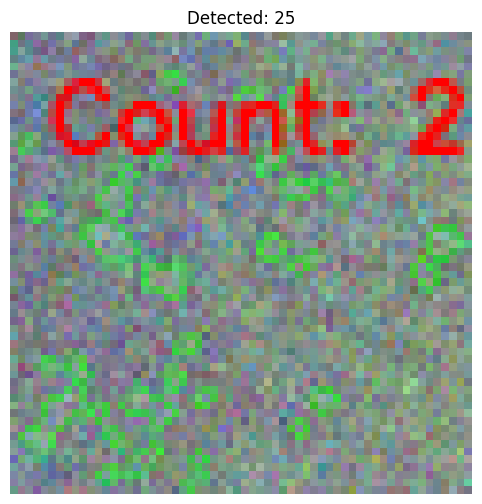

[1089/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 54                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


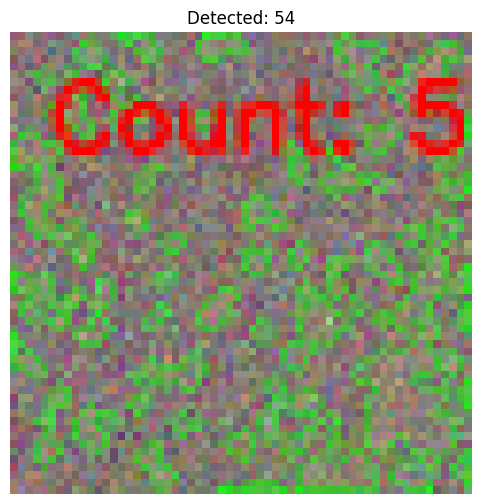

[1090/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


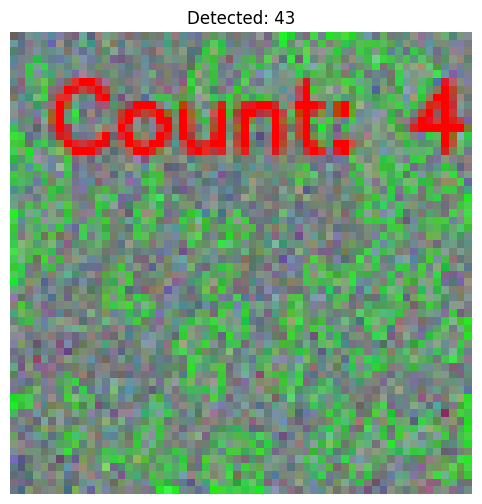

[1091/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_82
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_82 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 46                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


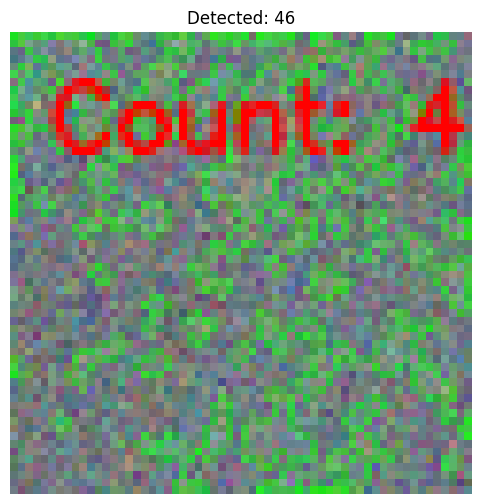

[1092/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


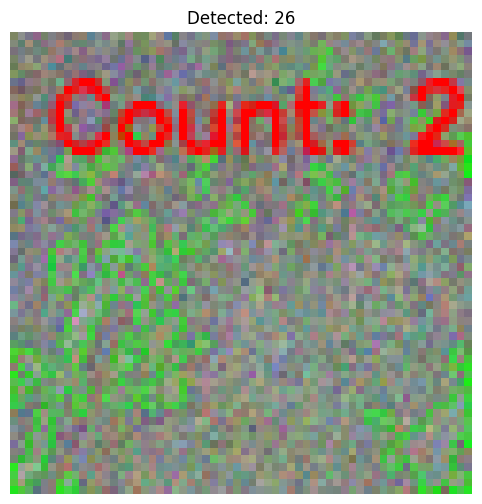

[1093/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


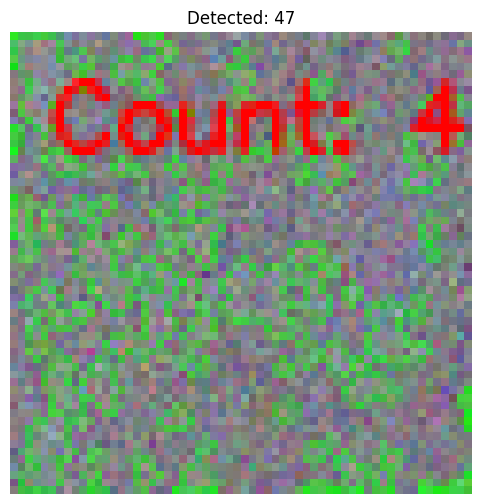

[1094/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 56                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


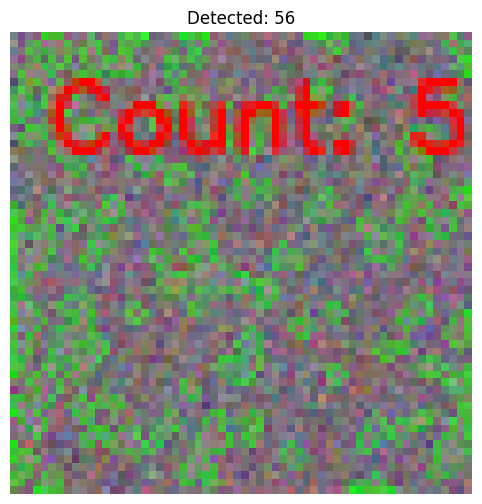

[1095/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_87
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_87 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


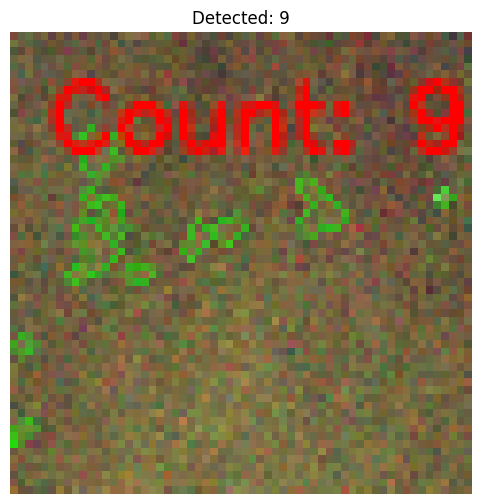

[1096/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


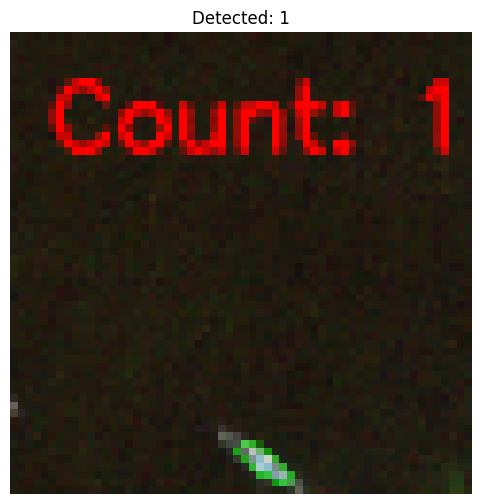

[1097/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


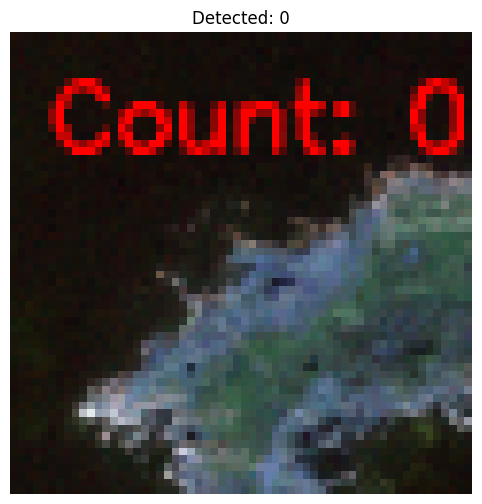

[1098/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


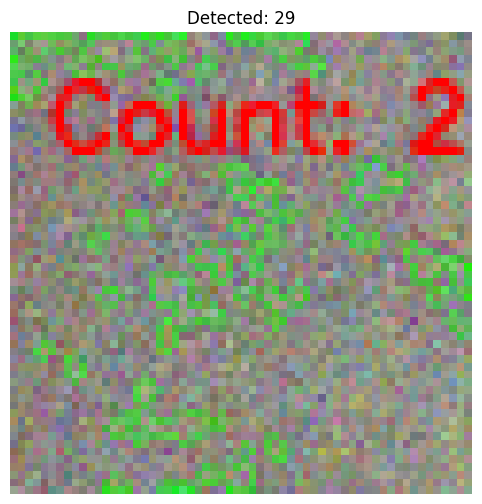

[1099/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


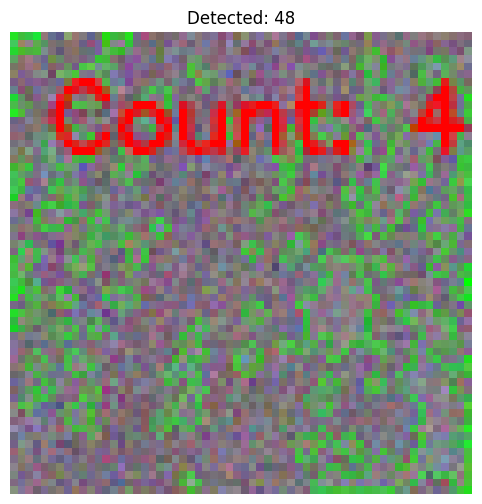

[1100/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


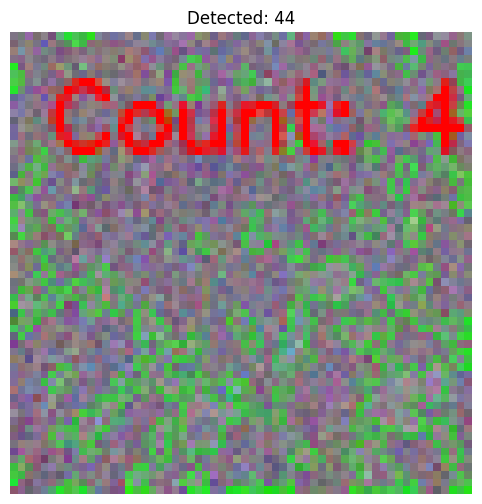

[1101/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 59                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


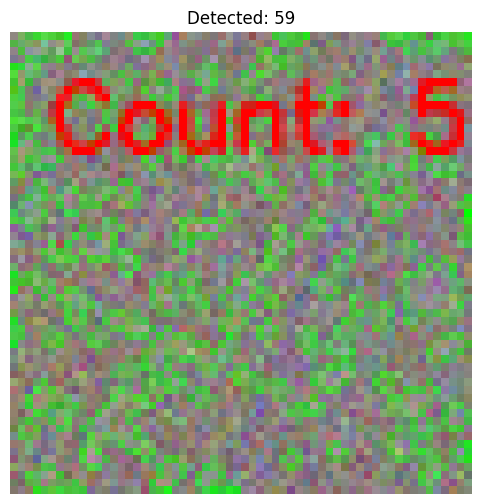

[1102/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


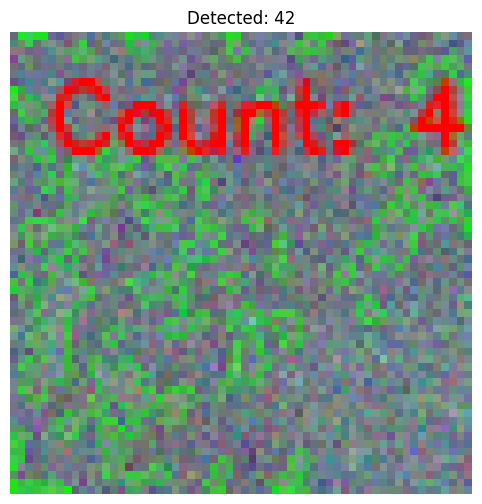

[1103/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_62_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_62_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 52                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


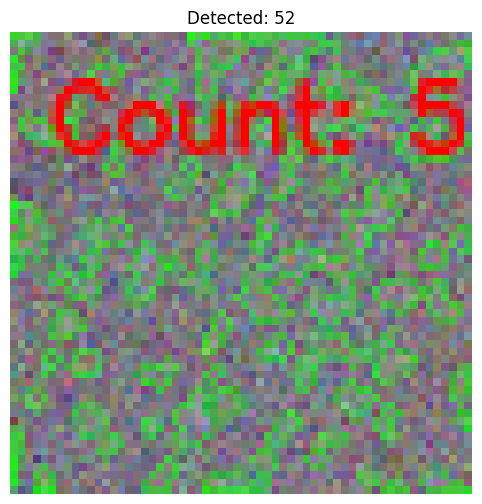

[1104/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


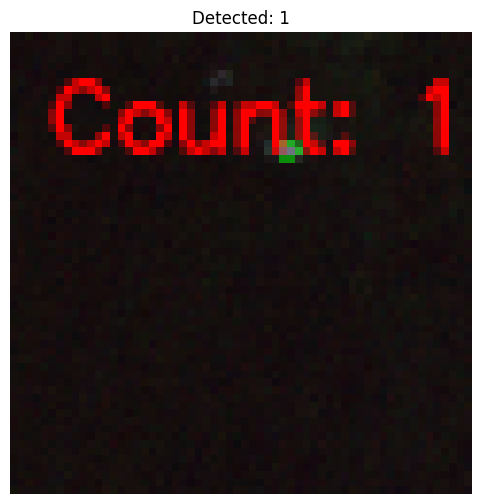

[1105/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_80
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_80 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


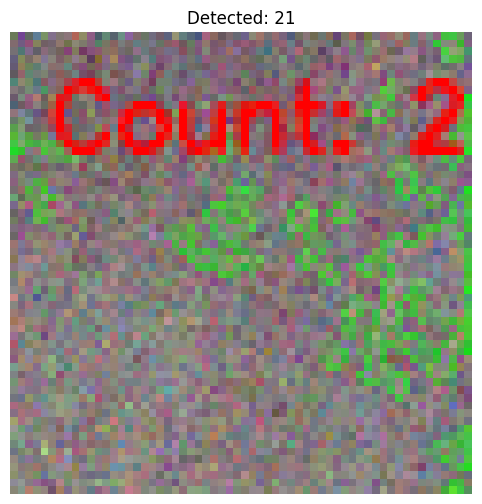

[1106/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 45                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


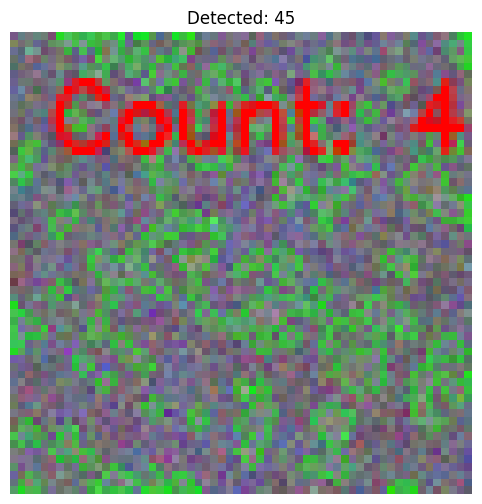

[1107/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 34                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


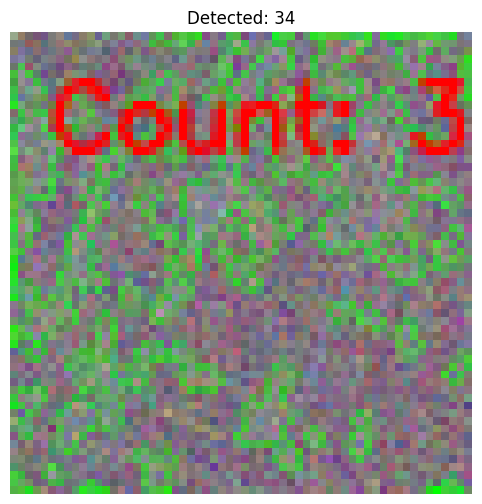

[1108/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


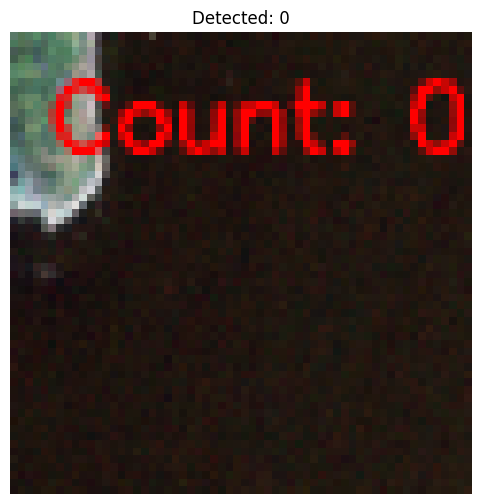

[1109/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_76
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_76 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 45                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


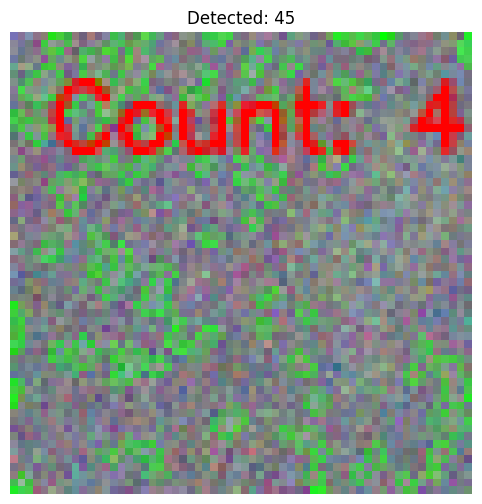

[1110/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


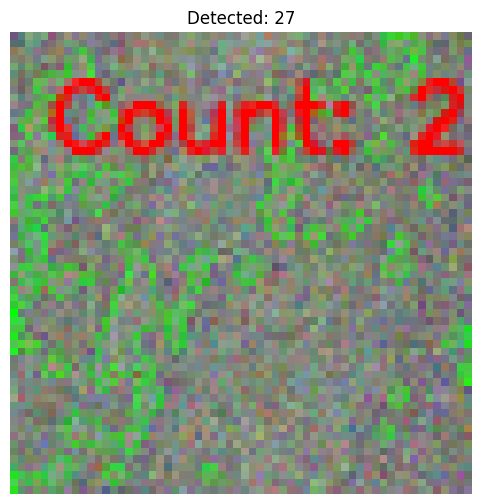

[1111/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


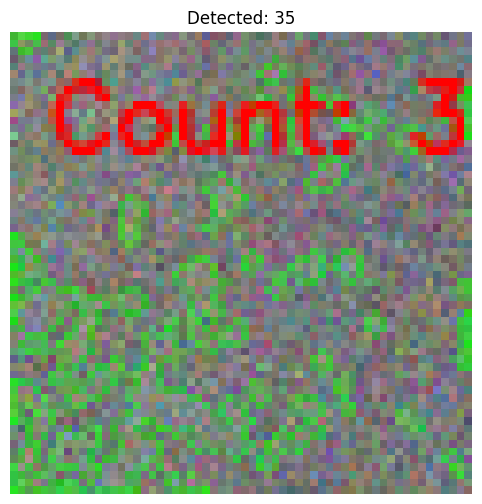

[1112/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


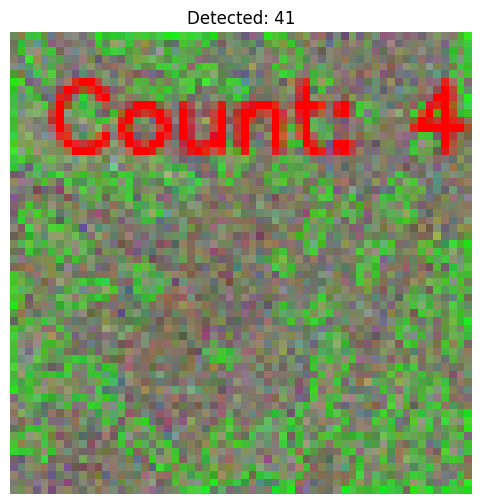

[1113/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


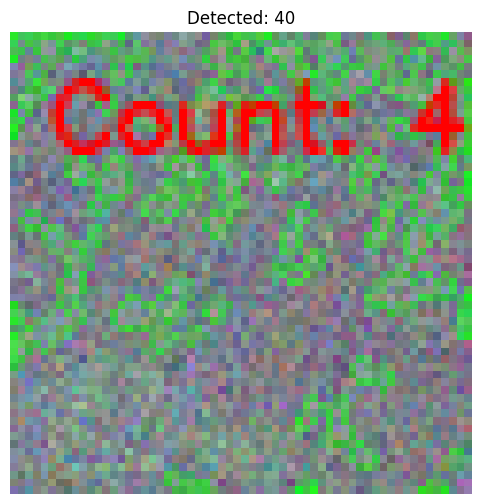

[1114/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 51                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


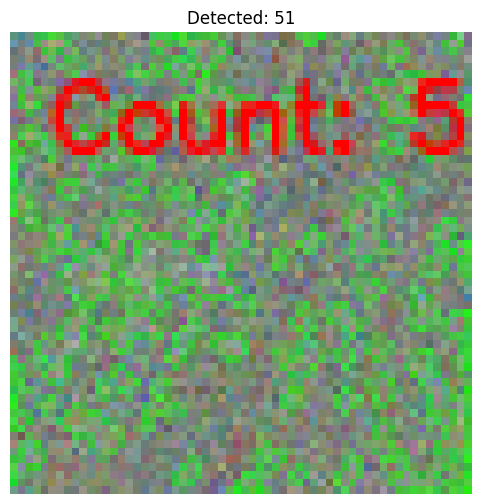

[1115/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_62_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_62_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


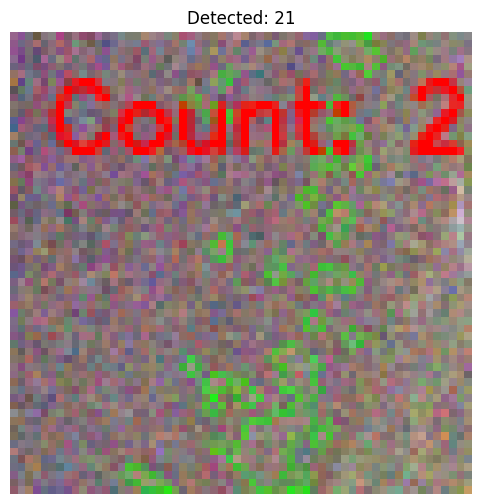

[1116/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 25                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


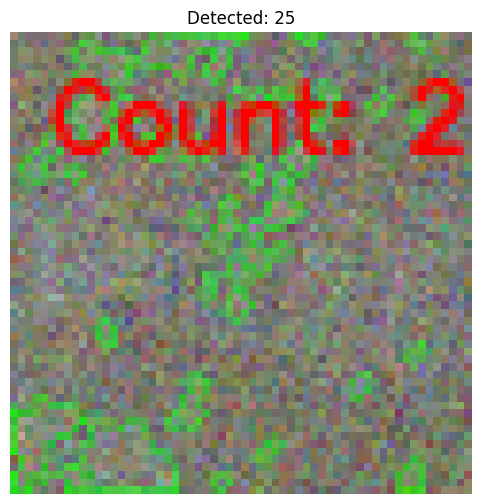

[1117/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 23                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


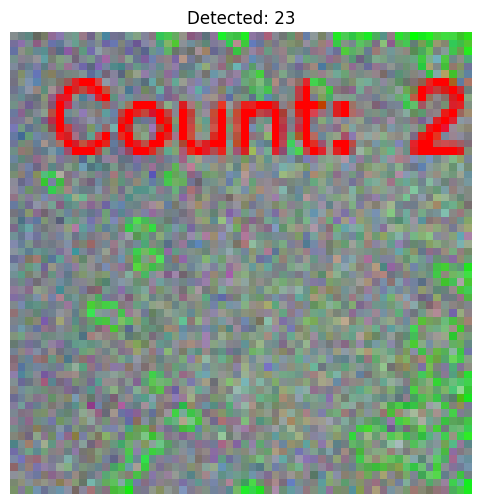

[1118/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_87
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_87 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


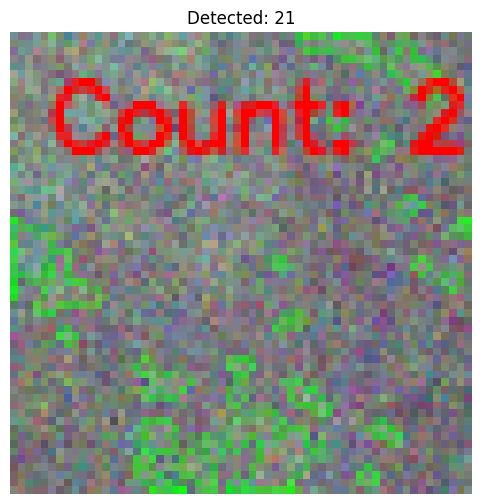

[1119/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 55                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


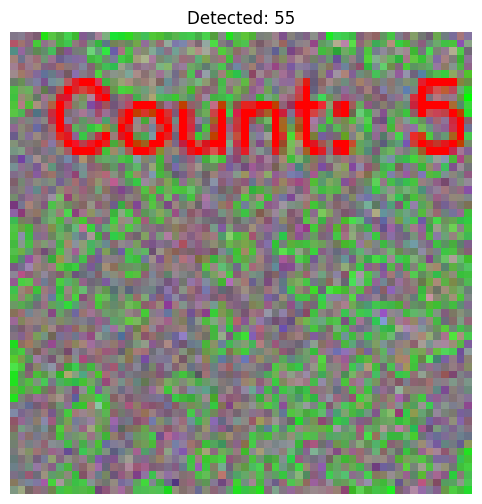

[1120/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


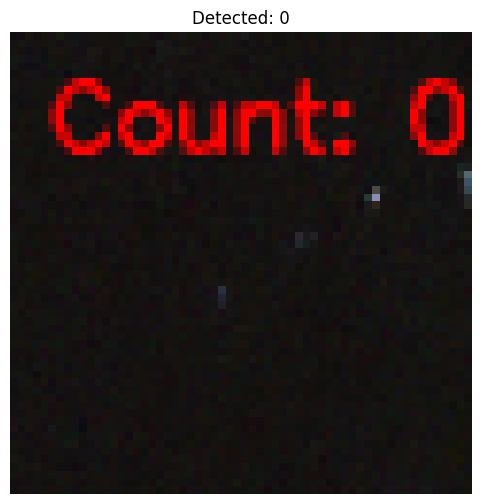

[1121/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


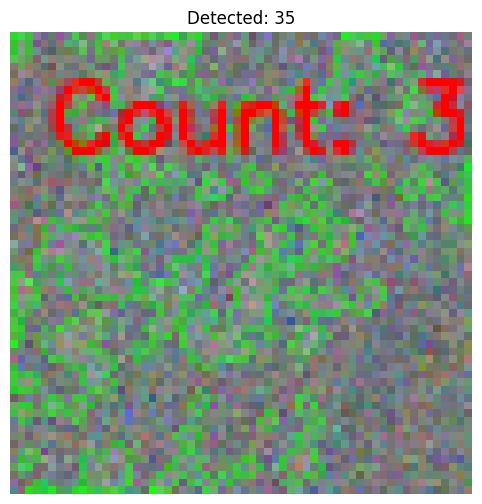

[1122/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


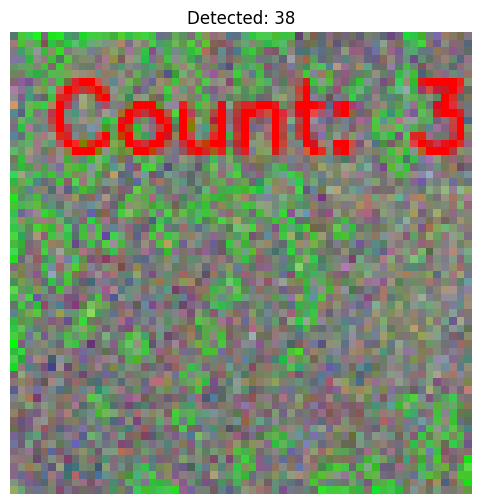

[1123/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


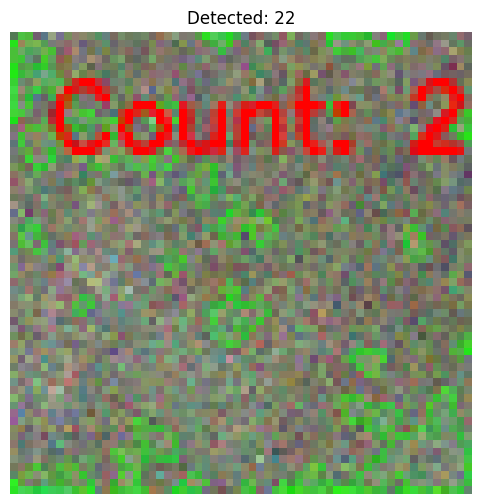

[1124/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 58                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


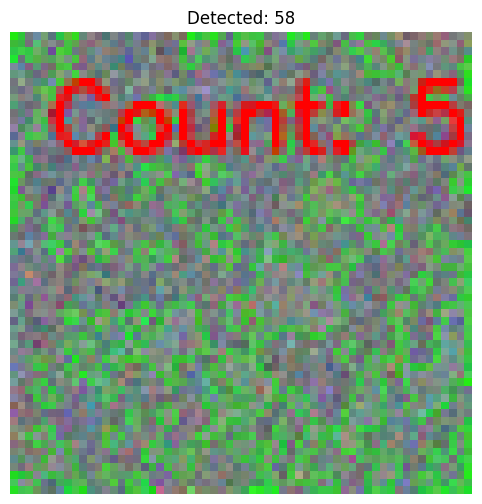

[1125/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 31                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


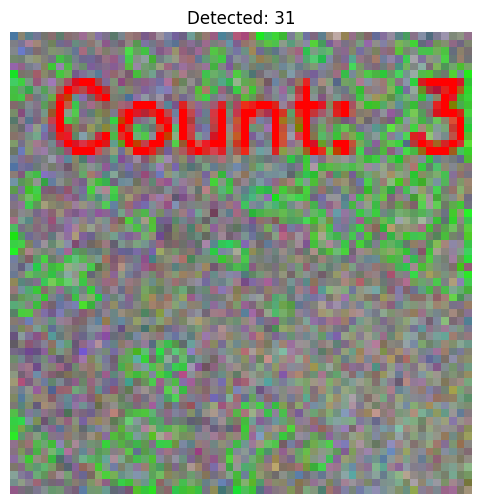

[1126/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 37                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


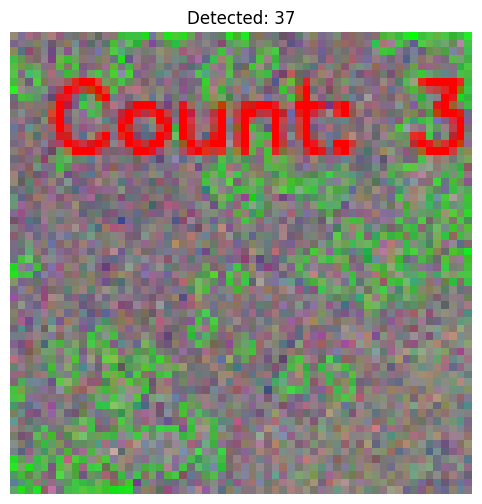

[1127/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 45                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


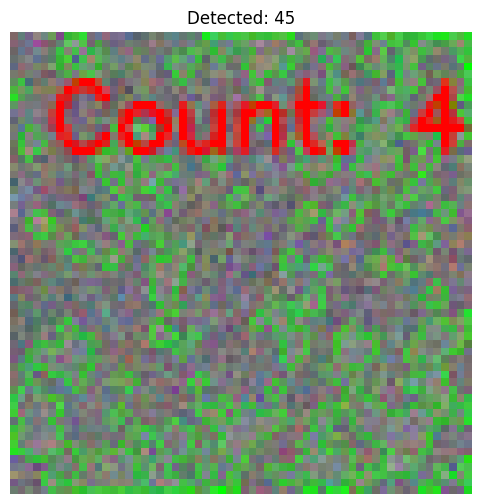

[1128/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


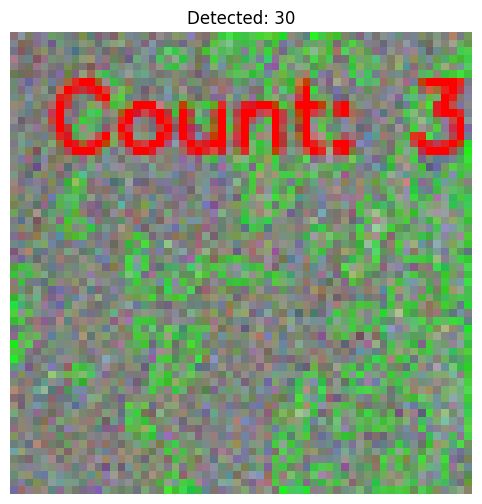

[1129/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 51                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


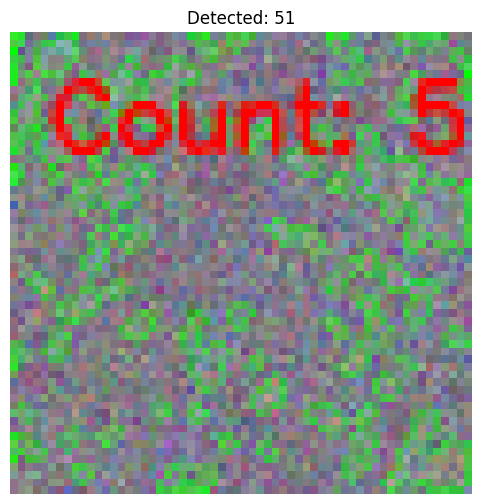

[1130/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


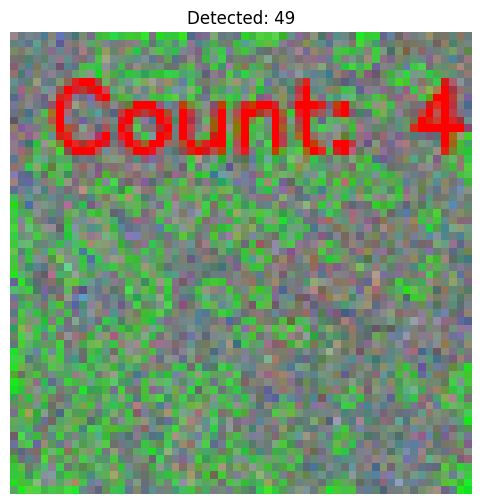

[1131/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


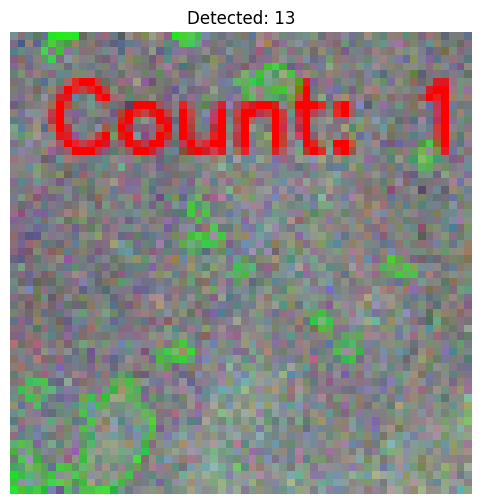

[1132/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 11                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


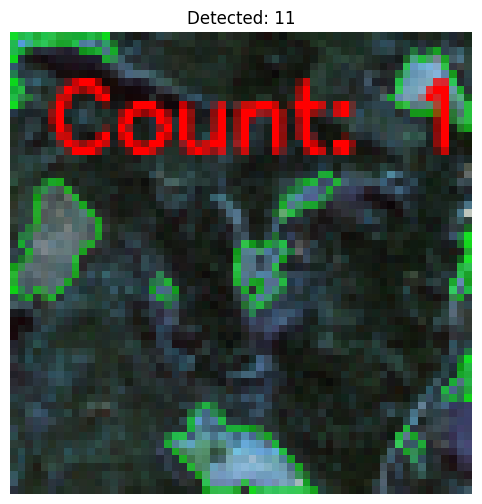

[1133/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_85
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_85 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


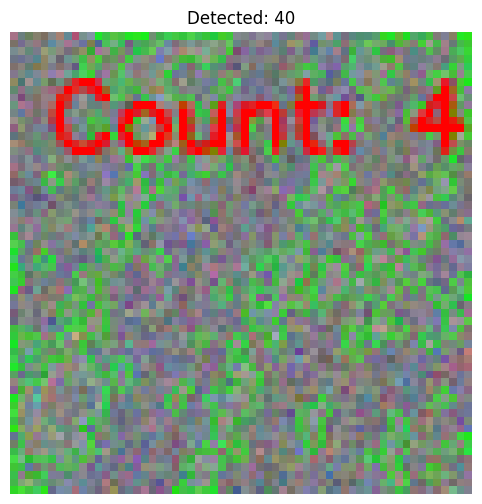

[1134/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


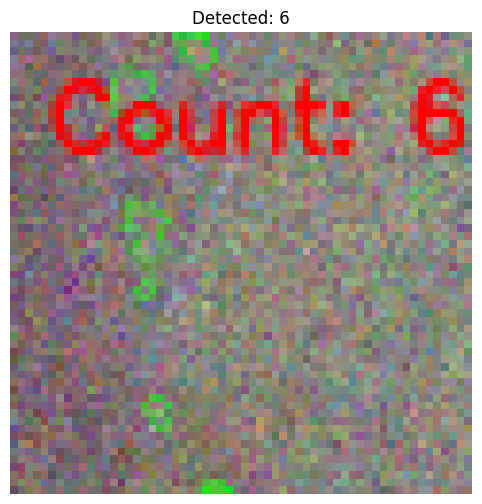

[1135/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


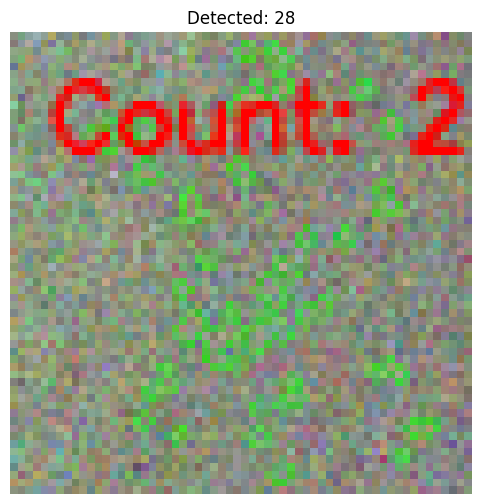

[1136/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


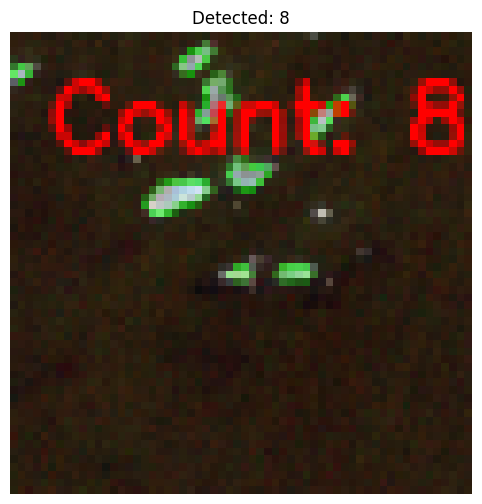

[1137/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_53_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_53_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 54                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


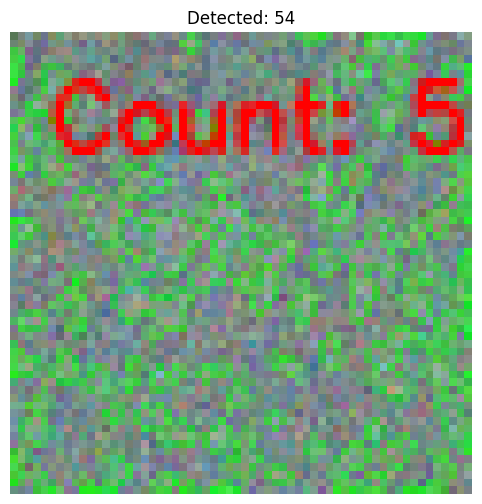

[1138/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


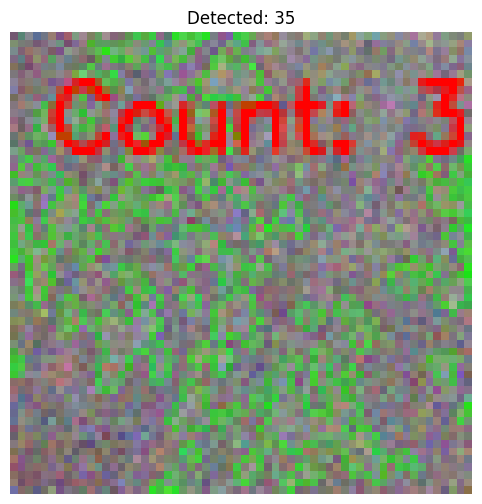

[1139/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 31                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


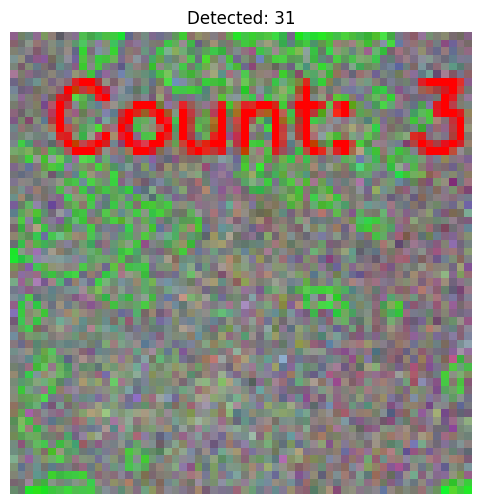

[1140/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


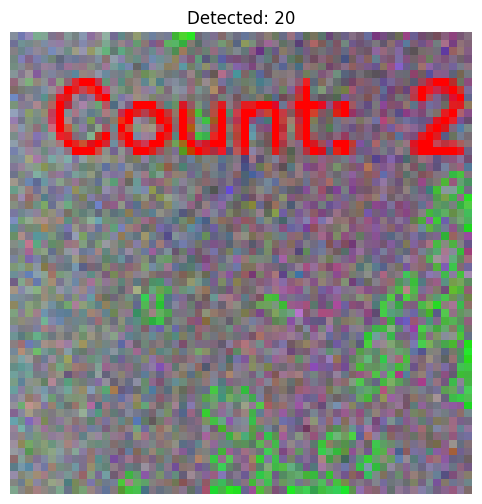

[1141/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_57_73
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_57_73 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 45                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


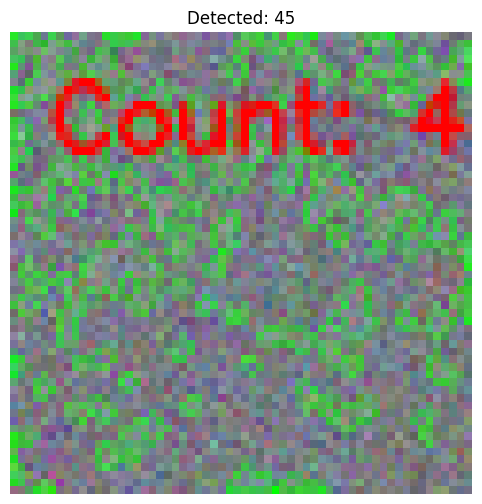

[1142/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


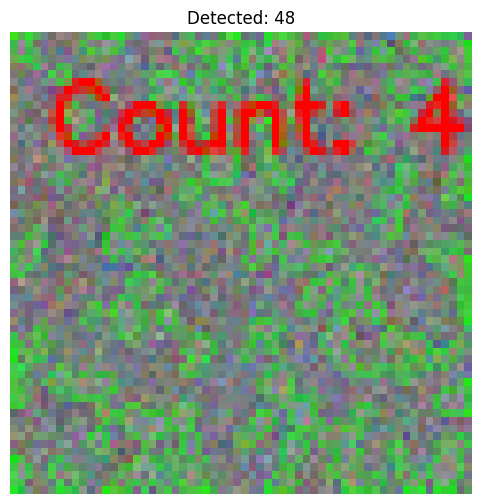

[1143/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


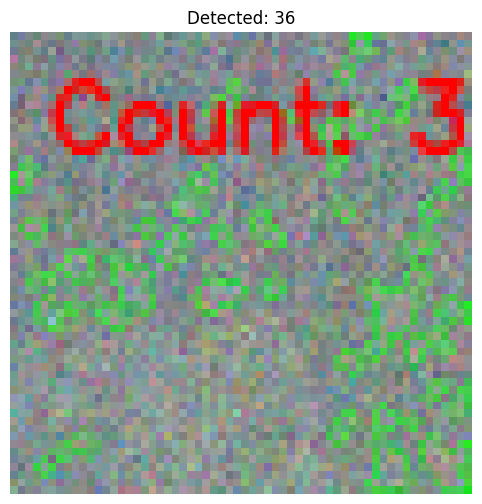

[1144/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_50_82
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_50_82 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


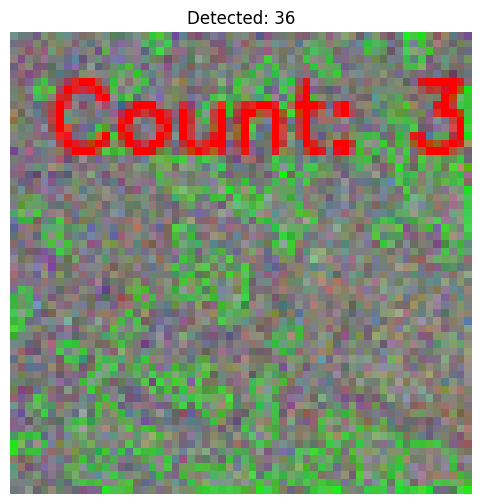

[1145/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


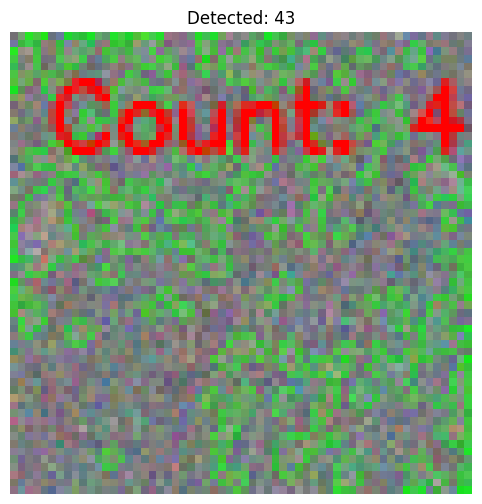

[1146/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 53                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


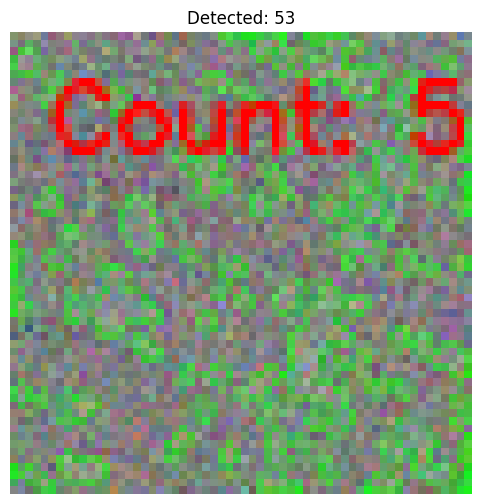

[1147/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


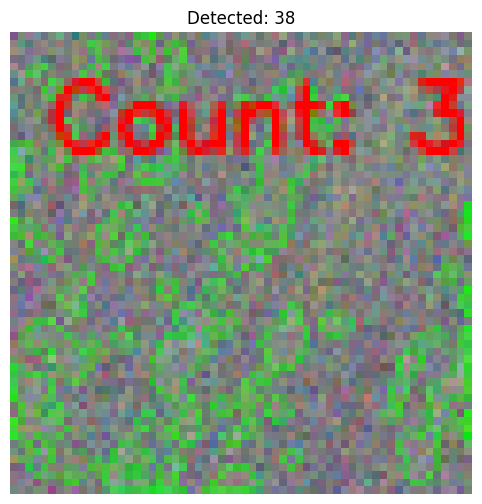

[1148/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 24                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


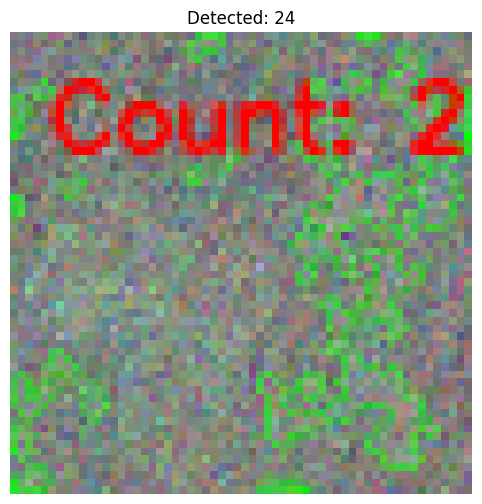

[1149/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 25                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


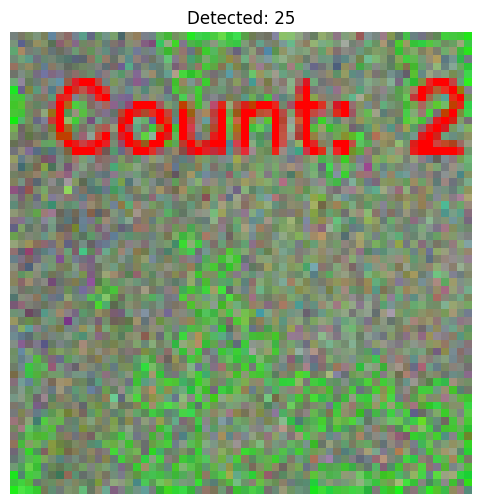

[1150/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


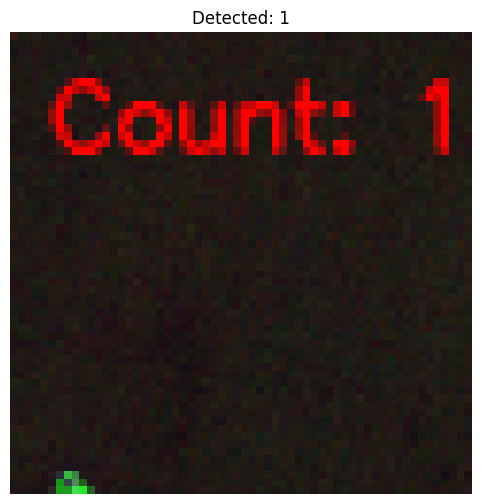

[1151/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


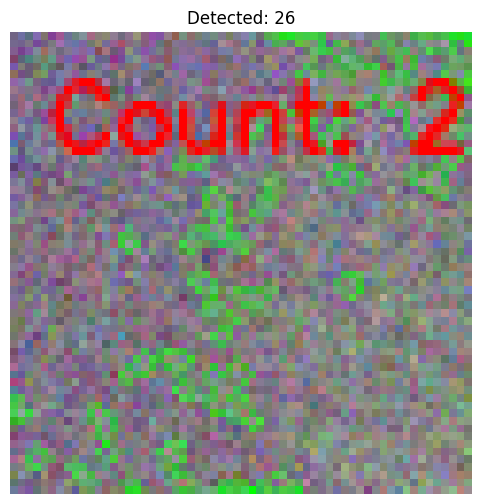

[1152/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_68
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_68 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


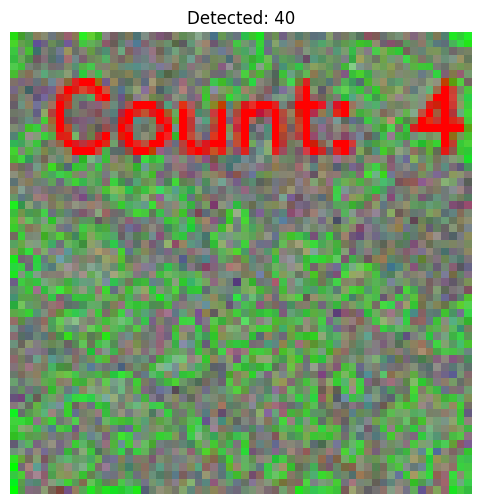

[1153/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


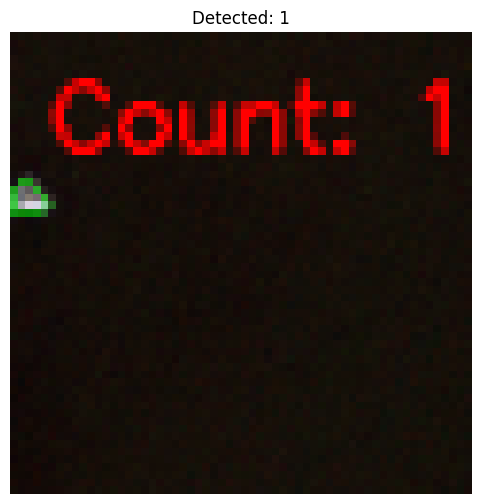

[1154/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 25                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


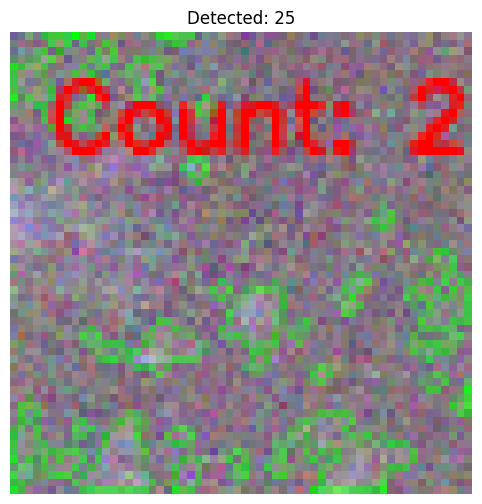

[1155/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_61_73
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_61_73 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


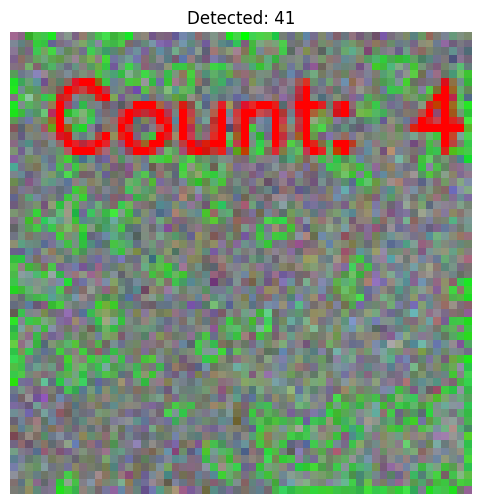

[1156/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 50                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


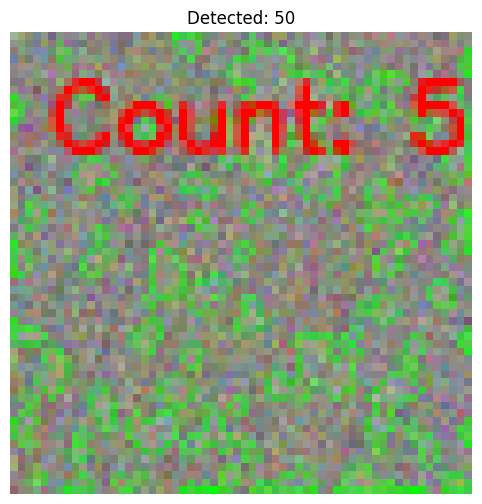

[1157/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


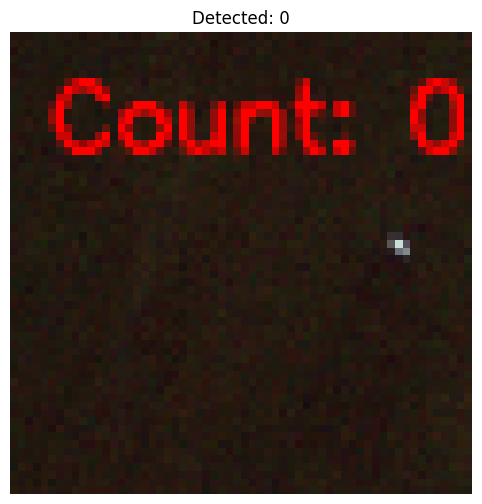

[1158/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 34                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


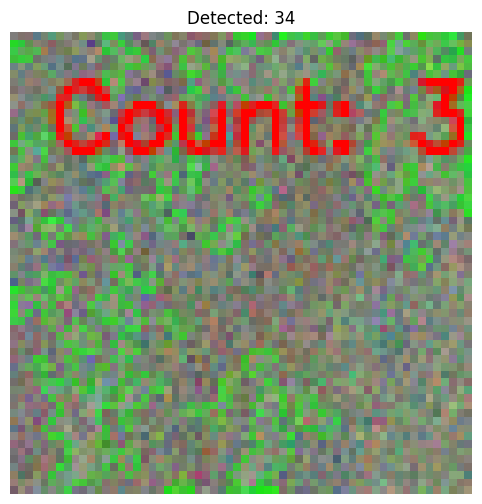

[1159/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


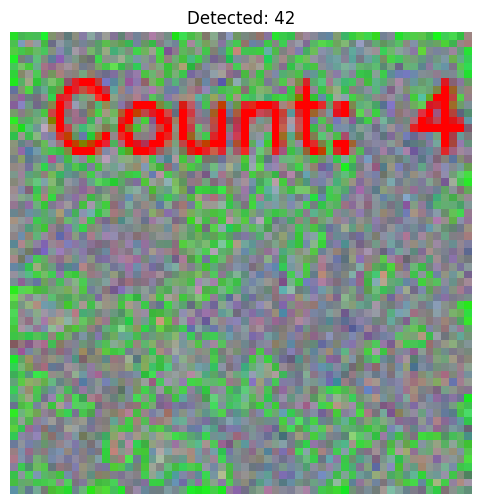

[1160/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


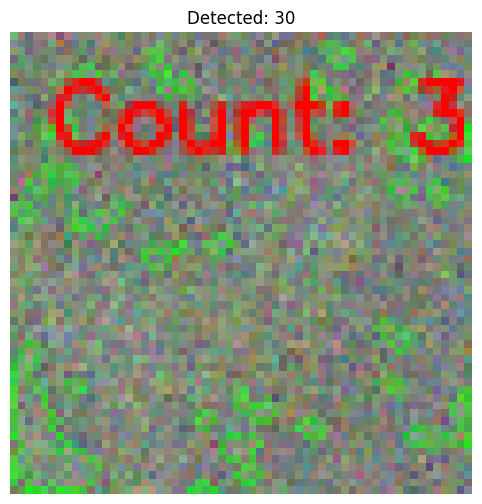

[1161/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 31                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


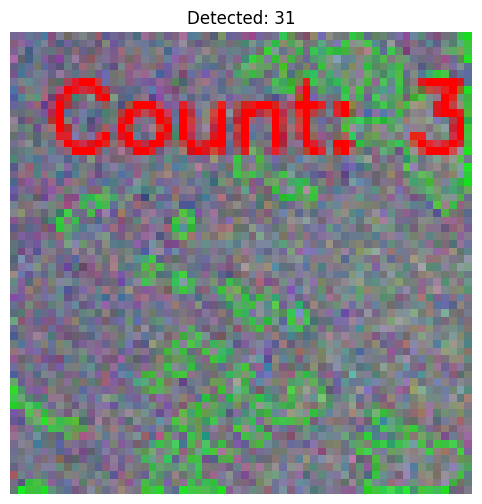

[1162/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


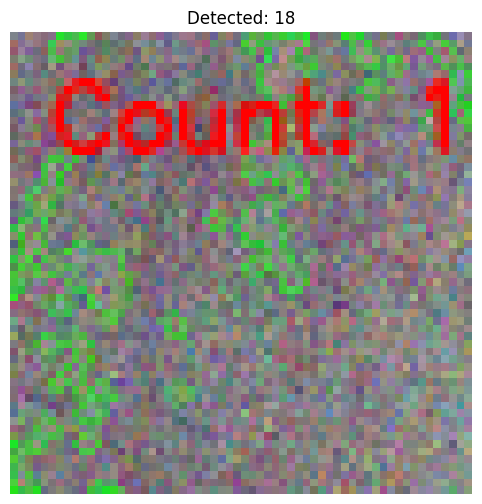

[1163/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


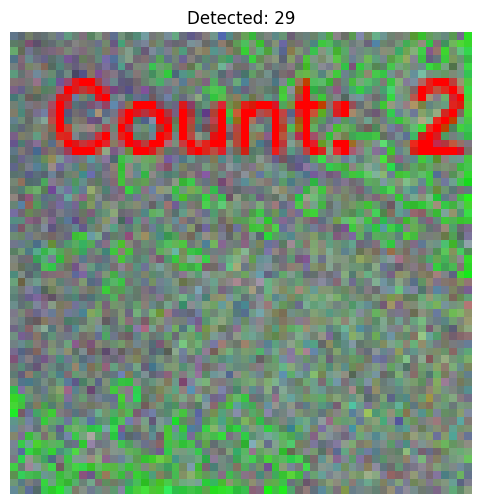

[1164/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 0                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


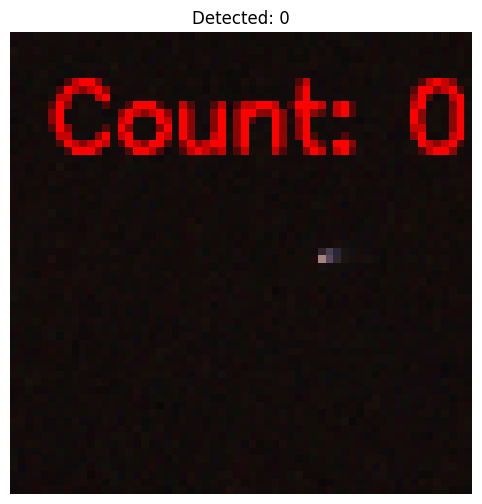

[1165/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


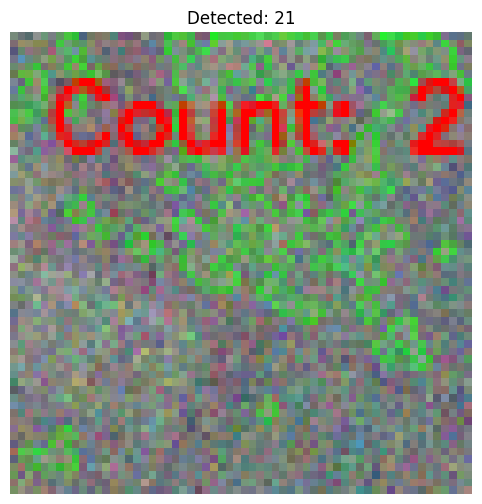

[1166/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


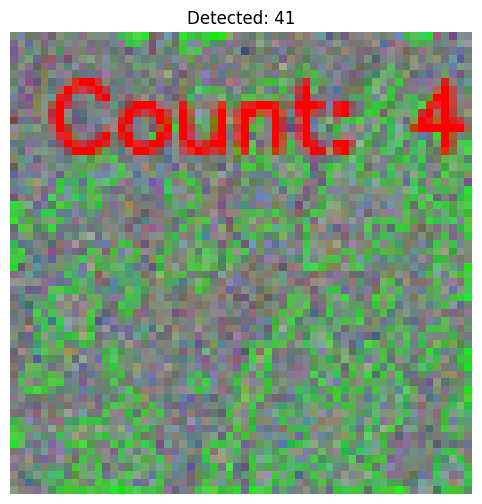

[1167/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


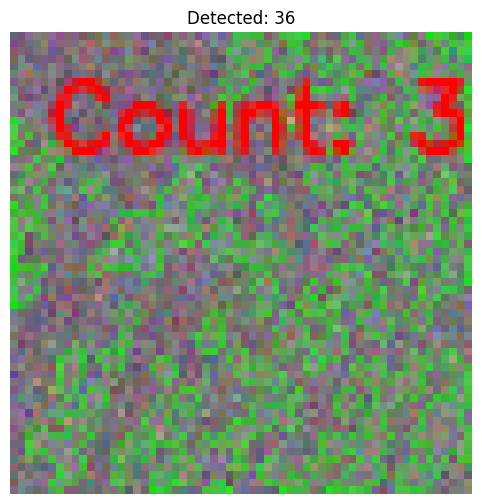

[1168/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


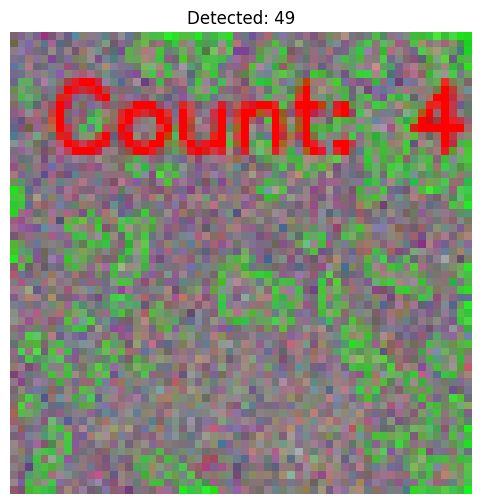

[1169/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 34                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


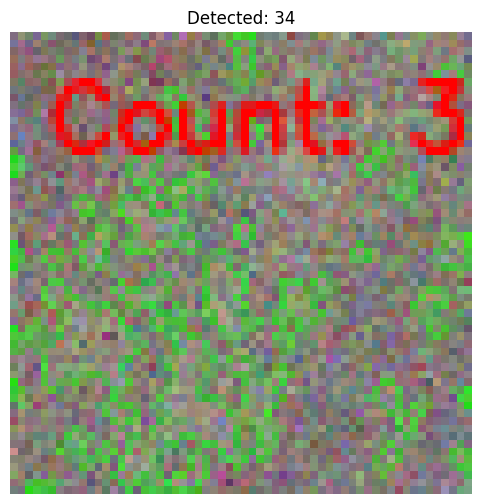

[1170/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 51                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


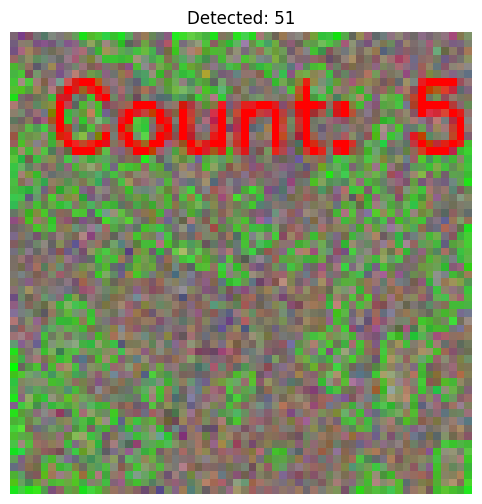

[1171/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 18                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


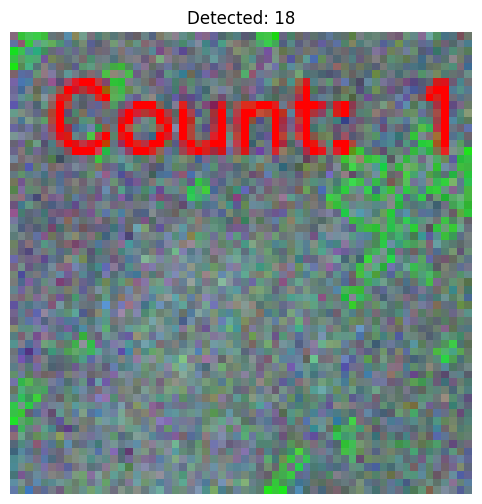

[1172/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 6                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


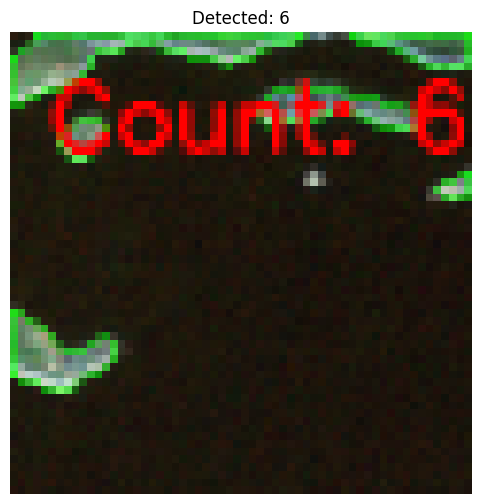

[1173/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


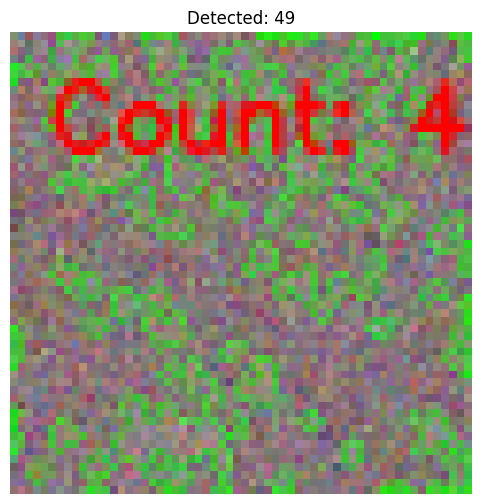

[1174/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 55                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


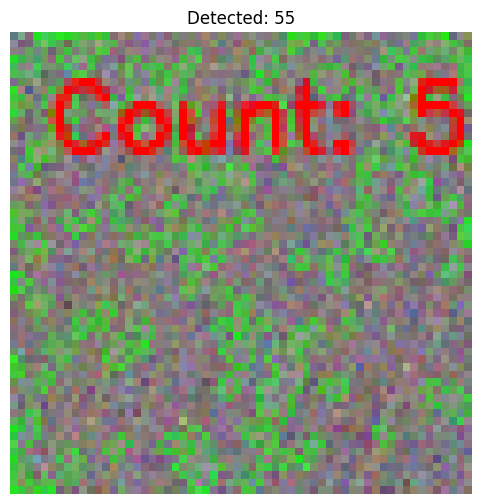

[1175/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


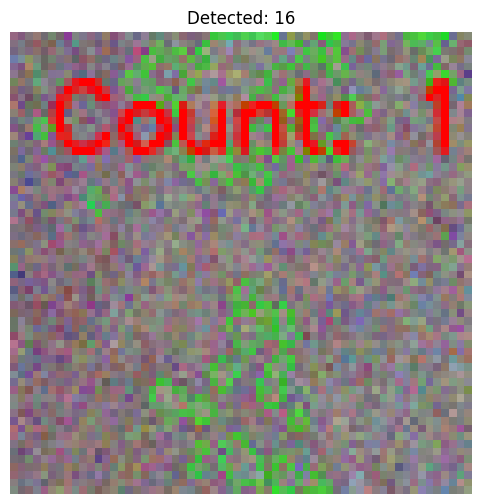

[1176/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


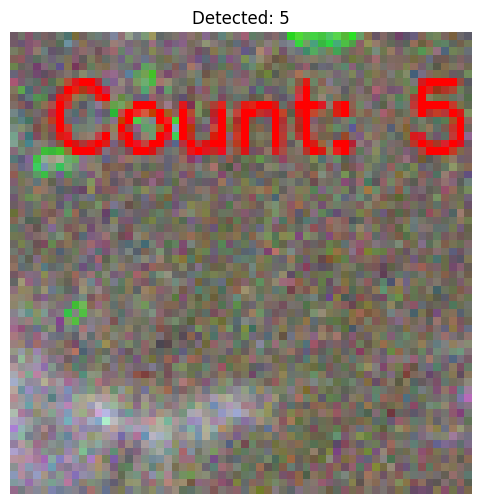

[1177/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 56                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


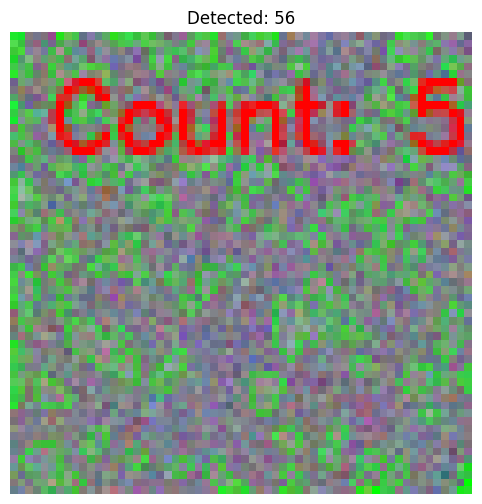

[1178/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


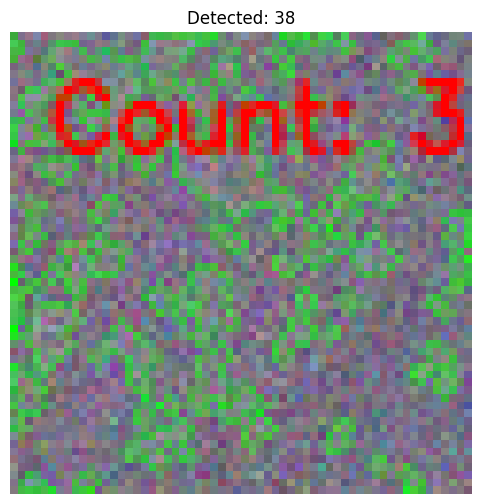

[1179/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


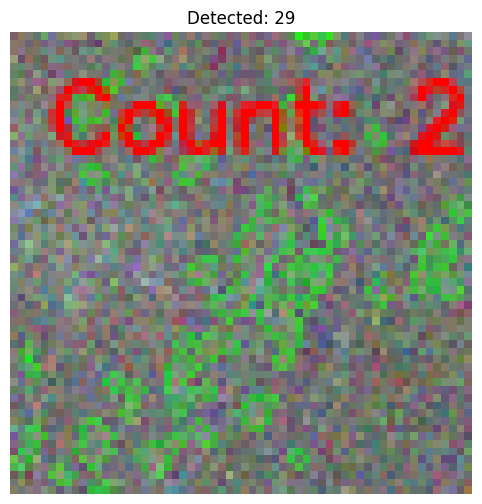

[1180/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_56_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 53                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


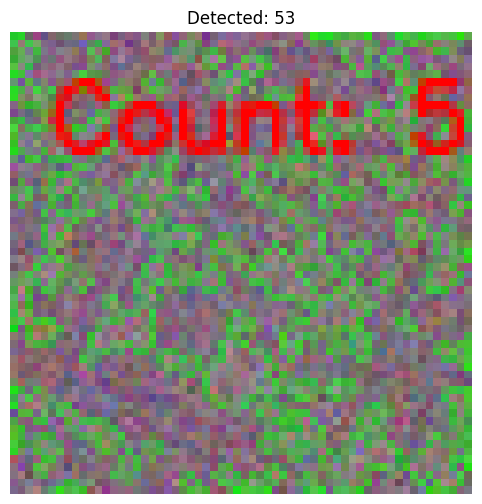

[1181/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


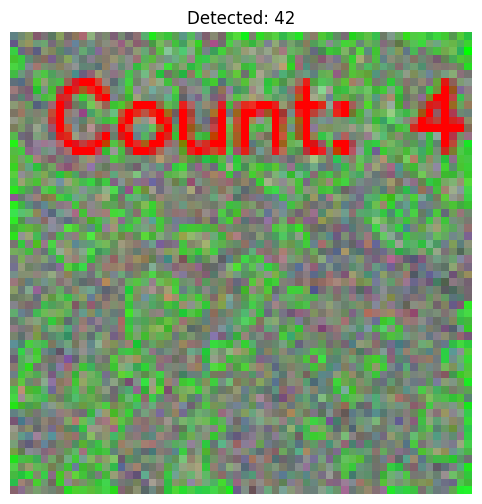

[1182/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 54                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


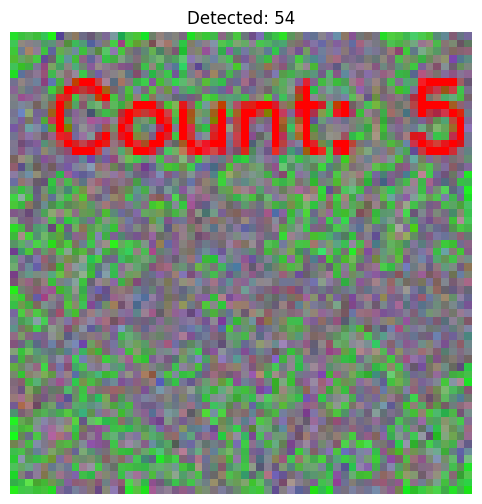

[1183/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


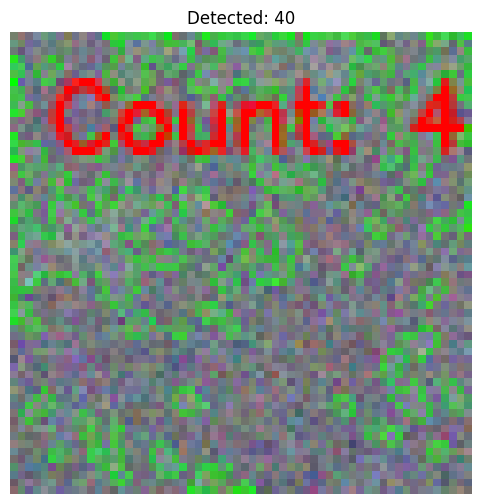

[1184/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


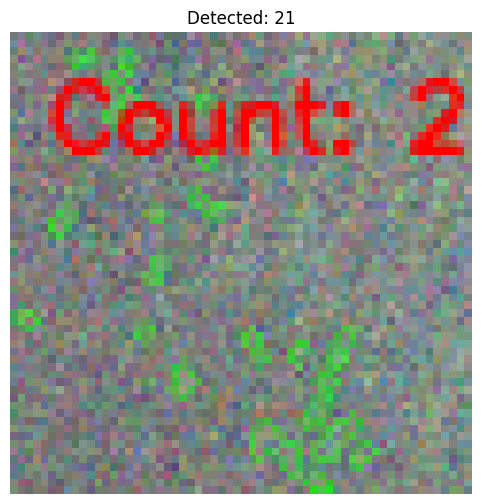

[1185/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_68
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_68 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


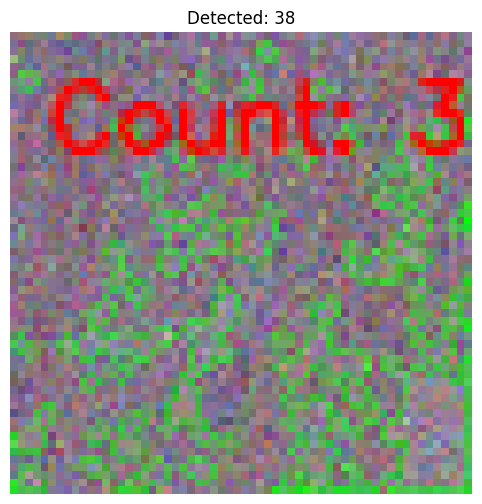

[1186/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


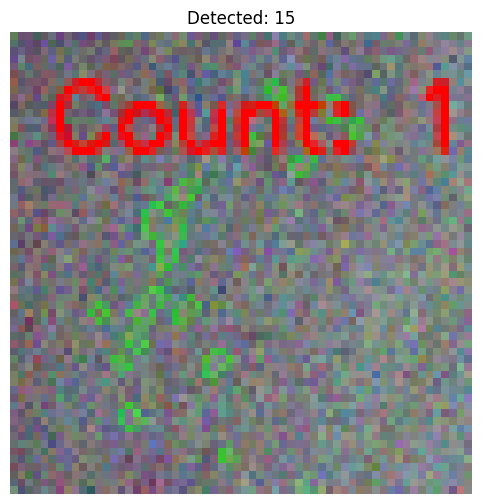

[1187/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


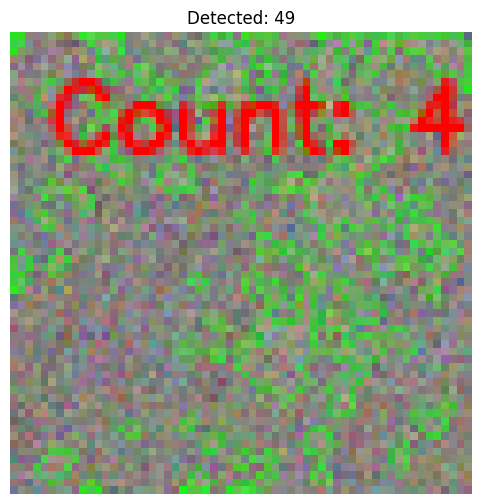

[1188/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


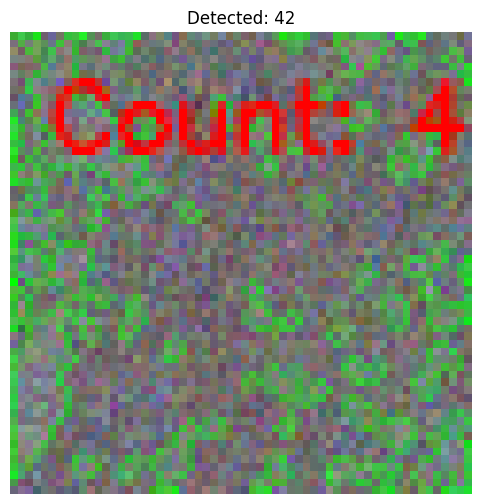

[1189/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 25                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


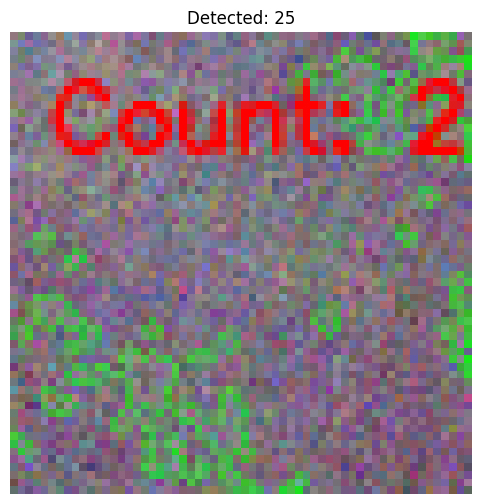

[1190/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


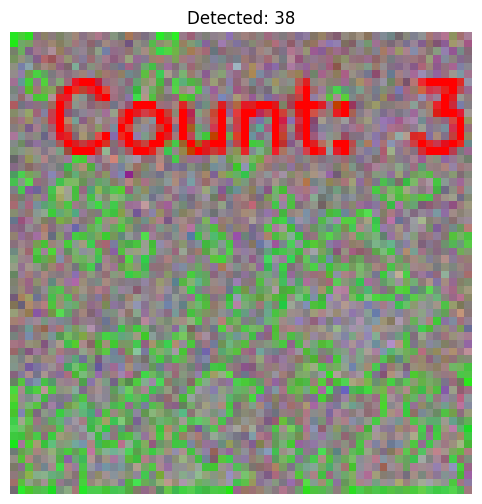

[1191/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_85
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_85 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 33                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


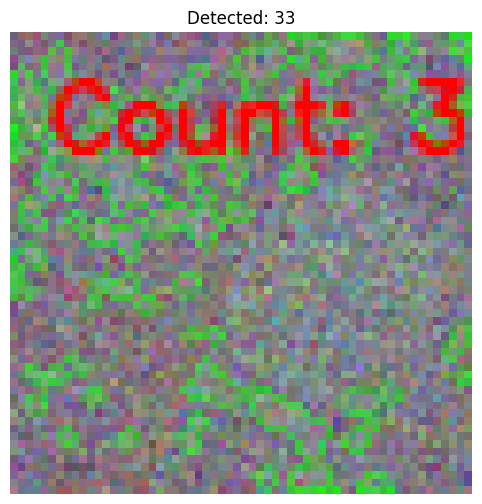

[1192/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


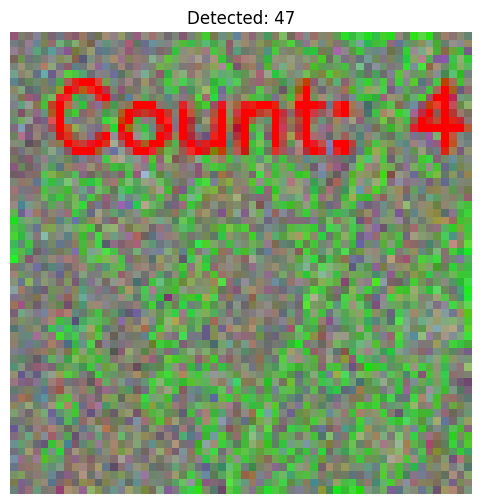

[1193/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


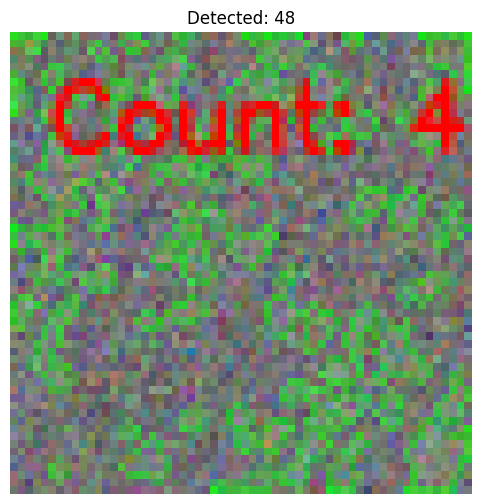

[1194/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


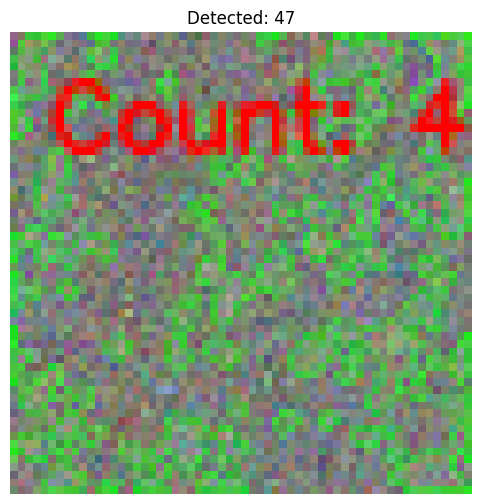

[1195/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 37                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


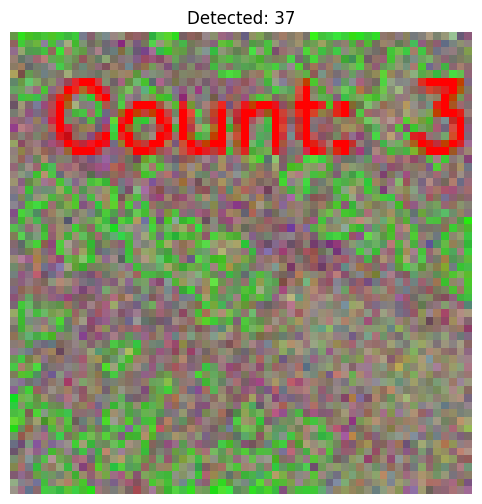

[1196/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_82
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_82 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


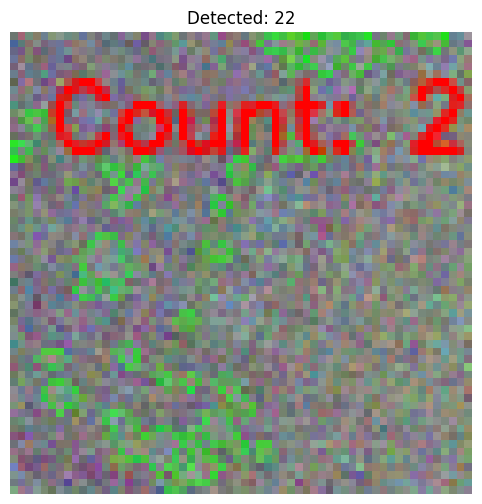

[1197/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_80
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_80 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 21                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


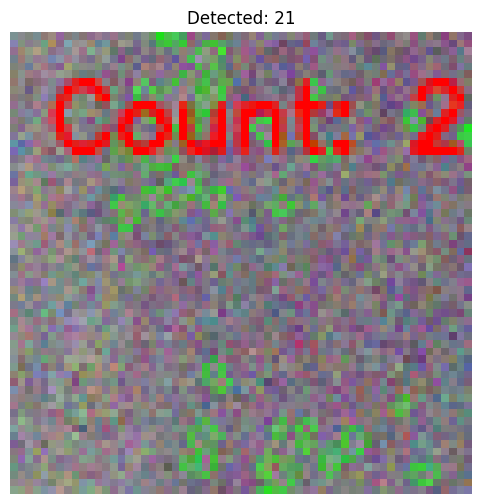

[1198/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


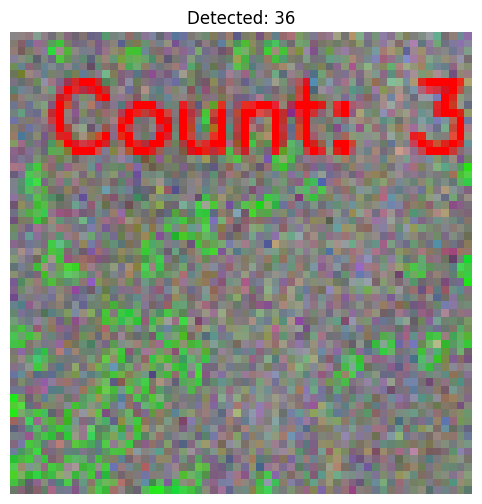

[1199/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


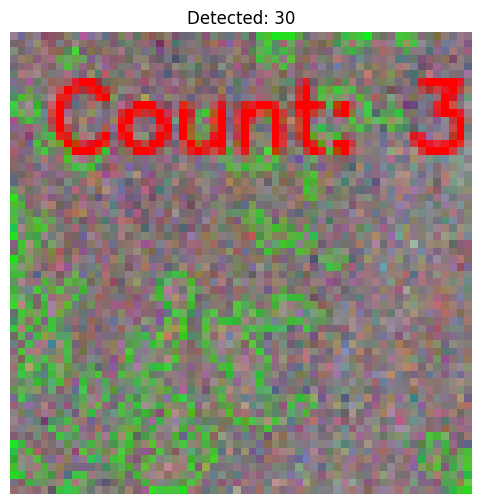

[1200/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_47
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_47 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


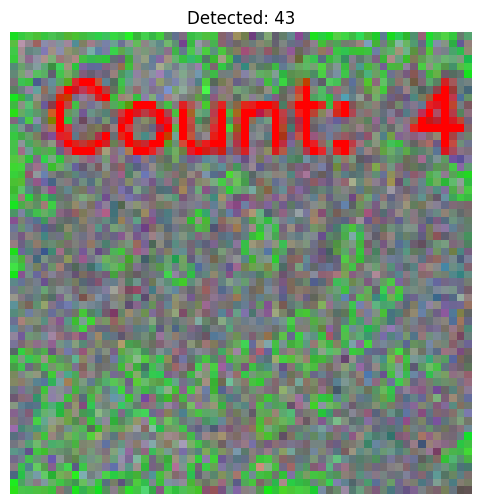

[1201/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 28                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


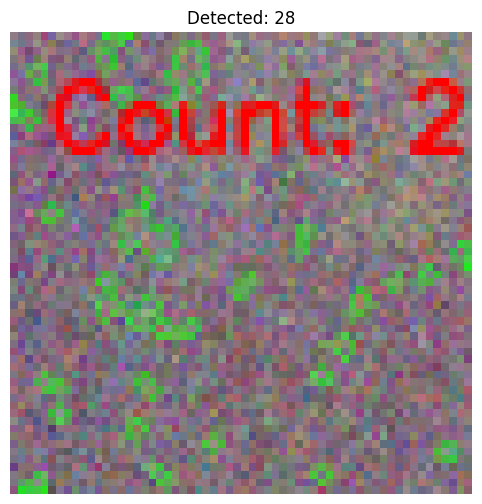

[1202/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 31                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


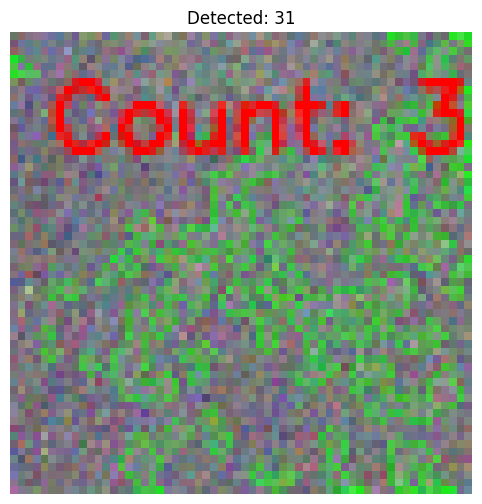

[1203/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_54_85
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_54_85 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


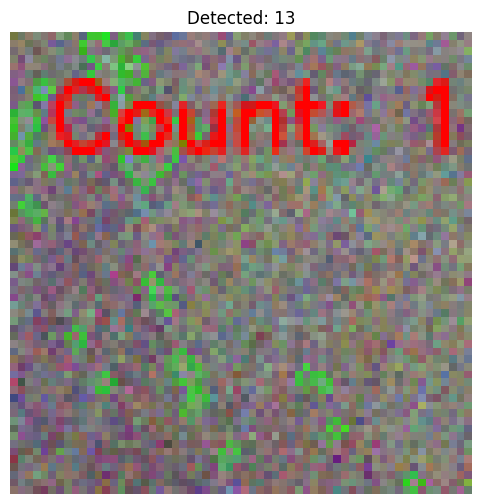

[1204/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


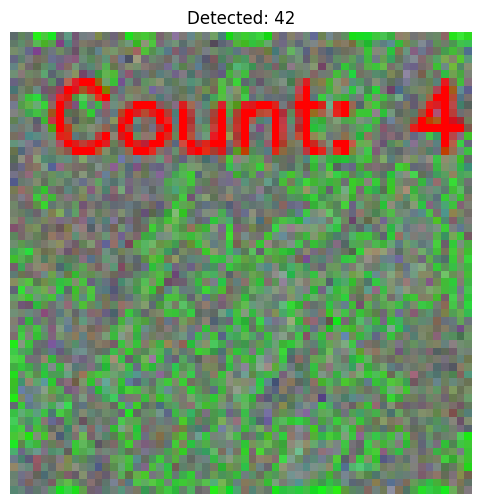

[1205/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


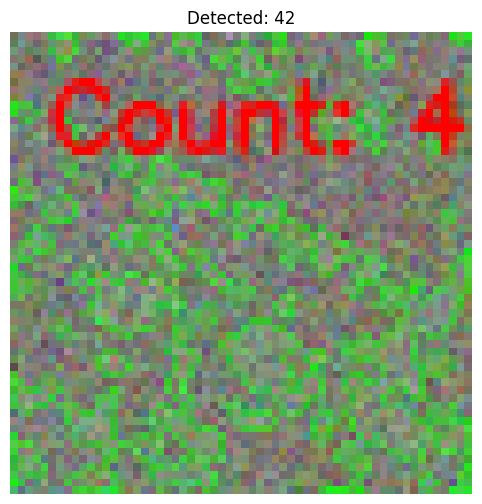

[1206/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 34                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


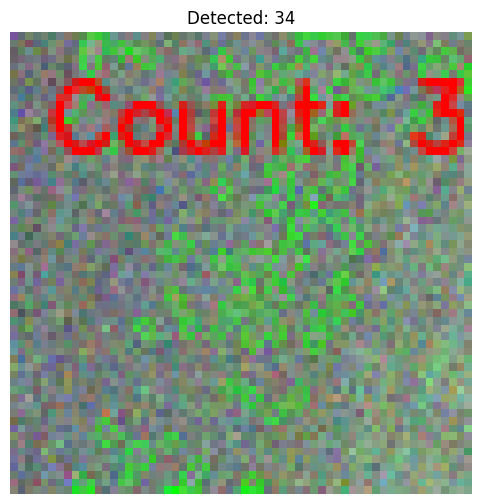

[1207/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


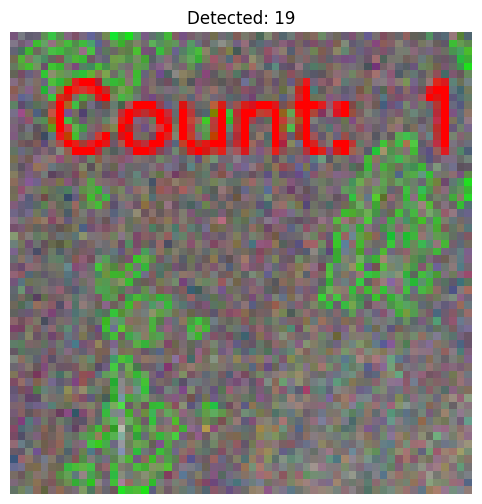

[1208/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 52                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


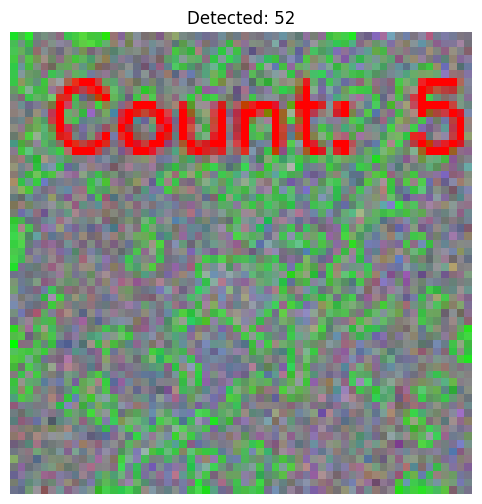

[1209/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


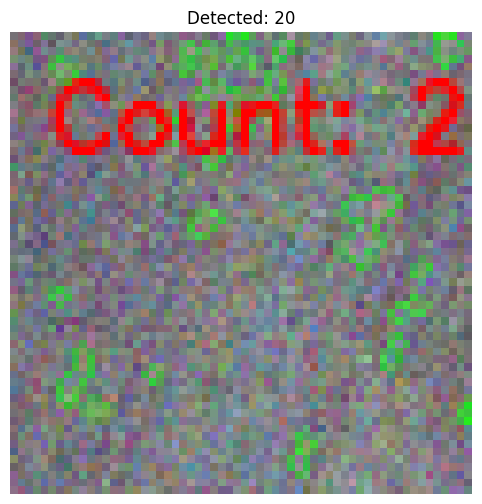

[1210/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


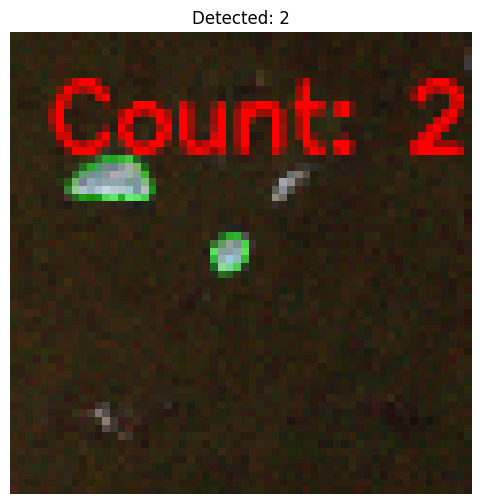

[1211/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


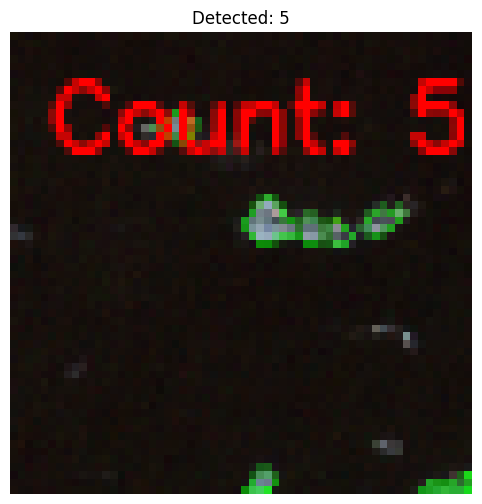

[1212/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


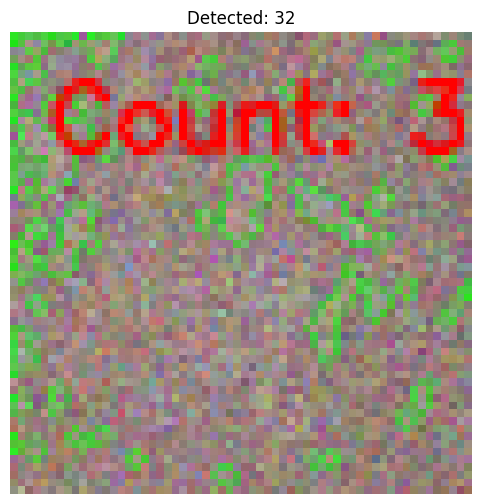

[1213/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


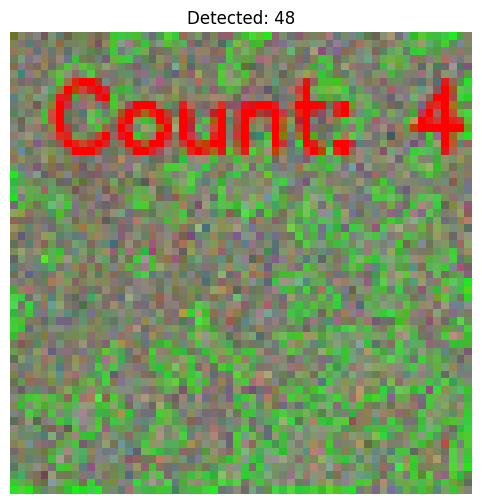

[1214/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_73
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_73 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


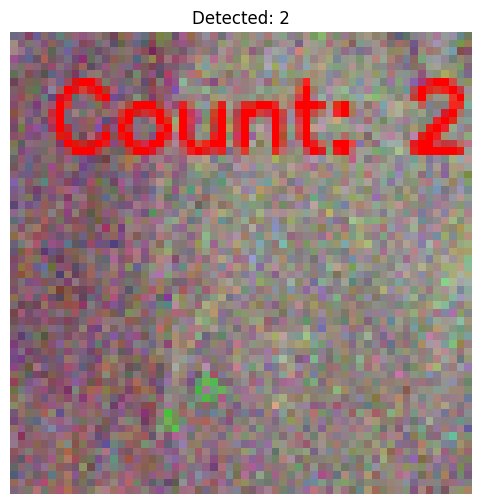

[1215/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 52                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


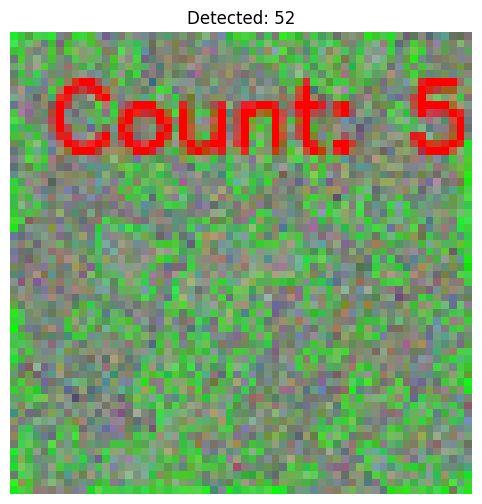

[1216/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_57
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_57 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


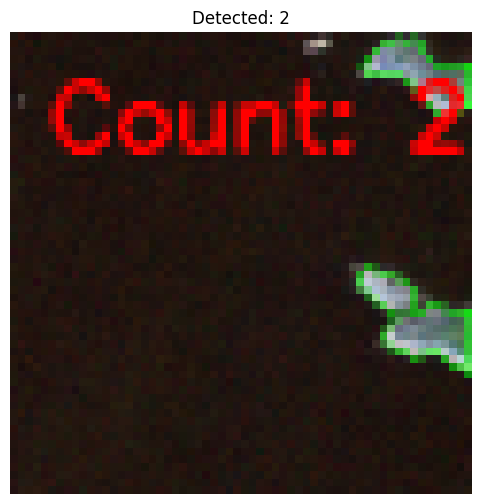

[1217/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


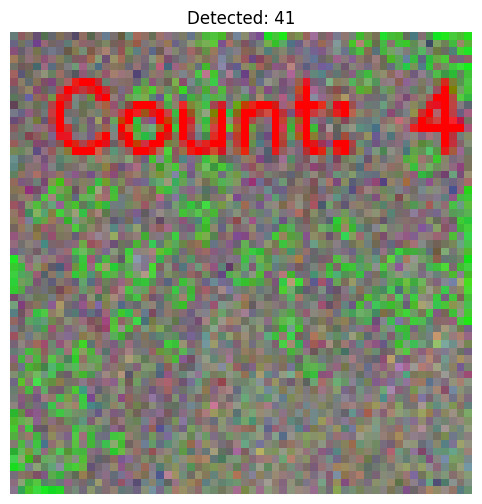

[1218/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_85
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_85 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 34                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


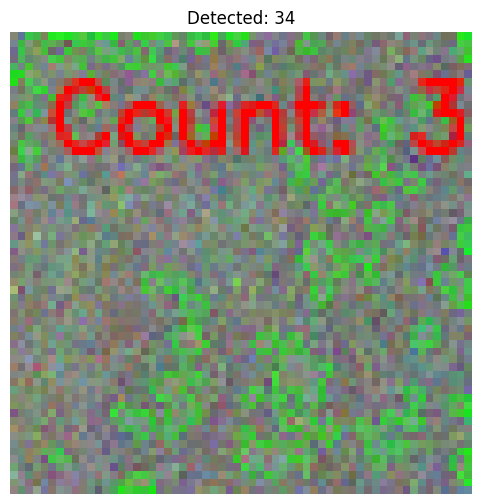

[1219/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


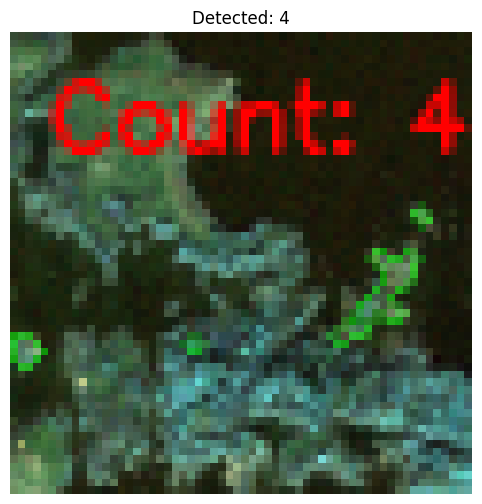

[1220/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


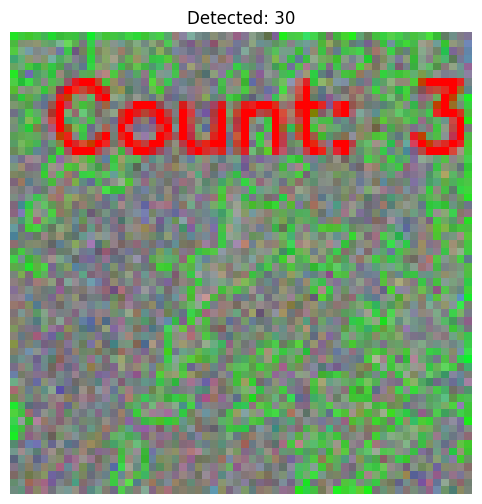

[1221/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


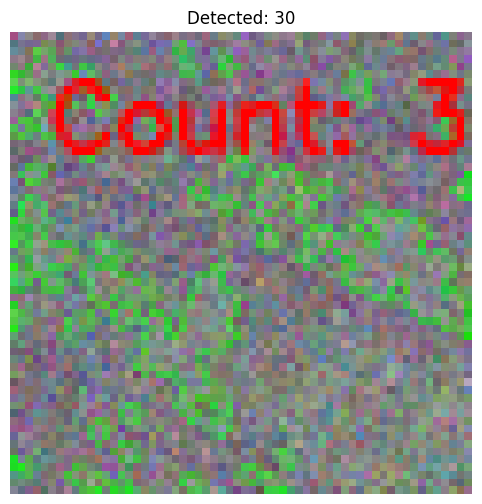

[1222/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


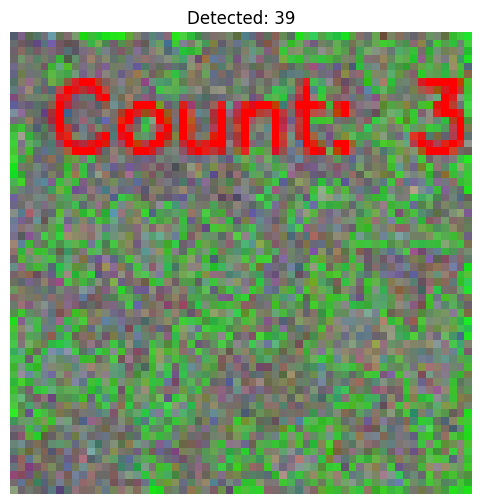

[1223/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_53
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_53 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 54                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


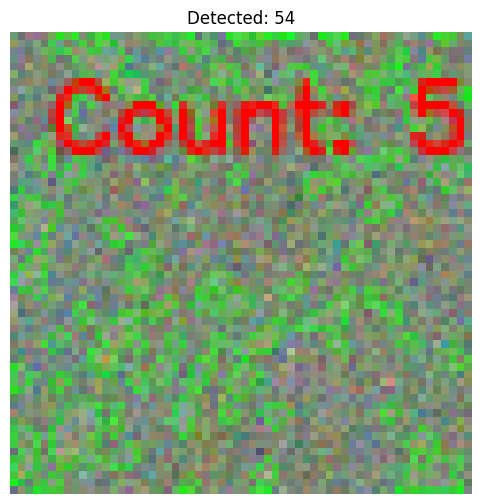

[1224/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 40                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


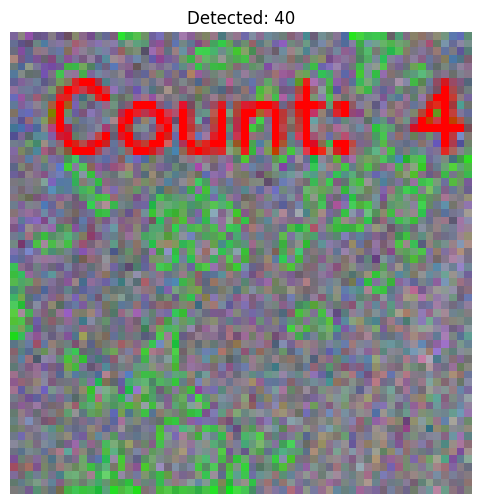

[1225/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


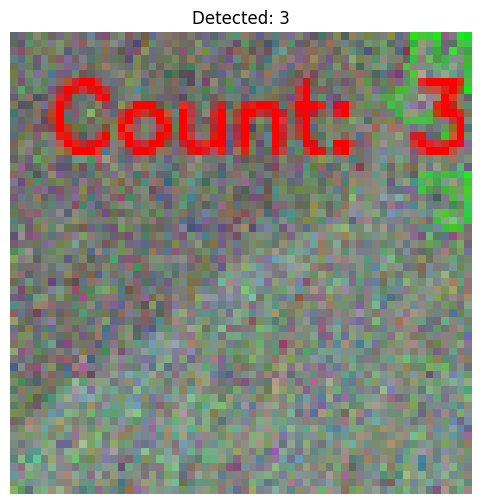

[1226/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_62_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_62_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


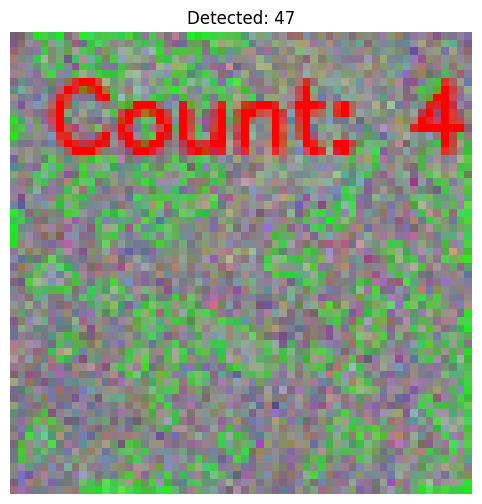

[1227/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


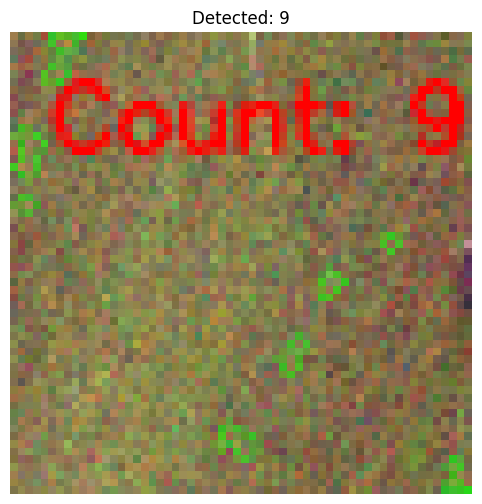

[1228/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


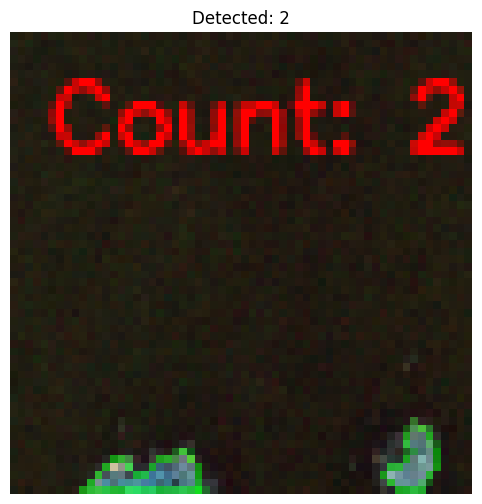

[1229/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


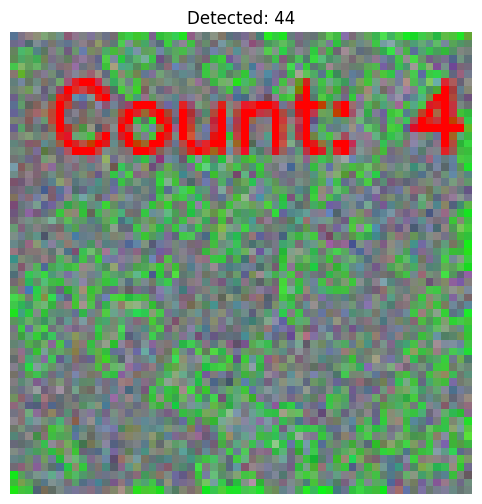

[1230/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 16                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


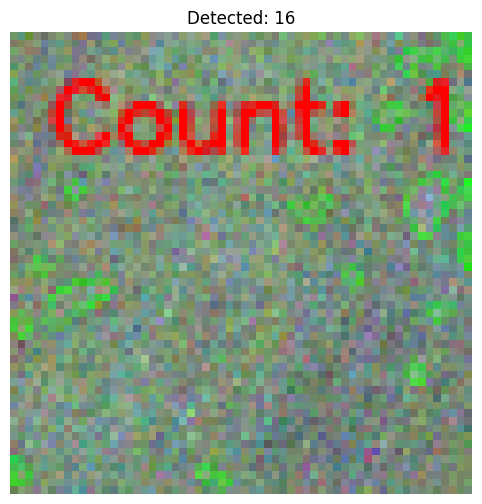

[1231/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 14                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


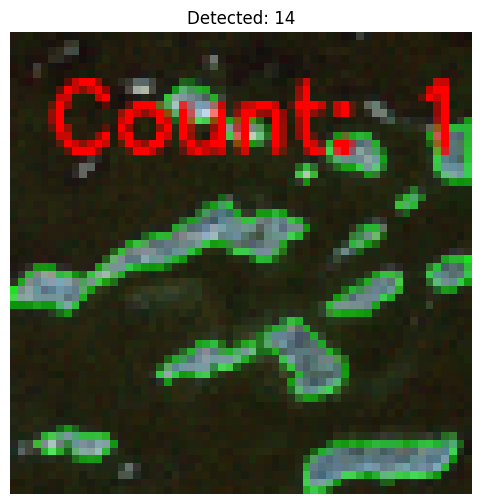

[1232/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_44
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_44 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


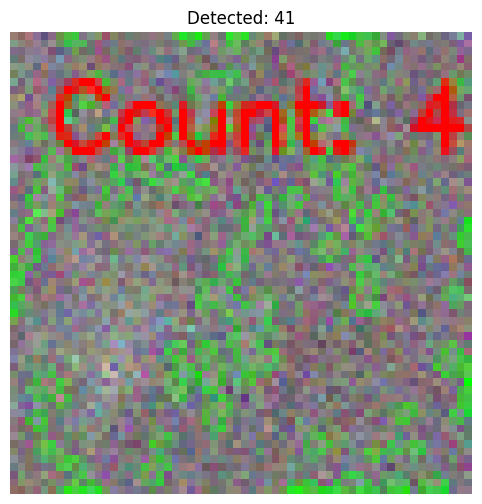

[1233/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 7                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


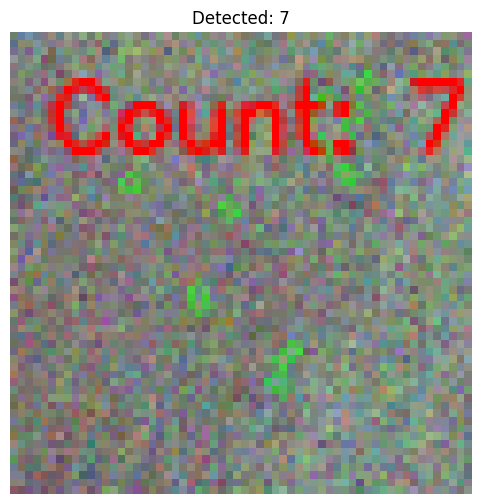

[1234/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_90
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_90 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


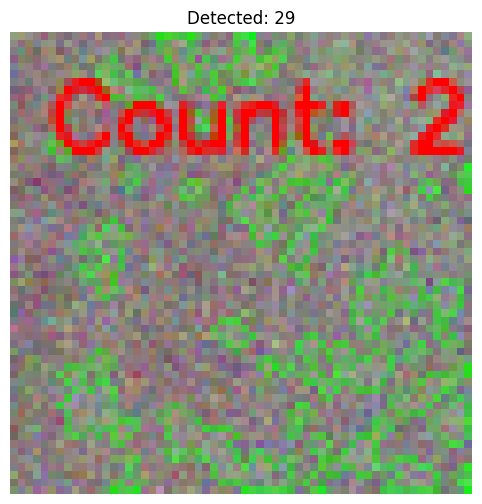

[1235/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


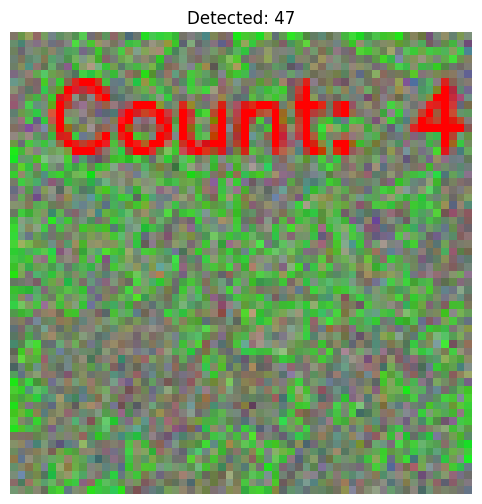

[1236/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


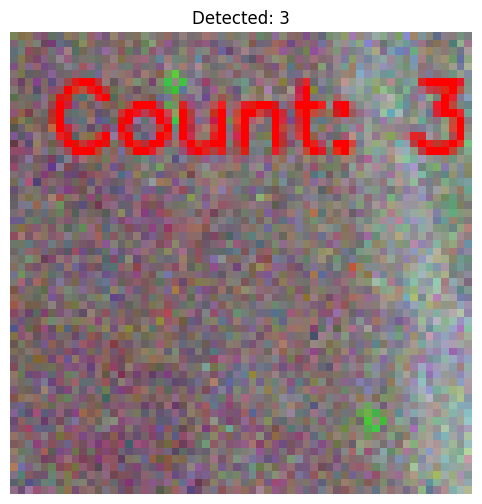

[1237/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 33                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


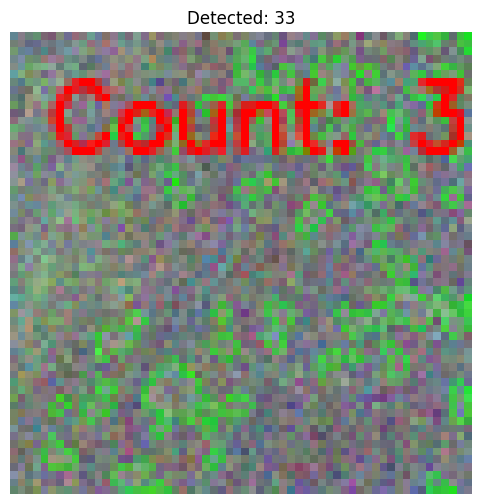

[1238/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_41
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_41 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


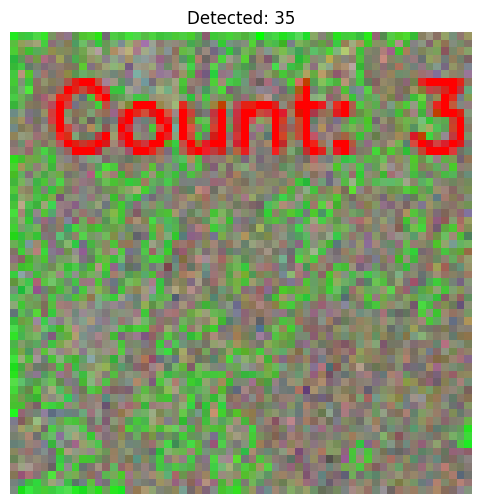

[1239/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 24                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


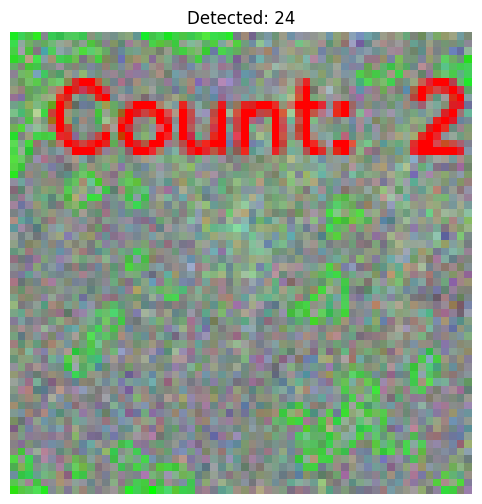

[1240/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_83_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 9                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


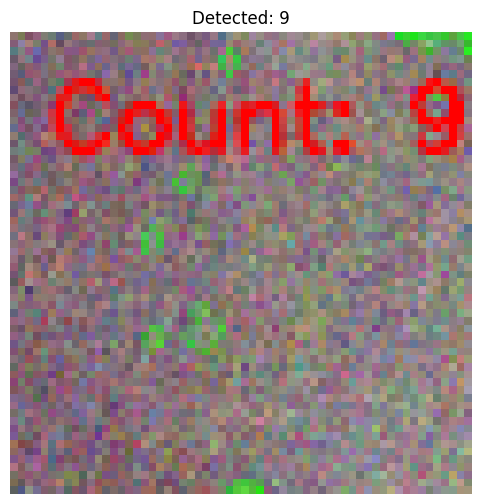

[1241/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


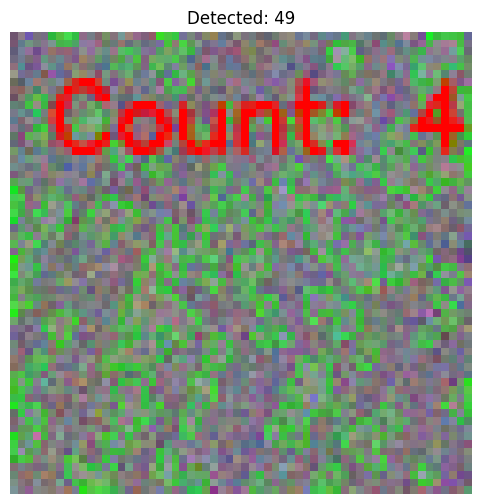

[1242/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


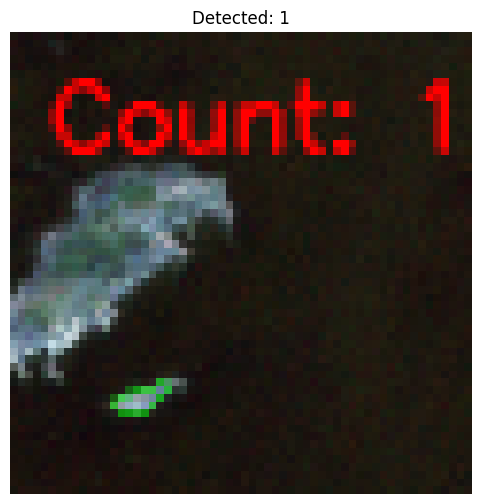

[1243/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_70_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 51                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


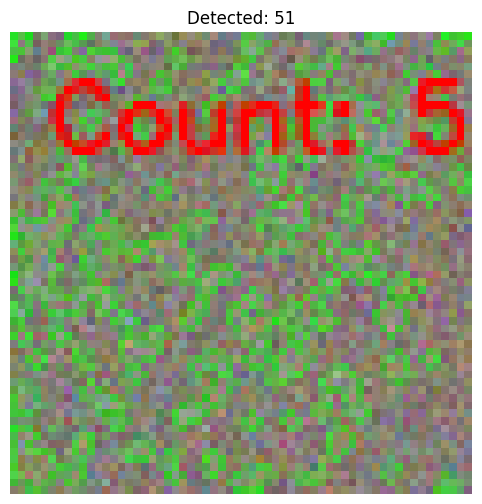

[1244/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_51
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_51 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


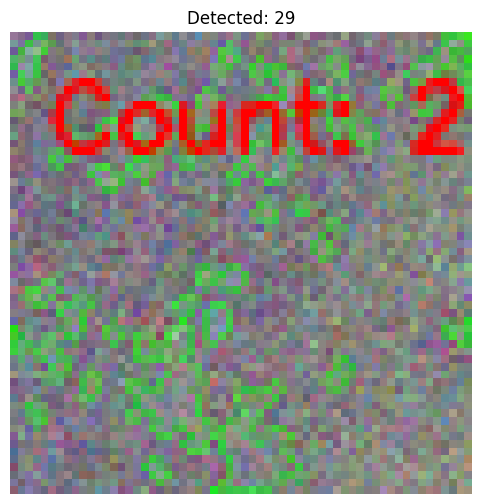

[1245/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


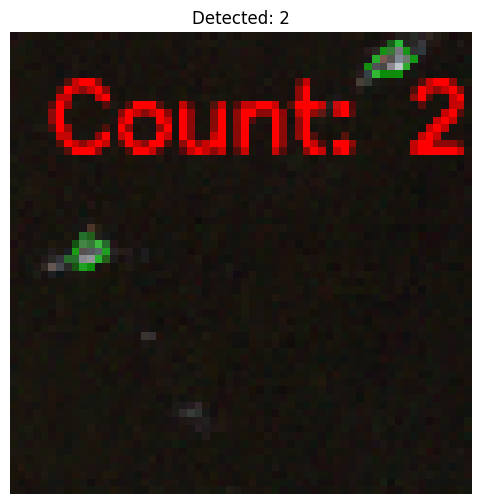

[1246/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


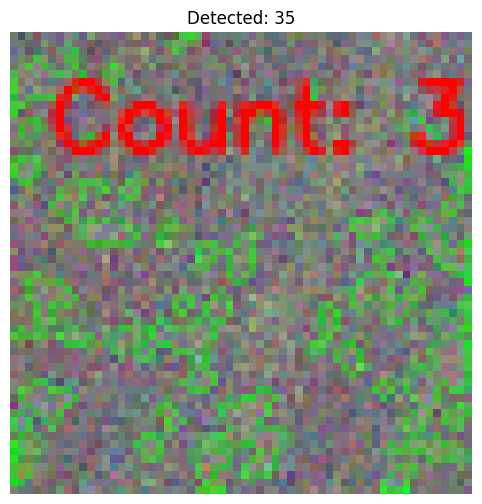

[1247/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_82
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_82 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


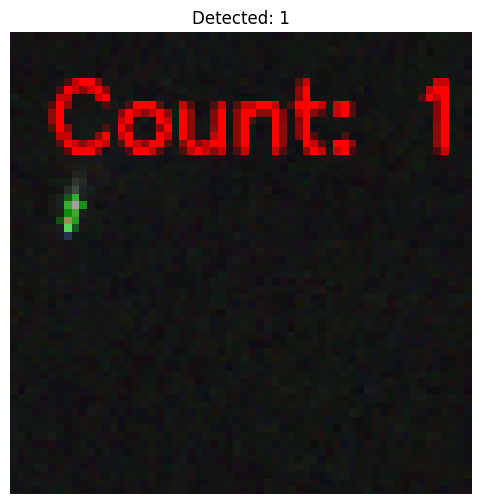

[1248/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 51                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


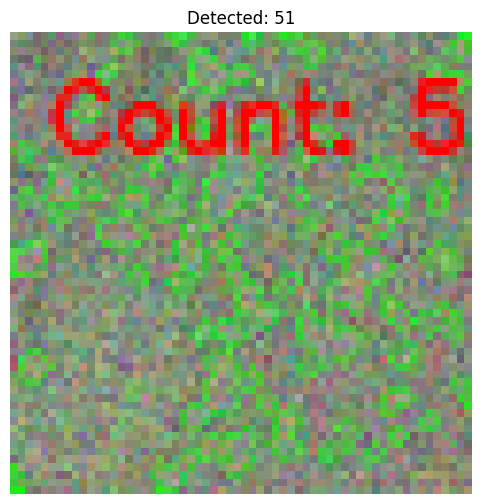

[1249/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 20                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


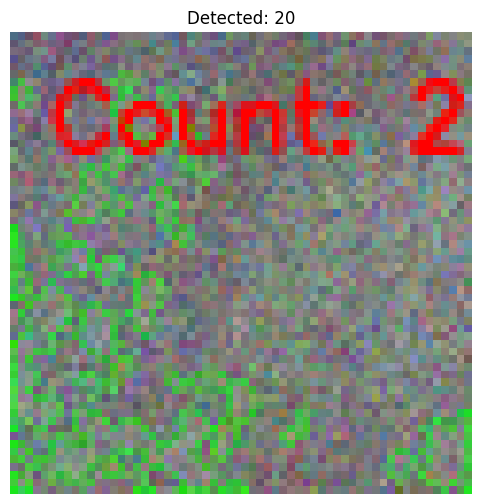

[1250/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_52
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_75_52 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


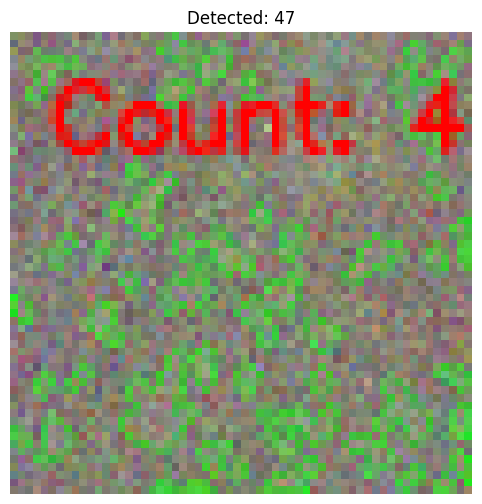

[1251/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


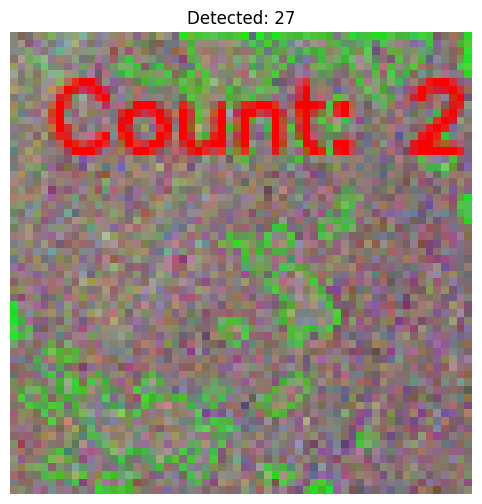

[1252/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_80
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_67_80 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


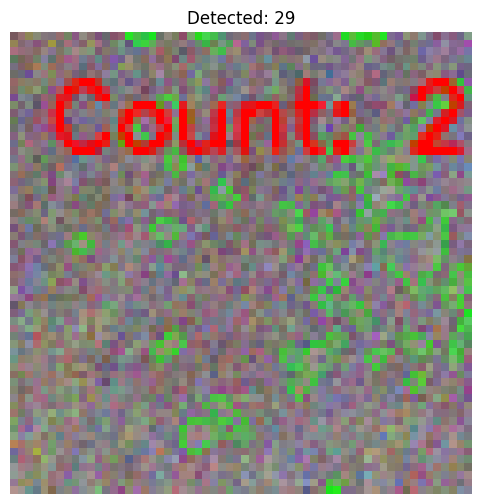

[1253/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


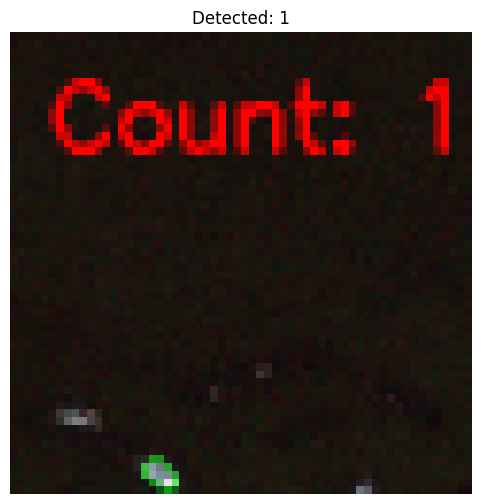

[1254/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


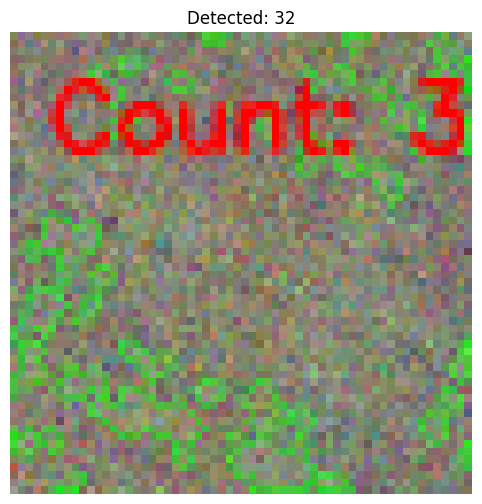

[1255/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 22                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


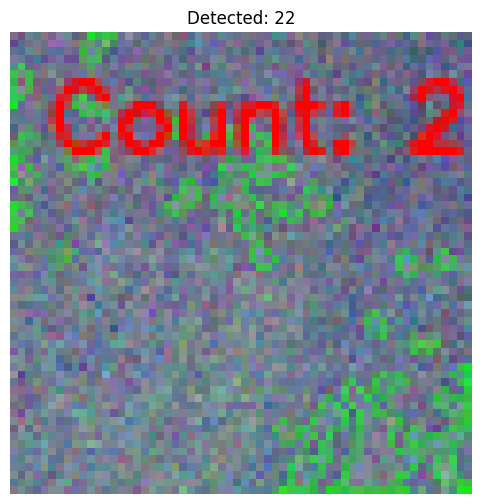

[1256/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 27                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


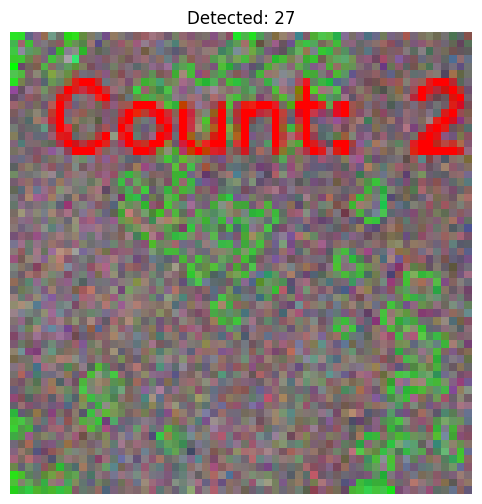

[1257/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_62
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_69_62 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


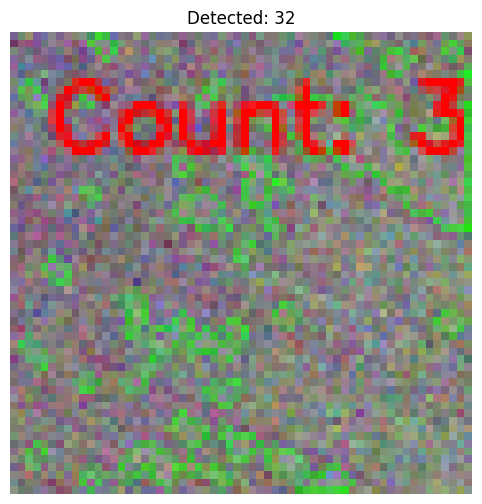

[1258/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


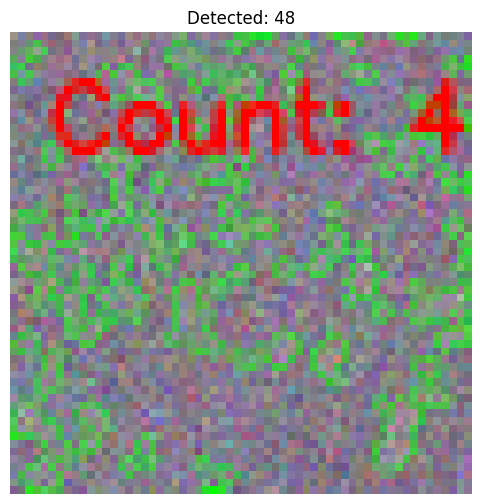

[1259/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 52                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


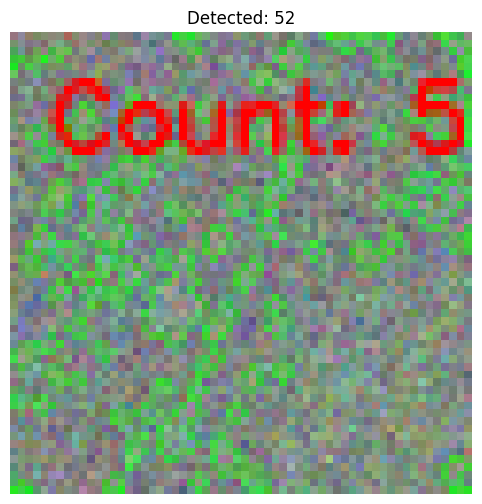

[1260/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


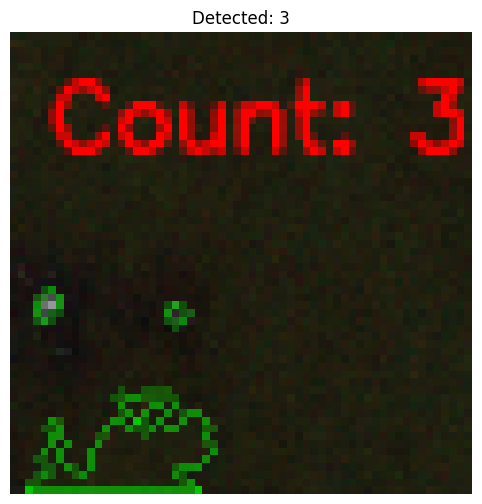

[1261/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_48_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_48_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


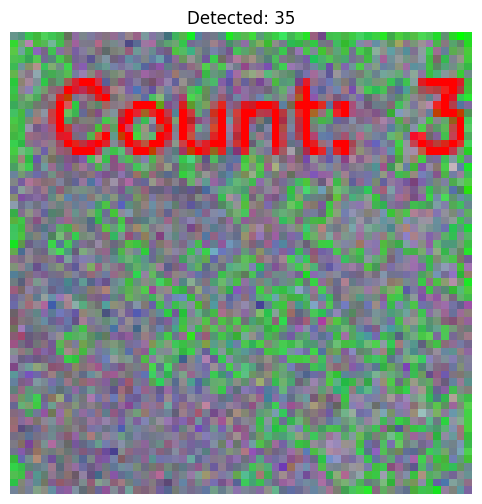

[1262/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


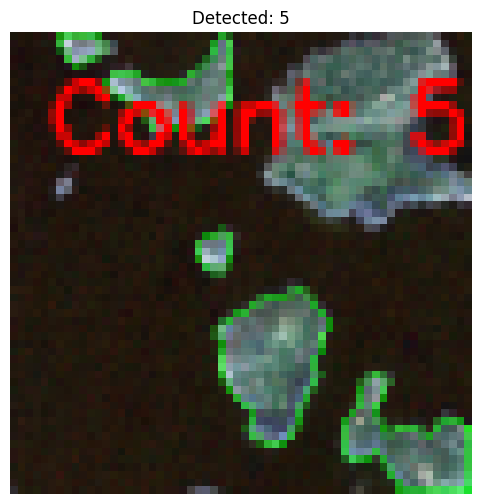

[1263/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_71
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_71 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 34                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


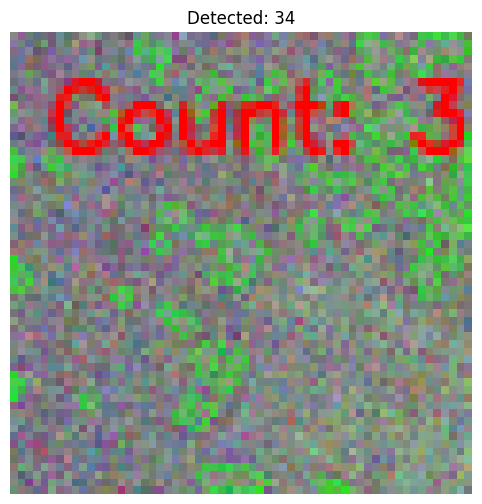

[1264/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 33                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


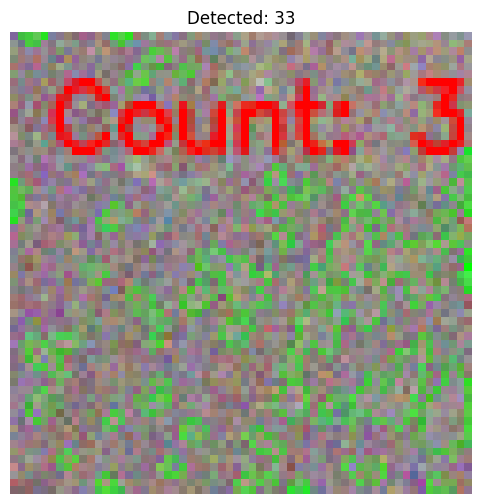

[1265/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


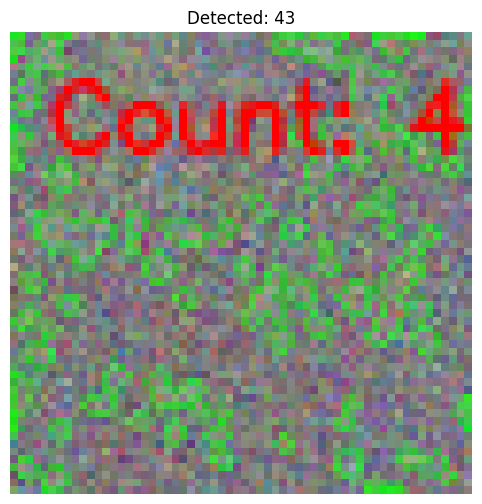

[1266/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 45                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


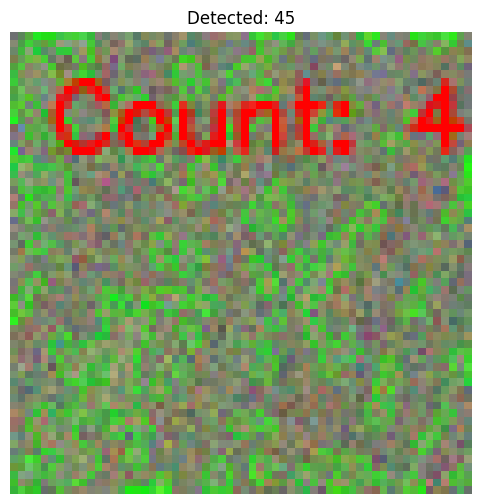

[1267/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 46                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


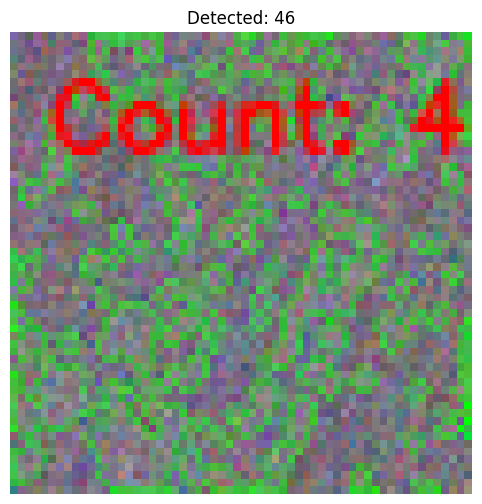

[1268/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_50
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_50 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


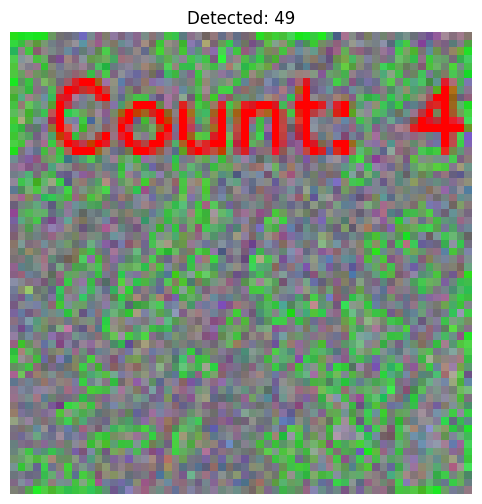

[1269/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 13                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


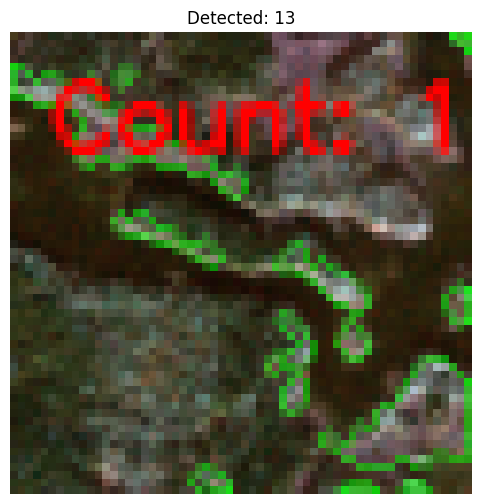

[1270/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_49
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_49 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 36                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


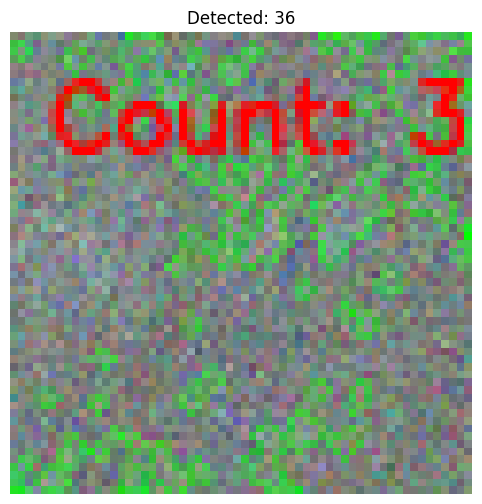

[1271/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_60
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_60 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


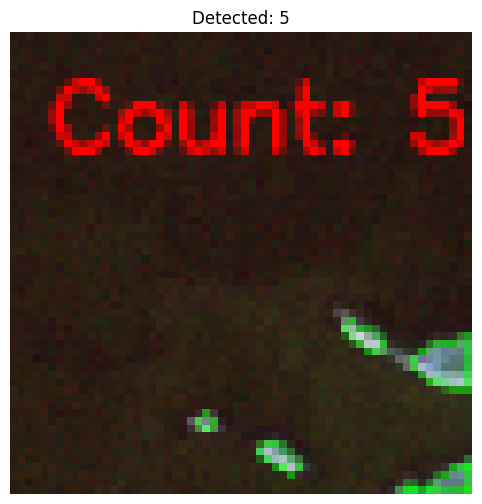

[1272/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 10                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


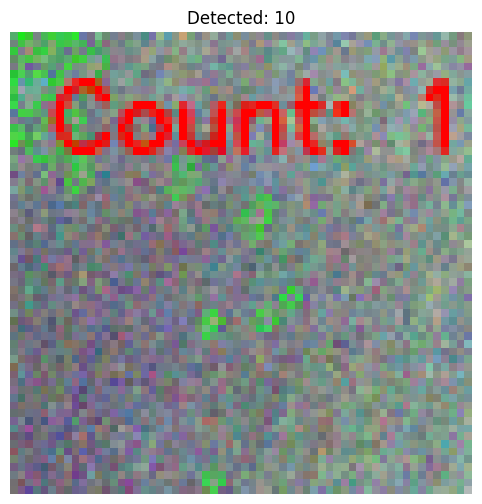

[1273/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


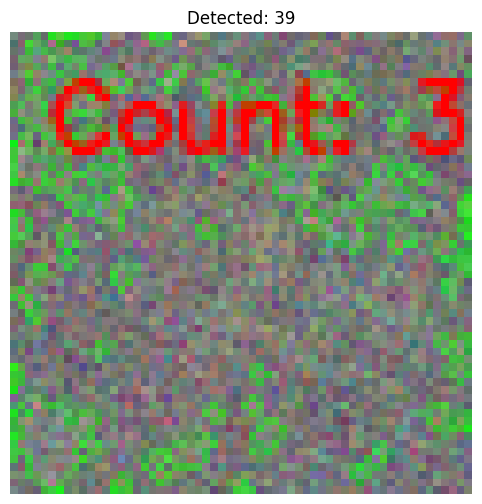

[1274/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_58
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_68_58 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 50                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


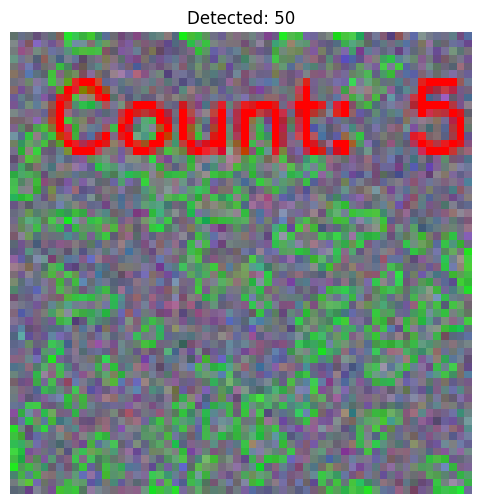

[1275/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 41                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


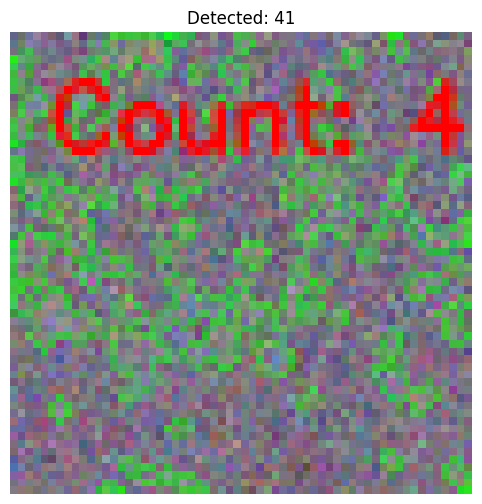

[1276/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_43
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_43 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


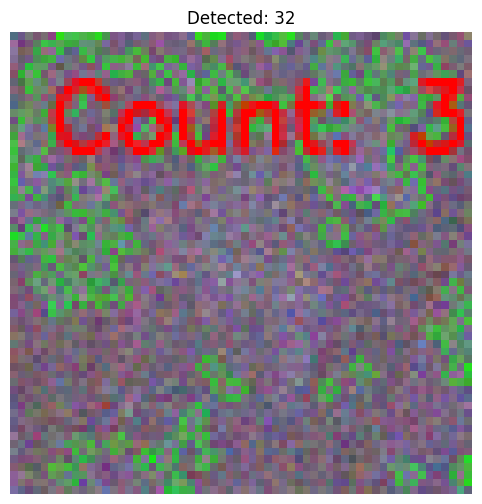

[1277/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_80
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_80 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


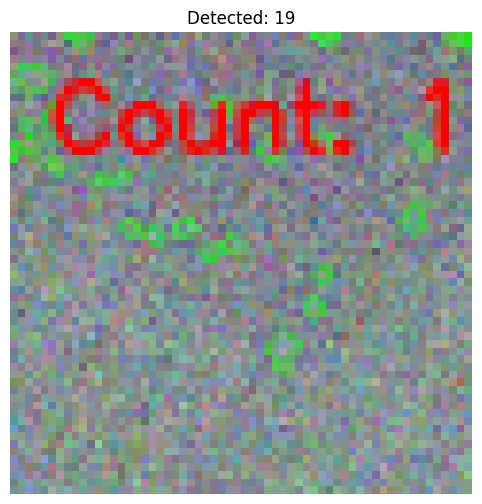

[1278/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_79
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_79 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


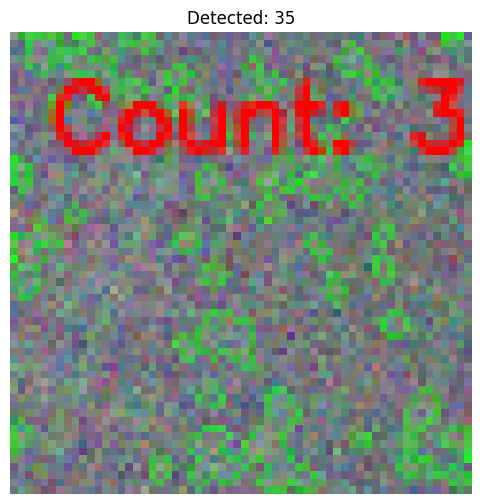

[1279/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


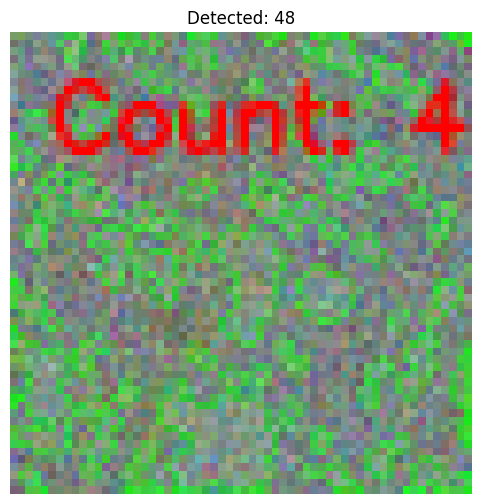

[1280/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


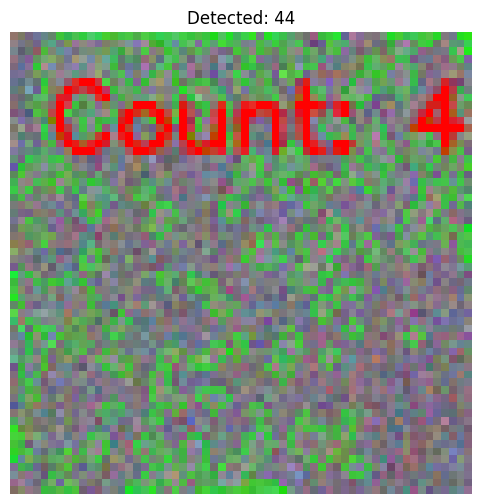

[1281/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 39                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


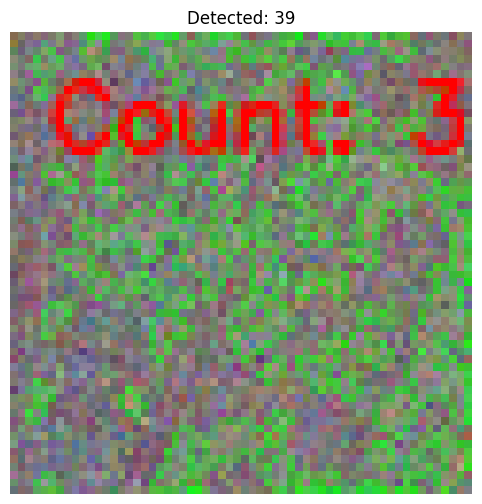

[1282/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_85
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_77_85 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


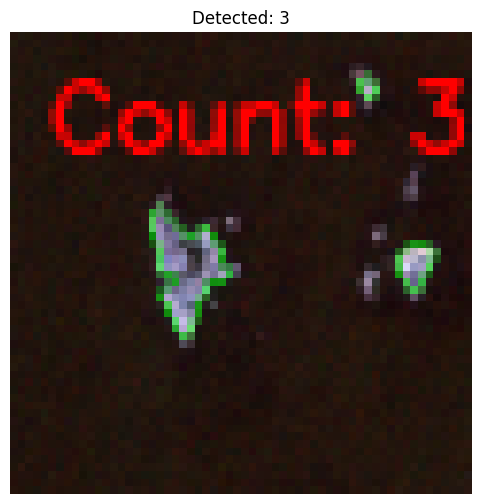

[1283/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_61_77
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_61_77 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 33                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


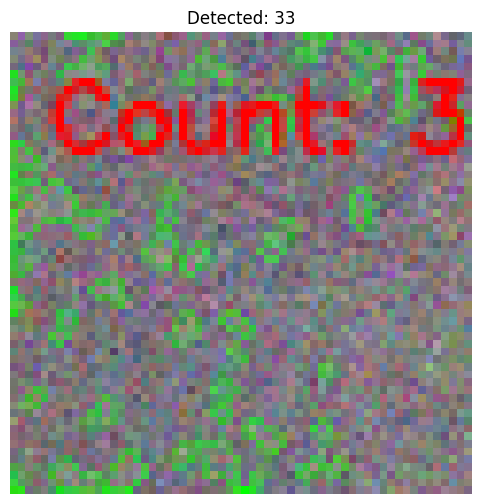

[1284/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_61
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_73_61 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


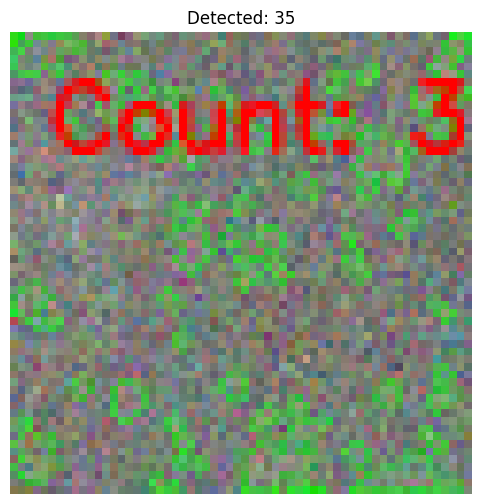

[1285/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_76_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 50                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


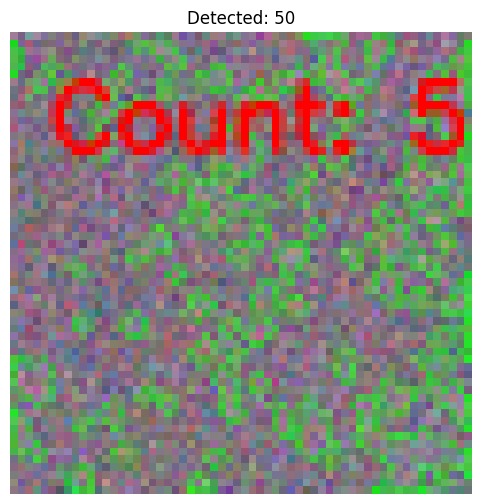

[1286/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


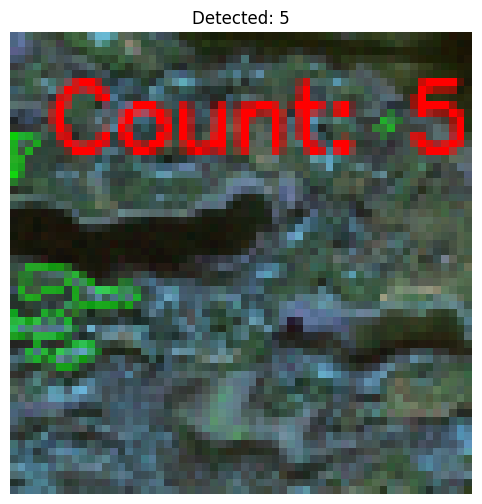

[1287/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_69
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_66_69 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


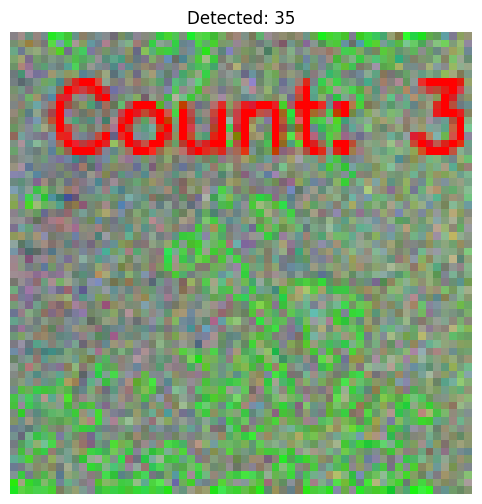

[1288/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_54_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_54_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


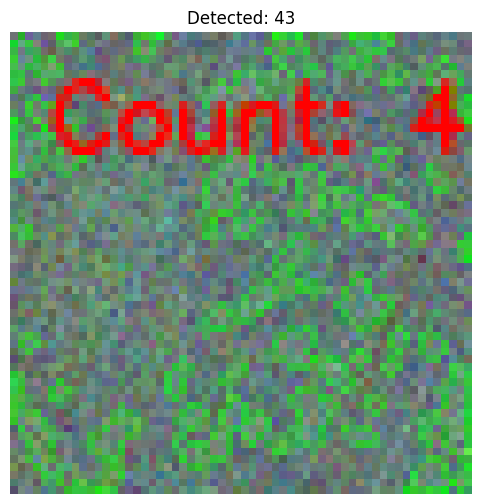

[1289/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_79_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 54                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


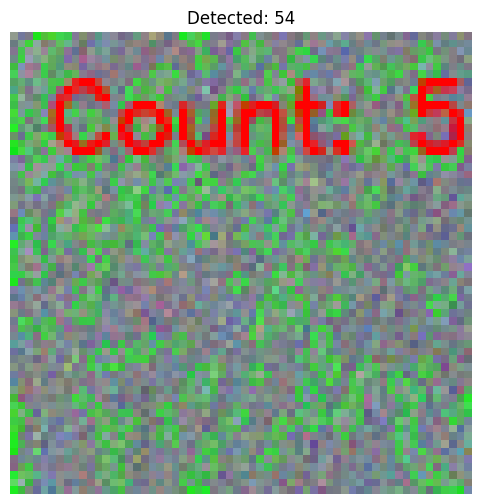

[1290/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_63_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 30                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


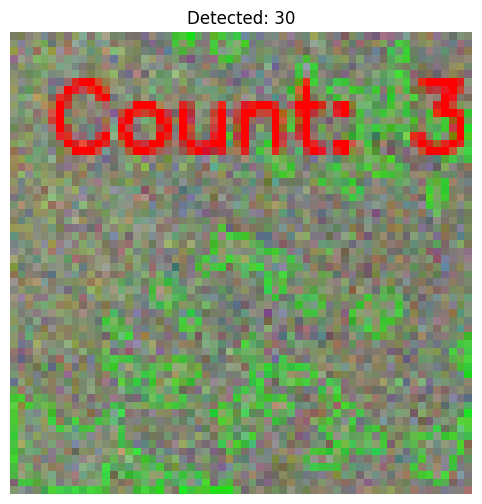

[1291/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_48
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_48 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 37                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


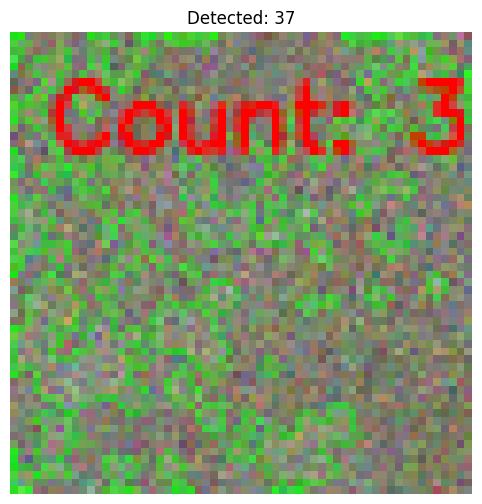

[1292/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 25                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


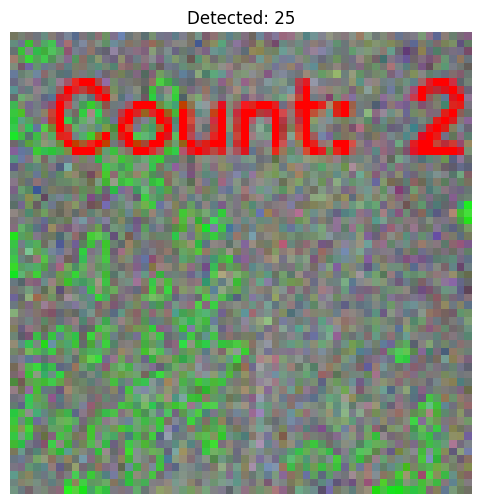

[1293/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 51                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


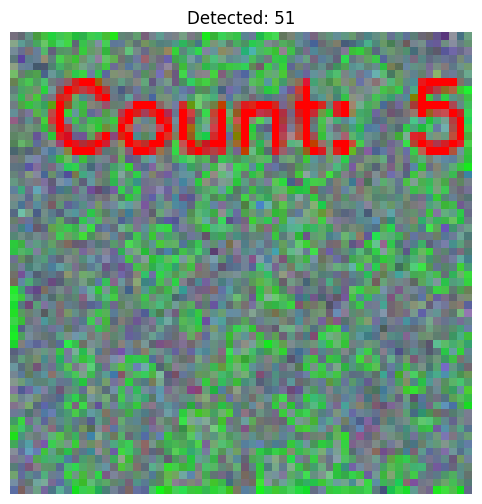

[1294/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_81_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 8                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


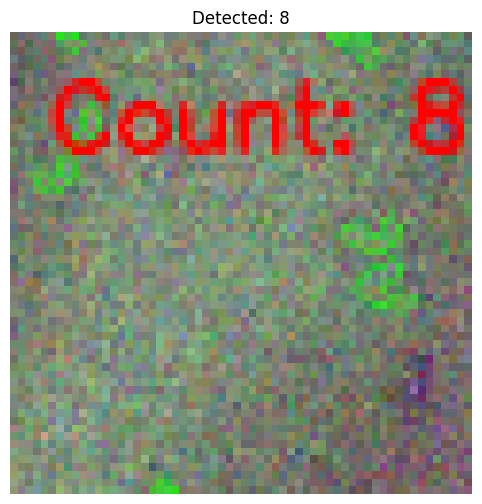

[1295/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_46
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_46 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 33                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


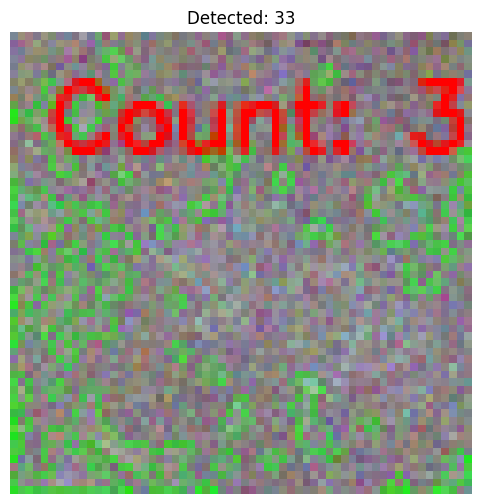

[1296/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_75
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_75 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 4                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


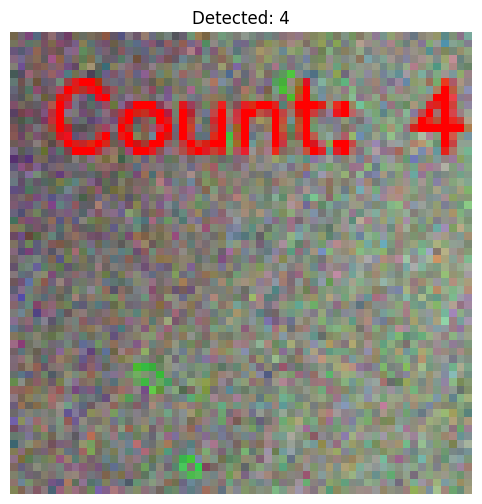

[1297/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_81
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_81 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 3                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


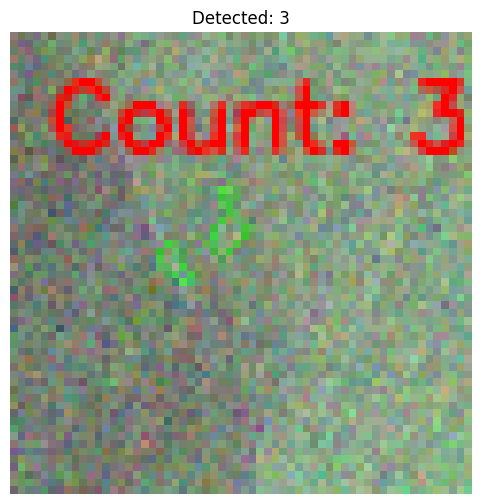

[1298/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_56
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_71_56 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 29                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


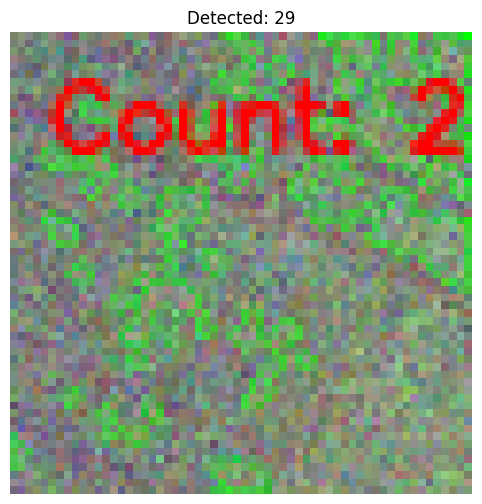

[1299/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_88_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


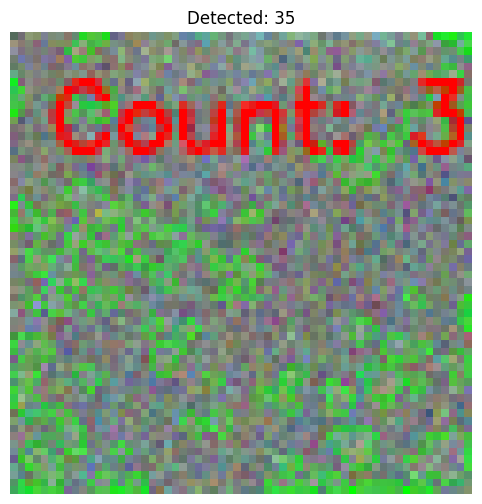

[1300/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 48                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


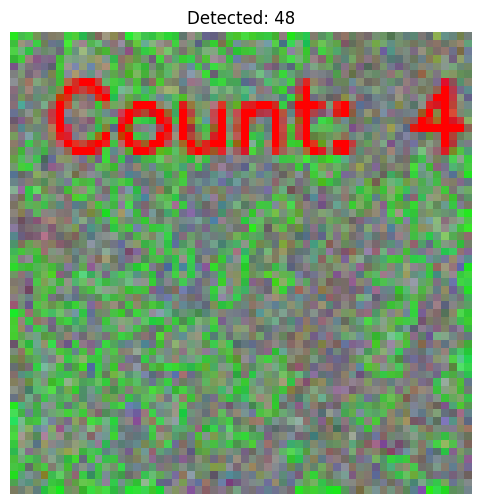

[1301/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_90_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 5                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


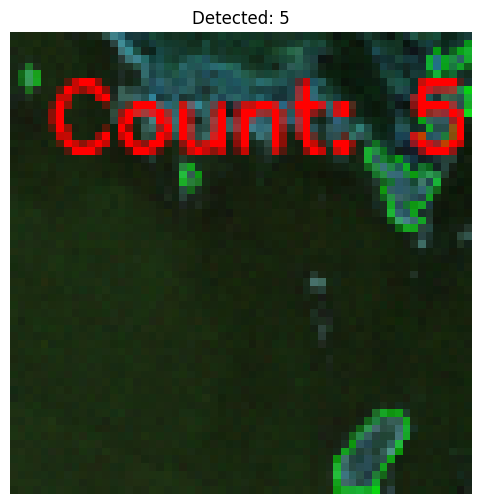

[1302/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_88
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_64_88 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


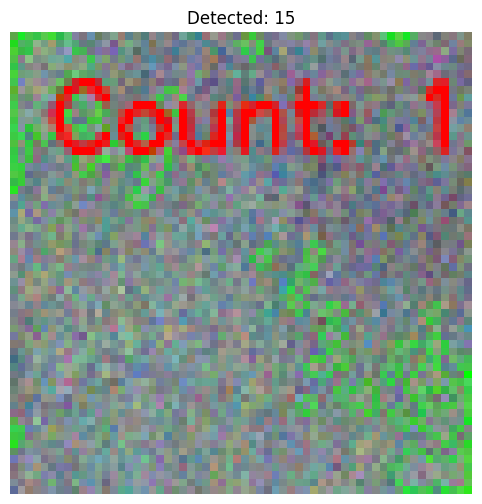

[1303/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_85_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 2                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


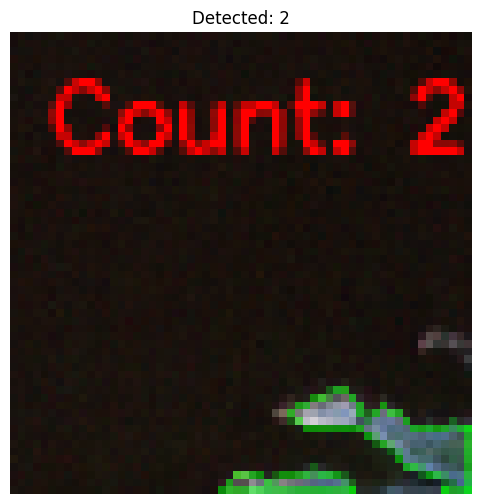

[1304/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_50_76
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_50_76 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 46                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


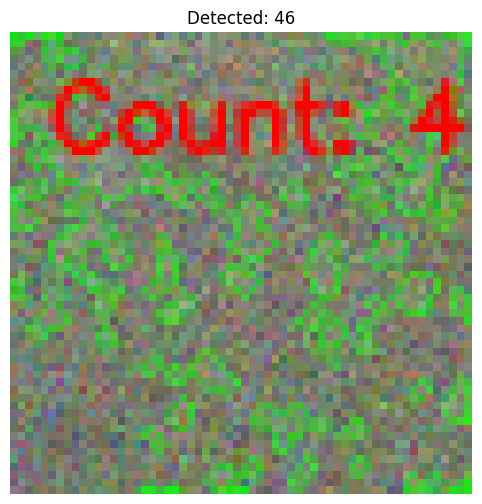

[1305/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_86_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 15                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


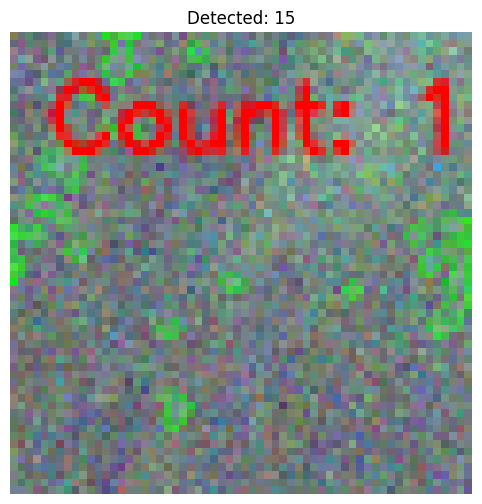

[1306/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_54
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_89_54 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


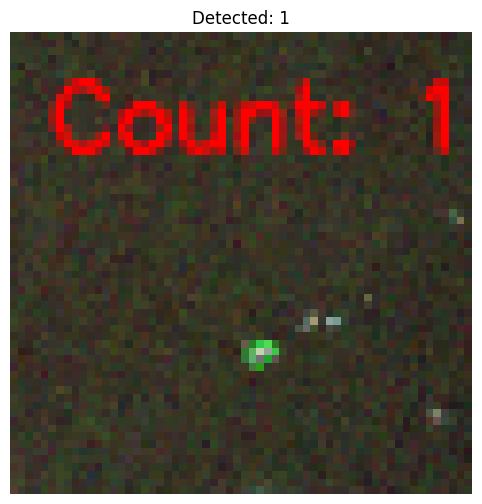

[1307/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_63
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_63 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 31                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


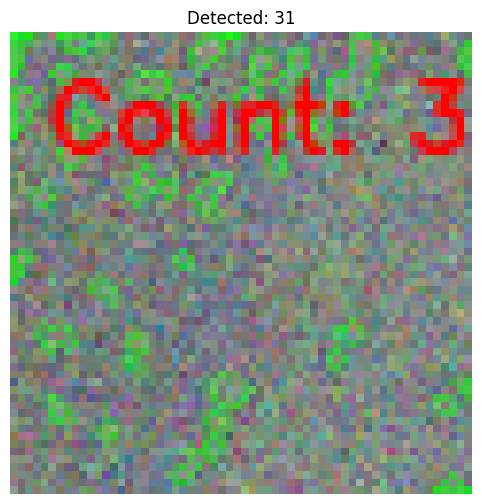

[1308/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_55
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_74_55 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 1                                                  │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


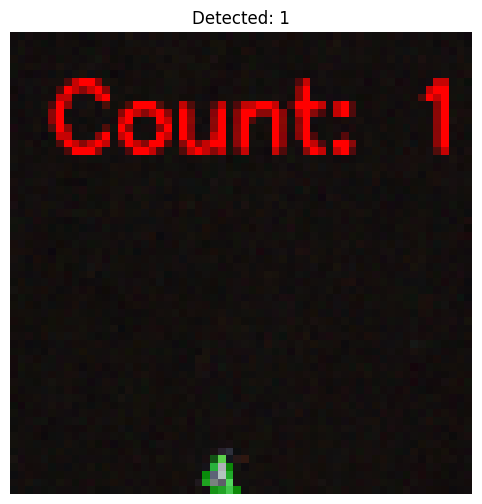

[1309/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_58_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 46                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


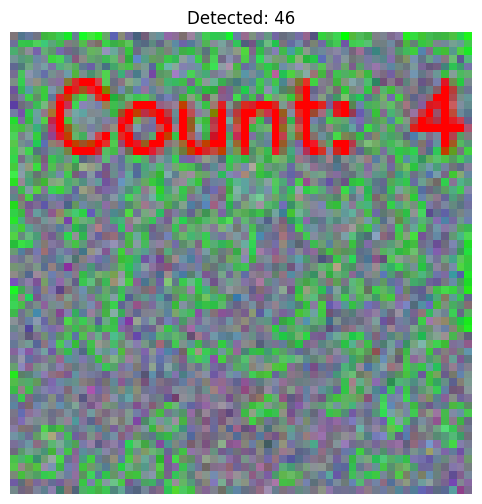

[1310/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_66
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_66 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


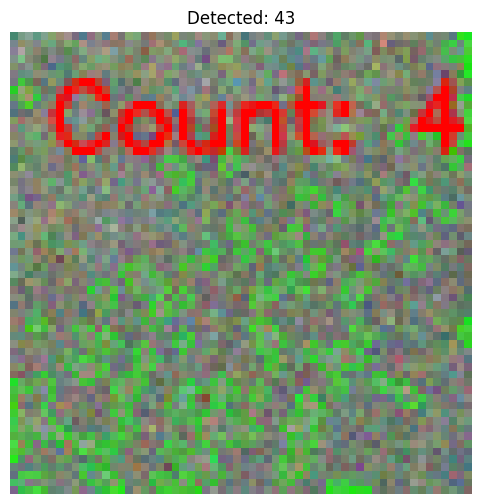

[1311/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 54                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


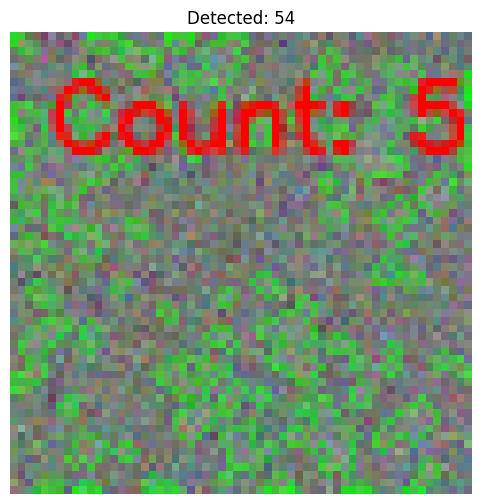

[1312/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_89
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_51_89 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 50                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


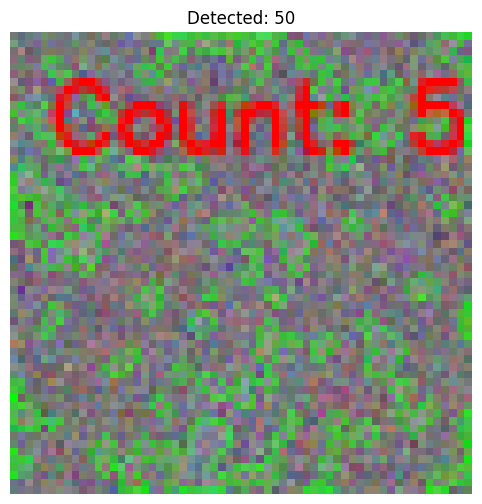

[1313/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_86
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_87_86 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 38                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


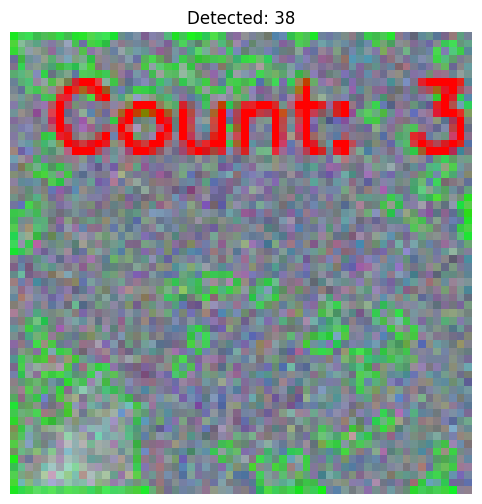

[1314/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_70
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_55_70 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 35                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


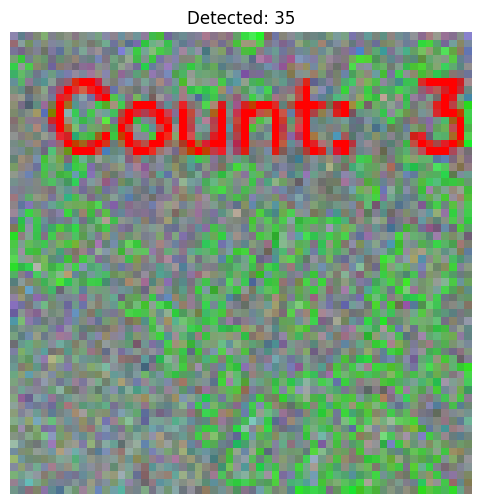

[1315/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_64
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_78_64 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 47                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


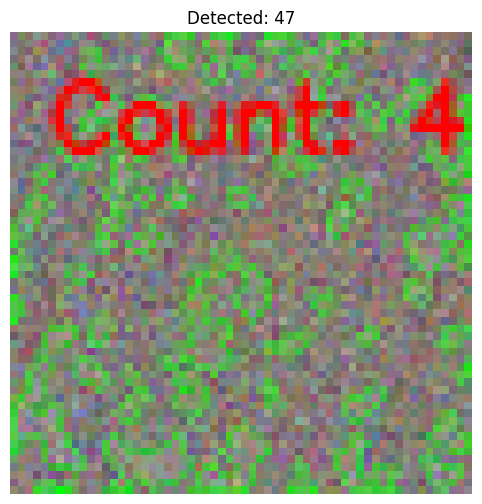

[1316/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_84
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_84 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 32                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


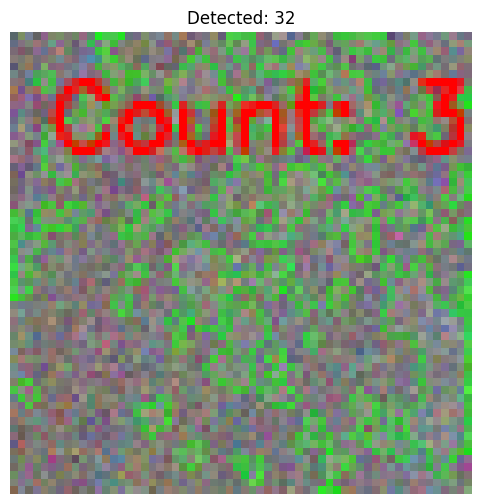

[1317/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_52_72
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_52_72 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 42                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


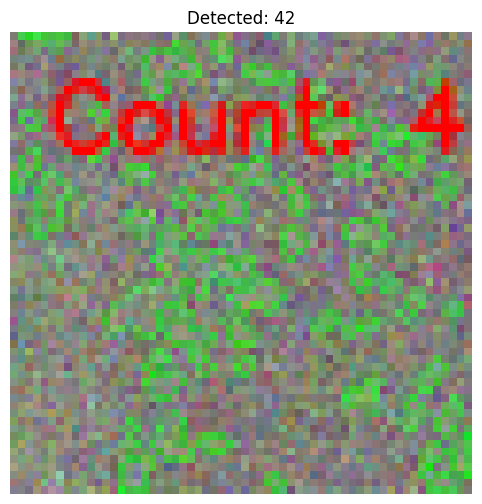

[1318/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_45
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_84_45 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 44                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


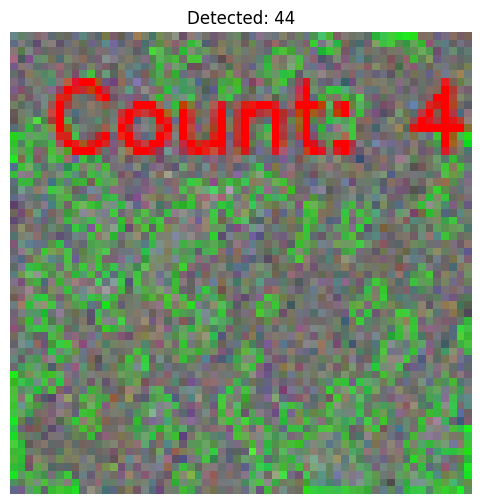

[1319/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_59
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_82_59 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


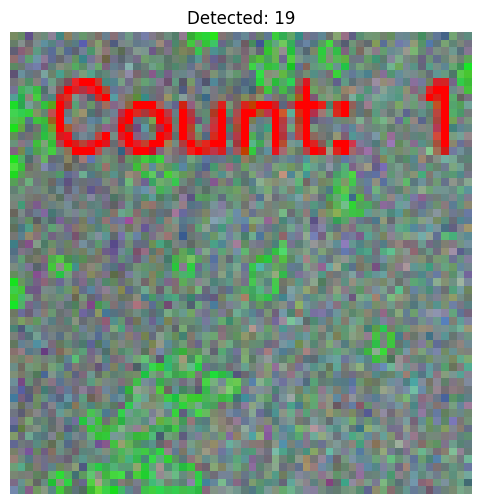

[1320/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_74
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_72_74 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


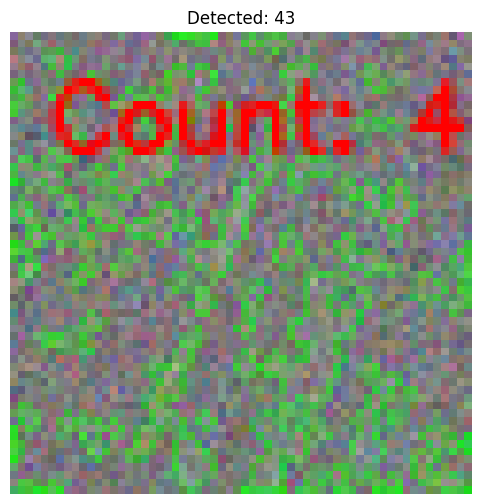

[1321/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_65
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_65_65 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 43                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


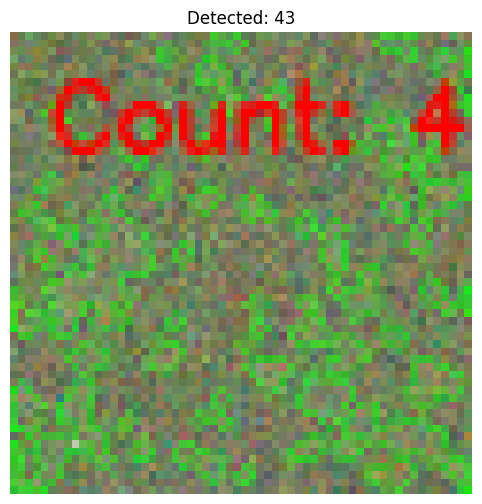

[1322/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_68
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_80_68 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 26                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.00 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


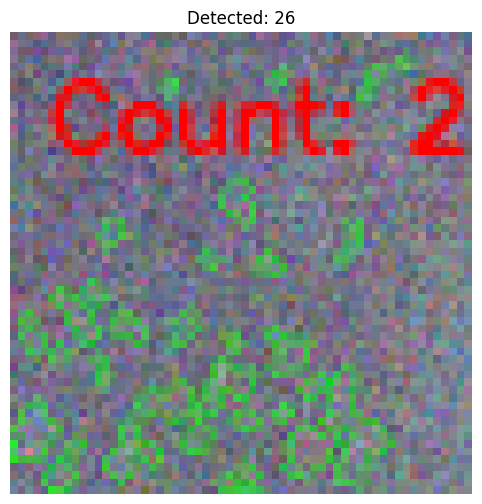

[1323/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_48_78
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_48_78 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 49                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


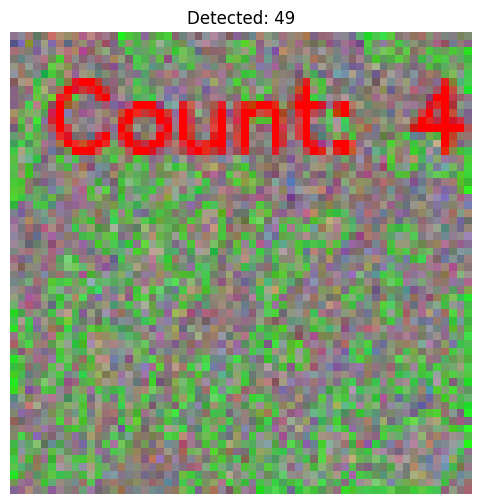

[1324/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_67
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_59_67 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 63                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


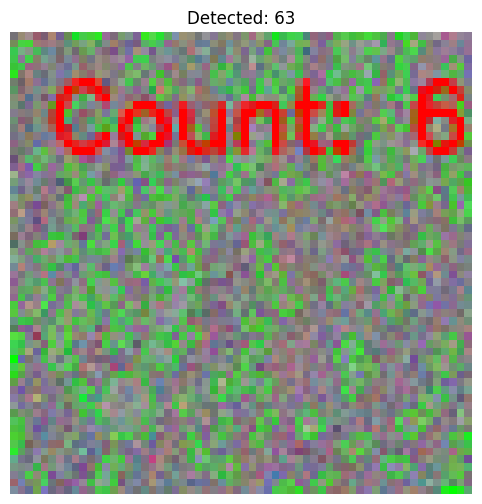

[1325/41058] Processing: S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_83
╒═════════════════╤════════════════════════════════════════════════════╕
│ Metric          │ Value                                              │
╞═════════════════╪════════════════════════════════════════════════════╡
│ Tile            │ S2B_MSIL2A_20171019T102019_N9999_R065_T34VDR_60_83 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Object Count    │ 19                                                 │
├─────────────────┼────────────────────────────────────────────────────┤
│ Processing Time │ 0.01 sec                                           │
╘═════════════════╧════════════════════════════════════════════════════╛


In [ ]:
if __name__ == "__main__":
    print_header("Wildlife Population Counter")

    tile_dirs = [
        root for root, _, files in os.walk(BASE_TILE_FOLDER)
        if any(f.lower().endswith(".tif") for f in files)
    ]

    if not tile_dirs:
        raise RuntimeError(f"No tile folders with .tif files found under {BASE_TILE_FOLDER}")

    cprint(f"Found {len(tile_dirs)} tile folders.", "green")

    # tile_dirs = tile_dirs[:10]  # Uncomment to limit

    for idx, tile in enumerate(tile_dirs):
        tile_name = os.path.basename(tile)
        print_header(f"[{idx+1}/{len(tile_dirs)}] Processing: {tile_name}")
        try:
            start_time = time.time()
            rgb = load_tile_rgb(tile, BANDS)
            gray = cv2.cvtColor(rgb, cv2.COLOR_BGR2GRAY)
            mask = preprocess_gray(gray)
            contours = detect_contours(mask, MIN_AREA, MAX_AREA)
            count = len(contours)
            duration = time.time() - start_time
            print_tile_summary(tile_name, count, duration)
            draw_and_show(rgb, contours, count, DISPLAY_SCALE)
        except Exception as e:
            cprint(f"❌ Error processing tile {tile_name}: {e}", "red")